## **Road Damage Detection**

### Import Packages

In [57]:
import os
import tensorflow as tf
import numpy as np
import six.moves.urllib as urllib
import cv2
import random
from xml.etree import ElementTree
from xml.dom import minidom
import collections
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib as matplot
import seaborn as sns
%matplotlib inline

In [58]:
os.chdir("E:\\tmp\\RoadDamageDataset")
os.getcwd()

'E:\\tmp\\RoadDamageDataset'

In [59]:
base_path = os.getcwd() + '\\RoadDamageDataset\\'
damageTypes=["D00", "D01", "D10", "D11", "D20", "D40", "D43", "D44"]
# govs corresponds to municipality name.
govs = ["Adachi", "Chiba","Ichihara", "Muroran", "Nagakute", "Numazu", "Sumida"]

In the above cell we are listing all citys from japan

### Basic Stats On Dataset

In [60]:
# the number of total images and total labels.

cls_names = []
total_images = 0
for gov in govs:
    
    file_list = os.listdir(base_path + gov + '\\Annotations\\')

    for file in file_list:

        total_images = total_images + 1
        if file =='.DS_Store':
            pass
        else:
            infile_xml = open(base_path + gov + '\\Annotations\\' +file)
            tree = ElementTree.parse(infile_xml)
            root = tree.getroot()
            for obj in root.iter('object'):
                cls_name = obj.find('name').text
                cls_names.append(cls_name)
print("total")
print("# of images：" + str(total_images))
print("# of labels：" + str(len(cls_names)))

total
# of images：9053
# of labels：15457


In above cell I am Loading all images and .xml files(annotations/labels)

D00 : 2768
D01 : 3789
D10 : 742
D11 : 636
D20 : 2541
D40 : 409
D43 : 817
D44 : 3733


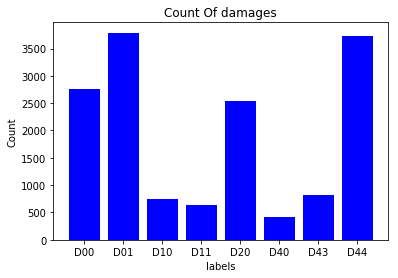

<Figure size 432x288 with 0 Axes>

In [53]:
# the number of each class labels.
import collections
count_dict = collections.Counter(cls_names)
cls_count = []
for damageType in damageTypes:
    print(str(damageType) + ' : ' + str(count_dict[damageType]))
    cls_count.append(count_dict[damageType])

    
plt.bar(damageTypes, cls_count, color="blue")
#plt.xticks(y_pos, objects)
plt.ylabel('Count')
plt.xlabel('labels')
plt.title('Count Of damages')
plt.show()
fig = plt.figure()
fig.savefig("bar.png")

In above cell we calculated & ploted total count of labels(damages in each image)

Around 24.54% of damages are happening with class D01

Around 24.18% of damages are happening with class D44

Adachi
# of images：1650
# of labels：2924
D00 : 529
D01 : 1013
D10 : 153
D11 : 279
D20 : 172
D40 : 11
D43 : 191
D44 : 567
**************************************************


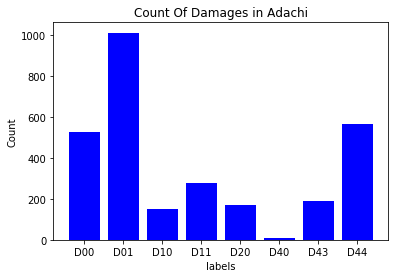

Chiba
# of images：467
# of labels：797
D00 : 183
D01 : 187
D10 : 13
D11 : 12
D20 : 27
D40 : 3
D43 : 104
D44 : 267
**************************************************


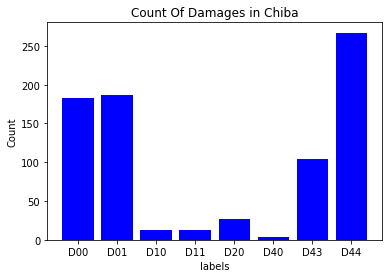

Ichihara
# of images：254
# of labels：482
D00 : 175
D01 : 71
D10 : 18
D11 : 9
D20 : 43
D40 : 8
D43 : 20
D44 : 138
**************************************************


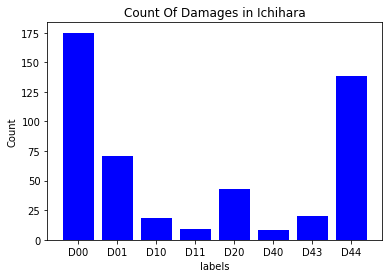

Muroran
# of images：2145
# of labels：3601
D00 : 671
D01 : 574
D10 : 124
D11 : 88
D20 : 1192
D40 : 189
D43 : 50
D44 : 712
**************************************************


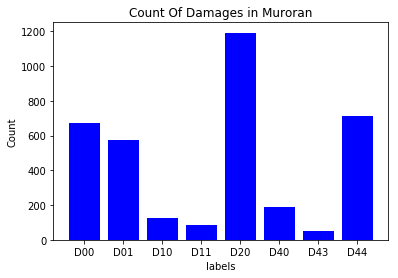

Nagakute
# of images：1366
# of labels：2302
D00 : 482
D01 : 477
D10 : 169
D11 : 58
D20 : 351
D40 : 14
D43 : 90
D44 : 659
**************************************************


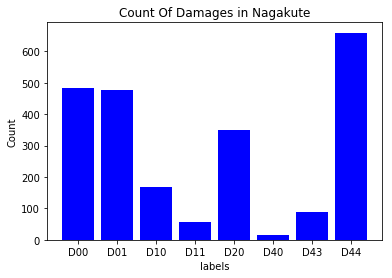

Numazu
# of images：2032
# of labels：3711
D00 : 560
D01 : 807
D10 : 245
D11 : 129
D20 : 735
D40 : 165
D43 : 161
D44 : 908
**************************************************


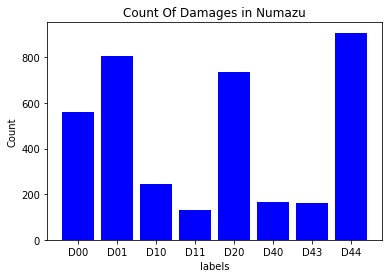

Sumida
# of images：1139
# of labels：1640
D00 : 168
D01 : 660
D10 : 20
D11 : 61
D20 : 21
D40 : 19
D43 : 201
D44 : 482
**************************************************


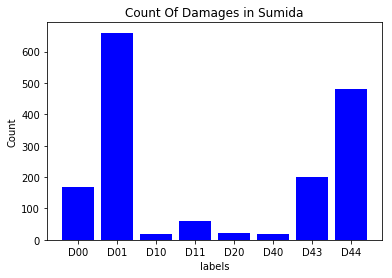

<Figure size 432x288 with 0 Axes>

In [61]:
# the number of each class labels for each municipality
for gov in govs:
    cls_names = []
    total_images = 0
    file_list = os.listdir(base_path + gov + '/Annotations/')

    for file in file_list:

        total_images = total_images + 1
        if file =='.DS_Store':
            pass
        else:
            infile_xml = open(base_path + gov + '/Annotations/' +file)
            tree = ElementTree.parse(infile_xml)
            root = tree.getroot()
            for obj in root.iter('object'):
                cls_name = obj.find('name').text
                cls_names.append(cls_name)
    print(gov)
    print("# of images：" + str(total_images))
    print("# of labels：" + str(len(cls_names)))
    
    count_dict = collections.Counter(cls_names)
    cls_count = []
    for damageType in damageTypes:
        print(str(damageType) + ' : ' + str(count_dict[damageType]))
        cls_count.append(count_dict[damageType])

    print('**************************************************')
    plt.bar(damageTypes, cls_count, color="blue")
    #plt.xticks(y_pos, objects)
    plt.ylabel('Count')
    plt.xlabel('labels')
    plt.title('Count Of Damages in '+ gov)
    plt.show()
    fig = plt.figure()
    fig.savefig("bar.png")

In above cell I calculated count of damages in each muncipal

In [62]:
def draw_images(image_file):
    gov = image_file.split('_')[0]
    img = cv2.imread(base_path + gov + '/JPEGImages/' + image_file.split('.')[0] + '.jpg')
    
    infile_xml = open(base_path + gov + '/Annotations/' +image_file)
    tree = ElementTree.parse(infile_xml)
    root = tree.getroot()
    
    for obj in root.iter('object'):
        cls_name = obj.find('name').text
        xmlbox = obj.find('bndbox')
        xmin = int(xmlbox.find('xmin').text)
        xmax = int(xmlbox.find('xmax').text)
        ymin = int(xmlbox.find('ymin').text)
        ymax = int(xmlbox.find('ymax').text)

        font = cv2.FONT_HERSHEY_SIMPLEX

        # put text
        cv2.putText(img,cls_name,(xmin,ymin-10),font,1,(0,255,0),2,cv2.LINE_AA)

        # draw bounding box
        cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0,255,0),3)
    return img


In above cell we are labeling each image,by taking image & annotation(.xml) file

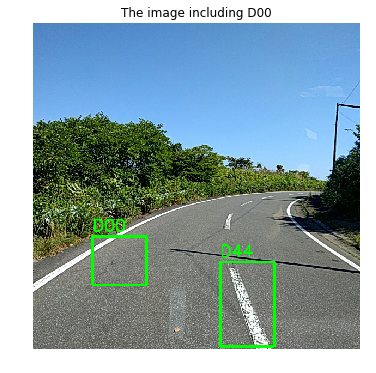

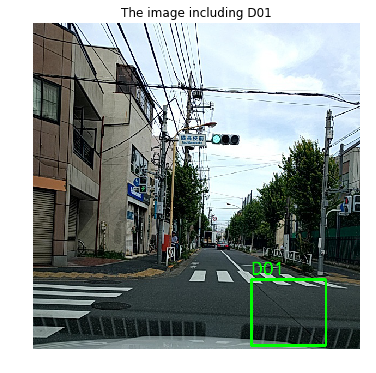

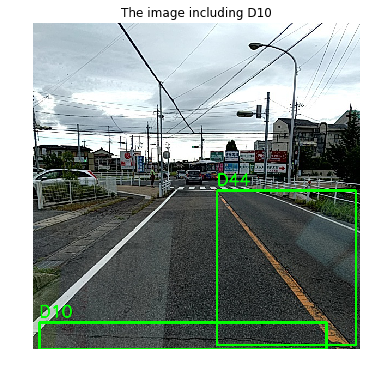

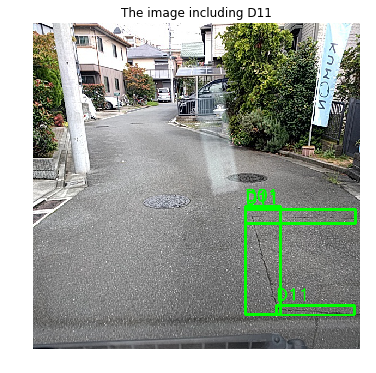

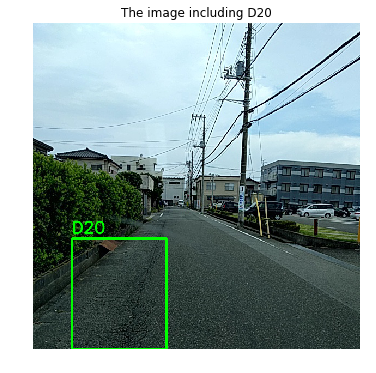

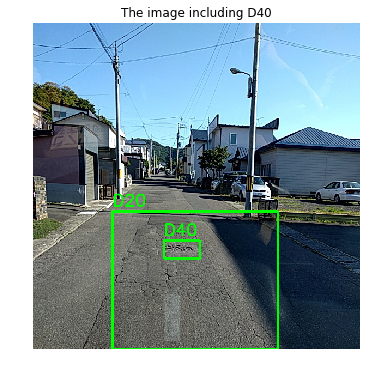

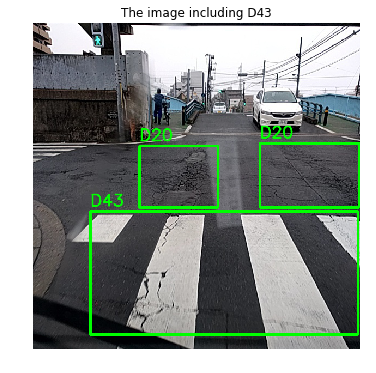

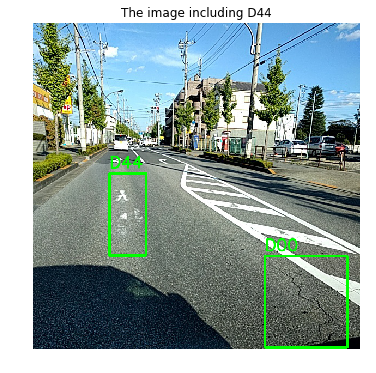

In [63]:
for damageType in damageTypes:
    tmp = []
    for gov in govs:
        file = open(base_path + gov + '/ImageSets/Main/%s_trainval.txt' %damageType, 'r')

        for line in file:
            line = line.rstrip('\n').split('/')[-1]

            if line.split(' ')[2] == '1':
                tmp.append(line.split(' ')[0]+'.xml')
        
        
    random.shuffle(tmp)
    fig = plt.figure(figsize=(6,6))
    for number, image in enumerate(tmp[0:1]):  ###  am taking only one image from each label and printing that image.
        img = draw_images(image)
        plt.subplot(1,1,number+1)
        plt.axis('off')
        plt.title('The image including ' + damageType)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

In above cell I am taking only training datafrom overall data

From _trainval.xml file , I am considering only 1s , and from that iam taking one image from each class(label(D00)),Then Iam Just Displaying the image.

(tmp[0:1]) means I am taking only one image from each label and printing that image.


### Next, try road damage detection using SSD_mobilenet!

In [64]:
import tensorflow
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

While importing label_map_util we struggled , please refer the attached doc ("steps while using mobile net / object detection/protec")

### Model preparation

In [65]:
# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT =  'C:\\Users\\ashwini.pingali\\Downloads\\trainedModels\\trainedModels\\ssd_mobilenet_RoadDamageDetector.pb' 

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'C:\\Users\\ashwini.pingali\\Downloads\\trainedModels\\trainedModels\\crack_label_map.pbtxt'

NUM_CLASSES = 8  ("D00","D01",'''''')


### Load a (frozen) Tensorflow model into memory.

In [66]:
detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

### Loading Label map

In [67]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

In [68]:
def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)
    

### Testing

In [69]:
# get images from val.txt
PATH_TO_TEST_IMAGES_DIR = 'C:\\Users\\ashwini.pingali\\Downloads\\RoadDamageDataset\\RoadDamageDataset\\'
D_TYPE = ['D00', 'D01', 'D10', 'D11', 'D20','D40', 'D43']
govs = ['Adachi', 'Ichihara', 'Muroran', 'Chiba', 'Sumida', 'Nagakute', 'Numazu']

val_list = []
for gov in govs:
    file = open(PATH_TO_TEST_IMAGES_DIR + gov + '\\ImageSets\\Main\\val.txt', 'r')
    for line in file:
        line = line.rstrip('\n').split('/')[-1]
        val_list.append(line)
    file.close()

print("# of validation images：" + str(len(val_list)))

# of validation images：1813


In [70]:
TEST_IMAGE_PATHS=[]
random.shuffle(val_list)

for val_image in val_list[0:5]:
    TEST_IMAGE_PATHS.append(PATH_TO_TEST_IMAGES_DIR + val_image.split('_')[0]+ '/JPEGImages/%s.jpg' %val_image)
# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

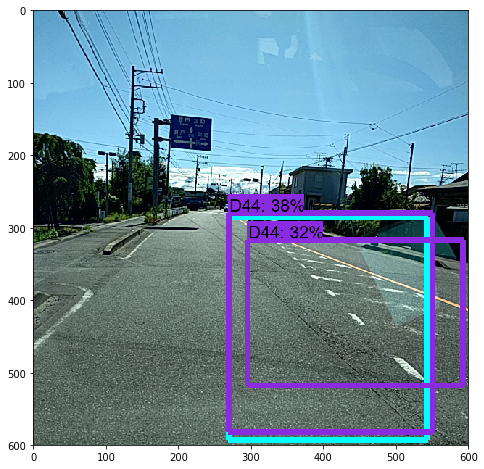

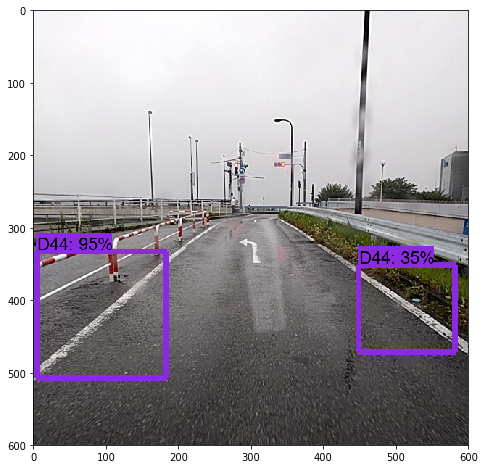

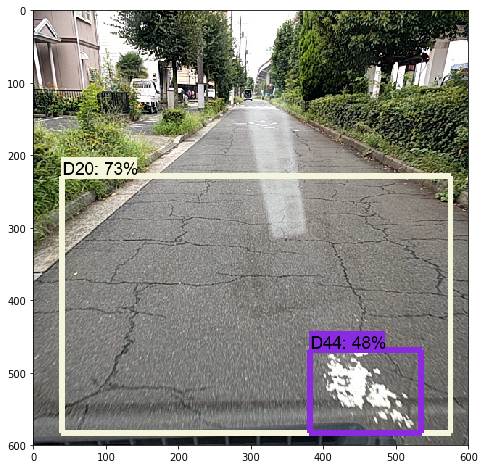

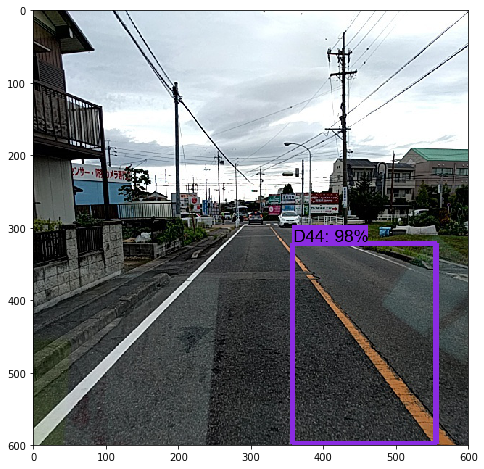

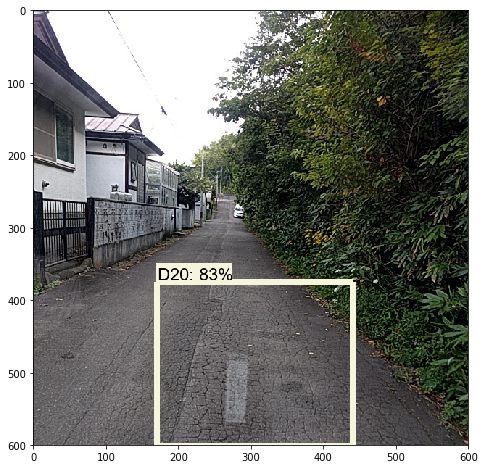

In [71]:
with detection_graph.as_default():
     with tf.Session(graph=detection_graph) as sess:
            
            image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
            detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
            detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
            detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
            num_detections = detection_graph.get_tensor_by_name('num_detections:0')
            #print(num_detections)
            for image_path in TEST_IMAGE_PATHS:
                image = Image.open(image_path)
                image_np = load_image_into_numpy_array(image)
                image_np_expanded = np.expand_dims(image_np, axis=0)
                (boxes, scores, classes, num) = sess.run(
                  [detection_boxes, detection_scores, detection_classes, num_detections],
                  feed_dict={image_tensor: image_np_expanded})
                vis_util.visualize_boxes_and_labels_on_image_array(
                    image_np,np.squeeze(boxes),np.squeeze(classes).astype(np.int32),
                    np.squeeze(scores),category_index,min_score_thresh=0.3,use_normalized_coordinates=True,
                    line_thickness=8)
                plt.figure(figsize=IMAGE_SIZE)
                plt.imshow(image_np)
                    


### Extract Images from video

In [ ]:
import numpy as np
import os

# Playing video from file:
cap = cv2.VideoCapture('E:\\tmp\\Split-video-by-frame\\Split-video-by-frame\\video.mp4')

try:
    if not os.path.exists('data'):
        os.makedirs('data')
except OSError:
    print ('Error: Creating directory of data')

currentFrame = 0
while(True):
    # Capture frame-by-frame
    ret, frame = cap.read()

    # Saves image of the current frame in jpg file
    name = './data/frame' + str(currentFrame) + '.jpg'
    print ('Creating...' + name)
    cv2.imwrite(name, frame)

    # To stop duplicate images
    currentFrame += 1

# When everything done, release the capture
cap.release()
cv2.destroyAllWindows()

### Validation on new Dataset

Here, We Used the images , which iam getting from video(we extracted images from video while are already having pixels) and applied Trained Model.

In [72]:
# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

TEST_IMAGE_PATHS=['E:\\tmp\\Split-video-by-frame\\Split-video-by-frame\\data\\frame0.jpg',
'E:\\tmp\\Split-video-by-frame\\Split-video-by-frame\\data\\frame1.jpg',
'E:\\tmp\\Split-video-by-frame\\Split-video-by-frame\\data\\frame21.jpg']


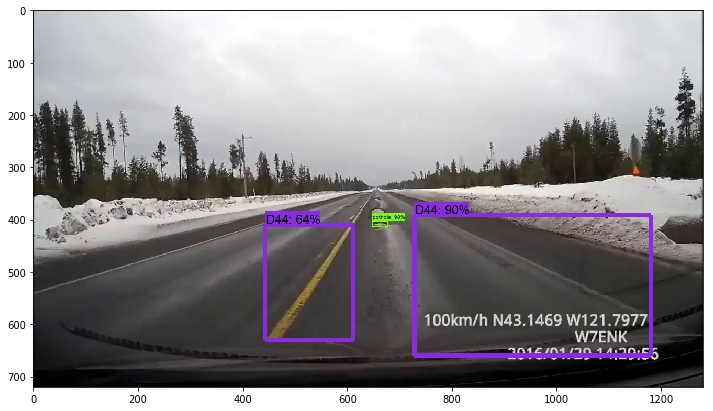

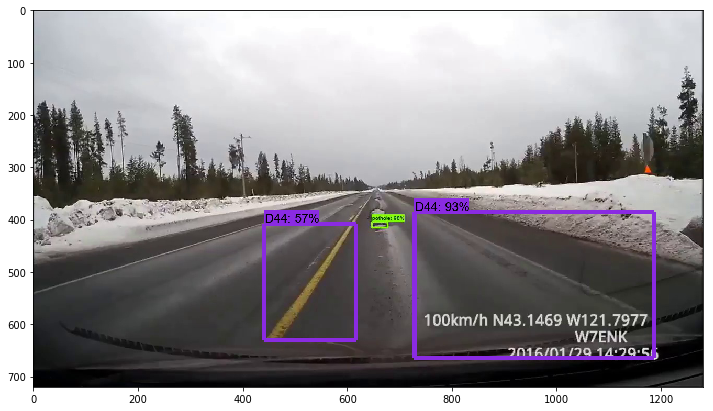

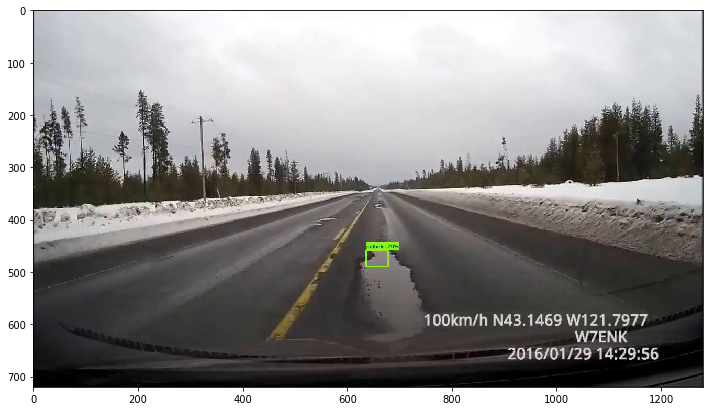

In [73]:
with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:
        # Definite input and output Tensors for detection_graph
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        # Each box represents a part of the image where a particular object was detected.
        detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
        # Each score represent how level of confidence for each of the objects.
        # Score is shown on the result image, together with the class label.
        detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
        detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
        num_detections = detection_graph.get_tensor_by_name('num_detections:0')
        for image_path in TEST_IMAGE_PATHS:
            image = Image.open(image_path)
            # the array based representation of the image will be used later in order to prepare the
            # result image with boxes and labels on it.
            image_np = load_image_into_numpy_array(image)
            # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
            image_np_expanded = np.expand_dims(image_np, axis=0)
            # Actual detection.
            (boxes, scores, classes, num) = sess.run(
                [detection_boxes, detection_scores, detection_classes, num_detections],
                feed_dict={image_tensor: image_np_expanded})
            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
                image_np,
                np.squeeze(boxes),
                np.squeeze(classes).astype(np.int32),
                np.squeeze(scores),
                category_index,
                min_score_thresh=0.3,
                use_normalized_coordinates=True,
                line_thickness=8)
            plt.figure(figsize=IMAGE_SIZE)
            plt.imshow(image_np)

### Extract Images from video

In [ ]:
import numpy as np
import os

# Playing video from file:
cap = cv2.VideoCapture('E:\\tmp\\Split-video-by-frame\\Split-video-by-frame\\video.mp4')

try:
    if not os.path.exists('data'):
        os.makedirs('data')
except OSError:
    print ('Error: Creating directory of data')

currentFrame = 0
while(True):
    # Capture frame-by-frame
    ret, frame = cap.read()

    # Saves image of the current frame in jpg file
    name = './data/frame' + str(currentFrame) + '.jpg'
    print ('Creating...' + name)
    cv2.imwrite(name, frame)

    # To stop duplicate images
    currentFrame += 1

# When everything done, release the capture
cap.release()
cv2.destroyAllWindows()

Creating..../data/frame0.jpg
Creating..../data/frame1.jpg
Creating..../data/frame2.jpg
Creating..../data/frame3.jpg
Creating..../data/frame4.jpg
Creating..../data/frame5.jpg
Creating..../data/frame6.jpg
Creating..../data/frame7.jpg
Creating..../data/frame8.jpg
Creating..../data/frame9.jpg
Creating..../data/frame10.jpg
Creating..../data/frame11.jpg
Creating..../data/frame12.jpg
Creating..../data/frame13.jpg
Creating..../data/frame14.jpg
Creating..../data/frame15.jpg
Creating..../data/frame16.jpg
Creating..../data/frame17.jpg
Creating..../data/frame18.jpg
Creating..../data/frame19.jpg
Creating..../data/frame20.jpg
Creating..../data/frame21.jpg
Creating..../data/frame22.jpg
Creating..../data/frame23.jpg
Creating..../data/frame24.jpg
Creating..../data/frame25.jpg
Creating..../data/frame26.jpg
Creating..../data/frame27.jpg
Creating..../data/frame28.jpg
Creating..../data/frame29.jpg
Creating..../data/frame30.jpg
Creating..../data/frame31.jpg
Creating..../data/frame32.jpg
Creating..../data/fr

Creating..../data/frame272.jpg
Creating..../data/frame273.jpg
Creating..../data/frame274.jpg
Creating..../data/frame275.jpg
Creating..../data/frame276.jpg
Creating..../data/frame277.jpg
Creating..../data/frame278.jpg
Creating..../data/frame279.jpg
Creating..../data/frame280.jpg
Creating..../data/frame281.jpg
Creating..../data/frame282.jpg
Creating..../data/frame283.jpg
Creating..../data/frame284.jpg
Creating..../data/frame285.jpg
Creating..../data/frame286.jpg
Creating..../data/frame287.jpg
Creating..../data/frame288.jpg
Creating..../data/frame289.jpg
Creating..../data/frame290.jpg
Creating..../data/frame291.jpg
Creating..../data/frame292.jpg
Creating..../data/frame293.jpg
Creating..../data/frame294.jpg
Creating..../data/frame295.jpg
Creating..../data/frame296.jpg
Creating..../data/frame297.jpg
Creating..../data/frame298.jpg
Creating..../data/frame299.jpg
Creating..../data/frame300.jpg
Creating..../data/frame301.jpg
Creating..../data/frame302.jpg
Creating..../data/frame303.jpg
Creating

Creating..../data/frame538.jpg
Creating..../data/frame539.jpg
Creating..../data/frame540.jpg
Creating..../data/frame541.jpg
Creating..../data/frame542.jpg
Creating..../data/frame543.jpg
Creating..../data/frame544.jpg
Creating..../data/frame545.jpg
Creating..../data/frame546.jpg
Creating..../data/frame547.jpg
Creating..../data/frame548.jpg
Creating..../data/frame549.jpg
Creating..../data/frame550.jpg
Creating..../data/frame551.jpg
Creating..../data/frame552.jpg
Creating..../data/frame553.jpg
Creating..../data/frame554.jpg
Creating..../data/frame555.jpg
Creating..../data/frame556.jpg
Creating..../data/frame557.jpg
Creating..../data/frame558.jpg
Creating..../data/frame559.jpg
Creating..../data/frame560.jpg
Creating..../data/frame561.jpg
Creating..../data/frame562.jpg
Creating..../data/frame563.jpg
Creating..../data/frame564.jpg
Creating..../data/frame565.jpg
Creating..../data/frame566.jpg
Creating..../data/frame567.jpg
Creating..../data/frame568.jpg
Creating..../data/frame569.jpg
Creating

Creating..../data/frame846.jpg
Creating..../data/frame847.jpg
Creating..../data/frame848.jpg
Creating..../data/frame849.jpg
Creating..../data/frame850.jpg
Creating..../data/frame851.jpg
Creating..../data/frame852.jpg
Creating..../data/frame853.jpg
Creating..../data/frame854.jpg
Creating..../data/frame855.jpg
Creating..../data/frame856.jpg
Creating..../data/frame857.jpg
Creating..../data/frame858.jpg
Creating..../data/frame859.jpg
Creating..../data/frame860.jpg
Creating..../data/frame861.jpg
Creating..../data/frame862.jpg
Creating..../data/frame863.jpg
Creating..../data/frame864.jpg
Creating..../data/frame865.jpg
Creating..../data/frame866.jpg
Creating..../data/frame867.jpg
Creating..../data/frame868.jpg
Creating..../data/frame869.jpg
Creating..../data/frame870.jpg
Creating..../data/frame871.jpg
Creating..../data/frame872.jpg
Creating..../data/frame873.jpg
Creating..../data/frame874.jpg
Creating..../data/frame875.jpg
Creating..../data/frame876.jpg
Creating..../data/frame877.jpg
Creating

Creating..../data/frame1151.jpg
Creating..../data/frame1152.jpg
Creating..../data/frame1153.jpg
Creating..../data/frame1154.jpg
Creating..../data/frame1155.jpg
Creating..../data/frame1156.jpg
Creating..../data/frame1157.jpg
Creating..../data/frame1158.jpg
Creating..../data/frame1159.jpg
Creating..../data/frame1160.jpg
Creating..../data/frame1161.jpg
Creating..../data/frame1162.jpg
Creating..../data/frame1163.jpg
Creating..../data/frame1164.jpg
Creating..../data/frame1165.jpg
Creating..../data/frame1166.jpg
Creating..../data/frame1167.jpg
Creating..../data/frame1168.jpg
Creating..../data/frame1169.jpg
Creating..../data/frame1170.jpg
Creating..../data/frame1171.jpg
Creating..../data/frame1172.jpg
Creating..../data/frame1173.jpg
Creating..../data/frame1174.jpg
Creating..../data/frame1175.jpg
Creating..../data/frame1176.jpg
Creating..../data/frame1177.jpg
Creating..../data/frame1178.jpg
Creating..../data/frame1179.jpg
Creating..../data/frame1180.jpg
Creating..../data/frame1181.jpg
Creating

Creating..../data/frame1452.jpg
Creating..../data/frame1453.jpg
Creating..../data/frame1454.jpg
Creating..../data/frame1455.jpg
Creating..../data/frame1456.jpg
Creating..../data/frame1457.jpg
Creating..../data/frame1458.jpg
Creating..../data/frame1459.jpg
Creating..../data/frame1460.jpg
Creating..../data/frame1461.jpg
Creating..../data/frame1462.jpg
Creating..../data/frame1463.jpg
Creating..../data/frame1464.jpg
Creating..../data/frame1465.jpg
Creating..../data/frame1466.jpg
Creating..../data/frame1467.jpg
Creating..../data/frame1468.jpg
Creating..../data/frame1469.jpg
Creating..../data/frame1470.jpg
Creating..../data/frame1471.jpg
Creating..../data/frame1472.jpg
Creating..../data/frame1473.jpg
Creating..../data/frame1474.jpg
Creating..../data/frame1475.jpg
Creating..../data/frame1476.jpg
Creating..../data/frame1477.jpg
Creating..../data/frame1478.jpg
Creating..../data/frame1479.jpg
Creating..../data/frame1480.jpg
Creating..../data/frame1481.jpg
Creating..../data/frame1482.jpg
Creating

Creating..../data/frame1750.jpg
Creating..../data/frame1751.jpg
Creating..../data/frame1752.jpg
Creating..../data/frame1753.jpg
Creating..../data/frame1754.jpg
Creating..../data/frame1755.jpg
Creating..../data/frame1756.jpg
Creating..../data/frame1757.jpg
Creating..../data/frame1758.jpg
Creating..../data/frame1759.jpg
Creating..../data/frame1760.jpg
Creating..../data/frame1761.jpg
Creating..../data/frame1762.jpg
Creating..../data/frame1763.jpg
Creating..../data/frame1764.jpg
Creating..../data/frame1765.jpg
Creating..../data/frame1766.jpg
Creating..../data/frame1767.jpg
Creating..../data/frame1768.jpg
Creating..../data/frame1769.jpg
Creating..../data/frame1770.jpg
Creating..../data/frame1771.jpg
Creating..../data/frame1772.jpg
Creating..../data/frame1773.jpg
Creating..../data/frame1774.jpg
Creating..../data/frame1775.jpg
Creating..../data/frame1776.jpg
Creating..../data/frame1777.jpg
Creating..../data/frame1778.jpg
Creating..../data/frame1779.jpg
Creating..../data/frame1780.jpg
Creating

Creating..../data/frame2035.jpg
Creating..../data/frame2036.jpg
Creating..../data/frame2037.jpg
Creating..../data/frame2038.jpg
Creating..../data/frame2039.jpg
Creating..../data/frame2040.jpg
Creating..../data/frame2041.jpg
Creating..../data/frame2042.jpg
Creating..../data/frame2043.jpg
Creating..../data/frame2044.jpg
Creating..../data/frame2045.jpg
Creating..../data/frame2046.jpg
Creating..../data/frame2047.jpg
Creating..../data/frame2048.jpg
Creating..../data/frame2049.jpg
Creating..../data/frame2050.jpg
Creating..../data/frame2051.jpg
Creating..../data/frame2052.jpg
Creating..../data/frame2053.jpg
Creating..../data/frame2054.jpg
Creating..../data/frame2055.jpg
Creating..../data/frame2056.jpg
Creating..../data/frame2057.jpg
Creating..../data/frame2058.jpg
Creating..../data/frame2059.jpg
Creating..../data/frame2060.jpg
Creating..../data/frame2061.jpg
Creating..../data/frame2062.jpg
Creating..../data/frame2063.jpg
Creating..../data/frame2064.jpg
Creating..../data/frame2065.jpg
Creating

Creating..../data/frame2335.jpg
Creating..../data/frame2336.jpg
Creating..../data/frame2337.jpg
Creating..../data/frame2338.jpg
Creating..../data/frame2339.jpg
Creating..../data/frame2340.jpg
Creating..../data/frame2341.jpg
Creating..../data/frame2342.jpg
Creating..../data/frame2343.jpg
Creating..../data/frame2344.jpg
Creating..../data/frame2345.jpg
Creating..../data/frame2346.jpg
Creating..../data/frame2347.jpg
Creating..../data/frame2348.jpg
Creating..../data/frame2349.jpg
Creating..../data/frame2350.jpg
Creating..../data/frame2351.jpg
Creating..../data/frame2352.jpg
Creating..../data/frame2353.jpg
Creating..../data/frame2354.jpg
Creating..../data/frame2355.jpg
Creating..../data/frame2356.jpg
Creating..../data/frame2357.jpg
Creating..../data/frame2358.jpg
Creating..../data/frame2359.jpg
Creating..../data/frame2360.jpg
Creating..../data/frame2361.jpg
Creating..../data/frame2362.jpg
Creating..../data/frame2363.jpg
Creating..../data/frame2364.jpg
Creating..../data/frame2365.jpg
Creating

Creating..../data/frame2592.jpg
Creating..../data/frame2593.jpg
Creating..../data/frame2594.jpg
Creating..../data/frame2595.jpg
Creating..../data/frame2596.jpg
Creating..../data/frame2597.jpg
Creating..../data/frame2598.jpg
Creating..../data/frame2599.jpg
Creating..../data/frame2600.jpg
Creating..../data/frame2601.jpg
Creating..../data/frame2602.jpg
Creating..../data/frame2603.jpg
Creating..../data/frame2604.jpg
Creating..../data/frame2605.jpg
Creating..../data/frame2606.jpg
Creating..../data/frame2607.jpg
Creating..../data/frame2608.jpg
Creating..../data/frame2609.jpg
Creating..../data/frame2610.jpg
Creating..../data/frame2611.jpg
Creating..../data/frame2612.jpg
Creating..../data/frame2613.jpg
Creating..../data/frame2614.jpg
Creating..../data/frame2615.jpg
Creating..../data/frame2616.jpg
Creating..../data/frame2617.jpg
Creating..../data/frame2618.jpg
Creating..../data/frame2619.jpg
Creating..../data/frame2620.jpg
Creating..../data/frame2621.jpg
Creating..../data/frame2622.jpg
Creating

Creating..../data/frame2888.jpg
Creating..../data/frame2889.jpg
Creating..../data/frame2890.jpg
Creating..../data/frame2891.jpg
Creating..../data/frame2892.jpg
Creating..../data/frame2893.jpg
Creating..../data/frame2894.jpg
Creating..../data/frame2895.jpg
Creating..../data/frame2896.jpg
Creating..../data/frame2897.jpg
Creating..../data/frame2898.jpg
Creating..../data/frame2899.jpg
Creating..../data/frame2900.jpg
Creating..../data/frame2901.jpg
Creating..../data/frame2902.jpg
Creating..../data/frame2903.jpg
Creating..../data/frame2904.jpg
Creating..../data/frame2905.jpg
Creating..../data/frame2906.jpg
Creating..../data/frame2907.jpg
Creating..../data/frame2908.jpg
Creating..../data/frame2909.jpg
Creating..../data/frame2910.jpg
Creating..../data/frame2911.jpg
Creating..../data/frame2912.jpg
Creating..../data/frame2913.jpg
Creating..../data/frame2914.jpg
Creating..../data/frame2915.jpg
Creating..../data/frame2916.jpg
Creating..../data/frame2917.jpg
Creating..../data/frame2918.jpg
Creating

Creating..../data/frame3173.jpg
Creating..../data/frame3174.jpg
Creating..../data/frame3175.jpg
Creating..../data/frame3176.jpg
Creating..../data/frame3177.jpg
Creating..../data/frame3178.jpg
Creating..../data/frame3179.jpg
Creating..../data/frame3180.jpg
Creating..../data/frame3181.jpg
Creating..../data/frame3182.jpg
Creating..../data/frame3183.jpg
Creating..../data/frame3184.jpg
Creating..../data/frame3185.jpg
Creating..../data/frame3186.jpg
Creating..../data/frame3187.jpg
Creating..../data/frame3188.jpg
Creating..../data/frame3189.jpg
Creating..../data/frame3190.jpg
Creating..../data/frame3191.jpg
Creating..../data/frame3192.jpg
Creating..../data/frame3193.jpg
Creating..../data/frame3194.jpg
Creating..../data/frame3195.jpg
Creating..../data/frame3196.jpg
Creating..../data/frame3197.jpg
Creating..../data/frame3198.jpg
Creating..../data/frame3199.jpg
Creating..../data/frame3200.jpg
Creating..../data/frame3201.jpg
Creating..../data/frame3202.jpg
Creating..../data/frame3203.jpg
Creating

Creating..../data/frame3466.jpg
Creating..../data/frame3467.jpg
Creating..../data/frame3468.jpg
Creating..../data/frame3469.jpg
Creating..../data/frame3470.jpg
Creating..../data/frame3471.jpg
Creating..../data/frame3472.jpg
Creating..../data/frame3473.jpg
Creating..../data/frame3474.jpg
Creating..../data/frame3475.jpg
Creating..../data/frame3476.jpg
Creating..../data/frame3477.jpg
Creating..../data/frame3478.jpg
Creating..../data/frame3479.jpg
Creating..../data/frame3480.jpg
Creating..../data/frame3481.jpg
Creating..../data/frame3482.jpg
Creating..../data/frame3483.jpg
Creating..../data/frame3484.jpg
Creating..../data/frame3485.jpg
Creating..../data/frame3486.jpg
Creating..../data/frame3487.jpg
Creating..../data/frame3488.jpg
Creating..../data/frame3489.jpg
Creating..../data/frame3490.jpg
Creating..../data/frame3491.jpg
Creating..../data/frame3492.jpg
Creating..../data/frame3493.jpg
Creating..../data/frame3494.jpg
Creating..../data/frame3495.jpg
Creating..../data/frame3496.jpg
Creating

Creating..../data/frame3757.jpg
Creating..../data/frame3758.jpg
Creating..../data/frame3759.jpg
Creating..../data/frame3760.jpg
Creating..../data/frame3761.jpg
Creating..../data/frame3762.jpg
Creating..../data/frame3763.jpg
Creating..../data/frame3764.jpg
Creating..../data/frame3765.jpg
Creating..../data/frame3766.jpg
Creating..../data/frame3767.jpg
Creating..../data/frame3768.jpg
Creating..../data/frame3769.jpg
Creating..../data/frame3770.jpg
Creating..../data/frame3771.jpg
Creating..../data/frame3772.jpg
Creating..../data/frame3773.jpg
Creating..../data/frame3774.jpg
Creating..../data/frame3775.jpg
Creating..../data/frame3776.jpg
Creating..../data/frame3777.jpg
Creating..../data/frame3778.jpg
Creating..../data/frame3779.jpg
Creating..../data/frame3780.jpg
Creating..../data/frame3781.jpg
Creating..../data/frame3782.jpg
Creating..../data/frame3783.jpg
Creating..../data/frame3784.jpg
Creating..../data/frame3785.jpg
Creating..../data/frame3786.jpg
Creating..../data/frame3787.jpg
Creating

Creating..../data/frame4048.jpg
Creating..../data/frame4049.jpg
Creating..../data/frame4050.jpg
Creating..../data/frame4051.jpg
Creating..../data/frame4052.jpg
Creating..../data/frame4053.jpg
Creating..../data/frame4054.jpg
Creating..../data/frame4055.jpg
Creating..../data/frame4056.jpg
Creating..../data/frame4057.jpg
Creating..../data/frame4058.jpg
Creating..../data/frame4059.jpg
Creating..../data/frame4060.jpg
Creating..../data/frame4061.jpg
Creating..../data/frame4062.jpg
Creating..../data/frame4063.jpg
Creating..../data/frame4064.jpg
Creating..../data/frame4065.jpg
Creating..../data/frame4066.jpg
Creating..../data/frame4067.jpg
Creating..../data/frame4068.jpg
Creating..../data/frame4069.jpg
Creating..../data/frame4070.jpg
Creating..../data/frame4071.jpg
Creating..../data/frame4072.jpg
Creating..../data/frame4073.jpg
Creating..../data/frame4074.jpg
Creating..../data/frame4075.jpg
Creating..../data/frame4076.jpg
Creating..../data/frame4077.jpg
Creating..../data/frame4078.jpg
Creating

Creating..../data/frame4318.jpg
Creating..../data/frame4319.jpg
Creating..../data/frame4320.jpg
Creating..../data/frame4321.jpg
Creating..../data/frame4322.jpg
Creating..../data/frame4323.jpg
Creating..../data/frame4324.jpg
Creating..../data/frame4325.jpg
Creating..../data/frame4326.jpg
Creating..../data/frame4327.jpg
Creating..../data/frame4328.jpg
Creating..../data/frame4329.jpg
Creating..../data/frame4330.jpg
Creating..../data/frame4331.jpg
Creating..../data/frame4332.jpg
Creating..../data/frame4333.jpg
Creating..../data/frame4334.jpg
Creating..../data/frame4335.jpg
Creating..../data/frame4336.jpg
Creating..../data/frame4337.jpg
Creating..../data/frame4338.jpg
Creating..../data/frame4339.jpg
Creating..../data/frame4340.jpg
Creating..../data/frame4341.jpg
Creating..../data/frame4342.jpg
Creating..../data/frame4343.jpg
Creating..../data/frame4344.jpg
Creating..../data/frame4345.jpg
Creating..../data/frame4346.jpg
Creating..../data/frame4347.jpg
Creating..../data/frame4348.jpg
Creating

Creating..../data/frame4613.jpg
Creating..../data/frame4614.jpg
Creating..../data/frame4615.jpg
Creating..../data/frame4616.jpg
Creating..../data/frame4617.jpg
Creating..../data/frame4618.jpg
Creating..../data/frame4619.jpg
Creating..../data/frame4620.jpg
Creating..../data/frame4621.jpg
Creating..../data/frame4622.jpg
Creating..../data/frame4623.jpg
Creating..../data/frame4624.jpg
Creating..../data/frame4625.jpg
Creating..../data/frame4626.jpg
Creating..../data/frame4627.jpg
Creating..../data/frame4628.jpg
Creating..../data/frame4629.jpg
Creating..../data/frame4630.jpg
Creating..../data/frame4631.jpg
Creating..../data/frame4632.jpg
Creating..../data/frame4633.jpg
Creating..../data/frame4634.jpg
Creating..../data/frame4635.jpg
Creating..../data/frame4636.jpg
Creating..../data/frame4637.jpg
Creating..../data/frame4638.jpg
Creating..../data/frame4639.jpg
Creating..../data/frame4640.jpg
Creating..../data/frame4641.jpg
Creating..../data/frame4642.jpg
Creating..../data/frame4643.jpg
Creating

Creating..../data/frame4890.jpg
Creating..../data/frame4891.jpg
Creating..../data/frame4892.jpg
Creating..../data/frame4893.jpg
Creating..../data/frame4894.jpg
Creating..../data/frame4895.jpg
Creating..../data/frame4896.jpg
Creating..../data/frame4897.jpg
Creating..../data/frame4898.jpg
Creating..../data/frame4899.jpg
Creating..../data/frame4900.jpg
Creating..../data/frame4901.jpg
Creating..../data/frame4902.jpg
Creating..../data/frame4903.jpg
Creating..../data/frame4904.jpg
Creating..../data/frame4905.jpg
Creating..../data/frame4906.jpg
Creating..../data/frame4907.jpg
Creating..../data/frame4908.jpg
Creating..../data/frame4909.jpg
Creating..../data/frame4910.jpg
Creating..../data/frame4911.jpg
Creating..../data/frame4912.jpg
Creating..../data/frame4913.jpg
Creating..../data/frame4914.jpg
Creating..../data/frame4915.jpg
Creating..../data/frame4916.jpg
Creating..../data/frame4917.jpg
Creating..../data/frame4918.jpg
Creating..../data/frame4919.jpg
Creating..../data/frame4920.jpg
Creating

Creating..../data/frame5184.jpg
Creating..../data/frame5185.jpg
Creating..../data/frame5186.jpg
Creating..../data/frame5187.jpg
Creating..../data/frame5188.jpg
Creating..../data/frame5189.jpg
Creating..../data/frame5190.jpg
Creating..../data/frame5191.jpg
Creating..../data/frame5192.jpg
Creating..../data/frame5193.jpg
Creating..../data/frame5194.jpg
Creating..../data/frame5195.jpg
Creating..../data/frame5196.jpg
Creating..../data/frame5197.jpg
Creating..../data/frame5198.jpg
Creating..../data/frame5199.jpg
Creating..../data/frame5200.jpg
Creating..../data/frame5201.jpg
Creating..../data/frame5202.jpg
Creating..../data/frame5203.jpg
Creating..../data/frame5204.jpg
Creating..../data/frame5205.jpg
Creating..../data/frame5206.jpg
Creating..../data/frame5207.jpg
Creating..../data/frame5208.jpg
Creating..../data/frame5209.jpg
Creating..../data/frame5210.jpg
Creating..../data/frame5211.jpg
Creating..../data/frame5212.jpg
Creating..../data/frame5213.jpg
Creating..../data/frame5214.jpg
Creating

Creating..../data/frame5474.jpg
Creating..../data/frame5475.jpg
Creating..../data/frame5476.jpg
Creating..../data/frame5477.jpg
Creating..../data/frame5478.jpg
Creating..../data/frame5479.jpg
Creating..../data/frame5480.jpg
Creating..../data/frame5481.jpg
Creating..../data/frame5482.jpg
Creating..../data/frame5483.jpg
Creating..../data/frame5484.jpg
Creating..../data/frame5485.jpg
Creating..../data/frame5486.jpg
Creating..../data/frame5487.jpg
Creating..../data/frame5488.jpg
Creating..../data/frame5489.jpg
Creating..../data/frame5490.jpg
Creating..../data/frame5491.jpg
Creating..../data/frame5492.jpg
Creating..../data/frame5493.jpg
Creating..../data/frame5494.jpg
Creating..../data/frame5495.jpg
Creating..../data/frame5496.jpg
Creating..../data/frame5497.jpg
Creating..../data/frame5498.jpg
Creating..../data/frame5499.jpg
Creating..../data/frame5500.jpg
Creating..../data/frame5501.jpg
Creating..../data/frame5502.jpg
Creating..../data/frame5503.jpg
Creating..../data/frame5504.jpg
Creating

Creating..../data/frame5765.jpg
Creating..../data/frame5766.jpg
Creating..../data/frame5767.jpg
Creating..../data/frame5768.jpg
Creating..../data/frame5769.jpg
Creating..../data/frame5770.jpg
Creating..../data/frame5771.jpg
Creating..../data/frame5772.jpg
Creating..../data/frame5773.jpg
Creating..../data/frame5774.jpg
Creating..../data/frame5775.jpg
Creating..../data/frame5776.jpg
Creating..../data/frame5777.jpg
Creating..../data/frame5778.jpg
Creating..../data/frame5779.jpg
Creating..../data/frame5780.jpg
Creating..../data/frame5781.jpg
Creating..../data/frame5782.jpg
Creating..../data/frame5783.jpg
Creating..../data/frame5784.jpg
Creating..../data/frame5785.jpg
Creating..../data/frame5786.jpg
Creating..../data/frame5787.jpg
Creating..../data/frame5788.jpg
Creating..../data/frame5789.jpg
Creating..../data/frame5790.jpg
Creating..../data/frame5791.jpg
Creating..../data/frame5792.jpg
Creating..../data/frame5793.jpg
Creating..../data/frame5794.jpg
Creating..../data/frame5795.jpg
Creating

Creating..../data/frame6046.jpg
Creating..../data/frame6047.jpg
Creating..../data/frame6048.jpg
Creating..../data/frame6049.jpg
Creating..../data/frame6050.jpg
Creating..../data/frame6051.jpg
Creating..../data/frame6052.jpg
Creating..../data/frame6053.jpg
Creating..../data/frame6054.jpg
Creating..../data/frame6055.jpg
Creating..../data/frame6056.jpg
Creating..../data/frame6057.jpg
Creating..../data/frame6058.jpg
Creating..../data/frame6059.jpg
Creating..../data/frame6060.jpg
Creating..../data/frame6061.jpg
Creating..../data/frame6062.jpg
Creating..../data/frame6063.jpg
Creating..../data/frame6064.jpg
Creating..../data/frame6065.jpg
Creating..../data/frame6066.jpg
Creating..../data/frame6067.jpg
Creating..../data/frame6068.jpg
Creating..../data/frame6069.jpg
Creating..../data/frame6070.jpg
Creating..../data/frame6071.jpg
Creating..../data/frame6072.jpg
Creating..../data/frame6073.jpg
Creating..../data/frame6074.jpg
Creating..../data/frame6075.jpg
Creating..../data/frame6076.jpg
Creating

Creating..../data/frame6350.jpg
Creating..../data/frame6351.jpg
Creating..../data/frame6352.jpg
Creating..../data/frame6353.jpg
Creating..../data/frame6354.jpg
Creating..../data/frame6355.jpg
Creating..../data/frame6356.jpg
Creating..../data/frame6357.jpg
Creating..../data/frame6358.jpg
Creating..../data/frame6359.jpg
Creating..../data/frame6360.jpg
Creating..../data/frame6361.jpg
Creating..../data/frame6362.jpg
Creating..../data/frame6363.jpg
Creating..../data/frame6364.jpg
Creating..../data/frame6365.jpg
Creating..../data/frame6366.jpg
Creating..../data/frame6367.jpg
Creating..../data/frame6368.jpg
Creating..../data/frame6369.jpg
Creating..../data/frame6370.jpg
Creating..../data/frame6371.jpg
Creating..../data/frame6372.jpg
Creating..../data/frame6373.jpg
Creating..../data/frame6374.jpg
Creating..../data/frame6375.jpg
Creating..../data/frame6376.jpg
Creating..../data/frame6377.jpg
Creating..../data/frame6378.jpg
Creating..../data/frame6379.jpg
Creating..../data/frame6380.jpg
Creating

Creating..../data/frame6642.jpg
Creating..../data/frame6643.jpg
Creating..../data/frame6644.jpg
Creating..../data/frame6645.jpg
Creating..../data/frame6646.jpg
Creating..../data/frame6647.jpg
Creating..../data/frame6648.jpg
Creating..../data/frame6649.jpg
Creating..../data/frame6650.jpg
Creating..../data/frame6651.jpg
Creating..../data/frame6652.jpg
Creating..../data/frame6653.jpg
Creating..../data/frame6654.jpg
Creating..../data/frame6655.jpg
Creating..../data/frame6656.jpg
Creating..../data/frame6657.jpg
Creating..../data/frame6658.jpg
Creating..../data/frame6659.jpg
Creating..../data/frame6660.jpg
Creating..../data/frame6661.jpg
Creating..../data/frame6662.jpg
Creating..../data/frame6663.jpg
Creating..../data/frame6664.jpg
Creating..../data/frame6665.jpg
Creating..../data/frame6666.jpg
Creating..../data/frame6667.jpg
Creating..../data/frame6668.jpg
Creating..../data/frame6669.jpg
Creating..../data/frame6670.jpg
Creating..../data/frame6671.jpg
Creating..../data/frame6672.jpg
Creating

Creating..../data/frame6903.jpg
Creating..../data/frame6904.jpg
Creating..../data/frame6905.jpg
Creating..../data/frame6906.jpg
Creating..../data/frame6907.jpg
Creating..../data/frame6908.jpg
Creating..../data/frame6909.jpg
Creating..../data/frame6910.jpg
Creating..../data/frame6911.jpg
Creating..../data/frame6912.jpg
Creating..../data/frame6913.jpg
Creating..../data/frame6914.jpg
Creating..../data/frame6915.jpg
Creating..../data/frame6916.jpg
Creating..../data/frame6917.jpg
Creating..../data/frame6918.jpg
Creating..../data/frame6919.jpg
Creating..../data/frame6920.jpg
Creating..../data/frame6921.jpg
Creating..../data/frame6922.jpg
Creating..../data/frame6923.jpg
Creating..../data/frame6924.jpg
Creating..../data/frame6925.jpg
Creating..../data/frame6926.jpg
Creating..../data/frame6927.jpg
Creating..../data/frame6928.jpg
Creating..../data/frame6929.jpg
Creating..../data/frame6930.jpg
Creating..../data/frame6931.jpg
Creating..../data/frame6932.jpg
Creating..../data/frame6933.jpg
Creating

Creating..../data/frame7202.jpg
Creating..../data/frame7203.jpg
Creating..../data/frame7204.jpg
Creating..../data/frame7205.jpg
Creating..../data/frame7206.jpg
Creating..../data/frame7207.jpg
Creating..../data/frame7208.jpg
Creating..../data/frame7209.jpg
Creating..../data/frame7210.jpg
Creating..../data/frame7211.jpg
Creating..../data/frame7212.jpg
Creating..../data/frame7213.jpg
Creating..../data/frame7214.jpg
Creating..../data/frame7215.jpg
Creating..../data/frame7216.jpg
Creating..../data/frame7217.jpg
Creating..../data/frame7218.jpg
Creating..../data/frame7219.jpg
Creating..../data/frame7220.jpg
Creating..../data/frame7221.jpg
Creating..../data/frame7222.jpg
Creating..../data/frame7223.jpg
Creating..../data/frame7224.jpg
Creating..../data/frame7225.jpg
Creating..../data/frame7226.jpg
Creating..../data/frame7227.jpg
Creating..../data/frame7228.jpg
Creating..../data/frame7229.jpg
Creating..../data/frame7230.jpg
Creating..../data/frame7231.jpg
Creating..../data/frame7232.jpg
Creating

Creating..../data/frame7498.jpg
Creating..../data/frame7499.jpg
Creating..../data/frame7500.jpg
Creating..../data/frame7501.jpg
Creating..../data/frame7502.jpg
Creating..../data/frame7503.jpg
Creating..../data/frame7504.jpg
Creating..../data/frame7505.jpg
Creating..../data/frame7506.jpg
Creating..../data/frame7507.jpg
Creating..../data/frame7508.jpg
Creating..../data/frame7509.jpg
Creating..../data/frame7510.jpg
Creating..../data/frame7511.jpg
Creating..../data/frame7512.jpg
Creating..../data/frame7513.jpg
Creating..../data/frame7514.jpg
Creating..../data/frame7515.jpg
Creating..../data/frame7516.jpg
Creating..../data/frame7517.jpg
Creating..../data/frame7518.jpg
Creating..../data/frame7519.jpg
Creating..../data/frame7520.jpg
Creating..../data/frame7521.jpg
Creating..../data/frame7522.jpg
Creating..../data/frame7523.jpg
Creating..../data/frame7524.jpg
Creating..../data/frame7525.jpg
Creating..../data/frame7526.jpg
Creating..../data/frame7527.jpg
Creating..../data/frame7528.jpg
Creating

Creating..../data/frame7777.jpg
Creating..../data/frame7778.jpg
Creating..../data/frame7779.jpg
Creating..../data/frame7780.jpg
Creating..../data/frame7781.jpg
Creating..../data/frame7782.jpg
Creating..../data/frame7783.jpg
Creating..../data/frame7784.jpg
Creating..../data/frame7785.jpg
Creating..../data/frame7786.jpg
Creating..../data/frame7787.jpg
Creating..../data/frame7788.jpg
Creating..../data/frame7789.jpg
Creating..../data/frame7790.jpg
Creating..../data/frame7791.jpg
Creating..../data/frame7792.jpg
Creating..../data/frame7793.jpg
Creating..../data/frame7794.jpg
Creating..../data/frame7795.jpg
Creating..../data/frame7796.jpg
Creating..../data/frame7797.jpg
Creating..../data/frame7798.jpg
Creating..../data/frame7799.jpg
Creating..../data/frame7800.jpg
Creating..../data/frame7801.jpg
Creating..../data/frame7802.jpg
Creating..../data/frame7803.jpg
Creating..../data/frame7804.jpg
Creating..../data/frame7805.jpg
Creating..../data/frame7806.jpg
Creating..../data/frame7807.jpg
Creating

Creating..../data/frame8071.jpg
Creating..../data/frame8072.jpg
Creating..../data/frame8073.jpg
Creating..../data/frame8074.jpg
Creating..../data/frame8075.jpg
Creating..../data/frame8076.jpg
Creating..../data/frame8077.jpg
Creating..../data/frame8078.jpg
Creating..../data/frame8079.jpg
Creating..../data/frame8080.jpg
Creating..../data/frame8081.jpg
Creating..../data/frame8082.jpg
Creating..../data/frame8083.jpg
Creating..../data/frame8084.jpg
Creating..../data/frame8085.jpg
Creating..../data/frame8086.jpg
Creating..../data/frame8087.jpg
Creating..../data/frame8088.jpg
Creating..../data/frame8089.jpg
Creating..../data/frame8090.jpg
Creating..../data/frame8091.jpg
Creating..../data/frame8092.jpg
Creating..../data/frame8093.jpg
Creating..../data/frame8094.jpg
Creating..../data/frame8095.jpg
Creating..../data/frame8096.jpg
Creating..../data/frame8097.jpg
Creating..../data/frame8098.jpg
Creating..../data/frame8099.jpg
Creating..../data/frame8100.jpg
Creating..../data/frame8101.jpg
Creating

Creating..../data/frame8355.jpg
Creating..../data/frame8356.jpg
Creating..../data/frame8357.jpg
Creating..../data/frame8358.jpg
Creating..../data/frame8359.jpg
Creating..../data/frame8360.jpg
Creating..../data/frame8361.jpg
Creating..../data/frame8362.jpg
Creating..../data/frame8363.jpg
Creating..../data/frame8364.jpg
Creating..../data/frame8365.jpg
Creating..../data/frame8366.jpg
Creating..../data/frame8367.jpg
Creating..../data/frame8368.jpg
Creating..../data/frame8369.jpg
Creating..../data/frame8370.jpg
Creating..../data/frame8371.jpg
Creating..../data/frame8372.jpg
Creating..../data/frame8373.jpg
Creating..../data/frame8374.jpg
Creating..../data/frame8375.jpg
Creating..../data/frame8376.jpg
Creating..../data/frame8377.jpg
Creating..../data/frame8378.jpg
Creating..../data/frame8379.jpg
Creating..../data/frame8380.jpg
Creating..../data/frame8381.jpg
Creating..../data/frame8382.jpg
Creating..../data/frame8383.jpg
Creating..../data/frame8384.jpg
Creating..../data/frame8385.jpg
Creating

Creating..../data/frame8647.jpg
Creating..../data/frame8648.jpg
Creating..../data/frame8649.jpg
Creating..../data/frame8650.jpg
Creating..../data/frame8651.jpg
Creating..../data/frame8652.jpg
Creating..../data/frame8653.jpg
Creating..../data/frame8654.jpg
Creating..../data/frame8655.jpg
Creating..../data/frame8656.jpg
Creating..../data/frame8657.jpg
Creating..../data/frame8658.jpg
Creating..../data/frame8659.jpg
Creating..../data/frame8660.jpg
Creating..../data/frame8661.jpg
Creating..../data/frame8662.jpg
Creating..../data/frame8663.jpg
Creating..../data/frame8664.jpg
Creating..../data/frame8665.jpg
Creating..../data/frame8666.jpg
Creating..../data/frame8667.jpg
Creating..../data/frame8668.jpg
Creating..../data/frame8669.jpg
Creating..../data/frame8670.jpg
Creating..../data/frame8671.jpg
Creating..../data/frame8672.jpg
Creating..../data/frame8673.jpg
Creating..../data/frame8674.jpg
Creating..../data/frame8675.jpg
Creating..../data/frame8676.jpg
Creating..../data/frame8677.jpg
Creating

Creating..../data/frame8949.jpg
Creating..../data/frame8950.jpg
Creating..../data/frame8951.jpg
Creating..../data/frame8952.jpg
Creating..../data/frame8953.jpg
Creating..../data/frame8954.jpg
Creating..../data/frame8955.jpg
Creating..../data/frame8956.jpg
Creating..../data/frame8957.jpg
Creating..../data/frame8958.jpg
Creating..../data/frame8959.jpg
Creating..../data/frame8960.jpg
Creating..../data/frame8961.jpg
Creating..../data/frame8962.jpg
Creating..../data/frame8963.jpg
Creating..../data/frame8964.jpg
Creating..../data/frame8965.jpg
Creating..../data/frame8966.jpg
Creating..../data/frame8967.jpg
Creating..../data/frame8968.jpg
Creating..../data/frame8969.jpg
Creating..../data/frame8970.jpg
Creating..../data/frame8971.jpg
Creating..../data/frame8972.jpg
Creating..../data/frame8973.jpg
Creating..../data/frame8974.jpg
Creating..../data/frame8975.jpg
Creating..../data/frame8976.jpg
Creating..../data/frame8977.jpg
Creating..../data/frame8978.jpg
Creating..../data/frame8979.jpg
Creating

Creating..../data/frame9246.jpg
Creating..../data/frame9247.jpg
Creating..../data/frame9248.jpg
Creating..../data/frame9249.jpg
Creating..../data/frame9250.jpg
Creating..../data/frame9251.jpg
Creating..../data/frame9252.jpg
Creating..../data/frame9253.jpg
Creating..../data/frame9254.jpg
Creating..../data/frame9255.jpg
Creating..../data/frame9256.jpg
Creating..../data/frame9257.jpg
Creating..../data/frame9258.jpg
Creating..../data/frame9259.jpg
Creating..../data/frame9260.jpg
Creating..../data/frame9261.jpg
Creating..../data/frame9262.jpg
Creating..../data/frame9263.jpg
Creating..../data/frame9264.jpg
Creating..../data/frame9265.jpg
Creating..../data/frame9266.jpg
Creating..../data/frame9267.jpg
Creating..../data/frame9268.jpg
Creating..../data/frame9269.jpg
Creating..../data/frame9270.jpg
Creating..../data/frame9271.jpg
Creating..../data/frame9272.jpg
Creating..../data/frame9273.jpg
Creating..../data/frame9274.jpg
Creating..../data/frame9275.jpg
Creating..../data/frame9276.jpg
Creating

Creating..../data/frame9553.jpg
Creating..../data/frame9554.jpg
Creating..../data/frame9555.jpg
Creating..../data/frame9556.jpg
Creating..../data/frame9557.jpg
Creating..../data/frame9558.jpg
Creating..../data/frame9559.jpg
Creating..../data/frame9560.jpg
Creating..../data/frame9561.jpg
Creating..../data/frame9562.jpg
Creating..../data/frame9563.jpg
Creating..../data/frame9564.jpg
Creating..../data/frame9565.jpg
Creating..../data/frame9566.jpg
Creating..../data/frame9567.jpg
Creating..../data/frame9568.jpg
Creating..../data/frame9569.jpg
Creating..../data/frame9570.jpg
Creating..../data/frame9571.jpg
Creating..../data/frame9572.jpg
Creating..../data/frame9573.jpg
Creating..../data/frame9574.jpg
Creating..../data/frame9575.jpg
Creating..../data/frame9576.jpg
Creating..../data/frame9577.jpg
Creating..../data/frame9578.jpg
Creating..../data/frame9579.jpg
Creating..../data/frame9580.jpg
Creating..../data/frame9581.jpg
Creating..../data/frame9582.jpg
Creating..../data/frame9583.jpg
Creating

Creating..../data/frame9851.jpg
Creating..../data/frame9852.jpg
Creating..../data/frame9853.jpg
Creating..../data/frame9854.jpg
Creating..../data/frame9855.jpg
Creating..../data/frame9856.jpg
Creating..../data/frame9857.jpg
Creating..../data/frame9858.jpg
Creating..../data/frame9859.jpg
Creating..../data/frame9860.jpg
Creating..../data/frame9861.jpg
Creating..../data/frame9862.jpg
Creating..../data/frame9863.jpg
Creating..../data/frame9864.jpg
Creating..../data/frame9865.jpg
Creating..../data/frame9866.jpg
Creating..../data/frame9867.jpg
Creating..../data/frame9868.jpg
Creating..../data/frame9869.jpg
Creating..../data/frame9870.jpg
Creating..../data/frame9871.jpg
Creating..../data/frame9872.jpg
Creating..../data/frame9873.jpg
Creating..../data/frame9874.jpg
Creating..../data/frame9875.jpg
Creating..../data/frame9876.jpg
Creating..../data/frame9877.jpg
Creating..../data/frame9878.jpg
Creating..../data/frame9879.jpg
Creating..../data/frame9880.jpg
Creating..../data/frame9881.jpg
Creating

Creating..../data/frame10148.jpg
Creating..../data/frame10149.jpg
Creating..../data/frame10150.jpg
Creating..../data/frame10151.jpg
Creating..../data/frame10152.jpg
Creating..../data/frame10153.jpg
Creating..../data/frame10154.jpg
Creating..../data/frame10155.jpg
Creating..../data/frame10156.jpg
Creating..../data/frame10157.jpg
Creating..../data/frame10158.jpg
Creating..../data/frame10159.jpg
Creating..../data/frame10160.jpg
Creating..../data/frame10161.jpg
Creating..../data/frame10162.jpg
Creating..../data/frame10163.jpg
Creating..../data/frame10164.jpg
Creating..../data/frame10165.jpg
Creating..../data/frame10166.jpg
Creating..../data/frame10167.jpg
Creating..../data/frame10168.jpg
Creating..../data/frame10169.jpg
Creating..../data/frame10170.jpg
Creating..../data/frame10171.jpg
Creating..../data/frame10172.jpg
Creating..../data/frame10173.jpg
Creating..../data/frame10174.jpg
Creating..../data/frame10175.jpg
Creating..../data/frame10176.jpg
Creating..../data/frame10177.jpg
Creating..

Creating..../data/frame10433.jpg
Creating..../data/frame10434.jpg
Creating..../data/frame10435.jpg
Creating..../data/frame10436.jpg
Creating..../data/frame10437.jpg
Creating..../data/frame10438.jpg
Creating..../data/frame10439.jpg
Creating..../data/frame10440.jpg
Creating..../data/frame10441.jpg
Creating..../data/frame10442.jpg
Creating..../data/frame10443.jpg
Creating..../data/frame10444.jpg
Creating..../data/frame10445.jpg
Creating..../data/frame10446.jpg
Creating..../data/frame10447.jpg
Creating..../data/frame10448.jpg
Creating..../data/frame10449.jpg
Creating..../data/frame10450.jpg
Creating..../data/frame10451.jpg
Creating..../data/frame10452.jpg
Creating..../data/frame10453.jpg
Creating..../data/frame10454.jpg
Creating..../data/frame10455.jpg
Creating..../data/frame10456.jpg
Creating..../data/frame10457.jpg
Creating..../data/frame10458.jpg
Creating..../data/frame10459.jpg
Creating..../data/frame10460.jpg
Creating..../data/frame10461.jpg
Creating..../data/frame10462.jpg
Creating..

Creating..../data/frame10711.jpg
Creating..../data/frame10712.jpg
Creating..../data/frame10713.jpg
Creating..../data/frame10714.jpg
Creating..../data/frame10715.jpg
Creating..../data/frame10716.jpg
Creating..../data/frame10717.jpg
Creating..../data/frame10718.jpg
Creating..../data/frame10719.jpg
Creating..../data/frame10720.jpg
Creating..../data/frame10721.jpg
Creating..../data/frame10722.jpg
Creating..../data/frame10723.jpg
Creating..../data/frame10724.jpg
Creating..../data/frame10725.jpg
Creating..../data/frame10726.jpg
Creating..../data/frame10727.jpg
Creating..../data/frame10728.jpg
Creating..../data/frame10729.jpg
Creating..../data/frame10730.jpg
Creating..../data/frame10731.jpg
Creating..../data/frame10732.jpg
Creating..../data/frame10733.jpg
Creating..../data/frame10734.jpg
Creating..../data/frame10735.jpg
Creating..../data/frame10736.jpg
Creating..../data/frame10737.jpg
Creating..../data/frame10738.jpg
Creating..../data/frame10739.jpg
Creating..../data/frame10740.jpg
Creating..

Creating..../data/frame10972.jpg
Creating..../data/frame10973.jpg
Creating..../data/frame10974.jpg
Creating..../data/frame10975.jpg
Creating..../data/frame10976.jpg
Creating..../data/frame10977.jpg
Creating..../data/frame10978.jpg
Creating..../data/frame10979.jpg
Creating..../data/frame10980.jpg
Creating..../data/frame10981.jpg
Creating..../data/frame10982.jpg
Creating..../data/frame10983.jpg
Creating..../data/frame10984.jpg
Creating..../data/frame10985.jpg
Creating..../data/frame10986.jpg
Creating..../data/frame10987.jpg
Creating..../data/frame10988.jpg
Creating..../data/frame10989.jpg
Creating..../data/frame10990.jpg
Creating..../data/frame10991.jpg
Creating..../data/frame10992.jpg
Creating..../data/frame10993.jpg
Creating..../data/frame10994.jpg
Creating..../data/frame10995.jpg
Creating..../data/frame10996.jpg
Creating..../data/frame10997.jpg
Creating..../data/frame10998.jpg
Creating..../data/frame10999.jpg
Creating..../data/frame11000.jpg
Creating..../data/frame11001.jpg
Creating..

Creating..../data/frame11267.jpg
Creating..../data/frame11268.jpg
Creating..../data/frame11269.jpg
Creating..../data/frame11270.jpg
Creating..../data/frame11271.jpg
Creating..../data/frame11272.jpg
Creating..../data/frame11273.jpg
Creating..../data/frame11274.jpg
Creating..../data/frame11275.jpg
Creating..../data/frame11276.jpg
Creating..../data/frame11277.jpg
Creating..../data/frame11278.jpg
Creating..../data/frame11279.jpg
Creating..../data/frame11280.jpg
Creating..../data/frame11281.jpg
Creating..../data/frame11282.jpg
Creating..../data/frame11283.jpg
Creating..../data/frame11284.jpg
Creating..../data/frame11285.jpg
Creating..../data/frame11286.jpg
Creating..../data/frame11287.jpg
Creating..../data/frame11288.jpg
Creating..../data/frame11289.jpg
Creating..../data/frame11290.jpg
Creating..../data/frame11291.jpg
Creating..../data/frame11292.jpg
Creating..../data/frame11293.jpg
Creating..../data/frame11294.jpg
Creating..../data/frame11295.jpg
Creating..../data/frame11296.jpg
Creating..

Creating..../data/frame11537.jpg
Creating..../data/frame11538.jpg
Creating..../data/frame11539.jpg
Creating..../data/frame11540.jpg
Creating..../data/frame11541.jpg
Creating..../data/frame11542.jpg
Creating..../data/frame11543.jpg
Creating..../data/frame11544.jpg
Creating..../data/frame11545.jpg
Creating..../data/frame11546.jpg
Creating..../data/frame11547.jpg
Creating..../data/frame11548.jpg
Creating..../data/frame11549.jpg
Creating..../data/frame11550.jpg
Creating..../data/frame11551.jpg
Creating..../data/frame11552.jpg
Creating..../data/frame11553.jpg
Creating..../data/frame11554.jpg
Creating..../data/frame11555.jpg
Creating..../data/frame11556.jpg
Creating..../data/frame11557.jpg
Creating..../data/frame11558.jpg
Creating..../data/frame11559.jpg
Creating..../data/frame11560.jpg
Creating..../data/frame11561.jpg
Creating..../data/frame11562.jpg
Creating..../data/frame11563.jpg
Creating..../data/frame11564.jpg
Creating..../data/frame11565.jpg
Creating..../data/frame11566.jpg
Creating..

Creating..../data/frame11827.jpg
Creating..../data/frame11828.jpg
Creating..../data/frame11829.jpg
Creating..../data/frame11830.jpg
Creating..../data/frame11831.jpg
Creating..../data/frame11832.jpg
Creating..../data/frame11833.jpg
Creating..../data/frame11834.jpg
Creating..../data/frame11835.jpg
Creating..../data/frame11836.jpg
Creating..../data/frame11837.jpg
Creating..../data/frame11838.jpg
Creating..../data/frame11839.jpg
Creating..../data/frame11840.jpg
Creating..../data/frame11841.jpg
Creating..../data/frame11842.jpg
Creating..../data/frame11843.jpg
Creating..../data/frame11844.jpg
Creating..../data/frame11845.jpg
Creating..../data/frame11846.jpg
Creating..../data/frame11847.jpg
Creating..../data/frame11848.jpg
Creating..../data/frame11849.jpg
Creating..../data/frame11850.jpg
Creating..../data/frame11851.jpg
Creating..../data/frame11852.jpg
Creating..../data/frame11853.jpg
Creating..../data/frame11854.jpg
Creating..../data/frame11855.jpg
Creating..../data/frame11856.jpg
Creating..

Creating..../data/frame12097.jpg
Creating..../data/frame12098.jpg
Creating..../data/frame12099.jpg
Creating..../data/frame12100.jpg
Creating..../data/frame12101.jpg
Creating..../data/frame12102.jpg
Creating..../data/frame12103.jpg
Creating..../data/frame12104.jpg
Creating..../data/frame12105.jpg
Creating..../data/frame12106.jpg
Creating..../data/frame12107.jpg
Creating..../data/frame12108.jpg
Creating..../data/frame12109.jpg
Creating..../data/frame12110.jpg
Creating..../data/frame12111.jpg
Creating..../data/frame12112.jpg
Creating..../data/frame12113.jpg
Creating..../data/frame12114.jpg
Creating..../data/frame12115.jpg
Creating..../data/frame12116.jpg
Creating..../data/frame12117.jpg
Creating..../data/frame12118.jpg
Creating..../data/frame12119.jpg
Creating..../data/frame12120.jpg
Creating..../data/frame12121.jpg
Creating..../data/frame12122.jpg
Creating..../data/frame12123.jpg
Creating..../data/frame12124.jpg
Creating..../data/frame12125.jpg
Creating..../data/frame12126.jpg
Creating..

Creating..../data/frame12382.jpg
Creating..../data/frame12383.jpg
Creating..../data/frame12384.jpg
Creating..../data/frame12385.jpg
Creating..../data/frame12386.jpg
Creating..../data/frame12387.jpg
Creating..../data/frame12388.jpg
Creating..../data/frame12389.jpg
Creating..../data/frame12390.jpg
Creating..../data/frame12391.jpg
Creating..../data/frame12392.jpg
Creating..../data/frame12393.jpg
Creating..../data/frame12394.jpg
Creating..../data/frame12395.jpg
Creating..../data/frame12396.jpg
Creating..../data/frame12397.jpg
Creating..../data/frame12398.jpg
Creating..../data/frame12399.jpg
Creating..../data/frame12400.jpg
Creating..../data/frame12401.jpg
Creating..../data/frame12402.jpg
Creating..../data/frame12403.jpg
Creating..../data/frame12404.jpg
Creating..../data/frame12405.jpg
Creating..../data/frame12406.jpg
Creating..../data/frame12407.jpg
Creating..../data/frame12408.jpg
Creating..../data/frame12409.jpg
Creating..../data/frame12410.jpg
Creating..../data/frame12411.jpg
Creating..

Creating..../data/frame12665.jpg
Creating..../data/frame12666.jpg
Creating..../data/frame12667.jpg
Creating..../data/frame12668.jpg
Creating..../data/frame12669.jpg
Creating..../data/frame12670.jpg
Creating..../data/frame12671.jpg
Creating..../data/frame12672.jpg
Creating..../data/frame12673.jpg
Creating..../data/frame12674.jpg
Creating..../data/frame12675.jpg
Creating..../data/frame12676.jpg
Creating..../data/frame12677.jpg
Creating..../data/frame12678.jpg
Creating..../data/frame12679.jpg
Creating..../data/frame12680.jpg
Creating..../data/frame12681.jpg
Creating..../data/frame12682.jpg
Creating..../data/frame12683.jpg
Creating..../data/frame12684.jpg
Creating..../data/frame12685.jpg
Creating..../data/frame12686.jpg
Creating..../data/frame12687.jpg
Creating..../data/frame12688.jpg
Creating..../data/frame12689.jpg
Creating..../data/frame12690.jpg
Creating..../data/frame12691.jpg
Creating..../data/frame12692.jpg
Creating..../data/frame12693.jpg
Creating..../data/frame12694.jpg
Creating..

Creating..../data/frame12946.jpg
Creating..../data/frame12947.jpg
Creating..../data/frame12948.jpg
Creating..../data/frame12949.jpg
Creating..../data/frame12950.jpg
Creating..../data/frame12951.jpg
Creating..../data/frame12952.jpg
Creating..../data/frame12953.jpg
Creating..../data/frame12954.jpg
Creating..../data/frame12955.jpg
Creating..../data/frame12956.jpg
Creating..../data/frame12957.jpg
Creating..../data/frame12958.jpg
Creating..../data/frame12959.jpg
Creating..../data/frame12960.jpg
Creating..../data/frame12961.jpg
Creating..../data/frame12962.jpg
Creating..../data/frame12963.jpg
Creating..../data/frame12964.jpg
Creating..../data/frame12965.jpg
Creating..../data/frame12966.jpg
Creating..../data/frame12967.jpg
Creating..../data/frame12968.jpg
Creating..../data/frame12969.jpg
Creating..../data/frame12970.jpg
Creating..../data/frame12971.jpg
Creating..../data/frame12972.jpg
Creating..../data/frame12973.jpg
Creating..../data/frame12974.jpg
Creating..../data/frame12975.jpg
Creating..

Creating..../data/frame13222.jpg
Creating..../data/frame13223.jpg
Creating..../data/frame13224.jpg
Creating..../data/frame13225.jpg
Creating..../data/frame13226.jpg
Creating..../data/frame13227.jpg
Creating..../data/frame13228.jpg
Creating..../data/frame13229.jpg
Creating..../data/frame13230.jpg
Creating..../data/frame13231.jpg
Creating..../data/frame13232.jpg
Creating..../data/frame13233.jpg
Creating..../data/frame13234.jpg
Creating..../data/frame13235.jpg
Creating..../data/frame13236.jpg
Creating..../data/frame13237.jpg
Creating..../data/frame13238.jpg
Creating..../data/frame13239.jpg
Creating..../data/frame13240.jpg
Creating..../data/frame13241.jpg
Creating..../data/frame13242.jpg
Creating..../data/frame13243.jpg
Creating..../data/frame13244.jpg
Creating..../data/frame13245.jpg
Creating..../data/frame13246.jpg
Creating..../data/frame13247.jpg
Creating..../data/frame13248.jpg
Creating..../data/frame13249.jpg
Creating..../data/frame13250.jpg
Creating..../data/frame13251.jpg
Creating..

Creating..../data/frame13513.jpg
Creating..../data/frame13514.jpg
Creating..../data/frame13515.jpg
Creating..../data/frame13516.jpg
Creating..../data/frame13517.jpg
Creating..../data/frame13518.jpg
Creating..../data/frame13519.jpg
Creating..../data/frame13520.jpg
Creating..../data/frame13521.jpg
Creating..../data/frame13522.jpg
Creating..../data/frame13523.jpg
Creating..../data/frame13524.jpg
Creating..../data/frame13525.jpg
Creating..../data/frame13526.jpg
Creating..../data/frame13527.jpg
Creating..../data/frame13528.jpg
Creating..../data/frame13529.jpg
Creating..../data/frame13530.jpg
Creating..../data/frame13531.jpg
Creating..../data/frame13532.jpg
Creating..../data/frame13533.jpg
Creating..../data/frame13534.jpg
Creating..../data/frame13535.jpg
Creating..../data/frame13536.jpg
Creating..../data/frame13537.jpg
Creating..../data/frame13538.jpg
Creating..../data/frame13539.jpg
Creating..../data/frame13540.jpg
Creating..../data/frame13541.jpg
Creating..../data/frame13542.jpg
Creating..

Creating..../data/frame13772.jpg
Creating..../data/frame13773.jpg
Creating..../data/frame13774.jpg
Creating..../data/frame13775.jpg
Creating..../data/frame13776.jpg
Creating..../data/frame13777.jpg
Creating..../data/frame13778.jpg
Creating..../data/frame13779.jpg
Creating..../data/frame13780.jpg
Creating..../data/frame13781.jpg
Creating..../data/frame13782.jpg
Creating..../data/frame13783.jpg
Creating..../data/frame13784.jpg
Creating..../data/frame13785.jpg
Creating..../data/frame13786.jpg
Creating..../data/frame13787.jpg
Creating..../data/frame13788.jpg
Creating..../data/frame13789.jpg
Creating..../data/frame13790.jpg
Creating..../data/frame13791.jpg
Creating..../data/frame13792.jpg
Creating..../data/frame13793.jpg
Creating..../data/frame13794.jpg
Creating..../data/frame13795.jpg
Creating..../data/frame13796.jpg
Creating..../data/frame13797.jpg
Creating..../data/frame13798.jpg
Creating..../data/frame13799.jpg
Creating..../data/frame13800.jpg
Creating..../data/frame13801.jpg
Creating..

Creating..../data/frame14049.jpg
Creating..../data/frame14050.jpg
Creating..../data/frame14051.jpg
Creating..../data/frame14052.jpg
Creating..../data/frame14053.jpg
Creating..../data/frame14054.jpg
Creating..../data/frame14055.jpg
Creating..../data/frame14056.jpg
Creating..../data/frame14057.jpg
Creating..../data/frame14058.jpg
Creating..../data/frame14059.jpg
Creating..../data/frame14060.jpg
Creating..../data/frame14061.jpg
Creating..../data/frame14062.jpg
Creating..../data/frame14063.jpg
Creating..../data/frame14064.jpg
Creating..../data/frame14065.jpg
Creating..../data/frame14066.jpg
Creating..../data/frame14067.jpg
Creating..../data/frame14068.jpg
Creating..../data/frame14069.jpg
Creating..../data/frame14070.jpg
Creating..../data/frame14071.jpg
Creating..../data/frame14072.jpg
Creating..../data/frame14073.jpg
Creating..../data/frame14074.jpg
Creating..../data/frame14075.jpg
Creating..../data/frame14076.jpg
Creating..../data/frame14077.jpg
Creating..../data/frame14078.jpg
Creating..

Creating..../data/frame14323.jpg
Creating..../data/frame14324.jpg
Creating..../data/frame14325.jpg
Creating..../data/frame14326.jpg
Creating..../data/frame14327.jpg
Creating..../data/frame14328.jpg
Creating..../data/frame14329.jpg
Creating..../data/frame14330.jpg
Creating..../data/frame14331.jpg
Creating..../data/frame14332.jpg
Creating..../data/frame14333.jpg
Creating..../data/frame14334.jpg
Creating..../data/frame14335.jpg
Creating..../data/frame14336.jpg
Creating..../data/frame14337.jpg
Creating..../data/frame14338.jpg
Creating..../data/frame14339.jpg
Creating..../data/frame14340.jpg
Creating..../data/frame14341.jpg
Creating..../data/frame14342.jpg
Creating..../data/frame14343.jpg
Creating..../data/frame14344.jpg
Creating..../data/frame14345.jpg
Creating..../data/frame14346.jpg
Creating..../data/frame14347.jpg
Creating..../data/frame14348.jpg
Creating..../data/frame14349.jpg
Creating..../data/frame14350.jpg
Creating..../data/frame14351.jpg
Creating..../data/frame14352.jpg
Creating..

Creating..../data/frame14601.jpg
Creating..../data/frame14602.jpg
Creating..../data/frame14603.jpg
Creating..../data/frame14604.jpg
Creating..../data/frame14605.jpg
Creating..../data/frame14606.jpg
Creating..../data/frame14607.jpg
Creating..../data/frame14608.jpg
Creating..../data/frame14609.jpg
Creating..../data/frame14610.jpg
Creating..../data/frame14611.jpg
Creating..../data/frame14612.jpg
Creating..../data/frame14613.jpg
Creating..../data/frame14614.jpg
Creating..../data/frame14615.jpg
Creating..../data/frame14616.jpg
Creating..../data/frame14617.jpg
Creating..../data/frame14618.jpg
Creating..../data/frame14619.jpg
Creating..../data/frame14620.jpg
Creating..../data/frame14621.jpg
Creating..../data/frame14622.jpg
Creating..../data/frame14623.jpg
Creating..../data/frame14624.jpg
Creating..../data/frame14625.jpg
Creating..../data/frame14626.jpg
Creating..../data/frame14627.jpg
Creating..../data/frame14628.jpg
Creating..../data/frame14629.jpg
Creating..../data/frame14630.jpg
Creating..

Creating..../data/frame14891.jpg
Creating..../data/frame14892.jpg
Creating..../data/frame14893.jpg
Creating..../data/frame14894.jpg
Creating..../data/frame14895.jpg
Creating..../data/frame14896.jpg
Creating..../data/frame14897.jpg
Creating..../data/frame14898.jpg
Creating..../data/frame14899.jpg
Creating..../data/frame14900.jpg
Creating..../data/frame14901.jpg
Creating..../data/frame14902.jpg
Creating..../data/frame14903.jpg
Creating..../data/frame14904.jpg
Creating..../data/frame14905.jpg
Creating..../data/frame14906.jpg
Creating..../data/frame14907.jpg
Creating..../data/frame14908.jpg
Creating..../data/frame14909.jpg
Creating..../data/frame14910.jpg
Creating..../data/frame14911.jpg
Creating..../data/frame14912.jpg
Creating..../data/frame14913.jpg
Creating..../data/frame14914.jpg
Creating..../data/frame14915.jpg
Creating..../data/frame14916.jpg
Creating..../data/frame14917.jpg
Creating..../data/frame14918.jpg
Creating..../data/frame14919.jpg
Creating..../data/frame14920.jpg
Creating..

Creating..../data/frame15144.jpg
Creating..../data/frame15145.jpg
Creating..../data/frame15146.jpg
Creating..../data/frame15147.jpg
Creating..../data/frame15148.jpg
Creating..../data/frame15149.jpg
Creating..../data/frame15150.jpg
Creating..../data/frame15151.jpg
Creating..../data/frame15152.jpg
Creating..../data/frame15153.jpg
Creating..../data/frame15154.jpg
Creating..../data/frame15155.jpg
Creating..../data/frame15156.jpg
Creating..../data/frame15157.jpg
Creating..../data/frame15158.jpg
Creating..../data/frame15159.jpg
Creating..../data/frame15160.jpg
Creating..../data/frame15161.jpg
Creating..../data/frame15162.jpg
Creating..../data/frame15163.jpg
Creating..../data/frame15164.jpg
Creating..../data/frame15165.jpg
Creating..../data/frame15166.jpg
Creating..../data/frame15167.jpg
Creating..../data/frame15168.jpg
Creating..../data/frame15169.jpg
Creating..../data/frame15170.jpg
Creating..../data/frame15171.jpg
Creating..../data/frame15172.jpg
Creating..../data/frame15173.jpg
Creating..

Creating..../data/frame15439.jpg
Creating..../data/frame15440.jpg
Creating..../data/frame15441.jpg
Creating..../data/frame15442.jpg
Creating..../data/frame15443.jpg
Creating..../data/frame15444.jpg
Creating..../data/frame15445.jpg
Creating..../data/frame15446.jpg
Creating..../data/frame15447.jpg
Creating..../data/frame15448.jpg
Creating..../data/frame15449.jpg
Creating..../data/frame15450.jpg
Creating..../data/frame15451.jpg
Creating..../data/frame15452.jpg
Creating..../data/frame15453.jpg
Creating..../data/frame15454.jpg
Creating..../data/frame15455.jpg
Creating..../data/frame15456.jpg
Creating..../data/frame15457.jpg
Creating..../data/frame15458.jpg
Creating..../data/frame15459.jpg
Creating..../data/frame15460.jpg
Creating..../data/frame15461.jpg
Creating..../data/frame15462.jpg
Creating..../data/frame15463.jpg
Creating..../data/frame15464.jpg
Creating..../data/frame15465.jpg
Creating..../data/frame15466.jpg
Creating..../data/frame15467.jpg
Creating..../data/frame15468.jpg
Creating..

Creating..../data/frame15721.jpg
Creating..../data/frame15722.jpg
Creating..../data/frame15723.jpg
Creating..../data/frame15724.jpg
Creating..../data/frame15725.jpg
Creating..../data/frame15726.jpg
Creating..../data/frame15727.jpg
Creating..../data/frame15728.jpg
Creating..../data/frame15729.jpg
Creating..../data/frame15730.jpg
Creating..../data/frame15731.jpg
Creating..../data/frame15732.jpg
Creating..../data/frame15733.jpg
Creating..../data/frame15734.jpg
Creating..../data/frame15735.jpg
Creating..../data/frame15736.jpg
Creating..../data/frame15737.jpg
Creating..../data/frame15738.jpg
Creating..../data/frame15739.jpg
Creating..../data/frame15740.jpg
Creating..../data/frame15741.jpg
Creating..../data/frame15742.jpg
Creating..../data/frame15743.jpg
Creating..../data/frame15744.jpg
Creating..../data/frame15745.jpg
Creating..../data/frame15746.jpg
Creating..../data/frame15747.jpg
Creating..../data/frame15748.jpg
Creating..../data/frame15749.jpg
Creating..../data/frame15750.jpg
Creating..

Creating..../data/frame16005.jpg
Creating..../data/frame16006.jpg
Creating..../data/frame16007.jpg
Creating..../data/frame16008.jpg
Creating..../data/frame16009.jpg
Creating..../data/frame16010.jpg
Creating..../data/frame16011.jpg
Creating..../data/frame16012.jpg
Creating..../data/frame16013.jpg
Creating..../data/frame16014.jpg
Creating..../data/frame16015.jpg
Creating..../data/frame16016.jpg
Creating..../data/frame16017.jpg
Creating..../data/frame16018.jpg
Creating..../data/frame16019.jpg
Creating..../data/frame16020.jpg
Creating..../data/frame16021.jpg
Creating..../data/frame16022.jpg
Creating..../data/frame16023.jpg
Creating..../data/frame16024.jpg
Creating..../data/frame16025.jpg
Creating..../data/frame16026.jpg
Creating..../data/frame16027.jpg
Creating..../data/frame16028.jpg
Creating..../data/frame16029.jpg
Creating..../data/frame16030.jpg
Creating..../data/frame16031.jpg
Creating..../data/frame16032.jpg
Creating..../data/frame16033.jpg
Creating..../data/frame16034.jpg
Creating..

Creating..../data/frame16254.jpg
Creating..../data/frame16255.jpg
Creating..../data/frame16256.jpg
Creating..../data/frame16257.jpg
Creating..../data/frame16258.jpg
Creating..../data/frame16259.jpg
Creating..../data/frame16260.jpg
Creating..../data/frame16261.jpg
Creating..../data/frame16262.jpg
Creating..../data/frame16263.jpg
Creating..../data/frame16264.jpg
Creating..../data/frame16265.jpg
Creating..../data/frame16266.jpg
Creating..../data/frame16267.jpg
Creating..../data/frame16268.jpg
Creating..../data/frame16269.jpg
Creating..../data/frame16270.jpg
Creating..../data/frame16271.jpg
Creating..../data/frame16272.jpg
Creating..../data/frame16273.jpg
Creating..../data/frame16274.jpg
Creating..../data/frame16275.jpg
Creating..../data/frame16276.jpg
Creating..../data/frame16277.jpg
Creating..../data/frame16278.jpg
Creating..../data/frame16279.jpg
Creating..../data/frame16280.jpg
Creating..../data/frame16281.jpg
Creating..../data/frame16282.jpg
Creating..../data/frame16283.jpg
Creating..

Creating..../data/frame16534.jpg
Creating..../data/frame16535.jpg
Creating..../data/frame16536.jpg
Creating..../data/frame16537.jpg
Creating..../data/frame16538.jpg
Creating..../data/frame16539.jpg
Creating..../data/frame16540.jpg
Creating..../data/frame16541.jpg
Creating..../data/frame16542.jpg
Creating..../data/frame16543.jpg
Creating..../data/frame16544.jpg
Creating..../data/frame16545.jpg
Creating..../data/frame16546.jpg
Creating..../data/frame16547.jpg
Creating..../data/frame16548.jpg
Creating..../data/frame16549.jpg
Creating..../data/frame16550.jpg
Creating..../data/frame16551.jpg
Creating..../data/frame16552.jpg
Creating..../data/frame16553.jpg
Creating..../data/frame16554.jpg
Creating..../data/frame16555.jpg
Creating..../data/frame16556.jpg
Creating..../data/frame16557.jpg
Creating..../data/frame16558.jpg
Creating..../data/frame16559.jpg
Creating..../data/frame16560.jpg
Creating..../data/frame16561.jpg
Creating..../data/frame16562.jpg
Creating..../data/frame16563.jpg
Creating..

Creating..../data/frame16788.jpg
Creating..../data/frame16789.jpg
Creating..../data/frame16790.jpg
Creating..../data/frame16791.jpg
Creating..../data/frame16792.jpg
Creating..../data/frame16793.jpg
Creating..../data/frame16794.jpg
Creating..../data/frame16795.jpg
Creating..../data/frame16796.jpg
Creating..../data/frame16797.jpg
Creating..../data/frame16798.jpg
Creating..../data/frame16799.jpg
Creating..../data/frame16800.jpg
Creating..../data/frame16801.jpg
Creating..../data/frame16802.jpg
Creating..../data/frame16803.jpg
Creating..../data/frame16804.jpg
Creating..../data/frame16805.jpg
Creating..../data/frame16806.jpg
Creating..../data/frame16807.jpg
Creating..../data/frame16808.jpg
Creating..../data/frame16809.jpg
Creating..../data/frame16810.jpg
Creating..../data/frame16811.jpg
Creating..../data/frame16812.jpg
Creating..../data/frame16813.jpg
Creating..../data/frame16814.jpg
Creating..../data/frame16815.jpg
Creating..../data/frame16816.jpg
Creating..../data/frame16817.jpg
Creating..

Creating..../data/frame17073.jpg
Creating..../data/frame17074.jpg
Creating..../data/frame17075.jpg
Creating..../data/frame17076.jpg
Creating..../data/frame17077.jpg
Creating..../data/frame17078.jpg
Creating..../data/frame17079.jpg
Creating..../data/frame17080.jpg
Creating..../data/frame17081.jpg
Creating..../data/frame17082.jpg
Creating..../data/frame17083.jpg
Creating..../data/frame17084.jpg
Creating..../data/frame17085.jpg
Creating..../data/frame17086.jpg
Creating..../data/frame17087.jpg
Creating..../data/frame17088.jpg
Creating..../data/frame17089.jpg
Creating..../data/frame17090.jpg
Creating..../data/frame17091.jpg
Creating..../data/frame17092.jpg
Creating..../data/frame17093.jpg
Creating..../data/frame17094.jpg
Creating..../data/frame17095.jpg
Creating..../data/frame17096.jpg
Creating..../data/frame17097.jpg
Creating..../data/frame17098.jpg
Creating..../data/frame17099.jpg
Creating..../data/frame17100.jpg
Creating..../data/frame17101.jpg
Creating..../data/frame17102.jpg
Creating..

Creating..../data/frame17350.jpg
Creating..../data/frame17351.jpg
Creating..../data/frame17352.jpg
Creating..../data/frame17353.jpg
Creating..../data/frame17354.jpg
Creating..../data/frame17355.jpg
Creating..../data/frame17356.jpg
Creating..../data/frame17357.jpg
Creating..../data/frame17358.jpg
Creating..../data/frame17359.jpg
Creating..../data/frame17360.jpg
Creating..../data/frame17361.jpg
Creating..../data/frame17362.jpg
Creating..../data/frame17363.jpg
Creating..../data/frame17364.jpg
Creating..../data/frame17365.jpg
Creating..../data/frame17366.jpg
Creating..../data/frame17367.jpg
Creating..../data/frame17368.jpg
Creating..../data/frame17369.jpg
Creating..../data/frame17370.jpg
Creating..../data/frame17371.jpg
Creating..../data/frame17372.jpg
Creating..../data/frame17373.jpg
Creating..../data/frame17374.jpg
Creating..../data/frame17375.jpg
Creating..../data/frame17376.jpg
Creating..../data/frame17377.jpg
Creating..../data/frame17378.jpg
Creating..../data/frame17379.jpg
Creating..

Creating..../data/frame17643.jpg
Creating..../data/frame17644.jpg
Creating..../data/frame17645.jpg
Creating..../data/frame17646.jpg
Creating..../data/frame17647.jpg
Creating..../data/frame17648.jpg
Creating..../data/frame17649.jpg
Creating..../data/frame17650.jpg
Creating..../data/frame17651.jpg
Creating..../data/frame17652.jpg
Creating..../data/frame17653.jpg
Creating..../data/frame17654.jpg
Creating..../data/frame17655.jpg
Creating..../data/frame17656.jpg
Creating..../data/frame17657.jpg
Creating..../data/frame17658.jpg
Creating..../data/frame17659.jpg
Creating..../data/frame17660.jpg
Creating..../data/frame17661.jpg
Creating..../data/frame17662.jpg
Creating..../data/frame17663.jpg
Creating..../data/frame17664.jpg
Creating..../data/frame17665.jpg
Creating..../data/frame17666.jpg
Creating..../data/frame17667.jpg
Creating..../data/frame17668.jpg
Creating..../data/frame17669.jpg
Creating..../data/frame17670.jpg
Creating..../data/frame17671.jpg
Creating..../data/frame17672.jpg
Creating..

Creating..../data/frame17936.jpg
Creating..../data/frame17937.jpg
Creating..../data/frame17938.jpg
Creating..../data/frame17939.jpg
Creating..../data/frame17940.jpg
Creating..../data/frame17941.jpg
Creating..../data/frame17942.jpg
Creating..../data/frame17943.jpg
Creating..../data/frame17944.jpg
Creating..../data/frame17945.jpg
Creating..../data/frame17946.jpg
Creating..../data/frame17947.jpg
Creating..../data/frame17948.jpg
Creating..../data/frame17949.jpg
Creating..../data/frame17950.jpg
Creating..../data/frame17951.jpg
Creating..../data/frame17952.jpg
Creating..../data/frame17953.jpg
Creating..../data/frame17954.jpg
Creating..../data/frame17955.jpg
Creating..../data/frame17956.jpg
Creating..../data/frame17957.jpg
Creating..../data/frame17958.jpg
Creating..../data/frame17959.jpg
Creating..../data/frame17960.jpg
Creating..../data/frame17961.jpg
Creating..../data/frame17962.jpg
Creating..../data/frame17963.jpg
Creating..../data/frame17964.jpg
Creating..../data/frame17965.jpg
Creating..

Creating..../data/frame18213.jpg
Creating..../data/frame18214.jpg
Creating..../data/frame18215.jpg
Creating..../data/frame18216.jpg
Creating..../data/frame18217.jpg
Creating..../data/frame18218.jpg
Creating..../data/frame18219.jpg
Creating..../data/frame18220.jpg
Creating..../data/frame18221.jpg
Creating..../data/frame18222.jpg
Creating..../data/frame18223.jpg
Creating..../data/frame18224.jpg
Creating..../data/frame18225.jpg
Creating..../data/frame18226.jpg
Creating..../data/frame18227.jpg
Creating..../data/frame18228.jpg
Creating..../data/frame18229.jpg
Creating..../data/frame18230.jpg
Creating..../data/frame18231.jpg
Creating..../data/frame18232.jpg
Creating..../data/frame18233.jpg
Creating..../data/frame18234.jpg
Creating..../data/frame18235.jpg
Creating..../data/frame18236.jpg
Creating..../data/frame18237.jpg
Creating..../data/frame18238.jpg
Creating..../data/frame18239.jpg
Creating..../data/frame18240.jpg
Creating..../data/frame18241.jpg
Creating..../data/frame18242.jpg
Creating..

Creating..../data/frame18485.jpg
Creating..../data/frame18486.jpg
Creating..../data/frame18487.jpg
Creating..../data/frame18488.jpg
Creating..../data/frame18489.jpg
Creating..../data/frame18490.jpg
Creating..../data/frame18491.jpg
Creating..../data/frame18492.jpg
Creating..../data/frame18493.jpg
Creating..../data/frame18494.jpg
Creating..../data/frame18495.jpg
Creating..../data/frame18496.jpg
Creating..../data/frame18497.jpg
Creating..../data/frame18498.jpg
Creating..../data/frame18499.jpg
Creating..../data/frame18500.jpg
Creating..../data/frame18501.jpg
Creating..../data/frame18502.jpg
Creating..../data/frame18503.jpg
Creating..../data/frame18504.jpg
Creating..../data/frame18505.jpg
Creating..../data/frame18506.jpg
Creating..../data/frame18507.jpg
Creating..../data/frame18508.jpg
Creating..../data/frame18509.jpg
Creating..../data/frame18510.jpg
Creating..../data/frame18511.jpg
Creating..../data/frame18512.jpg
Creating..../data/frame18513.jpg
Creating..../data/frame18514.jpg
Creating..

Creating..../data/frame18769.jpg
Creating..../data/frame18770.jpg
Creating..../data/frame18771.jpg
Creating..../data/frame18772.jpg
Creating..../data/frame18773.jpg
Creating..../data/frame18774.jpg
Creating..../data/frame18775.jpg
Creating..../data/frame18776.jpg
Creating..../data/frame18777.jpg
Creating..../data/frame18778.jpg
Creating..../data/frame18779.jpg
Creating..../data/frame18780.jpg
Creating..../data/frame18781.jpg
Creating..../data/frame18782.jpg
Creating..../data/frame18783.jpg
Creating..../data/frame18784.jpg
Creating..../data/frame18785.jpg
Creating..../data/frame18786.jpg
Creating..../data/frame18787.jpg
Creating..../data/frame18788.jpg
Creating..../data/frame18789.jpg
Creating..../data/frame18790.jpg
Creating..../data/frame18791.jpg
Creating..../data/frame18792.jpg
Creating..../data/frame18793.jpg
Creating..../data/frame18794.jpg
Creating..../data/frame18795.jpg
Creating..../data/frame18796.jpg
Creating..../data/frame18797.jpg
Creating..../data/frame18798.jpg
Creating..

Creating..../data/frame19027.jpg
Creating..../data/frame19028.jpg
Creating..../data/frame19029.jpg
Creating..../data/frame19030.jpg
Creating..../data/frame19031.jpg
Creating..../data/frame19032.jpg
Creating..../data/frame19033.jpg
Creating..../data/frame19034.jpg
Creating..../data/frame19035.jpg
Creating..../data/frame19036.jpg
Creating..../data/frame19037.jpg
Creating..../data/frame19038.jpg
Creating..../data/frame19039.jpg
Creating..../data/frame19040.jpg
Creating..../data/frame19041.jpg
Creating..../data/frame19042.jpg
Creating..../data/frame19043.jpg
Creating..../data/frame19044.jpg
Creating..../data/frame19045.jpg
Creating..../data/frame19046.jpg
Creating..../data/frame19047.jpg
Creating..../data/frame19048.jpg
Creating..../data/frame19049.jpg
Creating..../data/frame19050.jpg
Creating..../data/frame19051.jpg
Creating..../data/frame19052.jpg
Creating..../data/frame19053.jpg
Creating..../data/frame19054.jpg
Creating..../data/frame19055.jpg
Creating..../data/frame19056.jpg
Creating..

Creating..../data/frame19302.jpg
Creating..../data/frame19303.jpg
Creating..../data/frame19304.jpg
Creating..../data/frame19305.jpg
Creating..../data/frame19306.jpg
Creating..../data/frame19307.jpg
Creating..../data/frame19308.jpg
Creating..../data/frame19309.jpg
Creating..../data/frame19310.jpg
Creating..../data/frame19311.jpg
Creating..../data/frame19312.jpg
Creating..../data/frame19313.jpg
Creating..../data/frame19314.jpg
Creating..../data/frame19315.jpg
Creating..../data/frame19316.jpg
Creating..../data/frame19317.jpg
Creating..../data/frame19318.jpg
Creating..../data/frame19319.jpg
Creating..../data/frame19320.jpg
Creating..../data/frame19321.jpg
Creating..../data/frame19322.jpg
Creating..../data/frame19323.jpg
Creating..../data/frame19324.jpg
Creating..../data/frame19325.jpg
Creating..../data/frame19326.jpg
Creating..../data/frame19327.jpg
Creating..../data/frame19328.jpg
Creating..../data/frame19329.jpg
Creating..../data/frame19330.jpg
Creating..../data/frame19331.jpg
Creating..

Creating..../data/frame19564.jpg
Creating..../data/frame19565.jpg
Creating..../data/frame19566.jpg
Creating..../data/frame19567.jpg
Creating..../data/frame19568.jpg
Creating..../data/frame19569.jpg
Creating..../data/frame19570.jpg
Creating..../data/frame19571.jpg
Creating..../data/frame19572.jpg
Creating..../data/frame19573.jpg
Creating..../data/frame19574.jpg
Creating..../data/frame19575.jpg
Creating..../data/frame19576.jpg
Creating..../data/frame19577.jpg
Creating..../data/frame19578.jpg
Creating..../data/frame19579.jpg
Creating..../data/frame19580.jpg
Creating..../data/frame19581.jpg
Creating..../data/frame19582.jpg
Creating..../data/frame19583.jpg
Creating..../data/frame19584.jpg
Creating..../data/frame19585.jpg
Creating..../data/frame19586.jpg
Creating..../data/frame19587.jpg
Creating..../data/frame19588.jpg
Creating..../data/frame19589.jpg
Creating..../data/frame19590.jpg
Creating..../data/frame19591.jpg
Creating..../data/frame19592.jpg
Creating..../data/frame19593.jpg
Creating..

Creating..../data/frame19824.jpg
Creating..../data/frame19825.jpg
Creating..../data/frame19826.jpg
Creating..../data/frame19827.jpg
Creating..../data/frame19828.jpg
Creating..../data/frame19829.jpg
Creating..../data/frame19830.jpg
Creating..../data/frame19831.jpg
Creating..../data/frame19832.jpg
Creating..../data/frame19833.jpg
Creating..../data/frame19834.jpg
Creating..../data/frame19835.jpg
Creating..../data/frame19836.jpg
Creating..../data/frame19837.jpg
Creating..../data/frame19838.jpg
Creating..../data/frame19839.jpg
Creating..../data/frame19840.jpg
Creating..../data/frame19841.jpg
Creating..../data/frame19842.jpg
Creating..../data/frame19843.jpg
Creating..../data/frame19844.jpg
Creating..../data/frame19845.jpg
Creating..../data/frame19846.jpg
Creating..../data/frame19847.jpg
Creating..../data/frame19848.jpg
Creating..../data/frame19849.jpg
Creating..../data/frame19850.jpg
Creating..../data/frame19851.jpg
Creating..../data/frame19852.jpg
Creating..../data/frame19853.jpg
Creating..

Creating..../data/frame20104.jpg
Creating..../data/frame20105.jpg
Creating..../data/frame20106.jpg
Creating..../data/frame20107.jpg
Creating..../data/frame20108.jpg
Creating..../data/frame20109.jpg
Creating..../data/frame20110.jpg
Creating..../data/frame20111.jpg
Creating..../data/frame20112.jpg
Creating..../data/frame20113.jpg
Creating..../data/frame20114.jpg
Creating..../data/frame20115.jpg
Creating..../data/frame20116.jpg
Creating..../data/frame20117.jpg
Creating..../data/frame20118.jpg
Creating..../data/frame20119.jpg
Creating..../data/frame20120.jpg
Creating..../data/frame20121.jpg
Creating..../data/frame20122.jpg
Creating..../data/frame20123.jpg
Creating..../data/frame20124.jpg
Creating..../data/frame20125.jpg
Creating..../data/frame20126.jpg
Creating..../data/frame20127.jpg
Creating..../data/frame20128.jpg
Creating..../data/frame20129.jpg
Creating..../data/frame20130.jpg
Creating..../data/frame20131.jpg
Creating..../data/frame20132.jpg
Creating..../data/frame20133.jpg
Creating..

Creating..../data/frame20400.jpg
Creating..../data/frame20401.jpg
Creating..../data/frame20402.jpg
Creating..../data/frame20403.jpg
Creating..../data/frame20404.jpg
Creating..../data/frame20405.jpg
Creating..../data/frame20406.jpg
Creating..../data/frame20407.jpg
Creating..../data/frame20408.jpg
Creating..../data/frame20409.jpg
Creating..../data/frame20410.jpg
Creating..../data/frame20411.jpg
Creating..../data/frame20412.jpg
Creating..../data/frame20413.jpg
Creating..../data/frame20414.jpg
Creating..../data/frame20415.jpg
Creating..../data/frame20416.jpg
Creating..../data/frame20417.jpg
Creating..../data/frame20418.jpg
Creating..../data/frame20419.jpg
Creating..../data/frame20420.jpg
Creating..../data/frame20421.jpg
Creating..../data/frame20422.jpg
Creating..../data/frame20423.jpg
Creating..../data/frame20424.jpg
Creating..../data/frame20425.jpg
Creating..../data/frame20426.jpg
Creating..../data/frame20427.jpg
Creating..../data/frame20428.jpg
Creating..../data/frame20429.jpg
Creating..

Creating..../data/frame20679.jpg
Creating..../data/frame20680.jpg
Creating..../data/frame20681.jpg
Creating..../data/frame20682.jpg
Creating..../data/frame20683.jpg
Creating..../data/frame20684.jpg
Creating..../data/frame20685.jpg
Creating..../data/frame20686.jpg
Creating..../data/frame20687.jpg
Creating..../data/frame20688.jpg
Creating..../data/frame20689.jpg
Creating..../data/frame20690.jpg
Creating..../data/frame20691.jpg
Creating..../data/frame20692.jpg
Creating..../data/frame20693.jpg
Creating..../data/frame20694.jpg
Creating..../data/frame20695.jpg
Creating..../data/frame20696.jpg
Creating..../data/frame20697.jpg
Creating..../data/frame20698.jpg
Creating..../data/frame20699.jpg
Creating..../data/frame20700.jpg
Creating..../data/frame20701.jpg
Creating..../data/frame20702.jpg
Creating..../data/frame20703.jpg
Creating..../data/frame20704.jpg
Creating..../data/frame20705.jpg
Creating..../data/frame20706.jpg
Creating..../data/frame20707.jpg
Creating..../data/frame20708.jpg
Creating..

Creating..../data/frame20963.jpg
Creating..../data/frame20964.jpg
Creating..../data/frame20965.jpg
Creating..../data/frame20966.jpg
Creating..../data/frame20967.jpg
Creating..../data/frame20968.jpg
Creating..../data/frame20969.jpg
Creating..../data/frame20970.jpg
Creating..../data/frame20971.jpg
Creating..../data/frame20972.jpg
Creating..../data/frame20973.jpg
Creating..../data/frame20974.jpg
Creating..../data/frame20975.jpg
Creating..../data/frame20976.jpg
Creating..../data/frame20977.jpg
Creating..../data/frame20978.jpg
Creating..../data/frame20979.jpg
Creating..../data/frame20980.jpg
Creating..../data/frame20981.jpg
Creating..../data/frame20982.jpg
Creating..../data/frame20983.jpg
Creating..../data/frame20984.jpg
Creating..../data/frame20985.jpg
Creating..../data/frame20986.jpg
Creating..../data/frame20987.jpg
Creating..../data/frame20988.jpg
Creating..../data/frame20989.jpg
Creating..../data/frame20990.jpg
Creating..../data/frame20991.jpg
Creating..../data/frame20992.jpg
Creating..

Creating..../data/frame21253.jpg
Creating..../data/frame21254.jpg
Creating..../data/frame21255.jpg
Creating..../data/frame21256.jpg
Creating..../data/frame21257.jpg
Creating..../data/frame21258.jpg
Creating..../data/frame21259.jpg
Creating..../data/frame21260.jpg
Creating..../data/frame21261.jpg
Creating..../data/frame21262.jpg
Creating..../data/frame21263.jpg
Creating..../data/frame21264.jpg
Creating..../data/frame21265.jpg
Creating..../data/frame21266.jpg
Creating..../data/frame21267.jpg
Creating..../data/frame21268.jpg
Creating..../data/frame21269.jpg
Creating..../data/frame21270.jpg
Creating..../data/frame21271.jpg
Creating..../data/frame21272.jpg
Creating..../data/frame21273.jpg
Creating..../data/frame21274.jpg
Creating..../data/frame21275.jpg
Creating..../data/frame21276.jpg
Creating..../data/frame21277.jpg
Creating..../data/frame21278.jpg
Creating..../data/frame21279.jpg
Creating..../data/frame21280.jpg
Creating..../data/frame21281.jpg
Creating..../data/frame21282.jpg
Creating..

Creating..../data/frame21502.jpg
Creating..../data/frame21503.jpg
Creating..../data/frame21504.jpg
Creating..../data/frame21505.jpg
Creating..../data/frame21506.jpg
Creating..../data/frame21507.jpg
Creating..../data/frame21508.jpg
Creating..../data/frame21509.jpg
Creating..../data/frame21510.jpg
Creating..../data/frame21511.jpg
Creating..../data/frame21512.jpg
Creating..../data/frame21513.jpg
Creating..../data/frame21514.jpg
Creating..../data/frame21515.jpg
Creating..../data/frame21516.jpg
Creating..../data/frame21517.jpg
Creating..../data/frame21518.jpg
Creating..../data/frame21519.jpg
Creating..../data/frame21520.jpg
Creating..../data/frame21521.jpg
Creating..../data/frame21522.jpg
Creating..../data/frame21523.jpg
Creating..../data/frame21524.jpg
Creating..../data/frame21525.jpg
Creating..../data/frame21526.jpg
Creating..../data/frame21527.jpg
Creating..../data/frame21528.jpg
Creating..../data/frame21529.jpg
Creating..../data/frame21530.jpg
Creating..../data/frame21531.jpg
Creating..

Creating..../data/frame21778.jpg
Creating..../data/frame21779.jpg
Creating..../data/frame21780.jpg
Creating..../data/frame21781.jpg
Creating..../data/frame21782.jpg
Creating..../data/frame21783.jpg
Creating..../data/frame21784.jpg
Creating..../data/frame21785.jpg
Creating..../data/frame21786.jpg
Creating..../data/frame21787.jpg
Creating..../data/frame21788.jpg
Creating..../data/frame21789.jpg
Creating..../data/frame21790.jpg
Creating..../data/frame21791.jpg
Creating..../data/frame21792.jpg
Creating..../data/frame21793.jpg
Creating..../data/frame21794.jpg
Creating..../data/frame21795.jpg
Creating..../data/frame21796.jpg
Creating..../data/frame21797.jpg
Creating..../data/frame21798.jpg
Creating..../data/frame21799.jpg
Creating..../data/frame21800.jpg
Creating..../data/frame21801.jpg
Creating..../data/frame21802.jpg
Creating..../data/frame21803.jpg
Creating..../data/frame21804.jpg
Creating..../data/frame21805.jpg
Creating..../data/frame21806.jpg
Creating..../data/frame21807.jpg
Creating..

Creating..../data/frame22037.jpg
Creating..../data/frame22038.jpg
Creating..../data/frame22039.jpg
Creating..../data/frame22040.jpg
Creating..../data/frame22041.jpg
Creating..../data/frame22042.jpg
Creating..../data/frame22043.jpg
Creating..../data/frame22044.jpg
Creating..../data/frame22045.jpg
Creating..../data/frame22046.jpg
Creating..../data/frame22047.jpg
Creating..../data/frame22048.jpg
Creating..../data/frame22049.jpg
Creating..../data/frame22050.jpg
Creating..../data/frame22051.jpg
Creating..../data/frame22052.jpg
Creating..../data/frame22053.jpg
Creating..../data/frame22054.jpg
Creating..../data/frame22055.jpg
Creating..../data/frame22056.jpg
Creating..../data/frame22057.jpg
Creating..../data/frame22058.jpg
Creating..../data/frame22059.jpg
Creating..../data/frame22060.jpg
Creating..../data/frame22061.jpg
Creating..../data/frame22062.jpg
Creating..../data/frame22063.jpg
Creating..../data/frame22064.jpg
Creating..../data/frame22065.jpg
Creating..../data/frame22066.jpg
Creating..

Creating..../data/frame22321.jpg
Creating..../data/frame22322.jpg
Creating..../data/frame22323.jpg
Creating..../data/frame22324.jpg
Creating..../data/frame22325.jpg
Creating..../data/frame22326.jpg
Creating..../data/frame22327.jpg
Creating..../data/frame22328.jpg
Creating..../data/frame22329.jpg
Creating..../data/frame22330.jpg
Creating..../data/frame22331.jpg
Creating..../data/frame22332.jpg
Creating..../data/frame22333.jpg
Creating..../data/frame22334.jpg
Creating..../data/frame22335.jpg
Creating..../data/frame22336.jpg
Creating..../data/frame22337.jpg
Creating..../data/frame22338.jpg
Creating..../data/frame22339.jpg
Creating..../data/frame22340.jpg
Creating..../data/frame22341.jpg
Creating..../data/frame22342.jpg
Creating..../data/frame22343.jpg
Creating..../data/frame22344.jpg
Creating..../data/frame22345.jpg
Creating..../data/frame22346.jpg
Creating..../data/frame22347.jpg
Creating..../data/frame22348.jpg
Creating..../data/frame22349.jpg
Creating..../data/frame22350.jpg
Creating..

Creating..../data/frame22587.jpg
Creating..../data/frame22588.jpg
Creating..../data/frame22589.jpg
Creating..../data/frame22590.jpg
Creating..../data/frame22591.jpg
Creating..../data/frame22592.jpg
Creating..../data/frame22593.jpg
Creating..../data/frame22594.jpg
Creating..../data/frame22595.jpg
Creating..../data/frame22596.jpg
Creating..../data/frame22597.jpg
Creating..../data/frame22598.jpg
Creating..../data/frame22599.jpg
Creating..../data/frame22600.jpg
Creating..../data/frame22601.jpg
Creating..../data/frame22602.jpg
Creating..../data/frame22603.jpg
Creating..../data/frame22604.jpg
Creating..../data/frame22605.jpg
Creating..../data/frame22606.jpg
Creating..../data/frame22607.jpg
Creating..../data/frame22608.jpg
Creating..../data/frame22609.jpg
Creating..../data/frame22610.jpg
Creating..../data/frame22611.jpg
Creating..../data/frame22612.jpg
Creating..../data/frame22613.jpg
Creating..../data/frame22614.jpg
Creating..../data/frame22615.jpg
Creating..../data/frame22616.jpg
Creating..

Creating..../data/frame22878.jpg
Creating..../data/frame22879.jpg
Creating..../data/frame22880.jpg
Creating..../data/frame22881.jpg
Creating..../data/frame22882.jpg
Creating..../data/frame22883.jpg
Creating..../data/frame22884.jpg
Creating..../data/frame22885.jpg
Creating..../data/frame22886.jpg
Creating..../data/frame22887.jpg
Creating..../data/frame22888.jpg
Creating..../data/frame22889.jpg
Creating..../data/frame22890.jpg
Creating..../data/frame22891.jpg
Creating..../data/frame22892.jpg
Creating..../data/frame22893.jpg
Creating..../data/frame22894.jpg
Creating..../data/frame22895.jpg
Creating..../data/frame22896.jpg
Creating..../data/frame22897.jpg
Creating..../data/frame22898.jpg
Creating..../data/frame22899.jpg
Creating..../data/frame22900.jpg
Creating..../data/frame22901.jpg
Creating..../data/frame22902.jpg
Creating..../data/frame22903.jpg
Creating..../data/frame22904.jpg
Creating..../data/frame22905.jpg
Creating..../data/frame22906.jpg
Creating..../data/frame22907.jpg
Creating..

Creating..../data/frame23168.jpg
Creating..../data/frame23169.jpg
Creating..../data/frame23170.jpg
Creating..../data/frame23171.jpg
Creating..../data/frame23172.jpg
Creating..../data/frame23173.jpg
Creating..../data/frame23174.jpg
Creating..../data/frame23175.jpg
Creating..../data/frame23176.jpg
Creating..../data/frame23177.jpg
Creating..../data/frame23178.jpg
Creating..../data/frame23179.jpg
Creating..../data/frame23180.jpg
Creating..../data/frame23181.jpg
Creating..../data/frame23182.jpg
Creating..../data/frame23183.jpg
Creating..../data/frame23184.jpg
Creating..../data/frame23185.jpg
Creating..../data/frame23186.jpg
Creating..../data/frame23187.jpg
Creating..../data/frame23188.jpg
Creating..../data/frame23189.jpg
Creating..../data/frame23190.jpg
Creating..../data/frame23191.jpg
Creating..../data/frame23192.jpg
Creating..../data/frame23193.jpg
Creating..../data/frame23194.jpg
Creating..../data/frame23195.jpg
Creating..../data/frame23196.jpg
Creating..../data/frame23197.jpg
Creating..

Creating..../data/frame23421.jpg
Creating..../data/frame23422.jpg
Creating..../data/frame23423.jpg
Creating..../data/frame23424.jpg
Creating..../data/frame23425.jpg
Creating..../data/frame23426.jpg
Creating..../data/frame23427.jpg
Creating..../data/frame23428.jpg
Creating..../data/frame23429.jpg
Creating..../data/frame23430.jpg
Creating..../data/frame23431.jpg
Creating..../data/frame23432.jpg
Creating..../data/frame23433.jpg
Creating..../data/frame23434.jpg
Creating..../data/frame23435.jpg
Creating..../data/frame23436.jpg
Creating..../data/frame23437.jpg
Creating..../data/frame23438.jpg
Creating..../data/frame23439.jpg
Creating..../data/frame23440.jpg
Creating..../data/frame23441.jpg
Creating..../data/frame23442.jpg
Creating..../data/frame23443.jpg
Creating..../data/frame23444.jpg
Creating..../data/frame23445.jpg
Creating..../data/frame23446.jpg
Creating..../data/frame23447.jpg
Creating..../data/frame23448.jpg
Creating..../data/frame23449.jpg
Creating..../data/frame23450.jpg
Creating..

Creating..../data/frame23708.jpg
Creating..../data/frame23709.jpg
Creating..../data/frame23710.jpg
Creating..../data/frame23711.jpg
Creating..../data/frame23712.jpg
Creating..../data/frame23713.jpg
Creating..../data/frame23714.jpg
Creating..../data/frame23715.jpg
Creating..../data/frame23716.jpg
Creating..../data/frame23717.jpg
Creating..../data/frame23718.jpg
Creating..../data/frame23719.jpg
Creating..../data/frame23720.jpg
Creating..../data/frame23721.jpg
Creating..../data/frame23722.jpg
Creating..../data/frame23723.jpg
Creating..../data/frame23724.jpg
Creating..../data/frame23725.jpg
Creating..../data/frame23726.jpg
Creating..../data/frame23727.jpg
Creating..../data/frame23728.jpg
Creating..../data/frame23729.jpg
Creating..../data/frame23730.jpg
Creating..../data/frame23731.jpg
Creating..../data/frame23732.jpg
Creating..../data/frame23733.jpg
Creating..../data/frame23734.jpg
Creating..../data/frame23735.jpg
Creating..../data/frame23736.jpg
Creating..../data/frame23737.jpg
Creating..

Creating..../data/frame23983.jpg
Creating..../data/frame23984.jpg
Creating..../data/frame23985.jpg
Creating..../data/frame23986.jpg
Creating..../data/frame23987.jpg
Creating..../data/frame23988.jpg
Creating..../data/frame23989.jpg
Creating..../data/frame23990.jpg
Creating..../data/frame23991.jpg
Creating..../data/frame23992.jpg
Creating..../data/frame23993.jpg
Creating..../data/frame23994.jpg
Creating..../data/frame23995.jpg
Creating..../data/frame23996.jpg
Creating..../data/frame23997.jpg
Creating..../data/frame23998.jpg
Creating..../data/frame23999.jpg
Creating..../data/frame24000.jpg
Creating..../data/frame24001.jpg
Creating..../data/frame24002.jpg
Creating..../data/frame24003.jpg
Creating..../data/frame24004.jpg
Creating..../data/frame24005.jpg
Creating..../data/frame24006.jpg
Creating..../data/frame24007.jpg
Creating..../data/frame24008.jpg
Creating..../data/frame24009.jpg
Creating..../data/frame24010.jpg
Creating..../data/frame24011.jpg
Creating..../data/frame24012.jpg
Creating..

Creating..../data/frame24245.jpg
Creating..../data/frame24246.jpg
Creating..../data/frame24247.jpg
Creating..../data/frame24248.jpg
Creating..../data/frame24249.jpg
Creating..../data/frame24250.jpg
Creating..../data/frame24251.jpg
Creating..../data/frame24252.jpg
Creating..../data/frame24253.jpg
Creating..../data/frame24254.jpg
Creating..../data/frame24255.jpg
Creating..../data/frame24256.jpg
Creating..../data/frame24257.jpg
Creating..../data/frame24258.jpg
Creating..../data/frame24259.jpg
Creating..../data/frame24260.jpg
Creating..../data/frame24261.jpg
Creating..../data/frame24262.jpg
Creating..../data/frame24263.jpg
Creating..../data/frame24264.jpg
Creating..../data/frame24265.jpg
Creating..../data/frame24266.jpg
Creating..../data/frame24267.jpg
Creating..../data/frame24268.jpg
Creating..../data/frame24269.jpg
Creating..../data/frame24270.jpg
Creating..../data/frame24271.jpg
Creating..../data/frame24272.jpg
Creating..../data/frame24273.jpg
Creating..../data/frame24274.jpg
Creating..

Creating..../data/frame24512.jpg
Creating..../data/frame24513.jpg
Creating..../data/frame24514.jpg
Creating..../data/frame24515.jpg
Creating..../data/frame24516.jpg
Creating..../data/frame24517.jpg
Creating..../data/frame24518.jpg
Creating..../data/frame24519.jpg
Creating..../data/frame24520.jpg
Creating..../data/frame24521.jpg
Creating..../data/frame24522.jpg
Creating..../data/frame24523.jpg
Creating..../data/frame24524.jpg
Creating..../data/frame24525.jpg
Creating..../data/frame24526.jpg
Creating..../data/frame24527.jpg
Creating..../data/frame24528.jpg
Creating..../data/frame24529.jpg
Creating..../data/frame24530.jpg
Creating..../data/frame24531.jpg
Creating..../data/frame24532.jpg
Creating..../data/frame24533.jpg
Creating..../data/frame24534.jpg
Creating..../data/frame24535.jpg
Creating..../data/frame24536.jpg
Creating..../data/frame24537.jpg
Creating..../data/frame24538.jpg
Creating..../data/frame24539.jpg
Creating..../data/frame24540.jpg
Creating..../data/frame24541.jpg
Creating..

Creating..../data/frame24800.jpg
Creating..../data/frame24801.jpg
Creating..../data/frame24802.jpg
Creating..../data/frame24803.jpg
Creating..../data/frame24804.jpg
Creating..../data/frame24805.jpg
Creating..../data/frame24806.jpg
Creating..../data/frame24807.jpg
Creating..../data/frame24808.jpg
Creating..../data/frame24809.jpg
Creating..../data/frame24810.jpg
Creating..../data/frame24811.jpg
Creating..../data/frame24812.jpg
Creating..../data/frame24813.jpg
Creating..../data/frame24814.jpg
Creating..../data/frame24815.jpg
Creating..../data/frame24816.jpg
Creating..../data/frame24817.jpg
Creating..../data/frame24818.jpg
Creating..../data/frame24819.jpg
Creating..../data/frame24820.jpg
Creating..../data/frame24821.jpg
Creating..../data/frame24822.jpg
Creating..../data/frame24823.jpg
Creating..../data/frame24824.jpg
Creating..../data/frame24825.jpg
Creating..../data/frame24826.jpg
Creating..../data/frame24827.jpg
Creating..../data/frame24828.jpg
Creating..../data/frame24829.jpg
Creating..

Creating..../data/frame25095.jpg
Creating..../data/frame25096.jpg
Creating..../data/frame25097.jpg
Creating..../data/frame25098.jpg
Creating..../data/frame25099.jpg
Creating..../data/frame25100.jpg
Creating..../data/frame25101.jpg
Creating..../data/frame25102.jpg
Creating..../data/frame25103.jpg
Creating..../data/frame25104.jpg
Creating..../data/frame25105.jpg
Creating..../data/frame25106.jpg
Creating..../data/frame25107.jpg
Creating..../data/frame25108.jpg
Creating..../data/frame25109.jpg
Creating..../data/frame25110.jpg
Creating..../data/frame25111.jpg
Creating..../data/frame25112.jpg
Creating..../data/frame25113.jpg
Creating..../data/frame25114.jpg
Creating..../data/frame25115.jpg
Creating..../data/frame25116.jpg
Creating..../data/frame25117.jpg
Creating..../data/frame25118.jpg
Creating..../data/frame25119.jpg
Creating..../data/frame25120.jpg
Creating..../data/frame25121.jpg
Creating..../data/frame25122.jpg
Creating..../data/frame25123.jpg
Creating..../data/frame25124.jpg
Creating..

Creating..../data/frame25385.jpg
Creating..../data/frame25386.jpg
Creating..../data/frame25387.jpg
Creating..../data/frame25388.jpg
Creating..../data/frame25389.jpg
Creating..../data/frame25390.jpg
Creating..../data/frame25391.jpg
Creating..../data/frame25392.jpg
Creating..../data/frame25393.jpg
Creating..../data/frame25394.jpg
Creating..../data/frame25395.jpg
Creating..../data/frame25396.jpg
Creating..../data/frame25397.jpg
Creating..../data/frame25398.jpg
Creating..../data/frame25399.jpg
Creating..../data/frame25400.jpg
Creating..../data/frame25401.jpg
Creating..../data/frame25402.jpg
Creating..../data/frame25403.jpg
Creating..../data/frame25404.jpg
Creating..../data/frame25405.jpg
Creating..../data/frame25406.jpg
Creating..../data/frame25407.jpg
Creating..../data/frame25408.jpg
Creating..../data/frame25409.jpg
Creating..../data/frame25410.jpg
Creating..../data/frame25411.jpg
Creating..../data/frame25412.jpg
Creating..../data/frame25413.jpg
Creating..../data/frame25414.jpg
Creating..

Creating..../data/frame25635.jpg
Creating..../data/frame25636.jpg
Creating..../data/frame25637.jpg
Creating..../data/frame25638.jpg
Creating..../data/frame25639.jpg
Creating..../data/frame25640.jpg
Creating..../data/frame25641.jpg
Creating..../data/frame25642.jpg
Creating..../data/frame25643.jpg
Creating..../data/frame25644.jpg
Creating..../data/frame25645.jpg
Creating..../data/frame25646.jpg
Creating..../data/frame25647.jpg
Creating..../data/frame25648.jpg
Creating..../data/frame25649.jpg
Creating..../data/frame25650.jpg
Creating..../data/frame25651.jpg
Creating..../data/frame25652.jpg
Creating..../data/frame25653.jpg
Creating..../data/frame25654.jpg
Creating..../data/frame25655.jpg
Creating..../data/frame25656.jpg
Creating..../data/frame25657.jpg
Creating..../data/frame25658.jpg
Creating..../data/frame25659.jpg
Creating..../data/frame25660.jpg
Creating..../data/frame25661.jpg
Creating..../data/frame25662.jpg
Creating..../data/frame25663.jpg
Creating..../data/frame25664.jpg
Creating..

Creating..../data/frame25926.jpg
Creating..../data/frame25927.jpg
Creating..../data/frame25928.jpg
Creating..../data/frame25929.jpg
Creating..../data/frame25930.jpg
Creating..../data/frame25931.jpg
Creating..../data/frame25932.jpg
Creating..../data/frame25933.jpg
Creating..../data/frame25934.jpg
Creating..../data/frame25935.jpg
Creating..../data/frame25936.jpg
Creating..../data/frame25937.jpg
Creating..../data/frame25938.jpg
Creating..../data/frame25939.jpg
Creating..../data/frame25940.jpg
Creating..../data/frame25941.jpg
Creating..../data/frame25942.jpg
Creating..../data/frame25943.jpg
Creating..../data/frame25944.jpg
Creating..../data/frame25945.jpg
Creating..../data/frame25946.jpg
Creating..../data/frame25947.jpg
Creating..../data/frame25948.jpg
Creating..../data/frame25949.jpg
Creating..../data/frame25950.jpg
Creating..../data/frame25951.jpg
Creating..../data/frame25952.jpg
Creating..../data/frame25953.jpg
Creating..../data/frame25954.jpg
Creating..../data/frame25955.jpg
Creating..

Creating..../data/frame26195.jpg
Creating..../data/frame26196.jpg
Creating..../data/frame26197.jpg
Creating..../data/frame26198.jpg
Creating..../data/frame26199.jpg
Creating..../data/frame26200.jpg
Creating..../data/frame26201.jpg
Creating..../data/frame26202.jpg
Creating..../data/frame26203.jpg
Creating..../data/frame26204.jpg
Creating..../data/frame26205.jpg
Creating..../data/frame26206.jpg
Creating..../data/frame26207.jpg
Creating..../data/frame26208.jpg
Creating..../data/frame26209.jpg
Creating..../data/frame26210.jpg
Creating..../data/frame26211.jpg
Creating..../data/frame26212.jpg
Creating..../data/frame26213.jpg
Creating..../data/frame26214.jpg
Creating..../data/frame26215.jpg
Creating..../data/frame26216.jpg
Creating..../data/frame26217.jpg
Creating..../data/frame26218.jpg
Creating..../data/frame26219.jpg
Creating..../data/frame26220.jpg
Creating..../data/frame26221.jpg
Creating..../data/frame26222.jpg
Creating..../data/frame26223.jpg
Creating..../data/frame26224.jpg
Creating..

Creating..../data/frame26445.jpg
Creating..../data/frame26446.jpg
Creating..../data/frame26447.jpg
Creating..../data/frame26448.jpg
Creating..../data/frame26449.jpg
Creating..../data/frame26450.jpg
Creating..../data/frame26451.jpg
Creating..../data/frame26452.jpg
Creating..../data/frame26453.jpg
Creating..../data/frame26454.jpg
Creating..../data/frame26455.jpg
Creating..../data/frame26456.jpg
Creating..../data/frame26457.jpg
Creating..../data/frame26458.jpg
Creating..../data/frame26459.jpg
Creating..../data/frame26460.jpg
Creating..../data/frame26461.jpg
Creating..../data/frame26462.jpg
Creating..../data/frame26463.jpg
Creating..../data/frame26464.jpg
Creating..../data/frame26465.jpg
Creating..../data/frame26466.jpg
Creating..../data/frame26467.jpg
Creating..../data/frame26468.jpg
Creating..../data/frame26469.jpg
Creating..../data/frame26470.jpg
Creating..../data/frame26471.jpg
Creating..../data/frame26472.jpg
Creating..../data/frame26473.jpg
Creating..../data/frame26474.jpg
Creating..

Creating..../data/frame26727.jpg
Creating..../data/frame26728.jpg
Creating..../data/frame26729.jpg
Creating..../data/frame26730.jpg
Creating..../data/frame26731.jpg
Creating..../data/frame26732.jpg
Creating..../data/frame26733.jpg
Creating..../data/frame26734.jpg
Creating..../data/frame26735.jpg
Creating..../data/frame26736.jpg
Creating..../data/frame26737.jpg
Creating..../data/frame26738.jpg
Creating..../data/frame26739.jpg
Creating..../data/frame26740.jpg
Creating..../data/frame26741.jpg
Creating..../data/frame26742.jpg
Creating..../data/frame26743.jpg
Creating..../data/frame26744.jpg
Creating..../data/frame26745.jpg
Creating..../data/frame26746.jpg
Creating..../data/frame26747.jpg
Creating..../data/frame26748.jpg
Creating..../data/frame26749.jpg
Creating..../data/frame26750.jpg
Creating..../data/frame26751.jpg
Creating..../data/frame26752.jpg
Creating..../data/frame26753.jpg
Creating..../data/frame26754.jpg
Creating..../data/frame26755.jpg
Creating..../data/frame26756.jpg
Creating..

Creating..../data/frame26996.jpg
Creating..../data/frame26997.jpg
Creating..../data/frame26998.jpg
Creating..../data/frame26999.jpg
Creating..../data/frame27000.jpg
Creating..../data/frame27001.jpg
Creating..../data/frame27002.jpg
Creating..../data/frame27003.jpg
Creating..../data/frame27004.jpg
Creating..../data/frame27005.jpg
Creating..../data/frame27006.jpg
Creating..../data/frame27007.jpg
Creating..../data/frame27008.jpg
Creating..../data/frame27009.jpg
Creating..../data/frame27010.jpg
Creating..../data/frame27011.jpg
Creating..../data/frame27012.jpg
Creating..../data/frame27013.jpg
Creating..../data/frame27014.jpg
Creating..../data/frame27015.jpg
Creating..../data/frame27016.jpg
Creating..../data/frame27017.jpg
Creating..../data/frame27018.jpg
Creating..../data/frame27019.jpg
Creating..../data/frame27020.jpg
Creating..../data/frame27021.jpg
Creating..../data/frame27022.jpg
Creating..../data/frame27023.jpg
Creating..../data/frame27024.jpg
Creating..../data/frame27025.jpg
Creating..

Creating..../data/frame27261.jpg
Creating..../data/frame27262.jpg
Creating..../data/frame27263.jpg
Creating..../data/frame27264.jpg
Creating..../data/frame27265.jpg
Creating..../data/frame27266.jpg
Creating..../data/frame27267.jpg
Creating..../data/frame27268.jpg
Creating..../data/frame27269.jpg
Creating..../data/frame27270.jpg
Creating..../data/frame27271.jpg
Creating..../data/frame27272.jpg
Creating..../data/frame27273.jpg
Creating..../data/frame27274.jpg
Creating..../data/frame27275.jpg
Creating..../data/frame27276.jpg
Creating..../data/frame27277.jpg
Creating..../data/frame27278.jpg
Creating..../data/frame27279.jpg
Creating..../data/frame27280.jpg
Creating..../data/frame27281.jpg
Creating..../data/frame27282.jpg
Creating..../data/frame27283.jpg
Creating..../data/frame27284.jpg
Creating..../data/frame27285.jpg
Creating..../data/frame27286.jpg
Creating..../data/frame27287.jpg
Creating..../data/frame27288.jpg
Creating..../data/frame27289.jpg
Creating..../data/frame27290.jpg
Creating..

Creating..../data/frame27512.jpg
Creating..../data/frame27513.jpg
Creating..../data/frame27514.jpg
Creating..../data/frame27515.jpg
Creating..../data/frame27516.jpg
Creating..../data/frame27517.jpg
Creating..../data/frame27518.jpg
Creating..../data/frame27519.jpg
Creating..../data/frame27520.jpg
Creating..../data/frame27521.jpg
Creating..../data/frame27522.jpg
Creating..../data/frame27523.jpg
Creating..../data/frame27524.jpg
Creating..../data/frame27525.jpg
Creating..../data/frame27526.jpg
Creating..../data/frame27527.jpg
Creating..../data/frame27528.jpg
Creating..../data/frame27529.jpg
Creating..../data/frame27530.jpg
Creating..../data/frame27531.jpg
Creating..../data/frame27532.jpg
Creating..../data/frame27533.jpg
Creating..../data/frame27534.jpg
Creating..../data/frame27535.jpg
Creating..../data/frame27536.jpg
Creating..../data/frame27537.jpg
Creating..../data/frame27538.jpg
Creating..../data/frame27539.jpg
Creating..../data/frame27540.jpg
Creating..../data/frame27541.jpg
Creating..

Creating..../data/frame27788.jpg
Creating..../data/frame27789.jpg
Creating..../data/frame27790.jpg
Creating..../data/frame27791.jpg
Creating..../data/frame27792.jpg
Creating..../data/frame27793.jpg
Creating..../data/frame27794.jpg
Creating..../data/frame27795.jpg
Creating..../data/frame27796.jpg
Creating..../data/frame27797.jpg
Creating..../data/frame27798.jpg
Creating..../data/frame27799.jpg
Creating..../data/frame27800.jpg
Creating..../data/frame27801.jpg
Creating..../data/frame27802.jpg
Creating..../data/frame27803.jpg
Creating..../data/frame27804.jpg
Creating..../data/frame27805.jpg
Creating..../data/frame27806.jpg
Creating..../data/frame27807.jpg
Creating..../data/frame27808.jpg
Creating..../data/frame27809.jpg
Creating..../data/frame27810.jpg
Creating..../data/frame27811.jpg
Creating..../data/frame27812.jpg
Creating..../data/frame27813.jpg
Creating..../data/frame27814.jpg
Creating..../data/frame27815.jpg
Creating..../data/frame27816.jpg
Creating..../data/frame27817.jpg
Creating..

Creating..../data/frame28075.jpg
Creating..../data/frame28076.jpg
Creating..../data/frame28077.jpg
Creating..../data/frame28078.jpg
Creating..../data/frame28079.jpg
Creating..../data/frame28080.jpg
Creating..../data/frame28081.jpg
Creating..../data/frame28082.jpg
Creating..../data/frame28083.jpg
Creating..../data/frame28084.jpg
Creating..../data/frame28085.jpg
Creating..../data/frame28086.jpg
Creating..../data/frame28087.jpg
Creating..../data/frame28088.jpg
Creating..../data/frame28089.jpg
Creating..../data/frame28090.jpg
Creating..../data/frame28091.jpg
Creating..../data/frame28092.jpg
Creating..../data/frame28093.jpg
Creating..../data/frame28094.jpg
Creating..../data/frame28095.jpg
Creating..../data/frame28096.jpg
Creating..../data/frame28097.jpg
Creating..../data/frame28098.jpg
Creating..../data/frame28099.jpg
Creating..../data/frame28100.jpg
Creating..../data/frame28101.jpg
Creating..../data/frame28102.jpg
Creating..../data/frame28103.jpg
Creating..../data/frame28104.jpg
Creating..

Creating..../data/frame28356.jpg
Creating..../data/frame28357.jpg
Creating..../data/frame28358.jpg
Creating..../data/frame28359.jpg
Creating..../data/frame28360.jpg
Creating..../data/frame28361.jpg
Creating..../data/frame28362.jpg
Creating..../data/frame28363.jpg
Creating..../data/frame28364.jpg
Creating..../data/frame28365.jpg
Creating..../data/frame28366.jpg
Creating..../data/frame28367.jpg
Creating..../data/frame28368.jpg
Creating..../data/frame28369.jpg
Creating..../data/frame28370.jpg
Creating..../data/frame28371.jpg
Creating..../data/frame28372.jpg
Creating..../data/frame28373.jpg
Creating..../data/frame28374.jpg
Creating..../data/frame28375.jpg
Creating..../data/frame28376.jpg
Creating..../data/frame28377.jpg
Creating..../data/frame28378.jpg
Creating..../data/frame28379.jpg
Creating..../data/frame28380.jpg
Creating..../data/frame28381.jpg
Creating..../data/frame28382.jpg
Creating..../data/frame28383.jpg
Creating..../data/frame28384.jpg
Creating..../data/frame28385.jpg
Creating..

Creating..../data/frame28638.jpg
Creating..../data/frame28639.jpg
Creating..../data/frame28640.jpg
Creating..../data/frame28641.jpg
Creating..../data/frame28642.jpg
Creating..../data/frame28643.jpg
Creating..../data/frame28644.jpg
Creating..../data/frame28645.jpg
Creating..../data/frame28646.jpg
Creating..../data/frame28647.jpg
Creating..../data/frame28648.jpg
Creating..../data/frame28649.jpg
Creating..../data/frame28650.jpg
Creating..../data/frame28651.jpg
Creating..../data/frame28652.jpg
Creating..../data/frame28653.jpg
Creating..../data/frame28654.jpg
Creating..../data/frame28655.jpg
Creating..../data/frame28656.jpg
Creating..../data/frame28657.jpg
Creating..../data/frame28658.jpg
Creating..../data/frame28659.jpg
Creating..../data/frame28660.jpg
Creating..../data/frame28661.jpg
Creating..../data/frame28662.jpg
Creating..../data/frame28663.jpg
Creating..../data/frame28664.jpg
Creating..../data/frame28665.jpg
Creating..../data/frame28666.jpg
Creating..../data/frame28667.jpg
Creating..

Creating..../data/frame28892.jpg
Creating..../data/frame28893.jpg
Creating..../data/frame28894.jpg
Creating..../data/frame28895.jpg
Creating..../data/frame28896.jpg
Creating..../data/frame28897.jpg
Creating..../data/frame28898.jpg
Creating..../data/frame28899.jpg
Creating..../data/frame28900.jpg
Creating..../data/frame28901.jpg
Creating..../data/frame28902.jpg
Creating..../data/frame28903.jpg
Creating..../data/frame28904.jpg
Creating..../data/frame28905.jpg
Creating..../data/frame28906.jpg
Creating..../data/frame28907.jpg
Creating..../data/frame28908.jpg
Creating..../data/frame28909.jpg
Creating..../data/frame28910.jpg
Creating..../data/frame28911.jpg
Creating..../data/frame28912.jpg
Creating..../data/frame28913.jpg
Creating..../data/frame28914.jpg
Creating..../data/frame28915.jpg
Creating..../data/frame28916.jpg
Creating..../data/frame28917.jpg
Creating..../data/frame28918.jpg
Creating..../data/frame28919.jpg
Creating..../data/frame28920.jpg
Creating..../data/frame28921.jpg
Creating..

Creating..../data/frame29149.jpg
Creating..../data/frame29150.jpg
Creating..../data/frame29151.jpg
Creating..../data/frame29152.jpg
Creating..../data/frame29153.jpg
Creating..../data/frame29154.jpg
Creating..../data/frame29155.jpg
Creating..../data/frame29156.jpg
Creating..../data/frame29157.jpg
Creating..../data/frame29158.jpg
Creating..../data/frame29159.jpg
Creating..../data/frame29160.jpg
Creating..../data/frame29161.jpg
Creating..../data/frame29162.jpg
Creating..../data/frame29163.jpg
Creating..../data/frame29164.jpg
Creating..../data/frame29165.jpg
Creating..../data/frame29166.jpg
Creating..../data/frame29167.jpg
Creating..../data/frame29168.jpg
Creating..../data/frame29169.jpg
Creating..../data/frame29170.jpg
Creating..../data/frame29171.jpg
Creating..../data/frame29172.jpg
Creating..../data/frame29173.jpg
Creating..../data/frame29174.jpg
Creating..../data/frame29175.jpg
Creating..../data/frame29176.jpg
Creating..../data/frame29177.jpg
Creating..../data/frame29178.jpg
Creating..

Creating..../data/frame29407.jpg
Creating..../data/frame29408.jpg
Creating..../data/frame29409.jpg
Creating..../data/frame29410.jpg
Creating..../data/frame29411.jpg
Creating..../data/frame29412.jpg
Creating..../data/frame29413.jpg
Creating..../data/frame29414.jpg
Creating..../data/frame29415.jpg
Creating..../data/frame29416.jpg
Creating..../data/frame29417.jpg
Creating..../data/frame29418.jpg
Creating..../data/frame29419.jpg
Creating..../data/frame29420.jpg
Creating..../data/frame29421.jpg
Creating..../data/frame29422.jpg
Creating..../data/frame29423.jpg
Creating..../data/frame29424.jpg
Creating..../data/frame29425.jpg
Creating..../data/frame29426.jpg
Creating..../data/frame29427.jpg
Creating..../data/frame29428.jpg
Creating..../data/frame29429.jpg
Creating..../data/frame29430.jpg
Creating..../data/frame29431.jpg
Creating..../data/frame29432.jpg
Creating..../data/frame29433.jpg
Creating..../data/frame29434.jpg
Creating..../data/frame29435.jpg
Creating..../data/frame29436.jpg
Creating..

Creating..../data/frame29694.jpg
Creating..../data/frame29695.jpg
Creating..../data/frame29696.jpg
Creating..../data/frame29697.jpg
Creating..../data/frame29698.jpg
Creating..../data/frame29699.jpg
Creating..../data/frame29700.jpg
Creating..../data/frame29701.jpg
Creating..../data/frame29702.jpg
Creating..../data/frame29703.jpg
Creating..../data/frame29704.jpg
Creating..../data/frame29705.jpg
Creating..../data/frame29706.jpg
Creating..../data/frame29707.jpg
Creating..../data/frame29708.jpg
Creating..../data/frame29709.jpg
Creating..../data/frame29710.jpg
Creating..../data/frame29711.jpg
Creating..../data/frame29712.jpg
Creating..../data/frame29713.jpg
Creating..../data/frame29714.jpg
Creating..../data/frame29715.jpg
Creating..../data/frame29716.jpg
Creating..../data/frame29717.jpg
Creating..../data/frame29718.jpg
Creating..../data/frame29719.jpg
Creating..../data/frame29720.jpg
Creating..../data/frame29721.jpg
Creating..../data/frame29722.jpg
Creating..../data/frame29723.jpg
Creating..

Creating..../data/frame29944.jpg
Creating..../data/frame29945.jpg
Creating..../data/frame29946.jpg
Creating..../data/frame29947.jpg
Creating..../data/frame29948.jpg
Creating..../data/frame29949.jpg
Creating..../data/frame29950.jpg
Creating..../data/frame29951.jpg
Creating..../data/frame29952.jpg
Creating..../data/frame29953.jpg
Creating..../data/frame29954.jpg
Creating..../data/frame29955.jpg
Creating..../data/frame29956.jpg
Creating..../data/frame29957.jpg
Creating..../data/frame29958.jpg
Creating..../data/frame29959.jpg
Creating..../data/frame29960.jpg
Creating..../data/frame29961.jpg
Creating..../data/frame29962.jpg
Creating..../data/frame29963.jpg
Creating..../data/frame29964.jpg
Creating..../data/frame29965.jpg
Creating..../data/frame29966.jpg
Creating..../data/frame29967.jpg
Creating..../data/frame29968.jpg
Creating..../data/frame29969.jpg
Creating..../data/frame29970.jpg
Creating..../data/frame29971.jpg
Creating..../data/frame29972.jpg
Creating..../data/frame29973.jpg
Creating..

Creating..../data/frame30242.jpg
Creating..../data/frame30243.jpg
Creating..../data/frame30244.jpg
Creating..../data/frame30245.jpg
Creating..../data/frame30246.jpg
Creating..../data/frame30247.jpg
Creating..../data/frame30248.jpg
Creating..../data/frame30249.jpg
Creating..../data/frame30250.jpg
Creating..../data/frame30251.jpg
Creating..../data/frame30252.jpg
Creating..../data/frame30253.jpg
Creating..../data/frame30254.jpg
Creating..../data/frame30255.jpg
Creating..../data/frame30256.jpg
Creating..../data/frame30257.jpg
Creating..../data/frame30258.jpg
Creating..../data/frame30259.jpg
Creating..../data/frame30260.jpg
Creating..../data/frame30261.jpg
Creating..../data/frame30262.jpg
Creating..../data/frame30263.jpg
Creating..../data/frame30264.jpg
Creating..../data/frame30265.jpg
Creating..../data/frame30266.jpg
Creating..../data/frame30267.jpg
Creating..../data/frame30268.jpg
Creating..../data/frame30269.jpg
Creating..../data/frame30270.jpg
Creating..../data/frame30271.jpg
Creating..

Creating..../data/frame30541.jpg
Creating..../data/frame30542.jpg
Creating..../data/frame30543.jpg
Creating..../data/frame30544.jpg
Creating..../data/frame30545.jpg
Creating..../data/frame30546.jpg
Creating..../data/frame30547.jpg
Creating..../data/frame30548.jpg
Creating..../data/frame30549.jpg
Creating..../data/frame30550.jpg
Creating..../data/frame30551.jpg
Creating..../data/frame30552.jpg
Creating..../data/frame30553.jpg
Creating..../data/frame30554.jpg
Creating..../data/frame30555.jpg
Creating..../data/frame30556.jpg
Creating..../data/frame30557.jpg
Creating..../data/frame30558.jpg
Creating..../data/frame30559.jpg
Creating..../data/frame30560.jpg
Creating..../data/frame30561.jpg
Creating..../data/frame30562.jpg
Creating..../data/frame30563.jpg
Creating..../data/frame30564.jpg
Creating..../data/frame30565.jpg
Creating..../data/frame30566.jpg
Creating..../data/frame30567.jpg
Creating..../data/frame30568.jpg
Creating..../data/frame30569.jpg
Creating..../data/frame30570.jpg
Creating..

Creating..../data/frame30791.jpg
Creating..../data/frame30792.jpg
Creating..../data/frame30793.jpg
Creating..../data/frame30794.jpg
Creating..../data/frame30795.jpg
Creating..../data/frame30796.jpg
Creating..../data/frame30797.jpg
Creating..../data/frame30798.jpg
Creating..../data/frame30799.jpg
Creating..../data/frame30800.jpg
Creating..../data/frame30801.jpg
Creating..../data/frame30802.jpg
Creating..../data/frame30803.jpg
Creating..../data/frame30804.jpg
Creating..../data/frame30805.jpg
Creating..../data/frame30806.jpg
Creating..../data/frame30807.jpg
Creating..../data/frame30808.jpg
Creating..../data/frame30809.jpg
Creating..../data/frame30810.jpg
Creating..../data/frame30811.jpg
Creating..../data/frame30812.jpg
Creating..../data/frame30813.jpg
Creating..../data/frame30814.jpg
Creating..../data/frame30815.jpg
Creating..../data/frame30816.jpg
Creating..../data/frame30817.jpg
Creating..../data/frame30818.jpg
Creating..../data/frame30819.jpg
Creating..../data/frame30820.jpg
Creating..

Creating..../data/frame31070.jpg
Creating..../data/frame31071.jpg
Creating..../data/frame31072.jpg
Creating..../data/frame31073.jpg
Creating..../data/frame31074.jpg
Creating..../data/frame31075.jpg
Creating..../data/frame31076.jpg
Creating..../data/frame31077.jpg
Creating..../data/frame31078.jpg
Creating..../data/frame31079.jpg
Creating..../data/frame31080.jpg
Creating..../data/frame31081.jpg
Creating..../data/frame31082.jpg
Creating..../data/frame31083.jpg
Creating..../data/frame31084.jpg
Creating..../data/frame31085.jpg
Creating..../data/frame31086.jpg
Creating..../data/frame31087.jpg
Creating..../data/frame31088.jpg
Creating..../data/frame31089.jpg
Creating..../data/frame31090.jpg
Creating..../data/frame31091.jpg
Creating..../data/frame31092.jpg
Creating..../data/frame31093.jpg
Creating..../data/frame31094.jpg
Creating..../data/frame31095.jpg
Creating..../data/frame31096.jpg
Creating..../data/frame31097.jpg
Creating..../data/frame31098.jpg
Creating..../data/frame31099.jpg
Creating..

Creating..../data/frame31338.jpg
Creating..../data/frame31339.jpg
Creating..../data/frame31340.jpg
Creating..../data/frame31341.jpg
Creating..../data/frame31342.jpg
Creating..../data/frame31343.jpg
Creating..../data/frame31344.jpg
Creating..../data/frame31345.jpg
Creating..../data/frame31346.jpg
Creating..../data/frame31347.jpg
Creating..../data/frame31348.jpg
Creating..../data/frame31349.jpg
Creating..../data/frame31350.jpg
Creating..../data/frame31351.jpg
Creating..../data/frame31352.jpg
Creating..../data/frame31353.jpg
Creating..../data/frame31354.jpg
Creating..../data/frame31355.jpg
Creating..../data/frame31356.jpg
Creating..../data/frame31357.jpg
Creating..../data/frame31358.jpg
Creating..../data/frame31359.jpg
Creating..../data/frame31360.jpg
Creating..../data/frame31361.jpg
Creating..../data/frame31362.jpg
Creating..../data/frame31363.jpg
Creating..../data/frame31364.jpg
Creating..../data/frame31365.jpg
Creating..../data/frame31366.jpg
Creating..../data/frame31367.jpg
Creating..

Creating..../data/frame31620.jpg
Creating..../data/frame31621.jpg
Creating..../data/frame31622.jpg
Creating..../data/frame31623.jpg
Creating..../data/frame31624.jpg
Creating..../data/frame31625.jpg
Creating..../data/frame31626.jpg
Creating..../data/frame31627.jpg
Creating..../data/frame31628.jpg
Creating..../data/frame31629.jpg
Creating..../data/frame31630.jpg
Creating..../data/frame31631.jpg
Creating..../data/frame31632.jpg
Creating..../data/frame31633.jpg
Creating..../data/frame31634.jpg
Creating..../data/frame31635.jpg
Creating..../data/frame31636.jpg
Creating..../data/frame31637.jpg
Creating..../data/frame31638.jpg
Creating..../data/frame31639.jpg
Creating..../data/frame31640.jpg
Creating..../data/frame31641.jpg
Creating..../data/frame31642.jpg
Creating..../data/frame31643.jpg
Creating..../data/frame31644.jpg
Creating..../data/frame31645.jpg
Creating..../data/frame31646.jpg
Creating..../data/frame31647.jpg
Creating..../data/frame31648.jpg
Creating..../data/frame31649.jpg
Creating..

Creating..../data/frame31882.jpg
Creating..../data/frame31883.jpg
Creating..../data/frame31884.jpg
Creating..../data/frame31885.jpg
Creating..../data/frame31886.jpg
Creating..../data/frame31887.jpg
Creating..../data/frame31888.jpg
Creating..../data/frame31889.jpg
Creating..../data/frame31890.jpg
Creating..../data/frame31891.jpg
Creating..../data/frame31892.jpg
Creating..../data/frame31893.jpg
Creating..../data/frame31894.jpg
Creating..../data/frame31895.jpg
Creating..../data/frame31896.jpg
Creating..../data/frame31897.jpg
Creating..../data/frame31898.jpg
Creating..../data/frame31899.jpg
Creating..../data/frame31900.jpg
Creating..../data/frame31901.jpg
Creating..../data/frame31902.jpg
Creating..../data/frame31903.jpg
Creating..../data/frame31904.jpg
Creating..../data/frame31905.jpg
Creating..../data/frame31906.jpg
Creating..../data/frame31907.jpg
Creating..../data/frame31908.jpg
Creating..../data/frame31909.jpg
Creating..../data/frame31910.jpg
Creating..../data/frame31911.jpg
Creating..

Creating..../data/frame32148.jpg
Creating..../data/frame32149.jpg
Creating..../data/frame32150.jpg
Creating..../data/frame32151.jpg
Creating..../data/frame32152.jpg
Creating..../data/frame32153.jpg
Creating..../data/frame32154.jpg
Creating..../data/frame32155.jpg
Creating..../data/frame32156.jpg
Creating..../data/frame32157.jpg
Creating..../data/frame32158.jpg
Creating..../data/frame32159.jpg
Creating..../data/frame32160.jpg
Creating..../data/frame32161.jpg
Creating..../data/frame32162.jpg
Creating..../data/frame32163.jpg
Creating..../data/frame32164.jpg
Creating..../data/frame32165.jpg
Creating..../data/frame32166.jpg
Creating..../data/frame32167.jpg
Creating..../data/frame32168.jpg
Creating..../data/frame32169.jpg
Creating..../data/frame32170.jpg
Creating..../data/frame32171.jpg
Creating..../data/frame32172.jpg
Creating..../data/frame32173.jpg
Creating..../data/frame32174.jpg
Creating..../data/frame32175.jpg
Creating..../data/frame32176.jpg
Creating..../data/frame32177.jpg
Creating..

Creating..../data/frame32423.jpg
Creating..../data/frame32424.jpg
Creating..../data/frame32425.jpg
Creating..../data/frame32426.jpg
Creating..../data/frame32427.jpg
Creating..../data/frame32428.jpg
Creating..../data/frame32429.jpg
Creating..../data/frame32430.jpg
Creating..../data/frame32431.jpg
Creating..../data/frame32432.jpg
Creating..../data/frame32433.jpg
Creating..../data/frame32434.jpg
Creating..../data/frame32435.jpg
Creating..../data/frame32436.jpg
Creating..../data/frame32437.jpg
Creating..../data/frame32438.jpg
Creating..../data/frame32439.jpg
Creating..../data/frame32440.jpg
Creating..../data/frame32441.jpg
Creating..../data/frame32442.jpg
Creating..../data/frame32443.jpg
Creating..../data/frame32444.jpg
Creating..../data/frame32445.jpg
Creating..../data/frame32446.jpg
Creating..../data/frame32447.jpg
Creating..../data/frame32448.jpg
Creating..../data/frame32449.jpg
Creating..../data/frame32450.jpg
Creating..../data/frame32451.jpg
Creating..../data/frame32452.jpg
Creating..

Creating..../data/frame32699.jpg
Creating..../data/frame32700.jpg
Creating..../data/frame32701.jpg
Creating..../data/frame32702.jpg
Creating..../data/frame32703.jpg
Creating..../data/frame32704.jpg
Creating..../data/frame32705.jpg
Creating..../data/frame32706.jpg
Creating..../data/frame32707.jpg
Creating..../data/frame32708.jpg
Creating..../data/frame32709.jpg
Creating..../data/frame32710.jpg
Creating..../data/frame32711.jpg
Creating..../data/frame32712.jpg
Creating..../data/frame32713.jpg
Creating..../data/frame32714.jpg
Creating..../data/frame32715.jpg
Creating..../data/frame32716.jpg
Creating..../data/frame32717.jpg
Creating..../data/frame32718.jpg
Creating..../data/frame32719.jpg
Creating..../data/frame32720.jpg
Creating..../data/frame32721.jpg
Creating..../data/frame32722.jpg
Creating..../data/frame32723.jpg
Creating..../data/frame32724.jpg
Creating..../data/frame32725.jpg
Creating..../data/frame32726.jpg
Creating..../data/frame32727.jpg
Creating..../data/frame32728.jpg
Creating..

Creating..../data/frame32978.jpg
Creating..../data/frame32979.jpg
Creating..../data/frame32980.jpg
Creating..../data/frame32981.jpg
Creating..../data/frame32982.jpg
Creating..../data/frame32983.jpg
Creating..../data/frame32984.jpg
Creating..../data/frame32985.jpg
Creating..../data/frame32986.jpg
Creating..../data/frame32987.jpg
Creating..../data/frame32988.jpg
Creating..../data/frame32989.jpg
Creating..../data/frame32990.jpg
Creating..../data/frame32991.jpg
Creating..../data/frame32992.jpg
Creating..../data/frame32993.jpg
Creating..../data/frame32994.jpg
Creating..../data/frame32995.jpg
Creating..../data/frame32996.jpg
Creating..../data/frame32997.jpg
Creating..../data/frame32998.jpg
Creating..../data/frame32999.jpg
Creating..../data/frame33000.jpg
Creating..../data/frame33001.jpg
Creating..../data/frame33002.jpg
Creating..../data/frame33003.jpg
Creating..../data/frame33004.jpg
Creating..../data/frame33005.jpg
Creating..../data/frame33006.jpg
Creating..../data/frame33007.jpg
Creating..

Creating..../data/frame33250.jpg
Creating..../data/frame33251.jpg
Creating..../data/frame33252.jpg
Creating..../data/frame33253.jpg
Creating..../data/frame33254.jpg
Creating..../data/frame33255.jpg
Creating..../data/frame33256.jpg
Creating..../data/frame33257.jpg
Creating..../data/frame33258.jpg
Creating..../data/frame33259.jpg
Creating..../data/frame33260.jpg
Creating..../data/frame33261.jpg
Creating..../data/frame33262.jpg
Creating..../data/frame33263.jpg
Creating..../data/frame33264.jpg
Creating..../data/frame33265.jpg
Creating..../data/frame33266.jpg
Creating..../data/frame33267.jpg
Creating..../data/frame33268.jpg
Creating..../data/frame33269.jpg
Creating..../data/frame33270.jpg
Creating..../data/frame33271.jpg
Creating..../data/frame33272.jpg
Creating..../data/frame33273.jpg
Creating..../data/frame33274.jpg
Creating..../data/frame33275.jpg
Creating..../data/frame33276.jpg
Creating..../data/frame33277.jpg
Creating..../data/frame33278.jpg
Creating..../data/frame33279.jpg
Creating..

Creating..../data/frame33501.jpg
Creating..../data/frame33502.jpg
Creating..../data/frame33503.jpg
Creating..../data/frame33504.jpg
Creating..../data/frame33505.jpg
Creating..../data/frame33506.jpg
Creating..../data/frame33507.jpg
Creating..../data/frame33508.jpg
Creating..../data/frame33509.jpg
Creating..../data/frame33510.jpg
Creating..../data/frame33511.jpg
Creating..../data/frame33512.jpg
Creating..../data/frame33513.jpg
Creating..../data/frame33514.jpg
Creating..../data/frame33515.jpg
Creating..../data/frame33516.jpg
Creating..../data/frame33517.jpg
Creating..../data/frame33518.jpg
Creating..../data/frame33519.jpg
Creating..../data/frame33520.jpg
Creating..../data/frame33521.jpg
Creating..../data/frame33522.jpg
Creating..../data/frame33523.jpg
Creating..../data/frame33524.jpg
Creating..../data/frame33525.jpg
Creating..../data/frame33526.jpg
Creating..../data/frame33527.jpg
Creating..../data/frame33528.jpg
Creating..../data/frame33529.jpg
Creating..../data/frame33530.jpg
Creating..

Creating..../data/frame33787.jpg
Creating..../data/frame33788.jpg
Creating..../data/frame33789.jpg
Creating..../data/frame33790.jpg
Creating..../data/frame33791.jpg
Creating..../data/frame33792.jpg
Creating..../data/frame33793.jpg
Creating..../data/frame33794.jpg
Creating..../data/frame33795.jpg
Creating..../data/frame33796.jpg
Creating..../data/frame33797.jpg
Creating..../data/frame33798.jpg
Creating..../data/frame33799.jpg
Creating..../data/frame33800.jpg
Creating..../data/frame33801.jpg
Creating..../data/frame33802.jpg
Creating..../data/frame33803.jpg
Creating..../data/frame33804.jpg
Creating..../data/frame33805.jpg
Creating..../data/frame33806.jpg
Creating..../data/frame33807.jpg
Creating..../data/frame33808.jpg
Creating..../data/frame33809.jpg
Creating..../data/frame33810.jpg
Creating..../data/frame33811.jpg
Creating..../data/frame33812.jpg
Creating..../data/frame33813.jpg
Creating..../data/frame33814.jpg
Creating..../data/frame33815.jpg
Creating..../data/frame33816.jpg
Creating..

Creating..../data/frame34085.jpg
Creating..../data/frame34086.jpg
Creating..../data/frame34087.jpg
Creating..../data/frame34088.jpg
Creating..../data/frame34089.jpg
Creating..../data/frame34090.jpg
Creating..../data/frame34091.jpg
Creating..../data/frame34092.jpg
Creating..../data/frame34093.jpg
Creating..../data/frame34094.jpg
Creating..../data/frame34095.jpg
Creating..../data/frame34096.jpg
Creating..../data/frame34097.jpg
Creating..../data/frame34098.jpg
Creating..../data/frame34099.jpg
Creating..../data/frame34100.jpg
Creating..../data/frame34101.jpg
Creating..../data/frame34102.jpg
Creating..../data/frame34103.jpg
Creating..../data/frame34104.jpg
Creating..../data/frame34105.jpg
Creating..../data/frame34106.jpg
Creating..../data/frame34107.jpg
Creating..../data/frame34108.jpg
Creating..../data/frame34109.jpg
Creating..../data/frame34110.jpg
Creating..../data/frame34111.jpg
Creating..../data/frame34112.jpg
Creating..../data/frame34113.jpg
Creating..../data/frame34114.jpg
Creating..

Creating..../data/frame34334.jpg
Creating..../data/frame34335.jpg
Creating..../data/frame34336.jpg
Creating..../data/frame34337.jpg
Creating..../data/frame34338.jpg
Creating..../data/frame34339.jpg
Creating..../data/frame34340.jpg
Creating..../data/frame34341.jpg
Creating..../data/frame34342.jpg
Creating..../data/frame34343.jpg
Creating..../data/frame34344.jpg
Creating..../data/frame34345.jpg
Creating..../data/frame34346.jpg
Creating..../data/frame34347.jpg
Creating..../data/frame34348.jpg
Creating..../data/frame34349.jpg
Creating..../data/frame34350.jpg
Creating..../data/frame34351.jpg
Creating..../data/frame34352.jpg
Creating..../data/frame34353.jpg
Creating..../data/frame34354.jpg
Creating..../data/frame34355.jpg
Creating..../data/frame34356.jpg
Creating..../data/frame34357.jpg
Creating..../data/frame34358.jpg
Creating..../data/frame34359.jpg
Creating..../data/frame34360.jpg
Creating..../data/frame34361.jpg
Creating..../data/frame34362.jpg
Creating..../data/frame34363.jpg
Creating..

Creating..../data/frame34589.jpg
Creating..../data/frame34590.jpg
Creating..../data/frame34591.jpg
Creating..../data/frame34592.jpg
Creating..../data/frame34593.jpg
Creating..../data/frame34594.jpg
Creating..../data/frame34595.jpg
Creating..../data/frame34596.jpg
Creating..../data/frame34597.jpg
Creating..../data/frame34598.jpg
Creating..../data/frame34599.jpg
Creating..../data/frame34600.jpg
Creating..../data/frame34601.jpg
Creating..../data/frame34602.jpg
Creating..../data/frame34603.jpg
Creating..../data/frame34604.jpg
Creating..../data/frame34605.jpg
Creating..../data/frame34606.jpg
Creating..../data/frame34607.jpg
Creating..../data/frame34608.jpg
Creating..../data/frame34609.jpg
Creating..../data/frame34610.jpg
Creating..../data/frame34611.jpg
Creating..../data/frame34612.jpg
Creating..../data/frame34613.jpg
Creating..../data/frame34614.jpg
Creating..../data/frame34615.jpg
Creating..../data/frame34616.jpg
Creating..../data/frame34617.jpg
Creating..../data/frame34618.jpg
Creating..

Creating..../data/frame34842.jpg
Creating..../data/frame34843.jpg
Creating..../data/frame34844.jpg
Creating..../data/frame34845.jpg
Creating..../data/frame34846.jpg
Creating..../data/frame34847.jpg
Creating..../data/frame34848.jpg
Creating..../data/frame34849.jpg
Creating..../data/frame34850.jpg
Creating..../data/frame34851.jpg
Creating..../data/frame34852.jpg
Creating..../data/frame34853.jpg
Creating..../data/frame34854.jpg
Creating..../data/frame34855.jpg
Creating..../data/frame34856.jpg
Creating..../data/frame34857.jpg
Creating..../data/frame34858.jpg
Creating..../data/frame34859.jpg
Creating..../data/frame34860.jpg
Creating..../data/frame34861.jpg
Creating..../data/frame34862.jpg
Creating..../data/frame34863.jpg
Creating..../data/frame34864.jpg
Creating..../data/frame34865.jpg
Creating..../data/frame34866.jpg
Creating..../data/frame34867.jpg
Creating..../data/frame34868.jpg
Creating..../data/frame34869.jpg
Creating..../data/frame34870.jpg
Creating..../data/frame34871.jpg
Creating..

Creating..../data/frame35097.jpg
Creating..../data/frame35098.jpg
Creating..../data/frame35099.jpg
Creating..../data/frame35100.jpg
Creating..../data/frame35101.jpg
Creating..../data/frame35102.jpg
Creating..../data/frame35103.jpg
Creating..../data/frame35104.jpg
Creating..../data/frame35105.jpg
Creating..../data/frame35106.jpg
Creating..../data/frame35107.jpg
Creating..../data/frame35108.jpg
Creating..../data/frame35109.jpg
Creating..../data/frame35110.jpg
Creating..../data/frame35111.jpg
Creating..../data/frame35112.jpg
Creating..../data/frame35113.jpg
Creating..../data/frame35114.jpg
Creating..../data/frame35115.jpg
Creating..../data/frame35116.jpg
Creating..../data/frame35117.jpg
Creating..../data/frame35118.jpg
Creating..../data/frame35119.jpg
Creating..../data/frame35120.jpg
Creating..../data/frame35121.jpg
Creating..../data/frame35122.jpg
Creating..../data/frame35123.jpg
Creating..../data/frame35124.jpg
Creating..../data/frame35125.jpg
Creating..../data/frame35126.jpg
Creating..

Creating..../data/frame35386.jpg
Creating..../data/frame35387.jpg
Creating..../data/frame35388.jpg
Creating..../data/frame35389.jpg
Creating..../data/frame35390.jpg
Creating..../data/frame35391.jpg
Creating..../data/frame35392.jpg
Creating..../data/frame35393.jpg
Creating..../data/frame35394.jpg
Creating..../data/frame35395.jpg
Creating..../data/frame35396.jpg
Creating..../data/frame35397.jpg
Creating..../data/frame35398.jpg
Creating..../data/frame35399.jpg
Creating..../data/frame35400.jpg
Creating..../data/frame35401.jpg
Creating..../data/frame35402.jpg
Creating..../data/frame35403.jpg
Creating..../data/frame35404.jpg
Creating..../data/frame35405.jpg
Creating..../data/frame35406.jpg
Creating..../data/frame35407.jpg
Creating..../data/frame35408.jpg
Creating..../data/frame35409.jpg
Creating..../data/frame35410.jpg
Creating..../data/frame35411.jpg
Creating..../data/frame35412.jpg
Creating..../data/frame35413.jpg
Creating..../data/frame35414.jpg
Creating..../data/frame35415.jpg
Creating..

Creating..../data/frame35642.jpg
Creating..../data/frame35643.jpg
Creating..../data/frame35644.jpg
Creating..../data/frame35645.jpg
Creating..../data/frame35646.jpg
Creating..../data/frame35647.jpg
Creating..../data/frame35648.jpg
Creating..../data/frame35649.jpg
Creating..../data/frame35650.jpg
Creating..../data/frame35651.jpg
Creating..../data/frame35652.jpg
Creating..../data/frame35653.jpg
Creating..../data/frame35654.jpg
Creating..../data/frame35655.jpg
Creating..../data/frame35656.jpg
Creating..../data/frame35657.jpg
Creating..../data/frame35658.jpg
Creating..../data/frame35659.jpg
Creating..../data/frame35660.jpg
Creating..../data/frame35661.jpg
Creating..../data/frame35662.jpg
Creating..../data/frame35663.jpg
Creating..../data/frame35664.jpg
Creating..../data/frame35665.jpg
Creating..../data/frame35666.jpg
Creating..../data/frame35667.jpg
Creating..../data/frame35668.jpg
Creating..../data/frame35669.jpg
Creating..../data/frame35670.jpg
Creating..../data/frame35671.jpg
Creating..

Creating..../data/frame35934.jpg
Creating..../data/frame35935.jpg
Creating..../data/frame35936.jpg
Creating..../data/frame35937.jpg
Creating..../data/frame35938.jpg
Creating..../data/frame35939.jpg
Creating..../data/frame35940.jpg
Creating..../data/frame35941.jpg
Creating..../data/frame35942.jpg
Creating..../data/frame35943.jpg
Creating..../data/frame35944.jpg
Creating..../data/frame35945.jpg
Creating..../data/frame35946.jpg
Creating..../data/frame35947.jpg
Creating..../data/frame35948.jpg
Creating..../data/frame35949.jpg
Creating..../data/frame35950.jpg
Creating..../data/frame35951.jpg
Creating..../data/frame35952.jpg
Creating..../data/frame35953.jpg
Creating..../data/frame35954.jpg
Creating..../data/frame35955.jpg
Creating..../data/frame35956.jpg
Creating..../data/frame35957.jpg
Creating..../data/frame35958.jpg
Creating..../data/frame35959.jpg
Creating..../data/frame35960.jpg
Creating..../data/frame35961.jpg
Creating..../data/frame35962.jpg
Creating..../data/frame35963.jpg
Creating..

Creating..../data/frame36215.jpg
Creating..../data/frame36216.jpg
Creating..../data/frame36217.jpg
Creating..../data/frame36218.jpg
Creating..../data/frame36219.jpg
Creating..../data/frame36220.jpg
Creating..../data/frame36221.jpg
Creating..../data/frame36222.jpg
Creating..../data/frame36223.jpg
Creating..../data/frame36224.jpg
Creating..../data/frame36225.jpg
Creating..../data/frame36226.jpg
Creating..../data/frame36227.jpg
Creating..../data/frame36228.jpg
Creating..../data/frame36229.jpg
Creating..../data/frame36230.jpg
Creating..../data/frame36231.jpg
Creating..../data/frame36232.jpg
Creating..../data/frame36233.jpg
Creating..../data/frame36234.jpg
Creating..../data/frame36235.jpg
Creating..../data/frame36236.jpg
Creating..../data/frame36237.jpg
Creating..../data/frame36238.jpg
Creating..../data/frame36239.jpg
Creating..../data/frame36240.jpg
Creating..../data/frame36241.jpg
Creating..../data/frame36242.jpg
Creating..../data/frame36243.jpg
Creating..../data/frame36244.jpg
Creating..

Creating..../data/frame36466.jpg
Creating..../data/frame36467.jpg
Creating..../data/frame36468.jpg
Creating..../data/frame36469.jpg
Creating..../data/frame36470.jpg
Creating..../data/frame36471.jpg
Creating..../data/frame36472.jpg
Creating..../data/frame36473.jpg
Creating..../data/frame36474.jpg
Creating..../data/frame36475.jpg
Creating..../data/frame36476.jpg
Creating..../data/frame36477.jpg
Creating..../data/frame36478.jpg
Creating..../data/frame36479.jpg
Creating..../data/frame36480.jpg
Creating..../data/frame36481.jpg
Creating..../data/frame36482.jpg
Creating..../data/frame36483.jpg
Creating..../data/frame36484.jpg
Creating..../data/frame36485.jpg
Creating..../data/frame36486.jpg
Creating..../data/frame36487.jpg
Creating..../data/frame36488.jpg
Creating..../data/frame36489.jpg
Creating..../data/frame36490.jpg
Creating..../data/frame36491.jpg
Creating..../data/frame36492.jpg
Creating..../data/frame36493.jpg
Creating..../data/frame36494.jpg
Creating..../data/frame36495.jpg
Creating..

Creating..../data/frame36749.jpg
Creating..../data/frame36750.jpg
Creating..../data/frame36751.jpg
Creating..../data/frame36752.jpg
Creating..../data/frame36753.jpg
Creating..../data/frame36754.jpg
Creating..../data/frame36755.jpg
Creating..../data/frame36756.jpg
Creating..../data/frame36757.jpg
Creating..../data/frame36758.jpg
Creating..../data/frame36759.jpg
Creating..../data/frame36760.jpg
Creating..../data/frame36761.jpg
Creating..../data/frame36762.jpg
Creating..../data/frame36763.jpg
Creating..../data/frame36764.jpg
Creating..../data/frame36765.jpg
Creating..../data/frame36766.jpg
Creating..../data/frame36767.jpg
Creating..../data/frame36768.jpg
Creating..../data/frame36769.jpg
Creating..../data/frame36770.jpg
Creating..../data/frame36771.jpg
Creating..../data/frame36772.jpg
Creating..../data/frame36773.jpg
Creating..../data/frame36774.jpg
Creating..../data/frame36775.jpg
Creating..../data/frame36776.jpg
Creating..../data/frame36777.jpg
Creating..../data/frame36778.jpg
Creating..

Creating..../data/frame37025.jpg
Creating..../data/frame37026.jpg
Creating..../data/frame37027.jpg
Creating..../data/frame37028.jpg
Creating..../data/frame37029.jpg
Creating..../data/frame37030.jpg
Creating..../data/frame37031.jpg
Creating..../data/frame37032.jpg
Creating..../data/frame37033.jpg
Creating..../data/frame37034.jpg
Creating..../data/frame37035.jpg
Creating..../data/frame37036.jpg
Creating..../data/frame37037.jpg
Creating..../data/frame37038.jpg
Creating..../data/frame37039.jpg
Creating..../data/frame37040.jpg
Creating..../data/frame37041.jpg
Creating..../data/frame37042.jpg
Creating..../data/frame37043.jpg
Creating..../data/frame37044.jpg
Creating..../data/frame37045.jpg
Creating..../data/frame37046.jpg
Creating..../data/frame37047.jpg
Creating..../data/frame37048.jpg
Creating..../data/frame37049.jpg
Creating..../data/frame37050.jpg
Creating..../data/frame37051.jpg
Creating..../data/frame37052.jpg
Creating..../data/frame37053.jpg
Creating..../data/frame37054.jpg
Creating..

Creating..../data/frame37308.jpg
Creating..../data/frame37309.jpg
Creating..../data/frame37310.jpg
Creating..../data/frame37311.jpg
Creating..../data/frame37312.jpg
Creating..../data/frame37313.jpg
Creating..../data/frame37314.jpg
Creating..../data/frame37315.jpg
Creating..../data/frame37316.jpg
Creating..../data/frame37317.jpg
Creating..../data/frame37318.jpg
Creating..../data/frame37319.jpg
Creating..../data/frame37320.jpg
Creating..../data/frame37321.jpg
Creating..../data/frame37322.jpg
Creating..../data/frame37323.jpg
Creating..../data/frame37324.jpg
Creating..../data/frame37325.jpg
Creating..../data/frame37326.jpg
Creating..../data/frame37327.jpg
Creating..../data/frame37328.jpg
Creating..../data/frame37329.jpg
Creating..../data/frame37330.jpg
Creating..../data/frame37331.jpg
Creating..../data/frame37332.jpg
Creating..../data/frame37333.jpg
Creating..../data/frame37334.jpg
Creating..../data/frame37335.jpg
Creating..../data/frame37336.jpg
Creating..../data/frame37337.jpg
Creating..

Creating..../data/frame37602.jpg
Creating..../data/frame37603.jpg
Creating..../data/frame37604.jpg
Creating..../data/frame37605.jpg
Creating..../data/frame37606.jpg
Creating..../data/frame37607.jpg
Creating..../data/frame37608.jpg
Creating..../data/frame37609.jpg
Creating..../data/frame37610.jpg
Creating..../data/frame37611.jpg
Creating..../data/frame37612.jpg
Creating..../data/frame37613.jpg
Creating..../data/frame37614.jpg
Creating..../data/frame37615.jpg
Creating..../data/frame37616.jpg
Creating..../data/frame37617.jpg
Creating..../data/frame37618.jpg
Creating..../data/frame37619.jpg
Creating..../data/frame37620.jpg
Creating..../data/frame37621.jpg
Creating..../data/frame37622.jpg
Creating..../data/frame37623.jpg
Creating..../data/frame37624.jpg
Creating..../data/frame37625.jpg
Creating..../data/frame37626.jpg
Creating..../data/frame37627.jpg
Creating..../data/frame37628.jpg
Creating..../data/frame37629.jpg
Creating..../data/frame37630.jpg
Creating..../data/frame37631.jpg
Creating..

Creating..../data/frame37895.jpg
Creating..../data/frame37896.jpg
Creating..../data/frame37897.jpg
Creating..../data/frame37898.jpg
Creating..../data/frame37899.jpg
Creating..../data/frame37900.jpg
Creating..../data/frame37901.jpg
Creating..../data/frame37902.jpg
Creating..../data/frame37903.jpg
Creating..../data/frame37904.jpg
Creating..../data/frame37905.jpg
Creating..../data/frame37906.jpg
Creating..../data/frame37907.jpg
Creating..../data/frame37908.jpg
Creating..../data/frame37909.jpg
Creating..../data/frame37910.jpg
Creating..../data/frame37911.jpg
Creating..../data/frame37912.jpg
Creating..../data/frame37913.jpg
Creating..../data/frame37914.jpg
Creating..../data/frame37915.jpg
Creating..../data/frame37916.jpg
Creating..../data/frame37917.jpg
Creating..../data/frame37918.jpg
Creating..../data/frame37919.jpg
Creating..../data/frame37920.jpg
Creating..../data/frame37921.jpg
Creating..../data/frame37922.jpg
Creating..../data/frame37923.jpg
Creating..../data/frame37924.jpg
Creating..

Creating..../data/frame38179.jpg
Creating..../data/frame38180.jpg
Creating..../data/frame38181.jpg
Creating..../data/frame38182.jpg
Creating..../data/frame38183.jpg
Creating..../data/frame38184.jpg
Creating..../data/frame38185.jpg
Creating..../data/frame38186.jpg
Creating..../data/frame38187.jpg
Creating..../data/frame38188.jpg
Creating..../data/frame38189.jpg
Creating..../data/frame38190.jpg
Creating..../data/frame38191.jpg
Creating..../data/frame38192.jpg
Creating..../data/frame38193.jpg
Creating..../data/frame38194.jpg
Creating..../data/frame38195.jpg
Creating..../data/frame38196.jpg
Creating..../data/frame38197.jpg
Creating..../data/frame38198.jpg
Creating..../data/frame38199.jpg
Creating..../data/frame38200.jpg
Creating..../data/frame38201.jpg
Creating..../data/frame38202.jpg
Creating..../data/frame38203.jpg
Creating..../data/frame38204.jpg
Creating..../data/frame38205.jpg
Creating..../data/frame38206.jpg
Creating..../data/frame38207.jpg
Creating..../data/frame38208.jpg
Creating..

Creating..../data/frame38434.jpg
Creating..../data/frame38435.jpg
Creating..../data/frame38436.jpg
Creating..../data/frame38437.jpg
Creating..../data/frame38438.jpg
Creating..../data/frame38439.jpg
Creating..../data/frame38440.jpg
Creating..../data/frame38441.jpg
Creating..../data/frame38442.jpg
Creating..../data/frame38443.jpg
Creating..../data/frame38444.jpg
Creating..../data/frame38445.jpg
Creating..../data/frame38446.jpg
Creating..../data/frame38447.jpg
Creating..../data/frame38448.jpg
Creating..../data/frame38449.jpg
Creating..../data/frame38450.jpg
Creating..../data/frame38451.jpg
Creating..../data/frame38452.jpg
Creating..../data/frame38453.jpg
Creating..../data/frame38454.jpg
Creating..../data/frame38455.jpg
Creating..../data/frame38456.jpg
Creating..../data/frame38457.jpg
Creating..../data/frame38458.jpg
Creating..../data/frame38459.jpg
Creating..../data/frame38460.jpg
Creating..../data/frame38461.jpg
Creating..../data/frame38462.jpg
Creating..../data/frame38463.jpg
Creating..

Creating..../data/frame38722.jpg
Creating..../data/frame38723.jpg
Creating..../data/frame38724.jpg
Creating..../data/frame38725.jpg
Creating..../data/frame38726.jpg
Creating..../data/frame38727.jpg
Creating..../data/frame38728.jpg
Creating..../data/frame38729.jpg
Creating..../data/frame38730.jpg
Creating..../data/frame38731.jpg
Creating..../data/frame38732.jpg
Creating..../data/frame38733.jpg
Creating..../data/frame38734.jpg
Creating..../data/frame38735.jpg
Creating..../data/frame38736.jpg
Creating..../data/frame38737.jpg
Creating..../data/frame38738.jpg
Creating..../data/frame38739.jpg
Creating..../data/frame38740.jpg
Creating..../data/frame38741.jpg
Creating..../data/frame38742.jpg
Creating..../data/frame38743.jpg
Creating..../data/frame38744.jpg
Creating..../data/frame38745.jpg
Creating..../data/frame38746.jpg
Creating..../data/frame38747.jpg
Creating..../data/frame38748.jpg
Creating..../data/frame38749.jpg
Creating..../data/frame38750.jpg
Creating..../data/frame38751.jpg
Creating..

Creating..../data/frame39015.jpg
Creating..../data/frame39016.jpg
Creating..../data/frame39017.jpg
Creating..../data/frame39018.jpg
Creating..../data/frame39019.jpg
Creating..../data/frame39020.jpg
Creating..../data/frame39021.jpg
Creating..../data/frame39022.jpg
Creating..../data/frame39023.jpg
Creating..../data/frame39024.jpg
Creating..../data/frame39025.jpg
Creating..../data/frame39026.jpg
Creating..../data/frame39027.jpg
Creating..../data/frame39028.jpg
Creating..../data/frame39029.jpg
Creating..../data/frame39030.jpg
Creating..../data/frame39031.jpg
Creating..../data/frame39032.jpg
Creating..../data/frame39033.jpg
Creating..../data/frame39034.jpg
Creating..../data/frame39035.jpg
Creating..../data/frame39036.jpg
Creating..../data/frame39037.jpg
Creating..../data/frame39038.jpg
Creating..../data/frame39039.jpg
Creating..../data/frame39040.jpg
Creating..../data/frame39041.jpg
Creating..../data/frame39042.jpg
Creating..../data/frame39043.jpg
Creating..../data/frame39044.jpg
Creating..

Creating..../data/frame39303.jpg
Creating..../data/frame39304.jpg
Creating..../data/frame39305.jpg
Creating..../data/frame39306.jpg
Creating..../data/frame39307.jpg
Creating..../data/frame39308.jpg
Creating..../data/frame39309.jpg
Creating..../data/frame39310.jpg
Creating..../data/frame39311.jpg
Creating..../data/frame39312.jpg
Creating..../data/frame39313.jpg
Creating..../data/frame39314.jpg
Creating..../data/frame39315.jpg
Creating..../data/frame39316.jpg
Creating..../data/frame39317.jpg
Creating..../data/frame39318.jpg
Creating..../data/frame39319.jpg
Creating..../data/frame39320.jpg
Creating..../data/frame39321.jpg
Creating..../data/frame39322.jpg
Creating..../data/frame39323.jpg
Creating..../data/frame39324.jpg
Creating..../data/frame39325.jpg
Creating..../data/frame39326.jpg
Creating..../data/frame39327.jpg
Creating..../data/frame39328.jpg
Creating..../data/frame39329.jpg
Creating..../data/frame39330.jpg
Creating..../data/frame39331.jpg
Creating..../data/frame39332.jpg
Creating..

Creating..../data/frame39587.jpg
Creating..../data/frame39588.jpg
Creating..../data/frame39589.jpg
Creating..../data/frame39590.jpg
Creating..../data/frame39591.jpg
Creating..../data/frame39592.jpg
Creating..../data/frame39593.jpg
Creating..../data/frame39594.jpg
Creating..../data/frame39595.jpg
Creating..../data/frame39596.jpg
Creating..../data/frame39597.jpg
Creating..../data/frame39598.jpg
Creating..../data/frame39599.jpg
Creating..../data/frame39600.jpg
Creating..../data/frame39601.jpg
Creating..../data/frame39602.jpg
Creating..../data/frame39603.jpg
Creating..../data/frame39604.jpg
Creating..../data/frame39605.jpg
Creating..../data/frame39606.jpg
Creating..../data/frame39607.jpg
Creating..../data/frame39608.jpg
Creating..../data/frame39609.jpg
Creating..../data/frame39610.jpg
Creating..../data/frame39611.jpg
Creating..../data/frame39612.jpg
Creating..../data/frame39613.jpg
Creating..../data/frame39614.jpg
Creating..../data/frame39615.jpg
Creating..../data/frame39616.jpg
Creating..

Creating..../data/frame39877.jpg
Creating..../data/frame39878.jpg
Creating..../data/frame39879.jpg
Creating..../data/frame39880.jpg
Creating..../data/frame39881.jpg
Creating..../data/frame39882.jpg
Creating..../data/frame39883.jpg
Creating..../data/frame39884.jpg
Creating..../data/frame39885.jpg
Creating..../data/frame39886.jpg
Creating..../data/frame39887.jpg
Creating..../data/frame39888.jpg
Creating..../data/frame39889.jpg
Creating..../data/frame39890.jpg
Creating..../data/frame39891.jpg
Creating..../data/frame39892.jpg
Creating..../data/frame39893.jpg
Creating..../data/frame39894.jpg
Creating..../data/frame39895.jpg
Creating..../data/frame39896.jpg
Creating..../data/frame39897.jpg
Creating..../data/frame39898.jpg
Creating..../data/frame39899.jpg
Creating..../data/frame39900.jpg
Creating..../data/frame39901.jpg
Creating..../data/frame39902.jpg
Creating..../data/frame39903.jpg
Creating..../data/frame39904.jpg
Creating..../data/frame39905.jpg
Creating..../data/frame39906.jpg
Creating..

Creating..../data/frame40154.jpg
Creating..../data/frame40155.jpg
Creating..../data/frame40156.jpg
Creating..../data/frame40157.jpg
Creating..../data/frame40158.jpg
Creating..../data/frame40159.jpg
Creating..../data/frame40160.jpg
Creating..../data/frame40161.jpg
Creating..../data/frame40162.jpg
Creating..../data/frame40163.jpg
Creating..../data/frame40164.jpg
Creating..../data/frame40165.jpg
Creating..../data/frame40166.jpg
Creating..../data/frame40167.jpg
Creating..../data/frame40168.jpg
Creating..../data/frame40169.jpg
Creating..../data/frame40170.jpg
Creating..../data/frame40171.jpg
Creating..../data/frame40172.jpg
Creating..../data/frame40173.jpg
Creating..../data/frame40174.jpg
Creating..../data/frame40175.jpg
Creating..../data/frame40176.jpg
Creating..../data/frame40177.jpg
Creating..../data/frame40178.jpg
Creating..../data/frame40179.jpg
Creating..../data/frame40180.jpg
Creating..../data/frame40181.jpg
Creating..../data/frame40182.jpg
Creating..../data/frame40183.jpg
Creating..

Creating..../data/frame40439.jpg
Creating..../data/frame40440.jpg
Creating..../data/frame40441.jpg
Creating..../data/frame40442.jpg
Creating..../data/frame40443.jpg
Creating..../data/frame40444.jpg
Creating..../data/frame40445.jpg
Creating..../data/frame40446.jpg
Creating..../data/frame40447.jpg
Creating..../data/frame40448.jpg
Creating..../data/frame40449.jpg
Creating..../data/frame40450.jpg
Creating..../data/frame40451.jpg
Creating..../data/frame40452.jpg
Creating..../data/frame40453.jpg
Creating..../data/frame40454.jpg
Creating..../data/frame40455.jpg
Creating..../data/frame40456.jpg
Creating..../data/frame40457.jpg
Creating..../data/frame40458.jpg
Creating..../data/frame40459.jpg
Creating..../data/frame40460.jpg
Creating..../data/frame40461.jpg
Creating..../data/frame40462.jpg
Creating..../data/frame40463.jpg
Creating..../data/frame40464.jpg
Creating..../data/frame40465.jpg
Creating..../data/frame40466.jpg
Creating..../data/frame40467.jpg
Creating..../data/frame40468.jpg
Creating..

Creating..../data/frame40735.jpg
Creating..../data/frame40736.jpg
Creating..../data/frame40737.jpg
Creating..../data/frame40738.jpg
Creating..../data/frame40739.jpg
Creating..../data/frame40740.jpg
Creating..../data/frame40741.jpg
Creating..../data/frame40742.jpg
Creating..../data/frame40743.jpg
Creating..../data/frame40744.jpg
Creating..../data/frame40745.jpg
Creating..../data/frame40746.jpg
Creating..../data/frame40747.jpg
Creating..../data/frame40748.jpg
Creating..../data/frame40749.jpg
Creating..../data/frame40750.jpg
Creating..../data/frame40751.jpg
Creating..../data/frame40752.jpg
Creating..../data/frame40753.jpg
Creating..../data/frame40754.jpg
Creating..../data/frame40755.jpg
Creating..../data/frame40756.jpg
Creating..../data/frame40757.jpg
Creating..../data/frame40758.jpg
Creating..../data/frame40759.jpg
Creating..../data/frame40760.jpg
Creating..../data/frame40761.jpg
Creating..../data/frame40762.jpg
Creating..../data/frame40763.jpg
Creating..../data/frame40764.jpg
Creating..

Creating..../data/frame41032.jpg
Creating..../data/frame41033.jpg
Creating..../data/frame41034.jpg
Creating..../data/frame41035.jpg
Creating..../data/frame41036.jpg
Creating..../data/frame41037.jpg
Creating..../data/frame41038.jpg
Creating..../data/frame41039.jpg
Creating..../data/frame41040.jpg
Creating..../data/frame41041.jpg
Creating..../data/frame41042.jpg
Creating..../data/frame41043.jpg
Creating..../data/frame41044.jpg
Creating..../data/frame41045.jpg
Creating..../data/frame41046.jpg
Creating..../data/frame41047.jpg
Creating..../data/frame41048.jpg
Creating..../data/frame41049.jpg
Creating..../data/frame41050.jpg
Creating..../data/frame41051.jpg
Creating..../data/frame41052.jpg
Creating..../data/frame41053.jpg
Creating..../data/frame41054.jpg
Creating..../data/frame41055.jpg
Creating..../data/frame41056.jpg
Creating..../data/frame41057.jpg
Creating..../data/frame41058.jpg
Creating..../data/frame41059.jpg
Creating..../data/frame41060.jpg
Creating..../data/frame41061.jpg
Creating..

Creating..../data/frame41284.jpg
Creating..../data/frame41285.jpg
Creating..../data/frame41286.jpg
Creating..../data/frame41287.jpg
Creating..../data/frame41288.jpg
Creating..../data/frame41289.jpg
Creating..../data/frame41290.jpg
Creating..../data/frame41291.jpg
Creating..../data/frame41292.jpg
Creating..../data/frame41293.jpg
Creating..../data/frame41294.jpg
Creating..../data/frame41295.jpg
Creating..../data/frame41296.jpg
Creating..../data/frame41297.jpg
Creating..../data/frame41298.jpg
Creating..../data/frame41299.jpg
Creating..../data/frame41300.jpg
Creating..../data/frame41301.jpg
Creating..../data/frame41302.jpg
Creating..../data/frame41303.jpg
Creating..../data/frame41304.jpg
Creating..../data/frame41305.jpg
Creating..../data/frame41306.jpg
Creating..../data/frame41307.jpg
Creating..../data/frame41308.jpg
Creating..../data/frame41309.jpg
Creating..../data/frame41310.jpg
Creating..../data/frame41311.jpg
Creating..../data/frame41312.jpg
Creating..../data/frame41313.jpg
Creating..

Creating..../data/frame41535.jpg
Creating..../data/frame41536.jpg
Creating..../data/frame41537.jpg
Creating..../data/frame41538.jpg
Creating..../data/frame41539.jpg
Creating..../data/frame41540.jpg
Creating..../data/frame41541.jpg
Creating..../data/frame41542.jpg
Creating..../data/frame41543.jpg
Creating..../data/frame41544.jpg
Creating..../data/frame41545.jpg
Creating..../data/frame41546.jpg
Creating..../data/frame41547.jpg
Creating..../data/frame41548.jpg
Creating..../data/frame41549.jpg
Creating..../data/frame41550.jpg
Creating..../data/frame41551.jpg
Creating..../data/frame41552.jpg
Creating..../data/frame41553.jpg
Creating..../data/frame41554.jpg
Creating..../data/frame41555.jpg
Creating..../data/frame41556.jpg
Creating..../data/frame41557.jpg
Creating..../data/frame41558.jpg
Creating..../data/frame41559.jpg
Creating..../data/frame41560.jpg
Creating..../data/frame41561.jpg
Creating..../data/frame41562.jpg
Creating..../data/frame41563.jpg
Creating..../data/frame41564.jpg
Creating..

Creating..../data/frame41831.jpg
Creating..../data/frame41832.jpg
Creating..../data/frame41833.jpg
Creating..../data/frame41834.jpg
Creating..../data/frame41835.jpg
Creating..../data/frame41836.jpg
Creating..../data/frame41837.jpg
Creating..../data/frame41838.jpg
Creating..../data/frame41839.jpg
Creating..../data/frame41840.jpg
Creating..../data/frame41841.jpg
Creating..../data/frame41842.jpg
Creating..../data/frame41843.jpg
Creating..../data/frame41844.jpg
Creating..../data/frame41845.jpg
Creating..../data/frame41846.jpg
Creating..../data/frame41847.jpg
Creating..../data/frame41848.jpg
Creating..../data/frame41849.jpg
Creating..../data/frame41850.jpg
Creating..../data/frame41851.jpg
Creating..../data/frame41852.jpg
Creating..../data/frame41853.jpg
Creating..../data/frame41854.jpg
Creating..../data/frame41855.jpg
Creating..../data/frame41856.jpg
Creating..../data/frame41857.jpg
Creating..../data/frame41858.jpg
Creating..../data/frame41859.jpg
Creating..../data/frame41860.jpg
Creating..

Creating..../data/frame42084.jpg
Creating..../data/frame42085.jpg
Creating..../data/frame42086.jpg
Creating..../data/frame42087.jpg
Creating..../data/frame42088.jpg
Creating..../data/frame42089.jpg
Creating..../data/frame42090.jpg
Creating..../data/frame42091.jpg
Creating..../data/frame42092.jpg
Creating..../data/frame42093.jpg
Creating..../data/frame42094.jpg
Creating..../data/frame42095.jpg
Creating..../data/frame42096.jpg
Creating..../data/frame42097.jpg
Creating..../data/frame42098.jpg
Creating..../data/frame42099.jpg
Creating..../data/frame42100.jpg
Creating..../data/frame42101.jpg
Creating..../data/frame42102.jpg
Creating..../data/frame42103.jpg
Creating..../data/frame42104.jpg
Creating..../data/frame42105.jpg
Creating..../data/frame42106.jpg
Creating..../data/frame42107.jpg
Creating..../data/frame42108.jpg
Creating..../data/frame42109.jpg
Creating..../data/frame42110.jpg
Creating..../data/frame42111.jpg
Creating..../data/frame42112.jpg
Creating..../data/frame42113.jpg
Creating..

Creating..../data/frame42357.jpg
Creating..../data/frame42358.jpg
Creating..../data/frame42359.jpg
Creating..../data/frame42360.jpg
Creating..../data/frame42361.jpg
Creating..../data/frame42362.jpg
Creating..../data/frame42363.jpg
Creating..../data/frame42364.jpg
Creating..../data/frame42365.jpg
Creating..../data/frame42366.jpg
Creating..../data/frame42367.jpg
Creating..../data/frame42368.jpg
Creating..../data/frame42369.jpg
Creating..../data/frame42370.jpg
Creating..../data/frame42371.jpg
Creating..../data/frame42372.jpg
Creating..../data/frame42373.jpg
Creating..../data/frame42374.jpg
Creating..../data/frame42375.jpg
Creating..../data/frame42376.jpg
Creating..../data/frame42377.jpg
Creating..../data/frame42378.jpg
Creating..../data/frame42379.jpg
Creating..../data/frame42380.jpg
Creating..../data/frame42381.jpg
Creating..../data/frame42382.jpg
Creating..../data/frame42383.jpg
Creating..../data/frame42384.jpg
Creating..../data/frame42385.jpg
Creating..../data/frame42386.jpg
Creating..

Creating..../data/frame42633.jpg
Creating..../data/frame42634.jpg
Creating..../data/frame42635.jpg
Creating..../data/frame42636.jpg
Creating..../data/frame42637.jpg
Creating..../data/frame42638.jpg
Creating..../data/frame42639.jpg
Creating..../data/frame42640.jpg
Creating..../data/frame42641.jpg
Creating..../data/frame42642.jpg
Creating..../data/frame42643.jpg
Creating..../data/frame42644.jpg
Creating..../data/frame42645.jpg
Creating..../data/frame42646.jpg
Creating..../data/frame42647.jpg
Creating..../data/frame42648.jpg
Creating..../data/frame42649.jpg
Creating..../data/frame42650.jpg
Creating..../data/frame42651.jpg
Creating..../data/frame42652.jpg
Creating..../data/frame42653.jpg
Creating..../data/frame42654.jpg
Creating..../data/frame42655.jpg
Creating..../data/frame42656.jpg
Creating..../data/frame42657.jpg
Creating..../data/frame42658.jpg
Creating..../data/frame42659.jpg
Creating..../data/frame42660.jpg
Creating..../data/frame42661.jpg
Creating..../data/frame42662.jpg
Creating..

Creating..../data/frame42927.jpg
Creating..../data/frame42928.jpg
Creating..../data/frame42929.jpg
Creating..../data/frame42930.jpg
Creating..../data/frame42931.jpg
Creating..../data/frame42932.jpg
Creating..../data/frame42933.jpg
Creating..../data/frame42934.jpg
Creating..../data/frame42935.jpg
Creating..../data/frame42936.jpg
Creating..../data/frame42937.jpg
Creating..../data/frame42938.jpg
Creating..../data/frame42939.jpg
Creating..../data/frame42940.jpg
Creating..../data/frame42941.jpg
Creating..../data/frame42942.jpg
Creating..../data/frame42943.jpg
Creating..../data/frame42944.jpg
Creating..../data/frame42945.jpg
Creating..../data/frame42946.jpg
Creating..../data/frame42947.jpg
Creating..../data/frame42948.jpg
Creating..../data/frame42949.jpg
Creating..../data/frame42950.jpg
Creating..../data/frame42951.jpg
Creating..../data/frame42952.jpg
Creating..../data/frame42953.jpg
Creating..../data/frame42954.jpg
Creating..../data/frame42955.jpg
Creating..../data/frame42956.jpg
Creating..

Creating..../data/frame43201.jpg
Creating..../data/frame43202.jpg
Creating..../data/frame43203.jpg
Creating..../data/frame43204.jpg
Creating..../data/frame43205.jpg
Creating..../data/frame43206.jpg
Creating..../data/frame43207.jpg
Creating..../data/frame43208.jpg
Creating..../data/frame43209.jpg
Creating..../data/frame43210.jpg
Creating..../data/frame43211.jpg
Creating..../data/frame43212.jpg
Creating..../data/frame43213.jpg
Creating..../data/frame43214.jpg
Creating..../data/frame43215.jpg
Creating..../data/frame43216.jpg
Creating..../data/frame43217.jpg
Creating..../data/frame43218.jpg
Creating..../data/frame43219.jpg
Creating..../data/frame43220.jpg
Creating..../data/frame43221.jpg
Creating..../data/frame43222.jpg
Creating..../data/frame43223.jpg
Creating..../data/frame43224.jpg
Creating..../data/frame43225.jpg
Creating..../data/frame43226.jpg
Creating..../data/frame43227.jpg
Creating..../data/frame43228.jpg
Creating..../data/frame43229.jpg
Creating..../data/frame43230.jpg
Creating..

Creating..../data/frame43474.jpg
Creating..../data/frame43475.jpg
Creating..../data/frame43476.jpg
Creating..../data/frame43477.jpg
Creating..../data/frame43478.jpg
Creating..../data/frame43479.jpg
Creating..../data/frame43480.jpg
Creating..../data/frame43481.jpg
Creating..../data/frame43482.jpg
Creating..../data/frame43483.jpg
Creating..../data/frame43484.jpg
Creating..../data/frame43485.jpg
Creating..../data/frame43486.jpg
Creating..../data/frame43487.jpg
Creating..../data/frame43488.jpg
Creating..../data/frame43489.jpg
Creating..../data/frame43490.jpg
Creating..../data/frame43491.jpg
Creating..../data/frame43492.jpg
Creating..../data/frame43493.jpg
Creating..../data/frame43494.jpg
Creating..../data/frame43495.jpg
Creating..../data/frame43496.jpg
Creating..../data/frame43497.jpg
Creating..../data/frame43498.jpg
Creating..../data/frame43499.jpg
Creating..../data/frame43500.jpg
Creating..../data/frame43501.jpg
Creating..../data/frame43502.jpg
Creating..../data/frame43503.jpg
Creating..

Creating..../data/frame43746.jpg
Creating..../data/frame43747.jpg
Creating..../data/frame43748.jpg
Creating..../data/frame43749.jpg
Creating..../data/frame43750.jpg
Creating..../data/frame43751.jpg
Creating..../data/frame43752.jpg
Creating..../data/frame43753.jpg
Creating..../data/frame43754.jpg
Creating..../data/frame43755.jpg
Creating..../data/frame43756.jpg
Creating..../data/frame43757.jpg
Creating..../data/frame43758.jpg
Creating..../data/frame43759.jpg
Creating..../data/frame43760.jpg
Creating..../data/frame43761.jpg
Creating..../data/frame43762.jpg
Creating..../data/frame43763.jpg
Creating..../data/frame43764.jpg
Creating..../data/frame43765.jpg
Creating..../data/frame43766.jpg
Creating..../data/frame43767.jpg
Creating..../data/frame43768.jpg
Creating..../data/frame43769.jpg
Creating..../data/frame43770.jpg
Creating..../data/frame43771.jpg
Creating..../data/frame43772.jpg
Creating..../data/frame43773.jpg
Creating..../data/frame43774.jpg
Creating..../data/frame43775.jpg
Creating..

Creating..../data/frame44044.jpg
Creating..../data/frame44045.jpg
Creating..../data/frame44046.jpg
Creating..../data/frame44047.jpg
Creating..../data/frame44048.jpg
Creating..../data/frame44049.jpg
Creating..../data/frame44050.jpg
Creating..../data/frame44051.jpg
Creating..../data/frame44052.jpg
Creating..../data/frame44053.jpg
Creating..../data/frame44054.jpg
Creating..../data/frame44055.jpg
Creating..../data/frame44056.jpg
Creating..../data/frame44057.jpg
Creating..../data/frame44058.jpg
Creating..../data/frame44059.jpg
Creating..../data/frame44060.jpg
Creating..../data/frame44061.jpg
Creating..../data/frame44062.jpg
Creating..../data/frame44063.jpg
Creating..../data/frame44064.jpg
Creating..../data/frame44065.jpg
Creating..../data/frame44066.jpg
Creating..../data/frame44067.jpg
Creating..../data/frame44068.jpg
Creating..../data/frame44069.jpg
Creating..../data/frame44070.jpg
Creating..../data/frame44071.jpg
Creating..../data/frame44072.jpg
Creating..../data/frame44073.jpg
Creating..

Creating..../data/frame44311.jpg
Creating..../data/frame44312.jpg
Creating..../data/frame44313.jpg
Creating..../data/frame44314.jpg
Creating..../data/frame44315.jpg
Creating..../data/frame44316.jpg
Creating..../data/frame44317.jpg
Creating..../data/frame44318.jpg
Creating..../data/frame44319.jpg
Creating..../data/frame44320.jpg
Creating..../data/frame44321.jpg
Creating..../data/frame44322.jpg
Creating..../data/frame44323.jpg
Creating..../data/frame44324.jpg
Creating..../data/frame44325.jpg
Creating..../data/frame44326.jpg
Creating..../data/frame44327.jpg
Creating..../data/frame44328.jpg
Creating..../data/frame44329.jpg
Creating..../data/frame44330.jpg
Creating..../data/frame44331.jpg
Creating..../data/frame44332.jpg
Creating..../data/frame44333.jpg
Creating..../data/frame44334.jpg
Creating..../data/frame44335.jpg
Creating..../data/frame44336.jpg
Creating..../data/frame44337.jpg
Creating..../data/frame44338.jpg
Creating..../data/frame44339.jpg
Creating..../data/frame44340.jpg
Creating..

Creating..../data/frame44599.jpg
Creating..../data/frame44600.jpg
Creating..../data/frame44601.jpg
Creating..../data/frame44602.jpg
Creating..../data/frame44603.jpg
Creating..../data/frame44604.jpg
Creating..../data/frame44605.jpg
Creating..../data/frame44606.jpg
Creating..../data/frame44607.jpg
Creating..../data/frame44608.jpg
Creating..../data/frame44609.jpg
Creating..../data/frame44610.jpg
Creating..../data/frame44611.jpg
Creating..../data/frame44612.jpg
Creating..../data/frame44613.jpg
Creating..../data/frame44614.jpg
Creating..../data/frame44615.jpg
Creating..../data/frame44616.jpg
Creating..../data/frame44617.jpg
Creating..../data/frame44618.jpg
Creating..../data/frame44619.jpg
Creating..../data/frame44620.jpg
Creating..../data/frame44621.jpg
Creating..../data/frame44622.jpg
Creating..../data/frame44623.jpg
Creating..../data/frame44624.jpg
Creating..../data/frame44625.jpg
Creating..../data/frame44626.jpg
Creating..../data/frame44627.jpg
Creating..../data/frame44628.jpg
Creating..

Creating..../data/frame44896.jpg
Creating..../data/frame44897.jpg
Creating..../data/frame44898.jpg
Creating..../data/frame44899.jpg
Creating..../data/frame44900.jpg
Creating..../data/frame44901.jpg
Creating..../data/frame44902.jpg
Creating..../data/frame44903.jpg
Creating..../data/frame44904.jpg
Creating..../data/frame44905.jpg
Creating..../data/frame44906.jpg
Creating..../data/frame44907.jpg
Creating..../data/frame44908.jpg
Creating..../data/frame44909.jpg
Creating..../data/frame44910.jpg
Creating..../data/frame44911.jpg
Creating..../data/frame44912.jpg
Creating..../data/frame44913.jpg
Creating..../data/frame44914.jpg
Creating..../data/frame44915.jpg
Creating..../data/frame44916.jpg
Creating..../data/frame44917.jpg
Creating..../data/frame44918.jpg
Creating..../data/frame44919.jpg
Creating..../data/frame44920.jpg
Creating..../data/frame44921.jpg
Creating..../data/frame44922.jpg
Creating..../data/frame44923.jpg
Creating..../data/frame44924.jpg
Creating..../data/frame44925.jpg
Creating..

Creating..../data/frame45192.jpg
Creating..../data/frame45193.jpg
Creating..../data/frame45194.jpg
Creating..../data/frame45195.jpg
Creating..../data/frame45196.jpg
Creating..../data/frame45197.jpg
Creating..../data/frame45198.jpg
Creating..../data/frame45199.jpg
Creating..../data/frame45200.jpg
Creating..../data/frame45201.jpg
Creating..../data/frame45202.jpg
Creating..../data/frame45203.jpg
Creating..../data/frame45204.jpg
Creating..../data/frame45205.jpg
Creating..../data/frame45206.jpg
Creating..../data/frame45207.jpg
Creating..../data/frame45208.jpg
Creating..../data/frame45209.jpg
Creating..../data/frame45210.jpg
Creating..../data/frame45211.jpg
Creating..../data/frame45212.jpg
Creating..../data/frame45213.jpg
Creating..../data/frame45214.jpg
Creating..../data/frame45215.jpg
Creating..../data/frame45216.jpg
Creating..../data/frame45217.jpg
Creating..../data/frame45218.jpg
Creating..../data/frame45219.jpg
Creating..../data/frame45220.jpg
Creating..../data/frame45221.jpg
Creating..

Creating..../data/frame45487.jpg
Creating..../data/frame45488.jpg
Creating..../data/frame45489.jpg
Creating..../data/frame45490.jpg
Creating..../data/frame45491.jpg
Creating..../data/frame45492.jpg
Creating..../data/frame45493.jpg
Creating..../data/frame45494.jpg
Creating..../data/frame45495.jpg
Creating..../data/frame45496.jpg
Creating..../data/frame45497.jpg
Creating..../data/frame45498.jpg
Creating..../data/frame45499.jpg
Creating..../data/frame45500.jpg
Creating..../data/frame45501.jpg
Creating..../data/frame45502.jpg
Creating..../data/frame45503.jpg
Creating..../data/frame45504.jpg
Creating..../data/frame45505.jpg
Creating..../data/frame45506.jpg
Creating..../data/frame45507.jpg
Creating..../data/frame45508.jpg
Creating..../data/frame45509.jpg
Creating..../data/frame45510.jpg
Creating..../data/frame45511.jpg
Creating..../data/frame45512.jpg
Creating..../data/frame45513.jpg
Creating..../data/frame45514.jpg
Creating..../data/frame45515.jpg
Creating..../data/frame45516.jpg
Creating..

Creating..../data/frame45764.jpg
Creating..../data/frame45765.jpg
Creating..../data/frame45766.jpg
Creating..../data/frame45767.jpg
Creating..../data/frame45768.jpg
Creating..../data/frame45769.jpg
Creating..../data/frame45770.jpg
Creating..../data/frame45771.jpg
Creating..../data/frame45772.jpg
Creating..../data/frame45773.jpg
Creating..../data/frame45774.jpg
Creating..../data/frame45775.jpg
Creating..../data/frame45776.jpg
Creating..../data/frame45777.jpg
Creating..../data/frame45778.jpg
Creating..../data/frame45779.jpg
Creating..../data/frame45780.jpg
Creating..../data/frame45781.jpg
Creating..../data/frame45782.jpg
Creating..../data/frame45783.jpg
Creating..../data/frame45784.jpg
Creating..../data/frame45785.jpg
Creating..../data/frame45786.jpg
Creating..../data/frame45787.jpg
Creating..../data/frame45788.jpg
Creating..../data/frame45789.jpg
Creating..../data/frame45790.jpg
Creating..../data/frame45791.jpg
Creating..../data/frame45792.jpg
Creating..../data/frame45793.jpg
Creating..

Creating..../data/frame46034.jpg
Creating..../data/frame46035.jpg
Creating..../data/frame46036.jpg
Creating..../data/frame46037.jpg
Creating..../data/frame46038.jpg
Creating..../data/frame46039.jpg
Creating..../data/frame46040.jpg
Creating..../data/frame46041.jpg
Creating..../data/frame46042.jpg
Creating..../data/frame46043.jpg
Creating..../data/frame46044.jpg
Creating..../data/frame46045.jpg
Creating..../data/frame46046.jpg
Creating..../data/frame46047.jpg
Creating..../data/frame46048.jpg
Creating..../data/frame46049.jpg
Creating..../data/frame46050.jpg
Creating..../data/frame46051.jpg
Creating..../data/frame46052.jpg
Creating..../data/frame46053.jpg
Creating..../data/frame46054.jpg
Creating..../data/frame46055.jpg
Creating..../data/frame46056.jpg
Creating..../data/frame46057.jpg
Creating..../data/frame46058.jpg
Creating..../data/frame46059.jpg
Creating..../data/frame46060.jpg
Creating..../data/frame46061.jpg
Creating..../data/frame46062.jpg
Creating..../data/frame46063.jpg
Creating..

Creating..../data/frame46329.jpg
Creating..../data/frame46330.jpg
Creating..../data/frame46331.jpg
Creating..../data/frame46332.jpg
Creating..../data/frame46333.jpg
Creating..../data/frame46334.jpg
Creating..../data/frame46335.jpg
Creating..../data/frame46336.jpg
Creating..../data/frame46337.jpg
Creating..../data/frame46338.jpg
Creating..../data/frame46339.jpg
Creating..../data/frame46340.jpg
Creating..../data/frame46341.jpg
Creating..../data/frame46342.jpg
Creating..../data/frame46343.jpg
Creating..../data/frame46344.jpg
Creating..../data/frame46345.jpg
Creating..../data/frame46346.jpg
Creating..../data/frame46347.jpg
Creating..../data/frame46348.jpg
Creating..../data/frame46349.jpg
Creating..../data/frame46350.jpg
Creating..../data/frame46351.jpg
Creating..../data/frame46352.jpg
Creating..../data/frame46353.jpg
Creating..../data/frame46354.jpg
Creating..../data/frame46355.jpg
Creating..../data/frame46356.jpg
Creating..../data/frame46357.jpg
Creating..../data/frame46358.jpg
Creating..

Creating..../data/frame46616.jpg
Creating..../data/frame46617.jpg
Creating..../data/frame46618.jpg
Creating..../data/frame46619.jpg
Creating..../data/frame46620.jpg
Creating..../data/frame46621.jpg
Creating..../data/frame46622.jpg
Creating..../data/frame46623.jpg
Creating..../data/frame46624.jpg
Creating..../data/frame46625.jpg
Creating..../data/frame46626.jpg
Creating..../data/frame46627.jpg
Creating..../data/frame46628.jpg
Creating..../data/frame46629.jpg
Creating..../data/frame46630.jpg
Creating..../data/frame46631.jpg
Creating..../data/frame46632.jpg
Creating..../data/frame46633.jpg
Creating..../data/frame46634.jpg
Creating..../data/frame46635.jpg
Creating..../data/frame46636.jpg
Creating..../data/frame46637.jpg
Creating..../data/frame46638.jpg
Creating..../data/frame46639.jpg
Creating..../data/frame46640.jpg
Creating..../data/frame46641.jpg
Creating..../data/frame46642.jpg
Creating..../data/frame46643.jpg
Creating..../data/frame46644.jpg
Creating..../data/frame46645.jpg
Creating..

Creating..../data/frame46889.jpg
Creating..../data/frame46890.jpg
Creating..../data/frame46891.jpg
Creating..../data/frame46892.jpg
Creating..../data/frame46893.jpg
Creating..../data/frame46894.jpg
Creating..../data/frame46895.jpg
Creating..../data/frame46896.jpg
Creating..../data/frame46897.jpg
Creating..../data/frame46898.jpg
Creating..../data/frame46899.jpg
Creating..../data/frame46900.jpg
Creating..../data/frame46901.jpg
Creating..../data/frame46902.jpg
Creating..../data/frame46903.jpg
Creating..../data/frame46904.jpg
Creating..../data/frame46905.jpg
Creating..../data/frame46906.jpg
Creating..../data/frame46907.jpg
Creating..../data/frame46908.jpg
Creating..../data/frame46909.jpg
Creating..../data/frame46910.jpg
Creating..../data/frame46911.jpg
Creating..../data/frame46912.jpg
Creating..../data/frame46913.jpg
Creating..../data/frame46914.jpg
Creating..../data/frame46915.jpg
Creating..../data/frame46916.jpg
Creating..../data/frame46917.jpg
Creating..../data/frame46918.jpg
Creating..

Creating..../data/frame47171.jpg
Creating..../data/frame47172.jpg
Creating..../data/frame47173.jpg
Creating..../data/frame47174.jpg
Creating..../data/frame47175.jpg
Creating..../data/frame47176.jpg
Creating..../data/frame47177.jpg
Creating..../data/frame47178.jpg
Creating..../data/frame47179.jpg
Creating..../data/frame47180.jpg
Creating..../data/frame47181.jpg
Creating..../data/frame47182.jpg
Creating..../data/frame47183.jpg
Creating..../data/frame47184.jpg
Creating..../data/frame47185.jpg
Creating..../data/frame47186.jpg
Creating..../data/frame47187.jpg
Creating..../data/frame47188.jpg
Creating..../data/frame47189.jpg
Creating..../data/frame47190.jpg
Creating..../data/frame47191.jpg
Creating..../data/frame47192.jpg
Creating..../data/frame47193.jpg
Creating..../data/frame47194.jpg
Creating..../data/frame47195.jpg
Creating..../data/frame47196.jpg
Creating..../data/frame47197.jpg
Creating..../data/frame47198.jpg
Creating..../data/frame47199.jpg
Creating..../data/frame47200.jpg
Creating..

Creating..../data/frame47425.jpg
Creating..../data/frame47426.jpg
Creating..../data/frame47427.jpg
Creating..../data/frame47428.jpg
Creating..../data/frame47429.jpg
Creating..../data/frame47430.jpg
Creating..../data/frame47431.jpg
Creating..../data/frame47432.jpg
Creating..../data/frame47433.jpg
Creating..../data/frame47434.jpg
Creating..../data/frame47435.jpg
Creating..../data/frame47436.jpg
Creating..../data/frame47437.jpg
Creating..../data/frame47438.jpg
Creating..../data/frame47439.jpg
Creating..../data/frame47440.jpg
Creating..../data/frame47441.jpg
Creating..../data/frame47442.jpg
Creating..../data/frame47443.jpg
Creating..../data/frame47444.jpg
Creating..../data/frame47445.jpg
Creating..../data/frame47446.jpg
Creating..../data/frame47447.jpg
Creating..../data/frame47448.jpg
Creating..../data/frame47449.jpg
Creating..../data/frame47450.jpg
Creating..../data/frame47451.jpg
Creating..../data/frame47452.jpg
Creating..../data/frame47453.jpg
Creating..../data/frame47454.jpg
Creating..

Creating..../data/frame47724.jpg
Creating..../data/frame47725.jpg
Creating..../data/frame47726.jpg
Creating..../data/frame47727.jpg
Creating..../data/frame47728.jpg
Creating..../data/frame47729.jpg
Creating..../data/frame47730.jpg
Creating..../data/frame47731.jpg
Creating..../data/frame47732.jpg
Creating..../data/frame47733.jpg
Creating..../data/frame47734.jpg
Creating..../data/frame47735.jpg
Creating..../data/frame47736.jpg
Creating..../data/frame47737.jpg
Creating..../data/frame47738.jpg
Creating..../data/frame47739.jpg
Creating..../data/frame47740.jpg
Creating..../data/frame47741.jpg
Creating..../data/frame47742.jpg
Creating..../data/frame47743.jpg
Creating..../data/frame47744.jpg
Creating..../data/frame47745.jpg
Creating..../data/frame47746.jpg
Creating..../data/frame47747.jpg
Creating..../data/frame47748.jpg
Creating..../data/frame47749.jpg
Creating..../data/frame47750.jpg
Creating..../data/frame47751.jpg
Creating..../data/frame47752.jpg
Creating..../data/frame47753.jpg
Creating..

Creating..../data/frame47973.jpg
Creating..../data/frame47974.jpg
Creating..../data/frame47975.jpg
Creating..../data/frame47976.jpg
Creating..../data/frame47977.jpg
Creating..../data/frame47978.jpg
Creating..../data/frame47979.jpg
Creating..../data/frame47980.jpg
Creating..../data/frame47981.jpg
Creating..../data/frame47982.jpg
Creating..../data/frame47983.jpg
Creating..../data/frame47984.jpg
Creating..../data/frame47985.jpg
Creating..../data/frame47986.jpg
Creating..../data/frame47987.jpg
Creating..../data/frame47988.jpg
Creating..../data/frame47989.jpg
Creating..../data/frame47990.jpg
Creating..../data/frame47991.jpg
Creating..../data/frame47992.jpg
Creating..../data/frame47993.jpg
Creating..../data/frame47994.jpg
Creating..../data/frame47995.jpg
Creating..../data/frame47996.jpg
Creating..../data/frame47997.jpg
Creating..../data/frame47998.jpg
Creating..../data/frame47999.jpg
Creating..../data/frame48000.jpg
Creating..../data/frame48001.jpg
Creating..../data/frame48002.jpg
Creating..

Creating..../data/frame48259.jpg
Creating..../data/frame48260.jpg
Creating..../data/frame48261.jpg
Creating..../data/frame48262.jpg
Creating..../data/frame48263.jpg
Creating..../data/frame48264.jpg
Creating..../data/frame48265.jpg
Creating..../data/frame48266.jpg
Creating..../data/frame48267.jpg
Creating..../data/frame48268.jpg
Creating..../data/frame48269.jpg
Creating..../data/frame48270.jpg
Creating..../data/frame48271.jpg
Creating..../data/frame48272.jpg
Creating..../data/frame48273.jpg
Creating..../data/frame48274.jpg
Creating..../data/frame48275.jpg
Creating..../data/frame48276.jpg
Creating..../data/frame48277.jpg
Creating..../data/frame48278.jpg
Creating..../data/frame48279.jpg
Creating..../data/frame48280.jpg
Creating..../data/frame48281.jpg
Creating..../data/frame48282.jpg
Creating..../data/frame48283.jpg
Creating..../data/frame48284.jpg
Creating..../data/frame48285.jpg
Creating..../data/frame48286.jpg
Creating..../data/frame48287.jpg
Creating..../data/frame48288.jpg
Creating..

Creating..../data/frame48512.jpg
Creating..../data/frame48513.jpg
Creating..../data/frame48514.jpg
Creating..../data/frame48515.jpg
Creating..../data/frame48516.jpg
Creating..../data/frame48517.jpg
Creating..../data/frame48518.jpg
Creating..../data/frame48519.jpg
Creating..../data/frame48520.jpg
Creating..../data/frame48521.jpg
Creating..../data/frame48522.jpg
Creating..../data/frame48523.jpg
Creating..../data/frame48524.jpg
Creating..../data/frame48525.jpg
Creating..../data/frame48526.jpg
Creating..../data/frame48527.jpg
Creating..../data/frame48528.jpg
Creating..../data/frame48529.jpg
Creating..../data/frame48530.jpg
Creating..../data/frame48531.jpg
Creating..../data/frame48532.jpg
Creating..../data/frame48533.jpg
Creating..../data/frame48534.jpg
Creating..../data/frame48535.jpg
Creating..../data/frame48536.jpg
Creating..../data/frame48537.jpg
Creating..../data/frame48538.jpg
Creating..../data/frame48539.jpg
Creating..../data/frame48540.jpg
Creating..../data/frame48541.jpg
Creating..

Creating..../data/frame48801.jpg
Creating..../data/frame48802.jpg
Creating..../data/frame48803.jpg
Creating..../data/frame48804.jpg
Creating..../data/frame48805.jpg
Creating..../data/frame48806.jpg
Creating..../data/frame48807.jpg
Creating..../data/frame48808.jpg
Creating..../data/frame48809.jpg
Creating..../data/frame48810.jpg
Creating..../data/frame48811.jpg
Creating..../data/frame48812.jpg
Creating..../data/frame48813.jpg
Creating..../data/frame48814.jpg
Creating..../data/frame48815.jpg
Creating..../data/frame48816.jpg
Creating..../data/frame48817.jpg
Creating..../data/frame48818.jpg
Creating..../data/frame48819.jpg
Creating..../data/frame48820.jpg
Creating..../data/frame48821.jpg
Creating..../data/frame48822.jpg
Creating..../data/frame48823.jpg
Creating..../data/frame48824.jpg
Creating..../data/frame48825.jpg
Creating..../data/frame48826.jpg
Creating..../data/frame48827.jpg
Creating..../data/frame48828.jpg
Creating..../data/frame48829.jpg
Creating..../data/frame48830.jpg
Creating..

Creating..../data/frame49068.jpg
Creating..../data/frame49069.jpg
Creating..../data/frame49070.jpg
Creating..../data/frame49071.jpg
Creating..../data/frame49072.jpg
Creating..../data/frame49073.jpg
Creating..../data/frame49074.jpg
Creating..../data/frame49075.jpg
Creating..../data/frame49076.jpg
Creating..../data/frame49077.jpg
Creating..../data/frame49078.jpg
Creating..../data/frame49079.jpg
Creating..../data/frame49080.jpg
Creating..../data/frame49081.jpg
Creating..../data/frame49082.jpg
Creating..../data/frame49083.jpg
Creating..../data/frame49084.jpg
Creating..../data/frame49085.jpg
Creating..../data/frame49086.jpg
Creating..../data/frame49087.jpg
Creating..../data/frame49088.jpg
Creating..../data/frame49089.jpg
Creating..../data/frame49090.jpg
Creating..../data/frame49091.jpg
Creating..../data/frame49092.jpg
Creating..../data/frame49093.jpg
Creating..../data/frame49094.jpg
Creating..../data/frame49095.jpg
Creating..../data/frame49096.jpg
Creating..../data/frame49097.jpg
Creating..

Creating..../data/frame49365.jpg
Creating..../data/frame49366.jpg
Creating..../data/frame49367.jpg
Creating..../data/frame49368.jpg
Creating..../data/frame49369.jpg
Creating..../data/frame49370.jpg
Creating..../data/frame49371.jpg
Creating..../data/frame49372.jpg
Creating..../data/frame49373.jpg
Creating..../data/frame49374.jpg
Creating..../data/frame49375.jpg
Creating..../data/frame49376.jpg
Creating..../data/frame49377.jpg
Creating..../data/frame49378.jpg
Creating..../data/frame49379.jpg
Creating..../data/frame49380.jpg
Creating..../data/frame49381.jpg
Creating..../data/frame49382.jpg
Creating..../data/frame49383.jpg
Creating..../data/frame49384.jpg
Creating..../data/frame49385.jpg
Creating..../data/frame49386.jpg
Creating..../data/frame49387.jpg
Creating..../data/frame49388.jpg
Creating..../data/frame49389.jpg
Creating..../data/frame49390.jpg
Creating..../data/frame49391.jpg
Creating..../data/frame49392.jpg
Creating..../data/frame49393.jpg
Creating..../data/frame49394.jpg
Creating..

Creating..../data/frame49658.jpg
Creating..../data/frame49659.jpg
Creating..../data/frame49660.jpg
Creating..../data/frame49661.jpg
Creating..../data/frame49662.jpg
Creating..../data/frame49663.jpg
Creating..../data/frame49664.jpg
Creating..../data/frame49665.jpg
Creating..../data/frame49666.jpg
Creating..../data/frame49667.jpg
Creating..../data/frame49668.jpg
Creating..../data/frame49669.jpg
Creating..../data/frame49670.jpg
Creating..../data/frame49671.jpg
Creating..../data/frame49672.jpg
Creating..../data/frame49673.jpg
Creating..../data/frame49674.jpg
Creating..../data/frame49675.jpg
Creating..../data/frame49676.jpg
Creating..../data/frame49677.jpg
Creating..../data/frame49678.jpg
Creating..../data/frame49679.jpg
Creating..../data/frame49680.jpg
Creating..../data/frame49681.jpg
Creating..../data/frame49682.jpg
Creating..../data/frame49683.jpg
Creating..../data/frame49684.jpg
Creating..../data/frame49685.jpg
Creating..../data/frame49686.jpg
Creating..../data/frame49687.jpg
Creating..

Creating..../data/frame49907.jpg
Creating..../data/frame49908.jpg
Creating..../data/frame49909.jpg
Creating..../data/frame49910.jpg
Creating..../data/frame49911.jpg
Creating..../data/frame49912.jpg
Creating..../data/frame49913.jpg
Creating..../data/frame49914.jpg
Creating..../data/frame49915.jpg
Creating..../data/frame49916.jpg
Creating..../data/frame49917.jpg
Creating..../data/frame49918.jpg
Creating..../data/frame49919.jpg
Creating..../data/frame49920.jpg
Creating..../data/frame49921.jpg
Creating..../data/frame49922.jpg
Creating..../data/frame49923.jpg
Creating..../data/frame49924.jpg
Creating..../data/frame49925.jpg
Creating..../data/frame49926.jpg
Creating..../data/frame49927.jpg
Creating..../data/frame49928.jpg
Creating..../data/frame49929.jpg
Creating..../data/frame49930.jpg
Creating..../data/frame49931.jpg
Creating..../data/frame49932.jpg
Creating..../data/frame49933.jpg
Creating..../data/frame49934.jpg
Creating..../data/frame49935.jpg
Creating..../data/frame49936.jpg
Creating..

Creating..../data/frame50181.jpg
Creating..../data/frame50182.jpg
Creating..../data/frame50183.jpg
Creating..../data/frame50184.jpg
Creating..../data/frame50185.jpg
Creating..../data/frame50186.jpg
Creating..../data/frame50187.jpg
Creating..../data/frame50188.jpg
Creating..../data/frame50189.jpg
Creating..../data/frame50190.jpg
Creating..../data/frame50191.jpg
Creating..../data/frame50192.jpg
Creating..../data/frame50193.jpg
Creating..../data/frame50194.jpg
Creating..../data/frame50195.jpg
Creating..../data/frame50196.jpg
Creating..../data/frame50197.jpg
Creating..../data/frame50198.jpg
Creating..../data/frame50199.jpg
Creating..../data/frame50200.jpg
Creating..../data/frame50201.jpg
Creating..../data/frame50202.jpg
Creating..../data/frame50203.jpg
Creating..../data/frame50204.jpg
Creating..../data/frame50205.jpg
Creating..../data/frame50206.jpg
Creating..../data/frame50207.jpg
Creating..../data/frame50208.jpg
Creating..../data/frame50209.jpg
Creating..../data/frame50210.jpg
Creating..

Creating..../data/frame50444.jpg
Creating..../data/frame50445.jpg
Creating..../data/frame50446.jpg
Creating..../data/frame50447.jpg
Creating..../data/frame50448.jpg
Creating..../data/frame50449.jpg
Creating..../data/frame50450.jpg
Creating..../data/frame50451.jpg
Creating..../data/frame50452.jpg
Creating..../data/frame50453.jpg
Creating..../data/frame50454.jpg
Creating..../data/frame50455.jpg
Creating..../data/frame50456.jpg
Creating..../data/frame50457.jpg
Creating..../data/frame50458.jpg
Creating..../data/frame50459.jpg
Creating..../data/frame50460.jpg
Creating..../data/frame50461.jpg
Creating..../data/frame50462.jpg
Creating..../data/frame50463.jpg
Creating..../data/frame50464.jpg
Creating..../data/frame50465.jpg
Creating..../data/frame50466.jpg
Creating..../data/frame50467.jpg
Creating..../data/frame50468.jpg
Creating..../data/frame50469.jpg
Creating..../data/frame50470.jpg
Creating..../data/frame50471.jpg
Creating..../data/frame50472.jpg
Creating..../data/frame50473.jpg
Creating..

Creating..../data/frame50743.jpg
Creating..../data/frame50744.jpg
Creating..../data/frame50745.jpg
Creating..../data/frame50746.jpg
Creating..../data/frame50747.jpg
Creating..../data/frame50748.jpg
Creating..../data/frame50749.jpg
Creating..../data/frame50750.jpg
Creating..../data/frame50751.jpg
Creating..../data/frame50752.jpg
Creating..../data/frame50753.jpg
Creating..../data/frame50754.jpg
Creating..../data/frame50755.jpg
Creating..../data/frame50756.jpg
Creating..../data/frame50757.jpg
Creating..../data/frame50758.jpg
Creating..../data/frame50759.jpg
Creating..../data/frame50760.jpg
Creating..../data/frame50761.jpg
Creating..../data/frame50762.jpg
Creating..../data/frame50763.jpg
Creating..../data/frame50764.jpg
Creating..../data/frame50765.jpg
Creating..../data/frame50766.jpg
Creating..../data/frame50767.jpg
Creating..../data/frame50768.jpg
Creating..../data/frame50769.jpg
Creating..../data/frame50770.jpg
Creating..../data/frame50771.jpg
Creating..../data/frame50772.jpg
Creating..

Creating..../data/frame50994.jpg
Creating..../data/frame50995.jpg
Creating..../data/frame50996.jpg
Creating..../data/frame50997.jpg
Creating..../data/frame50998.jpg
Creating..../data/frame50999.jpg
Creating..../data/frame51000.jpg
Creating..../data/frame51001.jpg
Creating..../data/frame51002.jpg
Creating..../data/frame51003.jpg
Creating..../data/frame51004.jpg
Creating..../data/frame51005.jpg
Creating..../data/frame51006.jpg
Creating..../data/frame51007.jpg
Creating..../data/frame51008.jpg
Creating..../data/frame51009.jpg
Creating..../data/frame51010.jpg
Creating..../data/frame51011.jpg
Creating..../data/frame51012.jpg
Creating..../data/frame51013.jpg
Creating..../data/frame51014.jpg
Creating..../data/frame51015.jpg
Creating..../data/frame51016.jpg
Creating..../data/frame51017.jpg
Creating..../data/frame51018.jpg
Creating..../data/frame51019.jpg
Creating..../data/frame51020.jpg
Creating..../data/frame51021.jpg
Creating..../data/frame51022.jpg
Creating..../data/frame51023.jpg
Creating..

Creating..../data/frame51244.jpg
Creating..../data/frame51245.jpg
Creating..../data/frame51246.jpg
Creating..../data/frame51247.jpg
Creating..../data/frame51248.jpg
Creating..../data/frame51249.jpg
Creating..../data/frame51250.jpg
Creating..../data/frame51251.jpg
Creating..../data/frame51252.jpg
Creating..../data/frame51253.jpg
Creating..../data/frame51254.jpg
Creating..../data/frame51255.jpg
Creating..../data/frame51256.jpg
Creating..../data/frame51257.jpg
Creating..../data/frame51258.jpg
Creating..../data/frame51259.jpg
Creating..../data/frame51260.jpg
Creating..../data/frame51261.jpg
Creating..../data/frame51262.jpg
Creating..../data/frame51263.jpg
Creating..../data/frame51264.jpg
Creating..../data/frame51265.jpg
Creating..../data/frame51266.jpg
Creating..../data/frame51267.jpg
Creating..../data/frame51268.jpg
Creating..../data/frame51269.jpg
Creating..../data/frame51270.jpg
Creating..../data/frame51271.jpg
Creating..../data/frame51272.jpg
Creating..../data/frame51273.jpg
Creating..

Creating..../data/frame51543.jpg
Creating..../data/frame51544.jpg
Creating..../data/frame51545.jpg
Creating..../data/frame51546.jpg
Creating..../data/frame51547.jpg
Creating..../data/frame51548.jpg
Creating..../data/frame51549.jpg
Creating..../data/frame51550.jpg
Creating..../data/frame51551.jpg
Creating..../data/frame51552.jpg
Creating..../data/frame51553.jpg
Creating..../data/frame51554.jpg
Creating..../data/frame51555.jpg
Creating..../data/frame51556.jpg
Creating..../data/frame51557.jpg
Creating..../data/frame51558.jpg
Creating..../data/frame51559.jpg
Creating..../data/frame51560.jpg
Creating..../data/frame51561.jpg
Creating..../data/frame51562.jpg
Creating..../data/frame51563.jpg
Creating..../data/frame51564.jpg
Creating..../data/frame51565.jpg
Creating..../data/frame51566.jpg
Creating..../data/frame51567.jpg
Creating..../data/frame51568.jpg
Creating..../data/frame51569.jpg
Creating..../data/frame51570.jpg
Creating..../data/frame51571.jpg
Creating..../data/frame51572.jpg
Creating..

Creating..../data/frame51825.jpg
Creating..../data/frame51826.jpg
Creating..../data/frame51827.jpg
Creating..../data/frame51828.jpg
Creating..../data/frame51829.jpg
Creating..../data/frame51830.jpg
Creating..../data/frame51831.jpg
Creating..../data/frame51832.jpg
Creating..../data/frame51833.jpg
Creating..../data/frame51834.jpg
Creating..../data/frame51835.jpg
Creating..../data/frame51836.jpg
Creating..../data/frame51837.jpg
Creating..../data/frame51838.jpg
Creating..../data/frame51839.jpg
Creating..../data/frame51840.jpg
Creating..../data/frame51841.jpg
Creating..../data/frame51842.jpg
Creating..../data/frame51843.jpg
Creating..../data/frame51844.jpg
Creating..../data/frame51845.jpg
Creating..../data/frame51846.jpg
Creating..../data/frame51847.jpg
Creating..../data/frame51848.jpg
Creating..../data/frame51849.jpg
Creating..../data/frame51850.jpg
Creating..../data/frame51851.jpg
Creating..../data/frame51852.jpg
Creating..../data/frame51853.jpg
Creating..../data/frame51854.jpg
Creating..

Creating..../data/frame52103.jpg
Creating..../data/frame52104.jpg
Creating..../data/frame52105.jpg
Creating..../data/frame52106.jpg
Creating..../data/frame52107.jpg
Creating..../data/frame52108.jpg
Creating..../data/frame52109.jpg
Creating..../data/frame52110.jpg
Creating..../data/frame52111.jpg
Creating..../data/frame52112.jpg
Creating..../data/frame52113.jpg
Creating..../data/frame52114.jpg
Creating..../data/frame52115.jpg
Creating..../data/frame52116.jpg
Creating..../data/frame52117.jpg
Creating..../data/frame52118.jpg
Creating..../data/frame52119.jpg
Creating..../data/frame52120.jpg
Creating..../data/frame52121.jpg
Creating..../data/frame52122.jpg
Creating..../data/frame52123.jpg
Creating..../data/frame52124.jpg
Creating..../data/frame52125.jpg
Creating..../data/frame52126.jpg
Creating..../data/frame52127.jpg
Creating..../data/frame52128.jpg
Creating..../data/frame52129.jpg
Creating..../data/frame52130.jpg
Creating..../data/frame52131.jpg
Creating..../data/frame52132.jpg
Creating..

Creating..../data/frame52352.jpg
Creating..../data/frame52353.jpg
Creating..../data/frame52354.jpg
Creating..../data/frame52355.jpg
Creating..../data/frame52356.jpg
Creating..../data/frame52357.jpg
Creating..../data/frame52358.jpg
Creating..../data/frame52359.jpg
Creating..../data/frame52360.jpg
Creating..../data/frame52361.jpg
Creating..../data/frame52362.jpg
Creating..../data/frame52363.jpg
Creating..../data/frame52364.jpg
Creating..../data/frame52365.jpg
Creating..../data/frame52366.jpg
Creating..../data/frame52367.jpg
Creating..../data/frame52368.jpg
Creating..../data/frame52369.jpg
Creating..../data/frame52370.jpg
Creating..../data/frame52371.jpg
Creating..../data/frame52372.jpg
Creating..../data/frame52373.jpg
Creating..../data/frame52374.jpg
Creating..../data/frame52375.jpg
Creating..../data/frame52376.jpg
Creating..../data/frame52377.jpg
Creating..../data/frame52378.jpg
Creating..../data/frame52379.jpg
Creating..../data/frame52380.jpg
Creating..../data/frame52381.jpg
Creating..

Creating..../data/frame52647.jpg
Creating..../data/frame52648.jpg
Creating..../data/frame52649.jpg
Creating..../data/frame52650.jpg
Creating..../data/frame52651.jpg
Creating..../data/frame52652.jpg
Creating..../data/frame52653.jpg
Creating..../data/frame52654.jpg
Creating..../data/frame52655.jpg
Creating..../data/frame52656.jpg
Creating..../data/frame52657.jpg
Creating..../data/frame52658.jpg
Creating..../data/frame52659.jpg
Creating..../data/frame52660.jpg
Creating..../data/frame52661.jpg
Creating..../data/frame52662.jpg
Creating..../data/frame52663.jpg
Creating..../data/frame52664.jpg
Creating..../data/frame52665.jpg
Creating..../data/frame52666.jpg
Creating..../data/frame52667.jpg
Creating..../data/frame52668.jpg
Creating..../data/frame52669.jpg
Creating..../data/frame52670.jpg
Creating..../data/frame52671.jpg
Creating..../data/frame52672.jpg
Creating..../data/frame52673.jpg
Creating..../data/frame52674.jpg
Creating..../data/frame52675.jpg
Creating..../data/frame52676.jpg
Creating..

Creating..../data/frame52945.jpg
Creating..../data/frame52946.jpg
Creating..../data/frame52947.jpg
Creating..../data/frame52948.jpg
Creating..../data/frame52949.jpg
Creating..../data/frame52950.jpg
Creating..../data/frame52951.jpg
Creating..../data/frame52952.jpg
Creating..../data/frame52953.jpg
Creating..../data/frame52954.jpg
Creating..../data/frame52955.jpg
Creating..../data/frame52956.jpg
Creating..../data/frame52957.jpg
Creating..../data/frame52958.jpg
Creating..../data/frame52959.jpg
Creating..../data/frame52960.jpg
Creating..../data/frame52961.jpg
Creating..../data/frame52962.jpg
Creating..../data/frame52963.jpg
Creating..../data/frame52964.jpg
Creating..../data/frame52965.jpg
Creating..../data/frame52966.jpg
Creating..../data/frame52967.jpg
Creating..../data/frame52968.jpg
Creating..../data/frame52969.jpg
Creating..../data/frame52970.jpg
Creating..../data/frame52971.jpg
Creating..../data/frame52972.jpg
Creating..../data/frame52973.jpg
Creating..../data/frame52974.jpg
Creating..

Creating..../data/frame53237.jpg
Creating..../data/frame53238.jpg
Creating..../data/frame53239.jpg
Creating..../data/frame53240.jpg
Creating..../data/frame53241.jpg
Creating..../data/frame53242.jpg
Creating..../data/frame53243.jpg
Creating..../data/frame53244.jpg
Creating..../data/frame53245.jpg
Creating..../data/frame53246.jpg
Creating..../data/frame53247.jpg
Creating..../data/frame53248.jpg
Creating..../data/frame53249.jpg
Creating..../data/frame53250.jpg
Creating..../data/frame53251.jpg
Creating..../data/frame53252.jpg
Creating..../data/frame53253.jpg
Creating..../data/frame53254.jpg
Creating..../data/frame53255.jpg
Creating..../data/frame53256.jpg
Creating..../data/frame53257.jpg
Creating..../data/frame53258.jpg
Creating..../data/frame53259.jpg
Creating..../data/frame53260.jpg
Creating..../data/frame53261.jpg
Creating..../data/frame53262.jpg
Creating..../data/frame53263.jpg
Creating..../data/frame53264.jpg
Creating..../data/frame53265.jpg
Creating..../data/frame53266.jpg
Creating..

Creating..../data/frame53534.jpg
Creating..../data/frame53535.jpg
Creating..../data/frame53536.jpg
Creating..../data/frame53537.jpg
Creating..../data/frame53538.jpg
Creating..../data/frame53539.jpg
Creating..../data/frame53540.jpg
Creating..../data/frame53541.jpg
Creating..../data/frame53542.jpg
Creating..../data/frame53543.jpg
Creating..../data/frame53544.jpg
Creating..../data/frame53545.jpg
Creating..../data/frame53546.jpg
Creating..../data/frame53547.jpg
Creating..../data/frame53548.jpg
Creating..../data/frame53549.jpg
Creating..../data/frame53550.jpg
Creating..../data/frame53551.jpg
Creating..../data/frame53552.jpg
Creating..../data/frame53553.jpg
Creating..../data/frame53554.jpg
Creating..../data/frame53555.jpg
Creating..../data/frame53556.jpg
Creating..../data/frame53557.jpg
Creating..../data/frame53558.jpg
Creating..../data/frame53559.jpg
Creating..../data/frame53560.jpg
Creating..../data/frame53561.jpg
Creating..../data/frame53562.jpg
Creating..../data/frame53563.jpg
Creating..

Creating..../data/frame53825.jpg
Creating..../data/frame53826.jpg
Creating..../data/frame53827.jpg
Creating..../data/frame53828.jpg
Creating..../data/frame53829.jpg
Creating..../data/frame53830.jpg
Creating..../data/frame53831.jpg
Creating..../data/frame53832.jpg
Creating..../data/frame53833.jpg
Creating..../data/frame53834.jpg
Creating..../data/frame53835.jpg
Creating..../data/frame53836.jpg
Creating..../data/frame53837.jpg
Creating..../data/frame53838.jpg
Creating..../data/frame53839.jpg
Creating..../data/frame53840.jpg
Creating..../data/frame53841.jpg
Creating..../data/frame53842.jpg
Creating..../data/frame53843.jpg
Creating..../data/frame53844.jpg
Creating..../data/frame53845.jpg
Creating..../data/frame53846.jpg
Creating..../data/frame53847.jpg
Creating..../data/frame53848.jpg
Creating..../data/frame53849.jpg
Creating..../data/frame53850.jpg
Creating..../data/frame53851.jpg
Creating..../data/frame53852.jpg
Creating..../data/frame53853.jpg
Creating..../data/frame53854.jpg
Creating..

Creating..../data/frame54081.jpg
Creating..../data/frame54082.jpg
Creating..../data/frame54083.jpg
Creating..../data/frame54084.jpg
Creating..../data/frame54085.jpg
Creating..../data/frame54086.jpg
Creating..../data/frame54087.jpg
Creating..../data/frame54088.jpg
Creating..../data/frame54089.jpg
Creating..../data/frame54090.jpg
Creating..../data/frame54091.jpg
Creating..../data/frame54092.jpg
Creating..../data/frame54093.jpg
Creating..../data/frame54094.jpg
Creating..../data/frame54095.jpg
Creating..../data/frame54096.jpg
Creating..../data/frame54097.jpg
Creating..../data/frame54098.jpg
Creating..../data/frame54099.jpg
Creating..../data/frame54100.jpg
Creating..../data/frame54101.jpg
Creating..../data/frame54102.jpg
Creating..../data/frame54103.jpg
Creating..../data/frame54104.jpg
Creating..../data/frame54105.jpg
Creating..../data/frame54106.jpg
Creating..../data/frame54107.jpg
Creating..../data/frame54108.jpg
Creating..../data/frame54109.jpg
Creating..../data/frame54110.jpg
Creating..

Creating..../data/frame54354.jpg
Creating..../data/frame54355.jpg
Creating..../data/frame54356.jpg
Creating..../data/frame54357.jpg
Creating..../data/frame54358.jpg
Creating..../data/frame54359.jpg
Creating..../data/frame54360.jpg
Creating..../data/frame54361.jpg
Creating..../data/frame54362.jpg
Creating..../data/frame54363.jpg
Creating..../data/frame54364.jpg
Creating..../data/frame54365.jpg
Creating..../data/frame54366.jpg
Creating..../data/frame54367.jpg
Creating..../data/frame54368.jpg
Creating..../data/frame54369.jpg
Creating..../data/frame54370.jpg
Creating..../data/frame54371.jpg
Creating..../data/frame54372.jpg
Creating..../data/frame54373.jpg
Creating..../data/frame54374.jpg
Creating..../data/frame54375.jpg
Creating..../data/frame54376.jpg
Creating..../data/frame54377.jpg
Creating..../data/frame54378.jpg
Creating..../data/frame54379.jpg
Creating..../data/frame54380.jpg
Creating..../data/frame54381.jpg
Creating..../data/frame54382.jpg
Creating..../data/frame54383.jpg
Creating..

Creating..../data/frame54630.jpg
Creating..../data/frame54631.jpg
Creating..../data/frame54632.jpg
Creating..../data/frame54633.jpg
Creating..../data/frame54634.jpg
Creating..../data/frame54635.jpg
Creating..../data/frame54636.jpg
Creating..../data/frame54637.jpg
Creating..../data/frame54638.jpg
Creating..../data/frame54639.jpg
Creating..../data/frame54640.jpg
Creating..../data/frame54641.jpg
Creating..../data/frame54642.jpg
Creating..../data/frame54643.jpg
Creating..../data/frame54644.jpg
Creating..../data/frame54645.jpg
Creating..../data/frame54646.jpg
Creating..../data/frame54647.jpg
Creating..../data/frame54648.jpg
Creating..../data/frame54649.jpg
Creating..../data/frame54650.jpg
Creating..../data/frame54651.jpg
Creating..../data/frame54652.jpg
Creating..../data/frame54653.jpg
Creating..../data/frame54654.jpg
Creating..../data/frame54655.jpg
Creating..../data/frame54656.jpg
Creating..../data/frame54657.jpg
Creating..../data/frame54658.jpg
Creating..../data/frame54659.jpg
Creating..

Creating..../data/frame54920.jpg
Creating..../data/frame54921.jpg
Creating..../data/frame54922.jpg
Creating..../data/frame54923.jpg
Creating..../data/frame54924.jpg
Creating..../data/frame54925.jpg
Creating..../data/frame54926.jpg
Creating..../data/frame54927.jpg
Creating..../data/frame54928.jpg
Creating..../data/frame54929.jpg
Creating..../data/frame54930.jpg
Creating..../data/frame54931.jpg
Creating..../data/frame54932.jpg
Creating..../data/frame54933.jpg
Creating..../data/frame54934.jpg
Creating..../data/frame54935.jpg
Creating..../data/frame54936.jpg
Creating..../data/frame54937.jpg
Creating..../data/frame54938.jpg
Creating..../data/frame54939.jpg
Creating..../data/frame54940.jpg
Creating..../data/frame54941.jpg
Creating..../data/frame54942.jpg
Creating..../data/frame54943.jpg
Creating..../data/frame54944.jpg
Creating..../data/frame54945.jpg
Creating..../data/frame54946.jpg
Creating..../data/frame54947.jpg
Creating..../data/frame54948.jpg
Creating..../data/frame54949.jpg
Creating..

Creating..../data/frame55170.jpg
Creating..../data/frame55171.jpg
Creating..../data/frame55172.jpg
Creating..../data/frame55173.jpg
Creating..../data/frame55174.jpg
Creating..../data/frame55175.jpg
Creating..../data/frame55176.jpg
Creating..../data/frame55177.jpg
Creating..../data/frame55178.jpg
Creating..../data/frame55179.jpg
Creating..../data/frame55180.jpg
Creating..../data/frame55181.jpg
Creating..../data/frame55182.jpg
Creating..../data/frame55183.jpg
Creating..../data/frame55184.jpg
Creating..../data/frame55185.jpg
Creating..../data/frame55186.jpg
Creating..../data/frame55187.jpg
Creating..../data/frame55188.jpg
Creating..../data/frame55189.jpg
Creating..../data/frame55190.jpg
Creating..../data/frame55191.jpg
Creating..../data/frame55192.jpg
Creating..../data/frame55193.jpg
Creating..../data/frame55194.jpg
Creating..../data/frame55195.jpg
Creating..../data/frame55196.jpg
Creating..../data/frame55197.jpg
Creating..../data/frame55198.jpg
Creating..../data/frame55199.jpg
Creating..

Creating..../data/frame55450.jpg
Creating..../data/frame55451.jpg
Creating..../data/frame55452.jpg
Creating..../data/frame55453.jpg
Creating..../data/frame55454.jpg
Creating..../data/frame55455.jpg
Creating..../data/frame55456.jpg
Creating..../data/frame55457.jpg
Creating..../data/frame55458.jpg
Creating..../data/frame55459.jpg
Creating..../data/frame55460.jpg
Creating..../data/frame55461.jpg
Creating..../data/frame55462.jpg
Creating..../data/frame55463.jpg
Creating..../data/frame55464.jpg
Creating..../data/frame55465.jpg
Creating..../data/frame55466.jpg
Creating..../data/frame55467.jpg
Creating..../data/frame55468.jpg
Creating..../data/frame55469.jpg
Creating..../data/frame55470.jpg
Creating..../data/frame55471.jpg
Creating..../data/frame55472.jpg
Creating..../data/frame55473.jpg
Creating..../data/frame55474.jpg
Creating..../data/frame55475.jpg
Creating..../data/frame55476.jpg
Creating..../data/frame55477.jpg
Creating..../data/frame55478.jpg
Creating..../data/frame55479.jpg
Creating..

Creating..../data/frame55744.jpg
Creating..../data/frame55745.jpg
Creating..../data/frame55746.jpg
Creating..../data/frame55747.jpg
Creating..../data/frame55748.jpg
Creating..../data/frame55749.jpg
Creating..../data/frame55750.jpg
Creating..../data/frame55751.jpg
Creating..../data/frame55752.jpg
Creating..../data/frame55753.jpg
Creating..../data/frame55754.jpg
Creating..../data/frame55755.jpg
Creating..../data/frame55756.jpg
Creating..../data/frame55757.jpg
Creating..../data/frame55758.jpg
Creating..../data/frame55759.jpg
Creating..../data/frame55760.jpg
Creating..../data/frame55761.jpg
Creating..../data/frame55762.jpg
Creating..../data/frame55763.jpg
Creating..../data/frame55764.jpg
Creating..../data/frame55765.jpg
Creating..../data/frame55766.jpg
Creating..../data/frame55767.jpg
Creating..../data/frame55768.jpg
Creating..../data/frame55769.jpg
Creating..../data/frame55770.jpg
Creating..../data/frame55771.jpg
Creating..../data/frame55772.jpg
Creating..../data/frame55773.jpg
Creating..

Creating..../data/frame56040.jpg
Creating..../data/frame56041.jpg
Creating..../data/frame56042.jpg
Creating..../data/frame56043.jpg
Creating..../data/frame56044.jpg
Creating..../data/frame56045.jpg
Creating..../data/frame56046.jpg
Creating..../data/frame56047.jpg
Creating..../data/frame56048.jpg
Creating..../data/frame56049.jpg
Creating..../data/frame56050.jpg
Creating..../data/frame56051.jpg
Creating..../data/frame56052.jpg
Creating..../data/frame56053.jpg
Creating..../data/frame56054.jpg
Creating..../data/frame56055.jpg
Creating..../data/frame56056.jpg
Creating..../data/frame56057.jpg
Creating..../data/frame56058.jpg
Creating..../data/frame56059.jpg
Creating..../data/frame56060.jpg
Creating..../data/frame56061.jpg
Creating..../data/frame56062.jpg
Creating..../data/frame56063.jpg
Creating..../data/frame56064.jpg
Creating..../data/frame56065.jpg
Creating..../data/frame56066.jpg
Creating..../data/frame56067.jpg
Creating..../data/frame56068.jpg
Creating..../data/frame56069.jpg
Creating..

Creating..../data/frame56296.jpg
Creating..../data/frame56297.jpg
Creating..../data/frame56298.jpg
Creating..../data/frame56299.jpg
Creating..../data/frame56300.jpg
Creating..../data/frame56301.jpg
Creating..../data/frame56302.jpg
Creating..../data/frame56303.jpg
Creating..../data/frame56304.jpg
Creating..../data/frame56305.jpg
Creating..../data/frame56306.jpg
Creating..../data/frame56307.jpg
Creating..../data/frame56308.jpg
Creating..../data/frame56309.jpg
Creating..../data/frame56310.jpg
Creating..../data/frame56311.jpg
Creating..../data/frame56312.jpg
Creating..../data/frame56313.jpg
Creating..../data/frame56314.jpg
Creating..../data/frame56315.jpg
Creating..../data/frame56316.jpg
Creating..../data/frame56317.jpg
Creating..../data/frame56318.jpg
Creating..../data/frame56319.jpg
Creating..../data/frame56320.jpg
Creating..../data/frame56321.jpg
Creating..../data/frame56322.jpg
Creating..../data/frame56323.jpg
Creating..../data/frame56324.jpg
Creating..../data/frame56325.jpg
Creating..

Creating..../data/frame56545.jpg
Creating..../data/frame56546.jpg
Creating..../data/frame56547.jpg
Creating..../data/frame56548.jpg
Creating..../data/frame56549.jpg
Creating..../data/frame56550.jpg
Creating..../data/frame56551.jpg
Creating..../data/frame56552.jpg
Creating..../data/frame56553.jpg
Creating..../data/frame56554.jpg
Creating..../data/frame56555.jpg
Creating..../data/frame56556.jpg
Creating..../data/frame56557.jpg
Creating..../data/frame56558.jpg
Creating..../data/frame56559.jpg
Creating..../data/frame56560.jpg
Creating..../data/frame56561.jpg
Creating..../data/frame56562.jpg
Creating..../data/frame56563.jpg
Creating..../data/frame56564.jpg
Creating..../data/frame56565.jpg
Creating..../data/frame56566.jpg
Creating..../data/frame56567.jpg
Creating..../data/frame56568.jpg
Creating..../data/frame56569.jpg
Creating..../data/frame56570.jpg
Creating..../data/frame56571.jpg
Creating..../data/frame56572.jpg
Creating..../data/frame56573.jpg
Creating..../data/frame56574.jpg
Creating..

Creating..../data/frame56840.jpg
Creating..../data/frame56841.jpg
Creating..../data/frame56842.jpg
Creating..../data/frame56843.jpg
Creating..../data/frame56844.jpg
Creating..../data/frame56845.jpg
Creating..../data/frame56846.jpg
Creating..../data/frame56847.jpg
Creating..../data/frame56848.jpg
Creating..../data/frame56849.jpg
Creating..../data/frame56850.jpg
Creating..../data/frame56851.jpg
Creating..../data/frame56852.jpg
Creating..../data/frame56853.jpg
Creating..../data/frame56854.jpg
Creating..../data/frame56855.jpg
Creating..../data/frame56856.jpg
Creating..../data/frame56857.jpg
Creating..../data/frame56858.jpg
Creating..../data/frame56859.jpg
Creating..../data/frame56860.jpg
Creating..../data/frame56861.jpg
Creating..../data/frame56862.jpg
Creating..../data/frame56863.jpg
Creating..../data/frame56864.jpg
Creating..../data/frame56865.jpg
Creating..../data/frame56866.jpg
Creating..../data/frame56867.jpg
Creating..../data/frame56868.jpg
Creating..../data/frame56869.jpg
Creating..

Creating..../data/frame57126.jpg
Creating..../data/frame57127.jpg
Creating..../data/frame57128.jpg
Creating..../data/frame57129.jpg
Creating..../data/frame57130.jpg
Creating..../data/frame57131.jpg
Creating..../data/frame57132.jpg
Creating..../data/frame57133.jpg
Creating..../data/frame57134.jpg
Creating..../data/frame57135.jpg
Creating..../data/frame57136.jpg
Creating..../data/frame57137.jpg
Creating..../data/frame57138.jpg
Creating..../data/frame57139.jpg
Creating..../data/frame57140.jpg
Creating..../data/frame57141.jpg
Creating..../data/frame57142.jpg
Creating..../data/frame57143.jpg
Creating..../data/frame57144.jpg
Creating..../data/frame57145.jpg
Creating..../data/frame57146.jpg
Creating..../data/frame57147.jpg
Creating..../data/frame57148.jpg
Creating..../data/frame57149.jpg
Creating..../data/frame57150.jpg
Creating..../data/frame57151.jpg
Creating..../data/frame57152.jpg
Creating..../data/frame57153.jpg
Creating..../data/frame57154.jpg
Creating..../data/frame57155.jpg
Creating..

Creating..../data/frame57422.jpg
Creating..../data/frame57423.jpg
Creating..../data/frame57424.jpg
Creating..../data/frame57425.jpg
Creating..../data/frame57426.jpg
Creating..../data/frame57427.jpg
Creating..../data/frame57428.jpg
Creating..../data/frame57429.jpg
Creating..../data/frame57430.jpg
Creating..../data/frame57431.jpg
Creating..../data/frame57432.jpg
Creating..../data/frame57433.jpg
Creating..../data/frame57434.jpg
Creating..../data/frame57435.jpg
Creating..../data/frame57436.jpg
Creating..../data/frame57437.jpg
Creating..../data/frame57438.jpg
Creating..../data/frame57439.jpg
Creating..../data/frame57440.jpg
Creating..../data/frame57441.jpg
Creating..../data/frame57442.jpg
Creating..../data/frame57443.jpg
Creating..../data/frame57444.jpg
Creating..../data/frame57445.jpg
Creating..../data/frame57446.jpg
Creating..../data/frame57447.jpg
Creating..../data/frame57448.jpg
Creating..../data/frame57449.jpg
Creating..../data/frame57450.jpg
Creating..../data/frame57451.jpg
Creating..

Creating..../data/frame57683.jpg
Creating..../data/frame57684.jpg
Creating..../data/frame57685.jpg
Creating..../data/frame57686.jpg
Creating..../data/frame57687.jpg
Creating..../data/frame57688.jpg
Creating..../data/frame57689.jpg
Creating..../data/frame57690.jpg
Creating..../data/frame57691.jpg
Creating..../data/frame57692.jpg
Creating..../data/frame57693.jpg
Creating..../data/frame57694.jpg
Creating..../data/frame57695.jpg
Creating..../data/frame57696.jpg
Creating..../data/frame57697.jpg
Creating..../data/frame57698.jpg
Creating..../data/frame57699.jpg
Creating..../data/frame57700.jpg
Creating..../data/frame57701.jpg
Creating..../data/frame57702.jpg
Creating..../data/frame57703.jpg
Creating..../data/frame57704.jpg
Creating..../data/frame57705.jpg
Creating..../data/frame57706.jpg
Creating..../data/frame57707.jpg
Creating..../data/frame57708.jpg
Creating..../data/frame57709.jpg
Creating..../data/frame57710.jpg
Creating..../data/frame57711.jpg
Creating..../data/frame57712.jpg
Creating..

Creating..../data/frame57943.jpg
Creating..../data/frame57944.jpg
Creating..../data/frame57945.jpg
Creating..../data/frame57946.jpg
Creating..../data/frame57947.jpg
Creating..../data/frame57948.jpg
Creating..../data/frame57949.jpg
Creating..../data/frame57950.jpg
Creating..../data/frame57951.jpg
Creating..../data/frame57952.jpg
Creating..../data/frame57953.jpg
Creating..../data/frame57954.jpg
Creating..../data/frame57955.jpg
Creating..../data/frame57956.jpg
Creating..../data/frame57957.jpg
Creating..../data/frame57958.jpg
Creating..../data/frame57959.jpg
Creating..../data/frame57960.jpg
Creating..../data/frame57961.jpg
Creating..../data/frame57962.jpg
Creating..../data/frame57963.jpg
Creating..../data/frame57964.jpg
Creating..../data/frame57965.jpg
Creating..../data/frame57966.jpg
Creating..../data/frame57967.jpg
Creating..../data/frame57968.jpg
Creating..../data/frame57969.jpg
Creating..../data/frame57970.jpg
Creating..../data/frame57971.jpg
Creating..../data/frame57972.jpg
Creating..

Creating..../data/frame58204.jpg
Creating..../data/frame58205.jpg
Creating..../data/frame58206.jpg
Creating..../data/frame58207.jpg
Creating..../data/frame58208.jpg
Creating..../data/frame58209.jpg
Creating..../data/frame58210.jpg
Creating..../data/frame58211.jpg
Creating..../data/frame58212.jpg
Creating..../data/frame58213.jpg
Creating..../data/frame58214.jpg
Creating..../data/frame58215.jpg
Creating..../data/frame58216.jpg
Creating..../data/frame58217.jpg
Creating..../data/frame58218.jpg
Creating..../data/frame58219.jpg
Creating..../data/frame58220.jpg
Creating..../data/frame58221.jpg
Creating..../data/frame58222.jpg
Creating..../data/frame58223.jpg
Creating..../data/frame58224.jpg
Creating..../data/frame58225.jpg
Creating..../data/frame58226.jpg
Creating..../data/frame58227.jpg
Creating..../data/frame58228.jpg
Creating..../data/frame58229.jpg
Creating..../data/frame58230.jpg
Creating..../data/frame58231.jpg
Creating..../data/frame58232.jpg
Creating..../data/frame58233.jpg
Creating..

Creating..../data/frame58480.jpg
Creating..../data/frame58481.jpg
Creating..../data/frame58482.jpg
Creating..../data/frame58483.jpg
Creating..../data/frame58484.jpg
Creating..../data/frame58485.jpg
Creating..../data/frame58486.jpg
Creating..../data/frame58487.jpg
Creating..../data/frame58488.jpg
Creating..../data/frame58489.jpg
Creating..../data/frame58490.jpg
Creating..../data/frame58491.jpg
Creating..../data/frame58492.jpg
Creating..../data/frame58493.jpg
Creating..../data/frame58494.jpg
Creating..../data/frame58495.jpg
Creating..../data/frame58496.jpg
Creating..../data/frame58497.jpg
Creating..../data/frame58498.jpg
Creating..../data/frame58499.jpg
Creating..../data/frame58500.jpg
Creating..../data/frame58501.jpg
Creating..../data/frame58502.jpg
Creating..../data/frame58503.jpg
Creating..../data/frame58504.jpg
Creating..../data/frame58505.jpg
Creating..../data/frame58506.jpg
Creating..../data/frame58507.jpg
Creating..../data/frame58508.jpg
Creating..../data/frame58509.jpg
Creating..

Creating..../data/frame58738.jpg
Creating..../data/frame58739.jpg
Creating..../data/frame58740.jpg
Creating..../data/frame58741.jpg
Creating..../data/frame58742.jpg
Creating..../data/frame58743.jpg
Creating..../data/frame58744.jpg
Creating..../data/frame58745.jpg
Creating..../data/frame58746.jpg
Creating..../data/frame58747.jpg
Creating..../data/frame58748.jpg
Creating..../data/frame58749.jpg
Creating..../data/frame58750.jpg
Creating..../data/frame58751.jpg
Creating..../data/frame58752.jpg
Creating..../data/frame58753.jpg
Creating..../data/frame58754.jpg
Creating..../data/frame58755.jpg
Creating..../data/frame58756.jpg
Creating..../data/frame58757.jpg
Creating..../data/frame58758.jpg
Creating..../data/frame58759.jpg
Creating..../data/frame58760.jpg
Creating..../data/frame58761.jpg
Creating..../data/frame58762.jpg
Creating..../data/frame58763.jpg
Creating..../data/frame58764.jpg
Creating..../data/frame58765.jpg
Creating..../data/frame58766.jpg
Creating..../data/frame58767.jpg
Creating..

Creating..../data/frame59031.jpg
Creating..../data/frame59032.jpg
Creating..../data/frame59033.jpg
Creating..../data/frame59034.jpg
Creating..../data/frame59035.jpg
Creating..../data/frame59036.jpg
Creating..../data/frame59037.jpg
Creating..../data/frame59038.jpg
Creating..../data/frame59039.jpg
Creating..../data/frame59040.jpg
Creating..../data/frame59041.jpg
Creating..../data/frame59042.jpg
Creating..../data/frame59043.jpg
Creating..../data/frame59044.jpg
Creating..../data/frame59045.jpg
Creating..../data/frame59046.jpg
Creating..../data/frame59047.jpg
Creating..../data/frame59048.jpg
Creating..../data/frame59049.jpg
Creating..../data/frame59050.jpg
Creating..../data/frame59051.jpg
Creating..../data/frame59052.jpg
Creating..../data/frame59053.jpg
Creating..../data/frame59054.jpg
Creating..../data/frame59055.jpg
Creating..../data/frame59056.jpg
Creating..../data/frame59057.jpg
Creating..../data/frame59058.jpg
Creating..../data/frame59059.jpg
Creating..../data/frame59060.jpg
Creating..

Creating..../data/frame59322.jpg
Creating..../data/frame59323.jpg
Creating..../data/frame59324.jpg
Creating..../data/frame59325.jpg
Creating..../data/frame59326.jpg
Creating..../data/frame59327.jpg
Creating..../data/frame59328.jpg
Creating..../data/frame59329.jpg
Creating..../data/frame59330.jpg
Creating..../data/frame59331.jpg
Creating..../data/frame59332.jpg
Creating..../data/frame59333.jpg
Creating..../data/frame59334.jpg
Creating..../data/frame59335.jpg
Creating..../data/frame59336.jpg
Creating..../data/frame59337.jpg
Creating..../data/frame59338.jpg
Creating..../data/frame59339.jpg
Creating..../data/frame59340.jpg
Creating..../data/frame59341.jpg
Creating..../data/frame59342.jpg
Creating..../data/frame59343.jpg
Creating..../data/frame59344.jpg
Creating..../data/frame59345.jpg
Creating..../data/frame59346.jpg
Creating..../data/frame59347.jpg
Creating..../data/frame59348.jpg
Creating..../data/frame59349.jpg
Creating..../data/frame59350.jpg
Creating..../data/frame59351.jpg
Creating..

Creating..../data/frame59601.jpg
Creating..../data/frame59602.jpg
Creating..../data/frame59603.jpg
Creating..../data/frame59604.jpg
Creating..../data/frame59605.jpg
Creating..../data/frame59606.jpg
Creating..../data/frame59607.jpg
Creating..../data/frame59608.jpg
Creating..../data/frame59609.jpg
Creating..../data/frame59610.jpg
Creating..../data/frame59611.jpg
Creating..../data/frame59612.jpg
Creating..../data/frame59613.jpg
Creating..../data/frame59614.jpg
Creating..../data/frame59615.jpg
Creating..../data/frame59616.jpg
Creating..../data/frame59617.jpg
Creating..../data/frame59618.jpg
Creating..../data/frame59619.jpg
Creating..../data/frame59620.jpg
Creating..../data/frame59621.jpg
Creating..../data/frame59622.jpg
Creating..../data/frame59623.jpg
Creating..../data/frame59624.jpg
Creating..../data/frame59625.jpg
Creating..../data/frame59626.jpg
Creating..../data/frame59627.jpg
Creating..../data/frame59628.jpg
Creating..../data/frame59629.jpg
Creating..../data/frame59630.jpg
Creating..

Creating..../data/frame59861.jpg
Creating..../data/frame59862.jpg
Creating..../data/frame59863.jpg
Creating..../data/frame59864.jpg
Creating..../data/frame59865.jpg
Creating..../data/frame59866.jpg
Creating..../data/frame59867.jpg
Creating..../data/frame59868.jpg
Creating..../data/frame59869.jpg
Creating..../data/frame59870.jpg
Creating..../data/frame59871.jpg
Creating..../data/frame59872.jpg
Creating..../data/frame59873.jpg
Creating..../data/frame59874.jpg
Creating..../data/frame59875.jpg
Creating..../data/frame59876.jpg
Creating..../data/frame59877.jpg
Creating..../data/frame59878.jpg
Creating..../data/frame59879.jpg
Creating..../data/frame59880.jpg
Creating..../data/frame59881.jpg
Creating..../data/frame59882.jpg
Creating..../data/frame59883.jpg
Creating..../data/frame59884.jpg
Creating..../data/frame59885.jpg
Creating..../data/frame59886.jpg
Creating..../data/frame59887.jpg
Creating..../data/frame59888.jpg
Creating..../data/frame59889.jpg
Creating..../data/frame59890.jpg
Creating..

Creating..../data/frame60153.jpg
Creating..../data/frame60154.jpg
Creating..../data/frame60155.jpg
Creating..../data/frame60156.jpg
Creating..../data/frame60157.jpg
Creating..../data/frame60158.jpg
Creating..../data/frame60159.jpg
Creating..../data/frame60160.jpg
Creating..../data/frame60161.jpg
Creating..../data/frame60162.jpg
Creating..../data/frame60163.jpg
Creating..../data/frame60164.jpg
Creating..../data/frame60165.jpg
Creating..../data/frame60166.jpg
Creating..../data/frame60167.jpg
Creating..../data/frame60168.jpg
Creating..../data/frame60169.jpg
Creating..../data/frame60170.jpg
Creating..../data/frame60171.jpg
Creating..../data/frame60172.jpg
Creating..../data/frame60173.jpg
Creating..../data/frame60174.jpg
Creating..../data/frame60175.jpg
Creating..../data/frame60176.jpg
Creating..../data/frame60177.jpg
Creating..../data/frame60178.jpg
Creating..../data/frame60179.jpg
Creating..../data/frame60180.jpg
Creating..../data/frame60181.jpg
Creating..../data/frame60182.jpg
Creating..

Creating..../data/frame60431.jpg
Creating..../data/frame60432.jpg
Creating..../data/frame60433.jpg
Creating..../data/frame60434.jpg
Creating..../data/frame60435.jpg
Creating..../data/frame60436.jpg
Creating..../data/frame60437.jpg
Creating..../data/frame60438.jpg
Creating..../data/frame60439.jpg
Creating..../data/frame60440.jpg
Creating..../data/frame60441.jpg
Creating..../data/frame60442.jpg
Creating..../data/frame60443.jpg
Creating..../data/frame60444.jpg
Creating..../data/frame60445.jpg
Creating..../data/frame60446.jpg
Creating..../data/frame60447.jpg
Creating..../data/frame60448.jpg
Creating..../data/frame60449.jpg
Creating..../data/frame60450.jpg
Creating..../data/frame60451.jpg
Creating..../data/frame60452.jpg
Creating..../data/frame60453.jpg
Creating..../data/frame60454.jpg
Creating..../data/frame60455.jpg
Creating..../data/frame60456.jpg
Creating..../data/frame60457.jpg
Creating..../data/frame60458.jpg
Creating..../data/frame60459.jpg
Creating..../data/frame60460.jpg
Creating..

Creating..../data/frame60708.jpg
Creating..../data/frame60709.jpg
Creating..../data/frame60710.jpg
Creating..../data/frame60711.jpg
Creating..../data/frame60712.jpg
Creating..../data/frame60713.jpg
Creating..../data/frame60714.jpg
Creating..../data/frame60715.jpg
Creating..../data/frame60716.jpg
Creating..../data/frame60717.jpg
Creating..../data/frame60718.jpg
Creating..../data/frame60719.jpg
Creating..../data/frame60720.jpg
Creating..../data/frame60721.jpg
Creating..../data/frame60722.jpg
Creating..../data/frame60723.jpg
Creating..../data/frame60724.jpg
Creating..../data/frame60725.jpg
Creating..../data/frame60726.jpg
Creating..../data/frame60727.jpg
Creating..../data/frame60728.jpg
Creating..../data/frame60729.jpg
Creating..../data/frame60730.jpg
Creating..../data/frame60731.jpg
Creating..../data/frame60732.jpg
Creating..../data/frame60733.jpg
Creating..../data/frame60734.jpg
Creating..../data/frame60735.jpg
Creating..../data/frame60736.jpg
Creating..../data/frame60737.jpg
Creating..

Creating..../data/frame60989.jpg
Creating..../data/frame60990.jpg
Creating..../data/frame60991.jpg
Creating..../data/frame60992.jpg
Creating..../data/frame60993.jpg
Creating..../data/frame60994.jpg
Creating..../data/frame60995.jpg
Creating..../data/frame60996.jpg
Creating..../data/frame60997.jpg
Creating..../data/frame60998.jpg
Creating..../data/frame60999.jpg
Creating..../data/frame61000.jpg
Creating..../data/frame61001.jpg
Creating..../data/frame61002.jpg
Creating..../data/frame61003.jpg
Creating..../data/frame61004.jpg
Creating..../data/frame61005.jpg
Creating..../data/frame61006.jpg
Creating..../data/frame61007.jpg
Creating..../data/frame61008.jpg
Creating..../data/frame61009.jpg
Creating..../data/frame61010.jpg
Creating..../data/frame61011.jpg
Creating..../data/frame61012.jpg
Creating..../data/frame61013.jpg
Creating..../data/frame61014.jpg
Creating..../data/frame61015.jpg
Creating..../data/frame61016.jpg
Creating..../data/frame61017.jpg
Creating..../data/frame61018.jpg
Creating..

Creating..../data/frame61245.jpg
Creating..../data/frame61246.jpg
Creating..../data/frame61247.jpg
Creating..../data/frame61248.jpg
Creating..../data/frame61249.jpg
Creating..../data/frame61250.jpg
Creating..../data/frame61251.jpg
Creating..../data/frame61252.jpg
Creating..../data/frame61253.jpg
Creating..../data/frame61254.jpg
Creating..../data/frame61255.jpg
Creating..../data/frame61256.jpg
Creating..../data/frame61257.jpg
Creating..../data/frame61258.jpg
Creating..../data/frame61259.jpg
Creating..../data/frame61260.jpg
Creating..../data/frame61261.jpg
Creating..../data/frame61262.jpg
Creating..../data/frame61263.jpg
Creating..../data/frame61264.jpg
Creating..../data/frame61265.jpg
Creating..../data/frame61266.jpg
Creating..../data/frame61267.jpg
Creating..../data/frame61268.jpg
Creating..../data/frame61269.jpg
Creating..../data/frame61270.jpg
Creating..../data/frame61271.jpg
Creating..../data/frame61272.jpg
Creating..../data/frame61273.jpg
Creating..../data/frame61274.jpg
Creating..

Creating..../data/frame61533.jpg
Creating..../data/frame61534.jpg
Creating..../data/frame61535.jpg
Creating..../data/frame61536.jpg
Creating..../data/frame61537.jpg
Creating..../data/frame61538.jpg
Creating..../data/frame61539.jpg
Creating..../data/frame61540.jpg
Creating..../data/frame61541.jpg
Creating..../data/frame61542.jpg
Creating..../data/frame61543.jpg
Creating..../data/frame61544.jpg
Creating..../data/frame61545.jpg
Creating..../data/frame61546.jpg
Creating..../data/frame61547.jpg
Creating..../data/frame61548.jpg
Creating..../data/frame61549.jpg
Creating..../data/frame61550.jpg
Creating..../data/frame61551.jpg
Creating..../data/frame61552.jpg
Creating..../data/frame61553.jpg
Creating..../data/frame61554.jpg
Creating..../data/frame61555.jpg
Creating..../data/frame61556.jpg
Creating..../data/frame61557.jpg
Creating..../data/frame61558.jpg
Creating..../data/frame61559.jpg
Creating..../data/frame61560.jpg
Creating..../data/frame61561.jpg
Creating..../data/frame61562.jpg
Creating..

Creating..../data/frame61814.jpg
Creating..../data/frame61815.jpg
Creating..../data/frame61816.jpg
Creating..../data/frame61817.jpg
Creating..../data/frame61818.jpg
Creating..../data/frame61819.jpg
Creating..../data/frame61820.jpg
Creating..../data/frame61821.jpg
Creating..../data/frame61822.jpg
Creating..../data/frame61823.jpg
Creating..../data/frame61824.jpg
Creating..../data/frame61825.jpg
Creating..../data/frame61826.jpg
Creating..../data/frame61827.jpg
Creating..../data/frame61828.jpg
Creating..../data/frame61829.jpg
Creating..../data/frame61830.jpg
Creating..../data/frame61831.jpg
Creating..../data/frame61832.jpg
Creating..../data/frame61833.jpg
Creating..../data/frame61834.jpg
Creating..../data/frame61835.jpg
Creating..../data/frame61836.jpg
Creating..../data/frame61837.jpg
Creating..../data/frame61838.jpg
Creating..../data/frame61839.jpg
Creating..../data/frame61840.jpg
Creating..../data/frame61841.jpg
Creating..../data/frame61842.jpg
Creating..../data/frame61843.jpg
Creating..

Creating..../data/frame62096.jpg
Creating..../data/frame62097.jpg
Creating..../data/frame62098.jpg
Creating..../data/frame62099.jpg
Creating..../data/frame62100.jpg
Creating..../data/frame62101.jpg
Creating..../data/frame62102.jpg
Creating..../data/frame62103.jpg
Creating..../data/frame62104.jpg
Creating..../data/frame62105.jpg
Creating..../data/frame62106.jpg
Creating..../data/frame62107.jpg
Creating..../data/frame62108.jpg
Creating..../data/frame62109.jpg
Creating..../data/frame62110.jpg
Creating..../data/frame62111.jpg
Creating..../data/frame62112.jpg
Creating..../data/frame62113.jpg
Creating..../data/frame62114.jpg
Creating..../data/frame62115.jpg
Creating..../data/frame62116.jpg
Creating..../data/frame62117.jpg
Creating..../data/frame62118.jpg
Creating..../data/frame62119.jpg
Creating..../data/frame62120.jpg
Creating..../data/frame62121.jpg
Creating..../data/frame62122.jpg
Creating..../data/frame62123.jpg
Creating..../data/frame62124.jpg
Creating..../data/frame62125.jpg
Creating..

Creating..../data/frame62351.jpg
Creating..../data/frame62352.jpg
Creating..../data/frame62353.jpg
Creating..../data/frame62354.jpg
Creating..../data/frame62355.jpg
Creating..../data/frame62356.jpg
Creating..../data/frame62357.jpg
Creating..../data/frame62358.jpg
Creating..../data/frame62359.jpg
Creating..../data/frame62360.jpg
Creating..../data/frame62361.jpg
Creating..../data/frame62362.jpg
Creating..../data/frame62363.jpg
Creating..../data/frame62364.jpg
Creating..../data/frame62365.jpg
Creating..../data/frame62366.jpg
Creating..../data/frame62367.jpg
Creating..../data/frame62368.jpg
Creating..../data/frame62369.jpg
Creating..../data/frame62370.jpg
Creating..../data/frame62371.jpg
Creating..../data/frame62372.jpg
Creating..../data/frame62373.jpg
Creating..../data/frame62374.jpg
Creating..../data/frame62375.jpg
Creating..../data/frame62376.jpg
Creating..../data/frame62377.jpg
Creating..../data/frame62378.jpg
Creating..../data/frame62379.jpg
Creating..../data/frame62380.jpg
Creating..

Creating..../data/frame62631.jpg
Creating..../data/frame62632.jpg
Creating..../data/frame62633.jpg
Creating..../data/frame62634.jpg
Creating..../data/frame62635.jpg
Creating..../data/frame62636.jpg
Creating..../data/frame62637.jpg
Creating..../data/frame62638.jpg
Creating..../data/frame62639.jpg
Creating..../data/frame62640.jpg
Creating..../data/frame62641.jpg
Creating..../data/frame62642.jpg
Creating..../data/frame62643.jpg
Creating..../data/frame62644.jpg
Creating..../data/frame62645.jpg
Creating..../data/frame62646.jpg
Creating..../data/frame62647.jpg
Creating..../data/frame62648.jpg
Creating..../data/frame62649.jpg
Creating..../data/frame62650.jpg
Creating..../data/frame62651.jpg
Creating..../data/frame62652.jpg
Creating..../data/frame62653.jpg
Creating..../data/frame62654.jpg
Creating..../data/frame62655.jpg
Creating..../data/frame62656.jpg
Creating..../data/frame62657.jpg
Creating..../data/frame62658.jpg
Creating..../data/frame62659.jpg
Creating..../data/frame62660.jpg
Creating..

Creating..../data/frame62920.jpg
Creating..../data/frame62921.jpg
Creating..../data/frame62922.jpg
Creating..../data/frame62923.jpg
Creating..../data/frame62924.jpg
Creating..../data/frame62925.jpg
Creating..../data/frame62926.jpg
Creating..../data/frame62927.jpg
Creating..../data/frame62928.jpg
Creating..../data/frame62929.jpg
Creating..../data/frame62930.jpg
Creating..../data/frame62931.jpg
Creating..../data/frame62932.jpg
Creating..../data/frame62933.jpg
Creating..../data/frame62934.jpg
Creating..../data/frame62935.jpg
Creating..../data/frame62936.jpg
Creating..../data/frame62937.jpg
Creating..../data/frame62938.jpg
Creating..../data/frame62939.jpg
Creating..../data/frame62940.jpg
Creating..../data/frame62941.jpg
Creating..../data/frame62942.jpg
Creating..../data/frame62943.jpg
Creating..../data/frame62944.jpg
Creating..../data/frame62945.jpg
Creating..../data/frame62946.jpg
Creating..../data/frame62947.jpg
Creating..../data/frame62948.jpg
Creating..../data/frame62949.jpg
Creating..

Creating..../data/frame63210.jpg
Creating..../data/frame63211.jpg
Creating..../data/frame63212.jpg
Creating..../data/frame63213.jpg
Creating..../data/frame63214.jpg
Creating..../data/frame63215.jpg
Creating..../data/frame63216.jpg
Creating..../data/frame63217.jpg
Creating..../data/frame63218.jpg
Creating..../data/frame63219.jpg
Creating..../data/frame63220.jpg
Creating..../data/frame63221.jpg
Creating..../data/frame63222.jpg
Creating..../data/frame63223.jpg
Creating..../data/frame63224.jpg
Creating..../data/frame63225.jpg
Creating..../data/frame63226.jpg
Creating..../data/frame63227.jpg
Creating..../data/frame63228.jpg
Creating..../data/frame63229.jpg
Creating..../data/frame63230.jpg
Creating..../data/frame63231.jpg
Creating..../data/frame63232.jpg
Creating..../data/frame63233.jpg
Creating..../data/frame63234.jpg
Creating..../data/frame63235.jpg
Creating..../data/frame63236.jpg
Creating..../data/frame63237.jpg
Creating..../data/frame63238.jpg
Creating..../data/frame63239.jpg
Creating..

Creating..../data/frame63459.jpg
Creating..../data/frame63460.jpg
Creating..../data/frame63461.jpg
Creating..../data/frame63462.jpg
Creating..../data/frame63463.jpg
Creating..../data/frame63464.jpg
Creating..../data/frame63465.jpg
Creating..../data/frame63466.jpg
Creating..../data/frame63467.jpg
Creating..../data/frame63468.jpg
Creating..../data/frame63469.jpg
Creating..../data/frame63470.jpg
Creating..../data/frame63471.jpg
Creating..../data/frame63472.jpg
Creating..../data/frame63473.jpg
Creating..../data/frame63474.jpg
Creating..../data/frame63475.jpg
Creating..../data/frame63476.jpg
Creating..../data/frame63477.jpg
Creating..../data/frame63478.jpg
Creating..../data/frame63479.jpg
Creating..../data/frame63480.jpg
Creating..../data/frame63481.jpg
Creating..../data/frame63482.jpg
Creating..../data/frame63483.jpg
Creating..../data/frame63484.jpg
Creating..../data/frame63485.jpg
Creating..../data/frame63486.jpg
Creating..../data/frame63487.jpg
Creating..../data/frame63488.jpg
Creating..

Creating..../data/frame63728.jpg
Creating..../data/frame63729.jpg
Creating..../data/frame63730.jpg
Creating..../data/frame63731.jpg
Creating..../data/frame63732.jpg
Creating..../data/frame63733.jpg
Creating..../data/frame63734.jpg
Creating..../data/frame63735.jpg
Creating..../data/frame63736.jpg
Creating..../data/frame63737.jpg
Creating..../data/frame63738.jpg
Creating..../data/frame63739.jpg
Creating..../data/frame63740.jpg
Creating..../data/frame63741.jpg
Creating..../data/frame63742.jpg
Creating..../data/frame63743.jpg
Creating..../data/frame63744.jpg
Creating..../data/frame63745.jpg
Creating..../data/frame63746.jpg
Creating..../data/frame63747.jpg
Creating..../data/frame63748.jpg
Creating..../data/frame63749.jpg
Creating..../data/frame63750.jpg
Creating..../data/frame63751.jpg
Creating..../data/frame63752.jpg
Creating..../data/frame63753.jpg
Creating..../data/frame63754.jpg
Creating..../data/frame63755.jpg
Creating..../data/frame63756.jpg
Creating..../data/frame63757.jpg
Creating..

Creating..../data/frame64002.jpg
Creating..../data/frame64003.jpg
Creating..../data/frame64004.jpg
Creating..../data/frame64005.jpg
Creating..../data/frame64006.jpg
Creating..../data/frame64007.jpg
Creating..../data/frame64008.jpg
Creating..../data/frame64009.jpg
Creating..../data/frame64010.jpg
Creating..../data/frame64011.jpg
Creating..../data/frame64012.jpg
Creating..../data/frame64013.jpg
Creating..../data/frame64014.jpg
Creating..../data/frame64015.jpg
Creating..../data/frame64016.jpg
Creating..../data/frame64017.jpg
Creating..../data/frame64018.jpg
Creating..../data/frame64019.jpg
Creating..../data/frame64020.jpg
Creating..../data/frame64021.jpg
Creating..../data/frame64022.jpg
Creating..../data/frame64023.jpg
Creating..../data/frame64024.jpg
Creating..../data/frame64025.jpg
Creating..../data/frame64026.jpg
Creating..../data/frame64027.jpg
Creating..../data/frame64028.jpg
Creating..../data/frame64029.jpg
Creating..../data/frame64030.jpg
Creating..../data/frame64031.jpg
Creating..

Creating..../data/frame64304.jpg
Creating..../data/frame64305.jpg
Creating..../data/frame64306.jpg
Creating..../data/frame64307.jpg
Creating..../data/frame64308.jpg
Creating..../data/frame64309.jpg
Creating..../data/frame64310.jpg
Creating..../data/frame64311.jpg
Creating..../data/frame64312.jpg
Creating..../data/frame64313.jpg
Creating..../data/frame64314.jpg
Creating..../data/frame64315.jpg
Creating..../data/frame64316.jpg
Creating..../data/frame64317.jpg
Creating..../data/frame64318.jpg
Creating..../data/frame64319.jpg
Creating..../data/frame64320.jpg
Creating..../data/frame64321.jpg
Creating..../data/frame64322.jpg
Creating..../data/frame64323.jpg
Creating..../data/frame64324.jpg
Creating..../data/frame64325.jpg
Creating..../data/frame64326.jpg
Creating..../data/frame64327.jpg
Creating..../data/frame64328.jpg
Creating..../data/frame64329.jpg
Creating..../data/frame64330.jpg
Creating..../data/frame64331.jpg
Creating..../data/frame64332.jpg
Creating..../data/frame64333.jpg
Creating..

Creating..../data/frame64585.jpg
Creating..../data/frame64586.jpg
Creating..../data/frame64587.jpg
Creating..../data/frame64588.jpg
Creating..../data/frame64589.jpg
Creating..../data/frame64590.jpg
Creating..../data/frame64591.jpg
Creating..../data/frame64592.jpg
Creating..../data/frame64593.jpg
Creating..../data/frame64594.jpg
Creating..../data/frame64595.jpg
Creating..../data/frame64596.jpg
Creating..../data/frame64597.jpg
Creating..../data/frame64598.jpg
Creating..../data/frame64599.jpg
Creating..../data/frame64600.jpg
Creating..../data/frame64601.jpg
Creating..../data/frame64602.jpg
Creating..../data/frame64603.jpg
Creating..../data/frame64604.jpg
Creating..../data/frame64605.jpg
Creating..../data/frame64606.jpg
Creating..../data/frame64607.jpg
Creating..../data/frame64608.jpg
Creating..../data/frame64609.jpg
Creating..../data/frame64610.jpg
Creating..../data/frame64611.jpg
Creating..../data/frame64612.jpg
Creating..../data/frame64613.jpg
Creating..../data/frame64614.jpg
Creating..

Creating..../data/frame64836.jpg
Creating..../data/frame64837.jpg
Creating..../data/frame64838.jpg
Creating..../data/frame64839.jpg
Creating..../data/frame64840.jpg
Creating..../data/frame64841.jpg
Creating..../data/frame64842.jpg
Creating..../data/frame64843.jpg
Creating..../data/frame64844.jpg
Creating..../data/frame64845.jpg
Creating..../data/frame64846.jpg
Creating..../data/frame64847.jpg
Creating..../data/frame64848.jpg
Creating..../data/frame64849.jpg
Creating..../data/frame64850.jpg
Creating..../data/frame64851.jpg
Creating..../data/frame64852.jpg
Creating..../data/frame64853.jpg
Creating..../data/frame64854.jpg
Creating..../data/frame64855.jpg
Creating..../data/frame64856.jpg
Creating..../data/frame64857.jpg
Creating..../data/frame64858.jpg
Creating..../data/frame64859.jpg
Creating..../data/frame64860.jpg
Creating..../data/frame64861.jpg
Creating..../data/frame64862.jpg
Creating..../data/frame64863.jpg
Creating..../data/frame64864.jpg
Creating..../data/frame64865.jpg
Creating..

Creating..../data/frame65107.jpg
Creating..../data/frame65108.jpg
Creating..../data/frame65109.jpg
Creating..../data/frame65110.jpg
Creating..../data/frame65111.jpg
Creating..../data/frame65112.jpg
Creating..../data/frame65113.jpg
Creating..../data/frame65114.jpg
Creating..../data/frame65115.jpg
Creating..../data/frame65116.jpg
Creating..../data/frame65117.jpg
Creating..../data/frame65118.jpg
Creating..../data/frame65119.jpg
Creating..../data/frame65120.jpg
Creating..../data/frame65121.jpg
Creating..../data/frame65122.jpg
Creating..../data/frame65123.jpg
Creating..../data/frame65124.jpg
Creating..../data/frame65125.jpg
Creating..../data/frame65126.jpg
Creating..../data/frame65127.jpg
Creating..../data/frame65128.jpg
Creating..../data/frame65129.jpg
Creating..../data/frame65130.jpg
Creating..../data/frame65131.jpg
Creating..../data/frame65132.jpg
Creating..../data/frame65133.jpg
Creating..../data/frame65134.jpg
Creating..../data/frame65135.jpg
Creating..../data/frame65136.jpg
Creating..

Creating..../data/frame65378.jpg
Creating..../data/frame65379.jpg
Creating..../data/frame65380.jpg
Creating..../data/frame65381.jpg
Creating..../data/frame65382.jpg
Creating..../data/frame65383.jpg
Creating..../data/frame65384.jpg
Creating..../data/frame65385.jpg
Creating..../data/frame65386.jpg
Creating..../data/frame65387.jpg
Creating..../data/frame65388.jpg
Creating..../data/frame65389.jpg
Creating..../data/frame65390.jpg
Creating..../data/frame65391.jpg
Creating..../data/frame65392.jpg
Creating..../data/frame65393.jpg
Creating..../data/frame65394.jpg
Creating..../data/frame65395.jpg
Creating..../data/frame65396.jpg
Creating..../data/frame65397.jpg
Creating..../data/frame65398.jpg
Creating..../data/frame65399.jpg
Creating..../data/frame65400.jpg
Creating..../data/frame65401.jpg
Creating..../data/frame65402.jpg
Creating..../data/frame65403.jpg
Creating..../data/frame65404.jpg
Creating..../data/frame65405.jpg
Creating..../data/frame65406.jpg
Creating..../data/frame65407.jpg
Creating..

Creating..../data/frame65643.jpg
Creating..../data/frame65644.jpg
Creating..../data/frame65645.jpg
Creating..../data/frame65646.jpg
Creating..../data/frame65647.jpg
Creating..../data/frame65648.jpg
Creating..../data/frame65649.jpg
Creating..../data/frame65650.jpg
Creating..../data/frame65651.jpg
Creating..../data/frame65652.jpg
Creating..../data/frame65653.jpg
Creating..../data/frame65654.jpg
Creating..../data/frame65655.jpg
Creating..../data/frame65656.jpg
Creating..../data/frame65657.jpg
Creating..../data/frame65658.jpg
Creating..../data/frame65659.jpg
Creating..../data/frame65660.jpg
Creating..../data/frame65661.jpg
Creating..../data/frame65662.jpg
Creating..../data/frame65663.jpg
Creating..../data/frame65664.jpg
Creating..../data/frame65665.jpg
Creating..../data/frame65666.jpg
Creating..../data/frame65667.jpg
Creating..../data/frame65668.jpg
Creating..../data/frame65669.jpg
Creating..../data/frame65670.jpg
Creating..../data/frame65671.jpg
Creating..../data/frame65672.jpg
Creating..

Creating..../data/frame65899.jpg
Creating..../data/frame65900.jpg
Creating..../data/frame65901.jpg
Creating..../data/frame65902.jpg
Creating..../data/frame65903.jpg
Creating..../data/frame65904.jpg
Creating..../data/frame65905.jpg
Creating..../data/frame65906.jpg
Creating..../data/frame65907.jpg
Creating..../data/frame65908.jpg
Creating..../data/frame65909.jpg
Creating..../data/frame65910.jpg
Creating..../data/frame65911.jpg
Creating..../data/frame65912.jpg
Creating..../data/frame65913.jpg
Creating..../data/frame65914.jpg
Creating..../data/frame65915.jpg
Creating..../data/frame65916.jpg
Creating..../data/frame65917.jpg
Creating..../data/frame65918.jpg
Creating..../data/frame65919.jpg
Creating..../data/frame65920.jpg
Creating..../data/frame65921.jpg
Creating..../data/frame65922.jpg
Creating..../data/frame65923.jpg
Creating..../data/frame65924.jpg
Creating..../data/frame65925.jpg
Creating..../data/frame65926.jpg
Creating..../data/frame65927.jpg
Creating..../data/frame65928.jpg
Creating..

Creating..../data/frame66193.jpg
Creating..../data/frame66194.jpg
Creating..../data/frame66195.jpg
Creating..../data/frame66196.jpg
Creating..../data/frame66197.jpg
Creating..../data/frame66198.jpg
Creating..../data/frame66199.jpg
Creating..../data/frame66200.jpg
Creating..../data/frame66201.jpg
Creating..../data/frame66202.jpg
Creating..../data/frame66203.jpg
Creating..../data/frame66204.jpg
Creating..../data/frame66205.jpg
Creating..../data/frame66206.jpg
Creating..../data/frame66207.jpg
Creating..../data/frame66208.jpg
Creating..../data/frame66209.jpg
Creating..../data/frame66210.jpg
Creating..../data/frame66211.jpg
Creating..../data/frame66212.jpg
Creating..../data/frame66213.jpg
Creating..../data/frame66214.jpg
Creating..../data/frame66215.jpg
Creating..../data/frame66216.jpg
Creating..../data/frame66217.jpg
Creating..../data/frame66218.jpg
Creating..../data/frame66219.jpg
Creating..../data/frame66220.jpg
Creating..../data/frame66221.jpg
Creating..../data/frame66222.jpg
Creating..

Creating..../data/frame66447.jpg
Creating..../data/frame66448.jpg
Creating..../data/frame66449.jpg
Creating..../data/frame66450.jpg
Creating..../data/frame66451.jpg
Creating..../data/frame66452.jpg
Creating..../data/frame66453.jpg
Creating..../data/frame66454.jpg
Creating..../data/frame66455.jpg
Creating..../data/frame66456.jpg
Creating..../data/frame66457.jpg
Creating..../data/frame66458.jpg
Creating..../data/frame66459.jpg
Creating..../data/frame66460.jpg
Creating..../data/frame66461.jpg
Creating..../data/frame66462.jpg
Creating..../data/frame66463.jpg
Creating..../data/frame66464.jpg
Creating..../data/frame66465.jpg
Creating..../data/frame66466.jpg
Creating..../data/frame66467.jpg
Creating..../data/frame66468.jpg
Creating..../data/frame66469.jpg
Creating..../data/frame66470.jpg
Creating..../data/frame66471.jpg
Creating..../data/frame66472.jpg
Creating..../data/frame66473.jpg
Creating..../data/frame66474.jpg
Creating..../data/frame66475.jpg
Creating..../data/frame66476.jpg
Creating..

Creating..../data/frame66738.jpg
Creating..../data/frame66739.jpg
Creating..../data/frame66740.jpg
Creating..../data/frame66741.jpg
Creating..../data/frame66742.jpg
Creating..../data/frame66743.jpg
Creating..../data/frame66744.jpg
Creating..../data/frame66745.jpg
Creating..../data/frame66746.jpg
Creating..../data/frame66747.jpg
Creating..../data/frame66748.jpg
Creating..../data/frame66749.jpg
Creating..../data/frame66750.jpg
Creating..../data/frame66751.jpg
Creating..../data/frame66752.jpg
Creating..../data/frame66753.jpg
Creating..../data/frame66754.jpg
Creating..../data/frame66755.jpg
Creating..../data/frame66756.jpg
Creating..../data/frame66757.jpg
Creating..../data/frame66758.jpg
Creating..../data/frame66759.jpg
Creating..../data/frame66760.jpg
Creating..../data/frame66761.jpg
Creating..../data/frame66762.jpg
Creating..../data/frame66763.jpg
Creating..../data/frame66764.jpg
Creating..../data/frame66765.jpg
Creating..../data/frame66766.jpg
Creating..../data/frame66767.jpg
Creating..

Creating..../data/frame67019.jpg
Creating..../data/frame67020.jpg
Creating..../data/frame67021.jpg
Creating..../data/frame67022.jpg
Creating..../data/frame67023.jpg
Creating..../data/frame67024.jpg
Creating..../data/frame67025.jpg
Creating..../data/frame67026.jpg
Creating..../data/frame67027.jpg
Creating..../data/frame67028.jpg
Creating..../data/frame67029.jpg
Creating..../data/frame67030.jpg
Creating..../data/frame67031.jpg
Creating..../data/frame67032.jpg
Creating..../data/frame67033.jpg
Creating..../data/frame67034.jpg
Creating..../data/frame67035.jpg
Creating..../data/frame67036.jpg
Creating..../data/frame67037.jpg
Creating..../data/frame67038.jpg
Creating..../data/frame67039.jpg
Creating..../data/frame67040.jpg
Creating..../data/frame67041.jpg
Creating..../data/frame67042.jpg
Creating..../data/frame67043.jpg
Creating..../data/frame67044.jpg
Creating..../data/frame67045.jpg
Creating..../data/frame67046.jpg
Creating..../data/frame67047.jpg
Creating..../data/frame67048.jpg
Creating..

Creating..../data/frame67270.jpg
Creating..../data/frame67271.jpg
Creating..../data/frame67272.jpg
Creating..../data/frame67273.jpg
Creating..../data/frame67274.jpg
Creating..../data/frame67275.jpg
Creating..../data/frame67276.jpg
Creating..../data/frame67277.jpg
Creating..../data/frame67278.jpg
Creating..../data/frame67279.jpg
Creating..../data/frame67280.jpg
Creating..../data/frame67281.jpg
Creating..../data/frame67282.jpg
Creating..../data/frame67283.jpg
Creating..../data/frame67284.jpg
Creating..../data/frame67285.jpg
Creating..../data/frame67286.jpg
Creating..../data/frame67287.jpg
Creating..../data/frame67288.jpg
Creating..../data/frame67289.jpg
Creating..../data/frame67290.jpg
Creating..../data/frame67291.jpg
Creating..../data/frame67292.jpg
Creating..../data/frame67293.jpg
Creating..../data/frame67294.jpg
Creating..../data/frame67295.jpg
Creating..../data/frame67296.jpg
Creating..../data/frame67297.jpg
Creating..../data/frame67298.jpg
Creating..../data/frame67299.jpg
Creating..

Creating..../data/frame67568.jpg
Creating..../data/frame67569.jpg
Creating..../data/frame67570.jpg
Creating..../data/frame67571.jpg
Creating..../data/frame67572.jpg
Creating..../data/frame67573.jpg
Creating..../data/frame67574.jpg
Creating..../data/frame67575.jpg
Creating..../data/frame67576.jpg
Creating..../data/frame67577.jpg
Creating..../data/frame67578.jpg
Creating..../data/frame67579.jpg
Creating..../data/frame67580.jpg
Creating..../data/frame67581.jpg
Creating..../data/frame67582.jpg
Creating..../data/frame67583.jpg
Creating..../data/frame67584.jpg
Creating..../data/frame67585.jpg
Creating..../data/frame67586.jpg
Creating..../data/frame67587.jpg
Creating..../data/frame67588.jpg
Creating..../data/frame67589.jpg
Creating..../data/frame67590.jpg
Creating..../data/frame67591.jpg
Creating..../data/frame67592.jpg
Creating..../data/frame67593.jpg
Creating..../data/frame67594.jpg
Creating..../data/frame67595.jpg
Creating..../data/frame67596.jpg
Creating..../data/frame67597.jpg
Creating..

Creating..../data/frame67847.jpg
Creating..../data/frame67848.jpg
Creating..../data/frame67849.jpg
Creating..../data/frame67850.jpg
Creating..../data/frame67851.jpg
Creating..../data/frame67852.jpg
Creating..../data/frame67853.jpg
Creating..../data/frame67854.jpg
Creating..../data/frame67855.jpg
Creating..../data/frame67856.jpg
Creating..../data/frame67857.jpg
Creating..../data/frame67858.jpg
Creating..../data/frame67859.jpg
Creating..../data/frame67860.jpg
Creating..../data/frame67861.jpg
Creating..../data/frame67862.jpg
Creating..../data/frame67863.jpg
Creating..../data/frame67864.jpg
Creating..../data/frame67865.jpg
Creating..../data/frame67866.jpg
Creating..../data/frame67867.jpg
Creating..../data/frame67868.jpg
Creating..../data/frame67869.jpg
Creating..../data/frame67870.jpg
Creating..../data/frame67871.jpg
Creating..../data/frame67872.jpg
Creating..../data/frame67873.jpg
Creating..../data/frame67874.jpg
Creating..../data/frame67875.jpg
Creating..../data/frame67876.jpg
Creating..

Creating..../data/frame68130.jpg
Creating..../data/frame68131.jpg
Creating..../data/frame68132.jpg
Creating..../data/frame68133.jpg
Creating..../data/frame68134.jpg
Creating..../data/frame68135.jpg
Creating..../data/frame68136.jpg
Creating..../data/frame68137.jpg
Creating..../data/frame68138.jpg
Creating..../data/frame68139.jpg
Creating..../data/frame68140.jpg
Creating..../data/frame68141.jpg
Creating..../data/frame68142.jpg
Creating..../data/frame68143.jpg
Creating..../data/frame68144.jpg
Creating..../data/frame68145.jpg
Creating..../data/frame68146.jpg
Creating..../data/frame68147.jpg
Creating..../data/frame68148.jpg
Creating..../data/frame68149.jpg
Creating..../data/frame68150.jpg
Creating..../data/frame68151.jpg
Creating..../data/frame68152.jpg
Creating..../data/frame68153.jpg
Creating..../data/frame68154.jpg
Creating..../data/frame68155.jpg
Creating..../data/frame68156.jpg
Creating..../data/frame68157.jpg
Creating..../data/frame68158.jpg
Creating..../data/frame68159.jpg
Creating..

Creating..../data/frame68422.jpg
Creating..../data/frame68423.jpg
Creating..../data/frame68424.jpg
Creating..../data/frame68425.jpg
Creating..../data/frame68426.jpg
Creating..../data/frame68427.jpg
Creating..../data/frame68428.jpg
Creating..../data/frame68429.jpg
Creating..../data/frame68430.jpg
Creating..../data/frame68431.jpg
Creating..../data/frame68432.jpg
Creating..../data/frame68433.jpg
Creating..../data/frame68434.jpg
Creating..../data/frame68435.jpg
Creating..../data/frame68436.jpg
Creating..../data/frame68437.jpg
Creating..../data/frame68438.jpg
Creating..../data/frame68439.jpg
Creating..../data/frame68440.jpg
Creating..../data/frame68441.jpg
Creating..../data/frame68442.jpg
Creating..../data/frame68443.jpg
Creating..../data/frame68444.jpg
Creating..../data/frame68445.jpg
Creating..../data/frame68446.jpg
Creating..../data/frame68447.jpg
Creating..../data/frame68448.jpg
Creating..../data/frame68449.jpg
Creating..../data/frame68450.jpg
Creating..../data/frame68451.jpg
Creating..

Creating..../data/frame68675.jpg
Creating..../data/frame68676.jpg
Creating..../data/frame68677.jpg
Creating..../data/frame68678.jpg
Creating..../data/frame68679.jpg
Creating..../data/frame68680.jpg
Creating..../data/frame68681.jpg
Creating..../data/frame68682.jpg
Creating..../data/frame68683.jpg
Creating..../data/frame68684.jpg
Creating..../data/frame68685.jpg
Creating..../data/frame68686.jpg
Creating..../data/frame68687.jpg
Creating..../data/frame68688.jpg
Creating..../data/frame68689.jpg
Creating..../data/frame68690.jpg
Creating..../data/frame68691.jpg
Creating..../data/frame68692.jpg
Creating..../data/frame68693.jpg
Creating..../data/frame68694.jpg
Creating..../data/frame68695.jpg
Creating..../data/frame68696.jpg
Creating..../data/frame68697.jpg
Creating..../data/frame68698.jpg
Creating..../data/frame68699.jpg
Creating..../data/frame68700.jpg
Creating..../data/frame68701.jpg
Creating..../data/frame68702.jpg
Creating..../data/frame68703.jpg
Creating..../data/frame68704.jpg
Creating..

Creating..../data/frame68972.jpg
Creating..../data/frame68973.jpg
Creating..../data/frame68974.jpg
Creating..../data/frame68975.jpg
Creating..../data/frame68976.jpg
Creating..../data/frame68977.jpg
Creating..../data/frame68978.jpg
Creating..../data/frame68979.jpg
Creating..../data/frame68980.jpg
Creating..../data/frame68981.jpg
Creating..../data/frame68982.jpg
Creating..../data/frame68983.jpg
Creating..../data/frame68984.jpg
Creating..../data/frame68985.jpg
Creating..../data/frame68986.jpg
Creating..../data/frame68987.jpg
Creating..../data/frame68988.jpg
Creating..../data/frame68989.jpg
Creating..../data/frame68990.jpg
Creating..../data/frame68991.jpg
Creating..../data/frame68992.jpg
Creating..../data/frame68993.jpg
Creating..../data/frame68994.jpg
Creating..../data/frame68995.jpg
Creating..../data/frame68996.jpg
Creating..../data/frame68997.jpg
Creating..../data/frame68998.jpg
Creating..../data/frame68999.jpg
Creating..../data/frame69000.jpg
Creating..../data/frame69001.jpg
Creating..

Creating..../data/frame69264.jpg
Creating..../data/frame69265.jpg
Creating..../data/frame69266.jpg
Creating..../data/frame69267.jpg
Creating..../data/frame69268.jpg
Creating..../data/frame69269.jpg
Creating..../data/frame69270.jpg
Creating..../data/frame69271.jpg
Creating..../data/frame69272.jpg
Creating..../data/frame69273.jpg
Creating..../data/frame69274.jpg
Creating..../data/frame69275.jpg
Creating..../data/frame69276.jpg
Creating..../data/frame69277.jpg
Creating..../data/frame69278.jpg
Creating..../data/frame69279.jpg
Creating..../data/frame69280.jpg
Creating..../data/frame69281.jpg
Creating..../data/frame69282.jpg
Creating..../data/frame69283.jpg
Creating..../data/frame69284.jpg
Creating..../data/frame69285.jpg
Creating..../data/frame69286.jpg
Creating..../data/frame69287.jpg
Creating..../data/frame69288.jpg
Creating..../data/frame69289.jpg
Creating..../data/frame69290.jpg
Creating..../data/frame69291.jpg
Creating..../data/frame69292.jpg
Creating..../data/frame69293.jpg
Creating..

Creating..../data/frame69559.jpg
Creating..../data/frame69560.jpg
Creating..../data/frame69561.jpg
Creating..../data/frame69562.jpg
Creating..../data/frame69563.jpg
Creating..../data/frame69564.jpg
Creating..../data/frame69565.jpg
Creating..../data/frame69566.jpg
Creating..../data/frame69567.jpg
Creating..../data/frame69568.jpg
Creating..../data/frame69569.jpg
Creating..../data/frame69570.jpg
Creating..../data/frame69571.jpg
Creating..../data/frame69572.jpg
Creating..../data/frame69573.jpg
Creating..../data/frame69574.jpg
Creating..../data/frame69575.jpg
Creating..../data/frame69576.jpg
Creating..../data/frame69577.jpg
Creating..../data/frame69578.jpg
Creating..../data/frame69579.jpg
Creating..../data/frame69580.jpg
Creating..../data/frame69581.jpg
Creating..../data/frame69582.jpg
Creating..../data/frame69583.jpg
Creating..../data/frame69584.jpg
Creating..../data/frame69585.jpg
Creating..../data/frame69586.jpg
Creating..../data/frame69587.jpg
Creating..../data/frame69588.jpg
Creating..

Creating..../data/frame69841.jpg
Creating..../data/frame69842.jpg
Creating..../data/frame69843.jpg
Creating..../data/frame69844.jpg
Creating..../data/frame69845.jpg
Creating..../data/frame69846.jpg
Creating..../data/frame69847.jpg
Creating..../data/frame69848.jpg
Creating..../data/frame69849.jpg
Creating..../data/frame69850.jpg
Creating..../data/frame69851.jpg
Creating..../data/frame69852.jpg
Creating..../data/frame69853.jpg
Creating..../data/frame69854.jpg
Creating..../data/frame69855.jpg
Creating..../data/frame69856.jpg
Creating..../data/frame69857.jpg
Creating..../data/frame69858.jpg
Creating..../data/frame69859.jpg
Creating..../data/frame69860.jpg
Creating..../data/frame69861.jpg
Creating..../data/frame69862.jpg
Creating..../data/frame69863.jpg
Creating..../data/frame69864.jpg
Creating..../data/frame69865.jpg
Creating..../data/frame69866.jpg
Creating..../data/frame69867.jpg
Creating..../data/frame69868.jpg
Creating..../data/frame69869.jpg
Creating..../data/frame69870.jpg
Creating..

Creating..../data/frame70140.jpg
Creating..../data/frame70141.jpg
Creating..../data/frame70142.jpg
Creating..../data/frame70143.jpg
Creating..../data/frame70144.jpg
Creating..../data/frame70145.jpg
Creating..../data/frame70146.jpg
Creating..../data/frame70147.jpg
Creating..../data/frame70148.jpg
Creating..../data/frame70149.jpg
Creating..../data/frame70150.jpg
Creating..../data/frame70151.jpg
Creating..../data/frame70152.jpg
Creating..../data/frame70153.jpg
Creating..../data/frame70154.jpg
Creating..../data/frame70155.jpg
Creating..../data/frame70156.jpg
Creating..../data/frame70157.jpg
Creating..../data/frame70158.jpg
Creating..../data/frame70159.jpg
Creating..../data/frame70160.jpg
Creating..../data/frame70161.jpg
Creating..../data/frame70162.jpg
Creating..../data/frame70163.jpg
Creating..../data/frame70164.jpg
Creating..../data/frame70165.jpg
Creating..../data/frame70166.jpg
Creating..../data/frame70167.jpg
Creating..../data/frame70168.jpg
Creating..../data/frame70169.jpg
Creating..

Creating..../data/frame70431.jpg
Creating..../data/frame70432.jpg
Creating..../data/frame70433.jpg
Creating..../data/frame70434.jpg
Creating..../data/frame70435.jpg
Creating..../data/frame70436.jpg
Creating..../data/frame70437.jpg
Creating..../data/frame70438.jpg
Creating..../data/frame70439.jpg
Creating..../data/frame70440.jpg
Creating..../data/frame70441.jpg
Creating..../data/frame70442.jpg
Creating..../data/frame70443.jpg
Creating..../data/frame70444.jpg
Creating..../data/frame70445.jpg
Creating..../data/frame70446.jpg
Creating..../data/frame70447.jpg
Creating..../data/frame70448.jpg
Creating..../data/frame70449.jpg
Creating..../data/frame70450.jpg
Creating..../data/frame70451.jpg
Creating..../data/frame70452.jpg
Creating..../data/frame70453.jpg
Creating..../data/frame70454.jpg
Creating..../data/frame70455.jpg
Creating..../data/frame70456.jpg
Creating..../data/frame70457.jpg
Creating..../data/frame70458.jpg
Creating..../data/frame70459.jpg
Creating..../data/frame70460.jpg
Creating..

Creating..../data/frame70725.jpg
Creating..../data/frame70726.jpg
Creating..../data/frame70727.jpg
Creating..../data/frame70728.jpg
Creating..../data/frame70729.jpg
Creating..../data/frame70730.jpg
Creating..../data/frame70731.jpg
Creating..../data/frame70732.jpg
Creating..../data/frame70733.jpg
Creating..../data/frame70734.jpg
Creating..../data/frame70735.jpg
Creating..../data/frame70736.jpg
Creating..../data/frame70737.jpg
Creating..../data/frame70738.jpg
Creating..../data/frame70739.jpg
Creating..../data/frame70740.jpg
Creating..../data/frame70741.jpg
Creating..../data/frame70742.jpg
Creating..../data/frame70743.jpg
Creating..../data/frame70744.jpg
Creating..../data/frame70745.jpg
Creating..../data/frame70746.jpg
Creating..../data/frame70747.jpg
Creating..../data/frame70748.jpg
Creating..../data/frame70749.jpg
Creating..../data/frame70750.jpg
Creating..../data/frame70751.jpg
Creating..../data/frame70752.jpg
Creating..../data/frame70753.jpg
Creating..../data/frame70754.jpg
Creating..

Creating..../data/frame71020.jpg
Creating..../data/frame71021.jpg
Creating..../data/frame71022.jpg
Creating..../data/frame71023.jpg
Creating..../data/frame71024.jpg
Creating..../data/frame71025.jpg
Creating..../data/frame71026.jpg
Creating..../data/frame71027.jpg
Creating..../data/frame71028.jpg
Creating..../data/frame71029.jpg
Creating..../data/frame71030.jpg
Creating..../data/frame71031.jpg
Creating..../data/frame71032.jpg
Creating..../data/frame71033.jpg
Creating..../data/frame71034.jpg
Creating..../data/frame71035.jpg
Creating..../data/frame71036.jpg
Creating..../data/frame71037.jpg
Creating..../data/frame71038.jpg
Creating..../data/frame71039.jpg
Creating..../data/frame71040.jpg
Creating..../data/frame71041.jpg
Creating..../data/frame71042.jpg
Creating..../data/frame71043.jpg
Creating..../data/frame71044.jpg
Creating..../data/frame71045.jpg
Creating..../data/frame71046.jpg
Creating..../data/frame71047.jpg
Creating..../data/frame71048.jpg
Creating..../data/frame71049.jpg
Creating..

Creating..../data/frame71271.jpg
Creating..../data/frame71272.jpg
Creating..../data/frame71273.jpg
Creating..../data/frame71274.jpg
Creating..../data/frame71275.jpg
Creating..../data/frame71276.jpg
Creating..../data/frame71277.jpg
Creating..../data/frame71278.jpg
Creating..../data/frame71279.jpg
Creating..../data/frame71280.jpg
Creating..../data/frame71281.jpg
Creating..../data/frame71282.jpg
Creating..../data/frame71283.jpg
Creating..../data/frame71284.jpg
Creating..../data/frame71285.jpg
Creating..../data/frame71286.jpg
Creating..../data/frame71287.jpg
Creating..../data/frame71288.jpg
Creating..../data/frame71289.jpg
Creating..../data/frame71290.jpg
Creating..../data/frame71291.jpg
Creating..../data/frame71292.jpg
Creating..../data/frame71293.jpg
Creating..../data/frame71294.jpg
Creating..../data/frame71295.jpg
Creating..../data/frame71296.jpg
Creating..../data/frame71297.jpg
Creating..../data/frame71298.jpg
Creating..../data/frame71299.jpg
Creating..../data/frame71300.jpg
Creating..

Creating..../data/frame71520.jpg
Creating..../data/frame71521.jpg
Creating..../data/frame71522.jpg
Creating..../data/frame71523.jpg
Creating..../data/frame71524.jpg
Creating..../data/frame71525.jpg
Creating..../data/frame71526.jpg
Creating..../data/frame71527.jpg
Creating..../data/frame71528.jpg
Creating..../data/frame71529.jpg
Creating..../data/frame71530.jpg
Creating..../data/frame71531.jpg
Creating..../data/frame71532.jpg
Creating..../data/frame71533.jpg
Creating..../data/frame71534.jpg
Creating..../data/frame71535.jpg
Creating..../data/frame71536.jpg
Creating..../data/frame71537.jpg
Creating..../data/frame71538.jpg
Creating..../data/frame71539.jpg
Creating..../data/frame71540.jpg
Creating..../data/frame71541.jpg
Creating..../data/frame71542.jpg
Creating..../data/frame71543.jpg
Creating..../data/frame71544.jpg
Creating..../data/frame71545.jpg
Creating..../data/frame71546.jpg
Creating..../data/frame71547.jpg
Creating..../data/frame71548.jpg
Creating..../data/frame71549.jpg
Creating..

Creating..../data/frame71778.jpg
Creating..../data/frame71779.jpg
Creating..../data/frame71780.jpg
Creating..../data/frame71781.jpg
Creating..../data/frame71782.jpg
Creating..../data/frame71783.jpg
Creating..../data/frame71784.jpg
Creating..../data/frame71785.jpg
Creating..../data/frame71786.jpg
Creating..../data/frame71787.jpg
Creating..../data/frame71788.jpg
Creating..../data/frame71789.jpg
Creating..../data/frame71790.jpg
Creating..../data/frame71791.jpg
Creating..../data/frame71792.jpg
Creating..../data/frame71793.jpg
Creating..../data/frame71794.jpg
Creating..../data/frame71795.jpg
Creating..../data/frame71796.jpg
Creating..../data/frame71797.jpg
Creating..../data/frame71798.jpg
Creating..../data/frame71799.jpg
Creating..../data/frame71800.jpg
Creating..../data/frame71801.jpg
Creating..../data/frame71802.jpg
Creating..../data/frame71803.jpg
Creating..../data/frame71804.jpg
Creating..../data/frame71805.jpg
Creating..../data/frame71806.jpg
Creating..../data/frame71807.jpg
Creating..

Creating..../data/frame72052.jpg
Creating..../data/frame72053.jpg
Creating..../data/frame72054.jpg
Creating..../data/frame72055.jpg
Creating..../data/frame72056.jpg
Creating..../data/frame72057.jpg
Creating..../data/frame72058.jpg
Creating..../data/frame72059.jpg
Creating..../data/frame72060.jpg
Creating..../data/frame72061.jpg
Creating..../data/frame72062.jpg
Creating..../data/frame72063.jpg
Creating..../data/frame72064.jpg
Creating..../data/frame72065.jpg
Creating..../data/frame72066.jpg
Creating..../data/frame72067.jpg
Creating..../data/frame72068.jpg
Creating..../data/frame72069.jpg
Creating..../data/frame72070.jpg
Creating..../data/frame72071.jpg
Creating..../data/frame72072.jpg
Creating..../data/frame72073.jpg
Creating..../data/frame72074.jpg
Creating..../data/frame72075.jpg
Creating..../data/frame72076.jpg
Creating..../data/frame72077.jpg
Creating..../data/frame72078.jpg
Creating..../data/frame72079.jpg
Creating..../data/frame72080.jpg
Creating..../data/frame72081.jpg
Creating..

Creating..../data/frame72336.jpg
Creating..../data/frame72337.jpg
Creating..../data/frame72338.jpg
Creating..../data/frame72339.jpg
Creating..../data/frame72340.jpg
Creating..../data/frame72341.jpg
Creating..../data/frame72342.jpg
Creating..../data/frame72343.jpg
Creating..../data/frame72344.jpg
Creating..../data/frame72345.jpg
Creating..../data/frame72346.jpg
Creating..../data/frame72347.jpg
Creating..../data/frame72348.jpg
Creating..../data/frame72349.jpg
Creating..../data/frame72350.jpg
Creating..../data/frame72351.jpg
Creating..../data/frame72352.jpg
Creating..../data/frame72353.jpg
Creating..../data/frame72354.jpg
Creating..../data/frame72355.jpg
Creating..../data/frame72356.jpg
Creating..../data/frame72357.jpg
Creating..../data/frame72358.jpg
Creating..../data/frame72359.jpg
Creating..../data/frame72360.jpg
Creating..../data/frame72361.jpg
Creating..../data/frame72362.jpg
Creating..../data/frame72363.jpg
Creating..../data/frame72364.jpg
Creating..../data/frame72365.jpg
Creating..

Creating..../data/frame72601.jpg
Creating..../data/frame72602.jpg
Creating..../data/frame72603.jpg
Creating..../data/frame72604.jpg
Creating..../data/frame72605.jpg
Creating..../data/frame72606.jpg
Creating..../data/frame72607.jpg
Creating..../data/frame72608.jpg
Creating..../data/frame72609.jpg
Creating..../data/frame72610.jpg
Creating..../data/frame72611.jpg
Creating..../data/frame72612.jpg
Creating..../data/frame72613.jpg
Creating..../data/frame72614.jpg
Creating..../data/frame72615.jpg
Creating..../data/frame72616.jpg
Creating..../data/frame72617.jpg
Creating..../data/frame72618.jpg
Creating..../data/frame72619.jpg
Creating..../data/frame72620.jpg
Creating..../data/frame72621.jpg
Creating..../data/frame72622.jpg
Creating..../data/frame72623.jpg
Creating..../data/frame72624.jpg
Creating..../data/frame72625.jpg
Creating..../data/frame72626.jpg
Creating..../data/frame72627.jpg
Creating..../data/frame72628.jpg
Creating..../data/frame72629.jpg
Creating..../data/frame72630.jpg
Creating..

Creating..../data/frame72854.jpg
Creating..../data/frame72855.jpg
Creating..../data/frame72856.jpg
Creating..../data/frame72857.jpg
Creating..../data/frame72858.jpg
Creating..../data/frame72859.jpg
Creating..../data/frame72860.jpg
Creating..../data/frame72861.jpg
Creating..../data/frame72862.jpg
Creating..../data/frame72863.jpg
Creating..../data/frame72864.jpg
Creating..../data/frame72865.jpg
Creating..../data/frame72866.jpg
Creating..../data/frame72867.jpg
Creating..../data/frame72868.jpg
Creating..../data/frame72869.jpg
Creating..../data/frame72870.jpg
Creating..../data/frame72871.jpg
Creating..../data/frame72872.jpg
Creating..../data/frame72873.jpg
Creating..../data/frame72874.jpg
Creating..../data/frame72875.jpg
Creating..../data/frame72876.jpg
Creating..../data/frame72877.jpg
Creating..../data/frame72878.jpg
Creating..../data/frame72879.jpg
Creating..../data/frame72880.jpg
Creating..../data/frame72881.jpg
Creating..../data/frame72882.jpg
Creating..../data/frame72883.jpg
Creating..

Creating..../data/frame73146.jpg
Creating..../data/frame73147.jpg
Creating..../data/frame73148.jpg
Creating..../data/frame73149.jpg
Creating..../data/frame73150.jpg
Creating..../data/frame73151.jpg
Creating..../data/frame73152.jpg
Creating..../data/frame73153.jpg
Creating..../data/frame73154.jpg
Creating..../data/frame73155.jpg
Creating..../data/frame73156.jpg
Creating..../data/frame73157.jpg
Creating..../data/frame73158.jpg
Creating..../data/frame73159.jpg
Creating..../data/frame73160.jpg
Creating..../data/frame73161.jpg
Creating..../data/frame73162.jpg
Creating..../data/frame73163.jpg
Creating..../data/frame73164.jpg
Creating..../data/frame73165.jpg
Creating..../data/frame73166.jpg
Creating..../data/frame73167.jpg
Creating..../data/frame73168.jpg
Creating..../data/frame73169.jpg
Creating..../data/frame73170.jpg
Creating..../data/frame73171.jpg
Creating..../data/frame73172.jpg
Creating..../data/frame73173.jpg
Creating..../data/frame73174.jpg
Creating..../data/frame73175.jpg
Creating..

Creating..../data/frame73425.jpg
Creating..../data/frame73426.jpg
Creating..../data/frame73427.jpg
Creating..../data/frame73428.jpg
Creating..../data/frame73429.jpg
Creating..../data/frame73430.jpg
Creating..../data/frame73431.jpg
Creating..../data/frame73432.jpg
Creating..../data/frame73433.jpg
Creating..../data/frame73434.jpg
Creating..../data/frame73435.jpg
Creating..../data/frame73436.jpg
Creating..../data/frame73437.jpg
Creating..../data/frame73438.jpg
Creating..../data/frame73439.jpg
Creating..../data/frame73440.jpg
Creating..../data/frame73441.jpg
Creating..../data/frame73442.jpg
Creating..../data/frame73443.jpg
Creating..../data/frame73444.jpg
Creating..../data/frame73445.jpg
Creating..../data/frame73446.jpg
Creating..../data/frame73447.jpg
Creating..../data/frame73448.jpg
Creating..../data/frame73449.jpg
Creating..../data/frame73450.jpg
Creating..../data/frame73451.jpg
Creating..../data/frame73452.jpg
Creating..../data/frame73453.jpg
Creating..../data/frame73454.jpg
Creating..

Creating..../data/frame73721.jpg
Creating..../data/frame73722.jpg
Creating..../data/frame73723.jpg
Creating..../data/frame73724.jpg
Creating..../data/frame73725.jpg
Creating..../data/frame73726.jpg
Creating..../data/frame73727.jpg
Creating..../data/frame73728.jpg
Creating..../data/frame73729.jpg
Creating..../data/frame73730.jpg
Creating..../data/frame73731.jpg
Creating..../data/frame73732.jpg
Creating..../data/frame73733.jpg
Creating..../data/frame73734.jpg
Creating..../data/frame73735.jpg
Creating..../data/frame73736.jpg
Creating..../data/frame73737.jpg
Creating..../data/frame73738.jpg
Creating..../data/frame73739.jpg
Creating..../data/frame73740.jpg
Creating..../data/frame73741.jpg
Creating..../data/frame73742.jpg
Creating..../data/frame73743.jpg
Creating..../data/frame73744.jpg
Creating..../data/frame73745.jpg
Creating..../data/frame73746.jpg
Creating..../data/frame73747.jpg
Creating..../data/frame73748.jpg
Creating..../data/frame73749.jpg
Creating..../data/frame73750.jpg
Creating..

Creating..../data/frame74016.jpg
Creating..../data/frame74017.jpg
Creating..../data/frame74018.jpg
Creating..../data/frame74019.jpg
Creating..../data/frame74020.jpg
Creating..../data/frame74021.jpg
Creating..../data/frame74022.jpg
Creating..../data/frame74023.jpg
Creating..../data/frame74024.jpg
Creating..../data/frame74025.jpg
Creating..../data/frame74026.jpg
Creating..../data/frame74027.jpg
Creating..../data/frame74028.jpg
Creating..../data/frame74029.jpg
Creating..../data/frame74030.jpg
Creating..../data/frame74031.jpg
Creating..../data/frame74032.jpg
Creating..../data/frame74033.jpg
Creating..../data/frame74034.jpg
Creating..../data/frame74035.jpg
Creating..../data/frame74036.jpg
Creating..../data/frame74037.jpg
Creating..../data/frame74038.jpg
Creating..../data/frame74039.jpg
Creating..../data/frame74040.jpg
Creating..../data/frame74041.jpg
Creating..../data/frame74042.jpg
Creating..../data/frame74043.jpg
Creating..../data/frame74044.jpg
Creating..../data/frame74045.jpg
Creating..

Creating..../data/frame74303.jpg
Creating..../data/frame74304.jpg
Creating..../data/frame74305.jpg
Creating..../data/frame74306.jpg
Creating..../data/frame74307.jpg
Creating..../data/frame74308.jpg
Creating..../data/frame74309.jpg
Creating..../data/frame74310.jpg
Creating..../data/frame74311.jpg
Creating..../data/frame74312.jpg
Creating..../data/frame74313.jpg
Creating..../data/frame74314.jpg
Creating..../data/frame74315.jpg
Creating..../data/frame74316.jpg
Creating..../data/frame74317.jpg
Creating..../data/frame74318.jpg
Creating..../data/frame74319.jpg
Creating..../data/frame74320.jpg
Creating..../data/frame74321.jpg
Creating..../data/frame74322.jpg
Creating..../data/frame74323.jpg
Creating..../data/frame74324.jpg
Creating..../data/frame74325.jpg
Creating..../data/frame74326.jpg
Creating..../data/frame74327.jpg
Creating..../data/frame74328.jpg
Creating..../data/frame74329.jpg
Creating..../data/frame74330.jpg
Creating..../data/frame74331.jpg
Creating..../data/frame74332.jpg
Creating..

Creating..../data/frame74559.jpg
Creating..../data/frame74560.jpg
Creating..../data/frame74561.jpg
Creating..../data/frame74562.jpg
Creating..../data/frame74563.jpg
Creating..../data/frame74564.jpg
Creating..../data/frame74565.jpg
Creating..../data/frame74566.jpg
Creating..../data/frame74567.jpg
Creating..../data/frame74568.jpg
Creating..../data/frame74569.jpg
Creating..../data/frame74570.jpg
Creating..../data/frame74571.jpg
Creating..../data/frame74572.jpg
Creating..../data/frame74573.jpg
Creating..../data/frame74574.jpg
Creating..../data/frame74575.jpg
Creating..../data/frame74576.jpg
Creating..../data/frame74577.jpg
Creating..../data/frame74578.jpg
Creating..../data/frame74579.jpg
Creating..../data/frame74580.jpg
Creating..../data/frame74581.jpg
Creating..../data/frame74582.jpg
Creating..../data/frame74583.jpg
Creating..../data/frame74584.jpg
Creating..../data/frame74585.jpg
Creating..../data/frame74586.jpg
Creating..../data/frame74587.jpg
Creating..../data/frame74588.jpg
Creating..

Creating..../data/frame74816.jpg
Creating..../data/frame74817.jpg
Creating..../data/frame74818.jpg
Creating..../data/frame74819.jpg
Creating..../data/frame74820.jpg
Creating..../data/frame74821.jpg
Creating..../data/frame74822.jpg
Creating..../data/frame74823.jpg
Creating..../data/frame74824.jpg
Creating..../data/frame74825.jpg
Creating..../data/frame74826.jpg
Creating..../data/frame74827.jpg
Creating..../data/frame74828.jpg
Creating..../data/frame74829.jpg
Creating..../data/frame74830.jpg
Creating..../data/frame74831.jpg
Creating..../data/frame74832.jpg
Creating..../data/frame74833.jpg
Creating..../data/frame74834.jpg
Creating..../data/frame74835.jpg
Creating..../data/frame74836.jpg
Creating..../data/frame74837.jpg
Creating..../data/frame74838.jpg
Creating..../data/frame74839.jpg
Creating..../data/frame74840.jpg
Creating..../data/frame74841.jpg
Creating..../data/frame74842.jpg
Creating..../data/frame74843.jpg
Creating..../data/frame74844.jpg
Creating..../data/frame74845.jpg
Creating..

Creating..../data/frame75068.jpg
Creating..../data/frame75069.jpg
Creating..../data/frame75070.jpg
Creating..../data/frame75071.jpg
Creating..../data/frame75072.jpg
Creating..../data/frame75073.jpg
Creating..../data/frame75074.jpg
Creating..../data/frame75075.jpg
Creating..../data/frame75076.jpg
Creating..../data/frame75077.jpg
Creating..../data/frame75078.jpg
Creating..../data/frame75079.jpg
Creating..../data/frame75080.jpg
Creating..../data/frame75081.jpg
Creating..../data/frame75082.jpg
Creating..../data/frame75083.jpg
Creating..../data/frame75084.jpg
Creating..../data/frame75085.jpg
Creating..../data/frame75086.jpg
Creating..../data/frame75087.jpg
Creating..../data/frame75088.jpg
Creating..../data/frame75089.jpg
Creating..../data/frame75090.jpg
Creating..../data/frame75091.jpg
Creating..../data/frame75092.jpg
Creating..../data/frame75093.jpg
Creating..../data/frame75094.jpg
Creating..../data/frame75095.jpg
Creating..../data/frame75096.jpg
Creating..../data/frame75097.jpg
Creating..

Creating..../data/frame75320.jpg
Creating..../data/frame75321.jpg
Creating..../data/frame75322.jpg
Creating..../data/frame75323.jpg
Creating..../data/frame75324.jpg
Creating..../data/frame75325.jpg
Creating..../data/frame75326.jpg
Creating..../data/frame75327.jpg
Creating..../data/frame75328.jpg
Creating..../data/frame75329.jpg
Creating..../data/frame75330.jpg
Creating..../data/frame75331.jpg
Creating..../data/frame75332.jpg
Creating..../data/frame75333.jpg
Creating..../data/frame75334.jpg
Creating..../data/frame75335.jpg
Creating..../data/frame75336.jpg
Creating..../data/frame75337.jpg
Creating..../data/frame75338.jpg
Creating..../data/frame75339.jpg
Creating..../data/frame75340.jpg
Creating..../data/frame75341.jpg
Creating..../data/frame75342.jpg
Creating..../data/frame75343.jpg
Creating..../data/frame75344.jpg
Creating..../data/frame75345.jpg
Creating..../data/frame75346.jpg
Creating..../data/frame75347.jpg
Creating..../data/frame75348.jpg
Creating..../data/frame75349.jpg
Creating..

Creating..../data/frame75572.jpg
Creating..../data/frame75573.jpg
Creating..../data/frame75574.jpg
Creating..../data/frame75575.jpg
Creating..../data/frame75576.jpg
Creating..../data/frame75577.jpg
Creating..../data/frame75578.jpg
Creating..../data/frame75579.jpg
Creating..../data/frame75580.jpg
Creating..../data/frame75581.jpg
Creating..../data/frame75582.jpg
Creating..../data/frame75583.jpg
Creating..../data/frame75584.jpg
Creating..../data/frame75585.jpg
Creating..../data/frame75586.jpg
Creating..../data/frame75587.jpg
Creating..../data/frame75588.jpg
Creating..../data/frame75589.jpg
Creating..../data/frame75590.jpg
Creating..../data/frame75591.jpg
Creating..../data/frame75592.jpg
Creating..../data/frame75593.jpg
Creating..../data/frame75594.jpg
Creating..../data/frame75595.jpg
Creating..../data/frame75596.jpg
Creating..../data/frame75597.jpg
Creating..../data/frame75598.jpg
Creating..../data/frame75599.jpg
Creating..../data/frame75600.jpg
Creating..../data/frame75601.jpg
Creating..

Creating..../data/frame75831.jpg
Creating..../data/frame75832.jpg
Creating..../data/frame75833.jpg
Creating..../data/frame75834.jpg
Creating..../data/frame75835.jpg
Creating..../data/frame75836.jpg
Creating..../data/frame75837.jpg
Creating..../data/frame75838.jpg
Creating..../data/frame75839.jpg
Creating..../data/frame75840.jpg
Creating..../data/frame75841.jpg
Creating..../data/frame75842.jpg
Creating..../data/frame75843.jpg
Creating..../data/frame75844.jpg
Creating..../data/frame75845.jpg
Creating..../data/frame75846.jpg
Creating..../data/frame75847.jpg
Creating..../data/frame75848.jpg
Creating..../data/frame75849.jpg
Creating..../data/frame75850.jpg
Creating..../data/frame75851.jpg
Creating..../data/frame75852.jpg
Creating..../data/frame75853.jpg
Creating..../data/frame75854.jpg
Creating..../data/frame75855.jpg
Creating..../data/frame75856.jpg
Creating..../data/frame75857.jpg
Creating..../data/frame75858.jpg
Creating..../data/frame75859.jpg
Creating..../data/frame75860.jpg
Creating..

Creating..../data/frame76108.jpg
Creating..../data/frame76109.jpg
Creating..../data/frame76110.jpg
Creating..../data/frame76111.jpg
Creating..../data/frame76112.jpg
Creating..../data/frame76113.jpg
Creating..../data/frame76114.jpg
Creating..../data/frame76115.jpg
Creating..../data/frame76116.jpg
Creating..../data/frame76117.jpg
Creating..../data/frame76118.jpg
Creating..../data/frame76119.jpg
Creating..../data/frame76120.jpg
Creating..../data/frame76121.jpg
Creating..../data/frame76122.jpg
Creating..../data/frame76123.jpg
Creating..../data/frame76124.jpg
Creating..../data/frame76125.jpg
Creating..../data/frame76126.jpg
Creating..../data/frame76127.jpg
Creating..../data/frame76128.jpg
Creating..../data/frame76129.jpg
Creating..../data/frame76130.jpg
Creating..../data/frame76131.jpg
Creating..../data/frame76132.jpg
Creating..../data/frame76133.jpg
Creating..../data/frame76134.jpg
Creating..../data/frame76135.jpg
Creating..../data/frame76136.jpg
Creating..../data/frame76137.jpg
Creating..

Creating..../data/frame76363.jpg
Creating..../data/frame76364.jpg
Creating..../data/frame76365.jpg
Creating..../data/frame76366.jpg
Creating..../data/frame76367.jpg
Creating..../data/frame76368.jpg
Creating..../data/frame76369.jpg
Creating..../data/frame76370.jpg
Creating..../data/frame76371.jpg
Creating..../data/frame76372.jpg
Creating..../data/frame76373.jpg
Creating..../data/frame76374.jpg
Creating..../data/frame76375.jpg
Creating..../data/frame76376.jpg
Creating..../data/frame76377.jpg
Creating..../data/frame76378.jpg
Creating..../data/frame76379.jpg
Creating..../data/frame76380.jpg
Creating..../data/frame76381.jpg
Creating..../data/frame76382.jpg
Creating..../data/frame76383.jpg
Creating..../data/frame76384.jpg
Creating..../data/frame76385.jpg
Creating..../data/frame76386.jpg
Creating..../data/frame76387.jpg
Creating..../data/frame76388.jpg
Creating..../data/frame76389.jpg
Creating..../data/frame76390.jpg
Creating..../data/frame76391.jpg
Creating..../data/frame76392.jpg
Creating..

Creating..../data/frame76617.jpg
Creating..../data/frame76618.jpg
Creating..../data/frame76619.jpg
Creating..../data/frame76620.jpg
Creating..../data/frame76621.jpg
Creating..../data/frame76622.jpg
Creating..../data/frame76623.jpg
Creating..../data/frame76624.jpg
Creating..../data/frame76625.jpg
Creating..../data/frame76626.jpg
Creating..../data/frame76627.jpg
Creating..../data/frame76628.jpg
Creating..../data/frame76629.jpg
Creating..../data/frame76630.jpg
Creating..../data/frame76631.jpg
Creating..../data/frame76632.jpg
Creating..../data/frame76633.jpg
Creating..../data/frame76634.jpg
Creating..../data/frame76635.jpg
Creating..../data/frame76636.jpg
Creating..../data/frame76637.jpg
Creating..../data/frame76638.jpg
Creating..../data/frame76639.jpg
Creating..../data/frame76640.jpg
Creating..../data/frame76641.jpg
Creating..../data/frame76642.jpg
Creating..../data/frame76643.jpg
Creating..../data/frame76644.jpg
Creating..../data/frame76645.jpg
Creating..../data/frame76646.jpg
Creating..

Creating..../data/frame76893.jpg
Creating..../data/frame76894.jpg
Creating..../data/frame76895.jpg
Creating..../data/frame76896.jpg
Creating..../data/frame76897.jpg
Creating..../data/frame76898.jpg
Creating..../data/frame76899.jpg
Creating..../data/frame76900.jpg
Creating..../data/frame76901.jpg
Creating..../data/frame76902.jpg
Creating..../data/frame76903.jpg
Creating..../data/frame76904.jpg
Creating..../data/frame76905.jpg
Creating..../data/frame76906.jpg
Creating..../data/frame76907.jpg
Creating..../data/frame76908.jpg
Creating..../data/frame76909.jpg
Creating..../data/frame76910.jpg
Creating..../data/frame76911.jpg
Creating..../data/frame76912.jpg
Creating..../data/frame76913.jpg
Creating..../data/frame76914.jpg
Creating..../data/frame76915.jpg
Creating..../data/frame76916.jpg
Creating..../data/frame76917.jpg
Creating..../data/frame76918.jpg
Creating..../data/frame76919.jpg
Creating..../data/frame76920.jpg
Creating..../data/frame76921.jpg
Creating..../data/frame76922.jpg
Creating..

Creating..../data/frame77148.jpg
Creating..../data/frame77149.jpg
Creating..../data/frame77150.jpg
Creating..../data/frame77151.jpg
Creating..../data/frame77152.jpg
Creating..../data/frame77153.jpg
Creating..../data/frame77154.jpg
Creating..../data/frame77155.jpg
Creating..../data/frame77156.jpg
Creating..../data/frame77157.jpg
Creating..../data/frame77158.jpg
Creating..../data/frame77159.jpg
Creating..../data/frame77160.jpg
Creating..../data/frame77161.jpg
Creating..../data/frame77162.jpg
Creating..../data/frame77163.jpg
Creating..../data/frame77164.jpg
Creating..../data/frame77165.jpg
Creating..../data/frame77166.jpg
Creating..../data/frame77167.jpg
Creating..../data/frame77168.jpg
Creating..../data/frame77169.jpg
Creating..../data/frame77170.jpg
Creating..../data/frame77171.jpg
Creating..../data/frame77172.jpg
Creating..../data/frame77173.jpg
Creating..../data/frame77174.jpg
Creating..../data/frame77175.jpg
Creating..../data/frame77176.jpg
Creating..../data/frame77177.jpg
Creating..

Creating..../data/frame77399.jpg
Creating..../data/frame77400.jpg
Creating..../data/frame77401.jpg
Creating..../data/frame77402.jpg
Creating..../data/frame77403.jpg
Creating..../data/frame77404.jpg
Creating..../data/frame77405.jpg
Creating..../data/frame77406.jpg
Creating..../data/frame77407.jpg
Creating..../data/frame77408.jpg
Creating..../data/frame77409.jpg
Creating..../data/frame77410.jpg
Creating..../data/frame77411.jpg
Creating..../data/frame77412.jpg
Creating..../data/frame77413.jpg
Creating..../data/frame77414.jpg
Creating..../data/frame77415.jpg
Creating..../data/frame77416.jpg
Creating..../data/frame77417.jpg
Creating..../data/frame77418.jpg
Creating..../data/frame77419.jpg
Creating..../data/frame77420.jpg
Creating..../data/frame77421.jpg
Creating..../data/frame77422.jpg
Creating..../data/frame77423.jpg
Creating..../data/frame77424.jpg
Creating..../data/frame77425.jpg
Creating..../data/frame77426.jpg
Creating..../data/frame77427.jpg
Creating..../data/frame77428.jpg
Creating..

Creating..../data/frame77677.jpg
Creating..../data/frame77678.jpg
Creating..../data/frame77679.jpg
Creating..../data/frame77680.jpg
Creating..../data/frame77681.jpg
Creating..../data/frame77682.jpg
Creating..../data/frame77683.jpg
Creating..../data/frame77684.jpg
Creating..../data/frame77685.jpg
Creating..../data/frame77686.jpg
Creating..../data/frame77687.jpg
Creating..../data/frame77688.jpg
Creating..../data/frame77689.jpg
Creating..../data/frame77690.jpg
Creating..../data/frame77691.jpg
Creating..../data/frame77692.jpg
Creating..../data/frame77693.jpg
Creating..../data/frame77694.jpg
Creating..../data/frame77695.jpg
Creating..../data/frame77696.jpg
Creating..../data/frame77697.jpg
Creating..../data/frame77698.jpg
Creating..../data/frame77699.jpg
Creating..../data/frame77700.jpg
Creating..../data/frame77701.jpg
Creating..../data/frame77702.jpg
Creating..../data/frame77703.jpg
Creating..../data/frame77704.jpg
Creating..../data/frame77705.jpg
Creating..../data/frame77706.jpg
Creating..

Creating..../data/frame77961.jpg
Creating..../data/frame77962.jpg
Creating..../data/frame77963.jpg
Creating..../data/frame77964.jpg
Creating..../data/frame77965.jpg
Creating..../data/frame77966.jpg
Creating..../data/frame77967.jpg
Creating..../data/frame77968.jpg
Creating..../data/frame77969.jpg
Creating..../data/frame77970.jpg
Creating..../data/frame77971.jpg
Creating..../data/frame77972.jpg
Creating..../data/frame77973.jpg
Creating..../data/frame77974.jpg
Creating..../data/frame77975.jpg
Creating..../data/frame77976.jpg
Creating..../data/frame77977.jpg
Creating..../data/frame77978.jpg
Creating..../data/frame77979.jpg
Creating..../data/frame77980.jpg
Creating..../data/frame77981.jpg
Creating..../data/frame77982.jpg
Creating..../data/frame77983.jpg
Creating..../data/frame77984.jpg
Creating..../data/frame77985.jpg
Creating..../data/frame77986.jpg
Creating..../data/frame77987.jpg
Creating..../data/frame77988.jpg
Creating..../data/frame77989.jpg
Creating..../data/frame77990.jpg
Creating..

Creating..../data/frame78242.jpg
Creating..../data/frame78243.jpg
Creating..../data/frame78244.jpg
Creating..../data/frame78245.jpg
Creating..../data/frame78246.jpg
Creating..../data/frame78247.jpg
Creating..../data/frame78248.jpg
Creating..../data/frame78249.jpg
Creating..../data/frame78250.jpg
Creating..../data/frame78251.jpg
Creating..../data/frame78252.jpg
Creating..../data/frame78253.jpg
Creating..../data/frame78254.jpg
Creating..../data/frame78255.jpg
Creating..../data/frame78256.jpg
Creating..../data/frame78257.jpg
Creating..../data/frame78258.jpg
Creating..../data/frame78259.jpg
Creating..../data/frame78260.jpg
Creating..../data/frame78261.jpg
Creating..../data/frame78262.jpg
Creating..../data/frame78263.jpg
Creating..../data/frame78264.jpg
Creating..../data/frame78265.jpg
Creating..../data/frame78266.jpg
Creating..../data/frame78267.jpg
Creating..../data/frame78268.jpg
Creating..../data/frame78269.jpg
Creating..../data/frame78270.jpg
Creating..../data/frame78271.jpg
Creating..

Creating..../data/frame78534.jpg
Creating..../data/frame78535.jpg
Creating..../data/frame78536.jpg
Creating..../data/frame78537.jpg
Creating..../data/frame78538.jpg
Creating..../data/frame78539.jpg
Creating..../data/frame78540.jpg
Creating..../data/frame78541.jpg
Creating..../data/frame78542.jpg
Creating..../data/frame78543.jpg
Creating..../data/frame78544.jpg
Creating..../data/frame78545.jpg
Creating..../data/frame78546.jpg
Creating..../data/frame78547.jpg
Creating..../data/frame78548.jpg
Creating..../data/frame78549.jpg
Creating..../data/frame78550.jpg
Creating..../data/frame78551.jpg
Creating..../data/frame78552.jpg
Creating..../data/frame78553.jpg
Creating..../data/frame78554.jpg
Creating..../data/frame78555.jpg
Creating..../data/frame78556.jpg
Creating..../data/frame78557.jpg
Creating..../data/frame78558.jpg
Creating..../data/frame78559.jpg
Creating..../data/frame78560.jpg
Creating..../data/frame78561.jpg
Creating..../data/frame78562.jpg
Creating..../data/frame78563.jpg
Creating..

Creating..../data/frame78814.jpg
Creating..../data/frame78815.jpg
Creating..../data/frame78816.jpg
Creating..../data/frame78817.jpg
Creating..../data/frame78818.jpg
Creating..../data/frame78819.jpg
Creating..../data/frame78820.jpg
Creating..../data/frame78821.jpg
Creating..../data/frame78822.jpg
Creating..../data/frame78823.jpg
Creating..../data/frame78824.jpg
Creating..../data/frame78825.jpg
Creating..../data/frame78826.jpg
Creating..../data/frame78827.jpg
Creating..../data/frame78828.jpg
Creating..../data/frame78829.jpg
Creating..../data/frame78830.jpg
Creating..../data/frame78831.jpg
Creating..../data/frame78832.jpg
Creating..../data/frame78833.jpg
Creating..../data/frame78834.jpg
Creating..../data/frame78835.jpg
Creating..../data/frame78836.jpg
Creating..../data/frame78837.jpg
Creating..../data/frame78838.jpg
Creating..../data/frame78839.jpg
Creating..../data/frame78840.jpg
Creating..../data/frame78841.jpg
Creating..../data/frame78842.jpg
Creating..../data/frame78843.jpg
Creating..

Creating..../data/frame79105.jpg
Creating..../data/frame79106.jpg
Creating..../data/frame79107.jpg
Creating..../data/frame79108.jpg
Creating..../data/frame79109.jpg
Creating..../data/frame79110.jpg
Creating..../data/frame79111.jpg
Creating..../data/frame79112.jpg
Creating..../data/frame79113.jpg
Creating..../data/frame79114.jpg
Creating..../data/frame79115.jpg
Creating..../data/frame79116.jpg
Creating..../data/frame79117.jpg
Creating..../data/frame79118.jpg
Creating..../data/frame79119.jpg
Creating..../data/frame79120.jpg
Creating..../data/frame79121.jpg
Creating..../data/frame79122.jpg
Creating..../data/frame79123.jpg
Creating..../data/frame79124.jpg
Creating..../data/frame79125.jpg
Creating..../data/frame79126.jpg
Creating..../data/frame79127.jpg
Creating..../data/frame79128.jpg
Creating..../data/frame79129.jpg
Creating..../data/frame79130.jpg
Creating..../data/frame79131.jpg
Creating..../data/frame79132.jpg
Creating..../data/frame79133.jpg
Creating..../data/frame79134.jpg
Creating..

Creating..../data/frame79394.jpg
Creating..../data/frame79395.jpg
Creating..../data/frame79396.jpg
Creating..../data/frame79397.jpg
Creating..../data/frame79398.jpg
Creating..../data/frame79399.jpg
Creating..../data/frame79400.jpg
Creating..../data/frame79401.jpg
Creating..../data/frame79402.jpg
Creating..../data/frame79403.jpg
Creating..../data/frame79404.jpg
Creating..../data/frame79405.jpg
Creating..../data/frame79406.jpg
Creating..../data/frame79407.jpg
Creating..../data/frame79408.jpg
Creating..../data/frame79409.jpg
Creating..../data/frame79410.jpg
Creating..../data/frame79411.jpg
Creating..../data/frame79412.jpg
Creating..../data/frame79413.jpg
Creating..../data/frame79414.jpg
Creating..../data/frame79415.jpg
Creating..../data/frame79416.jpg
Creating..../data/frame79417.jpg
Creating..../data/frame79418.jpg
Creating..../data/frame79419.jpg
Creating..../data/frame79420.jpg
Creating..../data/frame79421.jpg
Creating..../data/frame79422.jpg
Creating..../data/frame79423.jpg
Creating..

Creating..../data/frame79670.jpg
Creating..../data/frame79671.jpg
Creating..../data/frame79672.jpg
Creating..../data/frame79673.jpg
Creating..../data/frame79674.jpg
Creating..../data/frame79675.jpg
Creating..../data/frame79676.jpg
Creating..../data/frame79677.jpg
Creating..../data/frame79678.jpg
Creating..../data/frame79679.jpg
Creating..../data/frame79680.jpg
Creating..../data/frame79681.jpg
Creating..../data/frame79682.jpg
Creating..../data/frame79683.jpg
Creating..../data/frame79684.jpg
Creating..../data/frame79685.jpg
Creating..../data/frame79686.jpg
Creating..../data/frame79687.jpg
Creating..../data/frame79688.jpg
Creating..../data/frame79689.jpg
Creating..../data/frame79690.jpg
Creating..../data/frame79691.jpg
Creating..../data/frame79692.jpg
Creating..../data/frame79693.jpg
Creating..../data/frame79694.jpg
Creating..../data/frame79695.jpg
Creating..../data/frame79696.jpg
Creating..../data/frame79697.jpg
Creating..../data/frame79698.jpg
Creating..../data/frame79699.jpg
Creating..

Creating..../data/frame79952.jpg
Creating..../data/frame79953.jpg
Creating..../data/frame79954.jpg
Creating..../data/frame79955.jpg
Creating..../data/frame79956.jpg
Creating..../data/frame79957.jpg
Creating..../data/frame79958.jpg
Creating..../data/frame79959.jpg
Creating..../data/frame79960.jpg
Creating..../data/frame79961.jpg
Creating..../data/frame79962.jpg
Creating..../data/frame79963.jpg
Creating..../data/frame79964.jpg
Creating..../data/frame79965.jpg
Creating..../data/frame79966.jpg
Creating..../data/frame79967.jpg
Creating..../data/frame79968.jpg
Creating..../data/frame79969.jpg
Creating..../data/frame79970.jpg
Creating..../data/frame79971.jpg
Creating..../data/frame79972.jpg
Creating..../data/frame79973.jpg
Creating..../data/frame79974.jpg
Creating..../data/frame79975.jpg
Creating..../data/frame79976.jpg
Creating..../data/frame79977.jpg
Creating..../data/frame79978.jpg
Creating..../data/frame79979.jpg
Creating..../data/frame79980.jpg
Creating..../data/frame79981.jpg
Creating..

Creating..../data/frame80241.jpg
Creating..../data/frame80242.jpg
Creating..../data/frame80243.jpg
Creating..../data/frame80244.jpg
Creating..../data/frame80245.jpg
Creating..../data/frame80246.jpg
Creating..../data/frame80247.jpg
Creating..../data/frame80248.jpg
Creating..../data/frame80249.jpg
Creating..../data/frame80250.jpg
Creating..../data/frame80251.jpg
Creating..../data/frame80252.jpg
Creating..../data/frame80253.jpg
Creating..../data/frame80254.jpg
Creating..../data/frame80255.jpg
Creating..../data/frame80256.jpg
Creating..../data/frame80257.jpg
Creating..../data/frame80258.jpg
Creating..../data/frame80259.jpg
Creating..../data/frame80260.jpg
Creating..../data/frame80261.jpg
Creating..../data/frame80262.jpg
Creating..../data/frame80263.jpg
Creating..../data/frame80264.jpg
Creating..../data/frame80265.jpg
Creating..../data/frame80266.jpg
Creating..../data/frame80267.jpg
Creating..../data/frame80268.jpg
Creating..../data/frame80269.jpg
Creating..../data/frame80270.jpg
Creating..

Creating..../data/frame80543.jpg
Creating..../data/frame80544.jpg
Creating..../data/frame80545.jpg
Creating..../data/frame80546.jpg
Creating..../data/frame80547.jpg
Creating..../data/frame80548.jpg
Creating..../data/frame80549.jpg
Creating..../data/frame80550.jpg
Creating..../data/frame80551.jpg
Creating..../data/frame80552.jpg
Creating..../data/frame80553.jpg
Creating..../data/frame80554.jpg
Creating..../data/frame80555.jpg
Creating..../data/frame80556.jpg
Creating..../data/frame80557.jpg
Creating..../data/frame80558.jpg
Creating..../data/frame80559.jpg
Creating..../data/frame80560.jpg
Creating..../data/frame80561.jpg
Creating..../data/frame80562.jpg
Creating..../data/frame80563.jpg
Creating..../data/frame80564.jpg
Creating..../data/frame80565.jpg
Creating..../data/frame80566.jpg
Creating..../data/frame80567.jpg
Creating..../data/frame80568.jpg
Creating..../data/frame80569.jpg
Creating..../data/frame80570.jpg
Creating..../data/frame80571.jpg
Creating..../data/frame80572.jpg
Creating..

Creating..../data/frame80792.jpg
Creating..../data/frame80793.jpg
Creating..../data/frame80794.jpg
Creating..../data/frame80795.jpg
Creating..../data/frame80796.jpg
Creating..../data/frame80797.jpg
Creating..../data/frame80798.jpg
Creating..../data/frame80799.jpg
Creating..../data/frame80800.jpg
Creating..../data/frame80801.jpg
Creating..../data/frame80802.jpg
Creating..../data/frame80803.jpg
Creating..../data/frame80804.jpg
Creating..../data/frame80805.jpg
Creating..../data/frame80806.jpg
Creating..../data/frame80807.jpg
Creating..../data/frame80808.jpg
Creating..../data/frame80809.jpg
Creating..../data/frame80810.jpg
Creating..../data/frame80811.jpg
Creating..../data/frame80812.jpg
Creating..../data/frame80813.jpg
Creating..../data/frame80814.jpg
Creating..../data/frame80815.jpg
Creating..../data/frame80816.jpg
Creating..../data/frame80817.jpg
Creating..../data/frame80818.jpg
Creating..../data/frame80819.jpg
Creating..../data/frame80820.jpg
Creating..../data/frame80821.jpg
Creating..

Creating..../data/frame81087.jpg
Creating..../data/frame81088.jpg
Creating..../data/frame81089.jpg
Creating..../data/frame81090.jpg
Creating..../data/frame81091.jpg
Creating..../data/frame81092.jpg
Creating..../data/frame81093.jpg
Creating..../data/frame81094.jpg
Creating..../data/frame81095.jpg
Creating..../data/frame81096.jpg
Creating..../data/frame81097.jpg
Creating..../data/frame81098.jpg
Creating..../data/frame81099.jpg
Creating..../data/frame81100.jpg
Creating..../data/frame81101.jpg
Creating..../data/frame81102.jpg
Creating..../data/frame81103.jpg
Creating..../data/frame81104.jpg
Creating..../data/frame81105.jpg
Creating..../data/frame81106.jpg
Creating..../data/frame81107.jpg
Creating..../data/frame81108.jpg
Creating..../data/frame81109.jpg
Creating..../data/frame81110.jpg
Creating..../data/frame81111.jpg
Creating..../data/frame81112.jpg
Creating..../data/frame81113.jpg
Creating..../data/frame81114.jpg
Creating..../data/frame81115.jpg
Creating..../data/frame81116.jpg
Creating..

Creating..../data/frame81367.jpg
Creating..../data/frame81368.jpg
Creating..../data/frame81369.jpg
Creating..../data/frame81370.jpg
Creating..../data/frame81371.jpg
Creating..../data/frame81372.jpg
Creating..../data/frame81373.jpg
Creating..../data/frame81374.jpg
Creating..../data/frame81375.jpg
Creating..../data/frame81376.jpg
Creating..../data/frame81377.jpg
Creating..../data/frame81378.jpg
Creating..../data/frame81379.jpg
Creating..../data/frame81380.jpg
Creating..../data/frame81381.jpg
Creating..../data/frame81382.jpg
Creating..../data/frame81383.jpg
Creating..../data/frame81384.jpg
Creating..../data/frame81385.jpg
Creating..../data/frame81386.jpg
Creating..../data/frame81387.jpg
Creating..../data/frame81388.jpg
Creating..../data/frame81389.jpg
Creating..../data/frame81390.jpg
Creating..../data/frame81391.jpg
Creating..../data/frame81392.jpg
Creating..../data/frame81393.jpg
Creating..../data/frame81394.jpg
Creating..../data/frame81395.jpg
Creating..../data/frame81396.jpg
Creating..

Creating..../data/frame81621.jpg
Creating..../data/frame81622.jpg
Creating..../data/frame81623.jpg
Creating..../data/frame81624.jpg
Creating..../data/frame81625.jpg
Creating..../data/frame81626.jpg
Creating..../data/frame81627.jpg
Creating..../data/frame81628.jpg
Creating..../data/frame81629.jpg
Creating..../data/frame81630.jpg
Creating..../data/frame81631.jpg
Creating..../data/frame81632.jpg
Creating..../data/frame81633.jpg
Creating..../data/frame81634.jpg
Creating..../data/frame81635.jpg
Creating..../data/frame81636.jpg
Creating..../data/frame81637.jpg
Creating..../data/frame81638.jpg
Creating..../data/frame81639.jpg
Creating..../data/frame81640.jpg
Creating..../data/frame81641.jpg
Creating..../data/frame81642.jpg
Creating..../data/frame81643.jpg
Creating..../data/frame81644.jpg
Creating..../data/frame81645.jpg
Creating..../data/frame81646.jpg
Creating..../data/frame81647.jpg
Creating..../data/frame81648.jpg
Creating..../data/frame81649.jpg
Creating..../data/frame81650.jpg
Creating..

Creating..../data/frame81915.jpg
Creating..../data/frame81916.jpg
Creating..../data/frame81917.jpg
Creating..../data/frame81918.jpg
Creating..../data/frame81919.jpg
Creating..../data/frame81920.jpg
Creating..../data/frame81921.jpg
Creating..../data/frame81922.jpg
Creating..../data/frame81923.jpg
Creating..../data/frame81924.jpg
Creating..../data/frame81925.jpg
Creating..../data/frame81926.jpg
Creating..../data/frame81927.jpg
Creating..../data/frame81928.jpg
Creating..../data/frame81929.jpg
Creating..../data/frame81930.jpg
Creating..../data/frame81931.jpg
Creating..../data/frame81932.jpg
Creating..../data/frame81933.jpg
Creating..../data/frame81934.jpg
Creating..../data/frame81935.jpg
Creating..../data/frame81936.jpg
Creating..../data/frame81937.jpg
Creating..../data/frame81938.jpg
Creating..../data/frame81939.jpg
Creating..../data/frame81940.jpg
Creating..../data/frame81941.jpg
Creating..../data/frame81942.jpg
Creating..../data/frame81943.jpg
Creating..../data/frame81944.jpg
Creating..

Creating..../data/frame82188.jpg
Creating..../data/frame82189.jpg
Creating..../data/frame82190.jpg
Creating..../data/frame82191.jpg
Creating..../data/frame82192.jpg
Creating..../data/frame82193.jpg
Creating..../data/frame82194.jpg
Creating..../data/frame82195.jpg
Creating..../data/frame82196.jpg
Creating..../data/frame82197.jpg
Creating..../data/frame82198.jpg
Creating..../data/frame82199.jpg
Creating..../data/frame82200.jpg
Creating..../data/frame82201.jpg
Creating..../data/frame82202.jpg
Creating..../data/frame82203.jpg
Creating..../data/frame82204.jpg
Creating..../data/frame82205.jpg
Creating..../data/frame82206.jpg
Creating..../data/frame82207.jpg
Creating..../data/frame82208.jpg
Creating..../data/frame82209.jpg
Creating..../data/frame82210.jpg
Creating..../data/frame82211.jpg
Creating..../data/frame82212.jpg
Creating..../data/frame82213.jpg
Creating..../data/frame82214.jpg
Creating..../data/frame82215.jpg
Creating..../data/frame82216.jpg
Creating..../data/frame82217.jpg
Creating..

Creating..../data/frame82457.jpg
Creating..../data/frame82458.jpg
Creating..../data/frame82459.jpg
Creating..../data/frame82460.jpg
Creating..../data/frame82461.jpg
Creating..../data/frame82462.jpg
Creating..../data/frame82463.jpg
Creating..../data/frame82464.jpg
Creating..../data/frame82465.jpg
Creating..../data/frame82466.jpg
Creating..../data/frame82467.jpg
Creating..../data/frame82468.jpg
Creating..../data/frame82469.jpg
Creating..../data/frame82470.jpg
Creating..../data/frame82471.jpg
Creating..../data/frame82472.jpg
Creating..../data/frame82473.jpg
Creating..../data/frame82474.jpg
Creating..../data/frame82475.jpg
Creating..../data/frame82476.jpg
Creating..../data/frame82477.jpg
Creating..../data/frame82478.jpg
Creating..../data/frame82479.jpg
Creating..../data/frame82480.jpg
Creating..../data/frame82481.jpg
Creating..../data/frame82482.jpg
Creating..../data/frame82483.jpg
Creating..../data/frame82484.jpg
Creating..../data/frame82485.jpg
Creating..../data/frame82486.jpg
Creating..

Creating..../data/frame82750.jpg
Creating..../data/frame82751.jpg
Creating..../data/frame82752.jpg
Creating..../data/frame82753.jpg
Creating..../data/frame82754.jpg
Creating..../data/frame82755.jpg
Creating..../data/frame82756.jpg
Creating..../data/frame82757.jpg
Creating..../data/frame82758.jpg
Creating..../data/frame82759.jpg
Creating..../data/frame82760.jpg
Creating..../data/frame82761.jpg
Creating..../data/frame82762.jpg
Creating..../data/frame82763.jpg
Creating..../data/frame82764.jpg
Creating..../data/frame82765.jpg
Creating..../data/frame82766.jpg
Creating..../data/frame82767.jpg
Creating..../data/frame82768.jpg
Creating..../data/frame82769.jpg
Creating..../data/frame82770.jpg
Creating..../data/frame82771.jpg
Creating..../data/frame82772.jpg
Creating..../data/frame82773.jpg
Creating..../data/frame82774.jpg
Creating..../data/frame82775.jpg
Creating..../data/frame82776.jpg
Creating..../data/frame82777.jpg
Creating..../data/frame82778.jpg
Creating..../data/frame82779.jpg
Creating..

Creating..../data/frame83040.jpg
Creating..../data/frame83041.jpg
Creating..../data/frame83042.jpg
Creating..../data/frame83043.jpg
Creating..../data/frame83044.jpg
Creating..../data/frame83045.jpg
Creating..../data/frame83046.jpg
Creating..../data/frame83047.jpg
Creating..../data/frame83048.jpg
Creating..../data/frame83049.jpg
Creating..../data/frame83050.jpg
Creating..../data/frame83051.jpg
Creating..../data/frame83052.jpg
Creating..../data/frame83053.jpg
Creating..../data/frame83054.jpg
Creating..../data/frame83055.jpg
Creating..../data/frame83056.jpg
Creating..../data/frame83057.jpg
Creating..../data/frame83058.jpg
Creating..../data/frame83059.jpg
Creating..../data/frame83060.jpg
Creating..../data/frame83061.jpg
Creating..../data/frame83062.jpg
Creating..../data/frame83063.jpg
Creating..../data/frame83064.jpg
Creating..../data/frame83065.jpg
Creating..../data/frame83066.jpg
Creating..../data/frame83067.jpg
Creating..../data/frame83068.jpg
Creating..../data/frame83069.jpg
Creating..

Creating..../data/frame83303.jpg
Creating..../data/frame83304.jpg
Creating..../data/frame83305.jpg
Creating..../data/frame83306.jpg
Creating..../data/frame83307.jpg
Creating..../data/frame83308.jpg
Creating..../data/frame83309.jpg
Creating..../data/frame83310.jpg
Creating..../data/frame83311.jpg
Creating..../data/frame83312.jpg
Creating..../data/frame83313.jpg
Creating..../data/frame83314.jpg
Creating..../data/frame83315.jpg
Creating..../data/frame83316.jpg
Creating..../data/frame83317.jpg
Creating..../data/frame83318.jpg
Creating..../data/frame83319.jpg
Creating..../data/frame83320.jpg
Creating..../data/frame83321.jpg
Creating..../data/frame83322.jpg
Creating..../data/frame83323.jpg
Creating..../data/frame83324.jpg
Creating..../data/frame83325.jpg
Creating..../data/frame83326.jpg
Creating..../data/frame83327.jpg
Creating..../data/frame83328.jpg
Creating..../data/frame83329.jpg
Creating..../data/frame83330.jpg
Creating..../data/frame83331.jpg
Creating..../data/frame83332.jpg
Creating..

Creating..../data/frame83596.jpg
Creating..../data/frame83597.jpg
Creating..../data/frame83598.jpg
Creating..../data/frame83599.jpg
Creating..../data/frame83600.jpg
Creating..../data/frame83601.jpg
Creating..../data/frame83602.jpg
Creating..../data/frame83603.jpg
Creating..../data/frame83604.jpg
Creating..../data/frame83605.jpg
Creating..../data/frame83606.jpg
Creating..../data/frame83607.jpg
Creating..../data/frame83608.jpg
Creating..../data/frame83609.jpg
Creating..../data/frame83610.jpg
Creating..../data/frame83611.jpg
Creating..../data/frame83612.jpg
Creating..../data/frame83613.jpg
Creating..../data/frame83614.jpg
Creating..../data/frame83615.jpg
Creating..../data/frame83616.jpg
Creating..../data/frame83617.jpg
Creating..../data/frame83618.jpg
Creating..../data/frame83619.jpg
Creating..../data/frame83620.jpg
Creating..../data/frame83621.jpg
Creating..../data/frame83622.jpg
Creating..../data/frame83623.jpg
Creating..../data/frame83624.jpg
Creating..../data/frame83625.jpg
Creating..

Creating..../data/frame83862.jpg
Creating..../data/frame83863.jpg
Creating..../data/frame83864.jpg
Creating..../data/frame83865.jpg
Creating..../data/frame83866.jpg
Creating..../data/frame83867.jpg
Creating..../data/frame83868.jpg
Creating..../data/frame83869.jpg
Creating..../data/frame83870.jpg
Creating..../data/frame83871.jpg
Creating..../data/frame83872.jpg
Creating..../data/frame83873.jpg
Creating..../data/frame83874.jpg
Creating..../data/frame83875.jpg
Creating..../data/frame83876.jpg
Creating..../data/frame83877.jpg
Creating..../data/frame83878.jpg
Creating..../data/frame83879.jpg
Creating..../data/frame83880.jpg
Creating..../data/frame83881.jpg
Creating..../data/frame83882.jpg
Creating..../data/frame83883.jpg
Creating..../data/frame83884.jpg
Creating..../data/frame83885.jpg
Creating..../data/frame83886.jpg
Creating..../data/frame83887.jpg
Creating..../data/frame83888.jpg
Creating..../data/frame83889.jpg
Creating..../data/frame83890.jpg
Creating..../data/frame83891.jpg
Creating..

Creating..../data/frame84112.jpg
Creating..../data/frame84113.jpg
Creating..../data/frame84114.jpg
Creating..../data/frame84115.jpg
Creating..../data/frame84116.jpg
Creating..../data/frame84117.jpg
Creating..../data/frame84118.jpg
Creating..../data/frame84119.jpg
Creating..../data/frame84120.jpg
Creating..../data/frame84121.jpg
Creating..../data/frame84122.jpg
Creating..../data/frame84123.jpg
Creating..../data/frame84124.jpg
Creating..../data/frame84125.jpg
Creating..../data/frame84126.jpg
Creating..../data/frame84127.jpg
Creating..../data/frame84128.jpg
Creating..../data/frame84129.jpg
Creating..../data/frame84130.jpg
Creating..../data/frame84131.jpg
Creating..../data/frame84132.jpg
Creating..../data/frame84133.jpg
Creating..../data/frame84134.jpg
Creating..../data/frame84135.jpg
Creating..../data/frame84136.jpg
Creating..../data/frame84137.jpg
Creating..../data/frame84138.jpg
Creating..../data/frame84139.jpg
Creating..../data/frame84140.jpg
Creating..../data/frame84141.jpg
Creating..

Creating..../data/frame84372.jpg
Creating..../data/frame84373.jpg
Creating..../data/frame84374.jpg
Creating..../data/frame84375.jpg
Creating..../data/frame84376.jpg
Creating..../data/frame84377.jpg
Creating..../data/frame84378.jpg
Creating..../data/frame84379.jpg
Creating..../data/frame84380.jpg
Creating..../data/frame84381.jpg
Creating..../data/frame84382.jpg
Creating..../data/frame84383.jpg
Creating..../data/frame84384.jpg
Creating..../data/frame84385.jpg
Creating..../data/frame84386.jpg
Creating..../data/frame84387.jpg
Creating..../data/frame84388.jpg
Creating..../data/frame84389.jpg
Creating..../data/frame84390.jpg
Creating..../data/frame84391.jpg
Creating..../data/frame84392.jpg
Creating..../data/frame84393.jpg
Creating..../data/frame84394.jpg
Creating..../data/frame84395.jpg
Creating..../data/frame84396.jpg
Creating..../data/frame84397.jpg
Creating..../data/frame84398.jpg
Creating..../data/frame84399.jpg
Creating..../data/frame84400.jpg
Creating..../data/frame84401.jpg
Creating..

Creating..../data/frame84672.jpg
Creating..../data/frame84673.jpg
Creating..../data/frame84674.jpg
Creating..../data/frame84675.jpg
Creating..../data/frame84676.jpg
Creating..../data/frame84677.jpg
Creating..../data/frame84678.jpg
Creating..../data/frame84679.jpg
Creating..../data/frame84680.jpg
Creating..../data/frame84681.jpg
Creating..../data/frame84682.jpg
Creating..../data/frame84683.jpg
Creating..../data/frame84684.jpg
Creating..../data/frame84685.jpg
Creating..../data/frame84686.jpg
Creating..../data/frame84687.jpg
Creating..../data/frame84688.jpg
Creating..../data/frame84689.jpg
Creating..../data/frame84690.jpg
Creating..../data/frame84691.jpg
Creating..../data/frame84692.jpg
Creating..../data/frame84693.jpg
Creating..../data/frame84694.jpg
Creating..../data/frame84695.jpg
Creating..../data/frame84696.jpg
Creating..../data/frame84697.jpg
Creating..../data/frame84698.jpg
Creating..../data/frame84699.jpg
Creating..../data/frame84700.jpg
Creating..../data/frame84701.jpg
Creating..

Creating..../data/frame84956.jpg
Creating..../data/frame84957.jpg
Creating..../data/frame84958.jpg
Creating..../data/frame84959.jpg
Creating..../data/frame84960.jpg
Creating..../data/frame84961.jpg
Creating..../data/frame84962.jpg
Creating..../data/frame84963.jpg
Creating..../data/frame84964.jpg
Creating..../data/frame84965.jpg
Creating..../data/frame84966.jpg
Creating..../data/frame84967.jpg
Creating..../data/frame84968.jpg
Creating..../data/frame84969.jpg
Creating..../data/frame84970.jpg
Creating..../data/frame84971.jpg
Creating..../data/frame84972.jpg
Creating..../data/frame84973.jpg
Creating..../data/frame84974.jpg
Creating..../data/frame84975.jpg
Creating..../data/frame84976.jpg
Creating..../data/frame84977.jpg
Creating..../data/frame84978.jpg
Creating..../data/frame84979.jpg
Creating..../data/frame84980.jpg
Creating..../data/frame84981.jpg
Creating..../data/frame84982.jpg
Creating..../data/frame84983.jpg
Creating..../data/frame84984.jpg
Creating..../data/frame84985.jpg
Creating..

Creating..../data/frame85210.jpg
Creating..../data/frame85211.jpg
Creating..../data/frame85212.jpg
Creating..../data/frame85213.jpg
Creating..../data/frame85214.jpg
Creating..../data/frame85215.jpg
Creating..../data/frame85216.jpg
Creating..../data/frame85217.jpg
Creating..../data/frame85218.jpg
Creating..../data/frame85219.jpg
Creating..../data/frame85220.jpg
Creating..../data/frame85221.jpg
Creating..../data/frame85222.jpg
Creating..../data/frame85223.jpg
Creating..../data/frame85224.jpg
Creating..../data/frame85225.jpg
Creating..../data/frame85226.jpg
Creating..../data/frame85227.jpg
Creating..../data/frame85228.jpg
Creating..../data/frame85229.jpg
Creating..../data/frame85230.jpg
Creating..../data/frame85231.jpg
Creating..../data/frame85232.jpg
Creating..../data/frame85233.jpg
Creating..../data/frame85234.jpg
Creating..../data/frame85235.jpg
Creating..../data/frame85236.jpg
Creating..../data/frame85237.jpg
Creating..../data/frame85238.jpg
Creating..../data/frame85239.jpg
Creating..

Creating..../data/frame85463.jpg
Creating..../data/frame85464.jpg
Creating..../data/frame85465.jpg
Creating..../data/frame85466.jpg
Creating..../data/frame85467.jpg
Creating..../data/frame85468.jpg
Creating..../data/frame85469.jpg
Creating..../data/frame85470.jpg
Creating..../data/frame85471.jpg
Creating..../data/frame85472.jpg
Creating..../data/frame85473.jpg
Creating..../data/frame85474.jpg
Creating..../data/frame85475.jpg
Creating..../data/frame85476.jpg
Creating..../data/frame85477.jpg
Creating..../data/frame85478.jpg
Creating..../data/frame85479.jpg
Creating..../data/frame85480.jpg
Creating..../data/frame85481.jpg
Creating..../data/frame85482.jpg
Creating..../data/frame85483.jpg
Creating..../data/frame85484.jpg
Creating..../data/frame85485.jpg
Creating..../data/frame85486.jpg
Creating..../data/frame85487.jpg
Creating..../data/frame85488.jpg
Creating..../data/frame85489.jpg
Creating..../data/frame85490.jpg
Creating..../data/frame85491.jpg
Creating..../data/frame85492.jpg
Creating..

Creating..../data/frame85725.jpg
Creating..../data/frame85726.jpg
Creating..../data/frame85727.jpg
Creating..../data/frame85728.jpg
Creating..../data/frame85729.jpg
Creating..../data/frame85730.jpg
Creating..../data/frame85731.jpg
Creating..../data/frame85732.jpg
Creating..../data/frame85733.jpg
Creating..../data/frame85734.jpg
Creating..../data/frame85735.jpg
Creating..../data/frame85736.jpg
Creating..../data/frame85737.jpg
Creating..../data/frame85738.jpg
Creating..../data/frame85739.jpg
Creating..../data/frame85740.jpg
Creating..../data/frame85741.jpg
Creating..../data/frame85742.jpg
Creating..../data/frame85743.jpg
Creating..../data/frame85744.jpg
Creating..../data/frame85745.jpg
Creating..../data/frame85746.jpg
Creating..../data/frame85747.jpg
Creating..../data/frame85748.jpg
Creating..../data/frame85749.jpg
Creating..../data/frame85750.jpg
Creating..../data/frame85751.jpg
Creating..../data/frame85752.jpg
Creating..../data/frame85753.jpg
Creating..../data/frame85754.jpg
Creating..

Creating..../data/frame85974.jpg
Creating..../data/frame85975.jpg
Creating..../data/frame85976.jpg
Creating..../data/frame85977.jpg
Creating..../data/frame85978.jpg
Creating..../data/frame85979.jpg
Creating..../data/frame85980.jpg
Creating..../data/frame85981.jpg
Creating..../data/frame85982.jpg
Creating..../data/frame85983.jpg
Creating..../data/frame85984.jpg
Creating..../data/frame85985.jpg
Creating..../data/frame85986.jpg
Creating..../data/frame85987.jpg
Creating..../data/frame85988.jpg
Creating..../data/frame85989.jpg
Creating..../data/frame85990.jpg
Creating..../data/frame85991.jpg
Creating..../data/frame85992.jpg
Creating..../data/frame85993.jpg
Creating..../data/frame85994.jpg
Creating..../data/frame85995.jpg
Creating..../data/frame85996.jpg
Creating..../data/frame85997.jpg
Creating..../data/frame85998.jpg
Creating..../data/frame85999.jpg
Creating..../data/frame86000.jpg
Creating..../data/frame86001.jpg
Creating..../data/frame86002.jpg
Creating..../data/frame86003.jpg
Creating..

Creating..../data/frame86227.jpg
Creating..../data/frame86228.jpg
Creating..../data/frame86229.jpg
Creating..../data/frame86230.jpg
Creating..../data/frame86231.jpg
Creating..../data/frame86232.jpg
Creating..../data/frame86233.jpg
Creating..../data/frame86234.jpg
Creating..../data/frame86235.jpg
Creating..../data/frame86236.jpg
Creating..../data/frame86237.jpg
Creating..../data/frame86238.jpg
Creating..../data/frame86239.jpg
Creating..../data/frame86240.jpg
Creating..../data/frame86241.jpg
Creating..../data/frame86242.jpg
Creating..../data/frame86243.jpg
Creating..../data/frame86244.jpg
Creating..../data/frame86245.jpg
Creating..../data/frame86246.jpg
Creating..../data/frame86247.jpg
Creating..../data/frame86248.jpg
Creating..../data/frame86249.jpg
Creating..../data/frame86250.jpg
Creating..../data/frame86251.jpg
Creating..../data/frame86252.jpg
Creating..../data/frame86253.jpg
Creating..../data/frame86254.jpg
Creating..../data/frame86255.jpg
Creating..../data/frame86256.jpg
Creating..

Creating..../data/frame86482.jpg
Creating..../data/frame86483.jpg
Creating..../data/frame86484.jpg
Creating..../data/frame86485.jpg
Creating..../data/frame86486.jpg
Creating..../data/frame86487.jpg
Creating..../data/frame86488.jpg
Creating..../data/frame86489.jpg
Creating..../data/frame86490.jpg
Creating..../data/frame86491.jpg
Creating..../data/frame86492.jpg
Creating..../data/frame86493.jpg
Creating..../data/frame86494.jpg
Creating..../data/frame86495.jpg
Creating..../data/frame86496.jpg
Creating..../data/frame86497.jpg
Creating..../data/frame86498.jpg
Creating..../data/frame86499.jpg
Creating..../data/frame86500.jpg
Creating..../data/frame86501.jpg
Creating..../data/frame86502.jpg
Creating..../data/frame86503.jpg
Creating..../data/frame86504.jpg
Creating..../data/frame86505.jpg
Creating..../data/frame86506.jpg
Creating..../data/frame86507.jpg
Creating..../data/frame86508.jpg
Creating..../data/frame86509.jpg
Creating..../data/frame86510.jpg
Creating..../data/frame86511.jpg
Creating..

Creating..../data/frame86743.jpg
Creating..../data/frame86744.jpg
Creating..../data/frame86745.jpg
Creating..../data/frame86746.jpg
Creating..../data/frame86747.jpg
Creating..../data/frame86748.jpg
Creating..../data/frame86749.jpg
Creating..../data/frame86750.jpg
Creating..../data/frame86751.jpg
Creating..../data/frame86752.jpg
Creating..../data/frame86753.jpg
Creating..../data/frame86754.jpg
Creating..../data/frame86755.jpg
Creating..../data/frame86756.jpg
Creating..../data/frame86757.jpg
Creating..../data/frame86758.jpg
Creating..../data/frame86759.jpg
Creating..../data/frame86760.jpg
Creating..../data/frame86761.jpg
Creating..../data/frame86762.jpg
Creating..../data/frame86763.jpg
Creating..../data/frame86764.jpg
Creating..../data/frame86765.jpg
Creating..../data/frame86766.jpg
Creating..../data/frame86767.jpg
Creating..../data/frame86768.jpg
Creating..../data/frame86769.jpg
Creating..../data/frame86770.jpg
Creating..../data/frame86771.jpg
Creating..../data/frame86772.jpg
Creating..

Creating..../data/frame87012.jpg
Creating..../data/frame87013.jpg
Creating..../data/frame87014.jpg
Creating..../data/frame87015.jpg
Creating..../data/frame87016.jpg
Creating..../data/frame87017.jpg
Creating..../data/frame87018.jpg
Creating..../data/frame87019.jpg
Creating..../data/frame87020.jpg
Creating..../data/frame87021.jpg
Creating..../data/frame87022.jpg
Creating..../data/frame87023.jpg
Creating..../data/frame87024.jpg
Creating..../data/frame87025.jpg
Creating..../data/frame87026.jpg
Creating..../data/frame87027.jpg
Creating..../data/frame87028.jpg
Creating..../data/frame87029.jpg
Creating..../data/frame87030.jpg
Creating..../data/frame87031.jpg
Creating..../data/frame87032.jpg
Creating..../data/frame87033.jpg
Creating..../data/frame87034.jpg
Creating..../data/frame87035.jpg
Creating..../data/frame87036.jpg
Creating..../data/frame87037.jpg
Creating..../data/frame87038.jpg
Creating..../data/frame87039.jpg
Creating..../data/frame87040.jpg
Creating..../data/frame87041.jpg
Creating..

Creating..../data/frame87311.jpg
Creating..../data/frame87312.jpg
Creating..../data/frame87313.jpg
Creating..../data/frame87314.jpg
Creating..../data/frame87315.jpg
Creating..../data/frame87316.jpg
Creating..../data/frame87317.jpg
Creating..../data/frame87318.jpg
Creating..../data/frame87319.jpg
Creating..../data/frame87320.jpg
Creating..../data/frame87321.jpg
Creating..../data/frame87322.jpg
Creating..../data/frame87323.jpg
Creating..../data/frame87324.jpg
Creating..../data/frame87325.jpg
Creating..../data/frame87326.jpg
Creating..../data/frame87327.jpg
Creating..../data/frame87328.jpg
Creating..../data/frame87329.jpg
Creating..../data/frame87330.jpg
Creating..../data/frame87331.jpg
Creating..../data/frame87332.jpg
Creating..../data/frame87333.jpg
Creating..../data/frame87334.jpg
Creating..../data/frame87335.jpg
Creating..../data/frame87336.jpg
Creating..../data/frame87337.jpg
Creating..../data/frame87338.jpg
Creating..../data/frame87339.jpg
Creating..../data/frame87340.jpg
Creating..

Creating..../data/frame87606.jpg
Creating..../data/frame87607.jpg
Creating..../data/frame87608.jpg
Creating..../data/frame87609.jpg
Creating..../data/frame87610.jpg
Creating..../data/frame87611.jpg
Creating..../data/frame87612.jpg
Creating..../data/frame87613.jpg
Creating..../data/frame87614.jpg
Creating..../data/frame87615.jpg
Creating..../data/frame87616.jpg
Creating..../data/frame87617.jpg
Creating..../data/frame87618.jpg
Creating..../data/frame87619.jpg
Creating..../data/frame87620.jpg
Creating..../data/frame87621.jpg
Creating..../data/frame87622.jpg
Creating..../data/frame87623.jpg
Creating..../data/frame87624.jpg
Creating..../data/frame87625.jpg
Creating..../data/frame87626.jpg
Creating..../data/frame87627.jpg
Creating..../data/frame87628.jpg
Creating..../data/frame87629.jpg
Creating..../data/frame87630.jpg
Creating..../data/frame87631.jpg
Creating..../data/frame87632.jpg
Creating..../data/frame87633.jpg
Creating..../data/frame87634.jpg
Creating..../data/frame87635.jpg
Creating..

Creating..../data/frame87896.jpg
Creating..../data/frame87897.jpg
Creating..../data/frame87898.jpg
Creating..../data/frame87899.jpg
Creating..../data/frame87900.jpg
Creating..../data/frame87901.jpg
Creating..../data/frame87902.jpg
Creating..../data/frame87903.jpg
Creating..../data/frame87904.jpg
Creating..../data/frame87905.jpg
Creating..../data/frame87906.jpg
Creating..../data/frame87907.jpg
Creating..../data/frame87908.jpg
Creating..../data/frame87909.jpg
Creating..../data/frame87910.jpg
Creating..../data/frame87911.jpg
Creating..../data/frame87912.jpg
Creating..../data/frame87913.jpg
Creating..../data/frame87914.jpg
Creating..../data/frame87915.jpg
Creating..../data/frame87916.jpg
Creating..../data/frame87917.jpg
Creating..../data/frame87918.jpg
Creating..../data/frame87919.jpg
Creating..../data/frame87920.jpg
Creating..../data/frame87921.jpg
Creating..../data/frame87922.jpg
Creating..../data/frame87923.jpg
Creating..../data/frame87924.jpg
Creating..../data/frame87925.jpg
Creating..

Creating..../data/frame88147.jpg
Creating..../data/frame88148.jpg
Creating..../data/frame88149.jpg
Creating..../data/frame88150.jpg
Creating..../data/frame88151.jpg
Creating..../data/frame88152.jpg
Creating..../data/frame88153.jpg
Creating..../data/frame88154.jpg
Creating..../data/frame88155.jpg
Creating..../data/frame88156.jpg
Creating..../data/frame88157.jpg
Creating..../data/frame88158.jpg
Creating..../data/frame88159.jpg
Creating..../data/frame88160.jpg
Creating..../data/frame88161.jpg
Creating..../data/frame88162.jpg
Creating..../data/frame88163.jpg
Creating..../data/frame88164.jpg
Creating..../data/frame88165.jpg
Creating..../data/frame88166.jpg
Creating..../data/frame88167.jpg
Creating..../data/frame88168.jpg
Creating..../data/frame88169.jpg
Creating..../data/frame88170.jpg
Creating..../data/frame88171.jpg
Creating..../data/frame88172.jpg
Creating..../data/frame88173.jpg
Creating..../data/frame88174.jpg
Creating..../data/frame88175.jpg
Creating..../data/frame88176.jpg
Creating..

Creating..../data/frame88397.jpg
Creating..../data/frame88398.jpg
Creating..../data/frame88399.jpg
Creating..../data/frame88400.jpg
Creating..../data/frame88401.jpg
Creating..../data/frame88402.jpg
Creating..../data/frame88403.jpg
Creating..../data/frame88404.jpg
Creating..../data/frame88405.jpg
Creating..../data/frame88406.jpg
Creating..../data/frame88407.jpg
Creating..../data/frame88408.jpg
Creating..../data/frame88409.jpg
Creating..../data/frame88410.jpg
Creating..../data/frame88411.jpg
Creating..../data/frame88412.jpg
Creating..../data/frame88413.jpg
Creating..../data/frame88414.jpg
Creating..../data/frame88415.jpg
Creating..../data/frame88416.jpg
Creating..../data/frame88417.jpg
Creating..../data/frame88418.jpg
Creating..../data/frame88419.jpg
Creating..../data/frame88420.jpg
Creating..../data/frame88421.jpg
Creating..../data/frame88422.jpg
Creating..../data/frame88423.jpg
Creating..../data/frame88424.jpg
Creating..../data/frame88425.jpg
Creating..../data/frame88426.jpg
Creating..

Creating..../data/frame88677.jpg
Creating..../data/frame88678.jpg
Creating..../data/frame88679.jpg
Creating..../data/frame88680.jpg
Creating..../data/frame88681.jpg
Creating..../data/frame88682.jpg
Creating..../data/frame88683.jpg
Creating..../data/frame88684.jpg
Creating..../data/frame88685.jpg
Creating..../data/frame88686.jpg
Creating..../data/frame88687.jpg
Creating..../data/frame88688.jpg
Creating..../data/frame88689.jpg
Creating..../data/frame88690.jpg
Creating..../data/frame88691.jpg
Creating..../data/frame88692.jpg
Creating..../data/frame88693.jpg
Creating..../data/frame88694.jpg
Creating..../data/frame88695.jpg
Creating..../data/frame88696.jpg
Creating..../data/frame88697.jpg
Creating..../data/frame88698.jpg
Creating..../data/frame88699.jpg
Creating..../data/frame88700.jpg
Creating..../data/frame88701.jpg
Creating..../data/frame88702.jpg
Creating..../data/frame88703.jpg
Creating..../data/frame88704.jpg
Creating..../data/frame88705.jpg
Creating..../data/frame88706.jpg
Creating..

Creating..../data/frame88972.jpg
Creating..../data/frame88973.jpg
Creating..../data/frame88974.jpg
Creating..../data/frame88975.jpg
Creating..../data/frame88976.jpg
Creating..../data/frame88977.jpg
Creating..../data/frame88978.jpg
Creating..../data/frame88979.jpg
Creating..../data/frame88980.jpg
Creating..../data/frame88981.jpg
Creating..../data/frame88982.jpg
Creating..../data/frame88983.jpg
Creating..../data/frame88984.jpg
Creating..../data/frame88985.jpg
Creating..../data/frame88986.jpg
Creating..../data/frame88987.jpg
Creating..../data/frame88988.jpg
Creating..../data/frame88989.jpg
Creating..../data/frame88990.jpg
Creating..../data/frame88991.jpg
Creating..../data/frame88992.jpg
Creating..../data/frame88993.jpg
Creating..../data/frame88994.jpg
Creating..../data/frame88995.jpg
Creating..../data/frame88996.jpg
Creating..../data/frame88997.jpg
Creating..../data/frame88998.jpg
Creating..../data/frame88999.jpg
Creating..../data/frame89000.jpg
Creating..../data/frame89001.jpg
Creating..

Creating..../data/frame89230.jpg
Creating..../data/frame89231.jpg
Creating..../data/frame89232.jpg
Creating..../data/frame89233.jpg
Creating..../data/frame89234.jpg
Creating..../data/frame89235.jpg
Creating..../data/frame89236.jpg
Creating..../data/frame89237.jpg
Creating..../data/frame89238.jpg
Creating..../data/frame89239.jpg
Creating..../data/frame89240.jpg
Creating..../data/frame89241.jpg
Creating..../data/frame89242.jpg
Creating..../data/frame89243.jpg
Creating..../data/frame89244.jpg
Creating..../data/frame89245.jpg
Creating..../data/frame89246.jpg
Creating..../data/frame89247.jpg
Creating..../data/frame89248.jpg
Creating..../data/frame89249.jpg
Creating..../data/frame89250.jpg
Creating..../data/frame89251.jpg
Creating..../data/frame89252.jpg
Creating..../data/frame89253.jpg
Creating..../data/frame89254.jpg
Creating..../data/frame89255.jpg
Creating..../data/frame89256.jpg
Creating..../data/frame89257.jpg
Creating..../data/frame89258.jpg
Creating..../data/frame89259.jpg
Creating..

Creating..../data/frame89487.jpg
Creating..../data/frame89488.jpg
Creating..../data/frame89489.jpg
Creating..../data/frame89490.jpg
Creating..../data/frame89491.jpg
Creating..../data/frame89492.jpg
Creating..../data/frame89493.jpg
Creating..../data/frame89494.jpg
Creating..../data/frame89495.jpg
Creating..../data/frame89496.jpg
Creating..../data/frame89497.jpg
Creating..../data/frame89498.jpg
Creating..../data/frame89499.jpg
Creating..../data/frame89500.jpg
Creating..../data/frame89501.jpg
Creating..../data/frame89502.jpg
Creating..../data/frame89503.jpg
Creating..../data/frame89504.jpg
Creating..../data/frame89505.jpg
Creating..../data/frame89506.jpg
Creating..../data/frame89507.jpg
Creating..../data/frame89508.jpg
Creating..../data/frame89509.jpg
Creating..../data/frame89510.jpg
Creating..../data/frame89511.jpg
Creating..../data/frame89512.jpg
Creating..../data/frame89513.jpg
Creating..../data/frame89514.jpg
Creating..../data/frame89515.jpg
Creating..../data/frame89516.jpg
Creating..

Creating..../data/frame89783.jpg
Creating..../data/frame89784.jpg
Creating..../data/frame89785.jpg
Creating..../data/frame89786.jpg
Creating..../data/frame89787.jpg
Creating..../data/frame89788.jpg
Creating..../data/frame89789.jpg
Creating..../data/frame89790.jpg
Creating..../data/frame89791.jpg
Creating..../data/frame89792.jpg
Creating..../data/frame89793.jpg
Creating..../data/frame89794.jpg
Creating..../data/frame89795.jpg
Creating..../data/frame89796.jpg
Creating..../data/frame89797.jpg
Creating..../data/frame89798.jpg
Creating..../data/frame89799.jpg
Creating..../data/frame89800.jpg
Creating..../data/frame89801.jpg
Creating..../data/frame89802.jpg
Creating..../data/frame89803.jpg
Creating..../data/frame89804.jpg
Creating..../data/frame89805.jpg
Creating..../data/frame89806.jpg
Creating..../data/frame89807.jpg
Creating..../data/frame89808.jpg
Creating..../data/frame89809.jpg
Creating..../data/frame89810.jpg
Creating..../data/frame89811.jpg
Creating..../data/frame89812.jpg
Creating..

Creating..../data/frame90063.jpg
Creating..../data/frame90064.jpg
Creating..../data/frame90065.jpg
Creating..../data/frame90066.jpg
Creating..../data/frame90067.jpg
Creating..../data/frame90068.jpg
Creating..../data/frame90069.jpg
Creating..../data/frame90070.jpg
Creating..../data/frame90071.jpg
Creating..../data/frame90072.jpg
Creating..../data/frame90073.jpg
Creating..../data/frame90074.jpg
Creating..../data/frame90075.jpg
Creating..../data/frame90076.jpg
Creating..../data/frame90077.jpg
Creating..../data/frame90078.jpg
Creating..../data/frame90079.jpg
Creating..../data/frame90080.jpg
Creating..../data/frame90081.jpg
Creating..../data/frame90082.jpg
Creating..../data/frame90083.jpg
Creating..../data/frame90084.jpg
Creating..../data/frame90085.jpg
Creating..../data/frame90086.jpg
Creating..../data/frame90087.jpg
Creating..../data/frame90088.jpg
Creating..../data/frame90089.jpg
Creating..../data/frame90090.jpg
Creating..../data/frame90091.jpg
Creating..../data/frame90092.jpg
Creating..

Creating..../data/frame90354.jpg
Creating..../data/frame90355.jpg
Creating..../data/frame90356.jpg
Creating..../data/frame90357.jpg
Creating..../data/frame90358.jpg
Creating..../data/frame90359.jpg
Creating..../data/frame90360.jpg
Creating..../data/frame90361.jpg
Creating..../data/frame90362.jpg
Creating..../data/frame90363.jpg
Creating..../data/frame90364.jpg
Creating..../data/frame90365.jpg
Creating..../data/frame90366.jpg
Creating..../data/frame90367.jpg
Creating..../data/frame90368.jpg
Creating..../data/frame90369.jpg
Creating..../data/frame90370.jpg
Creating..../data/frame90371.jpg
Creating..../data/frame90372.jpg
Creating..../data/frame90373.jpg
Creating..../data/frame90374.jpg
Creating..../data/frame90375.jpg
Creating..../data/frame90376.jpg
Creating..../data/frame90377.jpg
Creating..../data/frame90378.jpg
Creating..../data/frame90379.jpg
Creating..../data/frame90380.jpg
Creating..../data/frame90381.jpg
Creating..../data/frame90382.jpg
Creating..../data/frame90383.jpg
Creating..

Creating..../data/frame90604.jpg
Creating..../data/frame90605.jpg
Creating..../data/frame90606.jpg
Creating..../data/frame90607.jpg
Creating..../data/frame90608.jpg
Creating..../data/frame90609.jpg
Creating..../data/frame90610.jpg
Creating..../data/frame90611.jpg
Creating..../data/frame90612.jpg
Creating..../data/frame90613.jpg
Creating..../data/frame90614.jpg
Creating..../data/frame90615.jpg
Creating..../data/frame90616.jpg
Creating..../data/frame90617.jpg
Creating..../data/frame90618.jpg
Creating..../data/frame90619.jpg
Creating..../data/frame90620.jpg
Creating..../data/frame90621.jpg
Creating..../data/frame90622.jpg
Creating..../data/frame90623.jpg
Creating..../data/frame90624.jpg
Creating..../data/frame90625.jpg
Creating..../data/frame90626.jpg
Creating..../data/frame90627.jpg
Creating..../data/frame90628.jpg
Creating..../data/frame90629.jpg
Creating..../data/frame90630.jpg
Creating..../data/frame90631.jpg
Creating..../data/frame90632.jpg
Creating..../data/frame90633.jpg
Creating..

Creating..../data/frame90856.jpg
Creating..../data/frame90857.jpg
Creating..../data/frame90858.jpg
Creating..../data/frame90859.jpg
Creating..../data/frame90860.jpg
Creating..../data/frame90861.jpg
Creating..../data/frame90862.jpg
Creating..../data/frame90863.jpg
Creating..../data/frame90864.jpg
Creating..../data/frame90865.jpg
Creating..../data/frame90866.jpg
Creating..../data/frame90867.jpg
Creating..../data/frame90868.jpg
Creating..../data/frame90869.jpg
Creating..../data/frame90870.jpg
Creating..../data/frame90871.jpg
Creating..../data/frame90872.jpg
Creating..../data/frame90873.jpg
Creating..../data/frame90874.jpg
Creating..../data/frame90875.jpg
Creating..../data/frame90876.jpg
Creating..../data/frame90877.jpg
Creating..../data/frame90878.jpg
Creating..../data/frame90879.jpg
Creating..../data/frame90880.jpg
Creating..../data/frame90881.jpg
Creating..../data/frame90882.jpg
Creating..../data/frame90883.jpg
Creating..../data/frame90884.jpg
Creating..../data/frame90885.jpg
Creating..

Creating..../data/frame91132.jpg
Creating..../data/frame91133.jpg
Creating..../data/frame91134.jpg
Creating..../data/frame91135.jpg
Creating..../data/frame91136.jpg
Creating..../data/frame91137.jpg
Creating..../data/frame91138.jpg
Creating..../data/frame91139.jpg
Creating..../data/frame91140.jpg
Creating..../data/frame91141.jpg
Creating..../data/frame91142.jpg
Creating..../data/frame91143.jpg
Creating..../data/frame91144.jpg
Creating..../data/frame91145.jpg
Creating..../data/frame91146.jpg
Creating..../data/frame91147.jpg
Creating..../data/frame91148.jpg
Creating..../data/frame91149.jpg
Creating..../data/frame91150.jpg
Creating..../data/frame91151.jpg
Creating..../data/frame91152.jpg
Creating..../data/frame91153.jpg
Creating..../data/frame91154.jpg
Creating..../data/frame91155.jpg
Creating..../data/frame91156.jpg
Creating..../data/frame91157.jpg
Creating..../data/frame91158.jpg
Creating..../data/frame91159.jpg
Creating..../data/frame91160.jpg
Creating..../data/frame91161.jpg
Creating..

Creating..../data/frame91415.jpg
Creating..../data/frame91416.jpg
Creating..../data/frame91417.jpg
Creating..../data/frame91418.jpg
Creating..../data/frame91419.jpg
Creating..../data/frame91420.jpg
Creating..../data/frame91421.jpg
Creating..../data/frame91422.jpg
Creating..../data/frame91423.jpg
Creating..../data/frame91424.jpg
Creating..../data/frame91425.jpg
Creating..../data/frame91426.jpg
Creating..../data/frame91427.jpg
Creating..../data/frame91428.jpg
Creating..../data/frame91429.jpg
Creating..../data/frame91430.jpg
Creating..../data/frame91431.jpg
Creating..../data/frame91432.jpg
Creating..../data/frame91433.jpg
Creating..../data/frame91434.jpg
Creating..../data/frame91435.jpg
Creating..../data/frame91436.jpg
Creating..../data/frame91437.jpg
Creating..../data/frame91438.jpg
Creating..../data/frame91439.jpg
Creating..../data/frame91440.jpg
Creating..../data/frame91441.jpg
Creating..../data/frame91442.jpg
Creating..../data/frame91443.jpg
Creating..../data/frame91444.jpg
Creating..

Creating..../data/frame91673.jpg
Creating..../data/frame91674.jpg
Creating..../data/frame91675.jpg
Creating..../data/frame91676.jpg
Creating..../data/frame91677.jpg
Creating..../data/frame91678.jpg
Creating..../data/frame91679.jpg
Creating..../data/frame91680.jpg
Creating..../data/frame91681.jpg
Creating..../data/frame91682.jpg
Creating..../data/frame91683.jpg
Creating..../data/frame91684.jpg
Creating..../data/frame91685.jpg
Creating..../data/frame91686.jpg
Creating..../data/frame91687.jpg
Creating..../data/frame91688.jpg
Creating..../data/frame91689.jpg
Creating..../data/frame91690.jpg
Creating..../data/frame91691.jpg
Creating..../data/frame91692.jpg
Creating..../data/frame91693.jpg
Creating..../data/frame91694.jpg
Creating..../data/frame91695.jpg
Creating..../data/frame91696.jpg
Creating..../data/frame91697.jpg
Creating..../data/frame91698.jpg
Creating..../data/frame91699.jpg
Creating..../data/frame91700.jpg
Creating..../data/frame91701.jpg
Creating..../data/frame91702.jpg
Creating..

Creating..../data/frame91933.jpg
Creating..../data/frame91934.jpg
Creating..../data/frame91935.jpg
Creating..../data/frame91936.jpg
Creating..../data/frame91937.jpg
Creating..../data/frame91938.jpg
Creating..../data/frame91939.jpg
Creating..../data/frame91940.jpg
Creating..../data/frame91941.jpg
Creating..../data/frame91942.jpg
Creating..../data/frame91943.jpg
Creating..../data/frame91944.jpg
Creating..../data/frame91945.jpg
Creating..../data/frame91946.jpg
Creating..../data/frame91947.jpg
Creating..../data/frame91948.jpg
Creating..../data/frame91949.jpg
Creating..../data/frame91950.jpg
Creating..../data/frame91951.jpg
Creating..../data/frame91952.jpg
Creating..../data/frame91953.jpg
Creating..../data/frame91954.jpg
Creating..../data/frame91955.jpg
Creating..../data/frame91956.jpg
Creating..../data/frame91957.jpg
Creating..../data/frame91958.jpg
Creating..../data/frame91959.jpg
Creating..../data/frame91960.jpg
Creating..../data/frame91961.jpg
Creating..../data/frame91962.jpg
Creating..

Creating..../data/frame92184.jpg
Creating..../data/frame92185.jpg
Creating..../data/frame92186.jpg
Creating..../data/frame92187.jpg
Creating..../data/frame92188.jpg
Creating..../data/frame92189.jpg
Creating..../data/frame92190.jpg
Creating..../data/frame92191.jpg
Creating..../data/frame92192.jpg
Creating..../data/frame92193.jpg
Creating..../data/frame92194.jpg
Creating..../data/frame92195.jpg
Creating..../data/frame92196.jpg
Creating..../data/frame92197.jpg
Creating..../data/frame92198.jpg
Creating..../data/frame92199.jpg
Creating..../data/frame92200.jpg
Creating..../data/frame92201.jpg
Creating..../data/frame92202.jpg
Creating..../data/frame92203.jpg
Creating..../data/frame92204.jpg
Creating..../data/frame92205.jpg
Creating..../data/frame92206.jpg
Creating..../data/frame92207.jpg
Creating..../data/frame92208.jpg
Creating..../data/frame92209.jpg
Creating..../data/frame92210.jpg
Creating..../data/frame92211.jpg
Creating..../data/frame92212.jpg
Creating..../data/frame92213.jpg
Creating..

Creating..../data/frame92436.jpg
Creating..../data/frame92437.jpg
Creating..../data/frame92438.jpg
Creating..../data/frame92439.jpg
Creating..../data/frame92440.jpg
Creating..../data/frame92441.jpg
Creating..../data/frame92442.jpg
Creating..../data/frame92443.jpg
Creating..../data/frame92444.jpg
Creating..../data/frame92445.jpg
Creating..../data/frame92446.jpg
Creating..../data/frame92447.jpg
Creating..../data/frame92448.jpg
Creating..../data/frame92449.jpg
Creating..../data/frame92450.jpg
Creating..../data/frame92451.jpg
Creating..../data/frame92452.jpg
Creating..../data/frame92453.jpg
Creating..../data/frame92454.jpg
Creating..../data/frame92455.jpg
Creating..../data/frame92456.jpg
Creating..../data/frame92457.jpg
Creating..../data/frame92458.jpg
Creating..../data/frame92459.jpg
Creating..../data/frame92460.jpg
Creating..../data/frame92461.jpg
Creating..../data/frame92462.jpg
Creating..../data/frame92463.jpg
Creating..../data/frame92464.jpg
Creating..../data/frame92465.jpg
Creating..

Creating..../data/frame92689.jpg
Creating..../data/frame92690.jpg
Creating..../data/frame92691.jpg
Creating..../data/frame92692.jpg
Creating..../data/frame92693.jpg
Creating..../data/frame92694.jpg
Creating..../data/frame92695.jpg
Creating..../data/frame92696.jpg
Creating..../data/frame92697.jpg
Creating..../data/frame92698.jpg
Creating..../data/frame92699.jpg
Creating..../data/frame92700.jpg
Creating..../data/frame92701.jpg
Creating..../data/frame92702.jpg
Creating..../data/frame92703.jpg
Creating..../data/frame92704.jpg
Creating..../data/frame92705.jpg
Creating..../data/frame92706.jpg
Creating..../data/frame92707.jpg
Creating..../data/frame92708.jpg
Creating..../data/frame92709.jpg
Creating..../data/frame92710.jpg
Creating..../data/frame92711.jpg
Creating..../data/frame92712.jpg
Creating..../data/frame92713.jpg
Creating..../data/frame92714.jpg
Creating..../data/frame92715.jpg
Creating..../data/frame92716.jpg
Creating..../data/frame92717.jpg
Creating..../data/frame92718.jpg
Creating..

Creating..../data/frame92979.jpg
Creating..../data/frame92980.jpg
Creating..../data/frame92981.jpg
Creating..../data/frame92982.jpg
Creating..../data/frame92983.jpg
Creating..../data/frame92984.jpg
Creating..../data/frame92985.jpg
Creating..../data/frame92986.jpg
Creating..../data/frame92987.jpg
Creating..../data/frame92988.jpg
Creating..../data/frame92989.jpg
Creating..../data/frame92990.jpg
Creating..../data/frame92991.jpg
Creating..../data/frame92992.jpg
Creating..../data/frame92993.jpg
Creating..../data/frame92994.jpg
Creating..../data/frame92995.jpg
Creating..../data/frame92996.jpg
Creating..../data/frame92997.jpg
Creating..../data/frame92998.jpg
Creating..../data/frame92999.jpg
Creating..../data/frame93000.jpg
Creating..../data/frame93001.jpg
Creating..../data/frame93002.jpg
Creating..../data/frame93003.jpg
Creating..../data/frame93004.jpg
Creating..../data/frame93005.jpg
Creating..../data/frame93006.jpg
Creating..../data/frame93007.jpg
Creating..../data/frame93008.jpg
Creating..

Creating..../data/frame93263.jpg
Creating..../data/frame93264.jpg
Creating..../data/frame93265.jpg
Creating..../data/frame93266.jpg
Creating..../data/frame93267.jpg
Creating..../data/frame93268.jpg
Creating..../data/frame93269.jpg
Creating..../data/frame93270.jpg
Creating..../data/frame93271.jpg
Creating..../data/frame93272.jpg
Creating..../data/frame93273.jpg
Creating..../data/frame93274.jpg
Creating..../data/frame93275.jpg
Creating..../data/frame93276.jpg
Creating..../data/frame93277.jpg
Creating..../data/frame93278.jpg
Creating..../data/frame93279.jpg
Creating..../data/frame93280.jpg
Creating..../data/frame93281.jpg
Creating..../data/frame93282.jpg
Creating..../data/frame93283.jpg
Creating..../data/frame93284.jpg
Creating..../data/frame93285.jpg
Creating..../data/frame93286.jpg
Creating..../data/frame93287.jpg
Creating..../data/frame93288.jpg
Creating..../data/frame93289.jpg
Creating..../data/frame93290.jpg
Creating..../data/frame93291.jpg
Creating..../data/frame93292.jpg
Creating..

Creating..../data/frame93515.jpg
Creating..../data/frame93516.jpg
Creating..../data/frame93517.jpg
Creating..../data/frame93518.jpg
Creating..../data/frame93519.jpg
Creating..../data/frame93520.jpg
Creating..../data/frame93521.jpg
Creating..../data/frame93522.jpg
Creating..../data/frame93523.jpg
Creating..../data/frame93524.jpg
Creating..../data/frame93525.jpg
Creating..../data/frame93526.jpg
Creating..../data/frame93527.jpg
Creating..../data/frame93528.jpg
Creating..../data/frame93529.jpg
Creating..../data/frame93530.jpg
Creating..../data/frame93531.jpg
Creating..../data/frame93532.jpg
Creating..../data/frame93533.jpg
Creating..../data/frame93534.jpg
Creating..../data/frame93535.jpg
Creating..../data/frame93536.jpg
Creating..../data/frame93537.jpg
Creating..../data/frame93538.jpg
Creating..../data/frame93539.jpg
Creating..../data/frame93540.jpg
Creating..../data/frame93541.jpg
Creating..../data/frame93542.jpg
Creating..../data/frame93543.jpg
Creating..../data/frame93544.jpg
Creating..

Creating..../data/frame93799.jpg
Creating..../data/frame93800.jpg
Creating..../data/frame93801.jpg
Creating..../data/frame93802.jpg
Creating..../data/frame93803.jpg
Creating..../data/frame93804.jpg
Creating..../data/frame93805.jpg
Creating..../data/frame93806.jpg
Creating..../data/frame93807.jpg
Creating..../data/frame93808.jpg
Creating..../data/frame93809.jpg
Creating..../data/frame93810.jpg
Creating..../data/frame93811.jpg
Creating..../data/frame93812.jpg
Creating..../data/frame93813.jpg
Creating..../data/frame93814.jpg
Creating..../data/frame93815.jpg
Creating..../data/frame93816.jpg
Creating..../data/frame93817.jpg
Creating..../data/frame93818.jpg
Creating..../data/frame93819.jpg
Creating..../data/frame93820.jpg
Creating..../data/frame93821.jpg
Creating..../data/frame93822.jpg
Creating..../data/frame93823.jpg
Creating..../data/frame93824.jpg
Creating..../data/frame93825.jpg
Creating..../data/frame93826.jpg
Creating..../data/frame93827.jpg
Creating..../data/frame93828.jpg
Creating..

Creating..../data/frame94083.jpg
Creating..../data/frame94084.jpg
Creating..../data/frame94085.jpg
Creating..../data/frame94086.jpg
Creating..../data/frame94087.jpg
Creating..../data/frame94088.jpg
Creating..../data/frame94089.jpg
Creating..../data/frame94090.jpg
Creating..../data/frame94091.jpg
Creating..../data/frame94092.jpg
Creating..../data/frame94093.jpg
Creating..../data/frame94094.jpg
Creating..../data/frame94095.jpg
Creating..../data/frame94096.jpg
Creating..../data/frame94097.jpg
Creating..../data/frame94098.jpg
Creating..../data/frame94099.jpg
Creating..../data/frame94100.jpg
Creating..../data/frame94101.jpg
Creating..../data/frame94102.jpg
Creating..../data/frame94103.jpg
Creating..../data/frame94104.jpg
Creating..../data/frame94105.jpg
Creating..../data/frame94106.jpg
Creating..../data/frame94107.jpg
Creating..../data/frame94108.jpg
Creating..../data/frame94109.jpg
Creating..../data/frame94110.jpg
Creating..../data/frame94111.jpg
Creating..../data/frame94112.jpg
Creating..

Creating..../data/frame94332.jpg
Creating..../data/frame94333.jpg
Creating..../data/frame94334.jpg
Creating..../data/frame94335.jpg
Creating..../data/frame94336.jpg
Creating..../data/frame94337.jpg
Creating..../data/frame94338.jpg
Creating..../data/frame94339.jpg
Creating..../data/frame94340.jpg
Creating..../data/frame94341.jpg
Creating..../data/frame94342.jpg
Creating..../data/frame94343.jpg
Creating..../data/frame94344.jpg
Creating..../data/frame94345.jpg
Creating..../data/frame94346.jpg
Creating..../data/frame94347.jpg
Creating..../data/frame94348.jpg
Creating..../data/frame94349.jpg
Creating..../data/frame94350.jpg
Creating..../data/frame94351.jpg
Creating..../data/frame94352.jpg
Creating..../data/frame94353.jpg
Creating..../data/frame94354.jpg
Creating..../data/frame94355.jpg
Creating..../data/frame94356.jpg
Creating..../data/frame94357.jpg
Creating..../data/frame94358.jpg
Creating..../data/frame94359.jpg
Creating..../data/frame94360.jpg
Creating..../data/frame94361.jpg
Creating..

Creating..../data/frame94582.jpg
Creating..../data/frame94583.jpg
Creating..../data/frame94584.jpg
Creating..../data/frame94585.jpg
Creating..../data/frame94586.jpg
Creating..../data/frame94587.jpg
Creating..../data/frame94588.jpg
Creating..../data/frame94589.jpg
Creating..../data/frame94590.jpg
Creating..../data/frame94591.jpg
Creating..../data/frame94592.jpg
Creating..../data/frame94593.jpg
Creating..../data/frame94594.jpg
Creating..../data/frame94595.jpg
Creating..../data/frame94596.jpg
Creating..../data/frame94597.jpg
Creating..../data/frame94598.jpg
Creating..../data/frame94599.jpg
Creating..../data/frame94600.jpg
Creating..../data/frame94601.jpg
Creating..../data/frame94602.jpg
Creating..../data/frame94603.jpg
Creating..../data/frame94604.jpg
Creating..../data/frame94605.jpg
Creating..../data/frame94606.jpg
Creating..../data/frame94607.jpg
Creating..../data/frame94608.jpg
Creating..../data/frame94609.jpg
Creating..../data/frame94610.jpg
Creating..../data/frame94611.jpg
Creating..

Creating..../data/frame94835.jpg
Creating..../data/frame94836.jpg
Creating..../data/frame94837.jpg
Creating..../data/frame94838.jpg
Creating..../data/frame94839.jpg
Creating..../data/frame94840.jpg
Creating..../data/frame94841.jpg
Creating..../data/frame94842.jpg
Creating..../data/frame94843.jpg
Creating..../data/frame94844.jpg
Creating..../data/frame94845.jpg
Creating..../data/frame94846.jpg
Creating..../data/frame94847.jpg
Creating..../data/frame94848.jpg
Creating..../data/frame94849.jpg
Creating..../data/frame94850.jpg
Creating..../data/frame94851.jpg
Creating..../data/frame94852.jpg
Creating..../data/frame94853.jpg
Creating..../data/frame94854.jpg
Creating..../data/frame94855.jpg
Creating..../data/frame94856.jpg
Creating..../data/frame94857.jpg
Creating..../data/frame94858.jpg
Creating..../data/frame94859.jpg
Creating..../data/frame94860.jpg
Creating..../data/frame94861.jpg
Creating..../data/frame94862.jpg
Creating..../data/frame94863.jpg
Creating..../data/frame94864.jpg
Creating..

Creating..../data/frame95115.jpg
Creating..../data/frame95116.jpg
Creating..../data/frame95117.jpg
Creating..../data/frame95118.jpg
Creating..../data/frame95119.jpg
Creating..../data/frame95120.jpg
Creating..../data/frame95121.jpg
Creating..../data/frame95122.jpg
Creating..../data/frame95123.jpg
Creating..../data/frame95124.jpg
Creating..../data/frame95125.jpg
Creating..../data/frame95126.jpg
Creating..../data/frame95127.jpg
Creating..../data/frame95128.jpg
Creating..../data/frame95129.jpg
Creating..../data/frame95130.jpg
Creating..../data/frame95131.jpg
Creating..../data/frame95132.jpg
Creating..../data/frame95133.jpg
Creating..../data/frame95134.jpg
Creating..../data/frame95135.jpg
Creating..../data/frame95136.jpg
Creating..../data/frame95137.jpg
Creating..../data/frame95138.jpg
Creating..../data/frame95139.jpg
Creating..../data/frame95140.jpg
Creating..../data/frame95141.jpg
Creating..../data/frame95142.jpg
Creating..../data/frame95143.jpg
Creating..../data/frame95144.jpg
Creating..

Creating..../data/frame95408.jpg
Creating..../data/frame95409.jpg
Creating..../data/frame95410.jpg
Creating..../data/frame95411.jpg
Creating..../data/frame95412.jpg
Creating..../data/frame95413.jpg
Creating..../data/frame95414.jpg
Creating..../data/frame95415.jpg
Creating..../data/frame95416.jpg
Creating..../data/frame95417.jpg
Creating..../data/frame95418.jpg
Creating..../data/frame95419.jpg
Creating..../data/frame95420.jpg
Creating..../data/frame95421.jpg
Creating..../data/frame95422.jpg
Creating..../data/frame95423.jpg
Creating..../data/frame95424.jpg
Creating..../data/frame95425.jpg
Creating..../data/frame95426.jpg
Creating..../data/frame95427.jpg
Creating..../data/frame95428.jpg
Creating..../data/frame95429.jpg
Creating..../data/frame95430.jpg
Creating..../data/frame95431.jpg
Creating..../data/frame95432.jpg
Creating..../data/frame95433.jpg
Creating..../data/frame95434.jpg
Creating..../data/frame95435.jpg
Creating..../data/frame95436.jpg
Creating..../data/frame95437.jpg
Creating..

Creating..../data/frame95705.jpg
Creating..../data/frame95706.jpg
Creating..../data/frame95707.jpg
Creating..../data/frame95708.jpg
Creating..../data/frame95709.jpg
Creating..../data/frame95710.jpg
Creating..../data/frame95711.jpg
Creating..../data/frame95712.jpg
Creating..../data/frame95713.jpg
Creating..../data/frame95714.jpg
Creating..../data/frame95715.jpg
Creating..../data/frame95716.jpg
Creating..../data/frame95717.jpg
Creating..../data/frame95718.jpg
Creating..../data/frame95719.jpg
Creating..../data/frame95720.jpg
Creating..../data/frame95721.jpg
Creating..../data/frame95722.jpg
Creating..../data/frame95723.jpg
Creating..../data/frame95724.jpg
Creating..../data/frame95725.jpg
Creating..../data/frame95726.jpg
Creating..../data/frame95727.jpg
Creating..../data/frame95728.jpg
Creating..../data/frame95729.jpg
Creating..../data/frame95730.jpg
Creating..../data/frame95731.jpg
Creating..../data/frame95732.jpg
Creating..../data/frame95733.jpg
Creating..../data/frame95734.jpg
Creating..

Creating..../data/frame95985.jpg
Creating..../data/frame95986.jpg
Creating..../data/frame95987.jpg
Creating..../data/frame95988.jpg
Creating..../data/frame95989.jpg
Creating..../data/frame95990.jpg
Creating..../data/frame95991.jpg
Creating..../data/frame95992.jpg
Creating..../data/frame95993.jpg
Creating..../data/frame95994.jpg
Creating..../data/frame95995.jpg
Creating..../data/frame95996.jpg
Creating..../data/frame95997.jpg
Creating..../data/frame95998.jpg
Creating..../data/frame95999.jpg
Creating..../data/frame96000.jpg
Creating..../data/frame96001.jpg
Creating..../data/frame96002.jpg
Creating..../data/frame96003.jpg
Creating..../data/frame96004.jpg
Creating..../data/frame96005.jpg
Creating..../data/frame96006.jpg
Creating..../data/frame96007.jpg
Creating..../data/frame96008.jpg
Creating..../data/frame96009.jpg
Creating..../data/frame96010.jpg
Creating..../data/frame96011.jpg
Creating..../data/frame96012.jpg
Creating..../data/frame96013.jpg
Creating..../data/frame96014.jpg
Creating..

Creating..../data/frame96259.jpg
Creating..../data/frame96260.jpg
Creating..../data/frame96261.jpg
Creating..../data/frame96262.jpg
Creating..../data/frame96263.jpg
Creating..../data/frame96264.jpg
Creating..../data/frame96265.jpg
Creating..../data/frame96266.jpg
Creating..../data/frame96267.jpg
Creating..../data/frame96268.jpg
Creating..../data/frame96269.jpg
Creating..../data/frame96270.jpg
Creating..../data/frame96271.jpg
Creating..../data/frame96272.jpg
Creating..../data/frame96273.jpg
Creating..../data/frame96274.jpg
Creating..../data/frame96275.jpg
Creating..../data/frame96276.jpg
Creating..../data/frame96277.jpg
Creating..../data/frame96278.jpg
Creating..../data/frame96279.jpg
Creating..../data/frame96280.jpg
Creating..../data/frame96281.jpg
Creating..../data/frame96282.jpg
Creating..../data/frame96283.jpg
Creating..../data/frame96284.jpg
Creating..../data/frame96285.jpg
Creating..../data/frame96286.jpg
Creating..../data/frame96287.jpg
Creating..../data/frame96288.jpg
Creating..

Creating..../data/frame96539.jpg
Creating..../data/frame96540.jpg
Creating..../data/frame96541.jpg
Creating..../data/frame96542.jpg
Creating..../data/frame96543.jpg
Creating..../data/frame96544.jpg
Creating..../data/frame96545.jpg
Creating..../data/frame96546.jpg
Creating..../data/frame96547.jpg
Creating..../data/frame96548.jpg
Creating..../data/frame96549.jpg
Creating..../data/frame96550.jpg
Creating..../data/frame96551.jpg
Creating..../data/frame96552.jpg
Creating..../data/frame96553.jpg
Creating..../data/frame96554.jpg
Creating..../data/frame96555.jpg
Creating..../data/frame96556.jpg
Creating..../data/frame96557.jpg
Creating..../data/frame96558.jpg
Creating..../data/frame96559.jpg
Creating..../data/frame96560.jpg
Creating..../data/frame96561.jpg
Creating..../data/frame96562.jpg
Creating..../data/frame96563.jpg
Creating..../data/frame96564.jpg
Creating..../data/frame96565.jpg
Creating..../data/frame96566.jpg
Creating..../data/frame96567.jpg
Creating..../data/frame96568.jpg
Creating..

Creating..../data/frame96792.jpg
Creating..../data/frame96793.jpg
Creating..../data/frame96794.jpg
Creating..../data/frame96795.jpg
Creating..../data/frame96796.jpg
Creating..../data/frame96797.jpg
Creating..../data/frame96798.jpg
Creating..../data/frame96799.jpg
Creating..../data/frame96800.jpg
Creating..../data/frame96801.jpg
Creating..../data/frame96802.jpg
Creating..../data/frame96803.jpg
Creating..../data/frame96804.jpg
Creating..../data/frame96805.jpg
Creating..../data/frame96806.jpg
Creating..../data/frame96807.jpg
Creating..../data/frame96808.jpg
Creating..../data/frame96809.jpg
Creating..../data/frame96810.jpg
Creating..../data/frame96811.jpg
Creating..../data/frame96812.jpg
Creating..../data/frame96813.jpg
Creating..../data/frame96814.jpg
Creating..../data/frame96815.jpg
Creating..../data/frame96816.jpg
Creating..../data/frame96817.jpg
Creating..../data/frame96818.jpg
Creating..../data/frame96819.jpg
Creating..../data/frame96820.jpg
Creating..../data/frame96821.jpg
Creating..

Creating..../data/frame97081.jpg
Creating..../data/frame97082.jpg
Creating..../data/frame97083.jpg
Creating..../data/frame97084.jpg
Creating..../data/frame97085.jpg
Creating..../data/frame97086.jpg
Creating..../data/frame97087.jpg
Creating..../data/frame97088.jpg
Creating..../data/frame97089.jpg
Creating..../data/frame97090.jpg
Creating..../data/frame97091.jpg
Creating..../data/frame97092.jpg
Creating..../data/frame97093.jpg
Creating..../data/frame97094.jpg
Creating..../data/frame97095.jpg
Creating..../data/frame97096.jpg
Creating..../data/frame97097.jpg
Creating..../data/frame97098.jpg
Creating..../data/frame97099.jpg
Creating..../data/frame97100.jpg
Creating..../data/frame97101.jpg
Creating..../data/frame97102.jpg
Creating..../data/frame97103.jpg
Creating..../data/frame97104.jpg
Creating..../data/frame97105.jpg
Creating..../data/frame97106.jpg
Creating..../data/frame97107.jpg
Creating..../data/frame97108.jpg
Creating..../data/frame97109.jpg
Creating..../data/frame97110.jpg
Creating..

Creating..../data/frame97369.jpg
Creating..../data/frame97370.jpg
Creating..../data/frame97371.jpg
Creating..../data/frame97372.jpg
Creating..../data/frame97373.jpg
Creating..../data/frame97374.jpg
Creating..../data/frame97375.jpg
Creating..../data/frame97376.jpg
Creating..../data/frame97377.jpg
Creating..../data/frame97378.jpg
Creating..../data/frame97379.jpg
Creating..../data/frame97380.jpg
Creating..../data/frame97381.jpg
Creating..../data/frame97382.jpg
Creating..../data/frame97383.jpg
Creating..../data/frame97384.jpg
Creating..../data/frame97385.jpg
Creating..../data/frame97386.jpg
Creating..../data/frame97387.jpg
Creating..../data/frame97388.jpg
Creating..../data/frame97389.jpg
Creating..../data/frame97390.jpg
Creating..../data/frame97391.jpg
Creating..../data/frame97392.jpg
Creating..../data/frame97393.jpg
Creating..../data/frame97394.jpg
Creating..../data/frame97395.jpg
Creating..../data/frame97396.jpg
Creating..../data/frame97397.jpg
Creating..../data/frame97398.jpg
Creating..

Creating..../data/frame97659.jpg
Creating..../data/frame97660.jpg
Creating..../data/frame97661.jpg
Creating..../data/frame97662.jpg
Creating..../data/frame97663.jpg
Creating..../data/frame97664.jpg
Creating..../data/frame97665.jpg
Creating..../data/frame97666.jpg
Creating..../data/frame97667.jpg
Creating..../data/frame97668.jpg
Creating..../data/frame97669.jpg
Creating..../data/frame97670.jpg
Creating..../data/frame97671.jpg
Creating..../data/frame97672.jpg
Creating..../data/frame97673.jpg
Creating..../data/frame97674.jpg
Creating..../data/frame97675.jpg
Creating..../data/frame97676.jpg
Creating..../data/frame97677.jpg
Creating..../data/frame97678.jpg
Creating..../data/frame97679.jpg
Creating..../data/frame97680.jpg
Creating..../data/frame97681.jpg
Creating..../data/frame97682.jpg
Creating..../data/frame97683.jpg
Creating..../data/frame97684.jpg
Creating..../data/frame97685.jpg
Creating..../data/frame97686.jpg
Creating..../data/frame97687.jpg
Creating..../data/frame97688.jpg
Creating..

Creating..../data/frame97929.jpg
Creating..../data/frame97930.jpg
Creating..../data/frame97931.jpg
Creating..../data/frame97932.jpg
Creating..../data/frame97933.jpg
Creating..../data/frame97934.jpg
Creating..../data/frame97935.jpg
Creating..../data/frame97936.jpg
Creating..../data/frame97937.jpg
Creating..../data/frame97938.jpg
Creating..../data/frame97939.jpg
Creating..../data/frame97940.jpg
Creating..../data/frame97941.jpg
Creating..../data/frame97942.jpg
Creating..../data/frame97943.jpg
Creating..../data/frame97944.jpg
Creating..../data/frame97945.jpg
Creating..../data/frame97946.jpg
Creating..../data/frame97947.jpg
Creating..../data/frame97948.jpg
Creating..../data/frame97949.jpg
Creating..../data/frame97950.jpg
Creating..../data/frame97951.jpg
Creating..../data/frame97952.jpg
Creating..../data/frame97953.jpg
Creating..../data/frame97954.jpg
Creating..../data/frame97955.jpg
Creating..../data/frame97956.jpg
Creating..../data/frame97957.jpg
Creating..../data/frame97958.jpg
Creating..

Creating..../data/frame98184.jpg
Creating..../data/frame98185.jpg
Creating..../data/frame98186.jpg
Creating..../data/frame98187.jpg
Creating..../data/frame98188.jpg
Creating..../data/frame98189.jpg
Creating..../data/frame98190.jpg
Creating..../data/frame98191.jpg
Creating..../data/frame98192.jpg
Creating..../data/frame98193.jpg
Creating..../data/frame98194.jpg
Creating..../data/frame98195.jpg
Creating..../data/frame98196.jpg
Creating..../data/frame98197.jpg
Creating..../data/frame98198.jpg
Creating..../data/frame98199.jpg
Creating..../data/frame98200.jpg
Creating..../data/frame98201.jpg
Creating..../data/frame98202.jpg
Creating..../data/frame98203.jpg
Creating..../data/frame98204.jpg
Creating..../data/frame98205.jpg
Creating..../data/frame98206.jpg
Creating..../data/frame98207.jpg
Creating..../data/frame98208.jpg
Creating..../data/frame98209.jpg
Creating..../data/frame98210.jpg
Creating..../data/frame98211.jpg
Creating..../data/frame98212.jpg
Creating..../data/frame98213.jpg
Creating..

Creating..../data/frame98433.jpg
Creating..../data/frame98434.jpg
Creating..../data/frame98435.jpg
Creating..../data/frame98436.jpg
Creating..../data/frame98437.jpg
Creating..../data/frame98438.jpg
Creating..../data/frame98439.jpg
Creating..../data/frame98440.jpg
Creating..../data/frame98441.jpg
Creating..../data/frame98442.jpg
Creating..../data/frame98443.jpg
Creating..../data/frame98444.jpg
Creating..../data/frame98445.jpg
Creating..../data/frame98446.jpg
Creating..../data/frame98447.jpg
Creating..../data/frame98448.jpg
Creating..../data/frame98449.jpg
Creating..../data/frame98450.jpg
Creating..../data/frame98451.jpg
Creating..../data/frame98452.jpg
Creating..../data/frame98453.jpg
Creating..../data/frame98454.jpg
Creating..../data/frame98455.jpg
Creating..../data/frame98456.jpg
Creating..../data/frame98457.jpg
Creating..../data/frame98458.jpg
Creating..../data/frame98459.jpg
Creating..../data/frame98460.jpg
Creating..../data/frame98461.jpg
Creating..../data/frame98462.jpg
Creating..

Creating..../data/frame98715.jpg
Creating..../data/frame98716.jpg
Creating..../data/frame98717.jpg
Creating..../data/frame98718.jpg
Creating..../data/frame98719.jpg
Creating..../data/frame98720.jpg
Creating..../data/frame98721.jpg
Creating..../data/frame98722.jpg
Creating..../data/frame98723.jpg
Creating..../data/frame98724.jpg
Creating..../data/frame98725.jpg
Creating..../data/frame98726.jpg
Creating..../data/frame98727.jpg
Creating..../data/frame98728.jpg
Creating..../data/frame98729.jpg
Creating..../data/frame98730.jpg
Creating..../data/frame98731.jpg
Creating..../data/frame98732.jpg
Creating..../data/frame98733.jpg
Creating..../data/frame98734.jpg
Creating..../data/frame98735.jpg
Creating..../data/frame98736.jpg
Creating..../data/frame98737.jpg
Creating..../data/frame98738.jpg
Creating..../data/frame98739.jpg
Creating..../data/frame98740.jpg
Creating..../data/frame98741.jpg
Creating..../data/frame98742.jpg
Creating..../data/frame98743.jpg
Creating..../data/frame98744.jpg
Creating..

Creating..../data/frame98996.jpg
Creating..../data/frame98997.jpg
Creating..../data/frame98998.jpg
Creating..../data/frame98999.jpg
Creating..../data/frame99000.jpg
Creating..../data/frame99001.jpg
Creating..../data/frame99002.jpg
Creating..../data/frame99003.jpg
Creating..../data/frame99004.jpg
Creating..../data/frame99005.jpg
Creating..../data/frame99006.jpg
Creating..../data/frame99007.jpg
Creating..../data/frame99008.jpg
Creating..../data/frame99009.jpg
Creating..../data/frame99010.jpg
Creating..../data/frame99011.jpg
Creating..../data/frame99012.jpg
Creating..../data/frame99013.jpg
Creating..../data/frame99014.jpg
Creating..../data/frame99015.jpg
Creating..../data/frame99016.jpg
Creating..../data/frame99017.jpg
Creating..../data/frame99018.jpg
Creating..../data/frame99019.jpg
Creating..../data/frame99020.jpg
Creating..../data/frame99021.jpg
Creating..../data/frame99022.jpg
Creating..../data/frame99023.jpg
Creating..../data/frame99024.jpg
Creating..../data/frame99025.jpg
Creating..

Creating..../data/frame99273.jpg
Creating..../data/frame99274.jpg
Creating..../data/frame99275.jpg
Creating..../data/frame99276.jpg
Creating..../data/frame99277.jpg
Creating..../data/frame99278.jpg
Creating..../data/frame99279.jpg
Creating..../data/frame99280.jpg
Creating..../data/frame99281.jpg
Creating..../data/frame99282.jpg
Creating..../data/frame99283.jpg
Creating..../data/frame99284.jpg
Creating..../data/frame99285.jpg
Creating..../data/frame99286.jpg
Creating..../data/frame99287.jpg
Creating..../data/frame99288.jpg
Creating..../data/frame99289.jpg
Creating..../data/frame99290.jpg
Creating..../data/frame99291.jpg
Creating..../data/frame99292.jpg
Creating..../data/frame99293.jpg
Creating..../data/frame99294.jpg
Creating..../data/frame99295.jpg
Creating..../data/frame99296.jpg
Creating..../data/frame99297.jpg
Creating..../data/frame99298.jpg
Creating..../data/frame99299.jpg
Creating..../data/frame99300.jpg
Creating..../data/frame99301.jpg
Creating..../data/frame99302.jpg
Creating..

Creating..../data/frame99523.jpg
Creating..../data/frame99524.jpg
Creating..../data/frame99525.jpg
Creating..../data/frame99526.jpg
Creating..../data/frame99527.jpg
Creating..../data/frame99528.jpg
Creating..../data/frame99529.jpg
Creating..../data/frame99530.jpg
Creating..../data/frame99531.jpg
Creating..../data/frame99532.jpg
Creating..../data/frame99533.jpg
Creating..../data/frame99534.jpg
Creating..../data/frame99535.jpg
Creating..../data/frame99536.jpg
Creating..../data/frame99537.jpg
Creating..../data/frame99538.jpg
Creating..../data/frame99539.jpg
Creating..../data/frame99540.jpg
Creating..../data/frame99541.jpg
Creating..../data/frame99542.jpg
Creating..../data/frame99543.jpg
Creating..../data/frame99544.jpg
Creating..../data/frame99545.jpg
Creating..../data/frame99546.jpg
Creating..../data/frame99547.jpg
Creating..../data/frame99548.jpg
Creating..../data/frame99549.jpg
Creating..../data/frame99550.jpg
Creating..../data/frame99551.jpg
Creating..../data/frame99552.jpg
Creating..

Creating..../data/frame99823.jpg
Creating..../data/frame99824.jpg
Creating..../data/frame99825.jpg
Creating..../data/frame99826.jpg
Creating..../data/frame99827.jpg
Creating..../data/frame99828.jpg
Creating..../data/frame99829.jpg
Creating..../data/frame99830.jpg
Creating..../data/frame99831.jpg
Creating..../data/frame99832.jpg
Creating..../data/frame99833.jpg
Creating..../data/frame99834.jpg
Creating..../data/frame99835.jpg
Creating..../data/frame99836.jpg
Creating..../data/frame99837.jpg
Creating..../data/frame99838.jpg
Creating..../data/frame99839.jpg
Creating..../data/frame99840.jpg
Creating..../data/frame99841.jpg
Creating..../data/frame99842.jpg
Creating..../data/frame99843.jpg
Creating..../data/frame99844.jpg
Creating..../data/frame99845.jpg
Creating..../data/frame99846.jpg
Creating..../data/frame99847.jpg
Creating..../data/frame99848.jpg
Creating..../data/frame99849.jpg
Creating..../data/frame99850.jpg
Creating..../data/frame99851.jpg
Creating..../data/frame99852.jpg
Creating..

Creating..../data/frame100096.jpg
Creating..../data/frame100097.jpg
Creating..../data/frame100098.jpg
Creating..../data/frame100099.jpg
Creating..../data/frame100100.jpg
Creating..../data/frame100101.jpg
Creating..../data/frame100102.jpg
Creating..../data/frame100103.jpg
Creating..../data/frame100104.jpg
Creating..../data/frame100105.jpg
Creating..../data/frame100106.jpg
Creating..../data/frame100107.jpg
Creating..../data/frame100108.jpg
Creating..../data/frame100109.jpg
Creating..../data/frame100110.jpg
Creating..../data/frame100111.jpg
Creating..../data/frame100112.jpg
Creating..../data/frame100113.jpg
Creating..../data/frame100114.jpg
Creating..../data/frame100115.jpg
Creating..../data/frame100116.jpg
Creating..../data/frame100117.jpg
Creating..../data/frame100118.jpg
Creating..../data/frame100119.jpg
Creating..../data/frame100120.jpg
Creating..../data/frame100121.jpg
Creating..../data/frame100122.jpg
Creating..../data/frame100123.jpg
Creating..../data/frame100124.jpg
Creating..../d

Creating..../data/frame100379.jpg
Creating..../data/frame100380.jpg
Creating..../data/frame100381.jpg
Creating..../data/frame100382.jpg
Creating..../data/frame100383.jpg
Creating..../data/frame100384.jpg
Creating..../data/frame100385.jpg
Creating..../data/frame100386.jpg
Creating..../data/frame100387.jpg
Creating..../data/frame100388.jpg
Creating..../data/frame100389.jpg
Creating..../data/frame100390.jpg
Creating..../data/frame100391.jpg
Creating..../data/frame100392.jpg
Creating..../data/frame100393.jpg
Creating..../data/frame100394.jpg
Creating..../data/frame100395.jpg
Creating..../data/frame100396.jpg
Creating..../data/frame100397.jpg
Creating..../data/frame100398.jpg
Creating..../data/frame100399.jpg
Creating..../data/frame100400.jpg
Creating..../data/frame100401.jpg
Creating..../data/frame100402.jpg
Creating..../data/frame100403.jpg
Creating..../data/frame100404.jpg
Creating..../data/frame100405.jpg
Creating..../data/frame100406.jpg
Creating..../data/frame100407.jpg
Creating..../d

Creating..../data/frame100620.jpg
Creating..../data/frame100621.jpg
Creating..../data/frame100622.jpg
Creating..../data/frame100623.jpg
Creating..../data/frame100624.jpg
Creating..../data/frame100625.jpg
Creating..../data/frame100626.jpg
Creating..../data/frame100627.jpg
Creating..../data/frame100628.jpg
Creating..../data/frame100629.jpg
Creating..../data/frame100630.jpg
Creating..../data/frame100631.jpg
Creating..../data/frame100632.jpg
Creating..../data/frame100633.jpg
Creating..../data/frame100634.jpg
Creating..../data/frame100635.jpg
Creating..../data/frame100636.jpg
Creating..../data/frame100637.jpg
Creating..../data/frame100638.jpg
Creating..../data/frame100639.jpg
Creating..../data/frame100640.jpg
Creating..../data/frame100641.jpg
Creating..../data/frame100642.jpg
Creating..../data/frame100643.jpg
Creating..../data/frame100644.jpg
Creating..../data/frame100645.jpg
Creating..../data/frame100646.jpg
Creating..../data/frame100647.jpg
Creating..../data/frame100648.jpg
Creating..../d

Creating..../data/frame100866.jpg
Creating..../data/frame100867.jpg
Creating..../data/frame100868.jpg
Creating..../data/frame100869.jpg
Creating..../data/frame100870.jpg
Creating..../data/frame100871.jpg
Creating..../data/frame100872.jpg
Creating..../data/frame100873.jpg
Creating..../data/frame100874.jpg
Creating..../data/frame100875.jpg
Creating..../data/frame100876.jpg
Creating..../data/frame100877.jpg
Creating..../data/frame100878.jpg
Creating..../data/frame100879.jpg
Creating..../data/frame100880.jpg
Creating..../data/frame100881.jpg
Creating..../data/frame100882.jpg
Creating..../data/frame100883.jpg
Creating..../data/frame100884.jpg
Creating..../data/frame100885.jpg
Creating..../data/frame100886.jpg
Creating..../data/frame100887.jpg
Creating..../data/frame100888.jpg
Creating..../data/frame100889.jpg
Creating..../data/frame100890.jpg
Creating..../data/frame100891.jpg
Creating..../data/frame100892.jpg
Creating..../data/frame100893.jpg
Creating..../data/frame100894.jpg
Creating..../d

Creating..../data/frame101110.jpg
Creating..../data/frame101111.jpg
Creating..../data/frame101112.jpg
Creating..../data/frame101113.jpg
Creating..../data/frame101114.jpg
Creating..../data/frame101115.jpg
Creating..../data/frame101116.jpg
Creating..../data/frame101117.jpg
Creating..../data/frame101118.jpg
Creating..../data/frame101119.jpg
Creating..../data/frame101120.jpg
Creating..../data/frame101121.jpg
Creating..../data/frame101122.jpg
Creating..../data/frame101123.jpg
Creating..../data/frame101124.jpg
Creating..../data/frame101125.jpg
Creating..../data/frame101126.jpg
Creating..../data/frame101127.jpg
Creating..../data/frame101128.jpg
Creating..../data/frame101129.jpg
Creating..../data/frame101130.jpg
Creating..../data/frame101131.jpg
Creating..../data/frame101132.jpg
Creating..../data/frame101133.jpg
Creating..../data/frame101134.jpg
Creating..../data/frame101135.jpg
Creating..../data/frame101136.jpg
Creating..../data/frame101137.jpg
Creating..../data/frame101138.jpg
Creating..../d

Creating..../data/frame101398.jpg
Creating..../data/frame101399.jpg
Creating..../data/frame101400.jpg
Creating..../data/frame101401.jpg
Creating..../data/frame101402.jpg
Creating..../data/frame101403.jpg
Creating..../data/frame101404.jpg
Creating..../data/frame101405.jpg
Creating..../data/frame101406.jpg
Creating..../data/frame101407.jpg
Creating..../data/frame101408.jpg
Creating..../data/frame101409.jpg
Creating..../data/frame101410.jpg
Creating..../data/frame101411.jpg
Creating..../data/frame101412.jpg
Creating..../data/frame101413.jpg
Creating..../data/frame101414.jpg
Creating..../data/frame101415.jpg
Creating..../data/frame101416.jpg
Creating..../data/frame101417.jpg
Creating..../data/frame101418.jpg
Creating..../data/frame101419.jpg
Creating..../data/frame101420.jpg
Creating..../data/frame101421.jpg
Creating..../data/frame101422.jpg
Creating..../data/frame101423.jpg
Creating..../data/frame101424.jpg
Creating..../data/frame101425.jpg
Creating..../data/frame101426.jpg
Creating..../d

Creating..../data/frame101639.jpg
Creating..../data/frame101640.jpg
Creating..../data/frame101641.jpg
Creating..../data/frame101642.jpg
Creating..../data/frame101643.jpg
Creating..../data/frame101644.jpg
Creating..../data/frame101645.jpg
Creating..../data/frame101646.jpg
Creating..../data/frame101647.jpg
Creating..../data/frame101648.jpg
Creating..../data/frame101649.jpg
Creating..../data/frame101650.jpg
Creating..../data/frame101651.jpg
Creating..../data/frame101652.jpg
Creating..../data/frame101653.jpg
Creating..../data/frame101654.jpg
Creating..../data/frame101655.jpg
Creating..../data/frame101656.jpg
Creating..../data/frame101657.jpg
Creating..../data/frame101658.jpg
Creating..../data/frame101659.jpg
Creating..../data/frame101660.jpg
Creating..../data/frame101661.jpg
Creating..../data/frame101662.jpg
Creating..../data/frame101663.jpg
Creating..../data/frame101664.jpg
Creating..../data/frame101665.jpg
Creating..../data/frame101666.jpg
Creating..../data/frame101667.jpg
Creating..../d

Creating..../data/frame101926.jpg
Creating..../data/frame101927.jpg
Creating..../data/frame101928.jpg
Creating..../data/frame101929.jpg
Creating..../data/frame101930.jpg
Creating..../data/frame101931.jpg
Creating..../data/frame101932.jpg
Creating..../data/frame101933.jpg
Creating..../data/frame101934.jpg
Creating..../data/frame101935.jpg
Creating..../data/frame101936.jpg
Creating..../data/frame101937.jpg
Creating..../data/frame101938.jpg
Creating..../data/frame101939.jpg
Creating..../data/frame101940.jpg
Creating..../data/frame101941.jpg
Creating..../data/frame101942.jpg
Creating..../data/frame101943.jpg
Creating..../data/frame101944.jpg
Creating..../data/frame101945.jpg
Creating..../data/frame101946.jpg
Creating..../data/frame101947.jpg
Creating..../data/frame101948.jpg
Creating..../data/frame101949.jpg
Creating..../data/frame101950.jpg
Creating..../data/frame101951.jpg
Creating..../data/frame101952.jpg
Creating..../data/frame101953.jpg
Creating..../data/frame101954.jpg
Creating..../d

Creating..../data/frame102192.jpg
Creating..../data/frame102193.jpg
Creating..../data/frame102194.jpg
Creating..../data/frame102195.jpg
Creating..../data/frame102196.jpg
Creating..../data/frame102197.jpg
Creating..../data/frame102198.jpg
Creating..../data/frame102199.jpg
Creating..../data/frame102200.jpg
Creating..../data/frame102201.jpg
Creating..../data/frame102202.jpg
Creating..../data/frame102203.jpg
Creating..../data/frame102204.jpg
Creating..../data/frame102205.jpg
Creating..../data/frame102206.jpg
Creating..../data/frame102207.jpg
Creating..../data/frame102208.jpg
Creating..../data/frame102209.jpg
Creating..../data/frame102210.jpg
Creating..../data/frame102211.jpg
Creating..../data/frame102212.jpg
Creating..../data/frame102213.jpg
Creating..../data/frame102214.jpg
Creating..../data/frame102215.jpg
Creating..../data/frame102216.jpg
Creating..../data/frame102217.jpg
Creating..../data/frame102218.jpg
Creating..../data/frame102219.jpg
Creating..../data/frame102220.jpg
Creating..../d

Creating..../data/frame102464.jpg
Creating..../data/frame102465.jpg
Creating..../data/frame102466.jpg
Creating..../data/frame102467.jpg
Creating..../data/frame102468.jpg
Creating..../data/frame102469.jpg
Creating..../data/frame102470.jpg
Creating..../data/frame102471.jpg
Creating..../data/frame102472.jpg
Creating..../data/frame102473.jpg
Creating..../data/frame102474.jpg
Creating..../data/frame102475.jpg
Creating..../data/frame102476.jpg
Creating..../data/frame102477.jpg
Creating..../data/frame102478.jpg
Creating..../data/frame102479.jpg
Creating..../data/frame102480.jpg
Creating..../data/frame102481.jpg
Creating..../data/frame102482.jpg
Creating..../data/frame102483.jpg
Creating..../data/frame102484.jpg
Creating..../data/frame102485.jpg
Creating..../data/frame102486.jpg
Creating..../data/frame102487.jpg
Creating..../data/frame102488.jpg
Creating..../data/frame102489.jpg
Creating..../data/frame102490.jpg
Creating..../data/frame102491.jpg
Creating..../data/frame102492.jpg
Creating..../d

Creating..../data/frame102712.jpg
Creating..../data/frame102713.jpg
Creating..../data/frame102714.jpg
Creating..../data/frame102715.jpg
Creating..../data/frame102716.jpg
Creating..../data/frame102717.jpg
Creating..../data/frame102718.jpg
Creating..../data/frame102719.jpg
Creating..../data/frame102720.jpg
Creating..../data/frame102721.jpg
Creating..../data/frame102722.jpg
Creating..../data/frame102723.jpg
Creating..../data/frame102724.jpg
Creating..../data/frame102725.jpg
Creating..../data/frame102726.jpg
Creating..../data/frame102727.jpg
Creating..../data/frame102728.jpg
Creating..../data/frame102729.jpg
Creating..../data/frame102730.jpg
Creating..../data/frame102731.jpg
Creating..../data/frame102732.jpg
Creating..../data/frame102733.jpg
Creating..../data/frame102734.jpg
Creating..../data/frame102735.jpg
Creating..../data/frame102736.jpg
Creating..../data/frame102737.jpg
Creating..../data/frame102738.jpg
Creating..../data/frame102739.jpg
Creating..../data/frame102740.jpg
Creating..../d

Creating..../data/frame102978.jpg
Creating..../data/frame102979.jpg
Creating..../data/frame102980.jpg
Creating..../data/frame102981.jpg
Creating..../data/frame102982.jpg
Creating..../data/frame102983.jpg
Creating..../data/frame102984.jpg
Creating..../data/frame102985.jpg
Creating..../data/frame102986.jpg
Creating..../data/frame102987.jpg
Creating..../data/frame102988.jpg
Creating..../data/frame102989.jpg
Creating..../data/frame102990.jpg
Creating..../data/frame102991.jpg
Creating..../data/frame102992.jpg
Creating..../data/frame102993.jpg
Creating..../data/frame102994.jpg
Creating..../data/frame102995.jpg
Creating..../data/frame102996.jpg
Creating..../data/frame102997.jpg
Creating..../data/frame102998.jpg
Creating..../data/frame102999.jpg
Creating..../data/frame103000.jpg
Creating..../data/frame103001.jpg
Creating..../data/frame103002.jpg
Creating..../data/frame103003.jpg
Creating..../data/frame103004.jpg
Creating..../data/frame103005.jpg
Creating..../data/frame103006.jpg
Creating..../d

Creating..../data/frame103220.jpg
Creating..../data/frame103221.jpg
Creating..../data/frame103222.jpg
Creating..../data/frame103223.jpg
Creating..../data/frame103224.jpg
Creating..../data/frame103225.jpg
Creating..../data/frame103226.jpg
Creating..../data/frame103227.jpg
Creating..../data/frame103228.jpg
Creating..../data/frame103229.jpg
Creating..../data/frame103230.jpg
Creating..../data/frame103231.jpg
Creating..../data/frame103232.jpg
Creating..../data/frame103233.jpg
Creating..../data/frame103234.jpg
Creating..../data/frame103235.jpg
Creating..../data/frame103236.jpg
Creating..../data/frame103237.jpg
Creating..../data/frame103238.jpg
Creating..../data/frame103239.jpg
Creating..../data/frame103240.jpg
Creating..../data/frame103241.jpg
Creating..../data/frame103242.jpg
Creating..../data/frame103243.jpg
Creating..../data/frame103244.jpg
Creating..../data/frame103245.jpg
Creating..../data/frame103246.jpg
Creating..../data/frame103247.jpg
Creating..../data/frame103248.jpg
Creating..../d

Creating..../data/frame103472.jpg
Creating..../data/frame103473.jpg
Creating..../data/frame103474.jpg
Creating..../data/frame103475.jpg
Creating..../data/frame103476.jpg
Creating..../data/frame103477.jpg
Creating..../data/frame103478.jpg
Creating..../data/frame103479.jpg
Creating..../data/frame103480.jpg
Creating..../data/frame103481.jpg
Creating..../data/frame103482.jpg
Creating..../data/frame103483.jpg
Creating..../data/frame103484.jpg
Creating..../data/frame103485.jpg
Creating..../data/frame103486.jpg
Creating..../data/frame103487.jpg
Creating..../data/frame103488.jpg
Creating..../data/frame103489.jpg
Creating..../data/frame103490.jpg
Creating..../data/frame103491.jpg
Creating..../data/frame103492.jpg
Creating..../data/frame103493.jpg
Creating..../data/frame103494.jpg
Creating..../data/frame103495.jpg
Creating..../data/frame103496.jpg
Creating..../data/frame103497.jpg
Creating..../data/frame103498.jpg
Creating..../data/frame103499.jpg
Creating..../data/frame103500.jpg
Creating..../d

Creating..../data/frame103729.jpg
Creating..../data/frame103730.jpg
Creating..../data/frame103731.jpg
Creating..../data/frame103732.jpg
Creating..../data/frame103733.jpg
Creating..../data/frame103734.jpg
Creating..../data/frame103735.jpg
Creating..../data/frame103736.jpg
Creating..../data/frame103737.jpg
Creating..../data/frame103738.jpg
Creating..../data/frame103739.jpg
Creating..../data/frame103740.jpg
Creating..../data/frame103741.jpg
Creating..../data/frame103742.jpg
Creating..../data/frame103743.jpg
Creating..../data/frame103744.jpg
Creating..../data/frame103745.jpg
Creating..../data/frame103746.jpg
Creating..../data/frame103747.jpg
Creating..../data/frame103748.jpg
Creating..../data/frame103749.jpg
Creating..../data/frame103750.jpg
Creating..../data/frame103751.jpg
Creating..../data/frame103752.jpg
Creating..../data/frame103753.jpg
Creating..../data/frame103754.jpg
Creating..../data/frame103755.jpg
Creating..../data/frame103756.jpg
Creating..../data/frame103757.jpg
Creating..../d

Creating..../data/frame103990.jpg
Creating..../data/frame103991.jpg
Creating..../data/frame103992.jpg
Creating..../data/frame103993.jpg
Creating..../data/frame103994.jpg
Creating..../data/frame103995.jpg
Creating..../data/frame103996.jpg
Creating..../data/frame103997.jpg
Creating..../data/frame103998.jpg
Creating..../data/frame103999.jpg
Creating..../data/frame104000.jpg
Creating..../data/frame104001.jpg
Creating..../data/frame104002.jpg
Creating..../data/frame104003.jpg
Creating..../data/frame104004.jpg
Creating..../data/frame104005.jpg
Creating..../data/frame104006.jpg
Creating..../data/frame104007.jpg
Creating..../data/frame104008.jpg
Creating..../data/frame104009.jpg
Creating..../data/frame104010.jpg
Creating..../data/frame104011.jpg
Creating..../data/frame104012.jpg
Creating..../data/frame104013.jpg
Creating..../data/frame104014.jpg
Creating..../data/frame104015.jpg
Creating..../data/frame104016.jpg
Creating..../data/frame104017.jpg
Creating..../data/frame104018.jpg
Creating..../d

Creating..../data/frame104238.jpg
Creating..../data/frame104239.jpg
Creating..../data/frame104240.jpg
Creating..../data/frame104241.jpg
Creating..../data/frame104242.jpg
Creating..../data/frame104243.jpg
Creating..../data/frame104244.jpg
Creating..../data/frame104245.jpg
Creating..../data/frame104246.jpg
Creating..../data/frame104247.jpg
Creating..../data/frame104248.jpg
Creating..../data/frame104249.jpg
Creating..../data/frame104250.jpg
Creating..../data/frame104251.jpg
Creating..../data/frame104252.jpg
Creating..../data/frame104253.jpg
Creating..../data/frame104254.jpg
Creating..../data/frame104255.jpg
Creating..../data/frame104256.jpg
Creating..../data/frame104257.jpg
Creating..../data/frame104258.jpg
Creating..../data/frame104259.jpg
Creating..../data/frame104260.jpg
Creating..../data/frame104261.jpg
Creating..../data/frame104262.jpg
Creating..../data/frame104263.jpg
Creating..../data/frame104264.jpg
Creating..../data/frame104265.jpg
Creating..../data/frame104266.jpg
Creating..../d

Creating..../data/frame104481.jpg
Creating..../data/frame104482.jpg
Creating..../data/frame104483.jpg
Creating..../data/frame104484.jpg
Creating..../data/frame104485.jpg
Creating..../data/frame104486.jpg
Creating..../data/frame104487.jpg
Creating..../data/frame104488.jpg
Creating..../data/frame104489.jpg
Creating..../data/frame104490.jpg
Creating..../data/frame104491.jpg
Creating..../data/frame104492.jpg
Creating..../data/frame104493.jpg
Creating..../data/frame104494.jpg
Creating..../data/frame104495.jpg
Creating..../data/frame104496.jpg
Creating..../data/frame104497.jpg
Creating..../data/frame104498.jpg
Creating..../data/frame104499.jpg
Creating..../data/frame104500.jpg
Creating..../data/frame104501.jpg
Creating..../data/frame104502.jpg
Creating..../data/frame104503.jpg
Creating..../data/frame104504.jpg
Creating..../data/frame104505.jpg
Creating..../data/frame104506.jpg
Creating..../data/frame104507.jpg
Creating..../data/frame104508.jpg
Creating..../data/frame104509.jpg
Creating..../d

Creating..../data/frame104735.jpg
Creating..../data/frame104736.jpg
Creating..../data/frame104737.jpg
Creating..../data/frame104738.jpg
Creating..../data/frame104739.jpg
Creating..../data/frame104740.jpg
Creating..../data/frame104741.jpg
Creating..../data/frame104742.jpg
Creating..../data/frame104743.jpg
Creating..../data/frame104744.jpg
Creating..../data/frame104745.jpg
Creating..../data/frame104746.jpg
Creating..../data/frame104747.jpg
Creating..../data/frame104748.jpg
Creating..../data/frame104749.jpg
Creating..../data/frame104750.jpg
Creating..../data/frame104751.jpg
Creating..../data/frame104752.jpg
Creating..../data/frame104753.jpg
Creating..../data/frame104754.jpg
Creating..../data/frame104755.jpg
Creating..../data/frame104756.jpg
Creating..../data/frame104757.jpg
Creating..../data/frame104758.jpg
Creating..../data/frame104759.jpg
Creating..../data/frame104760.jpg
Creating..../data/frame104761.jpg
Creating..../data/frame104762.jpg
Creating..../data/frame104763.jpg
Creating..../d

Creating..../data/frame104990.jpg
Creating..../data/frame104991.jpg
Creating..../data/frame104992.jpg
Creating..../data/frame104993.jpg
Creating..../data/frame104994.jpg
Creating..../data/frame104995.jpg
Creating..../data/frame104996.jpg
Creating..../data/frame104997.jpg
Creating..../data/frame104998.jpg
Creating..../data/frame104999.jpg
Creating..../data/frame105000.jpg
Creating..../data/frame105001.jpg
Creating..../data/frame105002.jpg
Creating..../data/frame105003.jpg
Creating..../data/frame105004.jpg
Creating..../data/frame105005.jpg
Creating..../data/frame105006.jpg
Creating..../data/frame105007.jpg
Creating..../data/frame105008.jpg
Creating..../data/frame105009.jpg
Creating..../data/frame105010.jpg
Creating..../data/frame105011.jpg
Creating..../data/frame105012.jpg
Creating..../data/frame105013.jpg
Creating..../data/frame105014.jpg
Creating..../data/frame105015.jpg
Creating..../data/frame105016.jpg
Creating..../data/frame105017.jpg
Creating..../data/frame105018.jpg
Creating..../d

Creating..../data/frame105231.jpg
Creating..../data/frame105232.jpg
Creating..../data/frame105233.jpg
Creating..../data/frame105234.jpg
Creating..../data/frame105235.jpg
Creating..../data/frame105236.jpg
Creating..../data/frame105237.jpg
Creating..../data/frame105238.jpg
Creating..../data/frame105239.jpg
Creating..../data/frame105240.jpg
Creating..../data/frame105241.jpg
Creating..../data/frame105242.jpg
Creating..../data/frame105243.jpg
Creating..../data/frame105244.jpg
Creating..../data/frame105245.jpg
Creating..../data/frame105246.jpg
Creating..../data/frame105247.jpg
Creating..../data/frame105248.jpg
Creating..../data/frame105249.jpg
Creating..../data/frame105250.jpg
Creating..../data/frame105251.jpg
Creating..../data/frame105252.jpg
Creating..../data/frame105253.jpg
Creating..../data/frame105254.jpg
Creating..../data/frame105255.jpg
Creating..../data/frame105256.jpg
Creating..../data/frame105257.jpg
Creating..../data/frame105258.jpg
Creating..../data/frame105259.jpg
Creating..../d

Creating..../data/frame105476.jpg
Creating..../data/frame105477.jpg
Creating..../data/frame105478.jpg
Creating..../data/frame105479.jpg
Creating..../data/frame105480.jpg
Creating..../data/frame105481.jpg
Creating..../data/frame105482.jpg
Creating..../data/frame105483.jpg
Creating..../data/frame105484.jpg
Creating..../data/frame105485.jpg
Creating..../data/frame105486.jpg
Creating..../data/frame105487.jpg
Creating..../data/frame105488.jpg
Creating..../data/frame105489.jpg
Creating..../data/frame105490.jpg
Creating..../data/frame105491.jpg
Creating..../data/frame105492.jpg
Creating..../data/frame105493.jpg
Creating..../data/frame105494.jpg
Creating..../data/frame105495.jpg
Creating..../data/frame105496.jpg
Creating..../data/frame105497.jpg
Creating..../data/frame105498.jpg
Creating..../data/frame105499.jpg
Creating..../data/frame105500.jpg
Creating..../data/frame105501.jpg
Creating..../data/frame105502.jpg
Creating..../data/frame105503.jpg
Creating..../data/frame105504.jpg
Creating..../d

Creating..../data/frame105722.jpg
Creating..../data/frame105723.jpg
Creating..../data/frame105724.jpg
Creating..../data/frame105725.jpg
Creating..../data/frame105726.jpg
Creating..../data/frame105727.jpg
Creating..../data/frame105728.jpg
Creating..../data/frame105729.jpg
Creating..../data/frame105730.jpg
Creating..../data/frame105731.jpg
Creating..../data/frame105732.jpg
Creating..../data/frame105733.jpg
Creating..../data/frame105734.jpg
Creating..../data/frame105735.jpg
Creating..../data/frame105736.jpg
Creating..../data/frame105737.jpg
Creating..../data/frame105738.jpg
Creating..../data/frame105739.jpg
Creating..../data/frame105740.jpg
Creating..../data/frame105741.jpg
Creating..../data/frame105742.jpg
Creating..../data/frame105743.jpg
Creating..../data/frame105744.jpg
Creating..../data/frame105745.jpg
Creating..../data/frame105746.jpg
Creating..../data/frame105747.jpg
Creating..../data/frame105748.jpg
Creating..../data/frame105749.jpg
Creating..../data/frame105750.jpg
Creating..../d

Creating..../data/frame105978.jpg
Creating..../data/frame105979.jpg
Creating..../data/frame105980.jpg
Creating..../data/frame105981.jpg
Creating..../data/frame105982.jpg
Creating..../data/frame105983.jpg
Creating..../data/frame105984.jpg
Creating..../data/frame105985.jpg
Creating..../data/frame105986.jpg
Creating..../data/frame105987.jpg
Creating..../data/frame105988.jpg
Creating..../data/frame105989.jpg
Creating..../data/frame105990.jpg
Creating..../data/frame105991.jpg
Creating..../data/frame105992.jpg
Creating..../data/frame105993.jpg
Creating..../data/frame105994.jpg
Creating..../data/frame105995.jpg
Creating..../data/frame105996.jpg
Creating..../data/frame105997.jpg
Creating..../data/frame105998.jpg
Creating..../data/frame105999.jpg
Creating..../data/frame106000.jpg
Creating..../data/frame106001.jpg
Creating..../data/frame106002.jpg
Creating..../data/frame106003.jpg
Creating..../data/frame106004.jpg
Creating..../data/frame106005.jpg
Creating..../data/frame106006.jpg
Creating..../d

Creating..../data/frame106251.jpg
Creating..../data/frame106252.jpg
Creating..../data/frame106253.jpg
Creating..../data/frame106254.jpg
Creating..../data/frame106255.jpg
Creating..../data/frame106256.jpg
Creating..../data/frame106257.jpg
Creating..../data/frame106258.jpg
Creating..../data/frame106259.jpg
Creating..../data/frame106260.jpg
Creating..../data/frame106261.jpg
Creating..../data/frame106262.jpg
Creating..../data/frame106263.jpg
Creating..../data/frame106264.jpg
Creating..../data/frame106265.jpg
Creating..../data/frame106266.jpg
Creating..../data/frame106267.jpg
Creating..../data/frame106268.jpg
Creating..../data/frame106269.jpg
Creating..../data/frame106270.jpg
Creating..../data/frame106271.jpg
Creating..../data/frame106272.jpg
Creating..../data/frame106273.jpg
Creating..../data/frame106274.jpg
Creating..../data/frame106275.jpg
Creating..../data/frame106276.jpg
Creating..../data/frame106277.jpg
Creating..../data/frame106278.jpg
Creating..../data/frame106279.jpg
Creating..../d

Creating..../data/frame106527.jpg
Creating..../data/frame106528.jpg
Creating..../data/frame106529.jpg
Creating..../data/frame106530.jpg
Creating..../data/frame106531.jpg
Creating..../data/frame106532.jpg
Creating..../data/frame106533.jpg
Creating..../data/frame106534.jpg
Creating..../data/frame106535.jpg
Creating..../data/frame106536.jpg
Creating..../data/frame106537.jpg
Creating..../data/frame106538.jpg
Creating..../data/frame106539.jpg
Creating..../data/frame106540.jpg
Creating..../data/frame106541.jpg
Creating..../data/frame106542.jpg
Creating..../data/frame106543.jpg
Creating..../data/frame106544.jpg
Creating..../data/frame106545.jpg
Creating..../data/frame106546.jpg
Creating..../data/frame106547.jpg
Creating..../data/frame106548.jpg
Creating..../data/frame106549.jpg
Creating..../data/frame106550.jpg
Creating..../data/frame106551.jpg
Creating..../data/frame106552.jpg
Creating..../data/frame106553.jpg
Creating..../data/frame106554.jpg
Creating..../data/frame106555.jpg
Creating..../d

Creating..../data/frame106798.jpg
Creating..../data/frame106799.jpg
Creating..../data/frame106800.jpg
Creating..../data/frame106801.jpg
Creating..../data/frame106802.jpg
Creating..../data/frame106803.jpg
Creating..../data/frame106804.jpg
Creating..../data/frame106805.jpg
Creating..../data/frame106806.jpg
Creating..../data/frame106807.jpg
Creating..../data/frame106808.jpg
Creating..../data/frame106809.jpg
Creating..../data/frame106810.jpg
Creating..../data/frame106811.jpg
Creating..../data/frame106812.jpg
Creating..../data/frame106813.jpg
Creating..../data/frame106814.jpg
Creating..../data/frame106815.jpg
Creating..../data/frame106816.jpg
Creating..../data/frame106817.jpg
Creating..../data/frame106818.jpg
Creating..../data/frame106819.jpg
Creating..../data/frame106820.jpg
Creating..../data/frame106821.jpg
Creating..../data/frame106822.jpg
Creating..../data/frame106823.jpg
Creating..../data/frame106824.jpg
Creating..../data/frame106825.jpg
Creating..../data/frame106826.jpg
Creating..../d

Creating..../data/frame107089.jpg
Creating..../data/frame107090.jpg
Creating..../data/frame107091.jpg
Creating..../data/frame107092.jpg
Creating..../data/frame107093.jpg
Creating..../data/frame107094.jpg
Creating..../data/frame107095.jpg
Creating..../data/frame107096.jpg
Creating..../data/frame107097.jpg
Creating..../data/frame107098.jpg
Creating..../data/frame107099.jpg
Creating..../data/frame107100.jpg
Creating..../data/frame107101.jpg
Creating..../data/frame107102.jpg
Creating..../data/frame107103.jpg
Creating..../data/frame107104.jpg
Creating..../data/frame107105.jpg
Creating..../data/frame107106.jpg
Creating..../data/frame107107.jpg
Creating..../data/frame107108.jpg
Creating..../data/frame107109.jpg
Creating..../data/frame107110.jpg
Creating..../data/frame107111.jpg
Creating..../data/frame107112.jpg
Creating..../data/frame107113.jpg
Creating..../data/frame107114.jpg
Creating..../data/frame107115.jpg
Creating..../data/frame107116.jpg
Creating..../data/frame107117.jpg
Creating..../d

Creating..../data/frame107335.jpg
Creating..../data/frame107336.jpg
Creating..../data/frame107337.jpg
Creating..../data/frame107338.jpg
Creating..../data/frame107339.jpg
Creating..../data/frame107340.jpg
Creating..../data/frame107341.jpg
Creating..../data/frame107342.jpg
Creating..../data/frame107343.jpg
Creating..../data/frame107344.jpg
Creating..../data/frame107345.jpg
Creating..../data/frame107346.jpg
Creating..../data/frame107347.jpg
Creating..../data/frame107348.jpg
Creating..../data/frame107349.jpg
Creating..../data/frame107350.jpg
Creating..../data/frame107351.jpg
Creating..../data/frame107352.jpg
Creating..../data/frame107353.jpg
Creating..../data/frame107354.jpg
Creating..../data/frame107355.jpg
Creating..../data/frame107356.jpg
Creating..../data/frame107357.jpg
Creating..../data/frame107358.jpg
Creating..../data/frame107359.jpg
Creating..../data/frame107360.jpg
Creating..../data/frame107361.jpg
Creating..../data/frame107362.jpg
Creating..../data/frame107363.jpg
Creating..../d

Creating..../data/frame107581.jpg
Creating..../data/frame107582.jpg
Creating..../data/frame107583.jpg
Creating..../data/frame107584.jpg
Creating..../data/frame107585.jpg
Creating..../data/frame107586.jpg
Creating..../data/frame107587.jpg
Creating..../data/frame107588.jpg
Creating..../data/frame107589.jpg
Creating..../data/frame107590.jpg
Creating..../data/frame107591.jpg
Creating..../data/frame107592.jpg
Creating..../data/frame107593.jpg
Creating..../data/frame107594.jpg
Creating..../data/frame107595.jpg
Creating..../data/frame107596.jpg
Creating..../data/frame107597.jpg
Creating..../data/frame107598.jpg
Creating..../data/frame107599.jpg
Creating..../data/frame107600.jpg
Creating..../data/frame107601.jpg
Creating..../data/frame107602.jpg
Creating..../data/frame107603.jpg
Creating..../data/frame107604.jpg
Creating..../data/frame107605.jpg
Creating..../data/frame107606.jpg
Creating..../data/frame107607.jpg
Creating..../data/frame107608.jpg
Creating..../data/frame107609.jpg
Creating..../d

Creating..../data/frame107849.jpg
Creating..../data/frame107850.jpg
Creating..../data/frame107851.jpg
Creating..../data/frame107852.jpg
Creating..../data/frame107853.jpg
Creating..../data/frame107854.jpg
Creating..../data/frame107855.jpg
Creating..../data/frame107856.jpg
Creating..../data/frame107857.jpg
Creating..../data/frame107858.jpg
Creating..../data/frame107859.jpg
Creating..../data/frame107860.jpg
Creating..../data/frame107861.jpg
Creating..../data/frame107862.jpg
Creating..../data/frame107863.jpg
Creating..../data/frame107864.jpg
Creating..../data/frame107865.jpg
Creating..../data/frame107866.jpg
Creating..../data/frame107867.jpg
Creating..../data/frame107868.jpg
Creating..../data/frame107869.jpg
Creating..../data/frame107870.jpg
Creating..../data/frame107871.jpg
Creating..../data/frame107872.jpg
Creating..../data/frame107873.jpg
Creating..../data/frame107874.jpg
Creating..../data/frame107875.jpg
Creating..../data/frame107876.jpg
Creating..../data/frame107877.jpg
Creating..../d

Creating..../data/frame108140.jpg
Creating..../data/frame108141.jpg
Creating..../data/frame108142.jpg
Creating..../data/frame108143.jpg
Creating..../data/frame108144.jpg
Creating..../data/frame108145.jpg
Creating..../data/frame108146.jpg
Creating..../data/frame108147.jpg
Creating..../data/frame108148.jpg
Creating..../data/frame108149.jpg
Creating..../data/frame108150.jpg
Creating..../data/frame108151.jpg
Creating..../data/frame108152.jpg
Creating..../data/frame108153.jpg
Creating..../data/frame108154.jpg
Creating..../data/frame108155.jpg
Creating..../data/frame108156.jpg
Creating..../data/frame108157.jpg
Creating..../data/frame108158.jpg
Creating..../data/frame108159.jpg
Creating..../data/frame108160.jpg
Creating..../data/frame108161.jpg
Creating..../data/frame108162.jpg
Creating..../data/frame108163.jpg
Creating..../data/frame108164.jpg
Creating..../data/frame108165.jpg
Creating..../data/frame108166.jpg
Creating..../data/frame108167.jpg
Creating..../data/frame108168.jpg
Creating..../d

Creating..../data/frame108428.jpg
Creating..../data/frame108429.jpg
Creating..../data/frame108430.jpg
Creating..../data/frame108431.jpg
Creating..../data/frame108432.jpg
Creating..../data/frame108433.jpg
Creating..../data/frame108434.jpg
Creating..../data/frame108435.jpg
Creating..../data/frame108436.jpg
Creating..../data/frame108437.jpg
Creating..../data/frame108438.jpg
Creating..../data/frame108439.jpg
Creating..../data/frame108440.jpg
Creating..../data/frame108441.jpg
Creating..../data/frame108442.jpg
Creating..../data/frame108443.jpg
Creating..../data/frame108444.jpg
Creating..../data/frame108445.jpg
Creating..../data/frame108446.jpg
Creating..../data/frame108447.jpg
Creating..../data/frame108448.jpg
Creating..../data/frame108449.jpg
Creating..../data/frame108450.jpg
Creating..../data/frame108451.jpg
Creating..../data/frame108452.jpg
Creating..../data/frame108453.jpg
Creating..../data/frame108454.jpg
Creating..../data/frame108455.jpg
Creating..../data/frame108456.jpg
Creating..../d

Creating..../data/frame108687.jpg
Creating..../data/frame108688.jpg
Creating..../data/frame108689.jpg
Creating..../data/frame108690.jpg
Creating..../data/frame108691.jpg
Creating..../data/frame108692.jpg
Creating..../data/frame108693.jpg
Creating..../data/frame108694.jpg
Creating..../data/frame108695.jpg
Creating..../data/frame108696.jpg
Creating..../data/frame108697.jpg
Creating..../data/frame108698.jpg
Creating..../data/frame108699.jpg
Creating..../data/frame108700.jpg
Creating..../data/frame108701.jpg
Creating..../data/frame108702.jpg
Creating..../data/frame108703.jpg
Creating..../data/frame108704.jpg
Creating..../data/frame108705.jpg
Creating..../data/frame108706.jpg
Creating..../data/frame108707.jpg
Creating..../data/frame108708.jpg
Creating..../data/frame108709.jpg
Creating..../data/frame108710.jpg
Creating..../data/frame108711.jpg
Creating..../data/frame108712.jpg
Creating..../data/frame108713.jpg
Creating..../data/frame108714.jpg
Creating..../data/frame108715.jpg
Creating..../d

Creating..../data/frame108972.jpg
Creating..../data/frame108973.jpg
Creating..../data/frame108974.jpg
Creating..../data/frame108975.jpg
Creating..../data/frame108976.jpg
Creating..../data/frame108977.jpg
Creating..../data/frame108978.jpg
Creating..../data/frame108979.jpg
Creating..../data/frame108980.jpg
Creating..../data/frame108981.jpg
Creating..../data/frame108982.jpg
Creating..../data/frame108983.jpg
Creating..../data/frame108984.jpg
Creating..../data/frame108985.jpg
Creating..../data/frame108986.jpg
Creating..../data/frame108987.jpg
Creating..../data/frame108988.jpg
Creating..../data/frame108989.jpg
Creating..../data/frame108990.jpg
Creating..../data/frame108991.jpg
Creating..../data/frame108992.jpg
Creating..../data/frame108993.jpg
Creating..../data/frame108994.jpg
Creating..../data/frame108995.jpg
Creating..../data/frame108996.jpg
Creating..../data/frame108997.jpg
Creating..../data/frame108998.jpg
Creating..../data/frame108999.jpg
Creating..../data/frame109000.jpg
Creating..../d

Creating..../data/frame109241.jpg
Creating..../data/frame109242.jpg
Creating..../data/frame109243.jpg
Creating..../data/frame109244.jpg
Creating..../data/frame109245.jpg
Creating..../data/frame109246.jpg
Creating..../data/frame109247.jpg
Creating..../data/frame109248.jpg
Creating..../data/frame109249.jpg
Creating..../data/frame109250.jpg
Creating..../data/frame109251.jpg
Creating..../data/frame109252.jpg
Creating..../data/frame109253.jpg
Creating..../data/frame109254.jpg
Creating..../data/frame109255.jpg
Creating..../data/frame109256.jpg
Creating..../data/frame109257.jpg
Creating..../data/frame109258.jpg
Creating..../data/frame109259.jpg
Creating..../data/frame109260.jpg
Creating..../data/frame109261.jpg
Creating..../data/frame109262.jpg
Creating..../data/frame109263.jpg
Creating..../data/frame109264.jpg
Creating..../data/frame109265.jpg
Creating..../data/frame109266.jpg
Creating..../data/frame109267.jpg
Creating..../data/frame109268.jpg
Creating..../data/frame109269.jpg
Creating..../d

Creating..../data/frame109508.jpg
Creating..../data/frame109509.jpg
Creating..../data/frame109510.jpg
Creating..../data/frame109511.jpg
Creating..../data/frame109512.jpg
Creating..../data/frame109513.jpg
Creating..../data/frame109514.jpg
Creating..../data/frame109515.jpg
Creating..../data/frame109516.jpg
Creating..../data/frame109517.jpg
Creating..../data/frame109518.jpg
Creating..../data/frame109519.jpg
Creating..../data/frame109520.jpg
Creating..../data/frame109521.jpg
Creating..../data/frame109522.jpg
Creating..../data/frame109523.jpg
Creating..../data/frame109524.jpg
Creating..../data/frame109525.jpg
Creating..../data/frame109526.jpg
Creating..../data/frame109527.jpg
Creating..../data/frame109528.jpg
Creating..../data/frame109529.jpg
Creating..../data/frame109530.jpg
Creating..../data/frame109531.jpg
Creating..../data/frame109532.jpg
Creating..../data/frame109533.jpg
Creating..../data/frame109534.jpg
Creating..../data/frame109535.jpg
Creating..../data/frame109536.jpg
Creating..../d

Creating..../data/frame109757.jpg
Creating..../data/frame109758.jpg
Creating..../data/frame109759.jpg
Creating..../data/frame109760.jpg
Creating..../data/frame109761.jpg
Creating..../data/frame109762.jpg
Creating..../data/frame109763.jpg
Creating..../data/frame109764.jpg
Creating..../data/frame109765.jpg
Creating..../data/frame109766.jpg
Creating..../data/frame109767.jpg
Creating..../data/frame109768.jpg
Creating..../data/frame109769.jpg
Creating..../data/frame109770.jpg
Creating..../data/frame109771.jpg
Creating..../data/frame109772.jpg
Creating..../data/frame109773.jpg
Creating..../data/frame109774.jpg
Creating..../data/frame109775.jpg
Creating..../data/frame109776.jpg
Creating..../data/frame109777.jpg
Creating..../data/frame109778.jpg
Creating..../data/frame109779.jpg
Creating..../data/frame109780.jpg
Creating..../data/frame109781.jpg
Creating..../data/frame109782.jpg
Creating..../data/frame109783.jpg
Creating..../data/frame109784.jpg
Creating..../data/frame109785.jpg
Creating..../d

Creating..../data/frame110035.jpg
Creating..../data/frame110036.jpg
Creating..../data/frame110037.jpg
Creating..../data/frame110038.jpg
Creating..../data/frame110039.jpg
Creating..../data/frame110040.jpg
Creating..../data/frame110041.jpg
Creating..../data/frame110042.jpg
Creating..../data/frame110043.jpg
Creating..../data/frame110044.jpg
Creating..../data/frame110045.jpg
Creating..../data/frame110046.jpg
Creating..../data/frame110047.jpg
Creating..../data/frame110048.jpg
Creating..../data/frame110049.jpg
Creating..../data/frame110050.jpg
Creating..../data/frame110051.jpg
Creating..../data/frame110052.jpg
Creating..../data/frame110053.jpg
Creating..../data/frame110054.jpg
Creating..../data/frame110055.jpg
Creating..../data/frame110056.jpg
Creating..../data/frame110057.jpg
Creating..../data/frame110058.jpg
Creating..../data/frame110059.jpg
Creating..../data/frame110060.jpg
Creating..../data/frame110061.jpg
Creating..../data/frame110062.jpg
Creating..../data/frame110063.jpg
Creating..../d

Creating..../data/frame110280.jpg
Creating..../data/frame110281.jpg
Creating..../data/frame110282.jpg
Creating..../data/frame110283.jpg
Creating..../data/frame110284.jpg
Creating..../data/frame110285.jpg
Creating..../data/frame110286.jpg
Creating..../data/frame110287.jpg
Creating..../data/frame110288.jpg
Creating..../data/frame110289.jpg
Creating..../data/frame110290.jpg
Creating..../data/frame110291.jpg
Creating..../data/frame110292.jpg
Creating..../data/frame110293.jpg
Creating..../data/frame110294.jpg
Creating..../data/frame110295.jpg
Creating..../data/frame110296.jpg
Creating..../data/frame110297.jpg
Creating..../data/frame110298.jpg
Creating..../data/frame110299.jpg
Creating..../data/frame110300.jpg
Creating..../data/frame110301.jpg
Creating..../data/frame110302.jpg
Creating..../data/frame110303.jpg
Creating..../data/frame110304.jpg
Creating..../data/frame110305.jpg
Creating..../data/frame110306.jpg
Creating..../data/frame110307.jpg
Creating..../data/frame110308.jpg
Creating..../d

Creating..../data/frame110554.jpg
Creating..../data/frame110555.jpg
Creating..../data/frame110556.jpg
Creating..../data/frame110557.jpg
Creating..../data/frame110558.jpg
Creating..../data/frame110559.jpg
Creating..../data/frame110560.jpg
Creating..../data/frame110561.jpg
Creating..../data/frame110562.jpg
Creating..../data/frame110563.jpg
Creating..../data/frame110564.jpg
Creating..../data/frame110565.jpg
Creating..../data/frame110566.jpg
Creating..../data/frame110567.jpg
Creating..../data/frame110568.jpg
Creating..../data/frame110569.jpg
Creating..../data/frame110570.jpg
Creating..../data/frame110571.jpg
Creating..../data/frame110572.jpg
Creating..../data/frame110573.jpg
Creating..../data/frame110574.jpg
Creating..../data/frame110575.jpg
Creating..../data/frame110576.jpg
Creating..../data/frame110577.jpg
Creating..../data/frame110578.jpg
Creating..../data/frame110579.jpg
Creating..../data/frame110580.jpg
Creating..../data/frame110581.jpg
Creating..../data/frame110582.jpg
Creating..../d

Creating..../data/frame110804.jpg
Creating..../data/frame110805.jpg
Creating..../data/frame110806.jpg
Creating..../data/frame110807.jpg
Creating..../data/frame110808.jpg
Creating..../data/frame110809.jpg
Creating..../data/frame110810.jpg
Creating..../data/frame110811.jpg
Creating..../data/frame110812.jpg
Creating..../data/frame110813.jpg
Creating..../data/frame110814.jpg
Creating..../data/frame110815.jpg
Creating..../data/frame110816.jpg
Creating..../data/frame110817.jpg
Creating..../data/frame110818.jpg
Creating..../data/frame110819.jpg
Creating..../data/frame110820.jpg
Creating..../data/frame110821.jpg
Creating..../data/frame110822.jpg
Creating..../data/frame110823.jpg
Creating..../data/frame110824.jpg
Creating..../data/frame110825.jpg
Creating..../data/frame110826.jpg
Creating..../data/frame110827.jpg
Creating..../data/frame110828.jpg
Creating..../data/frame110829.jpg
Creating..../data/frame110830.jpg
Creating..../data/frame110831.jpg
Creating..../data/frame110832.jpg
Creating..../d

Creating..../data/frame111047.jpg
Creating..../data/frame111048.jpg
Creating..../data/frame111049.jpg
Creating..../data/frame111050.jpg
Creating..../data/frame111051.jpg
Creating..../data/frame111052.jpg
Creating..../data/frame111053.jpg
Creating..../data/frame111054.jpg
Creating..../data/frame111055.jpg
Creating..../data/frame111056.jpg
Creating..../data/frame111057.jpg
Creating..../data/frame111058.jpg
Creating..../data/frame111059.jpg
Creating..../data/frame111060.jpg
Creating..../data/frame111061.jpg
Creating..../data/frame111062.jpg
Creating..../data/frame111063.jpg
Creating..../data/frame111064.jpg
Creating..../data/frame111065.jpg
Creating..../data/frame111066.jpg
Creating..../data/frame111067.jpg
Creating..../data/frame111068.jpg
Creating..../data/frame111069.jpg
Creating..../data/frame111070.jpg
Creating..../data/frame111071.jpg
Creating..../data/frame111072.jpg
Creating..../data/frame111073.jpg
Creating..../data/frame111074.jpg
Creating..../data/frame111075.jpg
Creating..../d

Creating..../data/frame111293.jpg
Creating..../data/frame111294.jpg
Creating..../data/frame111295.jpg
Creating..../data/frame111296.jpg
Creating..../data/frame111297.jpg
Creating..../data/frame111298.jpg
Creating..../data/frame111299.jpg
Creating..../data/frame111300.jpg
Creating..../data/frame111301.jpg
Creating..../data/frame111302.jpg
Creating..../data/frame111303.jpg
Creating..../data/frame111304.jpg
Creating..../data/frame111305.jpg
Creating..../data/frame111306.jpg
Creating..../data/frame111307.jpg
Creating..../data/frame111308.jpg
Creating..../data/frame111309.jpg
Creating..../data/frame111310.jpg
Creating..../data/frame111311.jpg
Creating..../data/frame111312.jpg
Creating..../data/frame111313.jpg
Creating..../data/frame111314.jpg
Creating..../data/frame111315.jpg
Creating..../data/frame111316.jpg
Creating..../data/frame111317.jpg
Creating..../data/frame111318.jpg
Creating..../data/frame111319.jpg
Creating..../data/frame111320.jpg
Creating..../data/frame111321.jpg
Creating..../d

Creating..../data/frame111545.jpg
Creating..../data/frame111546.jpg
Creating..../data/frame111547.jpg
Creating..../data/frame111548.jpg
Creating..../data/frame111549.jpg
Creating..../data/frame111550.jpg
Creating..../data/frame111551.jpg
Creating..../data/frame111552.jpg
Creating..../data/frame111553.jpg
Creating..../data/frame111554.jpg
Creating..../data/frame111555.jpg
Creating..../data/frame111556.jpg
Creating..../data/frame111557.jpg
Creating..../data/frame111558.jpg
Creating..../data/frame111559.jpg
Creating..../data/frame111560.jpg
Creating..../data/frame111561.jpg
Creating..../data/frame111562.jpg
Creating..../data/frame111563.jpg
Creating..../data/frame111564.jpg
Creating..../data/frame111565.jpg
Creating..../data/frame111566.jpg
Creating..../data/frame111567.jpg
Creating..../data/frame111568.jpg
Creating..../data/frame111569.jpg
Creating..../data/frame111570.jpg
Creating..../data/frame111571.jpg
Creating..../data/frame111572.jpg
Creating..../data/frame111573.jpg
Creating..../d

Creating..../data/frame111833.jpg
Creating..../data/frame111834.jpg
Creating..../data/frame111835.jpg
Creating..../data/frame111836.jpg
Creating..../data/frame111837.jpg
Creating..../data/frame111838.jpg
Creating..../data/frame111839.jpg
Creating..../data/frame111840.jpg
Creating..../data/frame111841.jpg
Creating..../data/frame111842.jpg
Creating..../data/frame111843.jpg
Creating..../data/frame111844.jpg
Creating..../data/frame111845.jpg
Creating..../data/frame111846.jpg
Creating..../data/frame111847.jpg
Creating..../data/frame111848.jpg
Creating..../data/frame111849.jpg
Creating..../data/frame111850.jpg
Creating..../data/frame111851.jpg
Creating..../data/frame111852.jpg
Creating..../data/frame111853.jpg
Creating..../data/frame111854.jpg
Creating..../data/frame111855.jpg
Creating..../data/frame111856.jpg
Creating..../data/frame111857.jpg
Creating..../data/frame111858.jpg
Creating..../data/frame111859.jpg
Creating..../data/frame111860.jpg
Creating..../data/frame111861.jpg
Creating..../d

Creating..../data/frame112079.jpg
Creating..../data/frame112080.jpg
Creating..../data/frame112081.jpg
Creating..../data/frame112082.jpg
Creating..../data/frame112083.jpg
Creating..../data/frame112084.jpg
Creating..../data/frame112085.jpg
Creating..../data/frame112086.jpg
Creating..../data/frame112087.jpg
Creating..../data/frame112088.jpg
Creating..../data/frame112089.jpg
Creating..../data/frame112090.jpg
Creating..../data/frame112091.jpg
Creating..../data/frame112092.jpg
Creating..../data/frame112093.jpg
Creating..../data/frame112094.jpg
Creating..../data/frame112095.jpg
Creating..../data/frame112096.jpg
Creating..../data/frame112097.jpg
Creating..../data/frame112098.jpg
Creating..../data/frame112099.jpg
Creating..../data/frame112100.jpg
Creating..../data/frame112101.jpg
Creating..../data/frame112102.jpg
Creating..../data/frame112103.jpg
Creating..../data/frame112104.jpg
Creating..../data/frame112105.jpg
Creating..../data/frame112106.jpg
Creating..../data/frame112107.jpg
Creating..../d

Creating..../data/frame112333.jpg
Creating..../data/frame112334.jpg
Creating..../data/frame112335.jpg
Creating..../data/frame112336.jpg
Creating..../data/frame112337.jpg
Creating..../data/frame112338.jpg
Creating..../data/frame112339.jpg
Creating..../data/frame112340.jpg
Creating..../data/frame112341.jpg
Creating..../data/frame112342.jpg
Creating..../data/frame112343.jpg
Creating..../data/frame112344.jpg
Creating..../data/frame112345.jpg
Creating..../data/frame112346.jpg
Creating..../data/frame112347.jpg
Creating..../data/frame112348.jpg
Creating..../data/frame112349.jpg
Creating..../data/frame112350.jpg
Creating..../data/frame112351.jpg
Creating..../data/frame112352.jpg
Creating..../data/frame112353.jpg
Creating..../data/frame112354.jpg
Creating..../data/frame112355.jpg
Creating..../data/frame112356.jpg
Creating..../data/frame112357.jpg
Creating..../data/frame112358.jpg
Creating..../data/frame112359.jpg
Creating..../data/frame112360.jpg
Creating..../data/frame112361.jpg
Creating..../d

Creating..../data/frame112597.jpg
Creating..../data/frame112598.jpg
Creating..../data/frame112599.jpg
Creating..../data/frame112600.jpg
Creating..../data/frame112601.jpg
Creating..../data/frame112602.jpg
Creating..../data/frame112603.jpg
Creating..../data/frame112604.jpg
Creating..../data/frame112605.jpg
Creating..../data/frame112606.jpg
Creating..../data/frame112607.jpg
Creating..../data/frame112608.jpg
Creating..../data/frame112609.jpg
Creating..../data/frame112610.jpg
Creating..../data/frame112611.jpg
Creating..../data/frame112612.jpg
Creating..../data/frame112613.jpg
Creating..../data/frame112614.jpg
Creating..../data/frame112615.jpg
Creating..../data/frame112616.jpg
Creating..../data/frame112617.jpg
Creating..../data/frame112618.jpg
Creating..../data/frame112619.jpg
Creating..../data/frame112620.jpg
Creating..../data/frame112621.jpg
Creating..../data/frame112622.jpg
Creating..../data/frame112623.jpg
Creating..../data/frame112624.jpg
Creating..../data/frame112625.jpg
Creating..../d

Creating..../data/frame112864.jpg
Creating..../data/frame112865.jpg
Creating..../data/frame112866.jpg
Creating..../data/frame112867.jpg
Creating..../data/frame112868.jpg
Creating..../data/frame112869.jpg
Creating..../data/frame112870.jpg
Creating..../data/frame112871.jpg
Creating..../data/frame112872.jpg
Creating..../data/frame112873.jpg
Creating..../data/frame112874.jpg
Creating..../data/frame112875.jpg
Creating..../data/frame112876.jpg
Creating..../data/frame112877.jpg
Creating..../data/frame112878.jpg
Creating..../data/frame112879.jpg
Creating..../data/frame112880.jpg
Creating..../data/frame112881.jpg
Creating..../data/frame112882.jpg
Creating..../data/frame112883.jpg
Creating..../data/frame112884.jpg
Creating..../data/frame112885.jpg
Creating..../data/frame112886.jpg
Creating..../data/frame112887.jpg
Creating..../data/frame112888.jpg
Creating..../data/frame112889.jpg
Creating..../data/frame112890.jpg
Creating..../data/frame112891.jpg
Creating..../data/frame112892.jpg
Creating..../d

Creating..../data/frame113113.jpg
Creating..../data/frame113114.jpg
Creating..../data/frame113115.jpg
Creating..../data/frame113116.jpg
Creating..../data/frame113117.jpg
Creating..../data/frame113118.jpg
Creating..../data/frame113119.jpg
Creating..../data/frame113120.jpg
Creating..../data/frame113121.jpg
Creating..../data/frame113122.jpg
Creating..../data/frame113123.jpg
Creating..../data/frame113124.jpg
Creating..../data/frame113125.jpg
Creating..../data/frame113126.jpg
Creating..../data/frame113127.jpg
Creating..../data/frame113128.jpg
Creating..../data/frame113129.jpg
Creating..../data/frame113130.jpg
Creating..../data/frame113131.jpg
Creating..../data/frame113132.jpg
Creating..../data/frame113133.jpg
Creating..../data/frame113134.jpg
Creating..../data/frame113135.jpg
Creating..../data/frame113136.jpg
Creating..../data/frame113137.jpg
Creating..../data/frame113138.jpg
Creating..../data/frame113139.jpg
Creating..../data/frame113140.jpg
Creating..../data/frame113141.jpg
Creating..../d

Creating..../data/frame113363.jpg
Creating..../data/frame113364.jpg
Creating..../data/frame113365.jpg
Creating..../data/frame113366.jpg
Creating..../data/frame113367.jpg
Creating..../data/frame113368.jpg
Creating..../data/frame113369.jpg
Creating..../data/frame113370.jpg
Creating..../data/frame113371.jpg
Creating..../data/frame113372.jpg
Creating..../data/frame113373.jpg
Creating..../data/frame113374.jpg
Creating..../data/frame113375.jpg
Creating..../data/frame113376.jpg
Creating..../data/frame113377.jpg
Creating..../data/frame113378.jpg
Creating..../data/frame113379.jpg
Creating..../data/frame113380.jpg
Creating..../data/frame113381.jpg
Creating..../data/frame113382.jpg
Creating..../data/frame113383.jpg
Creating..../data/frame113384.jpg
Creating..../data/frame113385.jpg
Creating..../data/frame113386.jpg
Creating..../data/frame113387.jpg
Creating..../data/frame113388.jpg
Creating..../data/frame113389.jpg
Creating..../data/frame113390.jpg
Creating..../data/frame113391.jpg
Creating..../d

Creating..../data/frame113651.jpg
Creating..../data/frame113652.jpg
Creating..../data/frame113653.jpg
Creating..../data/frame113654.jpg
Creating..../data/frame113655.jpg
Creating..../data/frame113656.jpg
Creating..../data/frame113657.jpg
Creating..../data/frame113658.jpg
Creating..../data/frame113659.jpg
Creating..../data/frame113660.jpg
Creating..../data/frame113661.jpg
Creating..../data/frame113662.jpg
Creating..../data/frame113663.jpg
Creating..../data/frame113664.jpg
Creating..../data/frame113665.jpg
Creating..../data/frame113666.jpg
Creating..../data/frame113667.jpg
Creating..../data/frame113668.jpg
Creating..../data/frame113669.jpg
Creating..../data/frame113670.jpg
Creating..../data/frame113671.jpg
Creating..../data/frame113672.jpg
Creating..../data/frame113673.jpg
Creating..../data/frame113674.jpg
Creating..../data/frame113675.jpg
Creating..../data/frame113676.jpg
Creating..../data/frame113677.jpg
Creating..../data/frame113678.jpg
Creating..../data/frame113679.jpg
Creating..../d

Creating..../data/frame113920.jpg
Creating..../data/frame113921.jpg
Creating..../data/frame113922.jpg
Creating..../data/frame113923.jpg
Creating..../data/frame113924.jpg
Creating..../data/frame113925.jpg
Creating..../data/frame113926.jpg
Creating..../data/frame113927.jpg
Creating..../data/frame113928.jpg
Creating..../data/frame113929.jpg
Creating..../data/frame113930.jpg
Creating..../data/frame113931.jpg
Creating..../data/frame113932.jpg
Creating..../data/frame113933.jpg
Creating..../data/frame113934.jpg
Creating..../data/frame113935.jpg
Creating..../data/frame113936.jpg
Creating..../data/frame113937.jpg
Creating..../data/frame113938.jpg
Creating..../data/frame113939.jpg
Creating..../data/frame113940.jpg
Creating..../data/frame113941.jpg
Creating..../data/frame113942.jpg
Creating..../data/frame113943.jpg
Creating..../data/frame113944.jpg
Creating..../data/frame113945.jpg
Creating..../data/frame113946.jpg
Creating..../data/frame113947.jpg
Creating..../data/frame113948.jpg
Creating..../d

Creating..../data/frame114165.jpg
Creating..../data/frame114166.jpg
Creating..../data/frame114167.jpg
Creating..../data/frame114168.jpg
Creating..../data/frame114169.jpg
Creating..../data/frame114170.jpg
Creating..../data/frame114171.jpg
Creating..../data/frame114172.jpg
Creating..../data/frame114173.jpg
Creating..../data/frame114174.jpg
Creating..../data/frame114175.jpg
Creating..../data/frame114176.jpg
Creating..../data/frame114177.jpg
Creating..../data/frame114178.jpg
Creating..../data/frame114179.jpg
Creating..../data/frame114180.jpg
Creating..../data/frame114181.jpg
Creating..../data/frame114182.jpg
Creating..../data/frame114183.jpg
Creating..../data/frame114184.jpg
Creating..../data/frame114185.jpg
Creating..../data/frame114186.jpg
Creating..../data/frame114187.jpg
Creating..../data/frame114188.jpg
Creating..../data/frame114189.jpg
Creating..../data/frame114190.jpg
Creating..../data/frame114191.jpg
Creating..../data/frame114192.jpg
Creating..../data/frame114193.jpg
Creating..../d

Creating..../data/frame114412.jpg
Creating..../data/frame114413.jpg
Creating..../data/frame114414.jpg
Creating..../data/frame114415.jpg
Creating..../data/frame114416.jpg
Creating..../data/frame114417.jpg
Creating..../data/frame114418.jpg
Creating..../data/frame114419.jpg
Creating..../data/frame114420.jpg
Creating..../data/frame114421.jpg
Creating..../data/frame114422.jpg
Creating..../data/frame114423.jpg
Creating..../data/frame114424.jpg
Creating..../data/frame114425.jpg
Creating..../data/frame114426.jpg
Creating..../data/frame114427.jpg
Creating..../data/frame114428.jpg
Creating..../data/frame114429.jpg
Creating..../data/frame114430.jpg
Creating..../data/frame114431.jpg
Creating..../data/frame114432.jpg
Creating..../data/frame114433.jpg
Creating..../data/frame114434.jpg
Creating..../data/frame114435.jpg
Creating..../data/frame114436.jpg
Creating..../data/frame114437.jpg
Creating..../data/frame114438.jpg
Creating..../data/frame114439.jpg
Creating..../data/frame114440.jpg
Creating..../d

Creating..../data/frame114698.jpg
Creating..../data/frame114699.jpg
Creating..../data/frame114700.jpg
Creating..../data/frame114701.jpg
Creating..../data/frame114702.jpg
Creating..../data/frame114703.jpg
Creating..../data/frame114704.jpg
Creating..../data/frame114705.jpg
Creating..../data/frame114706.jpg
Creating..../data/frame114707.jpg
Creating..../data/frame114708.jpg
Creating..../data/frame114709.jpg
Creating..../data/frame114710.jpg
Creating..../data/frame114711.jpg
Creating..../data/frame114712.jpg
Creating..../data/frame114713.jpg
Creating..../data/frame114714.jpg
Creating..../data/frame114715.jpg
Creating..../data/frame114716.jpg
Creating..../data/frame114717.jpg
Creating..../data/frame114718.jpg
Creating..../data/frame114719.jpg
Creating..../data/frame114720.jpg
Creating..../data/frame114721.jpg
Creating..../data/frame114722.jpg
Creating..../data/frame114723.jpg
Creating..../data/frame114724.jpg
Creating..../data/frame114725.jpg
Creating..../data/frame114726.jpg
Creating..../d

Creating..../data/frame114950.jpg
Creating..../data/frame114951.jpg
Creating..../data/frame114952.jpg
Creating..../data/frame114953.jpg
Creating..../data/frame114954.jpg
Creating..../data/frame114955.jpg
Creating..../data/frame114956.jpg
Creating..../data/frame114957.jpg
Creating..../data/frame114958.jpg
Creating..../data/frame114959.jpg
Creating..../data/frame114960.jpg
Creating..../data/frame114961.jpg
Creating..../data/frame114962.jpg
Creating..../data/frame114963.jpg
Creating..../data/frame114964.jpg
Creating..../data/frame114965.jpg
Creating..../data/frame114966.jpg
Creating..../data/frame114967.jpg
Creating..../data/frame114968.jpg
Creating..../data/frame114969.jpg
Creating..../data/frame114970.jpg
Creating..../data/frame114971.jpg
Creating..../data/frame114972.jpg
Creating..../data/frame114973.jpg
Creating..../data/frame114974.jpg
Creating..../data/frame114975.jpg
Creating..../data/frame114976.jpg
Creating..../data/frame114977.jpg
Creating..../data/frame114978.jpg
Creating..../d

Creating..../data/frame115194.jpg
Creating..../data/frame115195.jpg
Creating..../data/frame115196.jpg
Creating..../data/frame115197.jpg
Creating..../data/frame115198.jpg
Creating..../data/frame115199.jpg
Creating..../data/frame115200.jpg
Creating..../data/frame115201.jpg
Creating..../data/frame115202.jpg
Creating..../data/frame115203.jpg
Creating..../data/frame115204.jpg
Creating..../data/frame115205.jpg
Creating..../data/frame115206.jpg
Creating..../data/frame115207.jpg
Creating..../data/frame115208.jpg
Creating..../data/frame115209.jpg
Creating..../data/frame115210.jpg
Creating..../data/frame115211.jpg
Creating..../data/frame115212.jpg
Creating..../data/frame115213.jpg
Creating..../data/frame115214.jpg
Creating..../data/frame115215.jpg
Creating..../data/frame115216.jpg
Creating..../data/frame115217.jpg
Creating..../data/frame115218.jpg
Creating..../data/frame115219.jpg
Creating..../data/frame115220.jpg
Creating..../data/frame115221.jpg
Creating..../data/frame115222.jpg
Creating..../d

Creating..../data/frame115437.jpg
Creating..../data/frame115438.jpg
Creating..../data/frame115439.jpg
Creating..../data/frame115440.jpg
Creating..../data/frame115441.jpg
Creating..../data/frame115442.jpg
Creating..../data/frame115443.jpg
Creating..../data/frame115444.jpg
Creating..../data/frame115445.jpg
Creating..../data/frame115446.jpg
Creating..../data/frame115447.jpg
Creating..../data/frame115448.jpg
Creating..../data/frame115449.jpg
Creating..../data/frame115450.jpg
Creating..../data/frame115451.jpg
Creating..../data/frame115452.jpg
Creating..../data/frame115453.jpg
Creating..../data/frame115454.jpg
Creating..../data/frame115455.jpg
Creating..../data/frame115456.jpg
Creating..../data/frame115457.jpg
Creating..../data/frame115458.jpg
Creating..../data/frame115459.jpg
Creating..../data/frame115460.jpg
Creating..../data/frame115461.jpg
Creating..../data/frame115462.jpg
Creating..../data/frame115463.jpg
Creating..../data/frame115464.jpg
Creating..../data/frame115465.jpg
Creating..../d

Creating..../data/frame115695.jpg
Creating..../data/frame115696.jpg
Creating..../data/frame115697.jpg
Creating..../data/frame115698.jpg
Creating..../data/frame115699.jpg
Creating..../data/frame115700.jpg
Creating..../data/frame115701.jpg
Creating..../data/frame115702.jpg
Creating..../data/frame115703.jpg
Creating..../data/frame115704.jpg
Creating..../data/frame115705.jpg
Creating..../data/frame115706.jpg
Creating..../data/frame115707.jpg
Creating..../data/frame115708.jpg
Creating..../data/frame115709.jpg
Creating..../data/frame115710.jpg
Creating..../data/frame115711.jpg
Creating..../data/frame115712.jpg
Creating..../data/frame115713.jpg
Creating..../data/frame115714.jpg
Creating..../data/frame115715.jpg
Creating..../data/frame115716.jpg
Creating..../data/frame115717.jpg
Creating..../data/frame115718.jpg
Creating..../data/frame115719.jpg
Creating..../data/frame115720.jpg
Creating..../data/frame115721.jpg
Creating..../data/frame115722.jpg
Creating..../data/frame115723.jpg
Creating..../d

Creating..../data/frame115978.jpg
Creating..../data/frame115979.jpg
Creating..../data/frame115980.jpg
Creating..../data/frame115981.jpg
Creating..../data/frame115982.jpg
Creating..../data/frame115983.jpg
Creating..../data/frame115984.jpg
Creating..../data/frame115985.jpg
Creating..../data/frame115986.jpg
Creating..../data/frame115987.jpg
Creating..../data/frame115988.jpg
Creating..../data/frame115989.jpg
Creating..../data/frame115990.jpg
Creating..../data/frame115991.jpg
Creating..../data/frame115992.jpg
Creating..../data/frame115993.jpg
Creating..../data/frame115994.jpg
Creating..../data/frame115995.jpg
Creating..../data/frame115996.jpg
Creating..../data/frame115997.jpg
Creating..../data/frame115998.jpg
Creating..../data/frame115999.jpg
Creating..../data/frame116000.jpg
Creating..../data/frame116001.jpg
Creating..../data/frame116002.jpg
Creating..../data/frame116003.jpg
Creating..../data/frame116004.jpg
Creating..../data/frame116005.jpg
Creating..../data/frame116006.jpg
Creating..../d

Creating..../data/frame116230.jpg
Creating..../data/frame116231.jpg
Creating..../data/frame116232.jpg
Creating..../data/frame116233.jpg
Creating..../data/frame116234.jpg
Creating..../data/frame116235.jpg
Creating..../data/frame116236.jpg
Creating..../data/frame116237.jpg
Creating..../data/frame116238.jpg
Creating..../data/frame116239.jpg
Creating..../data/frame116240.jpg
Creating..../data/frame116241.jpg
Creating..../data/frame116242.jpg
Creating..../data/frame116243.jpg
Creating..../data/frame116244.jpg
Creating..../data/frame116245.jpg
Creating..../data/frame116246.jpg
Creating..../data/frame116247.jpg
Creating..../data/frame116248.jpg
Creating..../data/frame116249.jpg
Creating..../data/frame116250.jpg
Creating..../data/frame116251.jpg
Creating..../data/frame116252.jpg
Creating..../data/frame116253.jpg
Creating..../data/frame116254.jpg
Creating..../data/frame116255.jpg
Creating..../data/frame116256.jpg
Creating..../data/frame116257.jpg
Creating..../data/frame116258.jpg
Creating..../d

Creating..../data/frame116513.jpg
Creating..../data/frame116514.jpg
Creating..../data/frame116515.jpg
Creating..../data/frame116516.jpg
Creating..../data/frame116517.jpg
Creating..../data/frame116518.jpg
Creating..../data/frame116519.jpg
Creating..../data/frame116520.jpg
Creating..../data/frame116521.jpg
Creating..../data/frame116522.jpg
Creating..../data/frame116523.jpg
Creating..../data/frame116524.jpg
Creating..../data/frame116525.jpg
Creating..../data/frame116526.jpg
Creating..../data/frame116527.jpg
Creating..../data/frame116528.jpg
Creating..../data/frame116529.jpg
Creating..../data/frame116530.jpg
Creating..../data/frame116531.jpg
Creating..../data/frame116532.jpg
Creating..../data/frame116533.jpg
Creating..../data/frame116534.jpg
Creating..../data/frame116535.jpg
Creating..../data/frame116536.jpg
Creating..../data/frame116537.jpg
Creating..../data/frame116538.jpg
Creating..../data/frame116539.jpg
Creating..../data/frame116540.jpg
Creating..../data/frame116541.jpg
Creating..../d

Creating..../data/frame116762.jpg
Creating..../data/frame116763.jpg
Creating..../data/frame116764.jpg
Creating..../data/frame116765.jpg
Creating..../data/frame116766.jpg
Creating..../data/frame116767.jpg
Creating..../data/frame116768.jpg
Creating..../data/frame116769.jpg
Creating..../data/frame116770.jpg
Creating..../data/frame116771.jpg
Creating..../data/frame116772.jpg
Creating..../data/frame116773.jpg
Creating..../data/frame116774.jpg
Creating..../data/frame116775.jpg
Creating..../data/frame116776.jpg
Creating..../data/frame116777.jpg
Creating..../data/frame116778.jpg
Creating..../data/frame116779.jpg
Creating..../data/frame116780.jpg
Creating..../data/frame116781.jpg
Creating..../data/frame116782.jpg
Creating..../data/frame116783.jpg
Creating..../data/frame116784.jpg
Creating..../data/frame116785.jpg
Creating..../data/frame116786.jpg
Creating..../data/frame116787.jpg
Creating..../data/frame116788.jpg
Creating..../data/frame116789.jpg
Creating..../data/frame116790.jpg
Creating..../d

Creating..../data/frame117041.jpg
Creating..../data/frame117042.jpg
Creating..../data/frame117043.jpg
Creating..../data/frame117044.jpg
Creating..../data/frame117045.jpg
Creating..../data/frame117046.jpg
Creating..../data/frame117047.jpg
Creating..../data/frame117048.jpg
Creating..../data/frame117049.jpg
Creating..../data/frame117050.jpg
Creating..../data/frame117051.jpg
Creating..../data/frame117052.jpg
Creating..../data/frame117053.jpg
Creating..../data/frame117054.jpg
Creating..../data/frame117055.jpg
Creating..../data/frame117056.jpg
Creating..../data/frame117057.jpg
Creating..../data/frame117058.jpg
Creating..../data/frame117059.jpg
Creating..../data/frame117060.jpg
Creating..../data/frame117061.jpg
Creating..../data/frame117062.jpg
Creating..../data/frame117063.jpg
Creating..../data/frame117064.jpg
Creating..../data/frame117065.jpg
Creating..../data/frame117066.jpg
Creating..../data/frame117067.jpg
Creating..../data/frame117068.jpg
Creating..../data/frame117069.jpg
Creating..../d

Creating..../data/frame117307.jpg
Creating..../data/frame117308.jpg
Creating..../data/frame117309.jpg
Creating..../data/frame117310.jpg
Creating..../data/frame117311.jpg
Creating..../data/frame117312.jpg
Creating..../data/frame117313.jpg
Creating..../data/frame117314.jpg
Creating..../data/frame117315.jpg
Creating..../data/frame117316.jpg
Creating..../data/frame117317.jpg
Creating..../data/frame117318.jpg
Creating..../data/frame117319.jpg
Creating..../data/frame117320.jpg
Creating..../data/frame117321.jpg
Creating..../data/frame117322.jpg
Creating..../data/frame117323.jpg
Creating..../data/frame117324.jpg
Creating..../data/frame117325.jpg
Creating..../data/frame117326.jpg
Creating..../data/frame117327.jpg
Creating..../data/frame117328.jpg
Creating..../data/frame117329.jpg
Creating..../data/frame117330.jpg
Creating..../data/frame117331.jpg
Creating..../data/frame117332.jpg
Creating..../data/frame117333.jpg
Creating..../data/frame117334.jpg
Creating..../data/frame117335.jpg
Creating..../d

Creating..../data/frame117580.jpg
Creating..../data/frame117581.jpg
Creating..../data/frame117582.jpg
Creating..../data/frame117583.jpg
Creating..../data/frame117584.jpg
Creating..../data/frame117585.jpg
Creating..../data/frame117586.jpg
Creating..../data/frame117587.jpg
Creating..../data/frame117588.jpg
Creating..../data/frame117589.jpg
Creating..../data/frame117590.jpg
Creating..../data/frame117591.jpg
Creating..../data/frame117592.jpg
Creating..../data/frame117593.jpg
Creating..../data/frame117594.jpg
Creating..../data/frame117595.jpg
Creating..../data/frame117596.jpg
Creating..../data/frame117597.jpg
Creating..../data/frame117598.jpg
Creating..../data/frame117599.jpg
Creating..../data/frame117600.jpg
Creating..../data/frame117601.jpg
Creating..../data/frame117602.jpg
Creating..../data/frame117603.jpg
Creating..../data/frame117604.jpg
Creating..../data/frame117605.jpg
Creating..../data/frame117606.jpg
Creating..../data/frame117607.jpg
Creating..../data/frame117608.jpg
Creating..../d

Creating..../data/frame117854.jpg
Creating..../data/frame117855.jpg
Creating..../data/frame117856.jpg
Creating..../data/frame117857.jpg
Creating..../data/frame117858.jpg
Creating..../data/frame117859.jpg
Creating..../data/frame117860.jpg
Creating..../data/frame117861.jpg
Creating..../data/frame117862.jpg
Creating..../data/frame117863.jpg
Creating..../data/frame117864.jpg
Creating..../data/frame117865.jpg
Creating..../data/frame117866.jpg
Creating..../data/frame117867.jpg
Creating..../data/frame117868.jpg
Creating..../data/frame117869.jpg
Creating..../data/frame117870.jpg
Creating..../data/frame117871.jpg
Creating..../data/frame117872.jpg
Creating..../data/frame117873.jpg
Creating..../data/frame117874.jpg
Creating..../data/frame117875.jpg
Creating..../data/frame117876.jpg
Creating..../data/frame117877.jpg
Creating..../data/frame117878.jpg
Creating..../data/frame117879.jpg
Creating..../data/frame117880.jpg
Creating..../data/frame117881.jpg
Creating..../data/frame117882.jpg
Creating..../d

Creating..../data/frame118127.jpg
Creating..../data/frame118128.jpg
Creating..../data/frame118129.jpg
Creating..../data/frame118130.jpg
Creating..../data/frame118131.jpg
Creating..../data/frame118132.jpg
Creating..../data/frame118133.jpg
Creating..../data/frame118134.jpg
Creating..../data/frame118135.jpg
Creating..../data/frame118136.jpg
Creating..../data/frame118137.jpg
Creating..../data/frame118138.jpg
Creating..../data/frame118139.jpg
Creating..../data/frame118140.jpg
Creating..../data/frame118141.jpg
Creating..../data/frame118142.jpg
Creating..../data/frame118143.jpg
Creating..../data/frame118144.jpg
Creating..../data/frame118145.jpg
Creating..../data/frame118146.jpg
Creating..../data/frame118147.jpg
Creating..../data/frame118148.jpg
Creating..../data/frame118149.jpg
Creating..../data/frame118150.jpg
Creating..../data/frame118151.jpg
Creating..../data/frame118152.jpg
Creating..../data/frame118153.jpg
Creating..../data/frame118154.jpg
Creating..../data/frame118155.jpg
Creating..../d

Creating..../data/frame118412.jpg
Creating..../data/frame118413.jpg
Creating..../data/frame118414.jpg
Creating..../data/frame118415.jpg
Creating..../data/frame118416.jpg
Creating..../data/frame118417.jpg
Creating..../data/frame118418.jpg
Creating..../data/frame118419.jpg
Creating..../data/frame118420.jpg
Creating..../data/frame118421.jpg
Creating..../data/frame118422.jpg
Creating..../data/frame118423.jpg
Creating..../data/frame118424.jpg
Creating..../data/frame118425.jpg
Creating..../data/frame118426.jpg
Creating..../data/frame118427.jpg
Creating..../data/frame118428.jpg
Creating..../data/frame118429.jpg
Creating..../data/frame118430.jpg
Creating..../data/frame118431.jpg
Creating..../data/frame118432.jpg
Creating..../data/frame118433.jpg
Creating..../data/frame118434.jpg
Creating..../data/frame118435.jpg
Creating..../data/frame118436.jpg
Creating..../data/frame118437.jpg
Creating..../data/frame118438.jpg
Creating..../data/frame118439.jpg
Creating..../data/frame118440.jpg
Creating..../d

Creating..../data/frame118694.jpg
Creating..../data/frame118695.jpg
Creating..../data/frame118696.jpg
Creating..../data/frame118697.jpg
Creating..../data/frame118698.jpg
Creating..../data/frame118699.jpg
Creating..../data/frame118700.jpg
Creating..../data/frame118701.jpg
Creating..../data/frame118702.jpg
Creating..../data/frame118703.jpg
Creating..../data/frame118704.jpg
Creating..../data/frame118705.jpg
Creating..../data/frame118706.jpg
Creating..../data/frame118707.jpg
Creating..../data/frame118708.jpg
Creating..../data/frame118709.jpg
Creating..../data/frame118710.jpg
Creating..../data/frame118711.jpg
Creating..../data/frame118712.jpg
Creating..../data/frame118713.jpg
Creating..../data/frame118714.jpg
Creating..../data/frame118715.jpg
Creating..../data/frame118716.jpg
Creating..../data/frame118717.jpg
Creating..../data/frame118718.jpg
Creating..../data/frame118719.jpg
Creating..../data/frame118720.jpg
Creating..../data/frame118721.jpg
Creating..../data/frame118722.jpg
Creating..../d

Creating..../data/frame118937.jpg
Creating..../data/frame118938.jpg
Creating..../data/frame118939.jpg
Creating..../data/frame118940.jpg
Creating..../data/frame118941.jpg
Creating..../data/frame118942.jpg
Creating..../data/frame118943.jpg
Creating..../data/frame118944.jpg
Creating..../data/frame118945.jpg
Creating..../data/frame118946.jpg
Creating..../data/frame118947.jpg
Creating..../data/frame118948.jpg
Creating..../data/frame118949.jpg
Creating..../data/frame118950.jpg
Creating..../data/frame118951.jpg
Creating..../data/frame118952.jpg
Creating..../data/frame118953.jpg
Creating..../data/frame118954.jpg
Creating..../data/frame118955.jpg
Creating..../data/frame118956.jpg
Creating..../data/frame118957.jpg
Creating..../data/frame118958.jpg
Creating..../data/frame118959.jpg
Creating..../data/frame118960.jpg
Creating..../data/frame118961.jpg
Creating..../data/frame118962.jpg
Creating..../data/frame118963.jpg
Creating..../data/frame118964.jpg
Creating..../data/frame118965.jpg
Creating..../d

Creating..../data/frame119179.jpg
Creating..../data/frame119180.jpg
Creating..../data/frame119181.jpg
Creating..../data/frame119182.jpg
Creating..../data/frame119183.jpg
Creating..../data/frame119184.jpg
Creating..../data/frame119185.jpg
Creating..../data/frame119186.jpg
Creating..../data/frame119187.jpg
Creating..../data/frame119188.jpg
Creating..../data/frame119189.jpg
Creating..../data/frame119190.jpg
Creating..../data/frame119191.jpg
Creating..../data/frame119192.jpg
Creating..../data/frame119193.jpg
Creating..../data/frame119194.jpg
Creating..../data/frame119195.jpg
Creating..../data/frame119196.jpg
Creating..../data/frame119197.jpg
Creating..../data/frame119198.jpg
Creating..../data/frame119199.jpg
Creating..../data/frame119200.jpg
Creating..../data/frame119201.jpg
Creating..../data/frame119202.jpg
Creating..../data/frame119203.jpg
Creating..../data/frame119204.jpg
Creating..../data/frame119205.jpg
Creating..../data/frame119206.jpg
Creating..../data/frame119207.jpg
Creating..../d

Creating..../data/frame119462.jpg
Creating..../data/frame119463.jpg
Creating..../data/frame119464.jpg
Creating..../data/frame119465.jpg
Creating..../data/frame119466.jpg
Creating..../data/frame119467.jpg
Creating..../data/frame119468.jpg
Creating..../data/frame119469.jpg
Creating..../data/frame119470.jpg
Creating..../data/frame119471.jpg
Creating..../data/frame119472.jpg
Creating..../data/frame119473.jpg
Creating..../data/frame119474.jpg
Creating..../data/frame119475.jpg
Creating..../data/frame119476.jpg
Creating..../data/frame119477.jpg
Creating..../data/frame119478.jpg
Creating..../data/frame119479.jpg
Creating..../data/frame119480.jpg
Creating..../data/frame119481.jpg
Creating..../data/frame119482.jpg
Creating..../data/frame119483.jpg
Creating..../data/frame119484.jpg
Creating..../data/frame119485.jpg
Creating..../data/frame119486.jpg
Creating..../data/frame119487.jpg
Creating..../data/frame119488.jpg
Creating..../data/frame119489.jpg
Creating..../data/frame119490.jpg
Creating..../d

Creating..../data/frame119706.jpg
Creating..../data/frame119707.jpg
Creating..../data/frame119708.jpg
Creating..../data/frame119709.jpg
Creating..../data/frame119710.jpg
Creating..../data/frame119711.jpg
Creating..../data/frame119712.jpg
Creating..../data/frame119713.jpg
Creating..../data/frame119714.jpg
Creating..../data/frame119715.jpg
Creating..../data/frame119716.jpg
Creating..../data/frame119717.jpg
Creating..../data/frame119718.jpg
Creating..../data/frame119719.jpg
Creating..../data/frame119720.jpg
Creating..../data/frame119721.jpg
Creating..../data/frame119722.jpg
Creating..../data/frame119723.jpg
Creating..../data/frame119724.jpg
Creating..../data/frame119725.jpg
Creating..../data/frame119726.jpg
Creating..../data/frame119727.jpg
Creating..../data/frame119728.jpg
Creating..../data/frame119729.jpg
Creating..../data/frame119730.jpg
Creating..../data/frame119731.jpg
Creating..../data/frame119732.jpg
Creating..../data/frame119733.jpg
Creating..../data/frame119734.jpg
Creating..../d

Creating..../data/frame119978.jpg
Creating..../data/frame119979.jpg
Creating..../data/frame119980.jpg
Creating..../data/frame119981.jpg
Creating..../data/frame119982.jpg
Creating..../data/frame119983.jpg
Creating..../data/frame119984.jpg
Creating..../data/frame119985.jpg
Creating..../data/frame119986.jpg
Creating..../data/frame119987.jpg
Creating..../data/frame119988.jpg
Creating..../data/frame119989.jpg
Creating..../data/frame119990.jpg
Creating..../data/frame119991.jpg
Creating..../data/frame119992.jpg
Creating..../data/frame119993.jpg
Creating..../data/frame119994.jpg
Creating..../data/frame119995.jpg
Creating..../data/frame119996.jpg
Creating..../data/frame119997.jpg
Creating..../data/frame119998.jpg
Creating..../data/frame119999.jpg
Creating..../data/frame120000.jpg
Creating..../data/frame120001.jpg
Creating..../data/frame120002.jpg
Creating..../data/frame120003.jpg
Creating..../data/frame120004.jpg
Creating..../data/frame120005.jpg
Creating..../data/frame120006.jpg
Creating..../d

Creating..../data/frame120247.jpg
Creating..../data/frame120248.jpg
Creating..../data/frame120249.jpg
Creating..../data/frame120250.jpg
Creating..../data/frame120251.jpg
Creating..../data/frame120252.jpg
Creating..../data/frame120253.jpg
Creating..../data/frame120254.jpg
Creating..../data/frame120255.jpg
Creating..../data/frame120256.jpg
Creating..../data/frame120257.jpg
Creating..../data/frame120258.jpg
Creating..../data/frame120259.jpg
Creating..../data/frame120260.jpg
Creating..../data/frame120261.jpg
Creating..../data/frame120262.jpg
Creating..../data/frame120263.jpg
Creating..../data/frame120264.jpg
Creating..../data/frame120265.jpg
Creating..../data/frame120266.jpg
Creating..../data/frame120267.jpg
Creating..../data/frame120268.jpg
Creating..../data/frame120269.jpg
Creating..../data/frame120270.jpg
Creating..../data/frame120271.jpg
Creating..../data/frame120272.jpg
Creating..../data/frame120273.jpg
Creating..../data/frame120274.jpg
Creating..../data/frame120275.jpg
Creating..../d

Creating..../data/frame120490.jpg
Creating..../data/frame120491.jpg
Creating..../data/frame120492.jpg
Creating..../data/frame120493.jpg
Creating..../data/frame120494.jpg
Creating..../data/frame120495.jpg
Creating..../data/frame120496.jpg
Creating..../data/frame120497.jpg
Creating..../data/frame120498.jpg
Creating..../data/frame120499.jpg
Creating..../data/frame120500.jpg
Creating..../data/frame120501.jpg
Creating..../data/frame120502.jpg
Creating..../data/frame120503.jpg
Creating..../data/frame120504.jpg
Creating..../data/frame120505.jpg
Creating..../data/frame120506.jpg
Creating..../data/frame120507.jpg
Creating..../data/frame120508.jpg
Creating..../data/frame120509.jpg
Creating..../data/frame120510.jpg
Creating..../data/frame120511.jpg
Creating..../data/frame120512.jpg
Creating..../data/frame120513.jpg
Creating..../data/frame120514.jpg
Creating..../data/frame120515.jpg
Creating..../data/frame120516.jpg
Creating..../data/frame120517.jpg
Creating..../data/frame120518.jpg
Creating..../d

Creating..../data/frame120732.jpg
Creating..../data/frame120733.jpg
Creating..../data/frame120734.jpg
Creating..../data/frame120735.jpg
Creating..../data/frame120736.jpg
Creating..../data/frame120737.jpg
Creating..../data/frame120738.jpg
Creating..../data/frame120739.jpg
Creating..../data/frame120740.jpg
Creating..../data/frame120741.jpg
Creating..../data/frame120742.jpg
Creating..../data/frame120743.jpg
Creating..../data/frame120744.jpg
Creating..../data/frame120745.jpg
Creating..../data/frame120746.jpg
Creating..../data/frame120747.jpg
Creating..../data/frame120748.jpg
Creating..../data/frame120749.jpg
Creating..../data/frame120750.jpg
Creating..../data/frame120751.jpg
Creating..../data/frame120752.jpg
Creating..../data/frame120753.jpg
Creating..../data/frame120754.jpg
Creating..../data/frame120755.jpg
Creating..../data/frame120756.jpg
Creating..../data/frame120757.jpg
Creating..../data/frame120758.jpg
Creating..../data/frame120759.jpg
Creating..../data/frame120760.jpg
Creating..../d

Creating..../data/frame120983.jpg
Creating..../data/frame120984.jpg
Creating..../data/frame120985.jpg
Creating..../data/frame120986.jpg
Creating..../data/frame120987.jpg
Creating..../data/frame120988.jpg
Creating..../data/frame120989.jpg
Creating..../data/frame120990.jpg
Creating..../data/frame120991.jpg
Creating..../data/frame120992.jpg
Creating..../data/frame120993.jpg
Creating..../data/frame120994.jpg
Creating..../data/frame120995.jpg
Creating..../data/frame120996.jpg
Creating..../data/frame120997.jpg
Creating..../data/frame120998.jpg
Creating..../data/frame120999.jpg
Creating..../data/frame121000.jpg
Creating..../data/frame121001.jpg
Creating..../data/frame121002.jpg
Creating..../data/frame121003.jpg
Creating..../data/frame121004.jpg
Creating..../data/frame121005.jpg
Creating..../data/frame121006.jpg
Creating..../data/frame121007.jpg
Creating..../data/frame121008.jpg
Creating..../data/frame121009.jpg
Creating..../data/frame121010.jpg
Creating..../data/frame121011.jpg
Creating..../d

Creating..../data/frame121265.jpg
Creating..../data/frame121266.jpg
Creating..../data/frame121267.jpg
Creating..../data/frame121268.jpg
Creating..../data/frame121269.jpg
Creating..../data/frame121270.jpg
Creating..../data/frame121271.jpg
Creating..../data/frame121272.jpg
Creating..../data/frame121273.jpg
Creating..../data/frame121274.jpg
Creating..../data/frame121275.jpg
Creating..../data/frame121276.jpg
Creating..../data/frame121277.jpg
Creating..../data/frame121278.jpg
Creating..../data/frame121279.jpg
Creating..../data/frame121280.jpg
Creating..../data/frame121281.jpg
Creating..../data/frame121282.jpg
Creating..../data/frame121283.jpg
Creating..../data/frame121284.jpg
Creating..../data/frame121285.jpg
Creating..../data/frame121286.jpg
Creating..../data/frame121287.jpg
Creating..../data/frame121288.jpg
Creating..../data/frame121289.jpg
Creating..../data/frame121290.jpg
Creating..../data/frame121291.jpg
Creating..../data/frame121292.jpg
Creating..../data/frame121293.jpg
Creating..../d

Creating..../data/frame121551.jpg
Creating..../data/frame121552.jpg
Creating..../data/frame121553.jpg
Creating..../data/frame121554.jpg
Creating..../data/frame121555.jpg
Creating..../data/frame121556.jpg
Creating..../data/frame121557.jpg
Creating..../data/frame121558.jpg
Creating..../data/frame121559.jpg
Creating..../data/frame121560.jpg
Creating..../data/frame121561.jpg
Creating..../data/frame121562.jpg
Creating..../data/frame121563.jpg
Creating..../data/frame121564.jpg
Creating..../data/frame121565.jpg
Creating..../data/frame121566.jpg
Creating..../data/frame121567.jpg
Creating..../data/frame121568.jpg
Creating..../data/frame121569.jpg
Creating..../data/frame121570.jpg
Creating..../data/frame121571.jpg
Creating..../data/frame121572.jpg
Creating..../data/frame121573.jpg
Creating..../data/frame121574.jpg
Creating..../data/frame121575.jpg
Creating..../data/frame121576.jpg
Creating..../data/frame121577.jpg
Creating..../data/frame121578.jpg
Creating..../data/frame121579.jpg
Creating..../d

Creating..../data/frame121795.jpg
Creating..../data/frame121796.jpg
Creating..../data/frame121797.jpg
Creating..../data/frame121798.jpg
Creating..../data/frame121799.jpg
Creating..../data/frame121800.jpg
Creating..../data/frame121801.jpg
Creating..../data/frame121802.jpg
Creating..../data/frame121803.jpg
Creating..../data/frame121804.jpg
Creating..../data/frame121805.jpg
Creating..../data/frame121806.jpg
Creating..../data/frame121807.jpg
Creating..../data/frame121808.jpg
Creating..../data/frame121809.jpg
Creating..../data/frame121810.jpg
Creating..../data/frame121811.jpg
Creating..../data/frame121812.jpg
Creating..../data/frame121813.jpg
Creating..../data/frame121814.jpg
Creating..../data/frame121815.jpg
Creating..../data/frame121816.jpg
Creating..../data/frame121817.jpg
Creating..../data/frame121818.jpg
Creating..../data/frame121819.jpg
Creating..../data/frame121820.jpg
Creating..../data/frame121821.jpg
Creating..../data/frame121822.jpg
Creating..../data/frame121823.jpg
Creating..../d

Creating..../data/frame122048.jpg
Creating..../data/frame122049.jpg
Creating..../data/frame122050.jpg
Creating..../data/frame122051.jpg
Creating..../data/frame122052.jpg
Creating..../data/frame122053.jpg
Creating..../data/frame122054.jpg
Creating..../data/frame122055.jpg
Creating..../data/frame122056.jpg
Creating..../data/frame122057.jpg
Creating..../data/frame122058.jpg
Creating..../data/frame122059.jpg
Creating..../data/frame122060.jpg
Creating..../data/frame122061.jpg
Creating..../data/frame122062.jpg
Creating..../data/frame122063.jpg
Creating..../data/frame122064.jpg
Creating..../data/frame122065.jpg
Creating..../data/frame122066.jpg
Creating..../data/frame122067.jpg
Creating..../data/frame122068.jpg
Creating..../data/frame122069.jpg
Creating..../data/frame122070.jpg
Creating..../data/frame122071.jpg
Creating..../data/frame122072.jpg
Creating..../data/frame122073.jpg
Creating..../data/frame122074.jpg
Creating..../data/frame122075.jpg
Creating..../data/frame122076.jpg
Creating..../d

Creating..../data/frame122297.jpg
Creating..../data/frame122298.jpg
Creating..../data/frame122299.jpg
Creating..../data/frame122300.jpg
Creating..../data/frame122301.jpg
Creating..../data/frame122302.jpg
Creating..../data/frame122303.jpg
Creating..../data/frame122304.jpg
Creating..../data/frame122305.jpg
Creating..../data/frame122306.jpg
Creating..../data/frame122307.jpg
Creating..../data/frame122308.jpg
Creating..../data/frame122309.jpg
Creating..../data/frame122310.jpg
Creating..../data/frame122311.jpg
Creating..../data/frame122312.jpg
Creating..../data/frame122313.jpg
Creating..../data/frame122314.jpg
Creating..../data/frame122315.jpg
Creating..../data/frame122316.jpg
Creating..../data/frame122317.jpg
Creating..../data/frame122318.jpg
Creating..../data/frame122319.jpg
Creating..../data/frame122320.jpg
Creating..../data/frame122321.jpg
Creating..../data/frame122322.jpg
Creating..../data/frame122323.jpg
Creating..../data/frame122324.jpg
Creating..../data/frame122325.jpg
Creating..../d

Creating..../data/frame122555.jpg
Creating..../data/frame122556.jpg
Creating..../data/frame122557.jpg
Creating..../data/frame122558.jpg
Creating..../data/frame122559.jpg
Creating..../data/frame122560.jpg
Creating..../data/frame122561.jpg
Creating..../data/frame122562.jpg
Creating..../data/frame122563.jpg
Creating..../data/frame122564.jpg
Creating..../data/frame122565.jpg
Creating..../data/frame122566.jpg
Creating..../data/frame122567.jpg
Creating..../data/frame122568.jpg
Creating..../data/frame122569.jpg
Creating..../data/frame122570.jpg
Creating..../data/frame122571.jpg
Creating..../data/frame122572.jpg
Creating..../data/frame122573.jpg
Creating..../data/frame122574.jpg
Creating..../data/frame122575.jpg
Creating..../data/frame122576.jpg
Creating..../data/frame122577.jpg
Creating..../data/frame122578.jpg
Creating..../data/frame122579.jpg
Creating..../data/frame122580.jpg
Creating..../data/frame122581.jpg
Creating..../data/frame122582.jpg
Creating..../data/frame122583.jpg
Creating..../d

Creating..../data/frame122803.jpg
Creating..../data/frame122804.jpg
Creating..../data/frame122805.jpg
Creating..../data/frame122806.jpg
Creating..../data/frame122807.jpg
Creating..../data/frame122808.jpg
Creating..../data/frame122809.jpg
Creating..../data/frame122810.jpg
Creating..../data/frame122811.jpg
Creating..../data/frame122812.jpg
Creating..../data/frame122813.jpg
Creating..../data/frame122814.jpg
Creating..../data/frame122815.jpg
Creating..../data/frame122816.jpg
Creating..../data/frame122817.jpg
Creating..../data/frame122818.jpg
Creating..../data/frame122819.jpg
Creating..../data/frame122820.jpg
Creating..../data/frame122821.jpg
Creating..../data/frame122822.jpg
Creating..../data/frame122823.jpg
Creating..../data/frame122824.jpg
Creating..../data/frame122825.jpg
Creating..../data/frame122826.jpg
Creating..../data/frame122827.jpg
Creating..../data/frame122828.jpg
Creating..../data/frame122829.jpg
Creating..../data/frame122830.jpg
Creating..../data/frame122831.jpg
Creating..../d

Creating..../data/frame123048.jpg
Creating..../data/frame123049.jpg
Creating..../data/frame123050.jpg
Creating..../data/frame123051.jpg
Creating..../data/frame123052.jpg
Creating..../data/frame123053.jpg
Creating..../data/frame123054.jpg
Creating..../data/frame123055.jpg
Creating..../data/frame123056.jpg
Creating..../data/frame123057.jpg
Creating..../data/frame123058.jpg
Creating..../data/frame123059.jpg
Creating..../data/frame123060.jpg
Creating..../data/frame123061.jpg
Creating..../data/frame123062.jpg
Creating..../data/frame123063.jpg
Creating..../data/frame123064.jpg
Creating..../data/frame123065.jpg
Creating..../data/frame123066.jpg
Creating..../data/frame123067.jpg
Creating..../data/frame123068.jpg
Creating..../data/frame123069.jpg
Creating..../data/frame123070.jpg
Creating..../data/frame123071.jpg
Creating..../data/frame123072.jpg
Creating..../data/frame123073.jpg
Creating..../data/frame123074.jpg
Creating..../data/frame123075.jpg
Creating..../data/frame123076.jpg
Creating..../d

Creating..../data/frame123296.jpg
Creating..../data/frame123297.jpg
Creating..../data/frame123298.jpg
Creating..../data/frame123299.jpg
Creating..../data/frame123300.jpg
Creating..../data/frame123301.jpg
Creating..../data/frame123302.jpg
Creating..../data/frame123303.jpg
Creating..../data/frame123304.jpg
Creating..../data/frame123305.jpg
Creating..../data/frame123306.jpg
Creating..../data/frame123307.jpg
Creating..../data/frame123308.jpg
Creating..../data/frame123309.jpg
Creating..../data/frame123310.jpg
Creating..../data/frame123311.jpg
Creating..../data/frame123312.jpg
Creating..../data/frame123313.jpg
Creating..../data/frame123314.jpg
Creating..../data/frame123315.jpg
Creating..../data/frame123316.jpg
Creating..../data/frame123317.jpg
Creating..../data/frame123318.jpg
Creating..../data/frame123319.jpg
Creating..../data/frame123320.jpg
Creating..../data/frame123321.jpg
Creating..../data/frame123322.jpg
Creating..../data/frame123323.jpg
Creating..../data/frame123324.jpg
Creating..../d

Creating..../data/frame123582.jpg
Creating..../data/frame123583.jpg
Creating..../data/frame123584.jpg
Creating..../data/frame123585.jpg
Creating..../data/frame123586.jpg
Creating..../data/frame123587.jpg
Creating..../data/frame123588.jpg
Creating..../data/frame123589.jpg
Creating..../data/frame123590.jpg
Creating..../data/frame123591.jpg
Creating..../data/frame123592.jpg
Creating..../data/frame123593.jpg
Creating..../data/frame123594.jpg
Creating..../data/frame123595.jpg
Creating..../data/frame123596.jpg
Creating..../data/frame123597.jpg
Creating..../data/frame123598.jpg
Creating..../data/frame123599.jpg
Creating..../data/frame123600.jpg
Creating..../data/frame123601.jpg
Creating..../data/frame123602.jpg
Creating..../data/frame123603.jpg
Creating..../data/frame123604.jpg
Creating..../data/frame123605.jpg
Creating..../data/frame123606.jpg
Creating..../data/frame123607.jpg
Creating..../data/frame123608.jpg
Creating..../data/frame123609.jpg
Creating..../data/frame123610.jpg
Creating..../d

Creating..../data/frame123832.jpg
Creating..../data/frame123833.jpg
Creating..../data/frame123834.jpg
Creating..../data/frame123835.jpg
Creating..../data/frame123836.jpg
Creating..../data/frame123837.jpg
Creating..../data/frame123838.jpg
Creating..../data/frame123839.jpg
Creating..../data/frame123840.jpg
Creating..../data/frame123841.jpg
Creating..../data/frame123842.jpg
Creating..../data/frame123843.jpg
Creating..../data/frame123844.jpg
Creating..../data/frame123845.jpg
Creating..../data/frame123846.jpg
Creating..../data/frame123847.jpg
Creating..../data/frame123848.jpg
Creating..../data/frame123849.jpg
Creating..../data/frame123850.jpg
Creating..../data/frame123851.jpg
Creating..../data/frame123852.jpg
Creating..../data/frame123853.jpg
Creating..../data/frame123854.jpg
Creating..../data/frame123855.jpg
Creating..../data/frame123856.jpg
Creating..../data/frame123857.jpg
Creating..../data/frame123858.jpg
Creating..../data/frame123859.jpg
Creating..../data/frame123860.jpg
Creating..../d

Creating..../data/frame124075.jpg
Creating..../data/frame124076.jpg
Creating..../data/frame124077.jpg
Creating..../data/frame124078.jpg
Creating..../data/frame124079.jpg
Creating..../data/frame124080.jpg
Creating..../data/frame124081.jpg
Creating..../data/frame124082.jpg
Creating..../data/frame124083.jpg
Creating..../data/frame124084.jpg
Creating..../data/frame124085.jpg
Creating..../data/frame124086.jpg
Creating..../data/frame124087.jpg
Creating..../data/frame124088.jpg
Creating..../data/frame124089.jpg
Creating..../data/frame124090.jpg
Creating..../data/frame124091.jpg
Creating..../data/frame124092.jpg
Creating..../data/frame124093.jpg
Creating..../data/frame124094.jpg
Creating..../data/frame124095.jpg
Creating..../data/frame124096.jpg
Creating..../data/frame124097.jpg
Creating..../data/frame124098.jpg
Creating..../data/frame124099.jpg
Creating..../data/frame124100.jpg
Creating..../data/frame124101.jpg
Creating..../data/frame124102.jpg
Creating..../data/frame124103.jpg
Creating..../d

Creating..../data/frame124363.jpg
Creating..../data/frame124364.jpg
Creating..../data/frame124365.jpg
Creating..../data/frame124366.jpg
Creating..../data/frame124367.jpg
Creating..../data/frame124368.jpg
Creating..../data/frame124369.jpg
Creating..../data/frame124370.jpg
Creating..../data/frame124371.jpg
Creating..../data/frame124372.jpg
Creating..../data/frame124373.jpg
Creating..../data/frame124374.jpg
Creating..../data/frame124375.jpg
Creating..../data/frame124376.jpg
Creating..../data/frame124377.jpg
Creating..../data/frame124378.jpg
Creating..../data/frame124379.jpg
Creating..../data/frame124380.jpg
Creating..../data/frame124381.jpg
Creating..../data/frame124382.jpg
Creating..../data/frame124383.jpg
Creating..../data/frame124384.jpg
Creating..../data/frame124385.jpg
Creating..../data/frame124386.jpg
Creating..../data/frame124387.jpg
Creating..../data/frame124388.jpg
Creating..../data/frame124389.jpg
Creating..../data/frame124390.jpg
Creating..../data/frame124391.jpg
Creating..../d

Creating..../data/frame124611.jpg
Creating..../data/frame124612.jpg
Creating..../data/frame124613.jpg
Creating..../data/frame124614.jpg
Creating..../data/frame124615.jpg
Creating..../data/frame124616.jpg
Creating..../data/frame124617.jpg
Creating..../data/frame124618.jpg
Creating..../data/frame124619.jpg
Creating..../data/frame124620.jpg
Creating..../data/frame124621.jpg
Creating..../data/frame124622.jpg
Creating..../data/frame124623.jpg
Creating..../data/frame124624.jpg
Creating..../data/frame124625.jpg
Creating..../data/frame124626.jpg
Creating..../data/frame124627.jpg
Creating..../data/frame124628.jpg
Creating..../data/frame124629.jpg
Creating..../data/frame124630.jpg
Creating..../data/frame124631.jpg
Creating..../data/frame124632.jpg
Creating..../data/frame124633.jpg
Creating..../data/frame124634.jpg
Creating..../data/frame124635.jpg
Creating..../data/frame124636.jpg
Creating..../data/frame124637.jpg
Creating..../data/frame124638.jpg
Creating..../data/frame124639.jpg
Creating..../d

Creating..../data/frame124854.jpg
Creating..../data/frame124855.jpg
Creating..../data/frame124856.jpg
Creating..../data/frame124857.jpg
Creating..../data/frame124858.jpg
Creating..../data/frame124859.jpg
Creating..../data/frame124860.jpg
Creating..../data/frame124861.jpg
Creating..../data/frame124862.jpg
Creating..../data/frame124863.jpg
Creating..../data/frame124864.jpg
Creating..../data/frame124865.jpg
Creating..../data/frame124866.jpg
Creating..../data/frame124867.jpg
Creating..../data/frame124868.jpg
Creating..../data/frame124869.jpg
Creating..../data/frame124870.jpg
Creating..../data/frame124871.jpg
Creating..../data/frame124872.jpg
Creating..../data/frame124873.jpg
Creating..../data/frame124874.jpg
Creating..../data/frame124875.jpg
Creating..../data/frame124876.jpg
Creating..../data/frame124877.jpg
Creating..../data/frame124878.jpg
Creating..../data/frame124879.jpg
Creating..../data/frame124880.jpg
Creating..../data/frame124881.jpg
Creating..../data/frame124882.jpg
Creating..../d

Creating..../data/frame125138.jpg
Creating..../data/frame125139.jpg
Creating..../data/frame125140.jpg
Creating..../data/frame125141.jpg
Creating..../data/frame125142.jpg
Creating..../data/frame125143.jpg
Creating..../data/frame125144.jpg
Creating..../data/frame125145.jpg
Creating..../data/frame125146.jpg
Creating..../data/frame125147.jpg
Creating..../data/frame125148.jpg
Creating..../data/frame125149.jpg
Creating..../data/frame125150.jpg
Creating..../data/frame125151.jpg
Creating..../data/frame125152.jpg
Creating..../data/frame125153.jpg
Creating..../data/frame125154.jpg
Creating..../data/frame125155.jpg
Creating..../data/frame125156.jpg
Creating..../data/frame125157.jpg
Creating..../data/frame125158.jpg
Creating..../data/frame125159.jpg
Creating..../data/frame125160.jpg
Creating..../data/frame125161.jpg
Creating..../data/frame125162.jpg
Creating..../data/frame125163.jpg
Creating..../data/frame125164.jpg
Creating..../data/frame125165.jpg
Creating..../data/frame125166.jpg
Creating..../d

Creating..../data/frame125387.jpg
Creating..../data/frame125388.jpg
Creating..../data/frame125389.jpg
Creating..../data/frame125390.jpg
Creating..../data/frame125391.jpg
Creating..../data/frame125392.jpg
Creating..../data/frame125393.jpg
Creating..../data/frame125394.jpg
Creating..../data/frame125395.jpg
Creating..../data/frame125396.jpg
Creating..../data/frame125397.jpg
Creating..../data/frame125398.jpg
Creating..../data/frame125399.jpg
Creating..../data/frame125400.jpg
Creating..../data/frame125401.jpg
Creating..../data/frame125402.jpg
Creating..../data/frame125403.jpg
Creating..../data/frame125404.jpg
Creating..../data/frame125405.jpg
Creating..../data/frame125406.jpg
Creating..../data/frame125407.jpg
Creating..../data/frame125408.jpg
Creating..../data/frame125409.jpg
Creating..../data/frame125410.jpg
Creating..../data/frame125411.jpg
Creating..../data/frame125412.jpg
Creating..../data/frame125413.jpg
Creating..../data/frame125414.jpg
Creating..../data/frame125415.jpg
Creating..../d

Creating..../data/frame125639.jpg
Creating..../data/frame125640.jpg
Creating..../data/frame125641.jpg
Creating..../data/frame125642.jpg
Creating..../data/frame125643.jpg
Creating..../data/frame125644.jpg
Creating..../data/frame125645.jpg
Creating..../data/frame125646.jpg
Creating..../data/frame125647.jpg
Creating..../data/frame125648.jpg
Creating..../data/frame125649.jpg
Creating..../data/frame125650.jpg
Creating..../data/frame125651.jpg
Creating..../data/frame125652.jpg
Creating..../data/frame125653.jpg
Creating..../data/frame125654.jpg
Creating..../data/frame125655.jpg
Creating..../data/frame125656.jpg
Creating..../data/frame125657.jpg
Creating..../data/frame125658.jpg
Creating..../data/frame125659.jpg
Creating..../data/frame125660.jpg
Creating..../data/frame125661.jpg
Creating..../data/frame125662.jpg
Creating..../data/frame125663.jpg
Creating..../data/frame125664.jpg
Creating..../data/frame125665.jpg
Creating..../data/frame125666.jpg
Creating..../data/frame125667.jpg
Creating..../d

Creating..../data/frame125885.jpg
Creating..../data/frame125886.jpg
Creating..../data/frame125887.jpg
Creating..../data/frame125888.jpg
Creating..../data/frame125889.jpg
Creating..../data/frame125890.jpg
Creating..../data/frame125891.jpg
Creating..../data/frame125892.jpg
Creating..../data/frame125893.jpg
Creating..../data/frame125894.jpg
Creating..../data/frame125895.jpg
Creating..../data/frame125896.jpg
Creating..../data/frame125897.jpg
Creating..../data/frame125898.jpg
Creating..../data/frame125899.jpg
Creating..../data/frame125900.jpg
Creating..../data/frame125901.jpg
Creating..../data/frame125902.jpg
Creating..../data/frame125903.jpg
Creating..../data/frame125904.jpg
Creating..../data/frame125905.jpg
Creating..../data/frame125906.jpg
Creating..../data/frame125907.jpg
Creating..../data/frame125908.jpg
Creating..../data/frame125909.jpg
Creating..../data/frame125910.jpg
Creating..../data/frame125911.jpg
Creating..../data/frame125912.jpg
Creating..../data/frame125913.jpg
Creating..../d

Creating..../data/frame126127.jpg
Creating..../data/frame126128.jpg
Creating..../data/frame126129.jpg
Creating..../data/frame126130.jpg
Creating..../data/frame126131.jpg
Creating..../data/frame126132.jpg
Creating..../data/frame126133.jpg
Creating..../data/frame126134.jpg
Creating..../data/frame126135.jpg
Creating..../data/frame126136.jpg
Creating..../data/frame126137.jpg
Creating..../data/frame126138.jpg
Creating..../data/frame126139.jpg
Creating..../data/frame126140.jpg
Creating..../data/frame126141.jpg
Creating..../data/frame126142.jpg
Creating..../data/frame126143.jpg
Creating..../data/frame126144.jpg
Creating..../data/frame126145.jpg
Creating..../data/frame126146.jpg
Creating..../data/frame126147.jpg
Creating..../data/frame126148.jpg
Creating..../data/frame126149.jpg
Creating..../data/frame126150.jpg
Creating..../data/frame126151.jpg
Creating..../data/frame126152.jpg
Creating..../data/frame126153.jpg
Creating..../data/frame126154.jpg
Creating..../data/frame126155.jpg
Creating..../d

Creating..../data/frame126371.jpg
Creating..../data/frame126372.jpg
Creating..../data/frame126373.jpg
Creating..../data/frame126374.jpg
Creating..../data/frame126375.jpg
Creating..../data/frame126376.jpg
Creating..../data/frame126377.jpg
Creating..../data/frame126378.jpg
Creating..../data/frame126379.jpg
Creating..../data/frame126380.jpg
Creating..../data/frame126381.jpg
Creating..../data/frame126382.jpg
Creating..../data/frame126383.jpg
Creating..../data/frame126384.jpg
Creating..../data/frame126385.jpg
Creating..../data/frame126386.jpg
Creating..../data/frame126387.jpg
Creating..../data/frame126388.jpg
Creating..../data/frame126389.jpg
Creating..../data/frame126390.jpg
Creating..../data/frame126391.jpg
Creating..../data/frame126392.jpg
Creating..../data/frame126393.jpg
Creating..../data/frame126394.jpg
Creating..../data/frame126395.jpg
Creating..../data/frame126396.jpg
Creating..../data/frame126397.jpg
Creating..../data/frame126398.jpg
Creating..../data/frame126399.jpg
Creating..../d

Creating..../data/frame126614.jpg
Creating..../data/frame126615.jpg
Creating..../data/frame126616.jpg
Creating..../data/frame126617.jpg
Creating..../data/frame126618.jpg
Creating..../data/frame126619.jpg
Creating..../data/frame126620.jpg
Creating..../data/frame126621.jpg
Creating..../data/frame126622.jpg
Creating..../data/frame126623.jpg
Creating..../data/frame126624.jpg
Creating..../data/frame126625.jpg
Creating..../data/frame126626.jpg
Creating..../data/frame126627.jpg
Creating..../data/frame126628.jpg
Creating..../data/frame126629.jpg
Creating..../data/frame126630.jpg
Creating..../data/frame126631.jpg
Creating..../data/frame126632.jpg
Creating..../data/frame126633.jpg
Creating..../data/frame126634.jpg
Creating..../data/frame126635.jpg
Creating..../data/frame126636.jpg
Creating..../data/frame126637.jpg
Creating..../data/frame126638.jpg
Creating..../data/frame126639.jpg
Creating..../data/frame126640.jpg
Creating..../data/frame126641.jpg
Creating..../data/frame126642.jpg
Creating..../d

Creating..../data/frame126869.jpg
Creating..../data/frame126870.jpg
Creating..../data/frame126871.jpg
Creating..../data/frame126872.jpg
Creating..../data/frame126873.jpg
Creating..../data/frame126874.jpg
Creating..../data/frame126875.jpg
Creating..../data/frame126876.jpg
Creating..../data/frame126877.jpg
Creating..../data/frame126878.jpg
Creating..../data/frame126879.jpg
Creating..../data/frame126880.jpg
Creating..../data/frame126881.jpg
Creating..../data/frame126882.jpg
Creating..../data/frame126883.jpg
Creating..../data/frame126884.jpg
Creating..../data/frame126885.jpg
Creating..../data/frame126886.jpg
Creating..../data/frame126887.jpg
Creating..../data/frame126888.jpg
Creating..../data/frame126889.jpg
Creating..../data/frame126890.jpg
Creating..../data/frame126891.jpg
Creating..../data/frame126892.jpg
Creating..../data/frame126893.jpg
Creating..../data/frame126894.jpg
Creating..../data/frame126895.jpg
Creating..../data/frame126896.jpg
Creating..../data/frame126897.jpg
Creating..../d

Creating..../data/frame127114.jpg
Creating..../data/frame127115.jpg
Creating..../data/frame127116.jpg
Creating..../data/frame127117.jpg
Creating..../data/frame127118.jpg
Creating..../data/frame127119.jpg
Creating..../data/frame127120.jpg
Creating..../data/frame127121.jpg
Creating..../data/frame127122.jpg
Creating..../data/frame127123.jpg
Creating..../data/frame127124.jpg
Creating..../data/frame127125.jpg
Creating..../data/frame127126.jpg
Creating..../data/frame127127.jpg
Creating..../data/frame127128.jpg
Creating..../data/frame127129.jpg
Creating..../data/frame127130.jpg
Creating..../data/frame127131.jpg
Creating..../data/frame127132.jpg
Creating..../data/frame127133.jpg
Creating..../data/frame127134.jpg
Creating..../data/frame127135.jpg
Creating..../data/frame127136.jpg
Creating..../data/frame127137.jpg
Creating..../data/frame127138.jpg
Creating..../data/frame127139.jpg
Creating..../data/frame127140.jpg
Creating..../data/frame127141.jpg
Creating..../data/frame127142.jpg
Creating..../d

Creating..../data/frame127355.jpg
Creating..../data/frame127356.jpg
Creating..../data/frame127357.jpg
Creating..../data/frame127358.jpg
Creating..../data/frame127359.jpg
Creating..../data/frame127360.jpg
Creating..../data/frame127361.jpg
Creating..../data/frame127362.jpg
Creating..../data/frame127363.jpg
Creating..../data/frame127364.jpg
Creating..../data/frame127365.jpg
Creating..../data/frame127366.jpg
Creating..../data/frame127367.jpg
Creating..../data/frame127368.jpg
Creating..../data/frame127369.jpg
Creating..../data/frame127370.jpg
Creating..../data/frame127371.jpg
Creating..../data/frame127372.jpg
Creating..../data/frame127373.jpg
Creating..../data/frame127374.jpg
Creating..../data/frame127375.jpg
Creating..../data/frame127376.jpg
Creating..../data/frame127377.jpg
Creating..../data/frame127378.jpg
Creating..../data/frame127379.jpg
Creating..../data/frame127380.jpg
Creating..../data/frame127381.jpg
Creating..../data/frame127382.jpg
Creating..../data/frame127383.jpg
Creating..../d

Creating..../data/frame127639.jpg
Creating..../data/frame127640.jpg
Creating..../data/frame127641.jpg
Creating..../data/frame127642.jpg
Creating..../data/frame127643.jpg
Creating..../data/frame127644.jpg
Creating..../data/frame127645.jpg
Creating..../data/frame127646.jpg
Creating..../data/frame127647.jpg
Creating..../data/frame127648.jpg
Creating..../data/frame127649.jpg
Creating..../data/frame127650.jpg
Creating..../data/frame127651.jpg
Creating..../data/frame127652.jpg
Creating..../data/frame127653.jpg
Creating..../data/frame127654.jpg
Creating..../data/frame127655.jpg
Creating..../data/frame127656.jpg
Creating..../data/frame127657.jpg
Creating..../data/frame127658.jpg
Creating..../data/frame127659.jpg
Creating..../data/frame127660.jpg
Creating..../data/frame127661.jpg
Creating..../data/frame127662.jpg
Creating..../data/frame127663.jpg
Creating..../data/frame127664.jpg
Creating..../data/frame127665.jpg
Creating..../data/frame127666.jpg
Creating..../data/frame127667.jpg
Creating..../d

Creating..../data/frame127884.jpg
Creating..../data/frame127885.jpg
Creating..../data/frame127886.jpg
Creating..../data/frame127887.jpg
Creating..../data/frame127888.jpg
Creating..../data/frame127889.jpg
Creating..../data/frame127890.jpg
Creating..../data/frame127891.jpg
Creating..../data/frame127892.jpg
Creating..../data/frame127893.jpg
Creating..../data/frame127894.jpg
Creating..../data/frame127895.jpg
Creating..../data/frame127896.jpg
Creating..../data/frame127897.jpg
Creating..../data/frame127898.jpg
Creating..../data/frame127899.jpg
Creating..../data/frame127900.jpg
Creating..../data/frame127901.jpg
Creating..../data/frame127902.jpg
Creating..../data/frame127903.jpg
Creating..../data/frame127904.jpg
Creating..../data/frame127905.jpg
Creating..../data/frame127906.jpg
Creating..../data/frame127907.jpg
Creating..../data/frame127908.jpg
Creating..../data/frame127909.jpg
Creating..../data/frame127910.jpg
Creating..../data/frame127911.jpg
Creating..../data/frame127912.jpg
Creating..../d

Creating..../data/frame128126.jpg
Creating..../data/frame128127.jpg
Creating..../data/frame128128.jpg
Creating..../data/frame128129.jpg
Creating..../data/frame128130.jpg
Creating..../data/frame128131.jpg
Creating..../data/frame128132.jpg
Creating..../data/frame128133.jpg
Creating..../data/frame128134.jpg
Creating..../data/frame128135.jpg
Creating..../data/frame128136.jpg
Creating..../data/frame128137.jpg
Creating..../data/frame128138.jpg
Creating..../data/frame128139.jpg
Creating..../data/frame128140.jpg
Creating..../data/frame128141.jpg
Creating..../data/frame128142.jpg
Creating..../data/frame128143.jpg
Creating..../data/frame128144.jpg
Creating..../data/frame128145.jpg
Creating..../data/frame128146.jpg
Creating..../data/frame128147.jpg
Creating..../data/frame128148.jpg
Creating..../data/frame128149.jpg
Creating..../data/frame128150.jpg
Creating..../data/frame128151.jpg
Creating..../data/frame128152.jpg
Creating..../data/frame128153.jpg
Creating..../data/frame128154.jpg
Creating..../d

Creating..../data/frame128371.jpg
Creating..../data/frame128372.jpg
Creating..../data/frame128373.jpg
Creating..../data/frame128374.jpg
Creating..../data/frame128375.jpg
Creating..../data/frame128376.jpg
Creating..../data/frame128377.jpg
Creating..../data/frame128378.jpg
Creating..../data/frame128379.jpg
Creating..../data/frame128380.jpg
Creating..../data/frame128381.jpg
Creating..../data/frame128382.jpg
Creating..../data/frame128383.jpg
Creating..../data/frame128384.jpg
Creating..../data/frame128385.jpg
Creating..../data/frame128386.jpg
Creating..../data/frame128387.jpg
Creating..../data/frame128388.jpg
Creating..../data/frame128389.jpg
Creating..../data/frame128390.jpg
Creating..../data/frame128391.jpg
Creating..../data/frame128392.jpg
Creating..../data/frame128393.jpg
Creating..../data/frame128394.jpg
Creating..../data/frame128395.jpg
Creating..../data/frame128396.jpg
Creating..../data/frame128397.jpg
Creating..../data/frame128398.jpg
Creating..../data/frame128399.jpg
Creating..../d

Creating..../data/frame128650.jpg
Creating..../data/frame128651.jpg
Creating..../data/frame128652.jpg
Creating..../data/frame128653.jpg
Creating..../data/frame128654.jpg
Creating..../data/frame128655.jpg
Creating..../data/frame128656.jpg
Creating..../data/frame128657.jpg
Creating..../data/frame128658.jpg
Creating..../data/frame128659.jpg
Creating..../data/frame128660.jpg
Creating..../data/frame128661.jpg
Creating..../data/frame128662.jpg
Creating..../data/frame128663.jpg
Creating..../data/frame128664.jpg
Creating..../data/frame128665.jpg
Creating..../data/frame128666.jpg
Creating..../data/frame128667.jpg
Creating..../data/frame128668.jpg
Creating..../data/frame128669.jpg
Creating..../data/frame128670.jpg
Creating..../data/frame128671.jpg
Creating..../data/frame128672.jpg
Creating..../data/frame128673.jpg
Creating..../data/frame128674.jpg
Creating..../data/frame128675.jpg
Creating..../data/frame128676.jpg
Creating..../data/frame128677.jpg
Creating..../data/frame128678.jpg
Creating..../d

Creating..../data/frame128922.jpg
Creating..../data/frame128923.jpg
Creating..../data/frame128924.jpg
Creating..../data/frame128925.jpg
Creating..../data/frame128926.jpg
Creating..../data/frame128927.jpg
Creating..../data/frame128928.jpg
Creating..../data/frame128929.jpg
Creating..../data/frame128930.jpg
Creating..../data/frame128931.jpg
Creating..../data/frame128932.jpg
Creating..../data/frame128933.jpg
Creating..../data/frame128934.jpg
Creating..../data/frame128935.jpg
Creating..../data/frame128936.jpg
Creating..../data/frame128937.jpg
Creating..../data/frame128938.jpg
Creating..../data/frame128939.jpg
Creating..../data/frame128940.jpg
Creating..../data/frame128941.jpg
Creating..../data/frame128942.jpg
Creating..../data/frame128943.jpg
Creating..../data/frame128944.jpg
Creating..../data/frame128945.jpg
Creating..../data/frame128946.jpg
Creating..../data/frame128947.jpg
Creating..../data/frame128948.jpg
Creating..../data/frame128949.jpg
Creating..../data/frame128950.jpg
Creating..../d

Creating..../data/frame129163.jpg
Creating..../data/frame129164.jpg
Creating..../data/frame129165.jpg
Creating..../data/frame129166.jpg
Creating..../data/frame129167.jpg
Creating..../data/frame129168.jpg
Creating..../data/frame129169.jpg
Creating..../data/frame129170.jpg
Creating..../data/frame129171.jpg
Creating..../data/frame129172.jpg
Creating..../data/frame129173.jpg
Creating..../data/frame129174.jpg
Creating..../data/frame129175.jpg
Creating..../data/frame129176.jpg
Creating..../data/frame129177.jpg
Creating..../data/frame129178.jpg
Creating..../data/frame129179.jpg
Creating..../data/frame129180.jpg
Creating..../data/frame129181.jpg
Creating..../data/frame129182.jpg
Creating..../data/frame129183.jpg
Creating..../data/frame129184.jpg
Creating..../data/frame129185.jpg
Creating..../data/frame129186.jpg
Creating..../data/frame129187.jpg
Creating..../data/frame129188.jpg
Creating..../data/frame129189.jpg
Creating..../data/frame129190.jpg
Creating..../data/frame129191.jpg
Creating..../d

Creating..../data/frame129446.jpg
Creating..../data/frame129447.jpg
Creating..../data/frame129448.jpg
Creating..../data/frame129449.jpg
Creating..../data/frame129450.jpg
Creating..../data/frame129451.jpg
Creating..../data/frame129452.jpg
Creating..../data/frame129453.jpg
Creating..../data/frame129454.jpg
Creating..../data/frame129455.jpg
Creating..../data/frame129456.jpg
Creating..../data/frame129457.jpg
Creating..../data/frame129458.jpg
Creating..../data/frame129459.jpg
Creating..../data/frame129460.jpg
Creating..../data/frame129461.jpg
Creating..../data/frame129462.jpg
Creating..../data/frame129463.jpg
Creating..../data/frame129464.jpg
Creating..../data/frame129465.jpg
Creating..../data/frame129466.jpg
Creating..../data/frame129467.jpg
Creating..../data/frame129468.jpg
Creating..../data/frame129469.jpg
Creating..../data/frame129470.jpg
Creating..../data/frame129471.jpg
Creating..../data/frame129472.jpg
Creating..../data/frame129473.jpg
Creating..../data/frame129474.jpg
Creating..../d

Creating..../data/frame129693.jpg
Creating..../data/frame129694.jpg
Creating..../data/frame129695.jpg
Creating..../data/frame129696.jpg
Creating..../data/frame129697.jpg
Creating..../data/frame129698.jpg
Creating..../data/frame129699.jpg
Creating..../data/frame129700.jpg
Creating..../data/frame129701.jpg
Creating..../data/frame129702.jpg
Creating..../data/frame129703.jpg
Creating..../data/frame129704.jpg
Creating..../data/frame129705.jpg
Creating..../data/frame129706.jpg
Creating..../data/frame129707.jpg
Creating..../data/frame129708.jpg
Creating..../data/frame129709.jpg
Creating..../data/frame129710.jpg
Creating..../data/frame129711.jpg
Creating..../data/frame129712.jpg
Creating..../data/frame129713.jpg
Creating..../data/frame129714.jpg
Creating..../data/frame129715.jpg
Creating..../data/frame129716.jpg
Creating..../data/frame129717.jpg
Creating..../data/frame129718.jpg
Creating..../data/frame129719.jpg
Creating..../data/frame129720.jpg
Creating..../data/frame129721.jpg
Creating..../d

Creating..../data/frame129943.jpg
Creating..../data/frame129944.jpg
Creating..../data/frame129945.jpg
Creating..../data/frame129946.jpg
Creating..../data/frame129947.jpg
Creating..../data/frame129948.jpg
Creating..../data/frame129949.jpg
Creating..../data/frame129950.jpg
Creating..../data/frame129951.jpg
Creating..../data/frame129952.jpg
Creating..../data/frame129953.jpg
Creating..../data/frame129954.jpg
Creating..../data/frame129955.jpg
Creating..../data/frame129956.jpg
Creating..../data/frame129957.jpg
Creating..../data/frame129958.jpg
Creating..../data/frame129959.jpg
Creating..../data/frame129960.jpg
Creating..../data/frame129961.jpg
Creating..../data/frame129962.jpg
Creating..../data/frame129963.jpg
Creating..../data/frame129964.jpg
Creating..../data/frame129965.jpg
Creating..../data/frame129966.jpg
Creating..../data/frame129967.jpg
Creating..../data/frame129968.jpg
Creating..../data/frame129969.jpg
Creating..../data/frame129970.jpg
Creating..../data/frame129971.jpg
Creating..../d

Creating..../data/frame130190.jpg
Creating..../data/frame130191.jpg
Creating..../data/frame130192.jpg
Creating..../data/frame130193.jpg
Creating..../data/frame130194.jpg
Creating..../data/frame130195.jpg
Creating..../data/frame130196.jpg
Creating..../data/frame130197.jpg
Creating..../data/frame130198.jpg
Creating..../data/frame130199.jpg
Creating..../data/frame130200.jpg
Creating..../data/frame130201.jpg
Creating..../data/frame130202.jpg
Creating..../data/frame130203.jpg
Creating..../data/frame130204.jpg
Creating..../data/frame130205.jpg
Creating..../data/frame130206.jpg
Creating..../data/frame130207.jpg
Creating..../data/frame130208.jpg
Creating..../data/frame130209.jpg
Creating..../data/frame130210.jpg
Creating..../data/frame130211.jpg
Creating..../data/frame130212.jpg
Creating..../data/frame130213.jpg
Creating..../data/frame130214.jpg
Creating..../data/frame130215.jpg
Creating..../data/frame130216.jpg
Creating..../data/frame130217.jpg
Creating..../data/frame130218.jpg
Creating..../d

Creating..../data/frame130470.jpg
Creating..../data/frame130471.jpg
Creating..../data/frame130472.jpg
Creating..../data/frame130473.jpg
Creating..../data/frame130474.jpg
Creating..../data/frame130475.jpg
Creating..../data/frame130476.jpg
Creating..../data/frame130477.jpg
Creating..../data/frame130478.jpg
Creating..../data/frame130479.jpg
Creating..../data/frame130480.jpg
Creating..../data/frame130481.jpg
Creating..../data/frame130482.jpg
Creating..../data/frame130483.jpg
Creating..../data/frame130484.jpg
Creating..../data/frame130485.jpg
Creating..../data/frame130486.jpg
Creating..../data/frame130487.jpg
Creating..../data/frame130488.jpg
Creating..../data/frame130489.jpg
Creating..../data/frame130490.jpg
Creating..../data/frame130491.jpg
Creating..../data/frame130492.jpg
Creating..../data/frame130493.jpg
Creating..../data/frame130494.jpg
Creating..../data/frame130495.jpg
Creating..../data/frame130496.jpg
Creating..../data/frame130497.jpg
Creating..../data/frame130498.jpg
Creating..../d

Creating..../data/frame130758.jpg
Creating..../data/frame130759.jpg
Creating..../data/frame130760.jpg
Creating..../data/frame130761.jpg
Creating..../data/frame130762.jpg
Creating..../data/frame130763.jpg
Creating..../data/frame130764.jpg
Creating..../data/frame130765.jpg
Creating..../data/frame130766.jpg
Creating..../data/frame130767.jpg
Creating..../data/frame130768.jpg
Creating..../data/frame130769.jpg
Creating..../data/frame130770.jpg
Creating..../data/frame130771.jpg
Creating..../data/frame130772.jpg
Creating..../data/frame130773.jpg
Creating..../data/frame130774.jpg
Creating..../data/frame130775.jpg
Creating..../data/frame130776.jpg
Creating..../data/frame130777.jpg
Creating..../data/frame130778.jpg
Creating..../data/frame130779.jpg
Creating..../data/frame130780.jpg
Creating..../data/frame130781.jpg
Creating..../data/frame130782.jpg
Creating..../data/frame130783.jpg
Creating..../data/frame130784.jpg
Creating..../data/frame130785.jpg
Creating..../data/frame130786.jpg
Creating..../d

Creating..../data/frame131009.jpg
Creating..../data/frame131010.jpg
Creating..../data/frame131011.jpg
Creating..../data/frame131012.jpg
Creating..../data/frame131013.jpg
Creating..../data/frame131014.jpg
Creating..../data/frame131015.jpg
Creating..../data/frame131016.jpg
Creating..../data/frame131017.jpg
Creating..../data/frame131018.jpg
Creating..../data/frame131019.jpg
Creating..../data/frame131020.jpg
Creating..../data/frame131021.jpg
Creating..../data/frame131022.jpg
Creating..../data/frame131023.jpg
Creating..../data/frame131024.jpg
Creating..../data/frame131025.jpg
Creating..../data/frame131026.jpg
Creating..../data/frame131027.jpg
Creating..../data/frame131028.jpg
Creating..../data/frame131029.jpg
Creating..../data/frame131030.jpg
Creating..../data/frame131031.jpg
Creating..../data/frame131032.jpg
Creating..../data/frame131033.jpg
Creating..../data/frame131034.jpg
Creating..../data/frame131035.jpg
Creating..../data/frame131036.jpg
Creating..../data/frame131037.jpg
Creating..../d

Creating..../data/frame131282.jpg
Creating..../data/frame131283.jpg
Creating..../data/frame131284.jpg
Creating..../data/frame131285.jpg
Creating..../data/frame131286.jpg
Creating..../data/frame131287.jpg
Creating..../data/frame131288.jpg
Creating..../data/frame131289.jpg
Creating..../data/frame131290.jpg
Creating..../data/frame131291.jpg
Creating..../data/frame131292.jpg
Creating..../data/frame131293.jpg
Creating..../data/frame131294.jpg
Creating..../data/frame131295.jpg
Creating..../data/frame131296.jpg
Creating..../data/frame131297.jpg
Creating..../data/frame131298.jpg
Creating..../data/frame131299.jpg
Creating..../data/frame131300.jpg
Creating..../data/frame131301.jpg
Creating..../data/frame131302.jpg
Creating..../data/frame131303.jpg
Creating..../data/frame131304.jpg
Creating..../data/frame131305.jpg
Creating..../data/frame131306.jpg
Creating..../data/frame131307.jpg
Creating..../data/frame131308.jpg
Creating..../data/frame131309.jpg
Creating..../data/frame131310.jpg
Creating..../d

Creating..../data/frame131523.jpg
Creating..../data/frame131524.jpg
Creating..../data/frame131525.jpg
Creating..../data/frame131526.jpg
Creating..../data/frame131527.jpg
Creating..../data/frame131528.jpg
Creating..../data/frame131529.jpg
Creating..../data/frame131530.jpg
Creating..../data/frame131531.jpg
Creating..../data/frame131532.jpg
Creating..../data/frame131533.jpg
Creating..../data/frame131534.jpg
Creating..../data/frame131535.jpg
Creating..../data/frame131536.jpg
Creating..../data/frame131537.jpg
Creating..../data/frame131538.jpg
Creating..../data/frame131539.jpg
Creating..../data/frame131540.jpg
Creating..../data/frame131541.jpg
Creating..../data/frame131542.jpg
Creating..../data/frame131543.jpg
Creating..../data/frame131544.jpg
Creating..../data/frame131545.jpg
Creating..../data/frame131546.jpg
Creating..../data/frame131547.jpg
Creating..../data/frame131548.jpg
Creating..../data/frame131549.jpg
Creating..../data/frame131550.jpg
Creating..../data/frame131551.jpg
Creating..../d

Creating..../data/frame131771.jpg
Creating..../data/frame131772.jpg
Creating..../data/frame131773.jpg
Creating..../data/frame131774.jpg
Creating..../data/frame131775.jpg
Creating..../data/frame131776.jpg
Creating..../data/frame131777.jpg
Creating..../data/frame131778.jpg
Creating..../data/frame131779.jpg
Creating..../data/frame131780.jpg
Creating..../data/frame131781.jpg
Creating..../data/frame131782.jpg
Creating..../data/frame131783.jpg
Creating..../data/frame131784.jpg
Creating..../data/frame131785.jpg
Creating..../data/frame131786.jpg
Creating..../data/frame131787.jpg
Creating..../data/frame131788.jpg
Creating..../data/frame131789.jpg
Creating..../data/frame131790.jpg
Creating..../data/frame131791.jpg
Creating..../data/frame131792.jpg
Creating..../data/frame131793.jpg
Creating..../data/frame131794.jpg
Creating..../data/frame131795.jpg
Creating..../data/frame131796.jpg
Creating..../data/frame131797.jpg
Creating..../data/frame131798.jpg
Creating..../data/frame131799.jpg
Creating..../d

Creating..../data/frame132017.jpg
Creating..../data/frame132018.jpg
Creating..../data/frame132019.jpg
Creating..../data/frame132020.jpg
Creating..../data/frame132021.jpg
Creating..../data/frame132022.jpg
Creating..../data/frame132023.jpg
Creating..../data/frame132024.jpg
Creating..../data/frame132025.jpg
Creating..../data/frame132026.jpg
Creating..../data/frame132027.jpg
Creating..../data/frame132028.jpg
Creating..../data/frame132029.jpg
Creating..../data/frame132030.jpg
Creating..../data/frame132031.jpg
Creating..../data/frame132032.jpg
Creating..../data/frame132033.jpg
Creating..../data/frame132034.jpg
Creating..../data/frame132035.jpg
Creating..../data/frame132036.jpg
Creating..../data/frame132037.jpg
Creating..../data/frame132038.jpg
Creating..../data/frame132039.jpg
Creating..../data/frame132040.jpg
Creating..../data/frame132041.jpg
Creating..../data/frame132042.jpg
Creating..../data/frame132043.jpg
Creating..../data/frame132044.jpg
Creating..../data/frame132045.jpg
Creating..../d

Creating..../data/frame132258.jpg
Creating..../data/frame132259.jpg
Creating..../data/frame132260.jpg
Creating..../data/frame132261.jpg
Creating..../data/frame132262.jpg
Creating..../data/frame132263.jpg
Creating..../data/frame132264.jpg
Creating..../data/frame132265.jpg
Creating..../data/frame132266.jpg
Creating..../data/frame132267.jpg
Creating..../data/frame132268.jpg
Creating..../data/frame132269.jpg
Creating..../data/frame132270.jpg
Creating..../data/frame132271.jpg
Creating..../data/frame132272.jpg
Creating..../data/frame132273.jpg
Creating..../data/frame132274.jpg
Creating..../data/frame132275.jpg
Creating..../data/frame132276.jpg
Creating..../data/frame132277.jpg
Creating..../data/frame132278.jpg
Creating..../data/frame132279.jpg
Creating..../data/frame132280.jpg
Creating..../data/frame132281.jpg
Creating..../data/frame132282.jpg
Creating..../data/frame132283.jpg
Creating..../data/frame132284.jpg
Creating..../data/frame132285.jpg
Creating..../data/frame132286.jpg
Creating..../d

Creating..../data/frame132508.jpg
Creating..../data/frame132509.jpg
Creating..../data/frame132510.jpg
Creating..../data/frame132511.jpg
Creating..../data/frame132512.jpg
Creating..../data/frame132513.jpg
Creating..../data/frame132514.jpg
Creating..../data/frame132515.jpg
Creating..../data/frame132516.jpg
Creating..../data/frame132517.jpg
Creating..../data/frame132518.jpg
Creating..../data/frame132519.jpg
Creating..../data/frame132520.jpg
Creating..../data/frame132521.jpg
Creating..../data/frame132522.jpg
Creating..../data/frame132523.jpg
Creating..../data/frame132524.jpg
Creating..../data/frame132525.jpg
Creating..../data/frame132526.jpg
Creating..../data/frame132527.jpg
Creating..../data/frame132528.jpg
Creating..../data/frame132529.jpg
Creating..../data/frame132530.jpg
Creating..../data/frame132531.jpg
Creating..../data/frame132532.jpg
Creating..../data/frame132533.jpg
Creating..../data/frame132534.jpg
Creating..../data/frame132535.jpg
Creating..../data/frame132536.jpg
Creating..../d

Creating..../data/frame132760.jpg
Creating..../data/frame132761.jpg
Creating..../data/frame132762.jpg
Creating..../data/frame132763.jpg
Creating..../data/frame132764.jpg
Creating..../data/frame132765.jpg
Creating..../data/frame132766.jpg
Creating..../data/frame132767.jpg
Creating..../data/frame132768.jpg
Creating..../data/frame132769.jpg
Creating..../data/frame132770.jpg
Creating..../data/frame132771.jpg
Creating..../data/frame132772.jpg
Creating..../data/frame132773.jpg
Creating..../data/frame132774.jpg
Creating..../data/frame132775.jpg
Creating..../data/frame132776.jpg
Creating..../data/frame132777.jpg
Creating..../data/frame132778.jpg
Creating..../data/frame132779.jpg
Creating..../data/frame132780.jpg
Creating..../data/frame132781.jpg
Creating..../data/frame132782.jpg
Creating..../data/frame132783.jpg
Creating..../data/frame132784.jpg
Creating..../data/frame132785.jpg
Creating..../data/frame132786.jpg
Creating..../data/frame132787.jpg
Creating..../data/frame132788.jpg
Creating..../d

Creating..../data/frame133006.jpg
Creating..../data/frame133007.jpg
Creating..../data/frame133008.jpg
Creating..../data/frame133009.jpg
Creating..../data/frame133010.jpg
Creating..../data/frame133011.jpg
Creating..../data/frame133012.jpg
Creating..../data/frame133013.jpg
Creating..../data/frame133014.jpg
Creating..../data/frame133015.jpg
Creating..../data/frame133016.jpg
Creating..../data/frame133017.jpg
Creating..../data/frame133018.jpg
Creating..../data/frame133019.jpg
Creating..../data/frame133020.jpg
Creating..../data/frame133021.jpg
Creating..../data/frame133022.jpg
Creating..../data/frame133023.jpg
Creating..../data/frame133024.jpg
Creating..../data/frame133025.jpg
Creating..../data/frame133026.jpg
Creating..../data/frame133027.jpg
Creating..../data/frame133028.jpg
Creating..../data/frame133029.jpg
Creating..../data/frame133030.jpg
Creating..../data/frame133031.jpg
Creating..../data/frame133032.jpg
Creating..../data/frame133033.jpg
Creating..../data/frame133034.jpg
Creating..../d

Creating..../data/frame133250.jpg
Creating..../data/frame133251.jpg
Creating..../data/frame133252.jpg
Creating..../data/frame133253.jpg
Creating..../data/frame133254.jpg
Creating..../data/frame133255.jpg
Creating..../data/frame133256.jpg
Creating..../data/frame133257.jpg
Creating..../data/frame133258.jpg
Creating..../data/frame133259.jpg
Creating..../data/frame133260.jpg
Creating..../data/frame133261.jpg
Creating..../data/frame133262.jpg
Creating..../data/frame133263.jpg
Creating..../data/frame133264.jpg
Creating..../data/frame133265.jpg
Creating..../data/frame133266.jpg
Creating..../data/frame133267.jpg
Creating..../data/frame133268.jpg
Creating..../data/frame133269.jpg
Creating..../data/frame133270.jpg
Creating..../data/frame133271.jpg
Creating..../data/frame133272.jpg
Creating..../data/frame133273.jpg
Creating..../data/frame133274.jpg
Creating..../data/frame133275.jpg
Creating..../data/frame133276.jpg
Creating..../data/frame133277.jpg
Creating..../data/frame133278.jpg
Creating..../d

Creating..../data/frame133493.jpg
Creating..../data/frame133494.jpg
Creating..../data/frame133495.jpg
Creating..../data/frame133496.jpg
Creating..../data/frame133497.jpg
Creating..../data/frame133498.jpg
Creating..../data/frame133499.jpg
Creating..../data/frame133500.jpg
Creating..../data/frame133501.jpg
Creating..../data/frame133502.jpg
Creating..../data/frame133503.jpg
Creating..../data/frame133504.jpg
Creating..../data/frame133505.jpg
Creating..../data/frame133506.jpg
Creating..../data/frame133507.jpg
Creating..../data/frame133508.jpg
Creating..../data/frame133509.jpg
Creating..../data/frame133510.jpg
Creating..../data/frame133511.jpg
Creating..../data/frame133512.jpg
Creating..../data/frame133513.jpg
Creating..../data/frame133514.jpg
Creating..../data/frame133515.jpg
Creating..../data/frame133516.jpg
Creating..../data/frame133517.jpg
Creating..../data/frame133518.jpg
Creating..../data/frame133519.jpg
Creating..../data/frame133520.jpg
Creating..../data/frame133521.jpg
Creating..../d

Creating..../data/frame133749.jpg
Creating..../data/frame133750.jpg
Creating..../data/frame133751.jpg
Creating..../data/frame133752.jpg
Creating..../data/frame133753.jpg
Creating..../data/frame133754.jpg
Creating..../data/frame133755.jpg
Creating..../data/frame133756.jpg
Creating..../data/frame133757.jpg
Creating..../data/frame133758.jpg
Creating..../data/frame133759.jpg
Creating..../data/frame133760.jpg
Creating..../data/frame133761.jpg
Creating..../data/frame133762.jpg
Creating..../data/frame133763.jpg
Creating..../data/frame133764.jpg
Creating..../data/frame133765.jpg
Creating..../data/frame133766.jpg
Creating..../data/frame133767.jpg
Creating..../data/frame133768.jpg
Creating..../data/frame133769.jpg
Creating..../data/frame133770.jpg
Creating..../data/frame133771.jpg
Creating..../data/frame133772.jpg
Creating..../data/frame133773.jpg
Creating..../data/frame133774.jpg
Creating..../data/frame133775.jpg
Creating..../data/frame133776.jpg
Creating..../data/frame133777.jpg
Creating..../d

Creating..../data/frame134017.jpg
Creating..../data/frame134018.jpg
Creating..../data/frame134019.jpg
Creating..../data/frame134020.jpg
Creating..../data/frame134021.jpg
Creating..../data/frame134022.jpg
Creating..../data/frame134023.jpg
Creating..../data/frame134024.jpg
Creating..../data/frame134025.jpg
Creating..../data/frame134026.jpg
Creating..../data/frame134027.jpg
Creating..../data/frame134028.jpg
Creating..../data/frame134029.jpg
Creating..../data/frame134030.jpg
Creating..../data/frame134031.jpg
Creating..../data/frame134032.jpg
Creating..../data/frame134033.jpg
Creating..../data/frame134034.jpg
Creating..../data/frame134035.jpg
Creating..../data/frame134036.jpg
Creating..../data/frame134037.jpg
Creating..../data/frame134038.jpg
Creating..../data/frame134039.jpg
Creating..../data/frame134040.jpg
Creating..../data/frame134041.jpg
Creating..../data/frame134042.jpg
Creating..../data/frame134043.jpg
Creating..../data/frame134044.jpg
Creating..../data/frame134045.jpg
Creating..../d

Creating..../data/frame134267.jpg
Creating..../data/frame134268.jpg
Creating..../data/frame134269.jpg
Creating..../data/frame134270.jpg
Creating..../data/frame134271.jpg
Creating..../data/frame134272.jpg
Creating..../data/frame134273.jpg
Creating..../data/frame134274.jpg
Creating..../data/frame134275.jpg
Creating..../data/frame134276.jpg
Creating..../data/frame134277.jpg
Creating..../data/frame134278.jpg
Creating..../data/frame134279.jpg
Creating..../data/frame134280.jpg
Creating..../data/frame134281.jpg
Creating..../data/frame134282.jpg
Creating..../data/frame134283.jpg
Creating..../data/frame134284.jpg
Creating..../data/frame134285.jpg
Creating..../data/frame134286.jpg
Creating..../data/frame134287.jpg
Creating..../data/frame134288.jpg
Creating..../data/frame134289.jpg
Creating..../data/frame134290.jpg
Creating..../data/frame134291.jpg
Creating..../data/frame134292.jpg
Creating..../data/frame134293.jpg
Creating..../data/frame134294.jpg
Creating..../data/frame134295.jpg
Creating..../d

Creating..../data/frame134508.jpg
Creating..../data/frame134509.jpg
Creating..../data/frame134510.jpg
Creating..../data/frame134511.jpg
Creating..../data/frame134512.jpg
Creating..../data/frame134513.jpg
Creating..../data/frame134514.jpg
Creating..../data/frame134515.jpg
Creating..../data/frame134516.jpg
Creating..../data/frame134517.jpg
Creating..../data/frame134518.jpg
Creating..../data/frame134519.jpg
Creating..../data/frame134520.jpg
Creating..../data/frame134521.jpg
Creating..../data/frame134522.jpg
Creating..../data/frame134523.jpg
Creating..../data/frame134524.jpg
Creating..../data/frame134525.jpg
Creating..../data/frame134526.jpg
Creating..../data/frame134527.jpg
Creating..../data/frame134528.jpg
Creating..../data/frame134529.jpg
Creating..../data/frame134530.jpg
Creating..../data/frame134531.jpg
Creating..../data/frame134532.jpg
Creating..../data/frame134533.jpg
Creating..../data/frame134534.jpg
Creating..../data/frame134535.jpg
Creating..../data/frame134536.jpg
Creating..../d

Creating..../data/frame134753.jpg
Creating..../data/frame134754.jpg
Creating..../data/frame134755.jpg
Creating..../data/frame134756.jpg
Creating..../data/frame134757.jpg
Creating..../data/frame134758.jpg
Creating..../data/frame134759.jpg
Creating..../data/frame134760.jpg
Creating..../data/frame134761.jpg
Creating..../data/frame134762.jpg
Creating..../data/frame134763.jpg
Creating..../data/frame134764.jpg
Creating..../data/frame134765.jpg
Creating..../data/frame134766.jpg
Creating..../data/frame134767.jpg
Creating..../data/frame134768.jpg
Creating..../data/frame134769.jpg
Creating..../data/frame134770.jpg
Creating..../data/frame134771.jpg
Creating..../data/frame134772.jpg
Creating..../data/frame134773.jpg
Creating..../data/frame134774.jpg
Creating..../data/frame134775.jpg
Creating..../data/frame134776.jpg
Creating..../data/frame134777.jpg
Creating..../data/frame134778.jpg
Creating..../data/frame134779.jpg
Creating..../data/frame134780.jpg
Creating..../data/frame134781.jpg
Creating..../d

Creating..../data/frame134997.jpg
Creating..../data/frame134998.jpg
Creating..../data/frame134999.jpg
Creating..../data/frame135000.jpg
Creating..../data/frame135001.jpg
Creating..../data/frame135002.jpg
Creating..../data/frame135003.jpg
Creating..../data/frame135004.jpg
Creating..../data/frame135005.jpg
Creating..../data/frame135006.jpg
Creating..../data/frame135007.jpg
Creating..../data/frame135008.jpg
Creating..../data/frame135009.jpg
Creating..../data/frame135010.jpg
Creating..../data/frame135011.jpg
Creating..../data/frame135012.jpg
Creating..../data/frame135013.jpg
Creating..../data/frame135014.jpg
Creating..../data/frame135015.jpg
Creating..../data/frame135016.jpg
Creating..../data/frame135017.jpg
Creating..../data/frame135018.jpg
Creating..../data/frame135019.jpg
Creating..../data/frame135020.jpg
Creating..../data/frame135021.jpg
Creating..../data/frame135022.jpg
Creating..../data/frame135023.jpg
Creating..../data/frame135024.jpg
Creating..../data/frame135025.jpg
Creating..../d

Creating..../data/frame135242.jpg
Creating..../data/frame135243.jpg
Creating..../data/frame135244.jpg
Creating..../data/frame135245.jpg
Creating..../data/frame135246.jpg
Creating..../data/frame135247.jpg
Creating..../data/frame135248.jpg
Creating..../data/frame135249.jpg
Creating..../data/frame135250.jpg
Creating..../data/frame135251.jpg
Creating..../data/frame135252.jpg
Creating..../data/frame135253.jpg
Creating..../data/frame135254.jpg
Creating..../data/frame135255.jpg
Creating..../data/frame135256.jpg
Creating..../data/frame135257.jpg
Creating..../data/frame135258.jpg
Creating..../data/frame135259.jpg
Creating..../data/frame135260.jpg
Creating..../data/frame135261.jpg
Creating..../data/frame135262.jpg
Creating..../data/frame135263.jpg
Creating..../data/frame135264.jpg
Creating..../data/frame135265.jpg
Creating..../data/frame135266.jpg
Creating..../data/frame135267.jpg
Creating..../data/frame135268.jpg
Creating..../data/frame135269.jpg
Creating..../data/frame135270.jpg
Creating..../d

Creating..../data/frame135510.jpg
Creating..../data/frame135511.jpg
Creating..../data/frame135512.jpg
Creating..../data/frame135513.jpg
Creating..../data/frame135514.jpg
Creating..../data/frame135515.jpg
Creating..../data/frame135516.jpg
Creating..../data/frame135517.jpg
Creating..../data/frame135518.jpg
Creating..../data/frame135519.jpg
Creating..../data/frame135520.jpg
Creating..../data/frame135521.jpg
Creating..../data/frame135522.jpg
Creating..../data/frame135523.jpg
Creating..../data/frame135524.jpg
Creating..../data/frame135525.jpg
Creating..../data/frame135526.jpg
Creating..../data/frame135527.jpg
Creating..../data/frame135528.jpg
Creating..../data/frame135529.jpg
Creating..../data/frame135530.jpg
Creating..../data/frame135531.jpg
Creating..../data/frame135532.jpg
Creating..../data/frame135533.jpg
Creating..../data/frame135534.jpg
Creating..../data/frame135535.jpg
Creating..../data/frame135536.jpg
Creating..../data/frame135537.jpg
Creating..../data/frame135538.jpg
Creating..../d

Creating..../data/frame135758.jpg
Creating..../data/frame135759.jpg
Creating..../data/frame135760.jpg
Creating..../data/frame135761.jpg
Creating..../data/frame135762.jpg
Creating..../data/frame135763.jpg
Creating..../data/frame135764.jpg
Creating..../data/frame135765.jpg
Creating..../data/frame135766.jpg
Creating..../data/frame135767.jpg
Creating..../data/frame135768.jpg
Creating..../data/frame135769.jpg
Creating..../data/frame135770.jpg
Creating..../data/frame135771.jpg
Creating..../data/frame135772.jpg
Creating..../data/frame135773.jpg
Creating..../data/frame135774.jpg
Creating..../data/frame135775.jpg
Creating..../data/frame135776.jpg
Creating..../data/frame135777.jpg
Creating..../data/frame135778.jpg
Creating..../data/frame135779.jpg
Creating..../data/frame135780.jpg
Creating..../data/frame135781.jpg
Creating..../data/frame135782.jpg
Creating..../data/frame135783.jpg
Creating..../data/frame135784.jpg
Creating..../data/frame135785.jpg
Creating..../data/frame135786.jpg
Creating..../d

Creating..../data/frame136044.jpg
Creating..../data/frame136045.jpg
Creating..../data/frame136046.jpg
Creating..../data/frame136047.jpg
Creating..../data/frame136048.jpg
Creating..../data/frame136049.jpg
Creating..../data/frame136050.jpg
Creating..../data/frame136051.jpg
Creating..../data/frame136052.jpg
Creating..../data/frame136053.jpg
Creating..../data/frame136054.jpg
Creating..../data/frame136055.jpg
Creating..../data/frame136056.jpg
Creating..../data/frame136057.jpg
Creating..../data/frame136058.jpg
Creating..../data/frame136059.jpg
Creating..../data/frame136060.jpg
Creating..../data/frame136061.jpg
Creating..../data/frame136062.jpg
Creating..../data/frame136063.jpg
Creating..../data/frame136064.jpg
Creating..../data/frame136065.jpg
Creating..../data/frame136066.jpg
Creating..../data/frame136067.jpg
Creating..../data/frame136068.jpg
Creating..../data/frame136069.jpg
Creating..../data/frame136070.jpg
Creating..../data/frame136071.jpg
Creating..../data/frame136072.jpg
Creating..../d

Creating..../data/frame136332.jpg
Creating..../data/frame136333.jpg
Creating..../data/frame136334.jpg
Creating..../data/frame136335.jpg
Creating..../data/frame136336.jpg
Creating..../data/frame136337.jpg
Creating..../data/frame136338.jpg
Creating..../data/frame136339.jpg
Creating..../data/frame136340.jpg
Creating..../data/frame136341.jpg
Creating..../data/frame136342.jpg
Creating..../data/frame136343.jpg
Creating..../data/frame136344.jpg
Creating..../data/frame136345.jpg
Creating..../data/frame136346.jpg
Creating..../data/frame136347.jpg
Creating..../data/frame136348.jpg
Creating..../data/frame136349.jpg
Creating..../data/frame136350.jpg
Creating..../data/frame136351.jpg
Creating..../data/frame136352.jpg
Creating..../data/frame136353.jpg
Creating..../data/frame136354.jpg
Creating..../data/frame136355.jpg
Creating..../data/frame136356.jpg
Creating..../data/frame136357.jpg
Creating..../data/frame136358.jpg
Creating..../data/frame136359.jpg
Creating..../data/frame136360.jpg
Creating..../d

Creating..../data/frame136607.jpg
Creating..../data/frame136608.jpg
Creating..../data/frame136609.jpg
Creating..../data/frame136610.jpg
Creating..../data/frame136611.jpg
Creating..../data/frame136612.jpg
Creating..../data/frame136613.jpg
Creating..../data/frame136614.jpg
Creating..../data/frame136615.jpg
Creating..../data/frame136616.jpg
Creating..../data/frame136617.jpg
Creating..../data/frame136618.jpg
Creating..../data/frame136619.jpg
Creating..../data/frame136620.jpg
Creating..../data/frame136621.jpg
Creating..../data/frame136622.jpg
Creating..../data/frame136623.jpg
Creating..../data/frame136624.jpg
Creating..../data/frame136625.jpg
Creating..../data/frame136626.jpg
Creating..../data/frame136627.jpg
Creating..../data/frame136628.jpg
Creating..../data/frame136629.jpg
Creating..../data/frame136630.jpg
Creating..../data/frame136631.jpg
Creating..../data/frame136632.jpg
Creating..../data/frame136633.jpg
Creating..../data/frame136634.jpg
Creating..../data/frame136635.jpg
Creating..../d

Creating..../data/frame136855.jpg
Creating..../data/frame136856.jpg
Creating..../data/frame136857.jpg
Creating..../data/frame136858.jpg
Creating..../data/frame136859.jpg
Creating..../data/frame136860.jpg
Creating..../data/frame136861.jpg
Creating..../data/frame136862.jpg
Creating..../data/frame136863.jpg
Creating..../data/frame136864.jpg
Creating..../data/frame136865.jpg
Creating..../data/frame136866.jpg
Creating..../data/frame136867.jpg
Creating..../data/frame136868.jpg
Creating..../data/frame136869.jpg
Creating..../data/frame136870.jpg
Creating..../data/frame136871.jpg
Creating..../data/frame136872.jpg
Creating..../data/frame136873.jpg
Creating..../data/frame136874.jpg
Creating..../data/frame136875.jpg
Creating..../data/frame136876.jpg
Creating..../data/frame136877.jpg
Creating..../data/frame136878.jpg
Creating..../data/frame136879.jpg
Creating..../data/frame136880.jpg
Creating..../data/frame136881.jpg
Creating..../data/frame136882.jpg
Creating..../data/frame136883.jpg
Creating..../d

Creating..../data/frame137098.jpg
Creating..../data/frame137099.jpg
Creating..../data/frame137100.jpg
Creating..../data/frame137101.jpg
Creating..../data/frame137102.jpg
Creating..../data/frame137103.jpg
Creating..../data/frame137104.jpg
Creating..../data/frame137105.jpg
Creating..../data/frame137106.jpg
Creating..../data/frame137107.jpg
Creating..../data/frame137108.jpg
Creating..../data/frame137109.jpg
Creating..../data/frame137110.jpg
Creating..../data/frame137111.jpg
Creating..../data/frame137112.jpg
Creating..../data/frame137113.jpg
Creating..../data/frame137114.jpg
Creating..../data/frame137115.jpg
Creating..../data/frame137116.jpg
Creating..../data/frame137117.jpg
Creating..../data/frame137118.jpg
Creating..../data/frame137119.jpg
Creating..../data/frame137120.jpg
Creating..../data/frame137121.jpg
Creating..../data/frame137122.jpg
Creating..../data/frame137123.jpg
Creating..../data/frame137124.jpg
Creating..../data/frame137125.jpg
Creating..../data/frame137126.jpg
Creating..../d

Creating..../data/frame137374.jpg
Creating..../data/frame137375.jpg
Creating..../data/frame137376.jpg
Creating..../data/frame137377.jpg
Creating..../data/frame137378.jpg
Creating..../data/frame137379.jpg
Creating..../data/frame137380.jpg
Creating..../data/frame137381.jpg
Creating..../data/frame137382.jpg
Creating..../data/frame137383.jpg
Creating..../data/frame137384.jpg
Creating..../data/frame137385.jpg
Creating..../data/frame137386.jpg
Creating..../data/frame137387.jpg
Creating..../data/frame137388.jpg
Creating..../data/frame137389.jpg
Creating..../data/frame137390.jpg
Creating..../data/frame137391.jpg
Creating..../data/frame137392.jpg
Creating..../data/frame137393.jpg
Creating..../data/frame137394.jpg
Creating..../data/frame137395.jpg
Creating..../data/frame137396.jpg
Creating..../data/frame137397.jpg
Creating..../data/frame137398.jpg
Creating..../data/frame137399.jpg
Creating..../data/frame137400.jpg
Creating..../data/frame137401.jpg
Creating..../data/frame137402.jpg
Creating..../d

Creating..../data/frame137620.jpg
Creating..../data/frame137621.jpg
Creating..../data/frame137622.jpg
Creating..../data/frame137623.jpg
Creating..../data/frame137624.jpg
Creating..../data/frame137625.jpg
Creating..../data/frame137626.jpg
Creating..../data/frame137627.jpg
Creating..../data/frame137628.jpg
Creating..../data/frame137629.jpg
Creating..../data/frame137630.jpg
Creating..../data/frame137631.jpg
Creating..../data/frame137632.jpg
Creating..../data/frame137633.jpg
Creating..../data/frame137634.jpg
Creating..../data/frame137635.jpg
Creating..../data/frame137636.jpg
Creating..../data/frame137637.jpg
Creating..../data/frame137638.jpg
Creating..../data/frame137639.jpg
Creating..../data/frame137640.jpg
Creating..../data/frame137641.jpg
Creating..../data/frame137642.jpg
Creating..../data/frame137643.jpg
Creating..../data/frame137644.jpg
Creating..../data/frame137645.jpg
Creating..../data/frame137646.jpg
Creating..../data/frame137647.jpg
Creating..../data/frame137648.jpg
Creating..../d

Creating..../data/frame137907.jpg
Creating..../data/frame137908.jpg
Creating..../data/frame137909.jpg
Creating..../data/frame137910.jpg
Creating..../data/frame137911.jpg
Creating..../data/frame137912.jpg
Creating..../data/frame137913.jpg
Creating..../data/frame137914.jpg
Creating..../data/frame137915.jpg
Creating..../data/frame137916.jpg
Creating..../data/frame137917.jpg
Creating..../data/frame137918.jpg
Creating..../data/frame137919.jpg
Creating..../data/frame137920.jpg
Creating..../data/frame137921.jpg
Creating..../data/frame137922.jpg
Creating..../data/frame137923.jpg
Creating..../data/frame137924.jpg
Creating..../data/frame137925.jpg
Creating..../data/frame137926.jpg
Creating..../data/frame137927.jpg
Creating..../data/frame137928.jpg
Creating..../data/frame137929.jpg
Creating..../data/frame137930.jpg
Creating..../data/frame137931.jpg
Creating..../data/frame137932.jpg
Creating..../data/frame137933.jpg
Creating..../data/frame137934.jpg
Creating..../data/frame137935.jpg
Creating..../d

Creating..../data/frame138155.jpg
Creating..../data/frame138156.jpg
Creating..../data/frame138157.jpg
Creating..../data/frame138158.jpg
Creating..../data/frame138159.jpg
Creating..../data/frame138160.jpg
Creating..../data/frame138161.jpg
Creating..../data/frame138162.jpg
Creating..../data/frame138163.jpg
Creating..../data/frame138164.jpg
Creating..../data/frame138165.jpg
Creating..../data/frame138166.jpg
Creating..../data/frame138167.jpg
Creating..../data/frame138168.jpg
Creating..../data/frame138169.jpg
Creating..../data/frame138170.jpg
Creating..../data/frame138171.jpg
Creating..../data/frame138172.jpg
Creating..../data/frame138173.jpg
Creating..../data/frame138174.jpg
Creating..../data/frame138175.jpg
Creating..../data/frame138176.jpg
Creating..../data/frame138177.jpg
Creating..../data/frame138178.jpg
Creating..../data/frame138179.jpg
Creating..../data/frame138180.jpg
Creating..../data/frame138181.jpg
Creating..../data/frame138182.jpg
Creating..../data/frame138183.jpg
Creating..../d

Creating..../data/frame138409.jpg
Creating..../data/frame138410.jpg
Creating..../data/frame138411.jpg
Creating..../data/frame138412.jpg
Creating..../data/frame138413.jpg
Creating..../data/frame138414.jpg
Creating..../data/frame138415.jpg
Creating..../data/frame138416.jpg
Creating..../data/frame138417.jpg
Creating..../data/frame138418.jpg
Creating..../data/frame138419.jpg
Creating..../data/frame138420.jpg
Creating..../data/frame138421.jpg
Creating..../data/frame138422.jpg
Creating..../data/frame138423.jpg
Creating..../data/frame138424.jpg
Creating..../data/frame138425.jpg
Creating..../data/frame138426.jpg
Creating..../data/frame138427.jpg
Creating..../data/frame138428.jpg
Creating..../data/frame138429.jpg
Creating..../data/frame138430.jpg
Creating..../data/frame138431.jpg
Creating..../data/frame138432.jpg
Creating..../data/frame138433.jpg
Creating..../data/frame138434.jpg
Creating..../data/frame138435.jpg
Creating..../data/frame138436.jpg
Creating..../data/frame138437.jpg
Creating..../d

Creating..../data/frame138657.jpg
Creating..../data/frame138658.jpg
Creating..../data/frame138659.jpg
Creating..../data/frame138660.jpg
Creating..../data/frame138661.jpg
Creating..../data/frame138662.jpg
Creating..../data/frame138663.jpg
Creating..../data/frame138664.jpg
Creating..../data/frame138665.jpg
Creating..../data/frame138666.jpg
Creating..../data/frame138667.jpg
Creating..../data/frame138668.jpg
Creating..../data/frame138669.jpg
Creating..../data/frame138670.jpg
Creating..../data/frame138671.jpg
Creating..../data/frame138672.jpg
Creating..../data/frame138673.jpg
Creating..../data/frame138674.jpg
Creating..../data/frame138675.jpg
Creating..../data/frame138676.jpg
Creating..../data/frame138677.jpg
Creating..../data/frame138678.jpg
Creating..../data/frame138679.jpg
Creating..../data/frame138680.jpg
Creating..../data/frame138681.jpg
Creating..../data/frame138682.jpg
Creating..../data/frame138683.jpg
Creating..../data/frame138684.jpg
Creating..../data/frame138685.jpg
Creating..../d

Creating..../data/frame138903.jpg
Creating..../data/frame138904.jpg
Creating..../data/frame138905.jpg
Creating..../data/frame138906.jpg
Creating..../data/frame138907.jpg
Creating..../data/frame138908.jpg
Creating..../data/frame138909.jpg
Creating..../data/frame138910.jpg
Creating..../data/frame138911.jpg
Creating..../data/frame138912.jpg
Creating..../data/frame138913.jpg
Creating..../data/frame138914.jpg
Creating..../data/frame138915.jpg
Creating..../data/frame138916.jpg
Creating..../data/frame138917.jpg
Creating..../data/frame138918.jpg
Creating..../data/frame138919.jpg
Creating..../data/frame138920.jpg
Creating..../data/frame138921.jpg
Creating..../data/frame138922.jpg
Creating..../data/frame138923.jpg
Creating..../data/frame138924.jpg
Creating..../data/frame138925.jpg
Creating..../data/frame138926.jpg
Creating..../data/frame138927.jpg
Creating..../data/frame138928.jpg
Creating..../data/frame138929.jpg
Creating..../data/frame138930.jpg
Creating..../data/frame138931.jpg
Creating..../d

Creating..../data/frame139148.jpg
Creating..../data/frame139149.jpg
Creating..../data/frame139150.jpg
Creating..../data/frame139151.jpg
Creating..../data/frame139152.jpg
Creating..../data/frame139153.jpg
Creating..../data/frame139154.jpg
Creating..../data/frame139155.jpg
Creating..../data/frame139156.jpg
Creating..../data/frame139157.jpg
Creating..../data/frame139158.jpg
Creating..../data/frame139159.jpg
Creating..../data/frame139160.jpg
Creating..../data/frame139161.jpg
Creating..../data/frame139162.jpg
Creating..../data/frame139163.jpg
Creating..../data/frame139164.jpg
Creating..../data/frame139165.jpg
Creating..../data/frame139166.jpg
Creating..../data/frame139167.jpg
Creating..../data/frame139168.jpg
Creating..../data/frame139169.jpg
Creating..../data/frame139170.jpg
Creating..../data/frame139171.jpg
Creating..../data/frame139172.jpg
Creating..../data/frame139173.jpg
Creating..../data/frame139174.jpg
Creating..../data/frame139175.jpg
Creating..../data/frame139176.jpg
Creating..../d

Creating..../data/frame139393.jpg
Creating..../data/frame139394.jpg
Creating..../data/frame139395.jpg
Creating..../data/frame139396.jpg
Creating..../data/frame139397.jpg
Creating..../data/frame139398.jpg
Creating..../data/frame139399.jpg
Creating..../data/frame139400.jpg
Creating..../data/frame139401.jpg
Creating..../data/frame139402.jpg
Creating..../data/frame139403.jpg
Creating..../data/frame139404.jpg
Creating..../data/frame139405.jpg
Creating..../data/frame139406.jpg
Creating..../data/frame139407.jpg
Creating..../data/frame139408.jpg
Creating..../data/frame139409.jpg
Creating..../data/frame139410.jpg
Creating..../data/frame139411.jpg
Creating..../data/frame139412.jpg
Creating..../data/frame139413.jpg
Creating..../data/frame139414.jpg
Creating..../data/frame139415.jpg
Creating..../data/frame139416.jpg
Creating..../data/frame139417.jpg
Creating..../data/frame139418.jpg
Creating..../data/frame139419.jpg
Creating..../data/frame139420.jpg
Creating..../data/frame139421.jpg
Creating..../d

Creating..../data/frame139639.jpg
Creating..../data/frame139640.jpg
Creating..../data/frame139641.jpg
Creating..../data/frame139642.jpg
Creating..../data/frame139643.jpg
Creating..../data/frame139644.jpg
Creating..../data/frame139645.jpg
Creating..../data/frame139646.jpg
Creating..../data/frame139647.jpg
Creating..../data/frame139648.jpg
Creating..../data/frame139649.jpg
Creating..../data/frame139650.jpg
Creating..../data/frame139651.jpg
Creating..../data/frame139652.jpg
Creating..../data/frame139653.jpg
Creating..../data/frame139654.jpg
Creating..../data/frame139655.jpg
Creating..../data/frame139656.jpg
Creating..../data/frame139657.jpg
Creating..../data/frame139658.jpg
Creating..../data/frame139659.jpg
Creating..../data/frame139660.jpg
Creating..../data/frame139661.jpg
Creating..../data/frame139662.jpg
Creating..../data/frame139663.jpg
Creating..../data/frame139664.jpg
Creating..../data/frame139665.jpg
Creating..../data/frame139666.jpg
Creating..../data/frame139667.jpg
Creating..../d

Creating..../data/frame139915.jpg
Creating..../data/frame139916.jpg
Creating..../data/frame139917.jpg
Creating..../data/frame139918.jpg
Creating..../data/frame139919.jpg
Creating..../data/frame139920.jpg
Creating..../data/frame139921.jpg
Creating..../data/frame139922.jpg
Creating..../data/frame139923.jpg
Creating..../data/frame139924.jpg
Creating..../data/frame139925.jpg
Creating..../data/frame139926.jpg
Creating..../data/frame139927.jpg
Creating..../data/frame139928.jpg
Creating..../data/frame139929.jpg
Creating..../data/frame139930.jpg
Creating..../data/frame139931.jpg
Creating..../data/frame139932.jpg
Creating..../data/frame139933.jpg
Creating..../data/frame139934.jpg
Creating..../data/frame139935.jpg
Creating..../data/frame139936.jpg
Creating..../data/frame139937.jpg
Creating..../data/frame139938.jpg
Creating..../data/frame139939.jpg
Creating..../data/frame139940.jpg
Creating..../data/frame139941.jpg
Creating..../data/frame139942.jpg
Creating..../data/frame139943.jpg
Creating..../d

Creating..../data/frame140204.jpg
Creating..../data/frame140205.jpg
Creating..../data/frame140206.jpg
Creating..../data/frame140207.jpg
Creating..../data/frame140208.jpg
Creating..../data/frame140209.jpg
Creating..../data/frame140210.jpg
Creating..../data/frame140211.jpg
Creating..../data/frame140212.jpg
Creating..../data/frame140213.jpg
Creating..../data/frame140214.jpg
Creating..../data/frame140215.jpg
Creating..../data/frame140216.jpg
Creating..../data/frame140217.jpg
Creating..../data/frame140218.jpg
Creating..../data/frame140219.jpg
Creating..../data/frame140220.jpg
Creating..../data/frame140221.jpg
Creating..../data/frame140222.jpg
Creating..../data/frame140223.jpg
Creating..../data/frame140224.jpg
Creating..../data/frame140225.jpg
Creating..../data/frame140226.jpg
Creating..../data/frame140227.jpg
Creating..../data/frame140228.jpg
Creating..../data/frame140229.jpg
Creating..../data/frame140230.jpg
Creating..../data/frame140231.jpg
Creating..../data/frame140232.jpg
Creating..../d

Creating..../data/frame140454.jpg
Creating..../data/frame140455.jpg
Creating..../data/frame140456.jpg
Creating..../data/frame140457.jpg
Creating..../data/frame140458.jpg
Creating..../data/frame140459.jpg
Creating..../data/frame140460.jpg
Creating..../data/frame140461.jpg
Creating..../data/frame140462.jpg
Creating..../data/frame140463.jpg
Creating..../data/frame140464.jpg
Creating..../data/frame140465.jpg
Creating..../data/frame140466.jpg
Creating..../data/frame140467.jpg
Creating..../data/frame140468.jpg
Creating..../data/frame140469.jpg
Creating..../data/frame140470.jpg
Creating..../data/frame140471.jpg
Creating..../data/frame140472.jpg
Creating..../data/frame140473.jpg
Creating..../data/frame140474.jpg
Creating..../data/frame140475.jpg
Creating..../data/frame140476.jpg
Creating..../data/frame140477.jpg
Creating..../data/frame140478.jpg
Creating..../data/frame140479.jpg
Creating..../data/frame140480.jpg
Creating..../data/frame140481.jpg
Creating..../data/frame140482.jpg
Creating..../d

Creating..../data/frame140700.jpg
Creating..../data/frame140701.jpg
Creating..../data/frame140702.jpg
Creating..../data/frame140703.jpg
Creating..../data/frame140704.jpg
Creating..../data/frame140705.jpg
Creating..../data/frame140706.jpg
Creating..../data/frame140707.jpg
Creating..../data/frame140708.jpg
Creating..../data/frame140709.jpg
Creating..../data/frame140710.jpg
Creating..../data/frame140711.jpg
Creating..../data/frame140712.jpg
Creating..../data/frame140713.jpg
Creating..../data/frame140714.jpg
Creating..../data/frame140715.jpg
Creating..../data/frame140716.jpg
Creating..../data/frame140717.jpg
Creating..../data/frame140718.jpg
Creating..../data/frame140719.jpg
Creating..../data/frame140720.jpg
Creating..../data/frame140721.jpg
Creating..../data/frame140722.jpg
Creating..../data/frame140723.jpg
Creating..../data/frame140724.jpg
Creating..../data/frame140725.jpg
Creating..../data/frame140726.jpg
Creating..../data/frame140727.jpg
Creating..../data/frame140728.jpg
Creating..../d

Creating..../data/frame140967.jpg
Creating..../data/frame140968.jpg
Creating..../data/frame140969.jpg
Creating..../data/frame140970.jpg
Creating..../data/frame140971.jpg
Creating..../data/frame140972.jpg
Creating..../data/frame140973.jpg
Creating..../data/frame140974.jpg
Creating..../data/frame140975.jpg
Creating..../data/frame140976.jpg
Creating..../data/frame140977.jpg
Creating..../data/frame140978.jpg
Creating..../data/frame140979.jpg
Creating..../data/frame140980.jpg
Creating..../data/frame140981.jpg
Creating..../data/frame140982.jpg
Creating..../data/frame140983.jpg
Creating..../data/frame140984.jpg
Creating..../data/frame140985.jpg
Creating..../data/frame140986.jpg
Creating..../data/frame140987.jpg
Creating..../data/frame140988.jpg
Creating..../data/frame140989.jpg
Creating..../data/frame140990.jpg
Creating..../data/frame140991.jpg
Creating..../data/frame140992.jpg
Creating..../data/frame140993.jpg
Creating..../data/frame140994.jpg
Creating..../data/frame140995.jpg
Creating..../d

Creating..../data/frame141224.jpg
Creating..../data/frame141225.jpg
Creating..../data/frame141226.jpg
Creating..../data/frame141227.jpg
Creating..../data/frame141228.jpg
Creating..../data/frame141229.jpg
Creating..../data/frame141230.jpg
Creating..../data/frame141231.jpg
Creating..../data/frame141232.jpg
Creating..../data/frame141233.jpg
Creating..../data/frame141234.jpg
Creating..../data/frame141235.jpg
Creating..../data/frame141236.jpg
Creating..../data/frame141237.jpg
Creating..../data/frame141238.jpg
Creating..../data/frame141239.jpg
Creating..../data/frame141240.jpg
Creating..../data/frame141241.jpg
Creating..../data/frame141242.jpg
Creating..../data/frame141243.jpg
Creating..../data/frame141244.jpg
Creating..../data/frame141245.jpg
Creating..../data/frame141246.jpg
Creating..../data/frame141247.jpg
Creating..../data/frame141248.jpg
Creating..../data/frame141249.jpg
Creating..../data/frame141250.jpg
Creating..../data/frame141251.jpg
Creating..../data/frame141252.jpg
Creating..../d

Creating..../data/frame141472.jpg
Creating..../data/frame141473.jpg
Creating..../data/frame141474.jpg
Creating..../data/frame141475.jpg
Creating..../data/frame141476.jpg
Creating..../data/frame141477.jpg
Creating..../data/frame141478.jpg
Creating..../data/frame141479.jpg
Creating..../data/frame141480.jpg
Creating..../data/frame141481.jpg
Creating..../data/frame141482.jpg
Creating..../data/frame141483.jpg
Creating..../data/frame141484.jpg
Creating..../data/frame141485.jpg
Creating..../data/frame141486.jpg
Creating..../data/frame141487.jpg
Creating..../data/frame141488.jpg
Creating..../data/frame141489.jpg
Creating..../data/frame141490.jpg
Creating..../data/frame141491.jpg
Creating..../data/frame141492.jpg
Creating..../data/frame141493.jpg
Creating..../data/frame141494.jpg
Creating..../data/frame141495.jpg
Creating..../data/frame141496.jpg
Creating..../data/frame141497.jpg
Creating..../data/frame141498.jpg
Creating..../data/frame141499.jpg
Creating..../data/frame141500.jpg
Creating..../d

Creating..../data/frame141756.jpg
Creating..../data/frame141757.jpg
Creating..../data/frame141758.jpg
Creating..../data/frame141759.jpg
Creating..../data/frame141760.jpg
Creating..../data/frame141761.jpg
Creating..../data/frame141762.jpg
Creating..../data/frame141763.jpg
Creating..../data/frame141764.jpg
Creating..../data/frame141765.jpg
Creating..../data/frame141766.jpg
Creating..../data/frame141767.jpg
Creating..../data/frame141768.jpg
Creating..../data/frame141769.jpg
Creating..../data/frame141770.jpg
Creating..../data/frame141771.jpg
Creating..../data/frame141772.jpg
Creating..../data/frame141773.jpg
Creating..../data/frame141774.jpg
Creating..../data/frame141775.jpg
Creating..../data/frame141776.jpg
Creating..../data/frame141777.jpg
Creating..../data/frame141778.jpg
Creating..../data/frame141779.jpg
Creating..../data/frame141780.jpg
Creating..../data/frame141781.jpg
Creating..../data/frame141782.jpg
Creating..../data/frame141783.jpg
Creating..../data/frame141784.jpg
Creating..../d

Creating..../data/frame142007.jpg
Creating..../data/frame142008.jpg
Creating..../data/frame142009.jpg
Creating..../data/frame142010.jpg
Creating..../data/frame142011.jpg
Creating..../data/frame142012.jpg
Creating..../data/frame142013.jpg
Creating..../data/frame142014.jpg
Creating..../data/frame142015.jpg
Creating..../data/frame142016.jpg
Creating..../data/frame142017.jpg
Creating..../data/frame142018.jpg
Creating..../data/frame142019.jpg
Creating..../data/frame142020.jpg
Creating..../data/frame142021.jpg
Creating..../data/frame142022.jpg
Creating..../data/frame142023.jpg
Creating..../data/frame142024.jpg
Creating..../data/frame142025.jpg
Creating..../data/frame142026.jpg
Creating..../data/frame142027.jpg
Creating..../data/frame142028.jpg
Creating..../data/frame142029.jpg
Creating..../data/frame142030.jpg
Creating..../data/frame142031.jpg
Creating..../data/frame142032.jpg
Creating..../data/frame142033.jpg
Creating..../data/frame142034.jpg
Creating..../data/frame142035.jpg
Creating..../d

Creating..../data/frame142248.jpg
Creating..../data/frame142249.jpg
Creating..../data/frame142250.jpg
Creating..../data/frame142251.jpg
Creating..../data/frame142252.jpg
Creating..../data/frame142253.jpg
Creating..../data/frame142254.jpg
Creating..../data/frame142255.jpg
Creating..../data/frame142256.jpg
Creating..../data/frame142257.jpg
Creating..../data/frame142258.jpg
Creating..../data/frame142259.jpg
Creating..../data/frame142260.jpg
Creating..../data/frame142261.jpg
Creating..../data/frame142262.jpg
Creating..../data/frame142263.jpg
Creating..../data/frame142264.jpg
Creating..../data/frame142265.jpg
Creating..../data/frame142266.jpg
Creating..../data/frame142267.jpg
Creating..../data/frame142268.jpg
Creating..../data/frame142269.jpg
Creating..../data/frame142270.jpg
Creating..../data/frame142271.jpg
Creating..../data/frame142272.jpg
Creating..../data/frame142273.jpg
Creating..../data/frame142274.jpg
Creating..../data/frame142275.jpg
Creating..../data/frame142276.jpg
Creating..../d

Creating..../data/frame142521.jpg
Creating..../data/frame142522.jpg
Creating..../data/frame142523.jpg
Creating..../data/frame142524.jpg
Creating..../data/frame142525.jpg
Creating..../data/frame142526.jpg
Creating..../data/frame142527.jpg
Creating..../data/frame142528.jpg
Creating..../data/frame142529.jpg
Creating..../data/frame142530.jpg
Creating..../data/frame142531.jpg
Creating..../data/frame142532.jpg
Creating..../data/frame142533.jpg
Creating..../data/frame142534.jpg
Creating..../data/frame142535.jpg
Creating..../data/frame142536.jpg
Creating..../data/frame142537.jpg
Creating..../data/frame142538.jpg
Creating..../data/frame142539.jpg
Creating..../data/frame142540.jpg
Creating..../data/frame142541.jpg
Creating..../data/frame142542.jpg
Creating..../data/frame142543.jpg
Creating..../data/frame142544.jpg
Creating..../data/frame142545.jpg
Creating..../data/frame142546.jpg
Creating..../data/frame142547.jpg
Creating..../data/frame142548.jpg
Creating..../data/frame142549.jpg
Creating..../d

Creating..../data/frame142764.jpg
Creating..../data/frame142765.jpg
Creating..../data/frame142766.jpg
Creating..../data/frame142767.jpg
Creating..../data/frame142768.jpg
Creating..../data/frame142769.jpg
Creating..../data/frame142770.jpg
Creating..../data/frame142771.jpg
Creating..../data/frame142772.jpg
Creating..../data/frame142773.jpg
Creating..../data/frame142774.jpg
Creating..../data/frame142775.jpg
Creating..../data/frame142776.jpg
Creating..../data/frame142777.jpg
Creating..../data/frame142778.jpg
Creating..../data/frame142779.jpg
Creating..../data/frame142780.jpg
Creating..../data/frame142781.jpg
Creating..../data/frame142782.jpg
Creating..../data/frame142783.jpg
Creating..../data/frame142784.jpg
Creating..../data/frame142785.jpg
Creating..../data/frame142786.jpg
Creating..../data/frame142787.jpg
Creating..../data/frame142788.jpg
Creating..../data/frame142789.jpg
Creating..../data/frame142790.jpg
Creating..../data/frame142791.jpg
Creating..../data/frame142792.jpg
Creating..../d

Creating..../data/frame143039.jpg
Creating..../data/frame143040.jpg
Creating..../data/frame143041.jpg
Creating..../data/frame143042.jpg
Creating..../data/frame143043.jpg
Creating..../data/frame143044.jpg
Creating..../data/frame143045.jpg
Creating..../data/frame143046.jpg
Creating..../data/frame143047.jpg
Creating..../data/frame143048.jpg
Creating..../data/frame143049.jpg
Creating..../data/frame143050.jpg
Creating..../data/frame143051.jpg
Creating..../data/frame143052.jpg
Creating..../data/frame143053.jpg
Creating..../data/frame143054.jpg
Creating..../data/frame143055.jpg
Creating..../data/frame143056.jpg
Creating..../data/frame143057.jpg
Creating..../data/frame143058.jpg
Creating..../data/frame143059.jpg
Creating..../data/frame143060.jpg
Creating..../data/frame143061.jpg
Creating..../data/frame143062.jpg
Creating..../data/frame143063.jpg
Creating..../data/frame143064.jpg
Creating..../data/frame143065.jpg
Creating..../data/frame143066.jpg
Creating..../data/frame143067.jpg
Creating..../d

Creating..../data/frame143314.jpg
Creating..../data/frame143315.jpg
Creating..../data/frame143316.jpg
Creating..../data/frame143317.jpg
Creating..../data/frame143318.jpg
Creating..../data/frame143319.jpg
Creating..../data/frame143320.jpg
Creating..../data/frame143321.jpg
Creating..../data/frame143322.jpg
Creating..../data/frame143323.jpg
Creating..../data/frame143324.jpg
Creating..../data/frame143325.jpg
Creating..../data/frame143326.jpg
Creating..../data/frame143327.jpg
Creating..../data/frame143328.jpg
Creating..../data/frame143329.jpg
Creating..../data/frame143330.jpg
Creating..../data/frame143331.jpg
Creating..../data/frame143332.jpg
Creating..../data/frame143333.jpg
Creating..../data/frame143334.jpg
Creating..../data/frame143335.jpg
Creating..../data/frame143336.jpg
Creating..../data/frame143337.jpg
Creating..../data/frame143338.jpg
Creating..../data/frame143339.jpg
Creating..../data/frame143340.jpg
Creating..../data/frame143341.jpg
Creating..../data/frame143342.jpg
Creating..../d

Creating..../data/frame143587.jpg
Creating..../data/frame143588.jpg
Creating..../data/frame143589.jpg
Creating..../data/frame143590.jpg
Creating..../data/frame143591.jpg
Creating..../data/frame143592.jpg
Creating..../data/frame143593.jpg
Creating..../data/frame143594.jpg
Creating..../data/frame143595.jpg
Creating..../data/frame143596.jpg
Creating..../data/frame143597.jpg
Creating..../data/frame143598.jpg
Creating..../data/frame143599.jpg
Creating..../data/frame143600.jpg
Creating..../data/frame143601.jpg
Creating..../data/frame143602.jpg
Creating..../data/frame143603.jpg
Creating..../data/frame143604.jpg
Creating..../data/frame143605.jpg
Creating..../data/frame143606.jpg
Creating..../data/frame143607.jpg
Creating..../data/frame143608.jpg
Creating..../data/frame143609.jpg
Creating..../data/frame143610.jpg
Creating..../data/frame143611.jpg
Creating..../data/frame143612.jpg
Creating..../data/frame143613.jpg
Creating..../data/frame143614.jpg
Creating..../data/frame143615.jpg
Creating..../d

Creating..../data/frame143835.jpg
Creating..../data/frame143836.jpg
Creating..../data/frame143837.jpg
Creating..../data/frame143838.jpg
Creating..../data/frame143839.jpg
Creating..../data/frame143840.jpg
Creating..../data/frame143841.jpg
Creating..../data/frame143842.jpg
Creating..../data/frame143843.jpg
Creating..../data/frame143844.jpg
Creating..../data/frame143845.jpg
Creating..../data/frame143846.jpg
Creating..../data/frame143847.jpg
Creating..../data/frame143848.jpg
Creating..../data/frame143849.jpg
Creating..../data/frame143850.jpg
Creating..../data/frame143851.jpg
Creating..../data/frame143852.jpg
Creating..../data/frame143853.jpg
Creating..../data/frame143854.jpg
Creating..../data/frame143855.jpg
Creating..../data/frame143856.jpg
Creating..../data/frame143857.jpg
Creating..../data/frame143858.jpg
Creating..../data/frame143859.jpg
Creating..../data/frame143860.jpg
Creating..../data/frame143861.jpg
Creating..../data/frame143862.jpg
Creating..../data/frame143863.jpg
Creating..../d

Creating..../data/frame144107.jpg
Creating..../data/frame144108.jpg
Creating..../data/frame144109.jpg
Creating..../data/frame144110.jpg
Creating..../data/frame144111.jpg
Creating..../data/frame144112.jpg
Creating..../data/frame144113.jpg
Creating..../data/frame144114.jpg
Creating..../data/frame144115.jpg
Creating..../data/frame144116.jpg
Creating..../data/frame144117.jpg
Creating..../data/frame144118.jpg
Creating..../data/frame144119.jpg
Creating..../data/frame144120.jpg
Creating..../data/frame144121.jpg
Creating..../data/frame144122.jpg
Creating..../data/frame144123.jpg
Creating..../data/frame144124.jpg
Creating..../data/frame144125.jpg
Creating..../data/frame144126.jpg
Creating..../data/frame144127.jpg
Creating..../data/frame144128.jpg
Creating..../data/frame144129.jpg
Creating..../data/frame144130.jpg
Creating..../data/frame144131.jpg
Creating..../data/frame144132.jpg
Creating..../data/frame144133.jpg
Creating..../data/frame144134.jpg
Creating..../data/frame144135.jpg
Creating..../d

Creating..../data/frame144392.jpg
Creating..../data/frame144393.jpg
Creating..../data/frame144394.jpg
Creating..../data/frame144395.jpg
Creating..../data/frame144396.jpg
Creating..../data/frame144397.jpg
Creating..../data/frame144398.jpg
Creating..../data/frame144399.jpg
Creating..../data/frame144400.jpg
Creating..../data/frame144401.jpg
Creating..../data/frame144402.jpg
Creating..../data/frame144403.jpg
Creating..../data/frame144404.jpg
Creating..../data/frame144405.jpg
Creating..../data/frame144406.jpg
Creating..../data/frame144407.jpg
Creating..../data/frame144408.jpg
Creating..../data/frame144409.jpg
Creating..../data/frame144410.jpg
Creating..../data/frame144411.jpg
Creating..../data/frame144412.jpg
Creating..../data/frame144413.jpg
Creating..../data/frame144414.jpg
Creating..../data/frame144415.jpg
Creating..../data/frame144416.jpg
Creating..../data/frame144417.jpg
Creating..../data/frame144418.jpg
Creating..../data/frame144419.jpg
Creating..../data/frame144420.jpg
Creating..../d

Creating..../data/frame144677.jpg
Creating..../data/frame144678.jpg
Creating..../data/frame144679.jpg
Creating..../data/frame144680.jpg
Creating..../data/frame144681.jpg
Creating..../data/frame144682.jpg
Creating..../data/frame144683.jpg
Creating..../data/frame144684.jpg
Creating..../data/frame144685.jpg
Creating..../data/frame144686.jpg
Creating..../data/frame144687.jpg
Creating..../data/frame144688.jpg
Creating..../data/frame144689.jpg
Creating..../data/frame144690.jpg
Creating..../data/frame144691.jpg
Creating..../data/frame144692.jpg
Creating..../data/frame144693.jpg
Creating..../data/frame144694.jpg
Creating..../data/frame144695.jpg
Creating..../data/frame144696.jpg
Creating..../data/frame144697.jpg
Creating..../data/frame144698.jpg
Creating..../data/frame144699.jpg
Creating..../data/frame144700.jpg
Creating..../data/frame144701.jpg
Creating..../data/frame144702.jpg
Creating..../data/frame144703.jpg
Creating..../data/frame144704.jpg
Creating..../data/frame144705.jpg
Creating..../d

Creating..../data/frame144922.jpg
Creating..../data/frame144923.jpg
Creating..../data/frame144924.jpg
Creating..../data/frame144925.jpg
Creating..../data/frame144926.jpg
Creating..../data/frame144927.jpg
Creating..../data/frame144928.jpg
Creating..../data/frame144929.jpg
Creating..../data/frame144930.jpg
Creating..../data/frame144931.jpg
Creating..../data/frame144932.jpg
Creating..../data/frame144933.jpg
Creating..../data/frame144934.jpg
Creating..../data/frame144935.jpg
Creating..../data/frame144936.jpg
Creating..../data/frame144937.jpg
Creating..../data/frame144938.jpg
Creating..../data/frame144939.jpg
Creating..../data/frame144940.jpg
Creating..../data/frame144941.jpg
Creating..../data/frame144942.jpg
Creating..../data/frame144943.jpg
Creating..../data/frame144944.jpg
Creating..../data/frame144945.jpg
Creating..../data/frame144946.jpg
Creating..../data/frame144947.jpg
Creating..../data/frame144948.jpg
Creating..../data/frame144949.jpg
Creating..../data/frame144950.jpg
Creating..../d

Creating..../data/frame145163.jpg
Creating..../data/frame145164.jpg
Creating..../data/frame145165.jpg
Creating..../data/frame145166.jpg
Creating..../data/frame145167.jpg
Creating..../data/frame145168.jpg
Creating..../data/frame145169.jpg
Creating..../data/frame145170.jpg
Creating..../data/frame145171.jpg
Creating..../data/frame145172.jpg
Creating..../data/frame145173.jpg
Creating..../data/frame145174.jpg
Creating..../data/frame145175.jpg
Creating..../data/frame145176.jpg
Creating..../data/frame145177.jpg
Creating..../data/frame145178.jpg
Creating..../data/frame145179.jpg
Creating..../data/frame145180.jpg
Creating..../data/frame145181.jpg
Creating..../data/frame145182.jpg
Creating..../data/frame145183.jpg
Creating..../data/frame145184.jpg
Creating..../data/frame145185.jpg
Creating..../data/frame145186.jpg
Creating..../data/frame145187.jpg
Creating..../data/frame145188.jpg
Creating..../data/frame145189.jpg
Creating..../data/frame145190.jpg
Creating..../data/frame145191.jpg
Creating..../d

Creating..../data/frame145415.jpg
Creating..../data/frame145416.jpg
Creating..../data/frame145417.jpg
Creating..../data/frame145418.jpg
Creating..../data/frame145419.jpg
Creating..../data/frame145420.jpg
Creating..../data/frame145421.jpg
Creating..../data/frame145422.jpg
Creating..../data/frame145423.jpg
Creating..../data/frame145424.jpg
Creating..../data/frame145425.jpg
Creating..../data/frame145426.jpg
Creating..../data/frame145427.jpg
Creating..../data/frame145428.jpg
Creating..../data/frame145429.jpg
Creating..../data/frame145430.jpg
Creating..../data/frame145431.jpg
Creating..../data/frame145432.jpg
Creating..../data/frame145433.jpg
Creating..../data/frame145434.jpg
Creating..../data/frame145435.jpg
Creating..../data/frame145436.jpg
Creating..../data/frame145437.jpg
Creating..../data/frame145438.jpg
Creating..../data/frame145439.jpg
Creating..../data/frame145440.jpg
Creating..../data/frame145441.jpg
Creating..../data/frame145442.jpg
Creating..../data/frame145443.jpg
Creating..../d

Creating..../data/frame145688.jpg
Creating..../data/frame145689.jpg
Creating..../data/frame145690.jpg
Creating..../data/frame145691.jpg
Creating..../data/frame145692.jpg
Creating..../data/frame145693.jpg
Creating..../data/frame145694.jpg
Creating..../data/frame145695.jpg
Creating..../data/frame145696.jpg
Creating..../data/frame145697.jpg
Creating..../data/frame145698.jpg
Creating..../data/frame145699.jpg
Creating..../data/frame145700.jpg
Creating..../data/frame145701.jpg
Creating..../data/frame145702.jpg
Creating..../data/frame145703.jpg
Creating..../data/frame145704.jpg
Creating..../data/frame145705.jpg
Creating..../data/frame145706.jpg
Creating..../data/frame145707.jpg
Creating..../data/frame145708.jpg
Creating..../data/frame145709.jpg
Creating..../data/frame145710.jpg
Creating..../data/frame145711.jpg
Creating..../data/frame145712.jpg
Creating..../data/frame145713.jpg
Creating..../data/frame145714.jpg
Creating..../data/frame145715.jpg
Creating..../data/frame145716.jpg
Creating..../d

Creating..../data/frame145937.jpg
Creating..../data/frame145938.jpg
Creating..../data/frame145939.jpg
Creating..../data/frame145940.jpg
Creating..../data/frame145941.jpg
Creating..../data/frame145942.jpg
Creating..../data/frame145943.jpg
Creating..../data/frame145944.jpg
Creating..../data/frame145945.jpg
Creating..../data/frame145946.jpg
Creating..../data/frame145947.jpg
Creating..../data/frame145948.jpg
Creating..../data/frame145949.jpg
Creating..../data/frame145950.jpg
Creating..../data/frame145951.jpg
Creating..../data/frame145952.jpg
Creating..../data/frame145953.jpg
Creating..../data/frame145954.jpg
Creating..../data/frame145955.jpg
Creating..../data/frame145956.jpg
Creating..../data/frame145957.jpg
Creating..../data/frame145958.jpg
Creating..../data/frame145959.jpg
Creating..../data/frame145960.jpg
Creating..../data/frame145961.jpg
Creating..../data/frame145962.jpg
Creating..../data/frame145963.jpg
Creating..../data/frame145964.jpg
Creating..../data/frame145965.jpg
Creating..../d

Creating..../data/frame146202.jpg
Creating..../data/frame146203.jpg
Creating..../data/frame146204.jpg
Creating..../data/frame146205.jpg
Creating..../data/frame146206.jpg
Creating..../data/frame146207.jpg
Creating..../data/frame146208.jpg
Creating..../data/frame146209.jpg
Creating..../data/frame146210.jpg
Creating..../data/frame146211.jpg
Creating..../data/frame146212.jpg
Creating..../data/frame146213.jpg
Creating..../data/frame146214.jpg
Creating..../data/frame146215.jpg
Creating..../data/frame146216.jpg
Creating..../data/frame146217.jpg
Creating..../data/frame146218.jpg
Creating..../data/frame146219.jpg
Creating..../data/frame146220.jpg
Creating..../data/frame146221.jpg
Creating..../data/frame146222.jpg
Creating..../data/frame146223.jpg
Creating..../data/frame146224.jpg
Creating..../data/frame146225.jpg
Creating..../data/frame146226.jpg
Creating..../data/frame146227.jpg
Creating..../data/frame146228.jpg
Creating..../data/frame146229.jpg
Creating..../data/frame146230.jpg
Creating..../d

Creating..../data/frame146485.jpg
Creating..../data/frame146486.jpg
Creating..../data/frame146487.jpg
Creating..../data/frame146488.jpg
Creating..../data/frame146489.jpg
Creating..../data/frame146490.jpg
Creating..../data/frame146491.jpg
Creating..../data/frame146492.jpg
Creating..../data/frame146493.jpg
Creating..../data/frame146494.jpg
Creating..../data/frame146495.jpg
Creating..../data/frame146496.jpg
Creating..../data/frame146497.jpg
Creating..../data/frame146498.jpg
Creating..../data/frame146499.jpg
Creating..../data/frame146500.jpg
Creating..../data/frame146501.jpg
Creating..../data/frame146502.jpg
Creating..../data/frame146503.jpg
Creating..../data/frame146504.jpg
Creating..../data/frame146505.jpg
Creating..../data/frame146506.jpg
Creating..../data/frame146507.jpg
Creating..../data/frame146508.jpg
Creating..../data/frame146509.jpg
Creating..../data/frame146510.jpg
Creating..../data/frame146511.jpg
Creating..../data/frame146512.jpg
Creating..../data/frame146513.jpg
Creating..../d

Creating..../data/frame146732.jpg
Creating..../data/frame146733.jpg
Creating..../data/frame146734.jpg
Creating..../data/frame146735.jpg
Creating..../data/frame146736.jpg
Creating..../data/frame146737.jpg
Creating..../data/frame146738.jpg
Creating..../data/frame146739.jpg
Creating..../data/frame146740.jpg
Creating..../data/frame146741.jpg
Creating..../data/frame146742.jpg
Creating..../data/frame146743.jpg
Creating..../data/frame146744.jpg
Creating..../data/frame146745.jpg
Creating..../data/frame146746.jpg
Creating..../data/frame146747.jpg
Creating..../data/frame146748.jpg
Creating..../data/frame146749.jpg
Creating..../data/frame146750.jpg
Creating..../data/frame146751.jpg
Creating..../data/frame146752.jpg
Creating..../data/frame146753.jpg
Creating..../data/frame146754.jpg
Creating..../data/frame146755.jpg
Creating..../data/frame146756.jpg
Creating..../data/frame146757.jpg
Creating..../data/frame146758.jpg
Creating..../data/frame146759.jpg
Creating..../data/frame146760.jpg
Creating..../d

Creating..../data/frame146995.jpg
Creating..../data/frame146996.jpg
Creating..../data/frame146997.jpg
Creating..../data/frame146998.jpg
Creating..../data/frame146999.jpg
Creating..../data/frame147000.jpg
Creating..../data/frame147001.jpg
Creating..../data/frame147002.jpg
Creating..../data/frame147003.jpg
Creating..../data/frame147004.jpg
Creating..../data/frame147005.jpg
Creating..../data/frame147006.jpg
Creating..../data/frame147007.jpg
Creating..../data/frame147008.jpg
Creating..../data/frame147009.jpg
Creating..../data/frame147010.jpg
Creating..../data/frame147011.jpg
Creating..../data/frame147012.jpg
Creating..../data/frame147013.jpg
Creating..../data/frame147014.jpg
Creating..../data/frame147015.jpg
Creating..../data/frame147016.jpg
Creating..../data/frame147017.jpg
Creating..../data/frame147018.jpg
Creating..../data/frame147019.jpg
Creating..../data/frame147020.jpg
Creating..../data/frame147021.jpg
Creating..../data/frame147022.jpg
Creating..../data/frame147023.jpg
Creating..../d

Creating..../data/frame147249.jpg
Creating..../data/frame147250.jpg
Creating..../data/frame147251.jpg
Creating..../data/frame147252.jpg
Creating..../data/frame147253.jpg
Creating..../data/frame147254.jpg
Creating..../data/frame147255.jpg
Creating..../data/frame147256.jpg
Creating..../data/frame147257.jpg
Creating..../data/frame147258.jpg
Creating..../data/frame147259.jpg
Creating..../data/frame147260.jpg
Creating..../data/frame147261.jpg
Creating..../data/frame147262.jpg
Creating..../data/frame147263.jpg
Creating..../data/frame147264.jpg
Creating..../data/frame147265.jpg
Creating..../data/frame147266.jpg
Creating..../data/frame147267.jpg
Creating..../data/frame147268.jpg
Creating..../data/frame147269.jpg
Creating..../data/frame147270.jpg
Creating..../data/frame147271.jpg
Creating..../data/frame147272.jpg
Creating..../data/frame147273.jpg
Creating..../data/frame147274.jpg
Creating..../data/frame147275.jpg
Creating..../data/frame147276.jpg
Creating..../data/frame147277.jpg
Creating..../d

Creating..../data/frame147513.jpg
Creating..../data/frame147514.jpg
Creating..../data/frame147515.jpg
Creating..../data/frame147516.jpg
Creating..../data/frame147517.jpg
Creating..../data/frame147518.jpg
Creating..../data/frame147519.jpg
Creating..../data/frame147520.jpg
Creating..../data/frame147521.jpg
Creating..../data/frame147522.jpg
Creating..../data/frame147523.jpg
Creating..../data/frame147524.jpg
Creating..../data/frame147525.jpg
Creating..../data/frame147526.jpg
Creating..../data/frame147527.jpg
Creating..../data/frame147528.jpg
Creating..../data/frame147529.jpg
Creating..../data/frame147530.jpg
Creating..../data/frame147531.jpg
Creating..../data/frame147532.jpg
Creating..../data/frame147533.jpg
Creating..../data/frame147534.jpg
Creating..../data/frame147535.jpg
Creating..../data/frame147536.jpg
Creating..../data/frame147537.jpg
Creating..../data/frame147538.jpg
Creating..../data/frame147539.jpg
Creating..../data/frame147540.jpg
Creating..../data/frame147541.jpg
Creating..../d

Creating..../data/frame147801.jpg
Creating..../data/frame147802.jpg
Creating..../data/frame147803.jpg
Creating..../data/frame147804.jpg
Creating..../data/frame147805.jpg
Creating..../data/frame147806.jpg
Creating..../data/frame147807.jpg
Creating..../data/frame147808.jpg
Creating..../data/frame147809.jpg
Creating..../data/frame147810.jpg
Creating..../data/frame147811.jpg
Creating..../data/frame147812.jpg
Creating..../data/frame147813.jpg
Creating..../data/frame147814.jpg
Creating..../data/frame147815.jpg
Creating..../data/frame147816.jpg
Creating..../data/frame147817.jpg
Creating..../data/frame147818.jpg
Creating..../data/frame147819.jpg
Creating..../data/frame147820.jpg
Creating..../data/frame147821.jpg
Creating..../data/frame147822.jpg
Creating..../data/frame147823.jpg
Creating..../data/frame147824.jpg
Creating..../data/frame147825.jpg
Creating..../data/frame147826.jpg
Creating..../data/frame147827.jpg
Creating..../data/frame147828.jpg
Creating..../data/frame147829.jpg
Creating..../d

Creating..../data/frame148045.jpg
Creating..../data/frame148046.jpg
Creating..../data/frame148047.jpg
Creating..../data/frame148048.jpg
Creating..../data/frame148049.jpg
Creating..../data/frame148050.jpg
Creating..../data/frame148051.jpg
Creating..../data/frame148052.jpg
Creating..../data/frame148053.jpg
Creating..../data/frame148054.jpg
Creating..../data/frame148055.jpg
Creating..../data/frame148056.jpg
Creating..../data/frame148057.jpg
Creating..../data/frame148058.jpg
Creating..../data/frame148059.jpg
Creating..../data/frame148060.jpg
Creating..../data/frame148061.jpg
Creating..../data/frame148062.jpg
Creating..../data/frame148063.jpg
Creating..../data/frame148064.jpg
Creating..../data/frame148065.jpg
Creating..../data/frame148066.jpg
Creating..../data/frame148067.jpg
Creating..../data/frame148068.jpg
Creating..../data/frame148069.jpg
Creating..../data/frame148070.jpg
Creating..../data/frame148071.jpg
Creating..../data/frame148072.jpg
Creating..../data/frame148073.jpg
Creating..../d

Creating..../data/frame148314.jpg
Creating..../data/frame148315.jpg
Creating..../data/frame148316.jpg
Creating..../data/frame148317.jpg
Creating..../data/frame148318.jpg
Creating..../data/frame148319.jpg
Creating..../data/frame148320.jpg
Creating..../data/frame148321.jpg
Creating..../data/frame148322.jpg
Creating..../data/frame148323.jpg
Creating..../data/frame148324.jpg
Creating..../data/frame148325.jpg
Creating..../data/frame148326.jpg
Creating..../data/frame148327.jpg
Creating..../data/frame148328.jpg
Creating..../data/frame148329.jpg
Creating..../data/frame148330.jpg
Creating..../data/frame148331.jpg
Creating..../data/frame148332.jpg
Creating..../data/frame148333.jpg
Creating..../data/frame148334.jpg
Creating..../data/frame148335.jpg
Creating..../data/frame148336.jpg
Creating..../data/frame148337.jpg
Creating..../data/frame148338.jpg
Creating..../data/frame148339.jpg
Creating..../data/frame148340.jpg
Creating..../data/frame148341.jpg
Creating..../data/frame148342.jpg
Creating..../d

Creating..../data/frame148565.jpg
Creating..../data/frame148566.jpg
Creating..../data/frame148567.jpg
Creating..../data/frame148568.jpg
Creating..../data/frame148569.jpg
Creating..../data/frame148570.jpg
Creating..../data/frame148571.jpg
Creating..../data/frame148572.jpg
Creating..../data/frame148573.jpg
Creating..../data/frame148574.jpg
Creating..../data/frame148575.jpg
Creating..../data/frame148576.jpg
Creating..../data/frame148577.jpg
Creating..../data/frame148578.jpg
Creating..../data/frame148579.jpg
Creating..../data/frame148580.jpg
Creating..../data/frame148581.jpg
Creating..../data/frame148582.jpg
Creating..../data/frame148583.jpg
Creating..../data/frame148584.jpg
Creating..../data/frame148585.jpg
Creating..../data/frame148586.jpg
Creating..../data/frame148587.jpg
Creating..../data/frame148588.jpg
Creating..../data/frame148589.jpg
Creating..../data/frame148590.jpg
Creating..../data/frame148591.jpg
Creating..../data/frame148592.jpg
Creating..../data/frame148593.jpg
Creating..../d

Creating..../data/frame148808.jpg
Creating..../data/frame148809.jpg
Creating..../data/frame148810.jpg
Creating..../data/frame148811.jpg
Creating..../data/frame148812.jpg
Creating..../data/frame148813.jpg
Creating..../data/frame148814.jpg
Creating..../data/frame148815.jpg
Creating..../data/frame148816.jpg
Creating..../data/frame148817.jpg
Creating..../data/frame148818.jpg
Creating..../data/frame148819.jpg
Creating..../data/frame148820.jpg
Creating..../data/frame148821.jpg
Creating..../data/frame148822.jpg
Creating..../data/frame148823.jpg
Creating..../data/frame148824.jpg
Creating..../data/frame148825.jpg
Creating..../data/frame148826.jpg
Creating..../data/frame148827.jpg
Creating..../data/frame148828.jpg
Creating..../data/frame148829.jpg
Creating..../data/frame148830.jpg
Creating..../data/frame148831.jpg
Creating..../data/frame148832.jpg
Creating..../data/frame148833.jpg
Creating..../data/frame148834.jpg
Creating..../data/frame148835.jpg
Creating..../data/frame148836.jpg
Creating..../d

Creating..../data/frame149092.jpg
Creating..../data/frame149093.jpg
Creating..../data/frame149094.jpg
Creating..../data/frame149095.jpg
Creating..../data/frame149096.jpg
Creating..../data/frame149097.jpg
Creating..../data/frame149098.jpg
Creating..../data/frame149099.jpg
Creating..../data/frame149100.jpg
Creating..../data/frame149101.jpg
Creating..../data/frame149102.jpg
Creating..../data/frame149103.jpg
Creating..../data/frame149104.jpg
Creating..../data/frame149105.jpg
Creating..../data/frame149106.jpg
Creating..../data/frame149107.jpg
Creating..../data/frame149108.jpg
Creating..../data/frame149109.jpg
Creating..../data/frame149110.jpg
Creating..../data/frame149111.jpg
Creating..../data/frame149112.jpg
Creating..../data/frame149113.jpg
Creating..../data/frame149114.jpg
Creating..../data/frame149115.jpg
Creating..../data/frame149116.jpg
Creating..../data/frame149117.jpg
Creating..../data/frame149118.jpg
Creating..../data/frame149119.jpg
Creating..../data/frame149120.jpg
Creating..../d

Creating..../data/frame149336.jpg
Creating..../data/frame149337.jpg
Creating..../data/frame149338.jpg
Creating..../data/frame149339.jpg
Creating..../data/frame149340.jpg
Creating..../data/frame149341.jpg
Creating..../data/frame149342.jpg
Creating..../data/frame149343.jpg
Creating..../data/frame149344.jpg
Creating..../data/frame149345.jpg
Creating..../data/frame149346.jpg
Creating..../data/frame149347.jpg
Creating..../data/frame149348.jpg
Creating..../data/frame149349.jpg
Creating..../data/frame149350.jpg
Creating..../data/frame149351.jpg
Creating..../data/frame149352.jpg
Creating..../data/frame149353.jpg
Creating..../data/frame149354.jpg
Creating..../data/frame149355.jpg
Creating..../data/frame149356.jpg
Creating..../data/frame149357.jpg
Creating..../data/frame149358.jpg
Creating..../data/frame149359.jpg
Creating..../data/frame149360.jpg
Creating..../data/frame149361.jpg
Creating..../data/frame149362.jpg
Creating..../data/frame149363.jpg
Creating..../data/frame149364.jpg
Creating..../d

Creating..../data/frame149587.jpg
Creating..../data/frame149588.jpg
Creating..../data/frame149589.jpg
Creating..../data/frame149590.jpg
Creating..../data/frame149591.jpg
Creating..../data/frame149592.jpg
Creating..../data/frame149593.jpg
Creating..../data/frame149594.jpg
Creating..../data/frame149595.jpg
Creating..../data/frame149596.jpg
Creating..../data/frame149597.jpg
Creating..../data/frame149598.jpg
Creating..../data/frame149599.jpg
Creating..../data/frame149600.jpg
Creating..../data/frame149601.jpg
Creating..../data/frame149602.jpg
Creating..../data/frame149603.jpg
Creating..../data/frame149604.jpg
Creating..../data/frame149605.jpg
Creating..../data/frame149606.jpg
Creating..../data/frame149607.jpg
Creating..../data/frame149608.jpg
Creating..../data/frame149609.jpg
Creating..../data/frame149610.jpg
Creating..../data/frame149611.jpg
Creating..../data/frame149612.jpg
Creating..../data/frame149613.jpg
Creating..../data/frame149614.jpg
Creating..../data/frame149615.jpg
Creating..../d

Creating..../data/frame149858.jpg
Creating..../data/frame149859.jpg
Creating..../data/frame149860.jpg
Creating..../data/frame149861.jpg
Creating..../data/frame149862.jpg
Creating..../data/frame149863.jpg
Creating..../data/frame149864.jpg
Creating..../data/frame149865.jpg
Creating..../data/frame149866.jpg
Creating..../data/frame149867.jpg
Creating..../data/frame149868.jpg
Creating..../data/frame149869.jpg
Creating..../data/frame149870.jpg
Creating..../data/frame149871.jpg
Creating..../data/frame149872.jpg
Creating..../data/frame149873.jpg
Creating..../data/frame149874.jpg
Creating..../data/frame149875.jpg
Creating..../data/frame149876.jpg
Creating..../data/frame149877.jpg
Creating..../data/frame149878.jpg
Creating..../data/frame149879.jpg
Creating..../data/frame149880.jpg
Creating..../data/frame149881.jpg
Creating..../data/frame149882.jpg
Creating..../data/frame149883.jpg
Creating..../data/frame149884.jpg
Creating..../data/frame149885.jpg
Creating..../data/frame149886.jpg
Creating..../d

Creating..../data/frame150129.jpg
Creating..../data/frame150130.jpg
Creating..../data/frame150131.jpg
Creating..../data/frame150132.jpg
Creating..../data/frame150133.jpg
Creating..../data/frame150134.jpg
Creating..../data/frame150135.jpg
Creating..../data/frame150136.jpg
Creating..../data/frame150137.jpg
Creating..../data/frame150138.jpg
Creating..../data/frame150139.jpg
Creating..../data/frame150140.jpg
Creating..../data/frame150141.jpg
Creating..../data/frame150142.jpg
Creating..../data/frame150143.jpg
Creating..../data/frame150144.jpg
Creating..../data/frame150145.jpg
Creating..../data/frame150146.jpg
Creating..../data/frame150147.jpg
Creating..../data/frame150148.jpg
Creating..../data/frame150149.jpg
Creating..../data/frame150150.jpg
Creating..../data/frame150151.jpg
Creating..../data/frame150152.jpg
Creating..../data/frame150153.jpg
Creating..../data/frame150154.jpg
Creating..../data/frame150155.jpg
Creating..../data/frame150156.jpg
Creating..../data/frame150157.jpg
Creating..../d

Creating..../data/frame150404.jpg
Creating..../data/frame150405.jpg
Creating..../data/frame150406.jpg
Creating..../data/frame150407.jpg
Creating..../data/frame150408.jpg
Creating..../data/frame150409.jpg
Creating..../data/frame150410.jpg
Creating..../data/frame150411.jpg
Creating..../data/frame150412.jpg
Creating..../data/frame150413.jpg
Creating..../data/frame150414.jpg
Creating..../data/frame150415.jpg
Creating..../data/frame150416.jpg
Creating..../data/frame150417.jpg
Creating..../data/frame150418.jpg
Creating..../data/frame150419.jpg
Creating..../data/frame150420.jpg
Creating..../data/frame150421.jpg
Creating..../data/frame150422.jpg
Creating..../data/frame150423.jpg
Creating..../data/frame150424.jpg
Creating..../data/frame150425.jpg
Creating..../data/frame150426.jpg
Creating..../data/frame150427.jpg
Creating..../data/frame150428.jpg
Creating..../data/frame150429.jpg
Creating..../data/frame150430.jpg
Creating..../data/frame150431.jpg
Creating..../data/frame150432.jpg
Creating..../d

Creating..../data/frame150685.jpg
Creating..../data/frame150686.jpg
Creating..../data/frame150687.jpg
Creating..../data/frame150688.jpg
Creating..../data/frame150689.jpg
Creating..../data/frame150690.jpg
Creating..../data/frame150691.jpg
Creating..../data/frame150692.jpg
Creating..../data/frame150693.jpg
Creating..../data/frame150694.jpg
Creating..../data/frame150695.jpg
Creating..../data/frame150696.jpg
Creating..../data/frame150697.jpg
Creating..../data/frame150698.jpg
Creating..../data/frame150699.jpg
Creating..../data/frame150700.jpg
Creating..../data/frame150701.jpg
Creating..../data/frame150702.jpg
Creating..../data/frame150703.jpg
Creating..../data/frame150704.jpg
Creating..../data/frame150705.jpg
Creating..../data/frame150706.jpg
Creating..../data/frame150707.jpg
Creating..../data/frame150708.jpg
Creating..../data/frame150709.jpg
Creating..../data/frame150710.jpg
Creating..../data/frame150711.jpg
Creating..../data/frame150712.jpg
Creating..../data/frame150713.jpg
Creating..../d

Creating..../data/frame150965.jpg
Creating..../data/frame150966.jpg
Creating..../data/frame150967.jpg
Creating..../data/frame150968.jpg
Creating..../data/frame150969.jpg
Creating..../data/frame150970.jpg
Creating..../data/frame150971.jpg
Creating..../data/frame150972.jpg
Creating..../data/frame150973.jpg
Creating..../data/frame150974.jpg
Creating..../data/frame150975.jpg
Creating..../data/frame150976.jpg
Creating..../data/frame150977.jpg
Creating..../data/frame150978.jpg
Creating..../data/frame150979.jpg
Creating..../data/frame150980.jpg
Creating..../data/frame150981.jpg
Creating..../data/frame150982.jpg
Creating..../data/frame150983.jpg
Creating..../data/frame150984.jpg
Creating..../data/frame150985.jpg
Creating..../data/frame150986.jpg
Creating..../data/frame150987.jpg
Creating..../data/frame150988.jpg
Creating..../data/frame150989.jpg
Creating..../data/frame150990.jpg
Creating..../data/frame150991.jpg
Creating..../data/frame150992.jpg
Creating..../data/frame150993.jpg
Creating..../d

Creating..../data/frame151242.jpg
Creating..../data/frame151243.jpg
Creating..../data/frame151244.jpg
Creating..../data/frame151245.jpg
Creating..../data/frame151246.jpg
Creating..../data/frame151247.jpg
Creating..../data/frame151248.jpg
Creating..../data/frame151249.jpg
Creating..../data/frame151250.jpg
Creating..../data/frame151251.jpg
Creating..../data/frame151252.jpg
Creating..../data/frame151253.jpg
Creating..../data/frame151254.jpg
Creating..../data/frame151255.jpg
Creating..../data/frame151256.jpg
Creating..../data/frame151257.jpg
Creating..../data/frame151258.jpg
Creating..../data/frame151259.jpg
Creating..../data/frame151260.jpg
Creating..../data/frame151261.jpg
Creating..../data/frame151262.jpg
Creating..../data/frame151263.jpg
Creating..../data/frame151264.jpg
Creating..../data/frame151265.jpg
Creating..../data/frame151266.jpg
Creating..../data/frame151267.jpg
Creating..../data/frame151268.jpg
Creating..../data/frame151269.jpg
Creating..../data/frame151270.jpg
Creating..../d

Creating..../data/frame151527.jpg
Creating..../data/frame151528.jpg
Creating..../data/frame151529.jpg
Creating..../data/frame151530.jpg
Creating..../data/frame151531.jpg
Creating..../data/frame151532.jpg
Creating..../data/frame151533.jpg
Creating..../data/frame151534.jpg
Creating..../data/frame151535.jpg
Creating..../data/frame151536.jpg
Creating..../data/frame151537.jpg
Creating..../data/frame151538.jpg
Creating..../data/frame151539.jpg
Creating..../data/frame151540.jpg
Creating..../data/frame151541.jpg
Creating..../data/frame151542.jpg
Creating..../data/frame151543.jpg
Creating..../data/frame151544.jpg
Creating..../data/frame151545.jpg
Creating..../data/frame151546.jpg
Creating..../data/frame151547.jpg
Creating..../data/frame151548.jpg
Creating..../data/frame151549.jpg
Creating..../data/frame151550.jpg
Creating..../data/frame151551.jpg
Creating..../data/frame151552.jpg
Creating..../data/frame151553.jpg
Creating..../data/frame151554.jpg
Creating..../data/frame151555.jpg
Creating..../d

Creating..../data/frame151775.jpg
Creating..../data/frame151776.jpg
Creating..../data/frame151777.jpg
Creating..../data/frame151778.jpg
Creating..../data/frame151779.jpg
Creating..../data/frame151780.jpg
Creating..../data/frame151781.jpg
Creating..../data/frame151782.jpg
Creating..../data/frame151783.jpg
Creating..../data/frame151784.jpg
Creating..../data/frame151785.jpg
Creating..../data/frame151786.jpg
Creating..../data/frame151787.jpg
Creating..../data/frame151788.jpg
Creating..../data/frame151789.jpg
Creating..../data/frame151790.jpg
Creating..../data/frame151791.jpg
Creating..../data/frame151792.jpg
Creating..../data/frame151793.jpg
Creating..../data/frame151794.jpg
Creating..../data/frame151795.jpg
Creating..../data/frame151796.jpg
Creating..../data/frame151797.jpg
Creating..../data/frame151798.jpg
Creating..../data/frame151799.jpg
Creating..../data/frame151800.jpg
Creating..../data/frame151801.jpg
Creating..../data/frame151802.jpg
Creating..../data/frame151803.jpg
Creating..../d

Creating..../data/frame152057.jpg
Creating..../data/frame152058.jpg
Creating..../data/frame152059.jpg
Creating..../data/frame152060.jpg
Creating..../data/frame152061.jpg
Creating..../data/frame152062.jpg
Creating..../data/frame152063.jpg
Creating..../data/frame152064.jpg
Creating..../data/frame152065.jpg
Creating..../data/frame152066.jpg
Creating..../data/frame152067.jpg
Creating..../data/frame152068.jpg
Creating..../data/frame152069.jpg
Creating..../data/frame152070.jpg
Creating..../data/frame152071.jpg
Creating..../data/frame152072.jpg
Creating..../data/frame152073.jpg
Creating..../data/frame152074.jpg
Creating..../data/frame152075.jpg
Creating..../data/frame152076.jpg
Creating..../data/frame152077.jpg
Creating..../data/frame152078.jpg
Creating..../data/frame152079.jpg
Creating..../data/frame152080.jpg
Creating..../data/frame152081.jpg
Creating..../data/frame152082.jpg
Creating..../data/frame152083.jpg
Creating..../data/frame152084.jpg
Creating..../data/frame152085.jpg
Creating..../d

Creating..../data/frame152298.jpg
Creating..../data/frame152299.jpg
Creating..../data/frame152300.jpg
Creating..../data/frame152301.jpg
Creating..../data/frame152302.jpg
Creating..../data/frame152303.jpg
Creating..../data/frame152304.jpg
Creating..../data/frame152305.jpg
Creating..../data/frame152306.jpg
Creating..../data/frame152307.jpg
Creating..../data/frame152308.jpg
Creating..../data/frame152309.jpg
Creating..../data/frame152310.jpg
Creating..../data/frame152311.jpg
Creating..../data/frame152312.jpg
Creating..../data/frame152313.jpg
Creating..../data/frame152314.jpg
Creating..../data/frame152315.jpg
Creating..../data/frame152316.jpg
Creating..../data/frame152317.jpg
Creating..../data/frame152318.jpg
Creating..../data/frame152319.jpg
Creating..../data/frame152320.jpg
Creating..../data/frame152321.jpg
Creating..../data/frame152322.jpg
Creating..../data/frame152323.jpg
Creating..../data/frame152324.jpg
Creating..../data/frame152325.jpg
Creating..../data/frame152326.jpg
Creating..../d

Creating..../data/frame152544.jpg
Creating..../data/frame152545.jpg
Creating..../data/frame152546.jpg
Creating..../data/frame152547.jpg
Creating..../data/frame152548.jpg
Creating..../data/frame152549.jpg
Creating..../data/frame152550.jpg
Creating..../data/frame152551.jpg
Creating..../data/frame152552.jpg
Creating..../data/frame152553.jpg
Creating..../data/frame152554.jpg
Creating..../data/frame152555.jpg
Creating..../data/frame152556.jpg
Creating..../data/frame152557.jpg
Creating..../data/frame152558.jpg
Creating..../data/frame152559.jpg
Creating..../data/frame152560.jpg
Creating..../data/frame152561.jpg
Creating..../data/frame152562.jpg
Creating..../data/frame152563.jpg
Creating..../data/frame152564.jpg
Creating..../data/frame152565.jpg
Creating..../data/frame152566.jpg
Creating..../data/frame152567.jpg
Creating..../data/frame152568.jpg
Creating..../data/frame152569.jpg
Creating..../data/frame152570.jpg
Creating..../data/frame152571.jpg
Creating..../data/frame152572.jpg
Creating..../d

Creating..../data/frame152827.jpg
Creating..../data/frame152828.jpg
Creating..../data/frame152829.jpg
Creating..../data/frame152830.jpg
Creating..../data/frame152831.jpg
Creating..../data/frame152832.jpg
Creating..../data/frame152833.jpg
Creating..../data/frame152834.jpg
Creating..../data/frame152835.jpg
Creating..../data/frame152836.jpg
Creating..../data/frame152837.jpg
Creating..../data/frame152838.jpg
Creating..../data/frame152839.jpg
Creating..../data/frame152840.jpg
Creating..../data/frame152841.jpg
Creating..../data/frame152842.jpg
Creating..../data/frame152843.jpg
Creating..../data/frame152844.jpg
Creating..../data/frame152845.jpg
Creating..../data/frame152846.jpg
Creating..../data/frame152847.jpg
Creating..../data/frame152848.jpg
Creating..../data/frame152849.jpg
Creating..../data/frame152850.jpg
Creating..../data/frame152851.jpg
Creating..../data/frame152852.jpg
Creating..../data/frame152853.jpg
Creating..../data/frame152854.jpg
Creating..../data/frame152855.jpg
Creating..../d

Creating..../data/frame153098.jpg
Creating..../data/frame153099.jpg
Creating..../data/frame153100.jpg
Creating..../data/frame153101.jpg
Creating..../data/frame153102.jpg
Creating..../data/frame153103.jpg
Creating..../data/frame153104.jpg
Creating..../data/frame153105.jpg
Creating..../data/frame153106.jpg
Creating..../data/frame153107.jpg
Creating..../data/frame153108.jpg
Creating..../data/frame153109.jpg
Creating..../data/frame153110.jpg
Creating..../data/frame153111.jpg
Creating..../data/frame153112.jpg
Creating..../data/frame153113.jpg
Creating..../data/frame153114.jpg
Creating..../data/frame153115.jpg
Creating..../data/frame153116.jpg
Creating..../data/frame153117.jpg
Creating..../data/frame153118.jpg
Creating..../data/frame153119.jpg
Creating..../data/frame153120.jpg
Creating..../data/frame153121.jpg
Creating..../data/frame153122.jpg
Creating..../data/frame153123.jpg
Creating..../data/frame153124.jpg
Creating..../data/frame153125.jpg
Creating..../data/frame153126.jpg
Creating..../d

Creating..../data/frame153348.jpg
Creating..../data/frame153349.jpg
Creating..../data/frame153350.jpg
Creating..../data/frame153351.jpg
Creating..../data/frame153352.jpg
Creating..../data/frame153353.jpg
Creating..../data/frame153354.jpg
Creating..../data/frame153355.jpg
Creating..../data/frame153356.jpg
Creating..../data/frame153357.jpg
Creating..../data/frame153358.jpg
Creating..../data/frame153359.jpg
Creating..../data/frame153360.jpg
Creating..../data/frame153361.jpg
Creating..../data/frame153362.jpg
Creating..../data/frame153363.jpg
Creating..../data/frame153364.jpg
Creating..../data/frame153365.jpg
Creating..../data/frame153366.jpg
Creating..../data/frame153367.jpg
Creating..../data/frame153368.jpg
Creating..../data/frame153369.jpg
Creating..../data/frame153370.jpg
Creating..../data/frame153371.jpg
Creating..../data/frame153372.jpg
Creating..../data/frame153373.jpg
Creating..../data/frame153374.jpg
Creating..../data/frame153375.jpg
Creating..../data/frame153376.jpg
Creating..../d

Creating..../data/frame153598.jpg
Creating..../data/frame153599.jpg
Creating..../data/frame153600.jpg
Creating..../data/frame153601.jpg
Creating..../data/frame153602.jpg
Creating..../data/frame153603.jpg
Creating..../data/frame153604.jpg
Creating..../data/frame153605.jpg
Creating..../data/frame153606.jpg
Creating..../data/frame153607.jpg
Creating..../data/frame153608.jpg
Creating..../data/frame153609.jpg
Creating..../data/frame153610.jpg
Creating..../data/frame153611.jpg
Creating..../data/frame153612.jpg
Creating..../data/frame153613.jpg
Creating..../data/frame153614.jpg
Creating..../data/frame153615.jpg
Creating..../data/frame153616.jpg
Creating..../data/frame153617.jpg
Creating..../data/frame153618.jpg
Creating..../data/frame153619.jpg
Creating..../data/frame153620.jpg
Creating..../data/frame153621.jpg
Creating..../data/frame153622.jpg
Creating..../data/frame153623.jpg
Creating..../data/frame153624.jpg
Creating..../data/frame153625.jpg
Creating..../data/frame153626.jpg
Creating..../d

Creating..../data/frame153843.jpg
Creating..../data/frame153844.jpg
Creating..../data/frame153845.jpg
Creating..../data/frame153846.jpg
Creating..../data/frame153847.jpg
Creating..../data/frame153848.jpg
Creating..../data/frame153849.jpg
Creating..../data/frame153850.jpg
Creating..../data/frame153851.jpg
Creating..../data/frame153852.jpg
Creating..../data/frame153853.jpg
Creating..../data/frame153854.jpg
Creating..../data/frame153855.jpg
Creating..../data/frame153856.jpg
Creating..../data/frame153857.jpg
Creating..../data/frame153858.jpg
Creating..../data/frame153859.jpg
Creating..../data/frame153860.jpg
Creating..../data/frame153861.jpg
Creating..../data/frame153862.jpg
Creating..../data/frame153863.jpg
Creating..../data/frame153864.jpg
Creating..../data/frame153865.jpg
Creating..../data/frame153866.jpg
Creating..../data/frame153867.jpg
Creating..../data/frame153868.jpg
Creating..../data/frame153869.jpg
Creating..../data/frame153870.jpg
Creating..../data/frame153871.jpg
Creating..../d

Creating..../data/frame154091.jpg
Creating..../data/frame154092.jpg
Creating..../data/frame154093.jpg
Creating..../data/frame154094.jpg
Creating..../data/frame154095.jpg
Creating..../data/frame154096.jpg
Creating..../data/frame154097.jpg
Creating..../data/frame154098.jpg
Creating..../data/frame154099.jpg
Creating..../data/frame154100.jpg
Creating..../data/frame154101.jpg
Creating..../data/frame154102.jpg
Creating..../data/frame154103.jpg
Creating..../data/frame154104.jpg
Creating..../data/frame154105.jpg
Creating..../data/frame154106.jpg
Creating..../data/frame154107.jpg
Creating..../data/frame154108.jpg
Creating..../data/frame154109.jpg
Creating..../data/frame154110.jpg
Creating..../data/frame154111.jpg
Creating..../data/frame154112.jpg
Creating..../data/frame154113.jpg
Creating..../data/frame154114.jpg
Creating..../data/frame154115.jpg
Creating..../data/frame154116.jpg
Creating..../data/frame154117.jpg
Creating..../data/frame154118.jpg
Creating..../data/frame154119.jpg
Creating..../d

Creating..../data/frame154345.jpg
Creating..../data/frame154346.jpg
Creating..../data/frame154347.jpg
Creating..../data/frame154348.jpg
Creating..../data/frame154349.jpg
Creating..../data/frame154350.jpg
Creating..../data/frame154351.jpg
Creating..../data/frame154352.jpg
Creating..../data/frame154353.jpg
Creating..../data/frame154354.jpg
Creating..../data/frame154355.jpg
Creating..../data/frame154356.jpg
Creating..../data/frame154357.jpg
Creating..../data/frame154358.jpg
Creating..../data/frame154359.jpg
Creating..../data/frame154360.jpg
Creating..../data/frame154361.jpg
Creating..../data/frame154362.jpg
Creating..../data/frame154363.jpg
Creating..../data/frame154364.jpg
Creating..../data/frame154365.jpg
Creating..../data/frame154366.jpg
Creating..../data/frame154367.jpg
Creating..../data/frame154368.jpg
Creating..../data/frame154369.jpg
Creating..../data/frame154370.jpg
Creating..../data/frame154371.jpg
Creating..../data/frame154372.jpg
Creating..../data/frame154373.jpg
Creating..../d

Creating..../data/frame154595.jpg
Creating..../data/frame154596.jpg
Creating..../data/frame154597.jpg
Creating..../data/frame154598.jpg
Creating..../data/frame154599.jpg
Creating..../data/frame154600.jpg
Creating..../data/frame154601.jpg
Creating..../data/frame154602.jpg
Creating..../data/frame154603.jpg
Creating..../data/frame154604.jpg
Creating..../data/frame154605.jpg
Creating..../data/frame154606.jpg
Creating..../data/frame154607.jpg
Creating..../data/frame154608.jpg
Creating..../data/frame154609.jpg
Creating..../data/frame154610.jpg
Creating..../data/frame154611.jpg
Creating..../data/frame154612.jpg
Creating..../data/frame154613.jpg
Creating..../data/frame154614.jpg
Creating..../data/frame154615.jpg
Creating..../data/frame154616.jpg
Creating..../data/frame154617.jpg
Creating..../data/frame154618.jpg
Creating..../data/frame154619.jpg
Creating..../data/frame154620.jpg
Creating..../data/frame154621.jpg
Creating..../data/frame154622.jpg
Creating..../data/frame154623.jpg
Creating..../d

Creating..../data/frame154870.jpg
Creating..../data/frame154871.jpg
Creating..../data/frame154872.jpg
Creating..../data/frame154873.jpg
Creating..../data/frame154874.jpg
Creating..../data/frame154875.jpg
Creating..../data/frame154876.jpg
Creating..../data/frame154877.jpg
Creating..../data/frame154878.jpg
Creating..../data/frame154879.jpg
Creating..../data/frame154880.jpg
Creating..../data/frame154881.jpg
Creating..../data/frame154882.jpg
Creating..../data/frame154883.jpg
Creating..../data/frame154884.jpg
Creating..../data/frame154885.jpg
Creating..../data/frame154886.jpg
Creating..../data/frame154887.jpg
Creating..../data/frame154888.jpg
Creating..../data/frame154889.jpg
Creating..../data/frame154890.jpg
Creating..../data/frame154891.jpg
Creating..../data/frame154892.jpg
Creating..../data/frame154893.jpg
Creating..../data/frame154894.jpg
Creating..../data/frame154895.jpg
Creating..../data/frame154896.jpg
Creating..../data/frame154897.jpg
Creating..../data/frame154898.jpg
Creating..../d

Creating..../data/frame155147.jpg
Creating..../data/frame155148.jpg
Creating..../data/frame155149.jpg
Creating..../data/frame155150.jpg
Creating..../data/frame155151.jpg
Creating..../data/frame155152.jpg
Creating..../data/frame155153.jpg
Creating..../data/frame155154.jpg
Creating..../data/frame155155.jpg
Creating..../data/frame155156.jpg
Creating..../data/frame155157.jpg
Creating..../data/frame155158.jpg
Creating..../data/frame155159.jpg
Creating..../data/frame155160.jpg
Creating..../data/frame155161.jpg
Creating..../data/frame155162.jpg
Creating..../data/frame155163.jpg
Creating..../data/frame155164.jpg
Creating..../data/frame155165.jpg
Creating..../data/frame155166.jpg
Creating..../data/frame155167.jpg
Creating..../data/frame155168.jpg
Creating..../data/frame155169.jpg
Creating..../data/frame155170.jpg
Creating..../data/frame155171.jpg
Creating..../data/frame155172.jpg
Creating..../data/frame155173.jpg
Creating..../data/frame155174.jpg
Creating..../data/frame155175.jpg
Creating..../d

Creating..../data/frame155390.jpg
Creating..../data/frame155391.jpg
Creating..../data/frame155392.jpg
Creating..../data/frame155393.jpg
Creating..../data/frame155394.jpg
Creating..../data/frame155395.jpg
Creating..../data/frame155396.jpg
Creating..../data/frame155397.jpg
Creating..../data/frame155398.jpg
Creating..../data/frame155399.jpg
Creating..../data/frame155400.jpg
Creating..../data/frame155401.jpg
Creating..../data/frame155402.jpg
Creating..../data/frame155403.jpg
Creating..../data/frame155404.jpg
Creating..../data/frame155405.jpg
Creating..../data/frame155406.jpg
Creating..../data/frame155407.jpg
Creating..../data/frame155408.jpg
Creating..../data/frame155409.jpg
Creating..../data/frame155410.jpg
Creating..../data/frame155411.jpg
Creating..../data/frame155412.jpg
Creating..../data/frame155413.jpg
Creating..../data/frame155414.jpg
Creating..../data/frame155415.jpg
Creating..../data/frame155416.jpg
Creating..../data/frame155417.jpg
Creating..../data/frame155418.jpg
Creating..../d

Creating..../data/frame155648.jpg
Creating..../data/frame155649.jpg
Creating..../data/frame155650.jpg
Creating..../data/frame155651.jpg
Creating..../data/frame155652.jpg
Creating..../data/frame155653.jpg
Creating..../data/frame155654.jpg
Creating..../data/frame155655.jpg
Creating..../data/frame155656.jpg
Creating..../data/frame155657.jpg
Creating..../data/frame155658.jpg
Creating..../data/frame155659.jpg
Creating..../data/frame155660.jpg
Creating..../data/frame155661.jpg
Creating..../data/frame155662.jpg
Creating..../data/frame155663.jpg
Creating..../data/frame155664.jpg
Creating..../data/frame155665.jpg
Creating..../data/frame155666.jpg
Creating..../data/frame155667.jpg
Creating..../data/frame155668.jpg
Creating..../data/frame155669.jpg
Creating..../data/frame155670.jpg
Creating..../data/frame155671.jpg
Creating..../data/frame155672.jpg
Creating..../data/frame155673.jpg
Creating..../data/frame155674.jpg
Creating..../data/frame155675.jpg
Creating..../data/frame155676.jpg
Creating..../d

Creating..../data/frame155895.jpg
Creating..../data/frame155896.jpg
Creating..../data/frame155897.jpg
Creating..../data/frame155898.jpg
Creating..../data/frame155899.jpg
Creating..../data/frame155900.jpg
Creating..../data/frame155901.jpg
Creating..../data/frame155902.jpg
Creating..../data/frame155903.jpg
Creating..../data/frame155904.jpg
Creating..../data/frame155905.jpg
Creating..../data/frame155906.jpg
Creating..../data/frame155907.jpg
Creating..../data/frame155908.jpg
Creating..../data/frame155909.jpg
Creating..../data/frame155910.jpg
Creating..../data/frame155911.jpg
Creating..../data/frame155912.jpg
Creating..../data/frame155913.jpg
Creating..../data/frame155914.jpg
Creating..../data/frame155915.jpg
Creating..../data/frame155916.jpg
Creating..../data/frame155917.jpg
Creating..../data/frame155918.jpg
Creating..../data/frame155919.jpg
Creating..../data/frame155920.jpg
Creating..../data/frame155921.jpg
Creating..../data/frame155922.jpg
Creating..../data/frame155923.jpg
Creating..../d

Creating..../data/frame156180.jpg
Creating..../data/frame156181.jpg
Creating..../data/frame156182.jpg
Creating..../data/frame156183.jpg
Creating..../data/frame156184.jpg
Creating..../data/frame156185.jpg
Creating..../data/frame156186.jpg
Creating..../data/frame156187.jpg
Creating..../data/frame156188.jpg
Creating..../data/frame156189.jpg
Creating..../data/frame156190.jpg
Creating..../data/frame156191.jpg
Creating..../data/frame156192.jpg
Creating..../data/frame156193.jpg
Creating..../data/frame156194.jpg
Creating..../data/frame156195.jpg
Creating..../data/frame156196.jpg
Creating..../data/frame156197.jpg
Creating..../data/frame156198.jpg
Creating..../data/frame156199.jpg
Creating..../data/frame156200.jpg
Creating..../data/frame156201.jpg
Creating..../data/frame156202.jpg
Creating..../data/frame156203.jpg
Creating..../data/frame156204.jpg
Creating..../data/frame156205.jpg
Creating..../data/frame156206.jpg
Creating..../data/frame156207.jpg
Creating..../data/frame156208.jpg
Creating..../d

Creating..../data/frame156445.jpg
Creating..../data/frame156446.jpg
Creating..../data/frame156447.jpg
Creating..../data/frame156448.jpg
Creating..../data/frame156449.jpg
Creating..../data/frame156450.jpg
Creating..../data/frame156451.jpg
Creating..../data/frame156452.jpg
Creating..../data/frame156453.jpg
Creating..../data/frame156454.jpg
Creating..../data/frame156455.jpg
Creating..../data/frame156456.jpg
Creating..../data/frame156457.jpg
Creating..../data/frame156458.jpg
Creating..../data/frame156459.jpg
Creating..../data/frame156460.jpg
Creating..../data/frame156461.jpg
Creating..../data/frame156462.jpg
Creating..../data/frame156463.jpg
Creating..../data/frame156464.jpg
Creating..../data/frame156465.jpg
Creating..../data/frame156466.jpg
Creating..../data/frame156467.jpg
Creating..../data/frame156468.jpg
Creating..../data/frame156469.jpg
Creating..../data/frame156470.jpg
Creating..../data/frame156471.jpg
Creating..../data/frame156472.jpg
Creating..../data/frame156473.jpg
Creating..../d

Creating..../data/frame156720.jpg
Creating..../data/frame156721.jpg
Creating..../data/frame156722.jpg
Creating..../data/frame156723.jpg
Creating..../data/frame156724.jpg
Creating..../data/frame156725.jpg
Creating..../data/frame156726.jpg
Creating..../data/frame156727.jpg
Creating..../data/frame156728.jpg
Creating..../data/frame156729.jpg
Creating..../data/frame156730.jpg
Creating..../data/frame156731.jpg
Creating..../data/frame156732.jpg
Creating..../data/frame156733.jpg
Creating..../data/frame156734.jpg
Creating..../data/frame156735.jpg
Creating..../data/frame156736.jpg
Creating..../data/frame156737.jpg
Creating..../data/frame156738.jpg
Creating..../data/frame156739.jpg
Creating..../data/frame156740.jpg
Creating..../data/frame156741.jpg
Creating..../data/frame156742.jpg
Creating..../data/frame156743.jpg
Creating..../data/frame156744.jpg
Creating..../data/frame156745.jpg
Creating..../data/frame156746.jpg
Creating..../data/frame156747.jpg
Creating..../data/frame156748.jpg
Creating..../d

Creating..../data/frame156964.jpg
Creating..../data/frame156965.jpg
Creating..../data/frame156966.jpg
Creating..../data/frame156967.jpg
Creating..../data/frame156968.jpg
Creating..../data/frame156969.jpg
Creating..../data/frame156970.jpg
Creating..../data/frame156971.jpg
Creating..../data/frame156972.jpg
Creating..../data/frame156973.jpg
Creating..../data/frame156974.jpg
Creating..../data/frame156975.jpg
Creating..../data/frame156976.jpg
Creating..../data/frame156977.jpg
Creating..../data/frame156978.jpg
Creating..../data/frame156979.jpg
Creating..../data/frame156980.jpg
Creating..../data/frame156981.jpg
Creating..../data/frame156982.jpg
Creating..../data/frame156983.jpg
Creating..../data/frame156984.jpg
Creating..../data/frame156985.jpg
Creating..../data/frame156986.jpg
Creating..../data/frame156987.jpg
Creating..../data/frame156988.jpg
Creating..../data/frame156989.jpg
Creating..../data/frame156990.jpg
Creating..../data/frame156991.jpg
Creating..../data/frame156992.jpg
Creating..../d

Creating..../data/frame157237.jpg
Creating..../data/frame157238.jpg
Creating..../data/frame157239.jpg
Creating..../data/frame157240.jpg
Creating..../data/frame157241.jpg
Creating..../data/frame157242.jpg
Creating..../data/frame157243.jpg
Creating..../data/frame157244.jpg
Creating..../data/frame157245.jpg
Creating..../data/frame157246.jpg
Creating..../data/frame157247.jpg
Creating..../data/frame157248.jpg
Creating..../data/frame157249.jpg
Creating..../data/frame157250.jpg
Creating..../data/frame157251.jpg
Creating..../data/frame157252.jpg
Creating..../data/frame157253.jpg
Creating..../data/frame157254.jpg
Creating..../data/frame157255.jpg
Creating..../data/frame157256.jpg
Creating..../data/frame157257.jpg
Creating..../data/frame157258.jpg
Creating..../data/frame157259.jpg
Creating..../data/frame157260.jpg
Creating..../data/frame157261.jpg
Creating..../data/frame157262.jpg
Creating..../data/frame157263.jpg
Creating..../data/frame157264.jpg
Creating..../data/frame157265.jpg
Creating..../d

Creating..../data/frame157496.jpg
Creating..../data/frame157497.jpg
Creating..../data/frame157498.jpg
Creating..../data/frame157499.jpg
Creating..../data/frame157500.jpg
Creating..../data/frame157501.jpg
Creating..../data/frame157502.jpg
Creating..../data/frame157503.jpg
Creating..../data/frame157504.jpg
Creating..../data/frame157505.jpg
Creating..../data/frame157506.jpg
Creating..../data/frame157507.jpg
Creating..../data/frame157508.jpg
Creating..../data/frame157509.jpg
Creating..../data/frame157510.jpg
Creating..../data/frame157511.jpg
Creating..../data/frame157512.jpg
Creating..../data/frame157513.jpg
Creating..../data/frame157514.jpg
Creating..../data/frame157515.jpg
Creating..../data/frame157516.jpg
Creating..../data/frame157517.jpg
Creating..../data/frame157518.jpg
Creating..../data/frame157519.jpg
Creating..../data/frame157520.jpg
Creating..../data/frame157521.jpg
Creating..../data/frame157522.jpg
Creating..../data/frame157523.jpg
Creating..../data/frame157524.jpg
Creating..../d

Creating..../data/frame157738.jpg
Creating..../data/frame157739.jpg
Creating..../data/frame157740.jpg
Creating..../data/frame157741.jpg
Creating..../data/frame157742.jpg
Creating..../data/frame157743.jpg
Creating..../data/frame157744.jpg
Creating..../data/frame157745.jpg
Creating..../data/frame157746.jpg
Creating..../data/frame157747.jpg
Creating..../data/frame157748.jpg
Creating..../data/frame157749.jpg
Creating..../data/frame157750.jpg
Creating..../data/frame157751.jpg
Creating..../data/frame157752.jpg
Creating..../data/frame157753.jpg
Creating..../data/frame157754.jpg
Creating..../data/frame157755.jpg
Creating..../data/frame157756.jpg
Creating..../data/frame157757.jpg
Creating..../data/frame157758.jpg
Creating..../data/frame157759.jpg
Creating..../data/frame157760.jpg
Creating..../data/frame157761.jpg
Creating..../data/frame157762.jpg
Creating..../data/frame157763.jpg
Creating..../data/frame157764.jpg
Creating..../data/frame157765.jpg
Creating..../data/frame157766.jpg
Creating..../d

Creating..../data/frame158005.jpg
Creating..../data/frame158006.jpg
Creating..../data/frame158007.jpg
Creating..../data/frame158008.jpg
Creating..../data/frame158009.jpg
Creating..../data/frame158010.jpg
Creating..../data/frame158011.jpg
Creating..../data/frame158012.jpg
Creating..../data/frame158013.jpg
Creating..../data/frame158014.jpg
Creating..../data/frame158015.jpg
Creating..../data/frame158016.jpg
Creating..../data/frame158017.jpg
Creating..../data/frame158018.jpg
Creating..../data/frame158019.jpg
Creating..../data/frame158020.jpg
Creating..../data/frame158021.jpg
Creating..../data/frame158022.jpg
Creating..../data/frame158023.jpg
Creating..../data/frame158024.jpg
Creating..../data/frame158025.jpg
Creating..../data/frame158026.jpg
Creating..../data/frame158027.jpg
Creating..../data/frame158028.jpg
Creating..../data/frame158029.jpg
Creating..../data/frame158030.jpg
Creating..../data/frame158031.jpg
Creating..../data/frame158032.jpg
Creating..../data/frame158033.jpg
Creating..../d

Creating..../data/frame158249.jpg
Creating..../data/frame158250.jpg
Creating..../data/frame158251.jpg
Creating..../data/frame158252.jpg
Creating..../data/frame158253.jpg
Creating..../data/frame158254.jpg
Creating..../data/frame158255.jpg
Creating..../data/frame158256.jpg
Creating..../data/frame158257.jpg
Creating..../data/frame158258.jpg
Creating..../data/frame158259.jpg
Creating..../data/frame158260.jpg
Creating..../data/frame158261.jpg
Creating..../data/frame158262.jpg
Creating..../data/frame158263.jpg
Creating..../data/frame158264.jpg
Creating..../data/frame158265.jpg
Creating..../data/frame158266.jpg
Creating..../data/frame158267.jpg
Creating..../data/frame158268.jpg
Creating..../data/frame158269.jpg
Creating..../data/frame158270.jpg
Creating..../data/frame158271.jpg
Creating..../data/frame158272.jpg
Creating..../data/frame158273.jpg
Creating..../data/frame158274.jpg
Creating..../data/frame158275.jpg
Creating..../data/frame158276.jpg
Creating..../data/frame158277.jpg
Creating..../d

Creating..../data/frame158493.jpg
Creating..../data/frame158494.jpg
Creating..../data/frame158495.jpg
Creating..../data/frame158496.jpg
Creating..../data/frame158497.jpg
Creating..../data/frame158498.jpg
Creating..../data/frame158499.jpg
Creating..../data/frame158500.jpg
Creating..../data/frame158501.jpg
Creating..../data/frame158502.jpg
Creating..../data/frame158503.jpg
Creating..../data/frame158504.jpg
Creating..../data/frame158505.jpg
Creating..../data/frame158506.jpg
Creating..../data/frame158507.jpg
Creating..../data/frame158508.jpg
Creating..../data/frame158509.jpg
Creating..../data/frame158510.jpg
Creating..../data/frame158511.jpg
Creating..../data/frame158512.jpg
Creating..../data/frame158513.jpg
Creating..../data/frame158514.jpg
Creating..../data/frame158515.jpg
Creating..../data/frame158516.jpg
Creating..../data/frame158517.jpg
Creating..../data/frame158518.jpg
Creating..../data/frame158519.jpg
Creating..../data/frame158520.jpg
Creating..../data/frame158521.jpg
Creating..../d

Creating..../data/frame158734.jpg
Creating..../data/frame158735.jpg
Creating..../data/frame158736.jpg
Creating..../data/frame158737.jpg
Creating..../data/frame158738.jpg
Creating..../data/frame158739.jpg
Creating..../data/frame158740.jpg
Creating..../data/frame158741.jpg
Creating..../data/frame158742.jpg
Creating..../data/frame158743.jpg
Creating..../data/frame158744.jpg
Creating..../data/frame158745.jpg
Creating..../data/frame158746.jpg
Creating..../data/frame158747.jpg
Creating..../data/frame158748.jpg
Creating..../data/frame158749.jpg
Creating..../data/frame158750.jpg
Creating..../data/frame158751.jpg
Creating..../data/frame158752.jpg
Creating..../data/frame158753.jpg
Creating..../data/frame158754.jpg
Creating..../data/frame158755.jpg
Creating..../data/frame158756.jpg
Creating..../data/frame158757.jpg
Creating..../data/frame158758.jpg
Creating..../data/frame158759.jpg
Creating..../data/frame158760.jpg
Creating..../data/frame158761.jpg
Creating..../data/frame158762.jpg
Creating..../d

Creating..../data/frame159021.jpg
Creating..../data/frame159022.jpg
Creating..../data/frame159023.jpg
Creating..../data/frame159024.jpg
Creating..../data/frame159025.jpg
Creating..../data/frame159026.jpg
Creating..../data/frame159027.jpg
Creating..../data/frame159028.jpg
Creating..../data/frame159029.jpg
Creating..../data/frame159030.jpg
Creating..../data/frame159031.jpg
Creating..../data/frame159032.jpg
Creating..../data/frame159033.jpg
Creating..../data/frame159034.jpg
Creating..../data/frame159035.jpg
Creating..../data/frame159036.jpg
Creating..../data/frame159037.jpg
Creating..../data/frame159038.jpg
Creating..../data/frame159039.jpg
Creating..../data/frame159040.jpg
Creating..../data/frame159041.jpg
Creating..../data/frame159042.jpg
Creating..../data/frame159043.jpg
Creating..../data/frame159044.jpg
Creating..../data/frame159045.jpg
Creating..../data/frame159046.jpg
Creating..../data/frame159047.jpg
Creating..../data/frame159048.jpg
Creating..../data/frame159049.jpg
Creating..../d

Creating..../data/frame159280.jpg
Creating..../data/frame159281.jpg
Creating..../data/frame159282.jpg
Creating..../data/frame159283.jpg
Creating..../data/frame159284.jpg
Creating..../data/frame159285.jpg
Creating..../data/frame159286.jpg
Creating..../data/frame159287.jpg
Creating..../data/frame159288.jpg
Creating..../data/frame159289.jpg
Creating..../data/frame159290.jpg
Creating..../data/frame159291.jpg
Creating..../data/frame159292.jpg
Creating..../data/frame159293.jpg
Creating..../data/frame159294.jpg
Creating..../data/frame159295.jpg
Creating..../data/frame159296.jpg
Creating..../data/frame159297.jpg
Creating..../data/frame159298.jpg
Creating..../data/frame159299.jpg
Creating..../data/frame159300.jpg
Creating..../data/frame159301.jpg
Creating..../data/frame159302.jpg
Creating..../data/frame159303.jpg
Creating..../data/frame159304.jpg
Creating..../data/frame159305.jpg
Creating..../data/frame159306.jpg
Creating..../data/frame159307.jpg
Creating..../data/frame159308.jpg
Creating..../d

Creating..../data/frame159561.jpg
Creating..../data/frame159562.jpg
Creating..../data/frame159563.jpg
Creating..../data/frame159564.jpg
Creating..../data/frame159565.jpg
Creating..../data/frame159566.jpg
Creating..../data/frame159567.jpg
Creating..../data/frame159568.jpg
Creating..../data/frame159569.jpg
Creating..../data/frame159570.jpg
Creating..../data/frame159571.jpg
Creating..../data/frame159572.jpg
Creating..../data/frame159573.jpg
Creating..../data/frame159574.jpg
Creating..../data/frame159575.jpg
Creating..../data/frame159576.jpg
Creating..../data/frame159577.jpg
Creating..../data/frame159578.jpg
Creating..../data/frame159579.jpg
Creating..../data/frame159580.jpg
Creating..../data/frame159581.jpg
Creating..../data/frame159582.jpg
Creating..../data/frame159583.jpg
Creating..../data/frame159584.jpg
Creating..../data/frame159585.jpg
Creating..../data/frame159586.jpg
Creating..../data/frame159587.jpg
Creating..../data/frame159588.jpg
Creating..../data/frame159589.jpg
Creating..../d

Creating..../data/frame159804.jpg
Creating..../data/frame159805.jpg
Creating..../data/frame159806.jpg
Creating..../data/frame159807.jpg
Creating..../data/frame159808.jpg
Creating..../data/frame159809.jpg
Creating..../data/frame159810.jpg
Creating..../data/frame159811.jpg
Creating..../data/frame159812.jpg
Creating..../data/frame159813.jpg
Creating..../data/frame159814.jpg
Creating..../data/frame159815.jpg
Creating..../data/frame159816.jpg
Creating..../data/frame159817.jpg
Creating..../data/frame159818.jpg
Creating..../data/frame159819.jpg
Creating..../data/frame159820.jpg
Creating..../data/frame159821.jpg
Creating..../data/frame159822.jpg
Creating..../data/frame159823.jpg
Creating..../data/frame159824.jpg
Creating..../data/frame159825.jpg
Creating..../data/frame159826.jpg
Creating..../data/frame159827.jpg
Creating..../data/frame159828.jpg
Creating..../data/frame159829.jpg
Creating..../data/frame159830.jpg
Creating..../data/frame159831.jpg
Creating..../data/frame159832.jpg
Creating..../d

Creating..../data/frame160051.jpg
Creating..../data/frame160052.jpg
Creating..../data/frame160053.jpg
Creating..../data/frame160054.jpg
Creating..../data/frame160055.jpg
Creating..../data/frame160056.jpg
Creating..../data/frame160057.jpg
Creating..../data/frame160058.jpg
Creating..../data/frame160059.jpg
Creating..../data/frame160060.jpg
Creating..../data/frame160061.jpg
Creating..../data/frame160062.jpg
Creating..../data/frame160063.jpg
Creating..../data/frame160064.jpg
Creating..../data/frame160065.jpg
Creating..../data/frame160066.jpg
Creating..../data/frame160067.jpg
Creating..../data/frame160068.jpg
Creating..../data/frame160069.jpg
Creating..../data/frame160070.jpg
Creating..../data/frame160071.jpg
Creating..../data/frame160072.jpg
Creating..../data/frame160073.jpg
Creating..../data/frame160074.jpg
Creating..../data/frame160075.jpg
Creating..../data/frame160076.jpg
Creating..../data/frame160077.jpg
Creating..../data/frame160078.jpg
Creating..../data/frame160079.jpg
Creating..../d

Creating..../data/frame160301.jpg
Creating..../data/frame160302.jpg
Creating..../data/frame160303.jpg
Creating..../data/frame160304.jpg
Creating..../data/frame160305.jpg
Creating..../data/frame160306.jpg
Creating..../data/frame160307.jpg
Creating..../data/frame160308.jpg
Creating..../data/frame160309.jpg
Creating..../data/frame160310.jpg
Creating..../data/frame160311.jpg
Creating..../data/frame160312.jpg
Creating..../data/frame160313.jpg
Creating..../data/frame160314.jpg
Creating..../data/frame160315.jpg
Creating..../data/frame160316.jpg
Creating..../data/frame160317.jpg
Creating..../data/frame160318.jpg
Creating..../data/frame160319.jpg
Creating..../data/frame160320.jpg
Creating..../data/frame160321.jpg
Creating..../data/frame160322.jpg
Creating..../data/frame160323.jpg
Creating..../data/frame160324.jpg
Creating..../data/frame160325.jpg
Creating..../data/frame160326.jpg
Creating..../data/frame160327.jpg
Creating..../data/frame160328.jpg
Creating..../data/frame160329.jpg
Creating..../d

Creating..../data/frame160566.jpg
Creating..../data/frame160567.jpg
Creating..../data/frame160568.jpg
Creating..../data/frame160569.jpg
Creating..../data/frame160570.jpg
Creating..../data/frame160571.jpg
Creating..../data/frame160572.jpg
Creating..../data/frame160573.jpg
Creating..../data/frame160574.jpg
Creating..../data/frame160575.jpg
Creating..../data/frame160576.jpg
Creating..../data/frame160577.jpg
Creating..../data/frame160578.jpg
Creating..../data/frame160579.jpg
Creating..../data/frame160580.jpg
Creating..../data/frame160581.jpg
Creating..../data/frame160582.jpg
Creating..../data/frame160583.jpg
Creating..../data/frame160584.jpg
Creating..../data/frame160585.jpg
Creating..../data/frame160586.jpg
Creating..../data/frame160587.jpg
Creating..../data/frame160588.jpg
Creating..../data/frame160589.jpg
Creating..../data/frame160590.jpg
Creating..../data/frame160591.jpg
Creating..../data/frame160592.jpg
Creating..../data/frame160593.jpg
Creating..../data/frame160594.jpg
Creating..../d

Creating..../data/frame160823.jpg
Creating..../data/frame160824.jpg
Creating..../data/frame160825.jpg
Creating..../data/frame160826.jpg
Creating..../data/frame160827.jpg
Creating..../data/frame160828.jpg
Creating..../data/frame160829.jpg
Creating..../data/frame160830.jpg
Creating..../data/frame160831.jpg
Creating..../data/frame160832.jpg
Creating..../data/frame160833.jpg
Creating..../data/frame160834.jpg
Creating..../data/frame160835.jpg
Creating..../data/frame160836.jpg
Creating..../data/frame160837.jpg
Creating..../data/frame160838.jpg
Creating..../data/frame160839.jpg
Creating..../data/frame160840.jpg
Creating..../data/frame160841.jpg
Creating..../data/frame160842.jpg
Creating..../data/frame160843.jpg
Creating..../data/frame160844.jpg
Creating..../data/frame160845.jpg
Creating..../data/frame160846.jpg
Creating..../data/frame160847.jpg
Creating..../data/frame160848.jpg
Creating..../data/frame160849.jpg
Creating..../data/frame160850.jpg
Creating..../data/frame160851.jpg
Creating..../d

Creating..../data/frame161069.jpg
Creating..../data/frame161070.jpg
Creating..../data/frame161071.jpg
Creating..../data/frame161072.jpg
Creating..../data/frame161073.jpg
Creating..../data/frame161074.jpg
Creating..../data/frame161075.jpg
Creating..../data/frame161076.jpg
Creating..../data/frame161077.jpg
Creating..../data/frame161078.jpg
Creating..../data/frame161079.jpg
Creating..../data/frame161080.jpg
Creating..../data/frame161081.jpg
Creating..../data/frame161082.jpg
Creating..../data/frame161083.jpg
Creating..../data/frame161084.jpg
Creating..../data/frame161085.jpg
Creating..../data/frame161086.jpg
Creating..../data/frame161087.jpg
Creating..../data/frame161088.jpg
Creating..../data/frame161089.jpg
Creating..../data/frame161090.jpg
Creating..../data/frame161091.jpg
Creating..../data/frame161092.jpg
Creating..../data/frame161093.jpg
Creating..../data/frame161094.jpg
Creating..../data/frame161095.jpg
Creating..../data/frame161096.jpg
Creating..../data/frame161097.jpg
Creating..../d

Creating..../data/frame161352.jpg
Creating..../data/frame161353.jpg
Creating..../data/frame161354.jpg
Creating..../data/frame161355.jpg
Creating..../data/frame161356.jpg
Creating..../data/frame161357.jpg
Creating..../data/frame161358.jpg
Creating..../data/frame161359.jpg
Creating..../data/frame161360.jpg
Creating..../data/frame161361.jpg
Creating..../data/frame161362.jpg
Creating..../data/frame161363.jpg
Creating..../data/frame161364.jpg
Creating..../data/frame161365.jpg
Creating..../data/frame161366.jpg
Creating..../data/frame161367.jpg
Creating..../data/frame161368.jpg
Creating..../data/frame161369.jpg
Creating..../data/frame161370.jpg
Creating..../data/frame161371.jpg
Creating..../data/frame161372.jpg
Creating..../data/frame161373.jpg
Creating..../data/frame161374.jpg
Creating..../data/frame161375.jpg
Creating..../data/frame161376.jpg
Creating..../data/frame161377.jpg
Creating..../data/frame161378.jpg
Creating..../data/frame161379.jpg
Creating..../data/frame161380.jpg
Creating..../d

Creating..../data/frame161634.jpg
Creating..../data/frame161635.jpg
Creating..../data/frame161636.jpg
Creating..../data/frame161637.jpg
Creating..../data/frame161638.jpg
Creating..../data/frame161639.jpg
Creating..../data/frame161640.jpg
Creating..../data/frame161641.jpg
Creating..../data/frame161642.jpg
Creating..../data/frame161643.jpg
Creating..../data/frame161644.jpg
Creating..../data/frame161645.jpg
Creating..../data/frame161646.jpg
Creating..../data/frame161647.jpg
Creating..../data/frame161648.jpg
Creating..../data/frame161649.jpg
Creating..../data/frame161650.jpg
Creating..../data/frame161651.jpg
Creating..../data/frame161652.jpg
Creating..../data/frame161653.jpg
Creating..../data/frame161654.jpg
Creating..../data/frame161655.jpg
Creating..../data/frame161656.jpg
Creating..../data/frame161657.jpg
Creating..../data/frame161658.jpg
Creating..../data/frame161659.jpg
Creating..../data/frame161660.jpg
Creating..../data/frame161661.jpg
Creating..../data/frame161662.jpg
Creating..../d

Creating..../data/frame161877.jpg
Creating..../data/frame161878.jpg
Creating..../data/frame161879.jpg
Creating..../data/frame161880.jpg
Creating..../data/frame161881.jpg
Creating..../data/frame161882.jpg
Creating..../data/frame161883.jpg
Creating..../data/frame161884.jpg
Creating..../data/frame161885.jpg
Creating..../data/frame161886.jpg
Creating..../data/frame161887.jpg
Creating..../data/frame161888.jpg
Creating..../data/frame161889.jpg
Creating..../data/frame161890.jpg
Creating..../data/frame161891.jpg
Creating..../data/frame161892.jpg
Creating..../data/frame161893.jpg
Creating..../data/frame161894.jpg
Creating..../data/frame161895.jpg
Creating..../data/frame161896.jpg
Creating..../data/frame161897.jpg
Creating..../data/frame161898.jpg
Creating..../data/frame161899.jpg
Creating..../data/frame161900.jpg
Creating..../data/frame161901.jpg
Creating..../data/frame161902.jpg
Creating..../data/frame161903.jpg
Creating..../data/frame161904.jpg
Creating..../data/frame161905.jpg
Creating..../d

Creating..../data/frame162128.jpg
Creating..../data/frame162129.jpg
Creating..../data/frame162130.jpg
Creating..../data/frame162131.jpg
Creating..../data/frame162132.jpg
Creating..../data/frame162133.jpg
Creating..../data/frame162134.jpg
Creating..../data/frame162135.jpg
Creating..../data/frame162136.jpg
Creating..../data/frame162137.jpg
Creating..../data/frame162138.jpg
Creating..../data/frame162139.jpg
Creating..../data/frame162140.jpg
Creating..../data/frame162141.jpg
Creating..../data/frame162142.jpg
Creating..../data/frame162143.jpg
Creating..../data/frame162144.jpg
Creating..../data/frame162145.jpg
Creating..../data/frame162146.jpg
Creating..../data/frame162147.jpg
Creating..../data/frame162148.jpg
Creating..../data/frame162149.jpg
Creating..../data/frame162150.jpg
Creating..../data/frame162151.jpg
Creating..../data/frame162152.jpg
Creating..../data/frame162153.jpg
Creating..../data/frame162154.jpg
Creating..../data/frame162155.jpg
Creating..../data/frame162156.jpg
Creating..../d

Creating..../data/frame162377.jpg
Creating..../data/frame162378.jpg
Creating..../data/frame162379.jpg
Creating..../data/frame162380.jpg
Creating..../data/frame162381.jpg
Creating..../data/frame162382.jpg
Creating..../data/frame162383.jpg
Creating..../data/frame162384.jpg
Creating..../data/frame162385.jpg
Creating..../data/frame162386.jpg
Creating..../data/frame162387.jpg
Creating..../data/frame162388.jpg
Creating..../data/frame162389.jpg
Creating..../data/frame162390.jpg
Creating..../data/frame162391.jpg
Creating..../data/frame162392.jpg
Creating..../data/frame162393.jpg
Creating..../data/frame162394.jpg
Creating..../data/frame162395.jpg
Creating..../data/frame162396.jpg
Creating..../data/frame162397.jpg
Creating..../data/frame162398.jpg
Creating..../data/frame162399.jpg
Creating..../data/frame162400.jpg
Creating..../data/frame162401.jpg
Creating..../data/frame162402.jpg
Creating..../data/frame162403.jpg
Creating..../data/frame162404.jpg
Creating..../data/frame162405.jpg
Creating..../d

Creating..../data/frame162629.jpg
Creating..../data/frame162630.jpg
Creating..../data/frame162631.jpg
Creating..../data/frame162632.jpg
Creating..../data/frame162633.jpg
Creating..../data/frame162634.jpg
Creating..../data/frame162635.jpg
Creating..../data/frame162636.jpg
Creating..../data/frame162637.jpg
Creating..../data/frame162638.jpg
Creating..../data/frame162639.jpg
Creating..../data/frame162640.jpg
Creating..../data/frame162641.jpg
Creating..../data/frame162642.jpg
Creating..../data/frame162643.jpg
Creating..../data/frame162644.jpg
Creating..../data/frame162645.jpg
Creating..../data/frame162646.jpg
Creating..../data/frame162647.jpg
Creating..../data/frame162648.jpg
Creating..../data/frame162649.jpg
Creating..../data/frame162650.jpg
Creating..../data/frame162651.jpg
Creating..../data/frame162652.jpg
Creating..../data/frame162653.jpg
Creating..../data/frame162654.jpg
Creating..../data/frame162655.jpg
Creating..../data/frame162656.jpg
Creating..../data/frame162657.jpg
Creating..../d

Creating..../data/frame162918.jpg
Creating..../data/frame162919.jpg
Creating..../data/frame162920.jpg
Creating..../data/frame162921.jpg
Creating..../data/frame162922.jpg
Creating..../data/frame162923.jpg
Creating..../data/frame162924.jpg
Creating..../data/frame162925.jpg
Creating..../data/frame162926.jpg
Creating..../data/frame162927.jpg
Creating..../data/frame162928.jpg
Creating..../data/frame162929.jpg
Creating..../data/frame162930.jpg
Creating..../data/frame162931.jpg
Creating..../data/frame162932.jpg
Creating..../data/frame162933.jpg
Creating..../data/frame162934.jpg
Creating..../data/frame162935.jpg
Creating..../data/frame162936.jpg
Creating..../data/frame162937.jpg
Creating..../data/frame162938.jpg
Creating..../data/frame162939.jpg
Creating..../data/frame162940.jpg
Creating..../data/frame162941.jpg
Creating..../data/frame162942.jpg
Creating..../data/frame162943.jpg
Creating..../data/frame162944.jpg
Creating..../data/frame162945.jpg
Creating..../data/frame162946.jpg
Creating..../d

Creating..../data/frame163165.jpg
Creating..../data/frame163166.jpg
Creating..../data/frame163167.jpg
Creating..../data/frame163168.jpg
Creating..../data/frame163169.jpg
Creating..../data/frame163170.jpg
Creating..../data/frame163171.jpg
Creating..../data/frame163172.jpg
Creating..../data/frame163173.jpg
Creating..../data/frame163174.jpg
Creating..../data/frame163175.jpg
Creating..../data/frame163176.jpg
Creating..../data/frame163177.jpg
Creating..../data/frame163178.jpg
Creating..../data/frame163179.jpg
Creating..../data/frame163180.jpg
Creating..../data/frame163181.jpg
Creating..../data/frame163182.jpg
Creating..../data/frame163183.jpg
Creating..../data/frame163184.jpg
Creating..../data/frame163185.jpg
Creating..../data/frame163186.jpg
Creating..../data/frame163187.jpg
Creating..../data/frame163188.jpg
Creating..../data/frame163189.jpg
Creating..../data/frame163190.jpg
Creating..../data/frame163191.jpg
Creating..../data/frame163192.jpg
Creating..../data/frame163193.jpg
Creating..../d

Creating..../data/frame163413.jpg
Creating..../data/frame163414.jpg
Creating..../data/frame163415.jpg
Creating..../data/frame163416.jpg
Creating..../data/frame163417.jpg
Creating..../data/frame163418.jpg
Creating..../data/frame163419.jpg
Creating..../data/frame163420.jpg
Creating..../data/frame163421.jpg
Creating..../data/frame163422.jpg
Creating..../data/frame163423.jpg
Creating..../data/frame163424.jpg
Creating..../data/frame163425.jpg
Creating..../data/frame163426.jpg
Creating..../data/frame163427.jpg
Creating..../data/frame163428.jpg
Creating..../data/frame163429.jpg
Creating..../data/frame163430.jpg
Creating..../data/frame163431.jpg
Creating..../data/frame163432.jpg
Creating..../data/frame163433.jpg
Creating..../data/frame163434.jpg
Creating..../data/frame163435.jpg
Creating..../data/frame163436.jpg
Creating..../data/frame163437.jpg
Creating..../data/frame163438.jpg
Creating..../data/frame163439.jpg
Creating..../data/frame163440.jpg
Creating..../data/frame163441.jpg
Creating..../d

Creating..../data/frame163698.jpg
Creating..../data/frame163699.jpg
Creating..../data/frame163700.jpg
Creating..../data/frame163701.jpg
Creating..../data/frame163702.jpg
Creating..../data/frame163703.jpg
Creating..../data/frame163704.jpg
Creating..../data/frame163705.jpg
Creating..../data/frame163706.jpg
Creating..../data/frame163707.jpg
Creating..../data/frame163708.jpg
Creating..../data/frame163709.jpg
Creating..../data/frame163710.jpg
Creating..../data/frame163711.jpg
Creating..../data/frame163712.jpg
Creating..../data/frame163713.jpg
Creating..../data/frame163714.jpg
Creating..../data/frame163715.jpg
Creating..../data/frame163716.jpg
Creating..../data/frame163717.jpg
Creating..../data/frame163718.jpg
Creating..../data/frame163719.jpg
Creating..../data/frame163720.jpg
Creating..../data/frame163721.jpg
Creating..../data/frame163722.jpg
Creating..../data/frame163723.jpg
Creating..../data/frame163724.jpg
Creating..../data/frame163725.jpg
Creating..../data/frame163726.jpg
Creating..../d

Creating..../data/frame163944.jpg
Creating..../data/frame163945.jpg
Creating..../data/frame163946.jpg
Creating..../data/frame163947.jpg
Creating..../data/frame163948.jpg
Creating..../data/frame163949.jpg
Creating..../data/frame163950.jpg
Creating..../data/frame163951.jpg
Creating..../data/frame163952.jpg
Creating..../data/frame163953.jpg
Creating..../data/frame163954.jpg
Creating..../data/frame163955.jpg
Creating..../data/frame163956.jpg
Creating..../data/frame163957.jpg
Creating..../data/frame163958.jpg
Creating..../data/frame163959.jpg
Creating..../data/frame163960.jpg
Creating..../data/frame163961.jpg
Creating..../data/frame163962.jpg
Creating..../data/frame163963.jpg
Creating..../data/frame163964.jpg
Creating..../data/frame163965.jpg
Creating..../data/frame163966.jpg
Creating..../data/frame163967.jpg
Creating..../data/frame163968.jpg
Creating..../data/frame163969.jpg
Creating..../data/frame163970.jpg
Creating..../data/frame163971.jpg
Creating..../data/frame163972.jpg
Creating..../d

Creating..../data/frame164190.jpg
Creating..../data/frame164191.jpg
Creating..../data/frame164192.jpg
Creating..../data/frame164193.jpg
Creating..../data/frame164194.jpg
Creating..../data/frame164195.jpg
Creating..../data/frame164196.jpg
Creating..../data/frame164197.jpg
Creating..../data/frame164198.jpg
Creating..../data/frame164199.jpg
Creating..../data/frame164200.jpg
Creating..../data/frame164201.jpg
Creating..../data/frame164202.jpg
Creating..../data/frame164203.jpg
Creating..../data/frame164204.jpg
Creating..../data/frame164205.jpg
Creating..../data/frame164206.jpg
Creating..../data/frame164207.jpg
Creating..../data/frame164208.jpg
Creating..../data/frame164209.jpg
Creating..../data/frame164210.jpg
Creating..../data/frame164211.jpg
Creating..../data/frame164212.jpg
Creating..../data/frame164213.jpg
Creating..../data/frame164214.jpg
Creating..../data/frame164215.jpg
Creating..../data/frame164216.jpg
Creating..../data/frame164217.jpg
Creating..../data/frame164218.jpg
Creating..../d

Creating..../data/frame164436.jpg
Creating..../data/frame164437.jpg
Creating..../data/frame164438.jpg
Creating..../data/frame164439.jpg
Creating..../data/frame164440.jpg
Creating..../data/frame164441.jpg
Creating..../data/frame164442.jpg
Creating..../data/frame164443.jpg
Creating..../data/frame164444.jpg
Creating..../data/frame164445.jpg
Creating..../data/frame164446.jpg
Creating..../data/frame164447.jpg
Creating..../data/frame164448.jpg
Creating..../data/frame164449.jpg
Creating..../data/frame164450.jpg
Creating..../data/frame164451.jpg
Creating..../data/frame164452.jpg
Creating..../data/frame164453.jpg
Creating..../data/frame164454.jpg
Creating..../data/frame164455.jpg
Creating..../data/frame164456.jpg
Creating..../data/frame164457.jpg
Creating..../data/frame164458.jpg
Creating..../data/frame164459.jpg
Creating..../data/frame164460.jpg
Creating..../data/frame164461.jpg
Creating..../data/frame164462.jpg
Creating..../data/frame164463.jpg
Creating..../data/frame164464.jpg
Creating..../d

Creating..../data/frame164680.jpg
Creating..../data/frame164681.jpg
Creating..../data/frame164682.jpg
Creating..../data/frame164683.jpg
Creating..../data/frame164684.jpg
Creating..../data/frame164685.jpg
Creating..../data/frame164686.jpg
Creating..../data/frame164687.jpg
Creating..../data/frame164688.jpg
Creating..../data/frame164689.jpg
Creating..../data/frame164690.jpg
Creating..../data/frame164691.jpg
Creating..../data/frame164692.jpg
Creating..../data/frame164693.jpg
Creating..../data/frame164694.jpg
Creating..../data/frame164695.jpg
Creating..../data/frame164696.jpg
Creating..../data/frame164697.jpg
Creating..../data/frame164698.jpg
Creating..../data/frame164699.jpg
Creating..../data/frame164700.jpg
Creating..../data/frame164701.jpg
Creating..../data/frame164702.jpg
Creating..../data/frame164703.jpg
Creating..../data/frame164704.jpg
Creating..../data/frame164705.jpg
Creating..../data/frame164706.jpg
Creating..../data/frame164707.jpg
Creating..../data/frame164708.jpg
Creating..../d

Creating..../data/frame164932.jpg
Creating..../data/frame164933.jpg
Creating..../data/frame164934.jpg
Creating..../data/frame164935.jpg
Creating..../data/frame164936.jpg
Creating..../data/frame164937.jpg
Creating..../data/frame164938.jpg
Creating..../data/frame164939.jpg
Creating..../data/frame164940.jpg
Creating..../data/frame164941.jpg
Creating..../data/frame164942.jpg
Creating..../data/frame164943.jpg
Creating..../data/frame164944.jpg
Creating..../data/frame164945.jpg
Creating..../data/frame164946.jpg
Creating..../data/frame164947.jpg
Creating..../data/frame164948.jpg
Creating..../data/frame164949.jpg
Creating..../data/frame164950.jpg
Creating..../data/frame164951.jpg
Creating..../data/frame164952.jpg
Creating..../data/frame164953.jpg
Creating..../data/frame164954.jpg
Creating..../data/frame164955.jpg
Creating..../data/frame164956.jpg
Creating..../data/frame164957.jpg
Creating..../data/frame164958.jpg
Creating..../data/frame164959.jpg
Creating..../data/frame164960.jpg
Creating..../d

Creating..../data/frame165177.jpg
Creating..../data/frame165178.jpg
Creating..../data/frame165179.jpg
Creating..../data/frame165180.jpg
Creating..../data/frame165181.jpg
Creating..../data/frame165182.jpg
Creating..../data/frame165183.jpg
Creating..../data/frame165184.jpg
Creating..../data/frame165185.jpg
Creating..../data/frame165186.jpg
Creating..../data/frame165187.jpg
Creating..../data/frame165188.jpg
Creating..../data/frame165189.jpg
Creating..../data/frame165190.jpg
Creating..../data/frame165191.jpg
Creating..../data/frame165192.jpg
Creating..../data/frame165193.jpg
Creating..../data/frame165194.jpg
Creating..../data/frame165195.jpg
Creating..../data/frame165196.jpg
Creating..../data/frame165197.jpg
Creating..../data/frame165198.jpg
Creating..../data/frame165199.jpg
Creating..../data/frame165200.jpg
Creating..../data/frame165201.jpg
Creating..../data/frame165202.jpg
Creating..../data/frame165203.jpg
Creating..../data/frame165204.jpg
Creating..../data/frame165205.jpg
Creating..../d

Creating..../data/frame165466.jpg
Creating..../data/frame165467.jpg
Creating..../data/frame165468.jpg
Creating..../data/frame165469.jpg
Creating..../data/frame165470.jpg
Creating..../data/frame165471.jpg
Creating..../data/frame165472.jpg
Creating..../data/frame165473.jpg
Creating..../data/frame165474.jpg
Creating..../data/frame165475.jpg
Creating..../data/frame165476.jpg
Creating..../data/frame165477.jpg
Creating..../data/frame165478.jpg
Creating..../data/frame165479.jpg
Creating..../data/frame165480.jpg
Creating..../data/frame165481.jpg
Creating..../data/frame165482.jpg
Creating..../data/frame165483.jpg
Creating..../data/frame165484.jpg
Creating..../data/frame165485.jpg
Creating..../data/frame165486.jpg
Creating..../data/frame165487.jpg
Creating..../data/frame165488.jpg
Creating..../data/frame165489.jpg
Creating..../data/frame165490.jpg
Creating..../data/frame165491.jpg
Creating..../data/frame165492.jpg
Creating..../data/frame165493.jpg
Creating..../data/frame165494.jpg
Creating..../d

Creating..../data/frame165714.jpg
Creating..../data/frame165715.jpg
Creating..../data/frame165716.jpg
Creating..../data/frame165717.jpg
Creating..../data/frame165718.jpg
Creating..../data/frame165719.jpg
Creating..../data/frame165720.jpg
Creating..../data/frame165721.jpg
Creating..../data/frame165722.jpg
Creating..../data/frame165723.jpg
Creating..../data/frame165724.jpg
Creating..../data/frame165725.jpg
Creating..../data/frame165726.jpg
Creating..../data/frame165727.jpg
Creating..../data/frame165728.jpg
Creating..../data/frame165729.jpg
Creating..../data/frame165730.jpg
Creating..../data/frame165731.jpg
Creating..../data/frame165732.jpg
Creating..../data/frame165733.jpg
Creating..../data/frame165734.jpg
Creating..../data/frame165735.jpg
Creating..../data/frame165736.jpg
Creating..../data/frame165737.jpg
Creating..../data/frame165738.jpg
Creating..../data/frame165739.jpg
Creating..../data/frame165740.jpg
Creating..../data/frame165741.jpg
Creating..../data/frame165742.jpg
Creating..../d

Creating..../data/frame165963.jpg
Creating..../data/frame165964.jpg
Creating..../data/frame165965.jpg
Creating..../data/frame165966.jpg
Creating..../data/frame165967.jpg
Creating..../data/frame165968.jpg
Creating..../data/frame165969.jpg
Creating..../data/frame165970.jpg
Creating..../data/frame165971.jpg
Creating..../data/frame165972.jpg
Creating..../data/frame165973.jpg
Creating..../data/frame165974.jpg
Creating..../data/frame165975.jpg
Creating..../data/frame165976.jpg
Creating..../data/frame165977.jpg
Creating..../data/frame165978.jpg
Creating..../data/frame165979.jpg
Creating..../data/frame165980.jpg
Creating..../data/frame165981.jpg
Creating..../data/frame165982.jpg
Creating..../data/frame165983.jpg
Creating..../data/frame165984.jpg
Creating..../data/frame165985.jpg
Creating..../data/frame165986.jpg
Creating..../data/frame165987.jpg
Creating..../data/frame165988.jpg
Creating..../data/frame165989.jpg
Creating..../data/frame165990.jpg
Creating..../data/frame165991.jpg
Creating..../d

Creating..../data/frame166219.jpg
Creating..../data/frame166220.jpg
Creating..../data/frame166221.jpg
Creating..../data/frame166222.jpg
Creating..../data/frame166223.jpg
Creating..../data/frame166224.jpg
Creating..../data/frame166225.jpg
Creating..../data/frame166226.jpg
Creating..../data/frame166227.jpg
Creating..../data/frame166228.jpg
Creating..../data/frame166229.jpg
Creating..../data/frame166230.jpg
Creating..../data/frame166231.jpg
Creating..../data/frame166232.jpg
Creating..../data/frame166233.jpg
Creating..../data/frame166234.jpg
Creating..../data/frame166235.jpg
Creating..../data/frame166236.jpg
Creating..../data/frame166237.jpg
Creating..../data/frame166238.jpg
Creating..../data/frame166239.jpg
Creating..../data/frame166240.jpg
Creating..../data/frame166241.jpg
Creating..../data/frame166242.jpg
Creating..../data/frame166243.jpg
Creating..../data/frame166244.jpg
Creating..../data/frame166245.jpg
Creating..../data/frame166246.jpg
Creating..../data/frame166247.jpg
Creating..../d

Creating..../data/frame166477.jpg
Creating..../data/frame166478.jpg
Creating..../data/frame166479.jpg
Creating..../data/frame166480.jpg
Creating..../data/frame166481.jpg
Creating..../data/frame166482.jpg
Creating..../data/frame166483.jpg
Creating..../data/frame166484.jpg
Creating..../data/frame166485.jpg
Creating..../data/frame166486.jpg
Creating..../data/frame166487.jpg
Creating..../data/frame166488.jpg
Creating..../data/frame166489.jpg
Creating..../data/frame166490.jpg
Creating..../data/frame166491.jpg
Creating..../data/frame166492.jpg
Creating..../data/frame166493.jpg
Creating..../data/frame166494.jpg
Creating..../data/frame166495.jpg
Creating..../data/frame166496.jpg
Creating..../data/frame166497.jpg
Creating..../data/frame166498.jpg
Creating..../data/frame166499.jpg
Creating..../data/frame166500.jpg
Creating..../data/frame166501.jpg
Creating..../data/frame166502.jpg
Creating..../data/frame166503.jpg
Creating..../data/frame166504.jpg
Creating..../data/frame166505.jpg
Creating..../d

Creating..../data/frame166728.jpg
Creating..../data/frame166729.jpg
Creating..../data/frame166730.jpg
Creating..../data/frame166731.jpg
Creating..../data/frame166732.jpg
Creating..../data/frame166733.jpg
Creating..../data/frame166734.jpg
Creating..../data/frame166735.jpg
Creating..../data/frame166736.jpg
Creating..../data/frame166737.jpg
Creating..../data/frame166738.jpg
Creating..../data/frame166739.jpg
Creating..../data/frame166740.jpg
Creating..../data/frame166741.jpg
Creating..../data/frame166742.jpg
Creating..../data/frame166743.jpg
Creating..../data/frame166744.jpg
Creating..../data/frame166745.jpg
Creating..../data/frame166746.jpg
Creating..../data/frame166747.jpg
Creating..../data/frame166748.jpg
Creating..../data/frame166749.jpg
Creating..../data/frame166750.jpg
Creating..../data/frame166751.jpg
Creating..../data/frame166752.jpg
Creating..../data/frame166753.jpg
Creating..../data/frame166754.jpg
Creating..../data/frame166755.jpg
Creating..../data/frame166756.jpg
Creating..../d

Creating..../data/frame167017.jpg
Creating..../data/frame167018.jpg
Creating..../data/frame167019.jpg
Creating..../data/frame167020.jpg
Creating..../data/frame167021.jpg
Creating..../data/frame167022.jpg
Creating..../data/frame167023.jpg
Creating..../data/frame167024.jpg
Creating..../data/frame167025.jpg
Creating..../data/frame167026.jpg
Creating..../data/frame167027.jpg
Creating..../data/frame167028.jpg
Creating..../data/frame167029.jpg
Creating..../data/frame167030.jpg
Creating..../data/frame167031.jpg
Creating..../data/frame167032.jpg
Creating..../data/frame167033.jpg
Creating..../data/frame167034.jpg
Creating..../data/frame167035.jpg
Creating..../data/frame167036.jpg
Creating..../data/frame167037.jpg
Creating..../data/frame167038.jpg
Creating..../data/frame167039.jpg
Creating..../data/frame167040.jpg
Creating..../data/frame167041.jpg
Creating..../data/frame167042.jpg
Creating..../data/frame167043.jpg
Creating..../data/frame167044.jpg
Creating..../data/frame167045.jpg
Creating..../d

Creating..../data/frame167270.jpg
Creating..../data/frame167271.jpg
Creating..../data/frame167272.jpg
Creating..../data/frame167273.jpg
Creating..../data/frame167274.jpg
Creating..../data/frame167275.jpg
Creating..../data/frame167276.jpg
Creating..../data/frame167277.jpg
Creating..../data/frame167278.jpg
Creating..../data/frame167279.jpg
Creating..../data/frame167280.jpg
Creating..../data/frame167281.jpg
Creating..../data/frame167282.jpg
Creating..../data/frame167283.jpg
Creating..../data/frame167284.jpg
Creating..../data/frame167285.jpg
Creating..../data/frame167286.jpg
Creating..../data/frame167287.jpg
Creating..../data/frame167288.jpg
Creating..../data/frame167289.jpg
Creating..../data/frame167290.jpg
Creating..../data/frame167291.jpg
Creating..../data/frame167292.jpg
Creating..../data/frame167293.jpg
Creating..../data/frame167294.jpg
Creating..../data/frame167295.jpg
Creating..../data/frame167296.jpg
Creating..../data/frame167297.jpg
Creating..../data/frame167298.jpg
Creating..../d

Creating..../data/frame167515.jpg
Creating..../data/frame167516.jpg
Creating..../data/frame167517.jpg
Creating..../data/frame167518.jpg
Creating..../data/frame167519.jpg
Creating..../data/frame167520.jpg
Creating..../data/frame167521.jpg
Creating..../data/frame167522.jpg
Creating..../data/frame167523.jpg
Creating..../data/frame167524.jpg
Creating..../data/frame167525.jpg
Creating..../data/frame167526.jpg
Creating..../data/frame167527.jpg
Creating..../data/frame167528.jpg
Creating..../data/frame167529.jpg
Creating..../data/frame167530.jpg
Creating..../data/frame167531.jpg
Creating..../data/frame167532.jpg
Creating..../data/frame167533.jpg
Creating..../data/frame167534.jpg
Creating..../data/frame167535.jpg
Creating..../data/frame167536.jpg
Creating..../data/frame167537.jpg
Creating..../data/frame167538.jpg
Creating..../data/frame167539.jpg
Creating..../data/frame167540.jpg
Creating..../data/frame167541.jpg
Creating..../data/frame167542.jpg
Creating..../data/frame167543.jpg
Creating..../d

Creating..../data/frame167764.jpg
Creating..../data/frame167765.jpg
Creating..../data/frame167766.jpg
Creating..../data/frame167767.jpg
Creating..../data/frame167768.jpg
Creating..../data/frame167769.jpg
Creating..../data/frame167770.jpg
Creating..../data/frame167771.jpg
Creating..../data/frame167772.jpg
Creating..../data/frame167773.jpg
Creating..../data/frame167774.jpg
Creating..../data/frame167775.jpg
Creating..../data/frame167776.jpg
Creating..../data/frame167777.jpg
Creating..../data/frame167778.jpg
Creating..../data/frame167779.jpg
Creating..../data/frame167780.jpg
Creating..../data/frame167781.jpg
Creating..../data/frame167782.jpg
Creating..../data/frame167783.jpg
Creating..../data/frame167784.jpg
Creating..../data/frame167785.jpg
Creating..../data/frame167786.jpg
Creating..../data/frame167787.jpg
Creating..../data/frame167788.jpg
Creating..../data/frame167789.jpg
Creating..../data/frame167790.jpg
Creating..../data/frame167791.jpg
Creating..../data/frame167792.jpg
Creating..../d

Creating..../data/frame168017.jpg
Creating..../data/frame168018.jpg
Creating..../data/frame168019.jpg
Creating..../data/frame168020.jpg
Creating..../data/frame168021.jpg
Creating..../data/frame168022.jpg
Creating..../data/frame168023.jpg
Creating..../data/frame168024.jpg
Creating..../data/frame168025.jpg
Creating..../data/frame168026.jpg
Creating..../data/frame168027.jpg
Creating..../data/frame168028.jpg
Creating..../data/frame168029.jpg
Creating..../data/frame168030.jpg
Creating..../data/frame168031.jpg
Creating..../data/frame168032.jpg
Creating..../data/frame168033.jpg
Creating..../data/frame168034.jpg
Creating..../data/frame168035.jpg
Creating..../data/frame168036.jpg
Creating..../data/frame168037.jpg
Creating..../data/frame168038.jpg
Creating..../data/frame168039.jpg
Creating..../data/frame168040.jpg
Creating..../data/frame168041.jpg
Creating..../data/frame168042.jpg
Creating..../data/frame168043.jpg
Creating..../data/frame168044.jpg
Creating..../data/frame168045.jpg
Creating..../d

Creating..../data/frame168304.jpg
Creating..../data/frame168305.jpg
Creating..../data/frame168306.jpg
Creating..../data/frame168307.jpg
Creating..../data/frame168308.jpg
Creating..../data/frame168309.jpg
Creating..../data/frame168310.jpg
Creating..../data/frame168311.jpg
Creating..../data/frame168312.jpg
Creating..../data/frame168313.jpg
Creating..../data/frame168314.jpg
Creating..../data/frame168315.jpg
Creating..../data/frame168316.jpg
Creating..../data/frame168317.jpg
Creating..../data/frame168318.jpg
Creating..../data/frame168319.jpg
Creating..../data/frame168320.jpg
Creating..../data/frame168321.jpg
Creating..../data/frame168322.jpg
Creating..../data/frame168323.jpg
Creating..../data/frame168324.jpg
Creating..../data/frame168325.jpg
Creating..../data/frame168326.jpg
Creating..../data/frame168327.jpg
Creating..../data/frame168328.jpg
Creating..../data/frame168329.jpg
Creating..../data/frame168330.jpg
Creating..../data/frame168331.jpg
Creating..../data/frame168332.jpg
Creating..../d

Creating..../data/frame168546.jpg
Creating..../data/frame168547.jpg
Creating..../data/frame168548.jpg
Creating..../data/frame168549.jpg
Creating..../data/frame168550.jpg
Creating..../data/frame168551.jpg
Creating..../data/frame168552.jpg
Creating..../data/frame168553.jpg
Creating..../data/frame168554.jpg
Creating..../data/frame168555.jpg
Creating..../data/frame168556.jpg
Creating..../data/frame168557.jpg
Creating..../data/frame168558.jpg
Creating..../data/frame168559.jpg
Creating..../data/frame168560.jpg
Creating..../data/frame168561.jpg
Creating..../data/frame168562.jpg
Creating..../data/frame168563.jpg
Creating..../data/frame168564.jpg
Creating..../data/frame168565.jpg
Creating..../data/frame168566.jpg
Creating..../data/frame168567.jpg
Creating..../data/frame168568.jpg
Creating..../data/frame168569.jpg
Creating..../data/frame168570.jpg
Creating..../data/frame168571.jpg
Creating..../data/frame168572.jpg
Creating..../data/frame168573.jpg
Creating..../data/frame168574.jpg
Creating..../d

Creating..../data/frame168826.jpg
Creating..../data/frame168827.jpg
Creating..../data/frame168828.jpg
Creating..../data/frame168829.jpg
Creating..../data/frame168830.jpg
Creating..../data/frame168831.jpg
Creating..../data/frame168832.jpg
Creating..../data/frame168833.jpg
Creating..../data/frame168834.jpg
Creating..../data/frame168835.jpg
Creating..../data/frame168836.jpg
Creating..../data/frame168837.jpg
Creating..../data/frame168838.jpg
Creating..../data/frame168839.jpg
Creating..../data/frame168840.jpg
Creating..../data/frame168841.jpg
Creating..../data/frame168842.jpg
Creating..../data/frame168843.jpg
Creating..../data/frame168844.jpg
Creating..../data/frame168845.jpg
Creating..../data/frame168846.jpg
Creating..../data/frame168847.jpg
Creating..../data/frame168848.jpg
Creating..../data/frame168849.jpg
Creating..../data/frame168850.jpg
Creating..../data/frame168851.jpg
Creating..../data/frame168852.jpg
Creating..../data/frame168853.jpg
Creating..../data/frame168854.jpg
Creating..../d

Creating..../data/frame169099.jpg
Creating..../data/frame169100.jpg
Creating..../data/frame169101.jpg
Creating..../data/frame169102.jpg
Creating..../data/frame169103.jpg
Creating..../data/frame169104.jpg
Creating..../data/frame169105.jpg
Creating..../data/frame169106.jpg
Creating..../data/frame169107.jpg
Creating..../data/frame169108.jpg
Creating..../data/frame169109.jpg
Creating..../data/frame169110.jpg
Creating..../data/frame169111.jpg
Creating..../data/frame169112.jpg
Creating..../data/frame169113.jpg
Creating..../data/frame169114.jpg
Creating..../data/frame169115.jpg
Creating..../data/frame169116.jpg
Creating..../data/frame169117.jpg
Creating..../data/frame169118.jpg
Creating..../data/frame169119.jpg
Creating..../data/frame169120.jpg
Creating..../data/frame169121.jpg
Creating..../data/frame169122.jpg
Creating..../data/frame169123.jpg
Creating..../data/frame169124.jpg
Creating..../data/frame169125.jpg
Creating..../data/frame169126.jpg
Creating..../data/frame169127.jpg
Creating..../d

Creating..../data/frame169350.jpg
Creating..../data/frame169351.jpg
Creating..../data/frame169352.jpg
Creating..../data/frame169353.jpg
Creating..../data/frame169354.jpg
Creating..../data/frame169355.jpg
Creating..../data/frame169356.jpg
Creating..../data/frame169357.jpg
Creating..../data/frame169358.jpg
Creating..../data/frame169359.jpg
Creating..../data/frame169360.jpg
Creating..../data/frame169361.jpg
Creating..../data/frame169362.jpg
Creating..../data/frame169363.jpg
Creating..../data/frame169364.jpg
Creating..../data/frame169365.jpg
Creating..../data/frame169366.jpg
Creating..../data/frame169367.jpg
Creating..../data/frame169368.jpg
Creating..../data/frame169369.jpg
Creating..../data/frame169370.jpg
Creating..../data/frame169371.jpg
Creating..../data/frame169372.jpg
Creating..../data/frame169373.jpg
Creating..../data/frame169374.jpg
Creating..../data/frame169375.jpg
Creating..../data/frame169376.jpg
Creating..../data/frame169377.jpg
Creating..../data/frame169378.jpg
Creating..../d

Creating..../data/frame169631.jpg
Creating..../data/frame169632.jpg
Creating..../data/frame169633.jpg
Creating..../data/frame169634.jpg
Creating..../data/frame169635.jpg
Creating..../data/frame169636.jpg
Creating..../data/frame169637.jpg
Creating..../data/frame169638.jpg
Creating..../data/frame169639.jpg
Creating..../data/frame169640.jpg
Creating..../data/frame169641.jpg
Creating..../data/frame169642.jpg
Creating..../data/frame169643.jpg
Creating..../data/frame169644.jpg
Creating..../data/frame169645.jpg
Creating..../data/frame169646.jpg
Creating..../data/frame169647.jpg
Creating..../data/frame169648.jpg
Creating..../data/frame169649.jpg
Creating..../data/frame169650.jpg
Creating..../data/frame169651.jpg
Creating..../data/frame169652.jpg
Creating..../data/frame169653.jpg
Creating..../data/frame169654.jpg
Creating..../data/frame169655.jpg
Creating..../data/frame169656.jpg
Creating..../data/frame169657.jpg
Creating..../data/frame169658.jpg
Creating..../data/frame169659.jpg
Creating..../d

Creating..../data/frame169874.jpg
Creating..../data/frame169875.jpg
Creating..../data/frame169876.jpg
Creating..../data/frame169877.jpg
Creating..../data/frame169878.jpg
Creating..../data/frame169879.jpg
Creating..../data/frame169880.jpg
Creating..../data/frame169881.jpg
Creating..../data/frame169882.jpg
Creating..../data/frame169883.jpg
Creating..../data/frame169884.jpg
Creating..../data/frame169885.jpg
Creating..../data/frame169886.jpg
Creating..../data/frame169887.jpg
Creating..../data/frame169888.jpg
Creating..../data/frame169889.jpg
Creating..../data/frame169890.jpg
Creating..../data/frame169891.jpg
Creating..../data/frame169892.jpg
Creating..../data/frame169893.jpg
Creating..../data/frame169894.jpg
Creating..../data/frame169895.jpg
Creating..../data/frame169896.jpg
Creating..../data/frame169897.jpg
Creating..../data/frame169898.jpg
Creating..../data/frame169899.jpg
Creating..../data/frame169900.jpg
Creating..../data/frame169901.jpg
Creating..../data/frame169902.jpg
Creating..../d

Creating..../data/frame170141.jpg
Creating..../data/frame170142.jpg
Creating..../data/frame170143.jpg
Creating..../data/frame170144.jpg
Creating..../data/frame170145.jpg
Creating..../data/frame170146.jpg
Creating..../data/frame170147.jpg
Creating..../data/frame170148.jpg
Creating..../data/frame170149.jpg
Creating..../data/frame170150.jpg
Creating..../data/frame170151.jpg
Creating..../data/frame170152.jpg
Creating..../data/frame170153.jpg
Creating..../data/frame170154.jpg
Creating..../data/frame170155.jpg
Creating..../data/frame170156.jpg
Creating..../data/frame170157.jpg
Creating..../data/frame170158.jpg
Creating..../data/frame170159.jpg
Creating..../data/frame170160.jpg
Creating..../data/frame170161.jpg
Creating..../data/frame170162.jpg
Creating..../data/frame170163.jpg
Creating..../data/frame170164.jpg
Creating..../data/frame170165.jpg
Creating..../data/frame170166.jpg
Creating..../data/frame170167.jpg
Creating..../data/frame170168.jpg
Creating..../data/frame170169.jpg
Creating..../d

Creating..../data/frame170412.jpg
Creating..../data/frame170413.jpg
Creating..../data/frame170414.jpg
Creating..../data/frame170415.jpg
Creating..../data/frame170416.jpg
Creating..../data/frame170417.jpg
Creating..../data/frame170418.jpg
Creating..../data/frame170419.jpg
Creating..../data/frame170420.jpg
Creating..../data/frame170421.jpg
Creating..../data/frame170422.jpg
Creating..../data/frame170423.jpg
Creating..../data/frame170424.jpg
Creating..../data/frame170425.jpg
Creating..../data/frame170426.jpg
Creating..../data/frame170427.jpg
Creating..../data/frame170428.jpg
Creating..../data/frame170429.jpg
Creating..../data/frame170430.jpg
Creating..../data/frame170431.jpg
Creating..../data/frame170432.jpg
Creating..../data/frame170433.jpg
Creating..../data/frame170434.jpg
Creating..../data/frame170435.jpg
Creating..../data/frame170436.jpg
Creating..../data/frame170437.jpg
Creating..../data/frame170438.jpg
Creating..../data/frame170439.jpg
Creating..../data/frame170440.jpg
Creating..../d

Creating..../data/frame170653.jpg
Creating..../data/frame170654.jpg
Creating..../data/frame170655.jpg
Creating..../data/frame170656.jpg
Creating..../data/frame170657.jpg
Creating..../data/frame170658.jpg
Creating..../data/frame170659.jpg
Creating..../data/frame170660.jpg
Creating..../data/frame170661.jpg
Creating..../data/frame170662.jpg
Creating..../data/frame170663.jpg
Creating..../data/frame170664.jpg
Creating..../data/frame170665.jpg
Creating..../data/frame170666.jpg
Creating..../data/frame170667.jpg
Creating..../data/frame170668.jpg
Creating..../data/frame170669.jpg
Creating..../data/frame170670.jpg
Creating..../data/frame170671.jpg
Creating..../data/frame170672.jpg
Creating..../data/frame170673.jpg
Creating..../data/frame170674.jpg
Creating..../data/frame170675.jpg
Creating..../data/frame170676.jpg
Creating..../data/frame170677.jpg
Creating..../data/frame170678.jpg
Creating..../data/frame170679.jpg
Creating..../data/frame170680.jpg
Creating..../data/frame170681.jpg
Creating..../d

Creating..../data/frame170917.jpg
Creating..../data/frame170918.jpg
Creating..../data/frame170919.jpg
Creating..../data/frame170920.jpg
Creating..../data/frame170921.jpg
Creating..../data/frame170922.jpg
Creating..../data/frame170923.jpg
Creating..../data/frame170924.jpg
Creating..../data/frame170925.jpg
Creating..../data/frame170926.jpg
Creating..../data/frame170927.jpg
Creating..../data/frame170928.jpg
Creating..../data/frame170929.jpg
Creating..../data/frame170930.jpg
Creating..../data/frame170931.jpg
Creating..../data/frame170932.jpg
Creating..../data/frame170933.jpg
Creating..../data/frame170934.jpg
Creating..../data/frame170935.jpg
Creating..../data/frame170936.jpg
Creating..../data/frame170937.jpg
Creating..../data/frame170938.jpg
Creating..../data/frame170939.jpg
Creating..../data/frame170940.jpg
Creating..../data/frame170941.jpg
Creating..../data/frame170942.jpg
Creating..../data/frame170943.jpg
Creating..../data/frame170944.jpg
Creating..../data/frame170945.jpg
Creating..../d

Creating..../data/frame171160.jpg
Creating..../data/frame171161.jpg
Creating..../data/frame171162.jpg
Creating..../data/frame171163.jpg
Creating..../data/frame171164.jpg
Creating..../data/frame171165.jpg
Creating..../data/frame171166.jpg
Creating..../data/frame171167.jpg
Creating..../data/frame171168.jpg
Creating..../data/frame171169.jpg
Creating..../data/frame171170.jpg
Creating..../data/frame171171.jpg
Creating..../data/frame171172.jpg
Creating..../data/frame171173.jpg
Creating..../data/frame171174.jpg
Creating..../data/frame171175.jpg
Creating..../data/frame171176.jpg
Creating..../data/frame171177.jpg
Creating..../data/frame171178.jpg
Creating..../data/frame171179.jpg
Creating..../data/frame171180.jpg
Creating..../data/frame171181.jpg
Creating..../data/frame171182.jpg
Creating..../data/frame171183.jpg
Creating..../data/frame171184.jpg
Creating..../data/frame171185.jpg
Creating..../data/frame171186.jpg
Creating..../data/frame171187.jpg
Creating..../data/frame171188.jpg
Creating..../d

Creating..../data/frame171435.jpg
Creating..../data/frame171436.jpg
Creating..../data/frame171437.jpg
Creating..../data/frame171438.jpg
Creating..../data/frame171439.jpg
Creating..../data/frame171440.jpg
Creating..../data/frame171441.jpg
Creating..../data/frame171442.jpg
Creating..../data/frame171443.jpg
Creating..../data/frame171444.jpg
Creating..../data/frame171445.jpg
Creating..../data/frame171446.jpg
Creating..../data/frame171447.jpg
Creating..../data/frame171448.jpg
Creating..../data/frame171449.jpg
Creating..../data/frame171450.jpg
Creating..../data/frame171451.jpg
Creating..../data/frame171452.jpg
Creating..../data/frame171453.jpg
Creating..../data/frame171454.jpg
Creating..../data/frame171455.jpg
Creating..../data/frame171456.jpg
Creating..../data/frame171457.jpg
Creating..../data/frame171458.jpg
Creating..../data/frame171459.jpg
Creating..../data/frame171460.jpg
Creating..../data/frame171461.jpg
Creating..../data/frame171462.jpg
Creating..../data/frame171463.jpg
Creating..../d

Creating..../data/frame171701.jpg
Creating..../data/frame171702.jpg
Creating..../data/frame171703.jpg
Creating..../data/frame171704.jpg
Creating..../data/frame171705.jpg
Creating..../data/frame171706.jpg
Creating..../data/frame171707.jpg
Creating..../data/frame171708.jpg
Creating..../data/frame171709.jpg
Creating..../data/frame171710.jpg
Creating..../data/frame171711.jpg
Creating..../data/frame171712.jpg
Creating..../data/frame171713.jpg
Creating..../data/frame171714.jpg
Creating..../data/frame171715.jpg
Creating..../data/frame171716.jpg
Creating..../data/frame171717.jpg
Creating..../data/frame171718.jpg
Creating..../data/frame171719.jpg
Creating..../data/frame171720.jpg
Creating..../data/frame171721.jpg
Creating..../data/frame171722.jpg
Creating..../data/frame171723.jpg
Creating..../data/frame171724.jpg
Creating..../data/frame171725.jpg
Creating..../data/frame171726.jpg
Creating..../data/frame171727.jpg
Creating..../data/frame171728.jpg
Creating..../data/frame171729.jpg
Creating..../d

Creating..../data/frame171980.jpg
Creating..../data/frame171981.jpg
Creating..../data/frame171982.jpg
Creating..../data/frame171983.jpg
Creating..../data/frame171984.jpg
Creating..../data/frame171985.jpg
Creating..../data/frame171986.jpg
Creating..../data/frame171987.jpg
Creating..../data/frame171988.jpg
Creating..../data/frame171989.jpg
Creating..../data/frame171990.jpg
Creating..../data/frame171991.jpg
Creating..../data/frame171992.jpg
Creating..../data/frame171993.jpg
Creating..../data/frame171994.jpg
Creating..../data/frame171995.jpg
Creating..../data/frame171996.jpg
Creating..../data/frame171997.jpg
Creating..../data/frame171998.jpg
Creating..../data/frame171999.jpg
Creating..../data/frame172000.jpg
Creating..../data/frame172001.jpg
Creating..../data/frame172002.jpg
Creating..../data/frame172003.jpg
Creating..../data/frame172004.jpg
Creating..../data/frame172005.jpg
Creating..../data/frame172006.jpg
Creating..../data/frame172007.jpg
Creating..../data/frame172008.jpg
Creating..../d

Creating..../data/frame172260.jpg
Creating..../data/frame172261.jpg
Creating..../data/frame172262.jpg
Creating..../data/frame172263.jpg
Creating..../data/frame172264.jpg
Creating..../data/frame172265.jpg
Creating..../data/frame172266.jpg
Creating..../data/frame172267.jpg
Creating..../data/frame172268.jpg
Creating..../data/frame172269.jpg
Creating..../data/frame172270.jpg
Creating..../data/frame172271.jpg
Creating..../data/frame172272.jpg
Creating..../data/frame172273.jpg
Creating..../data/frame172274.jpg
Creating..../data/frame172275.jpg
Creating..../data/frame172276.jpg
Creating..../data/frame172277.jpg
Creating..../data/frame172278.jpg
Creating..../data/frame172279.jpg
Creating..../data/frame172280.jpg
Creating..../data/frame172281.jpg
Creating..../data/frame172282.jpg
Creating..../data/frame172283.jpg
Creating..../data/frame172284.jpg
Creating..../data/frame172285.jpg
Creating..../data/frame172286.jpg
Creating..../data/frame172287.jpg
Creating..../data/frame172288.jpg
Creating..../d

Creating..../data/frame172550.jpg
Creating..../data/frame172551.jpg
Creating..../data/frame172552.jpg
Creating..../data/frame172553.jpg
Creating..../data/frame172554.jpg
Creating..../data/frame172555.jpg
Creating..../data/frame172556.jpg
Creating..../data/frame172557.jpg
Creating..../data/frame172558.jpg
Creating..../data/frame172559.jpg
Creating..../data/frame172560.jpg
Creating..../data/frame172561.jpg
Creating..../data/frame172562.jpg
Creating..../data/frame172563.jpg
Creating..../data/frame172564.jpg
Creating..../data/frame172565.jpg
Creating..../data/frame172566.jpg
Creating..../data/frame172567.jpg
Creating..../data/frame172568.jpg
Creating..../data/frame172569.jpg
Creating..../data/frame172570.jpg
Creating..../data/frame172571.jpg
Creating..../data/frame172572.jpg
Creating..../data/frame172573.jpg
Creating..../data/frame172574.jpg
Creating..../data/frame172575.jpg
Creating..../data/frame172576.jpg
Creating..../data/frame172577.jpg
Creating..../data/frame172578.jpg
Creating..../d

Creating..../data/frame172809.jpg
Creating..../data/frame172810.jpg
Creating..../data/frame172811.jpg
Creating..../data/frame172812.jpg
Creating..../data/frame172813.jpg
Creating..../data/frame172814.jpg
Creating..../data/frame172815.jpg
Creating..../data/frame172816.jpg
Creating..../data/frame172817.jpg
Creating..../data/frame172818.jpg
Creating..../data/frame172819.jpg
Creating..../data/frame172820.jpg
Creating..../data/frame172821.jpg
Creating..../data/frame172822.jpg
Creating..../data/frame172823.jpg
Creating..../data/frame172824.jpg
Creating..../data/frame172825.jpg
Creating..../data/frame172826.jpg
Creating..../data/frame172827.jpg
Creating..../data/frame172828.jpg
Creating..../data/frame172829.jpg
Creating..../data/frame172830.jpg
Creating..../data/frame172831.jpg
Creating..../data/frame172832.jpg
Creating..../data/frame172833.jpg
Creating..../data/frame172834.jpg
Creating..../data/frame172835.jpg
Creating..../data/frame172836.jpg
Creating..../data/frame172837.jpg
Creating..../d

Creating..../data/frame173051.jpg
Creating..../data/frame173052.jpg
Creating..../data/frame173053.jpg
Creating..../data/frame173054.jpg
Creating..../data/frame173055.jpg
Creating..../data/frame173056.jpg
Creating..../data/frame173057.jpg
Creating..../data/frame173058.jpg
Creating..../data/frame173059.jpg
Creating..../data/frame173060.jpg
Creating..../data/frame173061.jpg
Creating..../data/frame173062.jpg
Creating..../data/frame173063.jpg
Creating..../data/frame173064.jpg
Creating..../data/frame173065.jpg
Creating..../data/frame173066.jpg
Creating..../data/frame173067.jpg
Creating..../data/frame173068.jpg
Creating..../data/frame173069.jpg
Creating..../data/frame173070.jpg
Creating..../data/frame173071.jpg
Creating..../data/frame173072.jpg
Creating..../data/frame173073.jpg
Creating..../data/frame173074.jpg
Creating..../data/frame173075.jpg
Creating..../data/frame173076.jpg
Creating..../data/frame173077.jpg
Creating..../data/frame173078.jpg
Creating..../data/frame173079.jpg
Creating..../d

Creating..../data/frame173328.jpg
Creating..../data/frame173329.jpg
Creating..../data/frame173330.jpg
Creating..../data/frame173331.jpg
Creating..../data/frame173332.jpg
Creating..../data/frame173333.jpg
Creating..../data/frame173334.jpg
Creating..../data/frame173335.jpg
Creating..../data/frame173336.jpg
Creating..../data/frame173337.jpg
Creating..../data/frame173338.jpg
Creating..../data/frame173339.jpg
Creating..../data/frame173340.jpg
Creating..../data/frame173341.jpg
Creating..../data/frame173342.jpg
Creating..../data/frame173343.jpg
Creating..../data/frame173344.jpg
Creating..../data/frame173345.jpg
Creating..../data/frame173346.jpg
Creating..../data/frame173347.jpg
Creating..../data/frame173348.jpg
Creating..../data/frame173349.jpg
Creating..../data/frame173350.jpg
Creating..../data/frame173351.jpg
Creating..../data/frame173352.jpg
Creating..../data/frame173353.jpg
Creating..../data/frame173354.jpg
Creating..../data/frame173355.jpg
Creating..../data/frame173356.jpg
Creating..../d

Creating..../data/frame173576.jpg
Creating..../data/frame173577.jpg
Creating..../data/frame173578.jpg
Creating..../data/frame173579.jpg
Creating..../data/frame173580.jpg
Creating..../data/frame173581.jpg
Creating..../data/frame173582.jpg
Creating..../data/frame173583.jpg
Creating..../data/frame173584.jpg
Creating..../data/frame173585.jpg
Creating..../data/frame173586.jpg
Creating..../data/frame173587.jpg
Creating..../data/frame173588.jpg
Creating..../data/frame173589.jpg
Creating..../data/frame173590.jpg
Creating..../data/frame173591.jpg
Creating..../data/frame173592.jpg
Creating..../data/frame173593.jpg
Creating..../data/frame173594.jpg
Creating..../data/frame173595.jpg
Creating..../data/frame173596.jpg
Creating..../data/frame173597.jpg
Creating..../data/frame173598.jpg
Creating..../data/frame173599.jpg
Creating..../data/frame173600.jpg
Creating..../data/frame173601.jpg
Creating..../data/frame173602.jpg
Creating..../data/frame173603.jpg
Creating..../data/frame173604.jpg
Creating..../d

Creating..../data/frame173819.jpg
Creating..../data/frame173820.jpg
Creating..../data/frame173821.jpg
Creating..../data/frame173822.jpg
Creating..../data/frame173823.jpg
Creating..../data/frame173824.jpg
Creating..../data/frame173825.jpg
Creating..../data/frame173826.jpg
Creating..../data/frame173827.jpg
Creating..../data/frame173828.jpg
Creating..../data/frame173829.jpg
Creating..../data/frame173830.jpg
Creating..../data/frame173831.jpg
Creating..../data/frame173832.jpg
Creating..../data/frame173833.jpg
Creating..../data/frame173834.jpg
Creating..../data/frame173835.jpg
Creating..../data/frame173836.jpg
Creating..../data/frame173837.jpg
Creating..../data/frame173838.jpg
Creating..../data/frame173839.jpg
Creating..../data/frame173840.jpg
Creating..../data/frame173841.jpg
Creating..../data/frame173842.jpg
Creating..../data/frame173843.jpg
Creating..../data/frame173844.jpg
Creating..../data/frame173845.jpg
Creating..../data/frame173846.jpg
Creating..../data/frame173847.jpg
Creating..../d

Creating..../data/frame174081.jpg
Creating..../data/frame174082.jpg
Creating..../data/frame174083.jpg
Creating..../data/frame174084.jpg
Creating..../data/frame174085.jpg
Creating..../data/frame174086.jpg
Creating..../data/frame174087.jpg
Creating..../data/frame174088.jpg
Creating..../data/frame174089.jpg
Creating..../data/frame174090.jpg
Creating..../data/frame174091.jpg
Creating..../data/frame174092.jpg
Creating..../data/frame174093.jpg
Creating..../data/frame174094.jpg
Creating..../data/frame174095.jpg
Creating..../data/frame174096.jpg
Creating..../data/frame174097.jpg
Creating..../data/frame174098.jpg
Creating..../data/frame174099.jpg
Creating..../data/frame174100.jpg
Creating..../data/frame174101.jpg
Creating..../data/frame174102.jpg
Creating..../data/frame174103.jpg
Creating..../data/frame174104.jpg
Creating..../data/frame174105.jpg
Creating..../data/frame174106.jpg
Creating..../data/frame174107.jpg
Creating..../data/frame174108.jpg
Creating..../data/frame174109.jpg
Creating..../d

Creating..../data/frame174333.jpg
Creating..../data/frame174334.jpg
Creating..../data/frame174335.jpg
Creating..../data/frame174336.jpg
Creating..../data/frame174337.jpg
Creating..../data/frame174338.jpg
Creating..../data/frame174339.jpg
Creating..../data/frame174340.jpg
Creating..../data/frame174341.jpg
Creating..../data/frame174342.jpg
Creating..../data/frame174343.jpg
Creating..../data/frame174344.jpg
Creating..../data/frame174345.jpg
Creating..../data/frame174346.jpg
Creating..../data/frame174347.jpg
Creating..../data/frame174348.jpg
Creating..../data/frame174349.jpg
Creating..../data/frame174350.jpg
Creating..../data/frame174351.jpg
Creating..../data/frame174352.jpg
Creating..../data/frame174353.jpg
Creating..../data/frame174354.jpg
Creating..../data/frame174355.jpg
Creating..../data/frame174356.jpg
Creating..../data/frame174357.jpg
Creating..../data/frame174358.jpg
Creating..../data/frame174359.jpg
Creating..../data/frame174360.jpg
Creating..../data/frame174361.jpg
Creating..../d

Creating..../data/frame174614.jpg
Creating..../data/frame174615.jpg
Creating..../data/frame174616.jpg
Creating..../data/frame174617.jpg
Creating..../data/frame174618.jpg
Creating..../data/frame174619.jpg
Creating..../data/frame174620.jpg
Creating..../data/frame174621.jpg
Creating..../data/frame174622.jpg
Creating..../data/frame174623.jpg
Creating..../data/frame174624.jpg
Creating..../data/frame174625.jpg
Creating..../data/frame174626.jpg
Creating..../data/frame174627.jpg
Creating..../data/frame174628.jpg
Creating..../data/frame174629.jpg
Creating..../data/frame174630.jpg
Creating..../data/frame174631.jpg
Creating..../data/frame174632.jpg
Creating..../data/frame174633.jpg
Creating..../data/frame174634.jpg
Creating..../data/frame174635.jpg
Creating..../data/frame174636.jpg
Creating..../data/frame174637.jpg
Creating..../data/frame174638.jpg
Creating..../data/frame174639.jpg
Creating..../data/frame174640.jpg
Creating..../data/frame174641.jpg
Creating..../data/frame174642.jpg
Creating..../d

Creating..../data/frame174876.jpg
Creating..../data/frame174877.jpg
Creating..../data/frame174878.jpg
Creating..../data/frame174879.jpg
Creating..../data/frame174880.jpg
Creating..../data/frame174881.jpg
Creating..../data/frame174882.jpg
Creating..../data/frame174883.jpg
Creating..../data/frame174884.jpg
Creating..../data/frame174885.jpg
Creating..../data/frame174886.jpg
Creating..../data/frame174887.jpg
Creating..../data/frame174888.jpg
Creating..../data/frame174889.jpg
Creating..../data/frame174890.jpg
Creating..../data/frame174891.jpg
Creating..../data/frame174892.jpg
Creating..../data/frame174893.jpg
Creating..../data/frame174894.jpg
Creating..../data/frame174895.jpg
Creating..../data/frame174896.jpg
Creating..../data/frame174897.jpg
Creating..../data/frame174898.jpg
Creating..../data/frame174899.jpg
Creating..../data/frame174900.jpg
Creating..../data/frame174901.jpg
Creating..../data/frame174902.jpg
Creating..../data/frame174903.jpg
Creating..../data/frame174904.jpg
Creating..../d

Creating..../data/frame175132.jpg
Creating..../data/frame175133.jpg
Creating..../data/frame175134.jpg
Creating..../data/frame175135.jpg
Creating..../data/frame175136.jpg
Creating..../data/frame175137.jpg
Creating..../data/frame175138.jpg
Creating..../data/frame175139.jpg
Creating..../data/frame175140.jpg
Creating..../data/frame175141.jpg
Creating..../data/frame175142.jpg
Creating..../data/frame175143.jpg
Creating..../data/frame175144.jpg
Creating..../data/frame175145.jpg
Creating..../data/frame175146.jpg
Creating..../data/frame175147.jpg
Creating..../data/frame175148.jpg
Creating..../data/frame175149.jpg
Creating..../data/frame175150.jpg
Creating..../data/frame175151.jpg
Creating..../data/frame175152.jpg
Creating..../data/frame175153.jpg
Creating..../data/frame175154.jpg
Creating..../data/frame175155.jpg
Creating..../data/frame175156.jpg
Creating..../data/frame175157.jpg
Creating..../data/frame175158.jpg
Creating..../data/frame175159.jpg
Creating..../data/frame175160.jpg
Creating..../d

Creating..../data/frame175379.jpg
Creating..../data/frame175380.jpg
Creating..../data/frame175381.jpg
Creating..../data/frame175382.jpg
Creating..../data/frame175383.jpg
Creating..../data/frame175384.jpg
Creating..../data/frame175385.jpg
Creating..../data/frame175386.jpg
Creating..../data/frame175387.jpg
Creating..../data/frame175388.jpg
Creating..../data/frame175389.jpg
Creating..../data/frame175390.jpg
Creating..../data/frame175391.jpg
Creating..../data/frame175392.jpg
Creating..../data/frame175393.jpg
Creating..../data/frame175394.jpg
Creating..../data/frame175395.jpg
Creating..../data/frame175396.jpg
Creating..../data/frame175397.jpg
Creating..../data/frame175398.jpg
Creating..../data/frame175399.jpg
Creating..../data/frame175400.jpg
Creating..../data/frame175401.jpg
Creating..../data/frame175402.jpg
Creating..../data/frame175403.jpg
Creating..../data/frame175404.jpg
Creating..../data/frame175405.jpg
Creating..../data/frame175406.jpg
Creating..../data/frame175407.jpg
Creating..../d

Creating..../data/frame175639.jpg
Creating..../data/frame175640.jpg
Creating..../data/frame175641.jpg
Creating..../data/frame175642.jpg
Creating..../data/frame175643.jpg
Creating..../data/frame175644.jpg
Creating..../data/frame175645.jpg
Creating..../data/frame175646.jpg
Creating..../data/frame175647.jpg
Creating..../data/frame175648.jpg
Creating..../data/frame175649.jpg
Creating..../data/frame175650.jpg
Creating..../data/frame175651.jpg
Creating..../data/frame175652.jpg
Creating..../data/frame175653.jpg
Creating..../data/frame175654.jpg
Creating..../data/frame175655.jpg
Creating..../data/frame175656.jpg
Creating..../data/frame175657.jpg
Creating..../data/frame175658.jpg
Creating..../data/frame175659.jpg
Creating..../data/frame175660.jpg
Creating..../data/frame175661.jpg
Creating..../data/frame175662.jpg
Creating..../data/frame175663.jpg
Creating..../data/frame175664.jpg
Creating..../data/frame175665.jpg
Creating..../data/frame175666.jpg
Creating..../data/frame175667.jpg
Creating..../d

Creating..../data/frame175901.jpg
Creating..../data/frame175902.jpg
Creating..../data/frame175903.jpg
Creating..../data/frame175904.jpg
Creating..../data/frame175905.jpg
Creating..../data/frame175906.jpg
Creating..../data/frame175907.jpg
Creating..../data/frame175908.jpg
Creating..../data/frame175909.jpg
Creating..../data/frame175910.jpg
Creating..../data/frame175911.jpg
Creating..../data/frame175912.jpg
Creating..../data/frame175913.jpg
Creating..../data/frame175914.jpg
Creating..../data/frame175915.jpg
Creating..../data/frame175916.jpg
Creating..../data/frame175917.jpg
Creating..../data/frame175918.jpg
Creating..../data/frame175919.jpg
Creating..../data/frame175920.jpg
Creating..../data/frame175921.jpg
Creating..../data/frame175922.jpg
Creating..../data/frame175923.jpg
Creating..../data/frame175924.jpg
Creating..../data/frame175925.jpg
Creating..../data/frame175926.jpg
Creating..../data/frame175927.jpg
Creating..../data/frame175928.jpg
Creating..../data/frame175929.jpg
Creating..../d

Creating..../data/frame176188.jpg
Creating..../data/frame176189.jpg
Creating..../data/frame176190.jpg
Creating..../data/frame176191.jpg
Creating..../data/frame176192.jpg
Creating..../data/frame176193.jpg
Creating..../data/frame176194.jpg
Creating..../data/frame176195.jpg
Creating..../data/frame176196.jpg
Creating..../data/frame176197.jpg
Creating..../data/frame176198.jpg
Creating..../data/frame176199.jpg
Creating..../data/frame176200.jpg
Creating..../data/frame176201.jpg
Creating..../data/frame176202.jpg
Creating..../data/frame176203.jpg
Creating..../data/frame176204.jpg
Creating..../data/frame176205.jpg
Creating..../data/frame176206.jpg
Creating..../data/frame176207.jpg
Creating..../data/frame176208.jpg
Creating..../data/frame176209.jpg
Creating..../data/frame176210.jpg
Creating..../data/frame176211.jpg
Creating..../data/frame176212.jpg
Creating..../data/frame176213.jpg
Creating..../data/frame176214.jpg
Creating..../data/frame176215.jpg
Creating..../data/frame176216.jpg
Creating..../d

Creating..../data/frame176430.jpg
Creating..../data/frame176431.jpg
Creating..../data/frame176432.jpg
Creating..../data/frame176433.jpg
Creating..../data/frame176434.jpg
Creating..../data/frame176435.jpg
Creating..../data/frame176436.jpg
Creating..../data/frame176437.jpg
Creating..../data/frame176438.jpg
Creating..../data/frame176439.jpg
Creating..../data/frame176440.jpg
Creating..../data/frame176441.jpg
Creating..../data/frame176442.jpg
Creating..../data/frame176443.jpg
Creating..../data/frame176444.jpg
Creating..../data/frame176445.jpg
Creating..../data/frame176446.jpg
Creating..../data/frame176447.jpg
Creating..../data/frame176448.jpg
Creating..../data/frame176449.jpg
Creating..../data/frame176450.jpg
Creating..../data/frame176451.jpg
Creating..../data/frame176452.jpg
Creating..../data/frame176453.jpg
Creating..../data/frame176454.jpg
Creating..../data/frame176455.jpg
Creating..../data/frame176456.jpg
Creating..../data/frame176457.jpg
Creating..../data/frame176458.jpg
Creating..../d

Creating..../data/frame176710.jpg
Creating..../data/frame176711.jpg
Creating..../data/frame176712.jpg
Creating..../data/frame176713.jpg
Creating..../data/frame176714.jpg
Creating..../data/frame176715.jpg
Creating..../data/frame176716.jpg
Creating..../data/frame176717.jpg
Creating..../data/frame176718.jpg
Creating..../data/frame176719.jpg
Creating..../data/frame176720.jpg
Creating..../data/frame176721.jpg
Creating..../data/frame176722.jpg
Creating..../data/frame176723.jpg
Creating..../data/frame176724.jpg
Creating..../data/frame176725.jpg
Creating..../data/frame176726.jpg
Creating..../data/frame176727.jpg
Creating..../data/frame176728.jpg
Creating..../data/frame176729.jpg
Creating..../data/frame176730.jpg
Creating..../data/frame176731.jpg
Creating..../data/frame176732.jpg
Creating..../data/frame176733.jpg
Creating..../data/frame176734.jpg
Creating..../data/frame176735.jpg
Creating..../data/frame176736.jpg
Creating..../data/frame176737.jpg
Creating..../data/frame176738.jpg
Creating..../d

Creating..../data/frame176959.jpg
Creating..../data/frame176960.jpg
Creating..../data/frame176961.jpg
Creating..../data/frame176962.jpg
Creating..../data/frame176963.jpg
Creating..../data/frame176964.jpg
Creating..../data/frame176965.jpg
Creating..../data/frame176966.jpg
Creating..../data/frame176967.jpg
Creating..../data/frame176968.jpg
Creating..../data/frame176969.jpg
Creating..../data/frame176970.jpg
Creating..../data/frame176971.jpg
Creating..../data/frame176972.jpg
Creating..../data/frame176973.jpg
Creating..../data/frame176974.jpg
Creating..../data/frame176975.jpg
Creating..../data/frame176976.jpg
Creating..../data/frame176977.jpg
Creating..../data/frame176978.jpg
Creating..../data/frame176979.jpg
Creating..../data/frame176980.jpg
Creating..../data/frame176981.jpg
Creating..../data/frame176982.jpg
Creating..../data/frame176983.jpg
Creating..../data/frame176984.jpg
Creating..../data/frame176985.jpg
Creating..../data/frame176986.jpg
Creating..../data/frame176987.jpg
Creating..../d

Creating..../data/frame177227.jpg
Creating..../data/frame177228.jpg
Creating..../data/frame177229.jpg
Creating..../data/frame177230.jpg
Creating..../data/frame177231.jpg
Creating..../data/frame177232.jpg
Creating..../data/frame177233.jpg
Creating..../data/frame177234.jpg
Creating..../data/frame177235.jpg
Creating..../data/frame177236.jpg
Creating..../data/frame177237.jpg
Creating..../data/frame177238.jpg
Creating..../data/frame177239.jpg
Creating..../data/frame177240.jpg
Creating..../data/frame177241.jpg
Creating..../data/frame177242.jpg
Creating..../data/frame177243.jpg
Creating..../data/frame177244.jpg
Creating..../data/frame177245.jpg
Creating..../data/frame177246.jpg
Creating..../data/frame177247.jpg
Creating..../data/frame177248.jpg
Creating..../data/frame177249.jpg
Creating..../data/frame177250.jpg
Creating..../data/frame177251.jpg
Creating..../data/frame177252.jpg
Creating..../data/frame177253.jpg
Creating..../data/frame177254.jpg
Creating..../data/frame177255.jpg
Creating..../d

Creating..../data/frame177507.jpg
Creating..../data/frame177508.jpg
Creating..../data/frame177509.jpg
Creating..../data/frame177510.jpg
Creating..../data/frame177511.jpg
Creating..../data/frame177512.jpg
Creating..../data/frame177513.jpg
Creating..../data/frame177514.jpg
Creating..../data/frame177515.jpg
Creating..../data/frame177516.jpg
Creating..../data/frame177517.jpg
Creating..../data/frame177518.jpg
Creating..../data/frame177519.jpg
Creating..../data/frame177520.jpg
Creating..../data/frame177521.jpg
Creating..../data/frame177522.jpg
Creating..../data/frame177523.jpg
Creating..../data/frame177524.jpg
Creating..../data/frame177525.jpg
Creating..../data/frame177526.jpg
Creating..../data/frame177527.jpg
Creating..../data/frame177528.jpg
Creating..../data/frame177529.jpg
Creating..../data/frame177530.jpg
Creating..../data/frame177531.jpg
Creating..../data/frame177532.jpg
Creating..../data/frame177533.jpg
Creating..../data/frame177534.jpg
Creating..../data/frame177535.jpg
Creating..../d

Creating..../data/frame177773.jpg
Creating..../data/frame177774.jpg
Creating..../data/frame177775.jpg
Creating..../data/frame177776.jpg
Creating..../data/frame177777.jpg
Creating..../data/frame177778.jpg
Creating..../data/frame177779.jpg
Creating..../data/frame177780.jpg
Creating..../data/frame177781.jpg
Creating..../data/frame177782.jpg
Creating..../data/frame177783.jpg
Creating..../data/frame177784.jpg
Creating..../data/frame177785.jpg
Creating..../data/frame177786.jpg
Creating..../data/frame177787.jpg
Creating..../data/frame177788.jpg
Creating..../data/frame177789.jpg
Creating..../data/frame177790.jpg
Creating..../data/frame177791.jpg
Creating..../data/frame177792.jpg
Creating..../data/frame177793.jpg
Creating..../data/frame177794.jpg
Creating..../data/frame177795.jpg
Creating..../data/frame177796.jpg
Creating..../data/frame177797.jpg
Creating..../data/frame177798.jpg
Creating..../data/frame177799.jpg
Creating..../data/frame177800.jpg
Creating..../data/frame177801.jpg
Creating..../d

Creating..../data/frame178023.jpg
Creating..../data/frame178024.jpg
Creating..../data/frame178025.jpg
Creating..../data/frame178026.jpg
Creating..../data/frame178027.jpg
Creating..../data/frame178028.jpg
Creating..../data/frame178029.jpg
Creating..../data/frame178030.jpg
Creating..../data/frame178031.jpg
Creating..../data/frame178032.jpg
Creating..../data/frame178033.jpg
Creating..../data/frame178034.jpg
Creating..../data/frame178035.jpg
Creating..../data/frame178036.jpg
Creating..../data/frame178037.jpg
Creating..../data/frame178038.jpg
Creating..../data/frame178039.jpg
Creating..../data/frame178040.jpg
Creating..../data/frame178041.jpg
Creating..../data/frame178042.jpg
Creating..../data/frame178043.jpg
Creating..../data/frame178044.jpg
Creating..../data/frame178045.jpg
Creating..../data/frame178046.jpg
Creating..../data/frame178047.jpg
Creating..../data/frame178048.jpg
Creating..../data/frame178049.jpg
Creating..../data/frame178050.jpg
Creating..../data/frame178051.jpg
Creating..../d

Creating..../data/frame178297.jpg
Creating..../data/frame178298.jpg
Creating..../data/frame178299.jpg
Creating..../data/frame178300.jpg
Creating..../data/frame178301.jpg
Creating..../data/frame178302.jpg
Creating..../data/frame178303.jpg
Creating..../data/frame178304.jpg
Creating..../data/frame178305.jpg
Creating..../data/frame178306.jpg
Creating..../data/frame178307.jpg
Creating..../data/frame178308.jpg
Creating..../data/frame178309.jpg
Creating..../data/frame178310.jpg
Creating..../data/frame178311.jpg
Creating..../data/frame178312.jpg
Creating..../data/frame178313.jpg
Creating..../data/frame178314.jpg
Creating..../data/frame178315.jpg
Creating..../data/frame178316.jpg
Creating..../data/frame178317.jpg
Creating..../data/frame178318.jpg
Creating..../data/frame178319.jpg
Creating..../data/frame178320.jpg
Creating..../data/frame178321.jpg
Creating..../data/frame178322.jpg
Creating..../data/frame178323.jpg
Creating..../data/frame178324.jpg
Creating..../data/frame178325.jpg
Creating..../d

Creating..../data/frame178543.jpg
Creating..../data/frame178544.jpg
Creating..../data/frame178545.jpg
Creating..../data/frame178546.jpg
Creating..../data/frame178547.jpg
Creating..../data/frame178548.jpg
Creating..../data/frame178549.jpg
Creating..../data/frame178550.jpg
Creating..../data/frame178551.jpg
Creating..../data/frame178552.jpg
Creating..../data/frame178553.jpg
Creating..../data/frame178554.jpg
Creating..../data/frame178555.jpg
Creating..../data/frame178556.jpg
Creating..../data/frame178557.jpg
Creating..../data/frame178558.jpg
Creating..../data/frame178559.jpg
Creating..../data/frame178560.jpg
Creating..../data/frame178561.jpg
Creating..../data/frame178562.jpg
Creating..../data/frame178563.jpg
Creating..../data/frame178564.jpg
Creating..../data/frame178565.jpg
Creating..../data/frame178566.jpg
Creating..../data/frame178567.jpg
Creating..../data/frame178568.jpg
Creating..../data/frame178569.jpg
Creating..../data/frame178570.jpg
Creating..../data/frame178571.jpg
Creating..../d

Creating..../data/frame178812.jpg
Creating..../data/frame178813.jpg
Creating..../data/frame178814.jpg
Creating..../data/frame178815.jpg
Creating..../data/frame178816.jpg
Creating..../data/frame178817.jpg
Creating..../data/frame178818.jpg
Creating..../data/frame178819.jpg
Creating..../data/frame178820.jpg
Creating..../data/frame178821.jpg
Creating..../data/frame178822.jpg
Creating..../data/frame178823.jpg
Creating..../data/frame178824.jpg
Creating..../data/frame178825.jpg
Creating..../data/frame178826.jpg
Creating..../data/frame178827.jpg
Creating..../data/frame178828.jpg
Creating..../data/frame178829.jpg
Creating..../data/frame178830.jpg
Creating..../data/frame178831.jpg
Creating..../data/frame178832.jpg
Creating..../data/frame178833.jpg
Creating..../data/frame178834.jpg
Creating..../data/frame178835.jpg
Creating..../data/frame178836.jpg
Creating..../data/frame178837.jpg
Creating..../data/frame178838.jpg
Creating..../data/frame178839.jpg
Creating..../data/frame178840.jpg
Creating..../d

Creating..../data/frame179058.jpg
Creating..../data/frame179059.jpg
Creating..../data/frame179060.jpg
Creating..../data/frame179061.jpg
Creating..../data/frame179062.jpg
Creating..../data/frame179063.jpg
Creating..../data/frame179064.jpg
Creating..../data/frame179065.jpg
Creating..../data/frame179066.jpg
Creating..../data/frame179067.jpg
Creating..../data/frame179068.jpg
Creating..../data/frame179069.jpg
Creating..../data/frame179070.jpg
Creating..../data/frame179071.jpg
Creating..../data/frame179072.jpg
Creating..../data/frame179073.jpg
Creating..../data/frame179074.jpg
Creating..../data/frame179075.jpg
Creating..../data/frame179076.jpg
Creating..../data/frame179077.jpg
Creating..../data/frame179078.jpg
Creating..../data/frame179079.jpg
Creating..../data/frame179080.jpg
Creating..../data/frame179081.jpg
Creating..../data/frame179082.jpg
Creating..../data/frame179083.jpg
Creating..../data/frame179084.jpg
Creating..../data/frame179085.jpg
Creating..../data/frame179086.jpg
Creating..../d

Creating..../data/frame179303.jpg
Creating..../data/frame179304.jpg
Creating..../data/frame179305.jpg
Creating..../data/frame179306.jpg
Creating..../data/frame179307.jpg
Creating..../data/frame179308.jpg
Creating..../data/frame179309.jpg
Creating..../data/frame179310.jpg
Creating..../data/frame179311.jpg
Creating..../data/frame179312.jpg
Creating..../data/frame179313.jpg
Creating..../data/frame179314.jpg
Creating..../data/frame179315.jpg
Creating..../data/frame179316.jpg
Creating..../data/frame179317.jpg
Creating..../data/frame179318.jpg
Creating..../data/frame179319.jpg
Creating..../data/frame179320.jpg
Creating..../data/frame179321.jpg
Creating..../data/frame179322.jpg
Creating..../data/frame179323.jpg
Creating..../data/frame179324.jpg
Creating..../data/frame179325.jpg
Creating..../data/frame179326.jpg
Creating..../data/frame179327.jpg
Creating..../data/frame179328.jpg
Creating..../data/frame179329.jpg
Creating..../data/frame179330.jpg
Creating..../data/frame179331.jpg
Creating..../d

Creating..../data/frame179546.jpg
Creating..../data/frame179547.jpg
Creating..../data/frame179548.jpg
Creating..../data/frame179549.jpg
Creating..../data/frame179550.jpg
Creating..../data/frame179551.jpg
Creating..../data/frame179552.jpg
Creating..../data/frame179553.jpg
Creating..../data/frame179554.jpg
Creating..../data/frame179555.jpg
Creating..../data/frame179556.jpg
Creating..../data/frame179557.jpg
Creating..../data/frame179558.jpg
Creating..../data/frame179559.jpg
Creating..../data/frame179560.jpg
Creating..../data/frame179561.jpg
Creating..../data/frame179562.jpg
Creating..../data/frame179563.jpg
Creating..../data/frame179564.jpg
Creating..../data/frame179565.jpg
Creating..../data/frame179566.jpg
Creating..../data/frame179567.jpg
Creating..../data/frame179568.jpg
Creating..../data/frame179569.jpg
Creating..../data/frame179570.jpg
Creating..../data/frame179571.jpg
Creating..../data/frame179572.jpg
Creating..../data/frame179573.jpg
Creating..../data/frame179574.jpg
Creating..../d

Creating..../data/frame179791.jpg
Creating..../data/frame179792.jpg
Creating..../data/frame179793.jpg
Creating..../data/frame179794.jpg
Creating..../data/frame179795.jpg
Creating..../data/frame179796.jpg
Creating..../data/frame179797.jpg
Creating..../data/frame179798.jpg
Creating..../data/frame179799.jpg
Creating..../data/frame179800.jpg
Creating..../data/frame179801.jpg
Creating..../data/frame179802.jpg
Creating..../data/frame179803.jpg
Creating..../data/frame179804.jpg
Creating..../data/frame179805.jpg
Creating..../data/frame179806.jpg
Creating..../data/frame179807.jpg
Creating..../data/frame179808.jpg
Creating..../data/frame179809.jpg
Creating..../data/frame179810.jpg
Creating..../data/frame179811.jpg
Creating..../data/frame179812.jpg
Creating..../data/frame179813.jpg
Creating..../data/frame179814.jpg
Creating..../data/frame179815.jpg
Creating..../data/frame179816.jpg
Creating..../data/frame179817.jpg
Creating..../data/frame179818.jpg
Creating..../data/frame179819.jpg
Creating..../d

Creating..../data/frame180051.jpg
Creating..../data/frame180052.jpg
Creating..../data/frame180053.jpg
Creating..../data/frame180054.jpg
Creating..../data/frame180055.jpg
Creating..../data/frame180056.jpg
Creating..../data/frame180057.jpg
Creating..../data/frame180058.jpg
Creating..../data/frame180059.jpg
Creating..../data/frame180060.jpg
Creating..../data/frame180061.jpg
Creating..../data/frame180062.jpg
Creating..../data/frame180063.jpg
Creating..../data/frame180064.jpg
Creating..../data/frame180065.jpg
Creating..../data/frame180066.jpg
Creating..../data/frame180067.jpg
Creating..../data/frame180068.jpg
Creating..../data/frame180069.jpg
Creating..../data/frame180070.jpg
Creating..../data/frame180071.jpg
Creating..../data/frame180072.jpg
Creating..../data/frame180073.jpg
Creating..../data/frame180074.jpg
Creating..../data/frame180075.jpg
Creating..../data/frame180076.jpg
Creating..../data/frame180077.jpg
Creating..../data/frame180078.jpg
Creating..../data/frame180079.jpg
Creating..../d

Creating..../data/frame180336.jpg
Creating..../data/frame180337.jpg
Creating..../data/frame180338.jpg
Creating..../data/frame180339.jpg
Creating..../data/frame180340.jpg
Creating..../data/frame180341.jpg
Creating..../data/frame180342.jpg
Creating..../data/frame180343.jpg
Creating..../data/frame180344.jpg
Creating..../data/frame180345.jpg
Creating..../data/frame180346.jpg
Creating..../data/frame180347.jpg
Creating..../data/frame180348.jpg
Creating..../data/frame180349.jpg
Creating..../data/frame180350.jpg
Creating..../data/frame180351.jpg
Creating..../data/frame180352.jpg
Creating..../data/frame180353.jpg
Creating..../data/frame180354.jpg
Creating..../data/frame180355.jpg
Creating..../data/frame180356.jpg
Creating..../data/frame180357.jpg
Creating..../data/frame180358.jpg
Creating..../data/frame180359.jpg
Creating..../data/frame180360.jpg
Creating..../data/frame180361.jpg
Creating..../data/frame180362.jpg
Creating..../data/frame180363.jpg
Creating..../data/frame180364.jpg
Creating..../d

Creating..../data/frame180621.jpg
Creating..../data/frame180622.jpg
Creating..../data/frame180623.jpg
Creating..../data/frame180624.jpg
Creating..../data/frame180625.jpg
Creating..../data/frame180626.jpg
Creating..../data/frame180627.jpg
Creating..../data/frame180628.jpg
Creating..../data/frame180629.jpg
Creating..../data/frame180630.jpg
Creating..../data/frame180631.jpg
Creating..../data/frame180632.jpg
Creating..../data/frame180633.jpg
Creating..../data/frame180634.jpg
Creating..../data/frame180635.jpg
Creating..../data/frame180636.jpg
Creating..../data/frame180637.jpg
Creating..../data/frame180638.jpg
Creating..../data/frame180639.jpg
Creating..../data/frame180640.jpg
Creating..../data/frame180641.jpg
Creating..../data/frame180642.jpg
Creating..../data/frame180643.jpg
Creating..../data/frame180644.jpg
Creating..../data/frame180645.jpg
Creating..../data/frame180646.jpg
Creating..../data/frame180647.jpg
Creating..../data/frame180648.jpg
Creating..../data/frame180649.jpg
Creating..../d

Creating..../data/frame180869.jpg
Creating..../data/frame180870.jpg
Creating..../data/frame180871.jpg
Creating..../data/frame180872.jpg
Creating..../data/frame180873.jpg
Creating..../data/frame180874.jpg
Creating..../data/frame180875.jpg
Creating..../data/frame180876.jpg
Creating..../data/frame180877.jpg
Creating..../data/frame180878.jpg
Creating..../data/frame180879.jpg
Creating..../data/frame180880.jpg
Creating..../data/frame180881.jpg
Creating..../data/frame180882.jpg
Creating..../data/frame180883.jpg
Creating..../data/frame180884.jpg
Creating..../data/frame180885.jpg
Creating..../data/frame180886.jpg
Creating..../data/frame180887.jpg
Creating..../data/frame180888.jpg
Creating..../data/frame180889.jpg
Creating..../data/frame180890.jpg
Creating..../data/frame180891.jpg
Creating..../data/frame180892.jpg
Creating..../data/frame180893.jpg
Creating..../data/frame180894.jpg
Creating..../data/frame180895.jpg
Creating..../data/frame180896.jpg
Creating..../data/frame180897.jpg
Creating..../d

Creating..../data/frame181154.jpg
Creating..../data/frame181155.jpg
Creating..../data/frame181156.jpg
Creating..../data/frame181157.jpg
Creating..../data/frame181158.jpg
Creating..../data/frame181159.jpg
Creating..../data/frame181160.jpg
Creating..../data/frame181161.jpg
Creating..../data/frame181162.jpg
Creating..../data/frame181163.jpg
Creating..../data/frame181164.jpg
Creating..../data/frame181165.jpg
Creating..../data/frame181166.jpg
Creating..../data/frame181167.jpg
Creating..../data/frame181168.jpg
Creating..../data/frame181169.jpg
Creating..../data/frame181170.jpg
Creating..../data/frame181171.jpg
Creating..../data/frame181172.jpg
Creating..../data/frame181173.jpg
Creating..../data/frame181174.jpg
Creating..../data/frame181175.jpg
Creating..../data/frame181176.jpg
Creating..../data/frame181177.jpg
Creating..../data/frame181178.jpg
Creating..../data/frame181179.jpg
Creating..../data/frame181180.jpg
Creating..../data/frame181181.jpg
Creating..../data/frame181182.jpg
Creating..../d

Creating..../data/frame181441.jpg
Creating..../data/frame181442.jpg
Creating..../data/frame181443.jpg
Creating..../data/frame181444.jpg
Creating..../data/frame181445.jpg
Creating..../data/frame181446.jpg
Creating..../data/frame181447.jpg
Creating..../data/frame181448.jpg
Creating..../data/frame181449.jpg
Creating..../data/frame181450.jpg
Creating..../data/frame181451.jpg
Creating..../data/frame181452.jpg
Creating..../data/frame181453.jpg
Creating..../data/frame181454.jpg
Creating..../data/frame181455.jpg
Creating..../data/frame181456.jpg
Creating..../data/frame181457.jpg
Creating..../data/frame181458.jpg
Creating..../data/frame181459.jpg
Creating..../data/frame181460.jpg
Creating..../data/frame181461.jpg
Creating..../data/frame181462.jpg
Creating..../data/frame181463.jpg
Creating..../data/frame181464.jpg
Creating..../data/frame181465.jpg
Creating..../data/frame181466.jpg
Creating..../data/frame181467.jpg
Creating..../data/frame181468.jpg
Creating..../data/frame181469.jpg
Creating..../d

Creating..../data/frame181722.jpg
Creating..../data/frame181723.jpg
Creating..../data/frame181724.jpg
Creating..../data/frame181725.jpg
Creating..../data/frame181726.jpg
Creating..../data/frame181727.jpg
Creating..../data/frame181728.jpg
Creating..../data/frame181729.jpg
Creating..../data/frame181730.jpg
Creating..../data/frame181731.jpg
Creating..../data/frame181732.jpg
Creating..../data/frame181733.jpg
Creating..../data/frame181734.jpg
Creating..../data/frame181735.jpg
Creating..../data/frame181736.jpg
Creating..../data/frame181737.jpg
Creating..../data/frame181738.jpg
Creating..../data/frame181739.jpg
Creating..../data/frame181740.jpg
Creating..../data/frame181741.jpg
Creating..../data/frame181742.jpg
Creating..../data/frame181743.jpg
Creating..../data/frame181744.jpg
Creating..../data/frame181745.jpg
Creating..../data/frame181746.jpg
Creating..../data/frame181747.jpg
Creating..../data/frame181748.jpg
Creating..../data/frame181749.jpg
Creating..../data/frame181750.jpg
Creating..../d

Creating..../data/frame181983.jpg
Creating..../data/frame181984.jpg
Creating..../data/frame181985.jpg
Creating..../data/frame181986.jpg
Creating..../data/frame181987.jpg
Creating..../data/frame181988.jpg
Creating..../data/frame181989.jpg
Creating..../data/frame181990.jpg
Creating..../data/frame181991.jpg
Creating..../data/frame181992.jpg
Creating..../data/frame181993.jpg
Creating..../data/frame181994.jpg
Creating..../data/frame181995.jpg
Creating..../data/frame181996.jpg
Creating..../data/frame181997.jpg
Creating..../data/frame181998.jpg
Creating..../data/frame181999.jpg
Creating..../data/frame182000.jpg
Creating..../data/frame182001.jpg
Creating..../data/frame182002.jpg
Creating..../data/frame182003.jpg
Creating..../data/frame182004.jpg
Creating..../data/frame182005.jpg
Creating..../data/frame182006.jpg
Creating..../data/frame182007.jpg
Creating..../data/frame182008.jpg
Creating..../data/frame182009.jpg
Creating..../data/frame182010.jpg
Creating..../data/frame182011.jpg
Creating..../d

Creating..../data/frame182233.jpg
Creating..../data/frame182234.jpg
Creating..../data/frame182235.jpg
Creating..../data/frame182236.jpg
Creating..../data/frame182237.jpg
Creating..../data/frame182238.jpg
Creating..../data/frame182239.jpg
Creating..../data/frame182240.jpg
Creating..../data/frame182241.jpg
Creating..../data/frame182242.jpg
Creating..../data/frame182243.jpg
Creating..../data/frame182244.jpg
Creating..../data/frame182245.jpg
Creating..../data/frame182246.jpg
Creating..../data/frame182247.jpg
Creating..../data/frame182248.jpg
Creating..../data/frame182249.jpg
Creating..../data/frame182250.jpg
Creating..../data/frame182251.jpg
Creating..../data/frame182252.jpg
Creating..../data/frame182253.jpg
Creating..../data/frame182254.jpg
Creating..../data/frame182255.jpg
Creating..../data/frame182256.jpg
Creating..../data/frame182257.jpg
Creating..../data/frame182258.jpg
Creating..../data/frame182259.jpg
Creating..../data/frame182260.jpg
Creating..../data/frame182261.jpg
Creating..../d

Creating..../data/frame182478.jpg
Creating..../data/frame182479.jpg
Creating..../data/frame182480.jpg
Creating..../data/frame182481.jpg
Creating..../data/frame182482.jpg
Creating..../data/frame182483.jpg
Creating..../data/frame182484.jpg
Creating..../data/frame182485.jpg
Creating..../data/frame182486.jpg
Creating..../data/frame182487.jpg
Creating..../data/frame182488.jpg
Creating..../data/frame182489.jpg
Creating..../data/frame182490.jpg
Creating..../data/frame182491.jpg
Creating..../data/frame182492.jpg
Creating..../data/frame182493.jpg
Creating..../data/frame182494.jpg
Creating..../data/frame182495.jpg
Creating..../data/frame182496.jpg
Creating..../data/frame182497.jpg
Creating..../data/frame182498.jpg
Creating..../data/frame182499.jpg
Creating..../data/frame182500.jpg
Creating..../data/frame182501.jpg
Creating..../data/frame182502.jpg
Creating..../data/frame182503.jpg
Creating..../data/frame182504.jpg
Creating..../data/frame182505.jpg
Creating..../data/frame182506.jpg
Creating..../d

Creating..../data/frame182753.jpg
Creating..../data/frame182754.jpg
Creating..../data/frame182755.jpg
Creating..../data/frame182756.jpg
Creating..../data/frame182757.jpg
Creating..../data/frame182758.jpg
Creating..../data/frame182759.jpg
Creating..../data/frame182760.jpg
Creating..../data/frame182761.jpg
Creating..../data/frame182762.jpg
Creating..../data/frame182763.jpg
Creating..../data/frame182764.jpg
Creating..../data/frame182765.jpg
Creating..../data/frame182766.jpg
Creating..../data/frame182767.jpg
Creating..../data/frame182768.jpg
Creating..../data/frame182769.jpg
Creating..../data/frame182770.jpg
Creating..../data/frame182771.jpg
Creating..../data/frame182772.jpg
Creating..../data/frame182773.jpg
Creating..../data/frame182774.jpg
Creating..../data/frame182775.jpg
Creating..../data/frame182776.jpg
Creating..../data/frame182777.jpg
Creating..../data/frame182778.jpg
Creating..../data/frame182779.jpg
Creating..../data/frame182780.jpg
Creating..../data/frame182781.jpg
Creating..../d

Creating..../data/frame183002.jpg
Creating..../data/frame183003.jpg
Creating..../data/frame183004.jpg
Creating..../data/frame183005.jpg
Creating..../data/frame183006.jpg
Creating..../data/frame183007.jpg
Creating..../data/frame183008.jpg
Creating..../data/frame183009.jpg
Creating..../data/frame183010.jpg
Creating..../data/frame183011.jpg
Creating..../data/frame183012.jpg
Creating..../data/frame183013.jpg
Creating..../data/frame183014.jpg
Creating..../data/frame183015.jpg
Creating..../data/frame183016.jpg
Creating..../data/frame183017.jpg
Creating..../data/frame183018.jpg
Creating..../data/frame183019.jpg
Creating..../data/frame183020.jpg
Creating..../data/frame183021.jpg
Creating..../data/frame183022.jpg
Creating..../data/frame183023.jpg
Creating..../data/frame183024.jpg
Creating..../data/frame183025.jpg
Creating..../data/frame183026.jpg
Creating..../data/frame183027.jpg
Creating..../data/frame183028.jpg
Creating..../data/frame183029.jpg
Creating..../data/frame183030.jpg
Creating..../d

Creating..../data/frame183256.jpg
Creating..../data/frame183257.jpg
Creating..../data/frame183258.jpg
Creating..../data/frame183259.jpg
Creating..../data/frame183260.jpg
Creating..../data/frame183261.jpg
Creating..../data/frame183262.jpg
Creating..../data/frame183263.jpg
Creating..../data/frame183264.jpg
Creating..../data/frame183265.jpg
Creating..../data/frame183266.jpg
Creating..../data/frame183267.jpg
Creating..../data/frame183268.jpg
Creating..../data/frame183269.jpg
Creating..../data/frame183270.jpg
Creating..../data/frame183271.jpg
Creating..../data/frame183272.jpg
Creating..../data/frame183273.jpg
Creating..../data/frame183274.jpg
Creating..../data/frame183275.jpg
Creating..../data/frame183276.jpg
Creating..../data/frame183277.jpg
Creating..../data/frame183278.jpg
Creating..../data/frame183279.jpg
Creating..../data/frame183280.jpg
Creating..../data/frame183281.jpg
Creating..../data/frame183282.jpg
Creating..../data/frame183283.jpg
Creating..../data/frame183284.jpg
Creating..../d

Creating..../data/frame183532.jpg
Creating..../data/frame183533.jpg
Creating..../data/frame183534.jpg
Creating..../data/frame183535.jpg
Creating..../data/frame183536.jpg
Creating..../data/frame183537.jpg
Creating..../data/frame183538.jpg
Creating..../data/frame183539.jpg
Creating..../data/frame183540.jpg
Creating..../data/frame183541.jpg
Creating..../data/frame183542.jpg
Creating..../data/frame183543.jpg
Creating..../data/frame183544.jpg
Creating..../data/frame183545.jpg
Creating..../data/frame183546.jpg
Creating..../data/frame183547.jpg
Creating..../data/frame183548.jpg
Creating..../data/frame183549.jpg
Creating..../data/frame183550.jpg
Creating..../data/frame183551.jpg
Creating..../data/frame183552.jpg
Creating..../data/frame183553.jpg
Creating..../data/frame183554.jpg
Creating..../data/frame183555.jpg
Creating..../data/frame183556.jpg
Creating..../data/frame183557.jpg
Creating..../data/frame183558.jpg
Creating..../data/frame183559.jpg
Creating..../data/frame183560.jpg
Creating..../d

Creating..../data/frame183803.jpg
Creating..../data/frame183804.jpg
Creating..../data/frame183805.jpg
Creating..../data/frame183806.jpg
Creating..../data/frame183807.jpg
Creating..../data/frame183808.jpg
Creating..../data/frame183809.jpg
Creating..../data/frame183810.jpg
Creating..../data/frame183811.jpg
Creating..../data/frame183812.jpg
Creating..../data/frame183813.jpg
Creating..../data/frame183814.jpg
Creating..../data/frame183815.jpg
Creating..../data/frame183816.jpg
Creating..../data/frame183817.jpg
Creating..../data/frame183818.jpg
Creating..../data/frame183819.jpg
Creating..../data/frame183820.jpg
Creating..../data/frame183821.jpg
Creating..../data/frame183822.jpg
Creating..../data/frame183823.jpg
Creating..../data/frame183824.jpg
Creating..../data/frame183825.jpg
Creating..../data/frame183826.jpg
Creating..../data/frame183827.jpg
Creating..../data/frame183828.jpg
Creating..../data/frame183829.jpg
Creating..../data/frame183830.jpg
Creating..../data/frame183831.jpg
Creating..../d

Creating..../data/frame184060.jpg
Creating..../data/frame184061.jpg
Creating..../data/frame184062.jpg
Creating..../data/frame184063.jpg
Creating..../data/frame184064.jpg
Creating..../data/frame184065.jpg
Creating..../data/frame184066.jpg
Creating..../data/frame184067.jpg
Creating..../data/frame184068.jpg
Creating..../data/frame184069.jpg
Creating..../data/frame184070.jpg
Creating..../data/frame184071.jpg
Creating..../data/frame184072.jpg
Creating..../data/frame184073.jpg
Creating..../data/frame184074.jpg
Creating..../data/frame184075.jpg
Creating..../data/frame184076.jpg
Creating..../data/frame184077.jpg
Creating..../data/frame184078.jpg
Creating..../data/frame184079.jpg
Creating..../data/frame184080.jpg
Creating..../data/frame184081.jpg
Creating..../data/frame184082.jpg
Creating..../data/frame184083.jpg
Creating..../data/frame184084.jpg
Creating..../data/frame184085.jpg
Creating..../data/frame184086.jpg
Creating..../data/frame184087.jpg
Creating..../data/frame184088.jpg
Creating..../d

Creating..../data/frame184306.jpg
Creating..../data/frame184307.jpg
Creating..../data/frame184308.jpg
Creating..../data/frame184309.jpg
Creating..../data/frame184310.jpg
Creating..../data/frame184311.jpg
Creating..../data/frame184312.jpg
Creating..../data/frame184313.jpg
Creating..../data/frame184314.jpg
Creating..../data/frame184315.jpg
Creating..../data/frame184316.jpg
Creating..../data/frame184317.jpg
Creating..../data/frame184318.jpg
Creating..../data/frame184319.jpg
Creating..../data/frame184320.jpg
Creating..../data/frame184321.jpg
Creating..../data/frame184322.jpg
Creating..../data/frame184323.jpg
Creating..../data/frame184324.jpg
Creating..../data/frame184325.jpg
Creating..../data/frame184326.jpg
Creating..../data/frame184327.jpg
Creating..../data/frame184328.jpg
Creating..../data/frame184329.jpg
Creating..../data/frame184330.jpg
Creating..../data/frame184331.jpg
Creating..../data/frame184332.jpg
Creating..../data/frame184333.jpg
Creating..../data/frame184334.jpg
Creating..../d

Creating..../data/frame184555.jpg
Creating..../data/frame184556.jpg
Creating..../data/frame184557.jpg
Creating..../data/frame184558.jpg
Creating..../data/frame184559.jpg
Creating..../data/frame184560.jpg
Creating..../data/frame184561.jpg
Creating..../data/frame184562.jpg
Creating..../data/frame184563.jpg
Creating..../data/frame184564.jpg
Creating..../data/frame184565.jpg
Creating..../data/frame184566.jpg
Creating..../data/frame184567.jpg
Creating..../data/frame184568.jpg
Creating..../data/frame184569.jpg
Creating..../data/frame184570.jpg
Creating..../data/frame184571.jpg
Creating..../data/frame184572.jpg
Creating..../data/frame184573.jpg
Creating..../data/frame184574.jpg
Creating..../data/frame184575.jpg
Creating..../data/frame184576.jpg
Creating..../data/frame184577.jpg
Creating..../data/frame184578.jpg
Creating..../data/frame184579.jpg
Creating..../data/frame184580.jpg
Creating..../data/frame184581.jpg
Creating..../data/frame184582.jpg
Creating..../data/frame184583.jpg
Creating..../d

Creating..../data/frame184813.jpg
Creating..../data/frame184814.jpg
Creating..../data/frame184815.jpg
Creating..../data/frame184816.jpg
Creating..../data/frame184817.jpg
Creating..../data/frame184818.jpg
Creating..../data/frame184819.jpg
Creating..../data/frame184820.jpg
Creating..../data/frame184821.jpg
Creating..../data/frame184822.jpg
Creating..../data/frame184823.jpg
Creating..../data/frame184824.jpg
Creating..../data/frame184825.jpg
Creating..../data/frame184826.jpg
Creating..../data/frame184827.jpg
Creating..../data/frame184828.jpg
Creating..../data/frame184829.jpg
Creating..../data/frame184830.jpg
Creating..../data/frame184831.jpg
Creating..../data/frame184832.jpg
Creating..../data/frame184833.jpg
Creating..../data/frame184834.jpg
Creating..../data/frame184835.jpg
Creating..../data/frame184836.jpg
Creating..../data/frame184837.jpg
Creating..../data/frame184838.jpg
Creating..../data/frame184839.jpg
Creating..../data/frame184840.jpg
Creating..../data/frame184841.jpg
Creating..../d

Creating..../data/frame185061.jpg
Creating..../data/frame185062.jpg
Creating..../data/frame185063.jpg
Creating..../data/frame185064.jpg
Creating..../data/frame185065.jpg
Creating..../data/frame185066.jpg
Creating..../data/frame185067.jpg
Creating..../data/frame185068.jpg
Creating..../data/frame185069.jpg
Creating..../data/frame185070.jpg
Creating..../data/frame185071.jpg
Creating..../data/frame185072.jpg
Creating..../data/frame185073.jpg
Creating..../data/frame185074.jpg
Creating..../data/frame185075.jpg
Creating..../data/frame185076.jpg
Creating..../data/frame185077.jpg
Creating..../data/frame185078.jpg
Creating..../data/frame185079.jpg
Creating..../data/frame185080.jpg
Creating..../data/frame185081.jpg
Creating..../data/frame185082.jpg
Creating..../data/frame185083.jpg
Creating..../data/frame185084.jpg
Creating..../data/frame185085.jpg
Creating..../data/frame185086.jpg
Creating..../data/frame185087.jpg
Creating..../data/frame185088.jpg
Creating..../data/frame185089.jpg
Creating..../d

Creating..../data/frame185311.jpg
Creating..../data/frame185312.jpg
Creating..../data/frame185313.jpg
Creating..../data/frame185314.jpg
Creating..../data/frame185315.jpg
Creating..../data/frame185316.jpg
Creating..../data/frame185317.jpg
Creating..../data/frame185318.jpg
Creating..../data/frame185319.jpg
Creating..../data/frame185320.jpg
Creating..../data/frame185321.jpg
Creating..../data/frame185322.jpg
Creating..../data/frame185323.jpg
Creating..../data/frame185324.jpg
Creating..../data/frame185325.jpg
Creating..../data/frame185326.jpg
Creating..../data/frame185327.jpg
Creating..../data/frame185328.jpg
Creating..../data/frame185329.jpg
Creating..../data/frame185330.jpg
Creating..../data/frame185331.jpg
Creating..../data/frame185332.jpg
Creating..../data/frame185333.jpg
Creating..../data/frame185334.jpg
Creating..../data/frame185335.jpg
Creating..../data/frame185336.jpg
Creating..../data/frame185337.jpg
Creating..../data/frame185338.jpg
Creating..../data/frame185339.jpg
Creating..../d

Creating..../data/frame185584.jpg
Creating..../data/frame185585.jpg
Creating..../data/frame185586.jpg
Creating..../data/frame185587.jpg
Creating..../data/frame185588.jpg
Creating..../data/frame185589.jpg
Creating..../data/frame185590.jpg
Creating..../data/frame185591.jpg
Creating..../data/frame185592.jpg
Creating..../data/frame185593.jpg
Creating..../data/frame185594.jpg
Creating..../data/frame185595.jpg
Creating..../data/frame185596.jpg
Creating..../data/frame185597.jpg
Creating..../data/frame185598.jpg
Creating..../data/frame185599.jpg
Creating..../data/frame185600.jpg
Creating..../data/frame185601.jpg
Creating..../data/frame185602.jpg
Creating..../data/frame185603.jpg
Creating..../data/frame185604.jpg
Creating..../data/frame185605.jpg
Creating..../data/frame185606.jpg
Creating..../data/frame185607.jpg
Creating..../data/frame185608.jpg
Creating..../data/frame185609.jpg
Creating..../data/frame185610.jpg
Creating..../data/frame185611.jpg
Creating..../data/frame185612.jpg
Creating..../d

Creating..../data/frame185868.jpg
Creating..../data/frame185869.jpg
Creating..../data/frame185870.jpg
Creating..../data/frame185871.jpg
Creating..../data/frame185872.jpg
Creating..../data/frame185873.jpg
Creating..../data/frame185874.jpg
Creating..../data/frame185875.jpg
Creating..../data/frame185876.jpg
Creating..../data/frame185877.jpg
Creating..../data/frame185878.jpg
Creating..../data/frame185879.jpg
Creating..../data/frame185880.jpg
Creating..../data/frame185881.jpg
Creating..../data/frame185882.jpg
Creating..../data/frame185883.jpg
Creating..../data/frame185884.jpg
Creating..../data/frame185885.jpg
Creating..../data/frame185886.jpg
Creating..../data/frame185887.jpg
Creating..../data/frame185888.jpg
Creating..../data/frame185889.jpg
Creating..../data/frame185890.jpg
Creating..../data/frame185891.jpg
Creating..../data/frame185892.jpg
Creating..../data/frame185893.jpg
Creating..../data/frame185894.jpg
Creating..../data/frame185895.jpg
Creating..../data/frame185896.jpg
Creating..../d

Creating..../data/frame186129.jpg
Creating..../data/frame186130.jpg
Creating..../data/frame186131.jpg
Creating..../data/frame186132.jpg
Creating..../data/frame186133.jpg
Creating..../data/frame186134.jpg
Creating..../data/frame186135.jpg
Creating..../data/frame186136.jpg
Creating..../data/frame186137.jpg
Creating..../data/frame186138.jpg
Creating..../data/frame186139.jpg
Creating..../data/frame186140.jpg
Creating..../data/frame186141.jpg
Creating..../data/frame186142.jpg
Creating..../data/frame186143.jpg
Creating..../data/frame186144.jpg
Creating..../data/frame186145.jpg
Creating..../data/frame186146.jpg
Creating..../data/frame186147.jpg
Creating..../data/frame186148.jpg
Creating..../data/frame186149.jpg
Creating..../data/frame186150.jpg
Creating..../data/frame186151.jpg
Creating..../data/frame186152.jpg
Creating..../data/frame186153.jpg
Creating..../data/frame186154.jpg
Creating..../data/frame186155.jpg
Creating..../data/frame186156.jpg
Creating..../data/frame186157.jpg
Creating..../d

Creating..../data/frame186418.jpg
Creating..../data/frame186419.jpg
Creating..../data/frame186420.jpg
Creating..../data/frame186421.jpg
Creating..../data/frame186422.jpg
Creating..../data/frame186423.jpg
Creating..../data/frame186424.jpg
Creating..../data/frame186425.jpg
Creating..../data/frame186426.jpg
Creating..../data/frame186427.jpg
Creating..../data/frame186428.jpg
Creating..../data/frame186429.jpg
Creating..../data/frame186430.jpg
Creating..../data/frame186431.jpg
Creating..../data/frame186432.jpg
Creating..../data/frame186433.jpg
Creating..../data/frame186434.jpg
Creating..../data/frame186435.jpg
Creating..../data/frame186436.jpg
Creating..../data/frame186437.jpg
Creating..../data/frame186438.jpg
Creating..../data/frame186439.jpg
Creating..../data/frame186440.jpg
Creating..../data/frame186441.jpg
Creating..../data/frame186442.jpg
Creating..../data/frame186443.jpg
Creating..../data/frame186444.jpg
Creating..../data/frame186445.jpg
Creating..../data/frame186446.jpg
Creating..../d

Creating..../data/frame186663.jpg
Creating..../data/frame186664.jpg
Creating..../data/frame186665.jpg
Creating..../data/frame186666.jpg
Creating..../data/frame186667.jpg
Creating..../data/frame186668.jpg
Creating..../data/frame186669.jpg
Creating..../data/frame186670.jpg
Creating..../data/frame186671.jpg
Creating..../data/frame186672.jpg
Creating..../data/frame186673.jpg
Creating..../data/frame186674.jpg
Creating..../data/frame186675.jpg
Creating..../data/frame186676.jpg
Creating..../data/frame186677.jpg
Creating..../data/frame186678.jpg
Creating..../data/frame186679.jpg
Creating..../data/frame186680.jpg
Creating..../data/frame186681.jpg
Creating..../data/frame186682.jpg
Creating..../data/frame186683.jpg
Creating..../data/frame186684.jpg
Creating..../data/frame186685.jpg
Creating..../data/frame186686.jpg
Creating..../data/frame186687.jpg
Creating..../data/frame186688.jpg
Creating..../data/frame186689.jpg
Creating..../data/frame186690.jpg
Creating..../data/frame186691.jpg
Creating..../d

Creating..../data/frame186944.jpg
Creating..../data/frame186945.jpg
Creating..../data/frame186946.jpg
Creating..../data/frame186947.jpg
Creating..../data/frame186948.jpg
Creating..../data/frame186949.jpg
Creating..../data/frame186950.jpg
Creating..../data/frame186951.jpg
Creating..../data/frame186952.jpg
Creating..../data/frame186953.jpg
Creating..../data/frame186954.jpg
Creating..../data/frame186955.jpg
Creating..../data/frame186956.jpg
Creating..../data/frame186957.jpg
Creating..../data/frame186958.jpg
Creating..../data/frame186959.jpg
Creating..../data/frame186960.jpg
Creating..../data/frame186961.jpg
Creating..../data/frame186962.jpg
Creating..../data/frame186963.jpg
Creating..../data/frame186964.jpg
Creating..../data/frame186965.jpg
Creating..../data/frame186966.jpg
Creating..../data/frame186967.jpg
Creating..../data/frame186968.jpg
Creating..../data/frame186969.jpg
Creating..../data/frame186970.jpg
Creating..../data/frame186971.jpg
Creating..../data/frame186972.jpg
Creating..../d

Creating..../data/frame187197.jpg
Creating..../data/frame187198.jpg
Creating..../data/frame187199.jpg
Creating..../data/frame187200.jpg
Creating..../data/frame187201.jpg
Creating..../data/frame187202.jpg
Creating..../data/frame187203.jpg
Creating..../data/frame187204.jpg
Creating..../data/frame187205.jpg
Creating..../data/frame187206.jpg
Creating..../data/frame187207.jpg
Creating..../data/frame187208.jpg
Creating..../data/frame187209.jpg
Creating..../data/frame187210.jpg
Creating..../data/frame187211.jpg
Creating..../data/frame187212.jpg
Creating..../data/frame187213.jpg
Creating..../data/frame187214.jpg
Creating..../data/frame187215.jpg
Creating..../data/frame187216.jpg
Creating..../data/frame187217.jpg
Creating..../data/frame187218.jpg
Creating..../data/frame187219.jpg
Creating..../data/frame187220.jpg
Creating..../data/frame187221.jpg
Creating..../data/frame187222.jpg
Creating..../data/frame187223.jpg
Creating..../data/frame187224.jpg
Creating..../data/frame187225.jpg
Creating..../d

Creating..../data/frame187447.jpg
Creating..../data/frame187448.jpg
Creating..../data/frame187449.jpg
Creating..../data/frame187450.jpg
Creating..../data/frame187451.jpg
Creating..../data/frame187452.jpg
Creating..../data/frame187453.jpg
Creating..../data/frame187454.jpg
Creating..../data/frame187455.jpg
Creating..../data/frame187456.jpg
Creating..../data/frame187457.jpg
Creating..../data/frame187458.jpg
Creating..../data/frame187459.jpg
Creating..../data/frame187460.jpg
Creating..../data/frame187461.jpg
Creating..../data/frame187462.jpg
Creating..../data/frame187463.jpg
Creating..../data/frame187464.jpg
Creating..../data/frame187465.jpg
Creating..../data/frame187466.jpg
Creating..../data/frame187467.jpg
Creating..../data/frame187468.jpg
Creating..../data/frame187469.jpg
Creating..../data/frame187470.jpg
Creating..../data/frame187471.jpg
Creating..../data/frame187472.jpg
Creating..../data/frame187473.jpg
Creating..../data/frame187474.jpg
Creating..../data/frame187475.jpg
Creating..../d

Creating..../data/frame187697.jpg
Creating..../data/frame187698.jpg
Creating..../data/frame187699.jpg
Creating..../data/frame187700.jpg
Creating..../data/frame187701.jpg
Creating..../data/frame187702.jpg
Creating..../data/frame187703.jpg
Creating..../data/frame187704.jpg
Creating..../data/frame187705.jpg
Creating..../data/frame187706.jpg
Creating..../data/frame187707.jpg
Creating..../data/frame187708.jpg
Creating..../data/frame187709.jpg
Creating..../data/frame187710.jpg
Creating..../data/frame187711.jpg
Creating..../data/frame187712.jpg
Creating..../data/frame187713.jpg
Creating..../data/frame187714.jpg
Creating..../data/frame187715.jpg
Creating..../data/frame187716.jpg
Creating..../data/frame187717.jpg
Creating..../data/frame187718.jpg
Creating..../data/frame187719.jpg
Creating..../data/frame187720.jpg
Creating..../data/frame187721.jpg
Creating..../data/frame187722.jpg
Creating..../data/frame187723.jpg
Creating..../data/frame187724.jpg
Creating..../data/frame187725.jpg
Creating..../d

Creating..../data/frame187947.jpg
Creating..../data/frame187948.jpg
Creating..../data/frame187949.jpg
Creating..../data/frame187950.jpg
Creating..../data/frame187951.jpg
Creating..../data/frame187952.jpg
Creating..../data/frame187953.jpg
Creating..../data/frame187954.jpg
Creating..../data/frame187955.jpg
Creating..../data/frame187956.jpg
Creating..../data/frame187957.jpg
Creating..../data/frame187958.jpg
Creating..../data/frame187959.jpg
Creating..../data/frame187960.jpg
Creating..../data/frame187961.jpg
Creating..../data/frame187962.jpg
Creating..../data/frame187963.jpg
Creating..../data/frame187964.jpg
Creating..../data/frame187965.jpg
Creating..../data/frame187966.jpg
Creating..../data/frame187967.jpg
Creating..../data/frame187968.jpg
Creating..../data/frame187969.jpg
Creating..../data/frame187970.jpg
Creating..../data/frame187971.jpg
Creating..../data/frame187972.jpg
Creating..../data/frame187973.jpg
Creating..../data/frame187974.jpg
Creating..../data/frame187975.jpg
Creating..../d

Creating..../data/frame188189.jpg
Creating..../data/frame188190.jpg
Creating..../data/frame188191.jpg
Creating..../data/frame188192.jpg
Creating..../data/frame188193.jpg
Creating..../data/frame188194.jpg
Creating..../data/frame188195.jpg
Creating..../data/frame188196.jpg
Creating..../data/frame188197.jpg
Creating..../data/frame188198.jpg
Creating..../data/frame188199.jpg
Creating..../data/frame188200.jpg
Creating..../data/frame188201.jpg
Creating..../data/frame188202.jpg
Creating..../data/frame188203.jpg
Creating..../data/frame188204.jpg
Creating..../data/frame188205.jpg
Creating..../data/frame188206.jpg
Creating..../data/frame188207.jpg
Creating..../data/frame188208.jpg
Creating..../data/frame188209.jpg
Creating..../data/frame188210.jpg
Creating..../data/frame188211.jpg
Creating..../data/frame188212.jpg
Creating..../data/frame188213.jpg
Creating..../data/frame188214.jpg
Creating..../data/frame188215.jpg
Creating..../data/frame188216.jpg
Creating..../data/frame188217.jpg
Creating..../d

Creating..../data/frame188446.jpg
Creating..../data/frame188447.jpg
Creating..../data/frame188448.jpg
Creating..../data/frame188449.jpg
Creating..../data/frame188450.jpg
Creating..../data/frame188451.jpg
Creating..../data/frame188452.jpg
Creating..../data/frame188453.jpg
Creating..../data/frame188454.jpg
Creating..../data/frame188455.jpg
Creating..../data/frame188456.jpg
Creating..../data/frame188457.jpg
Creating..../data/frame188458.jpg
Creating..../data/frame188459.jpg
Creating..../data/frame188460.jpg
Creating..../data/frame188461.jpg
Creating..../data/frame188462.jpg
Creating..../data/frame188463.jpg
Creating..../data/frame188464.jpg
Creating..../data/frame188465.jpg
Creating..../data/frame188466.jpg
Creating..../data/frame188467.jpg
Creating..../data/frame188468.jpg
Creating..../data/frame188469.jpg
Creating..../data/frame188470.jpg
Creating..../data/frame188471.jpg
Creating..../data/frame188472.jpg
Creating..../data/frame188473.jpg
Creating..../data/frame188474.jpg
Creating..../d

Creating..../data/frame188730.jpg
Creating..../data/frame188731.jpg
Creating..../data/frame188732.jpg
Creating..../data/frame188733.jpg
Creating..../data/frame188734.jpg
Creating..../data/frame188735.jpg
Creating..../data/frame188736.jpg
Creating..../data/frame188737.jpg
Creating..../data/frame188738.jpg
Creating..../data/frame188739.jpg
Creating..../data/frame188740.jpg
Creating..../data/frame188741.jpg
Creating..../data/frame188742.jpg
Creating..../data/frame188743.jpg
Creating..../data/frame188744.jpg
Creating..../data/frame188745.jpg
Creating..../data/frame188746.jpg
Creating..../data/frame188747.jpg
Creating..../data/frame188748.jpg
Creating..../data/frame188749.jpg
Creating..../data/frame188750.jpg
Creating..../data/frame188751.jpg
Creating..../data/frame188752.jpg
Creating..../data/frame188753.jpg
Creating..../data/frame188754.jpg
Creating..../data/frame188755.jpg
Creating..../data/frame188756.jpg
Creating..../data/frame188757.jpg
Creating..../data/frame188758.jpg
Creating..../d

Creating..../data/frame188978.jpg
Creating..../data/frame188979.jpg
Creating..../data/frame188980.jpg
Creating..../data/frame188981.jpg
Creating..../data/frame188982.jpg
Creating..../data/frame188983.jpg
Creating..../data/frame188984.jpg
Creating..../data/frame188985.jpg
Creating..../data/frame188986.jpg
Creating..../data/frame188987.jpg
Creating..../data/frame188988.jpg
Creating..../data/frame188989.jpg
Creating..../data/frame188990.jpg
Creating..../data/frame188991.jpg
Creating..../data/frame188992.jpg
Creating..../data/frame188993.jpg
Creating..../data/frame188994.jpg
Creating..../data/frame188995.jpg
Creating..../data/frame188996.jpg
Creating..../data/frame188997.jpg
Creating..../data/frame188998.jpg
Creating..../data/frame188999.jpg
Creating..../data/frame189000.jpg
Creating..../data/frame189001.jpg
Creating..../data/frame189002.jpg
Creating..../data/frame189003.jpg
Creating..../data/frame189004.jpg
Creating..../data/frame189005.jpg
Creating..../data/frame189006.jpg
Creating..../d

Creating..../data/frame189228.jpg
Creating..../data/frame189229.jpg
Creating..../data/frame189230.jpg
Creating..../data/frame189231.jpg
Creating..../data/frame189232.jpg
Creating..../data/frame189233.jpg
Creating..../data/frame189234.jpg
Creating..../data/frame189235.jpg
Creating..../data/frame189236.jpg
Creating..../data/frame189237.jpg
Creating..../data/frame189238.jpg
Creating..../data/frame189239.jpg
Creating..../data/frame189240.jpg
Creating..../data/frame189241.jpg
Creating..../data/frame189242.jpg
Creating..../data/frame189243.jpg
Creating..../data/frame189244.jpg
Creating..../data/frame189245.jpg
Creating..../data/frame189246.jpg
Creating..../data/frame189247.jpg
Creating..../data/frame189248.jpg
Creating..../data/frame189249.jpg
Creating..../data/frame189250.jpg
Creating..../data/frame189251.jpg
Creating..../data/frame189252.jpg
Creating..../data/frame189253.jpg
Creating..../data/frame189254.jpg
Creating..../data/frame189255.jpg
Creating..../data/frame189256.jpg
Creating..../d

Creating..../data/frame189479.jpg
Creating..../data/frame189480.jpg
Creating..../data/frame189481.jpg
Creating..../data/frame189482.jpg
Creating..../data/frame189483.jpg
Creating..../data/frame189484.jpg
Creating..../data/frame189485.jpg
Creating..../data/frame189486.jpg
Creating..../data/frame189487.jpg
Creating..../data/frame189488.jpg
Creating..../data/frame189489.jpg
Creating..../data/frame189490.jpg
Creating..../data/frame189491.jpg
Creating..../data/frame189492.jpg
Creating..../data/frame189493.jpg
Creating..../data/frame189494.jpg
Creating..../data/frame189495.jpg
Creating..../data/frame189496.jpg
Creating..../data/frame189497.jpg
Creating..../data/frame189498.jpg
Creating..../data/frame189499.jpg
Creating..../data/frame189500.jpg
Creating..../data/frame189501.jpg
Creating..../data/frame189502.jpg
Creating..../data/frame189503.jpg
Creating..../data/frame189504.jpg
Creating..../data/frame189505.jpg
Creating..../data/frame189506.jpg
Creating..../data/frame189507.jpg
Creating..../d

Creating..../data/frame189731.jpg
Creating..../data/frame189732.jpg
Creating..../data/frame189733.jpg
Creating..../data/frame189734.jpg
Creating..../data/frame189735.jpg
Creating..../data/frame189736.jpg
Creating..../data/frame189737.jpg
Creating..../data/frame189738.jpg
Creating..../data/frame189739.jpg
Creating..../data/frame189740.jpg
Creating..../data/frame189741.jpg
Creating..../data/frame189742.jpg
Creating..../data/frame189743.jpg
Creating..../data/frame189744.jpg
Creating..../data/frame189745.jpg
Creating..../data/frame189746.jpg
Creating..../data/frame189747.jpg
Creating..../data/frame189748.jpg
Creating..../data/frame189749.jpg
Creating..../data/frame189750.jpg
Creating..../data/frame189751.jpg
Creating..../data/frame189752.jpg
Creating..../data/frame189753.jpg
Creating..../data/frame189754.jpg
Creating..../data/frame189755.jpg
Creating..../data/frame189756.jpg
Creating..../data/frame189757.jpg
Creating..../data/frame189758.jpg
Creating..../data/frame189759.jpg
Creating..../d

Creating..../data/frame189979.jpg
Creating..../data/frame189980.jpg
Creating..../data/frame189981.jpg
Creating..../data/frame189982.jpg
Creating..../data/frame189983.jpg
Creating..../data/frame189984.jpg
Creating..../data/frame189985.jpg
Creating..../data/frame189986.jpg
Creating..../data/frame189987.jpg
Creating..../data/frame189988.jpg
Creating..../data/frame189989.jpg
Creating..../data/frame189990.jpg
Creating..../data/frame189991.jpg
Creating..../data/frame189992.jpg
Creating..../data/frame189993.jpg
Creating..../data/frame189994.jpg
Creating..../data/frame189995.jpg
Creating..../data/frame189996.jpg
Creating..../data/frame189997.jpg
Creating..../data/frame189998.jpg
Creating..../data/frame189999.jpg
Creating..../data/frame190000.jpg
Creating..../data/frame190001.jpg
Creating..../data/frame190002.jpg
Creating..../data/frame190003.jpg
Creating..../data/frame190004.jpg
Creating..../data/frame190005.jpg
Creating..../data/frame190006.jpg
Creating..../data/frame190007.jpg
Creating..../d

Creating..../data/frame190222.jpg
Creating..../data/frame190223.jpg
Creating..../data/frame190224.jpg
Creating..../data/frame190225.jpg
Creating..../data/frame190226.jpg
Creating..../data/frame190227.jpg
Creating..../data/frame190228.jpg
Creating..../data/frame190229.jpg
Creating..../data/frame190230.jpg
Creating..../data/frame190231.jpg
Creating..../data/frame190232.jpg
Creating..../data/frame190233.jpg
Creating..../data/frame190234.jpg
Creating..../data/frame190235.jpg
Creating..../data/frame190236.jpg
Creating..../data/frame190237.jpg
Creating..../data/frame190238.jpg
Creating..../data/frame190239.jpg
Creating..../data/frame190240.jpg
Creating..../data/frame190241.jpg
Creating..../data/frame190242.jpg
Creating..../data/frame190243.jpg
Creating..../data/frame190244.jpg
Creating..../data/frame190245.jpg
Creating..../data/frame190246.jpg
Creating..../data/frame190247.jpg
Creating..../data/frame190248.jpg
Creating..../data/frame190249.jpg
Creating..../data/frame190250.jpg
Creating..../d

Creating..../data/frame190495.jpg
Creating..../data/frame190496.jpg
Creating..../data/frame190497.jpg
Creating..../data/frame190498.jpg
Creating..../data/frame190499.jpg
Creating..../data/frame190500.jpg
Creating..../data/frame190501.jpg
Creating..../data/frame190502.jpg
Creating..../data/frame190503.jpg
Creating..../data/frame190504.jpg
Creating..../data/frame190505.jpg
Creating..../data/frame190506.jpg
Creating..../data/frame190507.jpg
Creating..../data/frame190508.jpg
Creating..../data/frame190509.jpg
Creating..../data/frame190510.jpg
Creating..../data/frame190511.jpg
Creating..../data/frame190512.jpg
Creating..../data/frame190513.jpg
Creating..../data/frame190514.jpg
Creating..../data/frame190515.jpg
Creating..../data/frame190516.jpg
Creating..../data/frame190517.jpg
Creating..../data/frame190518.jpg
Creating..../data/frame190519.jpg
Creating..../data/frame190520.jpg
Creating..../data/frame190521.jpg
Creating..../data/frame190522.jpg
Creating..../data/frame190523.jpg
Creating..../d

Creating..../data/frame190764.jpg
Creating..../data/frame190765.jpg
Creating..../data/frame190766.jpg
Creating..../data/frame190767.jpg
Creating..../data/frame190768.jpg
Creating..../data/frame190769.jpg
Creating..../data/frame190770.jpg
Creating..../data/frame190771.jpg
Creating..../data/frame190772.jpg
Creating..../data/frame190773.jpg
Creating..../data/frame190774.jpg
Creating..../data/frame190775.jpg
Creating..../data/frame190776.jpg
Creating..../data/frame190777.jpg
Creating..../data/frame190778.jpg
Creating..../data/frame190779.jpg
Creating..../data/frame190780.jpg
Creating..../data/frame190781.jpg
Creating..../data/frame190782.jpg
Creating..../data/frame190783.jpg
Creating..../data/frame190784.jpg
Creating..../data/frame190785.jpg
Creating..../data/frame190786.jpg
Creating..../data/frame190787.jpg
Creating..../data/frame190788.jpg
Creating..../data/frame190789.jpg
Creating..../data/frame190790.jpg
Creating..../data/frame190791.jpg
Creating..../data/frame190792.jpg
Creating..../d

Creating..../data/frame191031.jpg
Creating..../data/frame191032.jpg
Creating..../data/frame191033.jpg
Creating..../data/frame191034.jpg
Creating..../data/frame191035.jpg
Creating..../data/frame191036.jpg
Creating..../data/frame191037.jpg
Creating..../data/frame191038.jpg
Creating..../data/frame191039.jpg
Creating..../data/frame191040.jpg
Creating..../data/frame191041.jpg
Creating..../data/frame191042.jpg
Creating..../data/frame191043.jpg
Creating..../data/frame191044.jpg
Creating..../data/frame191045.jpg
Creating..../data/frame191046.jpg
Creating..../data/frame191047.jpg
Creating..../data/frame191048.jpg
Creating..../data/frame191049.jpg
Creating..../data/frame191050.jpg
Creating..../data/frame191051.jpg
Creating..../data/frame191052.jpg
Creating..../data/frame191053.jpg
Creating..../data/frame191054.jpg
Creating..../data/frame191055.jpg
Creating..../data/frame191056.jpg
Creating..../data/frame191057.jpg
Creating..../data/frame191058.jpg
Creating..../data/frame191059.jpg
Creating..../d

Creating..../data/frame191291.jpg
Creating..../data/frame191292.jpg
Creating..../data/frame191293.jpg
Creating..../data/frame191294.jpg
Creating..../data/frame191295.jpg
Creating..../data/frame191296.jpg
Creating..../data/frame191297.jpg
Creating..../data/frame191298.jpg
Creating..../data/frame191299.jpg
Creating..../data/frame191300.jpg
Creating..../data/frame191301.jpg
Creating..../data/frame191302.jpg
Creating..../data/frame191303.jpg
Creating..../data/frame191304.jpg
Creating..../data/frame191305.jpg
Creating..../data/frame191306.jpg
Creating..../data/frame191307.jpg
Creating..../data/frame191308.jpg
Creating..../data/frame191309.jpg
Creating..../data/frame191310.jpg
Creating..../data/frame191311.jpg
Creating..../data/frame191312.jpg
Creating..../data/frame191313.jpg
Creating..../data/frame191314.jpg
Creating..../data/frame191315.jpg
Creating..../data/frame191316.jpg
Creating..../data/frame191317.jpg
Creating..../data/frame191318.jpg
Creating..../data/frame191319.jpg
Creating..../d

Creating..../data/frame191536.jpg
Creating..../data/frame191537.jpg
Creating..../data/frame191538.jpg
Creating..../data/frame191539.jpg
Creating..../data/frame191540.jpg
Creating..../data/frame191541.jpg
Creating..../data/frame191542.jpg
Creating..../data/frame191543.jpg
Creating..../data/frame191544.jpg
Creating..../data/frame191545.jpg
Creating..../data/frame191546.jpg
Creating..../data/frame191547.jpg
Creating..../data/frame191548.jpg
Creating..../data/frame191549.jpg
Creating..../data/frame191550.jpg
Creating..../data/frame191551.jpg
Creating..../data/frame191552.jpg
Creating..../data/frame191553.jpg
Creating..../data/frame191554.jpg
Creating..../data/frame191555.jpg
Creating..../data/frame191556.jpg
Creating..../data/frame191557.jpg
Creating..../data/frame191558.jpg
Creating..../data/frame191559.jpg
Creating..../data/frame191560.jpg
Creating..../data/frame191561.jpg
Creating..../data/frame191562.jpg
Creating..../data/frame191563.jpg
Creating..../data/frame191564.jpg
Creating..../d

Creating..../data/frame191791.jpg
Creating..../data/frame191792.jpg
Creating..../data/frame191793.jpg
Creating..../data/frame191794.jpg
Creating..../data/frame191795.jpg
Creating..../data/frame191796.jpg
Creating..../data/frame191797.jpg
Creating..../data/frame191798.jpg
Creating..../data/frame191799.jpg
Creating..../data/frame191800.jpg
Creating..../data/frame191801.jpg
Creating..../data/frame191802.jpg
Creating..../data/frame191803.jpg
Creating..../data/frame191804.jpg
Creating..../data/frame191805.jpg
Creating..../data/frame191806.jpg
Creating..../data/frame191807.jpg
Creating..../data/frame191808.jpg
Creating..../data/frame191809.jpg
Creating..../data/frame191810.jpg
Creating..../data/frame191811.jpg
Creating..../data/frame191812.jpg
Creating..../data/frame191813.jpg
Creating..../data/frame191814.jpg
Creating..../data/frame191815.jpg
Creating..../data/frame191816.jpg
Creating..../data/frame191817.jpg
Creating..../data/frame191818.jpg
Creating..../data/frame191819.jpg
Creating..../d

Creating..../data/frame192055.jpg
Creating..../data/frame192056.jpg
Creating..../data/frame192057.jpg
Creating..../data/frame192058.jpg
Creating..../data/frame192059.jpg
Creating..../data/frame192060.jpg
Creating..../data/frame192061.jpg
Creating..../data/frame192062.jpg
Creating..../data/frame192063.jpg
Creating..../data/frame192064.jpg
Creating..../data/frame192065.jpg
Creating..../data/frame192066.jpg
Creating..../data/frame192067.jpg
Creating..../data/frame192068.jpg
Creating..../data/frame192069.jpg
Creating..../data/frame192070.jpg
Creating..../data/frame192071.jpg
Creating..../data/frame192072.jpg
Creating..../data/frame192073.jpg
Creating..../data/frame192074.jpg
Creating..../data/frame192075.jpg
Creating..../data/frame192076.jpg
Creating..../data/frame192077.jpg
Creating..../data/frame192078.jpg
Creating..../data/frame192079.jpg
Creating..../data/frame192080.jpg
Creating..../data/frame192081.jpg
Creating..../data/frame192082.jpg
Creating..../data/frame192083.jpg
Creating..../d

Creating..../data/frame192295.jpg
Creating..../data/frame192296.jpg
Creating..../data/frame192297.jpg
Creating..../data/frame192298.jpg
Creating..../data/frame192299.jpg
Creating..../data/frame192300.jpg
Creating..../data/frame192301.jpg
Creating..../data/frame192302.jpg
Creating..../data/frame192303.jpg
Creating..../data/frame192304.jpg
Creating..../data/frame192305.jpg
Creating..../data/frame192306.jpg
Creating..../data/frame192307.jpg
Creating..../data/frame192308.jpg
Creating..../data/frame192309.jpg
Creating..../data/frame192310.jpg
Creating..../data/frame192311.jpg
Creating..../data/frame192312.jpg
Creating..../data/frame192313.jpg
Creating..../data/frame192314.jpg
Creating..../data/frame192315.jpg
Creating..../data/frame192316.jpg
Creating..../data/frame192317.jpg
Creating..../data/frame192318.jpg
Creating..../data/frame192319.jpg
Creating..../data/frame192320.jpg
Creating..../data/frame192321.jpg
Creating..../data/frame192322.jpg
Creating..../data/frame192323.jpg
Creating..../d

Creating..../data/frame192539.jpg
Creating..../data/frame192540.jpg
Creating..../data/frame192541.jpg
Creating..../data/frame192542.jpg
Creating..../data/frame192543.jpg
Creating..../data/frame192544.jpg
Creating..../data/frame192545.jpg
Creating..../data/frame192546.jpg
Creating..../data/frame192547.jpg
Creating..../data/frame192548.jpg
Creating..../data/frame192549.jpg
Creating..../data/frame192550.jpg
Creating..../data/frame192551.jpg
Creating..../data/frame192552.jpg
Creating..../data/frame192553.jpg
Creating..../data/frame192554.jpg
Creating..../data/frame192555.jpg
Creating..../data/frame192556.jpg
Creating..../data/frame192557.jpg
Creating..../data/frame192558.jpg
Creating..../data/frame192559.jpg
Creating..../data/frame192560.jpg
Creating..../data/frame192561.jpg
Creating..../data/frame192562.jpg
Creating..../data/frame192563.jpg
Creating..../data/frame192564.jpg
Creating..../data/frame192565.jpg
Creating..../data/frame192566.jpg
Creating..../data/frame192567.jpg
Creating..../d

Creating..../data/frame192790.jpg
Creating..../data/frame192791.jpg
Creating..../data/frame192792.jpg
Creating..../data/frame192793.jpg
Creating..../data/frame192794.jpg
Creating..../data/frame192795.jpg
Creating..../data/frame192796.jpg
Creating..../data/frame192797.jpg
Creating..../data/frame192798.jpg
Creating..../data/frame192799.jpg
Creating..../data/frame192800.jpg
Creating..../data/frame192801.jpg
Creating..../data/frame192802.jpg
Creating..../data/frame192803.jpg
Creating..../data/frame192804.jpg
Creating..../data/frame192805.jpg
Creating..../data/frame192806.jpg
Creating..../data/frame192807.jpg
Creating..../data/frame192808.jpg
Creating..../data/frame192809.jpg
Creating..../data/frame192810.jpg
Creating..../data/frame192811.jpg
Creating..../data/frame192812.jpg
Creating..../data/frame192813.jpg
Creating..../data/frame192814.jpg
Creating..../data/frame192815.jpg
Creating..../data/frame192816.jpg
Creating..../data/frame192817.jpg
Creating..../data/frame192818.jpg
Creating..../d

Creating..../data/frame193033.jpg
Creating..../data/frame193034.jpg
Creating..../data/frame193035.jpg
Creating..../data/frame193036.jpg
Creating..../data/frame193037.jpg
Creating..../data/frame193038.jpg
Creating..../data/frame193039.jpg
Creating..../data/frame193040.jpg
Creating..../data/frame193041.jpg
Creating..../data/frame193042.jpg
Creating..../data/frame193043.jpg
Creating..../data/frame193044.jpg
Creating..../data/frame193045.jpg
Creating..../data/frame193046.jpg
Creating..../data/frame193047.jpg
Creating..../data/frame193048.jpg
Creating..../data/frame193049.jpg
Creating..../data/frame193050.jpg
Creating..../data/frame193051.jpg
Creating..../data/frame193052.jpg
Creating..../data/frame193053.jpg
Creating..../data/frame193054.jpg
Creating..../data/frame193055.jpg
Creating..../data/frame193056.jpg
Creating..../data/frame193057.jpg
Creating..../data/frame193058.jpg
Creating..../data/frame193059.jpg
Creating..../data/frame193060.jpg
Creating..../data/frame193061.jpg
Creating..../d

Creating..../data/frame193275.jpg
Creating..../data/frame193276.jpg
Creating..../data/frame193277.jpg
Creating..../data/frame193278.jpg
Creating..../data/frame193279.jpg
Creating..../data/frame193280.jpg
Creating..../data/frame193281.jpg
Creating..../data/frame193282.jpg
Creating..../data/frame193283.jpg
Creating..../data/frame193284.jpg
Creating..../data/frame193285.jpg
Creating..../data/frame193286.jpg
Creating..../data/frame193287.jpg
Creating..../data/frame193288.jpg
Creating..../data/frame193289.jpg
Creating..../data/frame193290.jpg
Creating..../data/frame193291.jpg
Creating..../data/frame193292.jpg
Creating..../data/frame193293.jpg
Creating..../data/frame193294.jpg
Creating..../data/frame193295.jpg
Creating..../data/frame193296.jpg
Creating..../data/frame193297.jpg
Creating..../data/frame193298.jpg
Creating..../data/frame193299.jpg
Creating..../data/frame193300.jpg
Creating..../data/frame193301.jpg
Creating..../data/frame193302.jpg
Creating..../data/frame193303.jpg
Creating..../d

Creating..../data/frame193532.jpg
Creating..../data/frame193533.jpg
Creating..../data/frame193534.jpg
Creating..../data/frame193535.jpg
Creating..../data/frame193536.jpg
Creating..../data/frame193537.jpg
Creating..../data/frame193538.jpg
Creating..../data/frame193539.jpg
Creating..../data/frame193540.jpg
Creating..../data/frame193541.jpg
Creating..../data/frame193542.jpg
Creating..../data/frame193543.jpg
Creating..../data/frame193544.jpg
Creating..../data/frame193545.jpg
Creating..../data/frame193546.jpg
Creating..../data/frame193547.jpg
Creating..../data/frame193548.jpg
Creating..../data/frame193549.jpg
Creating..../data/frame193550.jpg
Creating..../data/frame193551.jpg
Creating..../data/frame193552.jpg
Creating..../data/frame193553.jpg
Creating..../data/frame193554.jpg
Creating..../data/frame193555.jpg
Creating..../data/frame193556.jpg
Creating..../data/frame193557.jpg
Creating..../data/frame193558.jpg
Creating..../data/frame193559.jpg
Creating..../data/frame193560.jpg
Creating..../d

Creating..../data/frame193779.jpg
Creating..../data/frame193780.jpg
Creating..../data/frame193781.jpg
Creating..../data/frame193782.jpg
Creating..../data/frame193783.jpg
Creating..../data/frame193784.jpg
Creating..../data/frame193785.jpg
Creating..../data/frame193786.jpg
Creating..../data/frame193787.jpg
Creating..../data/frame193788.jpg
Creating..../data/frame193789.jpg
Creating..../data/frame193790.jpg
Creating..../data/frame193791.jpg
Creating..../data/frame193792.jpg
Creating..../data/frame193793.jpg
Creating..../data/frame193794.jpg
Creating..../data/frame193795.jpg
Creating..../data/frame193796.jpg
Creating..../data/frame193797.jpg
Creating..../data/frame193798.jpg
Creating..../data/frame193799.jpg
Creating..../data/frame193800.jpg
Creating..../data/frame193801.jpg
Creating..../data/frame193802.jpg
Creating..../data/frame193803.jpg
Creating..../data/frame193804.jpg
Creating..../data/frame193805.jpg
Creating..../data/frame193806.jpg
Creating..../data/frame193807.jpg
Creating..../d

Creating..../data/frame194056.jpg
Creating..../data/frame194057.jpg
Creating..../data/frame194058.jpg
Creating..../data/frame194059.jpg
Creating..../data/frame194060.jpg
Creating..../data/frame194061.jpg
Creating..../data/frame194062.jpg
Creating..../data/frame194063.jpg
Creating..../data/frame194064.jpg
Creating..../data/frame194065.jpg
Creating..../data/frame194066.jpg
Creating..../data/frame194067.jpg
Creating..../data/frame194068.jpg
Creating..../data/frame194069.jpg
Creating..../data/frame194070.jpg
Creating..../data/frame194071.jpg
Creating..../data/frame194072.jpg
Creating..../data/frame194073.jpg
Creating..../data/frame194074.jpg
Creating..../data/frame194075.jpg
Creating..../data/frame194076.jpg
Creating..../data/frame194077.jpg
Creating..../data/frame194078.jpg
Creating..../data/frame194079.jpg
Creating..../data/frame194080.jpg
Creating..../data/frame194081.jpg
Creating..../data/frame194082.jpg
Creating..../data/frame194083.jpg
Creating..../data/frame194084.jpg
Creating..../d

Creating..../data/frame194317.jpg
Creating..../data/frame194318.jpg
Creating..../data/frame194319.jpg
Creating..../data/frame194320.jpg
Creating..../data/frame194321.jpg
Creating..../data/frame194322.jpg
Creating..../data/frame194323.jpg
Creating..../data/frame194324.jpg
Creating..../data/frame194325.jpg
Creating..../data/frame194326.jpg
Creating..../data/frame194327.jpg
Creating..../data/frame194328.jpg
Creating..../data/frame194329.jpg
Creating..../data/frame194330.jpg
Creating..../data/frame194331.jpg
Creating..../data/frame194332.jpg
Creating..../data/frame194333.jpg
Creating..../data/frame194334.jpg
Creating..../data/frame194335.jpg
Creating..../data/frame194336.jpg
Creating..../data/frame194337.jpg
Creating..../data/frame194338.jpg
Creating..../data/frame194339.jpg
Creating..../data/frame194340.jpg
Creating..../data/frame194341.jpg
Creating..../data/frame194342.jpg
Creating..../data/frame194343.jpg
Creating..../data/frame194344.jpg
Creating..../data/frame194345.jpg
Creating..../d

Creating..../data/frame194575.jpg
Creating..../data/frame194576.jpg
Creating..../data/frame194577.jpg
Creating..../data/frame194578.jpg
Creating..../data/frame194579.jpg
Creating..../data/frame194580.jpg
Creating..../data/frame194581.jpg
Creating..../data/frame194582.jpg
Creating..../data/frame194583.jpg
Creating..../data/frame194584.jpg
Creating..../data/frame194585.jpg
Creating..../data/frame194586.jpg
Creating..../data/frame194587.jpg
Creating..../data/frame194588.jpg
Creating..../data/frame194589.jpg
Creating..../data/frame194590.jpg
Creating..../data/frame194591.jpg
Creating..../data/frame194592.jpg
Creating..../data/frame194593.jpg
Creating..../data/frame194594.jpg
Creating..../data/frame194595.jpg
Creating..../data/frame194596.jpg
Creating..../data/frame194597.jpg
Creating..../data/frame194598.jpg
Creating..../data/frame194599.jpg
Creating..../data/frame194600.jpg
Creating..../data/frame194601.jpg
Creating..../data/frame194602.jpg
Creating..../data/frame194603.jpg
Creating..../d

Creating..../data/frame194839.jpg
Creating..../data/frame194840.jpg
Creating..../data/frame194841.jpg
Creating..../data/frame194842.jpg
Creating..../data/frame194843.jpg
Creating..../data/frame194844.jpg
Creating..../data/frame194845.jpg
Creating..../data/frame194846.jpg
Creating..../data/frame194847.jpg
Creating..../data/frame194848.jpg
Creating..../data/frame194849.jpg
Creating..../data/frame194850.jpg
Creating..../data/frame194851.jpg
Creating..../data/frame194852.jpg
Creating..../data/frame194853.jpg
Creating..../data/frame194854.jpg
Creating..../data/frame194855.jpg
Creating..../data/frame194856.jpg
Creating..../data/frame194857.jpg
Creating..../data/frame194858.jpg
Creating..../data/frame194859.jpg
Creating..../data/frame194860.jpg
Creating..../data/frame194861.jpg
Creating..../data/frame194862.jpg
Creating..../data/frame194863.jpg
Creating..../data/frame194864.jpg
Creating..../data/frame194865.jpg
Creating..../data/frame194866.jpg
Creating..../data/frame194867.jpg
Creating..../d

Creating..../data/frame195091.jpg
Creating..../data/frame195092.jpg
Creating..../data/frame195093.jpg
Creating..../data/frame195094.jpg
Creating..../data/frame195095.jpg
Creating..../data/frame195096.jpg
Creating..../data/frame195097.jpg
Creating..../data/frame195098.jpg
Creating..../data/frame195099.jpg
Creating..../data/frame195100.jpg
Creating..../data/frame195101.jpg
Creating..../data/frame195102.jpg
Creating..../data/frame195103.jpg
Creating..../data/frame195104.jpg
Creating..../data/frame195105.jpg
Creating..../data/frame195106.jpg
Creating..../data/frame195107.jpg
Creating..../data/frame195108.jpg
Creating..../data/frame195109.jpg
Creating..../data/frame195110.jpg
Creating..../data/frame195111.jpg
Creating..../data/frame195112.jpg
Creating..../data/frame195113.jpg
Creating..../data/frame195114.jpg
Creating..../data/frame195115.jpg
Creating..../data/frame195116.jpg
Creating..../data/frame195117.jpg
Creating..../data/frame195118.jpg
Creating..../data/frame195119.jpg
Creating..../d

Creating..../data/frame195338.jpg
Creating..../data/frame195339.jpg
Creating..../data/frame195340.jpg
Creating..../data/frame195341.jpg
Creating..../data/frame195342.jpg
Creating..../data/frame195343.jpg
Creating..../data/frame195344.jpg
Creating..../data/frame195345.jpg
Creating..../data/frame195346.jpg
Creating..../data/frame195347.jpg
Creating..../data/frame195348.jpg
Creating..../data/frame195349.jpg
Creating..../data/frame195350.jpg
Creating..../data/frame195351.jpg
Creating..../data/frame195352.jpg
Creating..../data/frame195353.jpg
Creating..../data/frame195354.jpg
Creating..../data/frame195355.jpg
Creating..../data/frame195356.jpg
Creating..../data/frame195357.jpg
Creating..../data/frame195358.jpg
Creating..../data/frame195359.jpg
Creating..../data/frame195360.jpg
Creating..../data/frame195361.jpg
Creating..../data/frame195362.jpg
Creating..../data/frame195363.jpg
Creating..../data/frame195364.jpg
Creating..../data/frame195365.jpg
Creating..../data/frame195366.jpg
Creating..../d

Creating..../data/frame195590.jpg
Creating..../data/frame195591.jpg
Creating..../data/frame195592.jpg
Creating..../data/frame195593.jpg
Creating..../data/frame195594.jpg
Creating..../data/frame195595.jpg
Creating..../data/frame195596.jpg
Creating..../data/frame195597.jpg
Creating..../data/frame195598.jpg
Creating..../data/frame195599.jpg
Creating..../data/frame195600.jpg
Creating..../data/frame195601.jpg
Creating..../data/frame195602.jpg
Creating..../data/frame195603.jpg
Creating..../data/frame195604.jpg
Creating..../data/frame195605.jpg
Creating..../data/frame195606.jpg
Creating..../data/frame195607.jpg
Creating..../data/frame195608.jpg
Creating..../data/frame195609.jpg
Creating..../data/frame195610.jpg
Creating..../data/frame195611.jpg
Creating..../data/frame195612.jpg
Creating..../data/frame195613.jpg
Creating..../data/frame195614.jpg
Creating..../data/frame195615.jpg
Creating..../data/frame195616.jpg
Creating..../data/frame195617.jpg
Creating..../data/frame195618.jpg
Creating..../d

Creating..../data/frame195875.jpg
Creating..../data/frame195876.jpg
Creating..../data/frame195877.jpg
Creating..../data/frame195878.jpg
Creating..../data/frame195879.jpg
Creating..../data/frame195880.jpg
Creating..../data/frame195881.jpg
Creating..../data/frame195882.jpg
Creating..../data/frame195883.jpg
Creating..../data/frame195884.jpg
Creating..../data/frame195885.jpg
Creating..../data/frame195886.jpg
Creating..../data/frame195887.jpg
Creating..../data/frame195888.jpg
Creating..../data/frame195889.jpg
Creating..../data/frame195890.jpg
Creating..../data/frame195891.jpg
Creating..../data/frame195892.jpg
Creating..../data/frame195893.jpg
Creating..../data/frame195894.jpg
Creating..../data/frame195895.jpg
Creating..../data/frame195896.jpg
Creating..../data/frame195897.jpg
Creating..../data/frame195898.jpg
Creating..../data/frame195899.jpg
Creating..../data/frame195900.jpg
Creating..../data/frame195901.jpg
Creating..../data/frame195902.jpg
Creating..../data/frame195903.jpg
Creating..../d

Creating..../data/frame196122.jpg
Creating..../data/frame196123.jpg
Creating..../data/frame196124.jpg
Creating..../data/frame196125.jpg
Creating..../data/frame196126.jpg
Creating..../data/frame196127.jpg
Creating..../data/frame196128.jpg
Creating..../data/frame196129.jpg
Creating..../data/frame196130.jpg
Creating..../data/frame196131.jpg
Creating..../data/frame196132.jpg
Creating..../data/frame196133.jpg
Creating..../data/frame196134.jpg
Creating..../data/frame196135.jpg
Creating..../data/frame196136.jpg
Creating..../data/frame196137.jpg
Creating..../data/frame196138.jpg
Creating..../data/frame196139.jpg
Creating..../data/frame196140.jpg
Creating..../data/frame196141.jpg
Creating..../data/frame196142.jpg
Creating..../data/frame196143.jpg
Creating..../data/frame196144.jpg
Creating..../data/frame196145.jpg
Creating..../data/frame196146.jpg
Creating..../data/frame196147.jpg
Creating..../data/frame196148.jpg
Creating..../data/frame196149.jpg
Creating..../data/frame196150.jpg
Creating..../d

Creating..../data/frame196376.jpg
Creating..../data/frame196377.jpg
Creating..../data/frame196378.jpg
Creating..../data/frame196379.jpg
Creating..../data/frame196380.jpg
Creating..../data/frame196381.jpg
Creating..../data/frame196382.jpg
Creating..../data/frame196383.jpg
Creating..../data/frame196384.jpg
Creating..../data/frame196385.jpg
Creating..../data/frame196386.jpg
Creating..../data/frame196387.jpg
Creating..../data/frame196388.jpg
Creating..../data/frame196389.jpg
Creating..../data/frame196390.jpg
Creating..../data/frame196391.jpg
Creating..../data/frame196392.jpg
Creating..../data/frame196393.jpg
Creating..../data/frame196394.jpg
Creating..../data/frame196395.jpg
Creating..../data/frame196396.jpg
Creating..../data/frame196397.jpg
Creating..../data/frame196398.jpg
Creating..../data/frame196399.jpg
Creating..../data/frame196400.jpg
Creating..../data/frame196401.jpg
Creating..../data/frame196402.jpg
Creating..../data/frame196403.jpg
Creating..../data/frame196404.jpg
Creating..../d

Creating..../data/frame196630.jpg
Creating..../data/frame196631.jpg
Creating..../data/frame196632.jpg
Creating..../data/frame196633.jpg
Creating..../data/frame196634.jpg
Creating..../data/frame196635.jpg
Creating..../data/frame196636.jpg
Creating..../data/frame196637.jpg
Creating..../data/frame196638.jpg
Creating..../data/frame196639.jpg
Creating..../data/frame196640.jpg
Creating..../data/frame196641.jpg
Creating..../data/frame196642.jpg
Creating..../data/frame196643.jpg
Creating..../data/frame196644.jpg
Creating..../data/frame196645.jpg
Creating..../data/frame196646.jpg
Creating..../data/frame196647.jpg
Creating..../data/frame196648.jpg
Creating..../data/frame196649.jpg
Creating..../data/frame196650.jpg
Creating..../data/frame196651.jpg
Creating..../data/frame196652.jpg
Creating..../data/frame196653.jpg
Creating..../data/frame196654.jpg
Creating..../data/frame196655.jpg
Creating..../data/frame196656.jpg
Creating..../data/frame196657.jpg
Creating..../data/frame196658.jpg
Creating..../d

Creating..../data/frame196911.jpg
Creating..../data/frame196912.jpg
Creating..../data/frame196913.jpg
Creating..../data/frame196914.jpg
Creating..../data/frame196915.jpg
Creating..../data/frame196916.jpg
Creating..../data/frame196917.jpg
Creating..../data/frame196918.jpg
Creating..../data/frame196919.jpg
Creating..../data/frame196920.jpg
Creating..../data/frame196921.jpg
Creating..../data/frame196922.jpg
Creating..../data/frame196923.jpg
Creating..../data/frame196924.jpg
Creating..../data/frame196925.jpg
Creating..../data/frame196926.jpg
Creating..../data/frame196927.jpg
Creating..../data/frame196928.jpg
Creating..../data/frame196929.jpg
Creating..../data/frame196930.jpg
Creating..../data/frame196931.jpg
Creating..../data/frame196932.jpg
Creating..../data/frame196933.jpg
Creating..../data/frame196934.jpg
Creating..../data/frame196935.jpg
Creating..../data/frame196936.jpg
Creating..../data/frame196937.jpg
Creating..../data/frame196938.jpg
Creating..../data/frame196939.jpg
Creating..../d

Creating..../data/frame197186.jpg
Creating..../data/frame197187.jpg
Creating..../data/frame197188.jpg
Creating..../data/frame197189.jpg
Creating..../data/frame197190.jpg
Creating..../data/frame197191.jpg
Creating..../data/frame197192.jpg
Creating..../data/frame197193.jpg
Creating..../data/frame197194.jpg
Creating..../data/frame197195.jpg
Creating..../data/frame197196.jpg
Creating..../data/frame197197.jpg
Creating..../data/frame197198.jpg
Creating..../data/frame197199.jpg
Creating..../data/frame197200.jpg
Creating..../data/frame197201.jpg
Creating..../data/frame197202.jpg
Creating..../data/frame197203.jpg
Creating..../data/frame197204.jpg
Creating..../data/frame197205.jpg
Creating..../data/frame197206.jpg
Creating..../data/frame197207.jpg
Creating..../data/frame197208.jpg
Creating..../data/frame197209.jpg
Creating..../data/frame197210.jpg
Creating..../data/frame197211.jpg
Creating..../data/frame197212.jpg
Creating..../data/frame197213.jpg
Creating..../data/frame197214.jpg
Creating..../d

Creating..../data/frame197429.jpg
Creating..../data/frame197430.jpg
Creating..../data/frame197431.jpg
Creating..../data/frame197432.jpg
Creating..../data/frame197433.jpg
Creating..../data/frame197434.jpg
Creating..../data/frame197435.jpg
Creating..../data/frame197436.jpg
Creating..../data/frame197437.jpg
Creating..../data/frame197438.jpg
Creating..../data/frame197439.jpg
Creating..../data/frame197440.jpg
Creating..../data/frame197441.jpg
Creating..../data/frame197442.jpg
Creating..../data/frame197443.jpg
Creating..../data/frame197444.jpg
Creating..../data/frame197445.jpg
Creating..../data/frame197446.jpg
Creating..../data/frame197447.jpg
Creating..../data/frame197448.jpg
Creating..../data/frame197449.jpg
Creating..../data/frame197450.jpg
Creating..../data/frame197451.jpg
Creating..../data/frame197452.jpg
Creating..../data/frame197453.jpg
Creating..../data/frame197454.jpg
Creating..../data/frame197455.jpg
Creating..../data/frame197456.jpg
Creating..../data/frame197457.jpg
Creating..../d

Creating..../data/frame197688.jpg
Creating..../data/frame197689.jpg
Creating..../data/frame197690.jpg
Creating..../data/frame197691.jpg
Creating..../data/frame197692.jpg
Creating..../data/frame197693.jpg
Creating..../data/frame197694.jpg
Creating..../data/frame197695.jpg
Creating..../data/frame197696.jpg
Creating..../data/frame197697.jpg
Creating..../data/frame197698.jpg
Creating..../data/frame197699.jpg
Creating..../data/frame197700.jpg
Creating..../data/frame197701.jpg
Creating..../data/frame197702.jpg
Creating..../data/frame197703.jpg
Creating..../data/frame197704.jpg
Creating..../data/frame197705.jpg
Creating..../data/frame197706.jpg
Creating..../data/frame197707.jpg
Creating..../data/frame197708.jpg
Creating..../data/frame197709.jpg
Creating..../data/frame197710.jpg
Creating..../data/frame197711.jpg
Creating..../data/frame197712.jpg
Creating..../data/frame197713.jpg
Creating..../data/frame197714.jpg
Creating..../data/frame197715.jpg
Creating..../data/frame197716.jpg
Creating..../d

Creating..../data/frame197940.jpg
Creating..../data/frame197941.jpg
Creating..../data/frame197942.jpg
Creating..../data/frame197943.jpg
Creating..../data/frame197944.jpg
Creating..../data/frame197945.jpg
Creating..../data/frame197946.jpg
Creating..../data/frame197947.jpg
Creating..../data/frame197948.jpg
Creating..../data/frame197949.jpg
Creating..../data/frame197950.jpg
Creating..../data/frame197951.jpg
Creating..../data/frame197952.jpg
Creating..../data/frame197953.jpg
Creating..../data/frame197954.jpg
Creating..../data/frame197955.jpg
Creating..../data/frame197956.jpg
Creating..../data/frame197957.jpg
Creating..../data/frame197958.jpg
Creating..../data/frame197959.jpg
Creating..../data/frame197960.jpg
Creating..../data/frame197961.jpg
Creating..../data/frame197962.jpg
Creating..../data/frame197963.jpg
Creating..../data/frame197964.jpg
Creating..../data/frame197965.jpg
Creating..../data/frame197966.jpg
Creating..../data/frame197967.jpg
Creating..../data/frame197968.jpg
Creating..../d

Creating..../data/frame198181.jpg
Creating..../data/frame198182.jpg
Creating..../data/frame198183.jpg
Creating..../data/frame198184.jpg
Creating..../data/frame198185.jpg
Creating..../data/frame198186.jpg
Creating..../data/frame198187.jpg
Creating..../data/frame198188.jpg
Creating..../data/frame198189.jpg
Creating..../data/frame198190.jpg
Creating..../data/frame198191.jpg
Creating..../data/frame198192.jpg
Creating..../data/frame198193.jpg
Creating..../data/frame198194.jpg
Creating..../data/frame198195.jpg
Creating..../data/frame198196.jpg
Creating..../data/frame198197.jpg
Creating..../data/frame198198.jpg
Creating..../data/frame198199.jpg
Creating..../data/frame198200.jpg
Creating..../data/frame198201.jpg
Creating..../data/frame198202.jpg
Creating..../data/frame198203.jpg
Creating..../data/frame198204.jpg
Creating..../data/frame198205.jpg
Creating..../data/frame198206.jpg
Creating..../data/frame198207.jpg
Creating..../data/frame198208.jpg
Creating..../data/frame198209.jpg
Creating..../d

Creating..../data/frame198429.jpg
Creating..../data/frame198430.jpg
Creating..../data/frame198431.jpg
Creating..../data/frame198432.jpg
Creating..../data/frame198433.jpg
Creating..../data/frame198434.jpg
Creating..../data/frame198435.jpg
Creating..../data/frame198436.jpg
Creating..../data/frame198437.jpg
Creating..../data/frame198438.jpg
Creating..../data/frame198439.jpg
Creating..../data/frame198440.jpg
Creating..../data/frame198441.jpg
Creating..../data/frame198442.jpg
Creating..../data/frame198443.jpg
Creating..../data/frame198444.jpg
Creating..../data/frame198445.jpg
Creating..../data/frame198446.jpg
Creating..../data/frame198447.jpg
Creating..../data/frame198448.jpg
Creating..../data/frame198449.jpg
Creating..../data/frame198450.jpg
Creating..../data/frame198451.jpg
Creating..../data/frame198452.jpg
Creating..../data/frame198453.jpg
Creating..../data/frame198454.jpg
Creating..../data/frame198455.jpg
Creating..../data/frame198456.jpg
Creating..../data/frame198457.jpg
Creating..../d

Creating..../data/frame198672.jpg
Creating..../data/frame198673.jpg
Creating..../data/frame198674.jpg
Creating..../data/frame198675.jpg
Creating..../data/frame198676.jpg
Creating..../data/frame198677.jpg
Creating..../data/frame198678.jpg
Creating..../data/frame198679.jpg
Creating..../data/frame198680.jpg
Creating..../data/frame198681.jpg
Creating..../data/frame198682.jpg
Creating..../data/frame198683.jpg
Creating..../data/frame198684.jpg
Creating..../data/frame198685.jpg
Creating..../data/frame198686.jpg
Creating..../data/frame198687.jpg
Creating..../data/frame198688.jpg
Creating..../data/frame198689.jpg
Creating..../data/frame198690.jpg
Creating..../data/frame198691.jpg
Creating..../data/frame198692.jpg
Creating..../data/frame198693.jpg
Creating..../data/frame198694.jpg
Creating..../data/frame198695.jpg
Creating..../data/frame198696.jpg
Creating..../data/frame198697.jpg
Creating..../data/frame198698.jpg
Creating..../data/frame198699.jpg
Creating..../data/frame198700.jpg
Creating..../d

Creating..../data/frame198914.jpg
Creating..../data/frame198915.jpg
Creating..../data/frame198916.jpg
Creating..../data/frame198917.jpg
Creating..../data/frame198918.jpg
Creating..../data/frame198919.jpg
Creating..../data/frame198920.jpg
Creating..../data/frame198921.jpg
Creating..../data/frame198922.jpg
Creating..../data/frame198923.jpg
Creating..../data/frame198924.jpg
Creating..../data/frame198925.jpg
Creating..../data/frame198926.jpg
Creating..../data/frame198927.jpg
Creating..../data/frame198928.jpg
Creating..../data/frame198929.jpg
Creating..../data/frame198930.jpg
Creating..../data/frame198931.jpg
Creating..../data/frame198932.jpg
Creating..../data/frame198933.jpg
Creating..../data/frame198934.jpg
Creating..../data/frame198935.jpg
Creating..../data/frame198936.jpg
Creating..../data/frame198937.jpg
Creating..../data/frame198938.jpg
Creating..../data/frame198939.jpg
Creating..../data/frame198940.jpg
Creating..../data/frame198941.jpg
Creating..../data/frame198942.jpg
Creating..../d

Creating..../data/frame199201.jpg
Creating..../data/frame199202.jpg
Creating..../data/frame199203.jpg
Creating..../data/frame199204.jpg
Creating..../data/frame199205.jpg
Creating..../data/frame199206.jpg
Creating..../data/frame199207.jpg
Creating..../data/frame199208.jpg
Creating..../data/frame199209.jpg
Creating..../data/frame199210.jpg
Creating..../data/frame199211.jpg
Creating..../data/frame199212.jpg
Creating..../data/frame199213.jpg
Creating..../data/frame199214.jpg
Creating..../data/frame199215.jpg
Creating..../data/frame199216.jpg
Creating..../data/frame199217.jpg
Creating..../data/frame199218.jpg
Creating..../data/frame199219.jpg
Creating..../data/frame199220.jpg
Creating..../data/frame199221.jpg
Creating..../data/frame199222.jpg
Creating..../data/frame199223.jpg
Creating..../data/frame199224.jpg
Creating..../data/frame199225.jpg
Creating..../data/frame199226.jpg
Creating..../data/frame199227.jpg
Creating..../data/frame199228.jpg
Creating..../data/frame199229.jpg
Creating..../d

Creating..../data/frame199489.jpg
Creating..../data/frame199490.jpg
Creating..../data/frame199491.jpg
Creating..../data/frame199492.jpg
Creating..../data/frame199493.jpg
Creating..../data/frame199494.jpg
Creating..../data/frame199495.jpg
Creating..../data/frame199496.jpg
Creating..../data/frame199497.jpg
Creating..../data/frame199498.jpg
Creating..../data/frame199499.jpg
Creating..../data/frame199500.jpg
Creating..../data/frame199501.jpg
Creating..../data/frame199502.jpg
Creating..../data/frame199503.jpg
Creating..../data/frame199504.jpg
Creating..../data/frame199505.jpg
Creating..../data/frame199506.jpg
Creating..../data/frame199507.jpg
Creating..../data/frame199508.jpg
Creating..../data/frame199509.jpg
Creating..../data/frame199510.jpg
Creating..../data/frame199511.jpg
Creating..../data/frame199512.jpg
Creating..../data/frame199513.jpg
Creating..../data/frame199514.jpg
Creating..../data/frame199515.jpg
Creating..../data/frame199516.jpg
Creating..../data/frame199517.jpg
Creating..../d

Creating..../data/frame199731.jpg
Creating..../data/frame199732.jpg
Creating..../data/frame199733.jpg
Creating..../data/frame199734.jpg
Creating..../data/frame199735.jpg
Creating..../data/frame199736.jpg
Creating..../data/frame199737.jpg
Creating..../data/frame199738.jpg
Creating..../data/frame199739.jpg
Creating..../data/frame199740.jpg
Creating..../data/frame199741.jpg
Creating..../data/frame199742.jpg
Creating..../data/frame199743.jpg
Creating..../data/frame199744.jpg
Creating..../data/frame199745.jpg
Creating..../data/frame199746.jpg
Creating..../data/frame199747.jpg
Creating..../data/frame199748.jpg
Creating..../data/frame199749.jpg
Creating..../data/frame199750.jpg
Creating..../data/frame199751.jpg
Creating..../data/frame199752.jpg
Creating..../data/frame199753.jpg
Creating..../data/frame199754.jpg
Creating..../data/frame199755.jpg
Creating..../data/frame199756.jpg
Creating..../data/frame199757.jpg
Creating..../data/frame199758.jpg
Creating..../data/frame199759.jpg
Creating..../d

Creating..../data/frame200021.jpg
Creating..../data/frame200022.jpg
Creating..../data/frame200023.jpg
Creating..../data/frame200024.jpg
Creating..../data/frame200025.jpg
Creating..../data/frame200026.jpg
Creating..../data/frame200027.jpg
Creating..../data/frame200028.jpg
Creating..../data/frame200029.jpg
Creating..../data/frame200030.jpg
Creating..../data/frame200031.jpg
Creating..../data/frame200032.jpg
Creating..../data/frame200033.jpg
Creating..../data/frame200034.jpg
Creating..../data/frame200035.jpg
Creating..../data/frame200036.jpg
Creating..../data/frame200037.jpg
Creating..../data/frame200038.jpg
Creating..../data/frame200039.jpg
Creating..../data/frame200040.jpg
Creating..../data/frame200041.jpg
Creating..../data/frame200042.jpg
Creating..../data/frame200043.jpg
Creating..../data/frame200044.jpg
Creating..../data/frame200045.jpg
Creating..../data/frame200046.jpg
Creating..../data/frame200047.jpg
Creating..../data/frame200048.jpg
Creating..../data/frame200049.jpg
Creating..../d

Creating..../data/frame200262.jpg
Creating..../data/frame200263.jpg
Creating..../data/frame200264.jpg
Creating..../data/frame200265.jpg
Creating..../data/frame200266.jpg
Creating..../data/frame200267.jpg
Creating..../data/frame200268.jpg
Creating..../data/frame200269.jpg
Creating..../data/frame200270.jpg
Creating..../data/frame200271.jpg
Creating..../data/frame200272.jpg
Creating..../data/frame200273.jpg
Creating..../data/frame200274.jpg
Creating..../data/frame200275.jpg
Creating..../data/frame200276.jpg
Creating..../data/frame200277.jpg
Creating..../data/frame200278.jpg
Creating..../data/frame200279.jpg
Creating..../data/frame200280.jpg
Creating..../data/frame200281.jpg
Creating..../data/frame200282.jpg
Creating..../data/frame200283.jpg
Creating..../data/frame200284.jpg
Creating..../data/frame200285.jpg
Creating..../data/frame200286.jpg
Creating..../data/frame200287.jpg
Creating..../data/frame200288.jpg
Creating..../data/frame200289.jpg
Creating..../data/frame200290.jpg
Creating..../d

Creating..../data/frame200527.jpg
Creating..../data/frame200528.jpg
Creating..../data/frame200529.jpg
Creating..../data/frame200530.jpg
Creating..../data/frame200531.jpg
Creating..../data/frame200532.jpg
Creating..../data/frame200533.jpg
Creating..../data/frame200534.jpg
Creating..../data/frame200535.jpg
Creating..../data/frame200536.jpg
Creating..../data/frame200537.jpg
Creating..../data/frame200538.jpg
Creating..../data/frame200539.jpg
Creating..../data/frame200540.jpg
Creating..../data/frame200541.jpg
Creating..../data/frame200542.jpg
Creating..../data/frame200543.jpg
Creating..../data/frame200544.jpg
Creating..../data/frame200545.jpg
Creating..../data/frame200546.jpg
Creating..../data/frame200547.jpg
Creating..../data/frame200548.jpg
Creating..../data/frame200549.jpg
Creating..../data/frame200550.jpg
Creating..../data/frame200551.jpg
Creating..../data/frame200552.jpg
Creating..../data/frame200553.jpg
Creating..../data/frame200554.jpg
Creating..../data/frame200555.jpg
Creating..../d

Creating..../data/frame200794.jpg
Creating..../data/frame200795.jpg
Creating..../data/frame200796.jpg
Creating..../data/frame200797.jpg
Creating..../data/frame200798.jpg
Creating..../data/frame200799.jpg
Creating..../data/frame200800.jpg
Creating..../data/frame200801.jpg
Creating..../data/frame200802.jpg
Creating..../data/frame200803.jpg
Creating..../data/frame200804.jpg
Creating..../data/frame200805.jpg
Creating..../data/frame200806.jpg
Creating..../data/frame200807.jpg
Creating..../data/frame200808.jpg
Creating..../data/frame200809.jpg
Creating..../data/frame200810.jpg
Creating..../data/frame200811.jpg
Creating..../data/frame200812.jpg
Creating..../data/frame200813.jpg
Creating..../data/frame200814.jpg
Creating..../data/frame200815.jpg
Creating..../data/frame200816.jpg
Creating..../data/frame200817.jpg
Creating..../data/frame200818.jpg
Creating..../data/frame200819.jpg
Creating..../data/frame200820.jpg
Creating..../data/frame200821.jpg
Creating..../data/frame200822.jpg
Creating..../d

Creating..../data/frame201041.jpg
Creating..../data/frame201042.jpg
Creating..../data/frame201043.jpg
Creating..../data/frame201044.jpg
Creating..../data/frame201045.jpg
Creating..../data/frame201046.jpg
Creating..../data/frame201047.jpg
Creating..../data/frame201048.jpg
Creating..../data/frame201049.jpg
Creating..../data/frame201050.jpg
Creating..../data/frame201051.jpg
Creating..../data/frame201052.jpg
Creating..../data/frame201053.jpg
Creating..../data/frame201054.jpg
Creating..../data/frame201055.jpg
Creating..../data/frame201056.jpg
Creating..../data/frame201057.jpg
Creating..../data/frame201058.jpg
Creating..../data/frame201059.jpg
Creating..../data/frame201060.jpg
Creating..../data/frame201061.jpg
Creating..../data/frame201062.jpg
Creating..../data/frame201063.jpg
Creating..../data/frame201064.jpg
Creating..../data/frame201065.jpg
Creating..../data/frame201066.jpg
Creating..../data/frame201067.jpg
Creating..../data/frame201068.jpg
Creating..../data/frame201069.jpg
Creating..../d

Creating..../data/frame201282.jpg
Creating..../data/frame201283.jpg
Creating..../data/frame201284.jpg
Creating..../data/frame201285.jpg
Creating..../data/frame201286.jpg
Creating..../data/frame201287.jpg
Creating..../data/frame201288.jpg
Creating..../data/frame201289.jpg
Creating..../data/frame201290.jpg
Creating..../data/frame201291.jpg
Creating..../data/frame201292.jpg
Creating..../data/frame201293.jpg
Creating..../data/frame201294.jpg
Creating..../data/frame201295.jpg
Creating..../data/frame201296.jpg
Creating..../data/frame201297.jpg
Creating..../data/frame201298.jpg
Creating..../data/frame201299.jpg
Creating..../data/frame201300.jpg
Creating..../data/frame201301.jpg
Creating..../data/frame201302.jpg
Creating..../data/frame201303.jpg
Creating..../data/frame201304.jpg
Creating..../data/frame201305.jpg
Creating..../data/frame201306.jpg
Creating..../data/frame201307.jpg
Creating..../data/frame201308.jpg
Creating..../data/frame201309.jpg
Creating..../data/frame201310.jpg
Creating..../d

Creating..../data/frame201545.jpg
Creating..../data/frame201546.jpg
Creating..../data/frame201547.jpg
Creating..../data/frame201548.jpg
Creating..../data/frame201549.jpg
Creating..../data/frame201550.jpg
Creating..../data/frame201551.jpg
Creating..../data/frame201552.jpg
Creating..../data/frame201553.jpg
Creating..../data/frame201554.jpg
Creating..../data/frame201555.jpg
Creating..../data/frame201556.jpg
Creating..../data/frame201557.jpg
Creating..../data/frame201558.jpg
Creating..../data/frame201559.jpg
Creating..../data/frame201560.jpg
Creating..../data/frame201561.jpg
Creating..../data/frame201562.jpg
Creating..../data/frame201563.jpg
Creating..../data/frame201564.jpg
Creating..../data/frame201565.jpg
Creating..../data/frame201566.jpg
Creating..../data/frame201567.jpg
Creating..../data/frame201568.jpg
Creating..../data/frame201569.jpg
Creating..../data/frame201570.jpg
Creating..../data/frame201571.jpg
Creating..../data/frame201572.jpg
Creating..../data/frame201573.jpg
Creating..../d

Creating..../data/frame201827.jpg
Creating..../data/frame201828.jpg
Creating..../data/frame201829.jpg
Creating..../data/frame201830.jpg
Creating..../data/frame201831.jpg
Creating..../data/frame201832.jpg
Creating..../data/frame201833.jpg
Creating..../data/frame201834.jpg
Creating..../data/frame201835.jpg
Creating..../data/frame201836.jpg
Creating..../data/frame201837.jpg
Creating..../data/frame201838.jpg
Creating..../data/frame201839.jpg
Creating..../data/frame201840.jpg
Creating..../data/frame201841.jpg
Creating..../data/frame201842.jpg
Creating..../data/frame201843.jpg
Creating..../data/frame201844.jpg
Creating..../data/frame201845.jpg
Creating..../data/frame201846.jpg
Creating..../data/frame201847.jpg
Creating..../data/frame201848.jpg
Creating..../data/frame201849.jpg
Creating..../data/frame201850.jpg
Creating..../data/frame201851.jpg
Creating..../data/frame201852.jpg
Creating..../data/frame201853.jpg
Creating..../data/frame201854.jpg
Creating..../data/frame201855.jpg
Creating..../d

Creating..../data/frame202071.jpg
Creating..../data/frame202072.jpg
Creating..../data/frame202073.jpg
Creating..../data/frame202074.jpg
Creating..../data/frame202075.jpg
Creating..../data/frame202076.jpg
Creating..../data/frame202077.jpg
Creating..../data/frame202078.jpg
Creating..../data/frame202079.jpg
Creating..../data/frame202080.jpg
Creating..../data/frame202081.jpg
Creating..../data/frame202082.jpg
Creating..../data/frame202083.jpg
Creating..../data/frame202084.jpg
Creating..../data/frame202085.jpg
Creating..../data/frame202086.jpg
Creating..../data/frame202087.jpg
Creating..../data/frame202088.jpg
Creating..../data/frame202089.jpg
Creating..../data/frame202090.jpg
Creating..../data/frame202091.jpg
Creating..../data/frame202092.jpg
Creating..../data/frame202093.jpg
Creating..../data/frame202094.jpg
Creating..../data/frame202095.jpg
Creating..../data/frame202096.jpg
Creating..../data/frame202097.jpg
Creating..../data/frame202098.jpg
Creating..../data/frame202099.jpg
Creating..../d

Creating..../data/frame202334.jpg
Creating..../data/frame202335.jpg
Creating..../data/frame202336.jpg
Creating..../data/frame202337.jpg
Creating..../data/frame202338.jpg
Creating..../data/frame202339.jpg
Creating..../data/frame202340.jpg
Creating..../data/frame202341.jpg
Creating..../data/frame202342.jpg
Creating..../data/frame202343.jpg
Creating..../data/frame202344.jpg
Creating..../data/frame202345.jpg
Creating..../data/frame202346.jpg
Creating..../data/frame202347.jpg
Creating..../data/frame202348.jpg
Creating..../data/frame202349.jpg
Creating..../data/frame202350.jpg
Creating..../data/frame202351.jpg
Creating..../data/frame202352.jpg
Creating..../data/frame202353.jpg
Creating..../data/frame202354.jpg
Creating..../data/frame202355.jpg
Creating..../data/frame202356.jpg
Creating..../data/frame202357.jpg
Creating..../data/frame202358.jpg
Creating..../data/frame202359.jpg
Creating..../data/frame202360.jpg
Creating..../data/frame202361.jpg
Creating..../data/frame202362.jpg
Creating..../d

Creating..../data/frame202611.jpg
Creating..../data/frame202612.jpg
Creating..../data/frame202613.jpg
Creating..../data/frame202614.jpg
Creating..../data/frame202615.jpg
Creating..../data/frame202616.jpg
Creating..../data/frame202617.jpg
Creating..../data/frame202618.jpg
Creating..../data/frame202619.jpg
Creating..../data/frame202620.jpg
Creating..../data/frame202621.jpg
Creating..../data/frame202622.jpg
Creating..../data/frame202623.jpg
Creating..../data/frame202624.jpg
Creating..../data/frame202625.jpg
Creating..../data/frame202626.jpg
Creating..../data/frame202627.jpg
Creating..../data/frame202628.jpg
Creating..../data/frame202629.jpg
Creating..../data/frame202630.jpg
Creating..../data/frame202631.jpg
Creating..../data/frame202632.jpg
Creating..../data/frame202633.jpg
Creating..../data/frame202634.jpg
Creating..../data/frame202635.jpg
Creating..../data/frame202636.jpg
Creating..../data/frame202637.jpg
Creating..../data/frame202638.jpg
Creating..../data/frame202639.jpg
Creating..../d

Creating..../data/frame202853.jpg
Creating..../data/frame202854.jpg
Creating..../data/frame202855.jpg
Creating..../data/frame202856.jpg
Creating..../data/frame202857.jpg
Creating..../data/frame202858.jpg
Creating..../data/frame202859.jpg
Creating..../data/frame202860.jpg
Creating..../data/frame202861.jpg
Creating..../data/frame202862.jpg
Creating..../data/frame202863.jpg
Creating..../data/frame202864.jpg
Creating..../data/frame202865.jpg
Creating..../data/frame202866.jpg
Creating..../data/frame202867.jpg
Creating..../data/frame202868.jpg
Creating..../data/frame202869.jpg
Creating..../data/frame202870.jpg
Creating..../data/frame202871.jpg
Creating..../data/frame202872.jpg
Creating..../data/frame202873.jpg
Creating..../data/frame202874.jpg
Creating..../data/frame202875.jpg
Creating..../data/frame202876.jpg
Creating..../data/frame202877.jpg
Creating..../data/frame202878.jpg
Creating..../data/frame202879.jpg
Creating..../data/frame202880.jpg
Creating..../data/frame202881.jpg
Creating..../d

Creating..../data/frame203139.jpg
Creating..../data/frame203140.jpg
Creating..../data/frame203141.jpg
Creating..../data/frame203142.jpg
Creating..../data/frame203143.jpg
Creating..../data/frame203144.jpg
Creating..../data/frame203145.jpg
Creating..../data/frame203146.jpg
Creating..../data/frame203147.jpg
Creating..../data/frame203148.jpg
Creating..../data/frame203149.jpg
Creating..../data/frame203150.jpg
Creating..../data/frame203151.jpg
Creating..../data/frame203152.jpg
Creating..../data/frame203153.jpg
Creating..../data/frame203154.jpg
Creating..../data/frame203155.jpg
Creating..../data/frame203156.jpg
Creating..../data/frame203157.jpg
Creating..../data/frame203158.jpg
Creating..../data/frame203159.jpg
Creating..../data/frame203160.jpg
Creating..../data/frame203161.jpg
Creating..../data/frame203162.jpg
Creating..../data/frame203163.jpg
Creating..../data/frame203164.jpg
Creating..../data/frame203165.jpg
Creating..../data/frame203166.jpg
Creating..../data/frame203167.jpg
Creating..../d

Creating..../data/frame203387.jpg
Creating..../data/frame203388.jpg
Creating..../data/frame203389.jpg
Creating..../data/frame203390.jpg
Creating..../data/frame203391.jpg
Creating..../data/frame203392.jpg
Creating..../data/frame203393.jpg
Creating..../data/frame203394.jpg
Creating..../data/frame203395.jpg
Creating..../data/frame203396.jpg
Creating..../data/frame203397.jpg
Creating..../data/frame203398.jpg
Creating..../data/frame203399.jpg
Creating..../data/frame203400.jpg
Creating..../data/frame203401.jpg
Creating..../data/frame203402.jpg
Creating..../data/frame203403.jpg
Creating..../data/frame203404.jpg
Creating..../data/frame203405.jpg
Creating..../data/frame203406.jpg
Creating..../data/frame203407.jpg
Creating..../data/frame203408.jpg
Creating..../data/frame203409.jpg
Creating..../data/frame203410.jpg
Creating..../data/frame203411.jpg
Creating..../data/frame203412.jpg
Creating..../data/frame203413.jpg
Creating..../data/frame203414.jpg
Creating..../data/frame203415.jpg
Creating..../d

Creating..../data/frame203629.jpg
Creating..../data/frame203630.jpg
Creating..../data/frame203631.jpg
Creating..../data/frame203632.jpg
Creating..../data/frame203633.jpg
Creating..../data/frame203634.jpg
Creating..../data/frame203635.jpg
Creating..../data/frame203636.jpg
Creating..../data/frame203637.jpg
Creating..../data/frame203638.jpg
Creating..../data/frame203639.jpg
Creating..../data/frame203640.jpg
Creating..../data/frame203641.jpg
Creating..../data/frame203642.jpg
Creating..../data/frame203643.jpg
Creating..../data/frame203644.jpg
Creating..../data/frame203645.jpg
Creating..../data/frame203646.jpg
Creating..../data/frame203647.jpg
Creating..../data/frame203648.jpg
Creating..../data/frame203649.jpg
Creating..../data/frame203650.jpg
Creating..../data/frame203651.jpg
Creating..../data/frame203652.jpg
Creating..../data/frame203653.jpg
Creating..../data/frame203654.jpg
Creating..../data/frame203655.jpg
Creating..../data/frame203656.jpg
Creating..../data/frame203657.jpg
Creating..../d

Creating..../data/frame203874.jpg
Creating..../data/frame203875.jpg
Creating..../data/frame203876.jpg
Creating..../data/frame203877.jpg
Creating..../data/frame203878.jpg
Creating..../data/frame203879.jpg
Creating..../data/frame203880.jpg
Creating..../data/frame203881.jpg
Creating..../data/frame203882.jpg
Creating..../data/frame203883.jpg
Creating..../data/frame203884.jpg
Creating..../data/frame203885.jpg
Creating..../data/frame203886.jpg
Creating..../data/frame203887.jpg
Creating..../data/frame203888.jpg
Creating..../data/frame203889.jpg
Creating..../data/frame203890.jpg
Creating..../data/frame203891.jpg
Creating..../data/frame203892.jpg
Creating..../data/frame203893.jpg
Creating..../data/frame203894.jpg
Creating..../data/frame203895.jpg
Creating..../data/frame203896.jpg
Creating..../data/frame203897.jpg
Creating..../data/frame203898.jpg
Creating..../data/frame203899.jpg
Creating..../data/frame203900.jpg
Creating..../data/frame203901.jpg
Creating..../data/frame203902.jpg
Creating..../d

Creating..../data/frame204127.jpg
Creating..../data/frame204128.jpg
Creating..../data/frame204129.jpg
Creating..../data/frame204130.jpg
Creating..../data/frame204131.jpg
Creating..../data/frame204132.jpg
Creating..../data/frame204133.jpg
Creating..../data/frame204134.jpg
Creating..../data/frame204135.jpg
Creating..../data/frame204136.jpg
Creating..../data/frame204137.jpg
Creating..../data/frame204138.jpg
Creating..../data/frame204139.jpg
Creating..../data/frame204140.jpg
Creating..../data/frame204141.jpg
Creating..../data/frame204142.jpg
Creating..../data/frame204143.jpg
Creating..../data/frame204144.jpg
Creating..../data/frame204145.jpg
Creating..../data/frame204146.jpg
Creating..../data/frame204147.jpg
Creating..../data/frame204148.jpg
Creating..../data/frame204149.jpg
Creating..../data/frame204150.jpg
Creating..../data/frame204151.jpg
Creating..../data/frame204152.jpg
Creating..../data/frame204153.jpg
Creating..../data/frame204154.jpg
Creating..../data/frame204155.jpg
Creating..../d

Creating..../data/frame204381.jpg
Creating..../data/frame204382.jpg
Creating..../data/frame204383.jpg
Creating..../data/frame204384.jpg
Creating..../data/frame204385.jpg
Creating..../data/frame204386.jpg
Creating..../data/frame204387.jpg
Creating..../data/frame204388.jpg
Creating..../data/frame204389.jpg
Creating..../data/frame204390.jpg
Creating..../data/frame204391.jpg
Creating..../data/frame204392.jpg
Creating..../data/frame204393.jpg
Creating..../data/frame204394.jpg
Creating..../data/frame204395.jpg
Creating..../data/frame204396.jpg
Creating..../data/frame204397.jpg
Creating..../data/frame204398.jpg
Creating..../data/frame204399.jpg
Creating..../data/frame204400.jpg
Creating..../data/frame204401.jpg
Creating..../data/frame204402.jpg
Creating..../data/frame204403.jpg
Creating..../data/frame204404.jpg
Creating..../data/frame204405.jpg
Creating..../data/frame204406.jpg
Creating..../data/frame204407.jpg
Creating..../data/frame204408.jpg
Creating..../data/frame204409.jpg
Creating..../d

Creating..../data/frame204637.jpg
Creating..../data/frame204638.jpg
Creating..../data/frame204639.jpg
Creating..../data/frame204640.jpg
Creating..../data/frame204641.jpg
Creating..../data/frame204642.jpg
Creating..../data/frame204643.jpg
Creating..../data/frame204644.jpg
Creating..../data/frame204645.jpg
Creating..../data/frame204646.jpg
Creating..../data/frame204647.jpg
Creating..../data/frame204648.jpg
Creating..../data/frame204649.jpg
Creating..../data/frame204650.jpg
Creating..../data/frame204651.jpg
Creating..../data/frame204652.jpg
Creating..../data/frame204653.jpg
Creating..../data/frame204654.jpg
Creating..../data/frame204655.jpg
Creating..../data/frame204656.jpg
Creating..../data/frame204657.jpg
Creating..../data/frame204658.jpg
Creating..../data/frame204659.jpg
Creating..../data/frame204660.jpg
Creating..../data/frame204661.jpg
Creating..../data/frame204662.jpg
Creating..../data/frame204663.jpg
Creating..../data/frame204664.jpg
Creating..../data/frame204665.jpg
Creating..../d

Creating..../data/frame204912.jpg
Creating..../data/frame204913.jpg
Creating..../data/frame204914.jpg
Creating..../data/frame204915.jpg
Creating..../data/frame204916.jpg
Creating..../data/frame204917.jpg
Creating..../data/frame204918.jpg
Creating..../data/frame204919.jpg
Creating..../data/frame204920.jpg
Creating..../data/frame204921.jpg
Creating..../data/frame204922.jpg
Creating..../data/frame204923.jpg
Creating..../data/frame204924.jpg
Creating..../data/frame204925.jpg
Creating..../data/frame204926.jpg
Creating..../data/frame204927.jpg
Creating..../data/frame204928.jpg
Creating..../data/frame204929.jpg
Creating..../data/frame204930.jpg
Creating..../data/frame204931.jpg
Creating..../data/frame204932.jpg
Creating..../data/frame204933.jpg
Creating..../data/frame204934.jpg
Creating..../data/frame204935.jpg
Creating..../data/frame204936.jpg
Creating..../data/frame204937.jpg
Creating..../data/frame204938.jpg
Creating..../data/frame204939.jpg
Creating..../data/frame204940.jpg
Creating..../d

Creating..../data/frame205167.jpg
Creating..../data/frame205168.jpg
Creating..../data/frame205169.jpg
Creating..../data/frame205170.jpg
Creating..../data/frame205171.jpg
Creating..../data/frame205172.jpg
Creating..../data/frame205173.jpg
Creating..../data/frame205174.jpg
Creating..../data/frame205175.jpg
Creating..../data/frame205176.jpg
Creating..../data/frame205177.jpg
Creating..../data/frame205178.jpg
Creating..../data/frame205179.jpg
Creating..../data/frame205180.jpg
Creating..../data/frame205181.jpg
Creating..../data/frame205182.jpg
Creating..../data/frame205183.jpg
Creating..../data/frame205184.jpg
Creating..../data/frame205185.jpg
Creating..../data/frame205186.jpg
Creating..../data/frame205187.jpg
Creating..../data/frame205188.jpg
Creating..../data/frame205189.jpg
Creating..../data/frame205190.jpg
Creating..../data/frame205191.jpg
Creating..../data/frame205192.jpg
Creating..../data/frame205193.jpg
Creating..../data/frame205194.jpg
Creating..../data/frame205195.jpg
Creating..../d

Creating..../data/frame205418.jpg
Creating..../data/frame205419.jpg
Creating..../data/frame205420.jpg
Creating..../data/frame205421.jpg
Creating..../data/frame205422.jpg
Creating..../data/frame205423.jpg
Creating..../data/frame205424.jpg
Creating..../data/frame205425.jpg
Creating..../data/frame205426.jpg
Creating..../data/frame205427.jpg
Creating..../data/frame205428.jpg
Creating..../data/frame205429.jpg
Creating..../data/frame205430.jpg
Creating..../data/frame205431.jpg
Creating..../data/frame205432.jpg
Creating..../data/frame205433.jpg
Creating..../data/frame205434.jpg
Creating..../data/frame205435.jpg
Creating..../data/frame205436.jpg
Creating..../data/frame205437.jpg
Creating..../data/frame205438.jpg
Creating..../data/frame205439.jpg
Creating..../data/frame205440.jpg
Creating..../data/frame205441.jpg
Creating..../data/frame205442.jpg
Creating..../data/frame205443.jpg
Creating..../data/frame205444.jpg
Creating..../data/frame205445.jpg
Creating..../data/frame205446.jpg
Creating..../d

Creating..../data/frame205671.jpg
Creating..../data/frame205672.jpg
Creating..../data/frame205673.jpg
Creating..../data/frame205674.jpg
Creating..../data/frame205675.jpg
Creating..../data/frame205676.jpg
Creating..../data/frame205677.jpg
Creating..../data/frame205678.jpg
Creating..../data/frame205679.jpg
Creating..../data/frame205680.jpg
Creating..../data/frame205681.jpg
Creating..../data/frame205682.jpg
Creating..../data/frame205683.jpg
Creating..../data/frame205684.jpg
Creating..../data/frame205685.jpg
Creating..../data/frame205686.jpg
Creating..../data/frame205687.jpg
Creating..../data/frame205688.jpg
Creating..../data/frame205689.jpg
Creating..../data/frame205690.jpg
Creating..../data/frame205691.jpg
Creating..../data/frame205692.jpg
Creating..../data/frame205693.jpg
Creating..../data/frame205694.jpg
Creating..../data/frame205695.jpg
Creating..../data/frame205696.jpg
Creating..../data/frame205697.jpg
Creating..../data/frame205698.jpg
Creating..../data/frame205699.jpg
Creating..../d

Creating..../data/frame205915.jpg
Creating..../data/frame205916.jpg
Creating..../data/frame205917.jpg
Creating..../data/frame205918.jpg
Creating..../data/frame205919.jpg
Creating..../data/frame205920.jpg
Creating..../data/frame205921.jpg
Creating..../data/frame205922.jpg
Creating..../data/frame205923.jpg
Creating..../data/frame205924.jpg
Creating..../data/frame205925.jpg
Creating..../data/frame205926.jpg
Creating..../data/frame205927.jpg
Creating..../data/frame205928.jpg
Creating..../data/frame205929.jpg
Creating..../data/frame205930.jpg
Creating..../data/frame205931.jpg
Creating..../data/frame205932.jpg
Creating..../data/frame205933.jpg
Creating..../data/frame205934.jpg
Creating..../data/frame205935.jpg
Creating..../data/frame205936.jpg
Creating..../data/frame205937.jpg
Creating..../data/frame205938.jpg
Creating..../data/frame205939.jpg
Creating..../data/frame205940.jpg
Creating..../data/frame205941.jpg
Creating..../data/frame205942.jpg
Creating..../data/frame205943.jpg
Creating..../d

Creating..../data/frame206165.jpg
Creating..../data/frame206166.jpg
Creating..../data/frame206167.jpg
Creating..../data/frame206168.jpg
Creating..../data/frame206169.jpg
Creating..../data/frame206170.jpg
Creating..../data/frame206171.jpg
Creating..../data/frame206172.jpg
Creating..../data/frame206173.jpg
Creating..../data/frame206174.jpg
Creating..../data/frame206175.jpg
Creating..../data/frame206176.jpg
Creating..../data/frame206177.jpg
Creating..../data/frame206178.jpg
Creating..../data/frame206179.jpg
Creating..../data/frame206180.jpg
Creating..../data/frame206181.jpg
Creating..../data/frame206182.jpg
Creating..../data/frame206183.jpg
Creating..../data/frame206184.jpg
Creating..../data/frame206185.jpg
Creating..../data/frame206186.jpg
Creating..../data/frame206187.jpg
Creating..../data/frame206188.jpg
Creating..../data/frame206189.jpg
Creating..../data/frame206190.jpg
Creating..../data/frame206191.jpg
Creating..../data/frame206192.jpg
Creating..../data/frame206193.jpg
Creating..../d

Creating..../data/frame206423.jpg
Creating..../data/frame206424.jpg
Creating..../data/frame206425.jpg
Creating..../data/frame206426.jpg
Creating..../data/frame206427.jpg
Creating..../data/frame206428.jpg
Creating..../data/frame206429.jpg
Creating..../data/frame206430.jpg
Creating..../data/frame206431.jpg
Creating..../data/frame206432.jpg
Creating..../data/frame206433.jpg
Creating..../data/frame206434.jpg
Creating..../data/frame206435.jpg
Creating..../data/frame206436.jpg
Creating..../data/frame206437.jpg
Creating..../data/frame206438.jpg
Creating..../data/frame206439.jpg
Creating..../data/frame206440.jpg
Creating..../data/frame206441.jpg
Creating..../data/frame206442.jpg
Creating..../data/frame206443.jpg
Creating..../data/frame206444.jpg
Creating..../data/frame206445.jpg
Creating..../data/frame206446.jpg
Creating..../data/frame206447.jpg
Creating..../data/frame206448.jpg
Creating..../data/frame206449.jpg
Creating..../data/frame206450.jpg
Creating..../data/frame206451.jpg
Creating..../d

Creating..../data/frame206711.jpg
Creating..../data/frame206712.jpg
Creating..../data/frame206713.jpg
Creating..../data/frame206714.jpg
Creating..../data/frame206715.jpg
Creating..../data/frame206716.jpg
Creating..../data/frame206717.jpg
Creating..../data/frame206718.jpg
Creating..../data/frame206719.jpg
Creating..../data/frame206720.jpg
Creating..../data/frame206721.jpg
Creating..../data/frame206722.jpg
Creating..../data/frame206723.jpg
Creating..../data/frame206724.jpg
Creating..../data/frame206725.jpg
Creating..../data/frame206726.jpg
Creating..../data/frame206727.jpg
Creating..../data/frame206728.jpg
Creating..../data/frame206729.jpg
Creating..../data/frame206730.jpg
Creating..../data/frame206731.jpg
Creating..../data/frame206732.jpg
Creating..../data/frame206733.jpg
Creating..../data/frame206734.jpg
Creating..../data/frame206735.jpg
Creating..../data/frame206736.jpg
Creating..../data/frame206737.jpg
Creating..../data/frame206738.jpg
Creating..../data/frame206739.jpg
Creating..../d

Creating..../data/frame207000.jpg
Creating..../data/frame207001.jpg
Creating..../data/frame207002.jpg
Creating..../data/frame207003.jpg
Creating..../data/frame207004.jpg
Creating..../data/frame207005.jpg
Creating..../data/frame207006.jpg
Creating..../data/frame207007.jpg
Creating..../data/frame207008.jpg
Creating..../data/frame207009.jpg
Creating..../data/frame207010.jpg
Creating..../data/frame207011.jpg
Creating..../data/frame207012.jpg
Creating..../data/frame207013.jpg
Creating..../data/frame207014.jpg
Creating..../data/frame207015.jpg
Creating..../data/frame207016.jpg
Creating..../data/frame207017.jpg
Creating..../data/frame207018.jpg
Creating..../data/frame207019.jpg
Creating..../data/frame207020.jpg
Creating..../data/frame207021.jpg
Creating..../data/frame207022.jpg
Creating..../data/frame207023.jpg
Creating..../data/frame207024.jpg
Creating..../data/frame207025.jpg
Creating..../data/frame207026.jpg
Creating..../data/frame207027.jpg
Creating..../data/frame207028.jpg
Creating..../d

Creating..../data/frame207269.jpg
Creating..../data/frame207270.jpg
Creating..../data/frame207271.jpg
Creating..../data/frame207272.jpg
Creating..../data/frame207273.jpg
Creating..../data/frame207274.jpg
Creating..../data/frame207275.jpg
Creating..../data/frame207276.jpg
Creating..../data/frame207277.jpg
Creating..../data/frame207278.jpg
Creating..../data/frame207279.jpg
Creating..../data/frame207280.jpg
Creating..../data/frame207281.jpg
Creating..../data/frame207282.jpg
Creating..../data/frame207283.jpg
Creating..../data/frame207284.jpg
Creating..../data/frame207285.jpg
Creating..../data/frame207286.jpg
Creating..../data/frame207287.jpg
Creating..../data/frame207288.jpg
Creating..../data/frame207289.jpg
Creating..../data/frame207290.jpg
Creating..../data/frame207291.jpg
Creating..../data/frame207292.jpg
Creating..../data/frame207293.jpg
Creating..../data/frame207294.jpg
Creating..../data/frame207295.jpg
Creating..../data/frame207296.jpg
Creating..../data/frame207297.jpg
Creating..../d

Creating..../data/frame207512.jpg
Creating..../data/frame207513.jpg
Creating..../data/frame207514.jpg
Creating..../data/frame207515.jpg
Creating..../data/frame207516.jpg
Creating..../data/frame207517.jpg
Creating..../data/frame207518.jpg
Creating..../data/frame207519.jpg
Creating..../data/frame207520.jpg
Creating..../data/frame207521.jpg
Creating..../data/frame207522.jpg
Creating..../data/frame207523.jpg
Creating..../data/frame207524.jpg
Creating..../data/frame207525.jpg
Creating..../data/frame207526.jpg
Creating..../data/frame207527.jpg
Creating..../data/frame207528.jpg
Creating..../data/frame207529.jpg
Creating..../data/frame207530.jpg
Creating..../data/frame207531.jpg
Creating..../data/frame207532.jpg
Creating..../data/frame207533.jpg
Creating..../data/frame207534.jpg
Creating..../data/frame207535.jpg
Creating..../data/frame207536.jpg
Creating..../data/frame207537.jpg
Creating..../data/frame207538.jpg
Creating..../data/frame207539.jpg
Creating..../data/frame207540.jpg
Creating..../d

Creating..../data/frame207794.jpg
Creating..../data/frame207795.jpg
Creating..../data/frame207796.jpg
Creating..../data/frame207797.jpg
Creating..../data/frame207798.jpg
Creating..../data/frame207799.jpg
Creating..../data/frame207800.jpg
Creating..../data/frame207801.jpg
Creating..../data/frame207802.jpg
Creating..../data/frame207803.jpg
Creating..../data/frame207804.jpg
Creating..../data/frame207805.jpg
Creating..../data/frame207806.jpg
Creating..../data/frame207807.jpg
Creating..../data/frame207808.jpg
Creating..../data/frame207809.jpg
Creating..../data/frame207810.jpg
Creating..../data/frame207811.jpg
Creating..../data/frame207812.jpg
Creating..../data/frame207813.jpg
Creating..../data/frame207814.jpg
Creating..../data/frame207815.jpg
Creating..../data/frame207816.jpg
Creating..../data/frame207817.jpg
Creating..../data/frame207818.jpg
Creating..../data/frame207819.jpg
Creating..../data/frame207820.jpg
Creating..../data/frame207821.jpg
Creating..../data/frame207822.jpg
Creating..../d

Creating..../data/frame208078.jpg
Creating..../data/frame208079.jpg
Creating..../data/frame208080.jpg
Creating..../data/frame208081.jpg
Creating..../data/frame208082.jpg
Creating..../data/frame208083.jpg
Creating..../data/frame208084.jpg
Creating..../data/frame208085.jpg
Creating..../data/frame208086.jpg
Creating..../data/frame208087.jpg
Creating..../data/frame208088.jpg
Creating..../data/frame208089.jpg
Creating..../data/frame208090.jpg
Creating..../data/frame208091.jpg
Creating..../data/frame208092.jpg
Creating..../data/frame208093.jpg
Creating..../data/frame208094.jpg
Creating..../data/frame208095.jpg
Creating..../data/frame208096.jpg
Creating..../data/frame208097.jpg
Creating..../data/frame208098.jpg
Creating..../data/frame208099.jpg
Creating..../data/frame208100.jpg
Creating..../data/frame208101.jpg
Creating..../data/frame208102.jpg
Creating..../data/frame208103.jpg
Creating..../data/frame208104.jpg
Creating..../data/frame208105.jpg
Creating..../data/frame208106.jpg
Creating..../d

Creating..../data/frame208363.jpg
Creating..../data/frame208364.jpg
Creating..../data/frame208365.jpg
Creating..../data/frame208366.jpg
Creating..../data/frame208367.jpg
Creating..../data/frame208368.jpg
Creating..../data/frame208369.jpg
Creating..../data/frame208370.jpg
Creating..../data/frame208371.jpg
Creating..../data/frame208372.jpg
Creating..../data/frame208373.jpg
Creating..../data/frame208374.jpg
Creating..../data/frame208375.jpg
Creating..../data/frame208376.jpg
Creating..../data/frame208377.jpg
Creating..../data/frame208378.jpg
Creating..../data/frame208379.jpg
Creating..../data/frame208380.jpg
Creating..../data/frame208381.jpg
Creating..../data/frame208382.jpg
Creating..../data/frame208383.jpg
Creating..../data/frame208384.jpg
Creating..../data/frame208385.jpg
Creating..../data/frame208386.jpg
Creating..../data/frame208387.jpg
Creating..../data/frame208388.jpg
Creating..../data/frame208389.jpg
Creating..../data/frame208390.jpg
Creating..../data/frame208391.jpg
Creating..../d

Creating..../data/frame208606.jpg
Creating..../data/frame208607.jpg
Creating..../data/frame208608.jpg
Creating..../data/frame208609.jpg
Creating..../data/frame208610.jpg
Creating..../data/frame208611.jpg
Creating..../data/frame208612.jpg
Creating..../data/frame208613.jpg
Creating..../data/frame208614.jpg
Creating..../data/frame208615.jpg
Creating..../data/frame208616.jpg
Creating..../data/frame208617.jpg
Creating..../data/frame208618.jpg
Creating..../data/frame208619.jpg
Creating..../data/frame208620.jpg
Creating..../data/frame208621.jpg
Creating..../data/frame208622.jpg
Creating..../data/frame208623.jpg
Creating..../data/frame208624.jpg
Creating..../data/frame208625.jpg
Creating..../data/frame208626.jpg
Creating..../data/frame208627.jpg
Creating..../data/frame208628.jpg
Creating..../data/frame208629.jpg
Creating..../data/frame208630.jpg
Creating..../data/frame208631.jpg
Creating..../data/frame208632.jpg
Creating..../data/frame208633.jpg
Creating..../data/frame208634.jpg
Creating..../d

Creating..../data/frame208892.jpg
Creating..../data/frame208893.jpg
Creating..../data/frame208894.jpg
Creating..../data/frame208895.jpg
Creating..../data/frame208896.jpg
Creating..../data/frame208897.jpg
Creating..../data/frame208898.jpg
Creating..../data/frame208899.jpg
Creating..../data/frame208900.jpg
Creating..../data/frame208901.jpg
Creating..../data/frame208902.jpg
Creating..../data/frame208903.jpg
Creating..../data/frame208904.jpg
Creating..../data/frame208905.jpg
Creating..../data/frame208906.jpg
Creating..../data/frame208907.jpg
Creating..../data/frame208908.jpg
Creating..../data/frame208909.jpg
Creating..../data/frame208910.jpg
Creating..../data/frame208911.jpg
Creating..../data/frame208912.jpg
Creating..../data/frame208913.jpg
Creating..../data/frame208914.jpg
Creating..../data/frame208915.jpg
Creating..../data/frame208916.jpg
Creating..../data/frame208917.jpg
Creating..../data/frame208918.jpg
Creating..../data/frame208919.jpg
Creating..../data/frame208920.jpg
Creating..../d

Creating..../data/frame209141.jpg
Creating..../data/frame209142.jpg
Creating..../data/frame209143.jpg
Creating..../data/frame209144.jpg
Creating..../data/frame209145.jpg
Creating..../data/frame209146.jpg
Creating..../data/frame209147.jpg
Creating..../data/frame209148.jpg
Creating..../data/frame209149.jpg
Creating..../data/frame209150.jpg
Creating..../data/frame209151.jpg
Creating..../data/frame209152.jpg
Creating..../data/frame209153.jpg
Creating..../data/frame209154.jpg
Creating..../data/frame209155.jpg
Creating..../data/frame209156.jpg
Creating..../data/frame209157.jpg
Creating..../data/frame209158.jpg
Creating..../data/frame209159.jpg
Creating..../data/frame209160.jpg
Creating..../data/frame209161.jpg
Creating..../data/frame209162.jpg
Creating..../data/frame209163.jpg
Creating..../data/frame209164.jpg
Creating..../data/frame209165.jpg
Creating..../data/frame209166.jpg
Creating..../data/frame209167.jpg
Creating..../data/frame209168.jpg
Creating..../data/frame209169.jpg
Creating..../d

Creating..../data/frame209416.jpg
Creating..../data/frame209417.jpg
Creating..../data/frame209418.jpg
Creating..../data/frame209419.jpg
Creating..../data/frame209420.jpg
Creating..../data/frame209421.jpg
Creating..../data/frame209422.jpg
Creating..../data/frame209423.jpg
Creating..../data/frame209424.jpg
Creating..../data/frame209425.jpg
Creating..../data/frame209426.jpg
Creating..../data/frame209427.jpg
Creating..../data/frame209428.jpg
Creating..../data/frame209429.jpg
Creating..../data/frame209430.jpg
Creating..../data/frame209431.jpg
Creating..../data/frame209432.jpg
Creating..../data/frame209433.jpg
Creating..../data/frame209434.jpg
Creating..../data/frame209435.jpg
Creating..../data/frame209436.jpg
Creating..../data/frame209437.jpg
Creating..../data/frame209438.jpg
Creating..../data/frame209439.jpg
Creating..../data/frame209440.jpg
Creating..../data/frame209441.jpg
Creating..../data/frame209442.jpg
Creating..../data/frame209443.jpg
Creating..../data/frame209444.jpg
Creating..../d

Creating..../data/frame209657.jpg
Creating..../data/frame209658.jpg
Creating..../data/frame209659.jpg
Creating..../data/frame209660.jpg
Creating..../data/frame209661.jpg
Creating..../data/frame209662.jpg
Creating..../data/frame209663.jpg
Creating..../data/frame209664.jpg
Creating..../data/frame209665.jpg
Creating..../data/frame209666.jpg
Creating..../data/frame209667.jpg
Creating..../data/frame209668.jpg
Creating..../data/frame209669.jpg
Creating..../data/frame209670.jpg
Creating..../data/frame209671.jpg
Creating..../data/frame209672.jpg
Creating..../data/frame209673.jpg
Creating..../data/frame209674.jpg
Creating..../data/frame209675.jpg
Creating..../data/frame209676.jpg
Creating..../data/frame209677.jpg
Creating..../data/frame209678.jpg
Creating..../data/frame209679.jpg
Creating..../data/frame209680.jpg
Creating..../data/frame209681.jpg
Creating..../data/frame209682.jpg
Creating..../data/frame209683.jpg
Creating..../data/frame209684.jpg
Creating..../data/frame209685.jpg
Creating..../d

Creating..../data/frame209940.jpg
Creating..../data/frame209941.jpg
Creating..../data/frame209942.jpg
Creating..../data/frame209943.jpg
Creating..../data/frame209944.jpg
Creating..../data/frame209945.jpg
Creating..../data/frame209946.jpg
Creating..../data/frame209947.jpg
Creating..../data/frame209948.jpg
Creating..../data/frame209949.jpg
Creating..../data/frame209950.jpg
Creating..../data/frame209951.jpg
Creating..../data/frame209952.jpg
Creating..../data/frame209953.jpg
Creating..../data/frame209954.jpg
Creating..../data/frame209955.jpg
Creating..../data/frame209956.jpg
Creating..../data/frame209957.jpg
Creating..../data/frame209958.jpg
Creating..../data/frame209959.jpg
Creating..../data/frame209960.jpg
Creating..../data/frame209961.jpg
Creating..../data/frame209962.jpg
Creating..../data/frame209963.jpg
Creating..../data/frame209964.jpg
Creating..../data/frame209965.jpg
Creating..../data/frame209966.jpg
Creating..../data/frame209967.jpg
Creating..../data/frame209968.jpg
Creating..../d

Creating..../data/frame210231.jpg
Creating..../data/frame210232.jpg
Creating..../data/frame210233.jpg
Creating..../data/frame210234.jpg
Creating..../data/frame210235.jpg
Creating..../data/frame210236.jpg
Creating..../data/frame210237.jpg
Creating..../data/frame210238.jpg
Creating..../data/frame210239.jpg
Creating..../data/frame210240.jpg
Creating..../data/frame210241.jpg
Creating..../data/frame210242.jpg
Creating..../data/frame210243.jpg
Creating..../data/frame210244.jpg
Creating..../data/frame210245.jpg
Creating..../data/frame210246.jpg
Creating..../data/frame210247.jpg
Creating..../data/frame210248.jpg
Creating..../data/frame210249.jpg
Creating..../data/frame210250.jpg
Creating..../data/frame210251.jpg
Creating..../data/frame210252.jpg
Creating..../data/frame210253.jpg
Creating..../data/frame210254.jpg
Creating..../data/frame210255.jpg
Creating..../data/frame210256.jpg
Creating..../data/frame210257.jpg
Creating..../data/frame210258.jpg
Creating..../data/frame210259.jpg
Creating..../d

Creating..../data/frame210480.jpg
Creating..../data/frame210481.jpg
Creating..../data/frame210482.jpg
Creating..../data/frame210483.jpg
Creating..../data/frame210484.jpg
Creating..../data/frame210485.jpg
Creating..../data/frame210486.jpg
Creating..../data/frame210487.jpg
Creating..../data/frame210488.jpg
Creating..../data/frame210489.jpg
Creating..../data/frame210490.jpg
Creating..../data/frame210491.jpg
Creating..../data/frame210492.jpg
Creating..../data/frame210493.jpg
Creating..../data/frame210494.jpg
Creating..../data/frame210495.jpg
Creating..../data/frame210496.jpg
Creating..../data/frame210497.jpg
Creating..../data/frame210498.jpg
Creating..../data/frame210499.jpg
Creating..../data/frame210500.jpg
Creating..../data/frame210501.jpg
Creating..../data/frame210502.jpg
Creating..../data/frame210503.jpg
Creating..../data/frame210504.jpg
Creating..../data/frame210505.jpg
Creating..../data/frame210506.jpg
Creating..../data/frame210507.jpg
Creating..../data/frame210508.jpg
Creating..../d

Creating..../data/frame210765.jpg
Creating..../data/frame210766.jpg
Creating..../data/frame210767.jpg
Creating..../data/frame210768.jpg
Creating..../data/frame210769.jpg
Creating..../data/frame210770.jpg
Creating..../data/frame210771.jpg
Creating..../data/frame210772.jpg
Creating..../data/frame210773.jpg
Creating..../data/frame210774.jpg
Creating..../data/frame210775.jpg
Creating..../data/frame210776.jpg
Creating..../data/frame210777.jpg
Creating..../data/frame210778.jpg
Creating..../data/frame210779.jpg
Creating..../data/frame210780.jpg
Creating..../data/frame210781.jpg
Creating..../data/frame210782.jpg
Creating..../data/frame210783.jpg
Creating..../data/frame210784.jpg
Creating..../data/frame210785.jpg
Creating..../data/frame210786.jpg
Creating..../data/frame210787.jpg
Creating..../data/frame210788.jpg
Creating..../data/frame210789.jpg
Creating..../data/frame210790.jpg
Creating..../data/frame210791.jpg
Creating..../data/frame210792.jpg
Creating..../data/frame210793.jpg
Creating..../d

Creating..../data/frame211054.jpg
Creating..../data/frame211055.jpg
Creating..../data/frame211056.jpg
Creating..../data/frame211057.jpg
Creating..../data/frame211058.jpg
Creating..../data/frame211059.jpg
Creating..../data/frame211060.jpg
Creating..../data/frame211061.jpg
Creating..../data/frame211062.jpg
Creating..../data/frame211063.jpg
Creating..../data/frame211064.jpg
Creating..../data/frame211065.jpg
Creating..../data/frame211066.jpg
Creating..../data/frame211067.jpg
Creating..../data/frame211068.jpg
Creating..../data/frame211069.jpg
Creating..../data/frame211070.jpg
Creating..../data/frame211071.jpg
Creating..../data/frame211072.jpg
Creating..../data/frame211073.jpg
Creating..../data/frame211074.jpg
Creating..../data/frame211075.jpg
Creating..../data/frame211076.jpg
Creating..../data/frame211077.jpg
Creating..../data/frame211078.jpg
Creating..../data/frame211079.jpg
Creating..../data/frame211080.jpg
Creating..../data/frame211081.jpg
Creating..../data/frame211082.jpg
Creating..../d

Creating..../data/frame211339.jpg
Creating..../data/frame211340.jpg
Creating..../data/frame211341.jpg
Creating..../data/frame211342.jpg
Creating..../data/frame211343.jpg
Creating..../data/frame211344.jpg
Creating..../data/frame211345.jpg
Creating..../data/frame211346.jpg
Creating..../data/frame211347.jpg
Creating..../data/frame211348.jpg
Creating..../data/frame211349.jpg
Creating..../data/frame211350.jpg
Creating..../data/frame211351.jpg
Creating..../data/frame211352.jpg
Creating..../data/frame211353.jpg
Creating..../data/frame211354.jpg
Creating..../data/frame211355.jpg
Creating..../data/frame211356.jpg
Creating..../data/frame211357.jpg
Creating..../data/frame211358.jpg
Creating..../data/frame211359.jpg
Creating..../data/frame211360.jpg
Creating..../data/frame211361.jpg
Creating..../data/frame211362.jpg
Creating..../data/frame211363.jpg
Creating..../data/frame211364.jpg
Creating..../data/frame211365.jpg
Creating..../data/frame211366.jpg
Creating..../data/frame211367.jpg
Creating..../d

Creating..../data/frame211588.jpg
Creating..../data/frame211589.jpg
Creating..../data/frame211590.jpg
Creating..../data/frame211591.jpg
Creating..../data/frame211592.jpg
Creating..../data/frame211593.jpg
Creating..../data/frame211594.jpg
Creating..../data/frame211595.jpg
Creating..../data/frame211596.jpg
Creating..../data/frame211597.jpg
Creating..../data/frame211598.jpg
Creating..../data/frame211599.jpg
Creating..../data/frame211600.jpg
Creating..../data/frame211601.jpg
Creating..../data/frame211602.jpg
Creating..../data/frame211603.jpg
Creating..../data/frame211604.jpg
Creating..../data/frame211605.jpg
Creating..../data/frame211606.jpg
Creating..../data/frame211607.jpg
Creating..../data/frame211608.jpg
Creating..../data/frame211609.jpg
Creating..../data/frame211610.jpg
Creating..../data/frame211611.jpg
Creating..../data/frame211612.jpg
Creating..../data/frame211613.jpg
Creating..../data/frame211614.jpg
Creating..../data/frame211615.jpg
Creating..../data/frame211616.jpg
Creating..../d

Creating..../data/frame211837.jpg
Creating..../data/frame211838.jpg
Creating..../data/frame211839.jpg
Creating..../data/frame211840.jpg
Creating..../data/frame211841.jpg
Creating..../data/frame211842.jpg
Creating..../data/frame211843.jpg
Creating..../data/frame211844.jpg
Creating..../data/frame211845.jpg
Creating..../data/frame211846.jpg
Creating..../data/frame211847.jpg
Creating..../data/frame211848.jpg
Creating..../data/frame211849.jpg
Creating..../data/frame211850.jpg
Creating..../data/frame211851.jpg
Creating..../data/frame211852.jpg
Creating..../data/frame211853.jpg
Creating..../data/frame211854.jpg
Creating..../data/frame211855.jpg
Creating..../data/frame211856.jpg
Creating..../data/frame211857.jpg
Creating..../data/frame211858.jpg
Creating..../data/frame211859.jpg
Creating..../data/frame211860.jpg
Creating..../data/frame211861.jpg
Creating..../data/frame211862.jpg
Creating..../data/frame211863.jpg
Creating..../data/frame211864.jpg
Creating..../data/frame211865.jpg
Creating..../d

Creating..../data/frame212125.jpg
Creating..../data/frame212126.jpg
Creating..../data/frame212127.jpg
Creating..../data/frame212128.jpg
Creating..../data/frame212129.jpg
Creating..../data/frame212130.jpg
Creating..../data/frame212131.jpg
Creating..../data/frame212132.jpg
Creating..../data/frame212133.jpg
Creating..../data/frame212134.jpg
Creating..../data/frame212135.jpg
Creating..../data/frame212136.jpg
Creating..../data/frame212137.jpg
Creating..../data/frame212138.jpg
Creating..../data/frame212139.jpg
Creating..../data/frame212140.jpg
Creating..../data/frame212141.jpg
Creating..../data/frame212142.jpg
Creating..../data/frame212143.jpg
Creating..../data/frame212144.jpg
Creating..../data/frame212145.jpg
Creating..../data/frame212146.jpg
Creating..../data/frame212147.jpg
Creating..../data/frame212148.jpg
Creating..../data/frame212149.jpg
Creating..../data/frame212150.jpg
Creating..../data/frame212151.jpg
Creating..../data/frame212152.jpg
Creating..../data/frame212153.jpg
Creating..../d

Creating..../data/frame212378.jpg
Creating..../data/frame212379.jpg
Creating..../data/frame212380.jpg
Creating..../data/frame212381.jpg
Creating..../data/frame212382.jpg
Creating..../data/frame212383.jpg
Creating..../data/frame212384.jpg
Creating..../data/frame212385.jpg
Creating..../data/frame212386.jpg
Creating..../data/frame212387.jpg
Creating..../data/frame212388.jpg
Creating..../data/frame212389.jpg
Creating..../data/frame212390.jpg
Creating..../data/frame212391.jpg
Creating..../data/frame212392.jpg
Creating..../data/frame212393.jpg
Creating..../data/frame212394.jpg
Creating..../data/frame212395.jpg
Creating..../data/frame212396.jpg
Creating..../data/frame212397.jpg
Creating..../data/frame212398.jpg
Creating..../data/frame212399.jpg
Creating..../data/frame212400.jpg
Creating..../data/frame212401.jpg
Creating..../data/frame212402.jpg
Creating..../data/frame212403.jpg
Creating..../data/frame212404.jpg
Creating..../data/frame212405.jpg
Creating..../data/frame212406.jpg
Creating..../d

Creating..../data/frame212659.jpg
Creating..../data/frame212660.jpg
Creating..../data/frame212661.jpg
Creating..../data/frame212662.jpg
Creating..../data/frame212663.jpg
Creating..../data/frame212664.jpg
Creating..../data/frame212665.jpg
Creating..../data/frame212666.jpg
Creating..../data/frame212667.jpg
Creating..../data/frame212668.jpg
Creating..../data/frame212669.jpg
Creating..../data/frame212670.jpg
Creating..../data/frame212671.jpg
Creating..../data/frame212672.jpg
Creating..../data/frame212673.jpg
Creating..../data/frame212674.jpg
Creating..../data/frame212675.jpg
Creating..../data/frame212676.jpg
Creating..../data/frame212677.jpg
Creating..../data/frame212678.jpg
Creating..../data/frame212679.jpg
Creating..../data/frame212680.jpg
Creating..../data/frame212681.jpg
Creating..../data/frame212682.jpg
Creating..../data/frame212683.jpg
Creating..../data/frame212684.jpg
Creating..../data/frame212685.jpg
Creating..../data/frame212686.jpg
Creating..../data/frame212687.jpg
Creating..../d

Creating..../data/frame212902.jpg
Creating..../data/frame212903.jpg
Creating..../data/frame212904.jpg
Creating..../data/frame212905.jpg
Creating..../data/frame212906.jpg
Creating..../data/frame212907.jpg
Creating..../data/frame212908.jpg
Creating..../data/frame212909.jpg
Creating..../data/frame212910.jpg
Creating..../data/frame212911.jpg
Creating..../data/frame212912.jpg
Creating..../data/frame212913.jpg
Creating..../data/frame212914.jpg
Creating..../data/frame212915.jpg
Creating..../data/frame212916.jpg
Creating..../data/frame212917.jpg
Creating..../data/frame212918.jpg
Creating..../data/frame212919.jpg
Creating..../data/frame212920.jpg
Creating..../data/frame212921.jpg
Creating..../data/frame212922.jpg
Creating..../data/frame212923.jpg
Creating..../data/frame212924.jpg
Creating..../data/frame212925.jpg
Creating..../data/frame212926.jpg
Creating..../data/frame212927.jpg
Creating..../data/frame212928.jpg
Creating..../data/frame212929.jpg
Creating..../data/frame212930.jpg
Creating..../d

Creating..../data/frame213184.jpg
Creating..../data/frame213185.jpg
Creating..../data/frame213186.jpg
Creating..../data/frame213187.jpg
Creating..../data/frame213188.jpg
Creating..../data/frame213189.jpg
Creating..../data/frame213190.jpg
Creating..../data/frame213191.jpg
Creating..../data/frame213192.jpg
Creating..../data/frame213193.jpg
Creating..../data/frame213194.jpg
Creating..../data/frame213195.jpg
Creating..../data/frame213196.jpg
Creating..../data/frame213197.jpg
Creating..../data/frame213198.jpg
Creating..../data/frame213199.jpg
Creating..../data/frame213200.jpg
Creating..../data/frame213201.jpg
Creating..../data/frame213202.jpg
Creating..../data/frame213203.jpg
Creating..../data/frame213204.jpg
Creating..../data/frame213205.jpg
Creating..../data/frame213206.jpg
Creating..../data/frame213207.jpg
Creating..../data/frame213208.jpg
Creating..../data/frame213209.jpg
Creating..../data/frame213210.jpg
Creating..../data/frame213211.jpg
Creating..../data/frame213212.jpg
Creating..../d

Creating..../data/frame213441.jpg
Creating..../data/frame213442.jpg
Creating..../data/frame213443.jpg
Creating..../data/frame213444.jpg
Creating..../data/frame213445.jpg
Creating..../data/frame213446.jpg
Creating..../data/frame213447.jpg
Creating..../data/frame213448.jpg
Creating..../data/frame213449.jpg
Creating..../data/frame213450.jpg
Creating..../data/frame213451.jpg
Creating..../data/frame213452.jpg
Creating..../data/frame213453.jpg
Creating..../data/frame213454.jpg
Creating..../data/frame213455.jpg
Creating..../data/frame213456.jpg
Creating..../data/frame213457.jpg
Creating..../data/frame213458.jpg
Creating..../data/frame213459.jpg
Creating..../data/frame213460.jpg
Creating..../data/frame213461.jpg
Creating..../data/frame213462.jpg
Creating..../data/frame213463.jpg
Creating..../data/frame213464.jpg
Creating..../data/frame213465.jpg
Creating..../data/frame213466.jpg
Creating..../data/frame213467.jpg
Creating..../data/frame213468.jpg
Creating..../data/frame213469.jpg
Creating..../d

Creating..../data/frame213688.jpg
Creating..../data/frame213689.jpg
Creating..../data/frame213690.jpg
Creating..../data/frame213691.jpg
Creating..../data/frame213692.jpg
Creating..../data/frame213693.jpg
Creating..../data/frame213694.jpg
Creating..../data/frame213695.jpg
Creating..../data/frame213696.jpg
Creating..../data/frame213697.jpg
Creating..../data/frame213698.jpg
Creating..../data/frame213699.jpg
Creating..../data/frame213700.jpg
Creating..../data/frame213701.jpg
Creating..../data/frame213702.jpg
Creating..../data/frame213703.jpg
Creating..../data/frame213704.jpg
Creating..../data/frame213705.jpg
Creating..../data/frame213706.jpg
Creating..../data/frame213707.jpg
Creating..../data/frame213708.jpg
Creating..../data/frame213709.jpg
Creating..../data/frame213710.jpg
Creating..../data/frame213711.jpg
Creating..../data/frame213712.jpg
Creating..../data/frame213713.jpg
Creating..../data/frame213714.jpg
Creating..../data/frame213715.jpg
Creating..../data/frame213716.jpg
Creating..../d

Creating..../data/frame213954.jpg
Creating..../data/frame213955.jpg
Creating..../data/frame213956.jpg
Creating..../data/frame213957.jpg
Creating..../data/frame213958.jpg
Creating..../data/frame213959.jpg
Creating..../data/frame213960.jpg
Creating..../data/frame213961.jpg
Creating..../data/frame213962.jpg
Creating..../data/frame213963.jpg
Creating..../data/frame213964.jpg
Creating..../data/frame213965.jpg
Creating..../data/frame213966.jpg
Creating..../data/frame213967.jpg
Creating..../data/frame213968.jpg
Creating..../data/frame213969.jpg
Creating..../data/frame213970.jpg
Creating..../data/frame213971.jpg
Creating..../data/frame213972.jpg
Creating..../data/frame213973.jpg
Creating..../data/frame213974.jpg
Creating..../data/frame213975.jpg
Creating..../data/frame213976.jpg
Creating..../data/frame213977.jpg
Creating..../data/frame213978.jpg
Creating..../data/frame213979.jpg
Creating..../data/frame213980.jpg
Creating..../data/frame213981.jpg
Creating..../data/frame213982.jpg
Creating..../d

Creating..../data/frame214210.jpg
Creating..../data/frame214211.jpg
Creating..../data/frame214212.jpg
Creating..../data/frame214213.jpg
Creating..../data/frame214214.jpg
Creating..../data/frame214215.jpg
Creating..../data/frame214216.jpg
Creating..../data/frame214217.jpg
Creating..../data/frame214218.jpg
Creating..../data/frame214219.jpg
Creating..../data/frame214220.jpg
Creating..../data/frame214221.jpg
Creating..../data/frame214222.jpg
Creating..../data/frame214223.jpg
Creating..../data/frame214224.jpg
Creating..../data/frame214225.jpg
Creating..../data/frame214226.jpg
Creating..../data/frame214227.jpg
Creating..../data/frame214228.jpg
Creating..../data/frame214229.jpg
Creating..../data/frame214230.jpg
Creating..../data/frame214231.jpg
Creating..../data/frame214232.jpg
Creating..../data/frame214233.jpg
Creating..../data/frame214234.jpg
Creating..../data/frame214235.jpg
Creating..../data/frame214236.jpg
Creating..../data/frame214237.jpg
Creating..../data/frame214238.jpg
Creating..../d

Creating..../data/frame214491.jpg
Creating..../data/frame214492.jpg
Creating..../data/frame214493.jpg
Creating..../data/frame214494.jpg
Creating..../data/frame214495.jpg
Creating..../data/frame214496.jpg
Creating..../data/frame214497.jpg
Creating..../data/frame214498.jpg
Creating..../data/frame214499.jpg
Creating..../data/frame214500.jpg
Creating..../data/frame214501.jpg
Creating..../data/frame214502.jpg
Creating..../data/frame214503.jpg
Creating..../data/frame214504.jpg
Creating..../data/frame214505.jpg
Creating..../data/frame214506.jpg
Creating..../data/frame214507.jpg
Creating..../data/frame214508.jpg
Creating..../data/frame214509.jpg
Creating..../data/frame214510.jpg
Creating..../data/frame214511.jpg
Creating..../data/frame214512.jpg
Creating..../data/frame214513.jpg
Creating..../data/frame214514.jpg
Creating..../data/frame214515.jpg
Creating..../data/frame214516.jpg
Creating..../data/frame214517.jpg
Creating..../data/frame214518.jpg
Creating..../data/frame214519.jpg
Creating..../d

Creating..../data/frame214756.jpg
Creating..../data/frame214757.jpg
Creating..../data/frame214758.jpg
Creating..../data/frame214759.jpg
Creating..../data/frame214760.jpg
Creating..../data/frame214761.jpg
Creating..../data/frame214762.jpg
Creating..../data/frame214763.jpg
Creating..../data/frame214764.jpg
Creating..../data/frame214765.jpg
Creating..../data/frame214766.jpg
Creating..../data/frame214767.jpg
Creating..../data/frame214768.jpg
Creating..../data/frame214769.jpg
Creating..../data/frame214770.jpg
Creating..../data/frame214771.jpg
Creating..../data/frame214772.jpg
Creating..../data/frame214773.jpg
Creating..../data/frame214774.jpg
Creating..../data/frame214775.jpg
Creating..../data/frame214776.jpg
Creating..../data/frame214777.jpg
Creating..../data/frame214778.jpg
Creating..../data/frame214779.jpg
Creating..../data/frame214780.jpg
Creating..../data/frame214781.jpg
Creating..../data/frame214782.jpg
Creating..../data/frame214783.jpg
Creating..../data/frame214784.jpg
Creating..../d

Creating..../data/frame214999.jpg
Creating..../data/frame215000.jpg
Creating..../data/frame215001.jpg
Creating..../data/frame215002.jpg
Creating..../data/frame215003.jpg
Creating..../data/frame215004.jpg
Creating..../data/frame215005.jpg
Creating..../data/frame215006.jpg
Creating..../data/frame215007.jpg
Creating..../data/frame215008.jpg
Creating..../data/frame215009.jpg
Creating..../data/frame215010.jpg
Creating..../data/frame215011.jpg
Creating..../data/frame215012.jpg
Creating..../data/frame215013.jpg
Creating..../data/frame215014.jpg
Creating..../data/frame215015.jpg
Creating..../data/frame215016.jpg
Creating..../data/frame215017.jpg
Creating..../data/frame215018.jpg
Creating..../data/frame215019.jpg
Creating..../data/frame215020.jpg
Creating..../data/frame215021.jpg
Creating..../data/frame215022.jpg
Creating..../data/frame215023.jpg
Creating..../data/frame215024.jpg
Creating..../data/frame215025.jpg
Creating..../data/frame215026.jpg
Creating..../data/frame215027.jpg
Creating..../d

Creating..../data/frame215272.jpg
Creating..../data/frame215273.jpg
Creating..../data/frame215274.jpg
Creating..../data/frame215275.jpg
Creating..../data/frame215276.jpg
Creating..../data/frame215277.jpg
Creating..../data/frame215278.jpg
Creating..../data/frame215279.jpg
Creating..../data/frame215280.jpg
Creating..../data/frame215281.jpg
Creating..../data/frame215282.jpg
Creating..../data/frame215283.jpg
Creating..../data/frame215284.jpg
Creating..../data/frame215285.jpg
Creating..../data/frame215286.jpg
Creating..../data/frame215287.jpg
Creating..../data/frame215288.jpg
Creating..../data/frame215289.jpg
Creating..../data/frame215290.jpg
Creating..../data/frame215291.jpg
Creating..../data/frame215292.jpg
Creating..../data/frame215293.jpg
Creating..../data/frame215294.jpg
Creating..../data/frame215295.jpg
Creating..../data/frame215296.jpg
Creating..../data/frame215297.jpg
Creating..../data/frame215298.jpg
Creating..../data/frame215299.jpg
Creating..../data/frame215300.jpg
Creating..../d

Creating..../data/frame215520.jpg
Creating..../data/frame215521.jpg
Creating..../data/frame215522.jpg
Creating..../data/frame215523.jpg
Creating..../data/frame215524.jpg
Creating..../data/frame215525.jpg
Creating..../data/frame215526.jpg
Creating..../data/frame215527.jpg
Creating..../data/frame215528.jpg
Creating..../data/frame215529.jpg
Creating..../data/frame215530.jpg
Creating..../data/frame215531.jpg
Creating..../data/frame215532.jpg
Creating..../data/frame215533.jpg
Creating..../data/frame215534.jpg
Creating..../data/frame215535.jpg
Creating..../data/frame215536.jpg
Creating..../data/frame215537.jpg
Creating..../data/frame215538.jpg
Creating..../data/frame215539.jpg
Creating..../data/frame215540.jpg
Creating..../data/frame215541.jpg
Creating..../data/frame215542.jpg
Creating..../data/frame215543.jpg
Creating..../data/frame215544.jpg
Creating..../data/frame215545.jpg
Creating..../data/frame215546.jpg
Creating..../data/frame215547.jpg
Creating..../data/frame215548.jpg
Creating..../d

Creating..../data/frame215786.jpg
Creating..../data/frame215787.jpg
Creating..../data/frame215788.jpg
Creating..../data/frame215789.jpg
Creating..../data/frame215790.jpg
Creating..../data/frame215791.jpg
Creating..../data/frame215792.jpg
Creating..../data/frame215793.jpg
Creating..../data/frame215794.jpg
Creating..../data/frame215795.jpg
Creating..../data/frame215796.jpg
Creating..../data/frame215797.jpg
Creating..../data/frame215798.jpg
Creating..../data/frame215799.jpg
Creating..../data/frame215800.jpg
Creating..../data/frame215801.jpg
Creating..../data/frame215802.jpg
Creating..../data/frame215803.jpg
Creating..../data/frame215804.jpg
Creating..../data/frame215805.jpg
Creating..../data/frame215806.jpg
Creating..../data/frame215807.jpg
Creating..../data/frame215808.jpg
Creating..../data/frame215809.jpg
Creating..../data/frame215810.jpg
Creating..../data/frame215811.jpg
Creating..../data/frame215812.jpg
Creating..../data/frame215813.jpg
Creating..../data/frame215814.jpg
Creating..../d

Creating..../data/frame216058.jpg
Creating..../data/frame216059.jpg
Creating..../data/frame216060.jpg
Creating..../data/frame216061.jpg
Creating..../data/frame216062.jpg
Creating..../data/frame216063.jpg
Creating..../data/frame216064.jpg
Creating..../data/frame216065.jpg
Creating..../data/frame216066.jpg
Creating..../data/frame216067.jpg
Creating..../data/frame216068.jpg
Creating..../data/frame216069.jpg
Creating..../data/frame216070.jpg
Creating..../data/frame216071.jpg
Creating..../data/frame216072.jpg
Creating..../data/frame216073.jpg
Creating..../data/frame216074.jpg
Creating..../data/frame216075.jpg
Creating..../data/frame216076.jpg
Creating..../data/frame216077.jpg
Creating..../data/frame216078.jpg
Creating..../data/frame216079.jpg
Creating..../data/frame216080.jpg
Creating..../data/frame216081.jpg
Creating..../data/frame216082.jpg
Creating..../data/frame216083.jpg
Creating..../data/frame216084.jpg
Creating..../data/frame216085.jpg
Creating..../data/frame216086.jpg
Creating..../d

Creating..../data/frame216301.jpg
Creating..../data/frame216302.jpg
Creating..../data/frame216303.jpg
Creating..../data/frame216304.jpg
Creating..../data/frame216305.jpg
Creating..../data/frame216306.jpg
Creating..../data/frame216307.jpg
Creating..../data/frame216308.jpg
Creating..../data/frame216309.jpg
Creating..../data/frame216310.jpg
Creating..../data/frame216311.jpg
Creating..../data/frame216312.jpg
Creating..../data/frame216313.jpg
Creating..../data/frame216314.jpg
Creating..../data/frame216315.jpg
Creating..../data/frame216316.jpg
Creating..../data/frame216317.jpg
Creating..../data/frame216318.jpg
Creating..../data/frame216319.jpg
Creating..../data/frame216320.jpg
Creating..../data/frame216321.jpg
Creating..../data/frame216322.jpg
Creating..../data/frame216323.jpg
Creating..../data/frame216324.jpg
Creating..../data/frame216325.jpg
Creating..../data/frame216326.jpg
Creating..../data/frame216327.jpg
Creating..../data/frame216328.jpg
Creating..../data/frame216329.jpg
Creating..../d

Creating..../data/frame216587.jpg
Creating..../data/frame216588.jpg
Creating..../data/frame216589.jpg
Creating..../data/frame216590.jpg
Creating..../data/frame216591.jpg
Creating..../data/frame216592.jpg
Creating..../data/frame216593.jpg
Creating..../data/frame216594.jpg
Creating..../data/frame216595.jpg
Creating..../data/frame216596.jpg
Creating..../data/frame216597.jpg
Creating..../data/frame216598.jpg
Creating..../data/frame216599.jpg
Creating..../data/frame216600.jpg
Creating..../data/frame216601.jpg
Creating..../data/frame216602.jpg
Creating..../data/frame216603.jpg
Creating..../data/frame216604.jpg
Creating..../data/frame216605.jpg
Creating..../data/frame216606.jpg
Creating..../data/frame216607.jpg
Creating..../data/frame216608.jpg
Creating..../data/frame216609.jpg
Creating..../data/frame216610.jpg
Creating..../data/frame216611.jpg
Creating..../data/frame216612.jpg
Creating..../data/frame216613.jpg
Creating..../data/frame216614.jpg
Creating..../data/frame216615.jpg
Creating..../d

Creating..../data/frame216860.jpg
Creating..../data/frame216861.jpg
Creating..../data/frame216862.jpg
Creating..../data/frame216863.jpg
Creating..../data/frame216864.jpg
Creating..../data/frame216865.jpg
Creating..../data/frame216866.jpg
Creating..../data/frame216867.jpg
Creating..../data/frame216868.jpg
Creating..../data/frame216869.jpg
Creating..../data/frame216870.jpg
Creating..../data/frame216871.jpg
Creating..../data/frame216872.jpg
Creating..../data/frame216873.jpg
Creating..../data/frame216874.jpg
Creating..../data/frame216875.jpg
Creating..../data/frame216876.jpg
Creating..../data/frame216877.jpg
Creating..../data/frame216878.jpg
Creating..../data/frame216879.jpg
Creating..../data/frame216880.jpg
Creating..../data/frame216881.jpg
Creating..../data/frame216882.jpg
Creating..../data/frame216883.jpg
Creating..../data/frame216884.jpg
Creating..../data/frame216885.jpg
Creating..../data/frame216886.jpg
Creating..../data/frame216887.jpg
Creating..../data/frame216888.jpg
Creating..../d

Creating..../data/frame217131.jpg
Creating..../data/frame217132.jpg
Creating..../data/frame217133.jpg
Creating..../data/frame217134.jpg
Creating..../data/frame217135.jpg
Creating..../data/frame217136.jpg
Creating..../data/frame217137.jpg
Creating..../data/frame217138.jpg
Creating..../data/frame217139.jpg
Creating..../data/frame217140.jpg
Creating..../data/frame217141.jpg
Creating..../data/frame217142.jpg
Creating..../data/frame217143.jpg
Creating..../data/frame217144.jpg
Creating..../data/frame217145.jpg
Creating..../data/frame217146.jpg
Creating..../data/frame217147.jpg
Creating..../data/frame217148.jpg
Creating..../data/frame217149.jpg
Creating..../data/frame217150.jpg
Creating..../data/frame217151.jpg
Creating..../data/frame217152.jpg
Creating..../data/frame217153.jpg
Creating..../data/frame217154.jpg
Creating..../data/frame217155.jpg
Creating..../data/frame217156.jpg
Creating..../data/frame217157.jpg
Creating..../data/frame217158.jpg
Creating..../data/frame217159.jpg
Creating..../d

Creating..../data/frame217404.jpg
Creating..../data/frame217405.jpg
Creating..../data/frame217406.jpg
Creating..../data/frame217407.jpg
Creating..../data/frame217408.jpg
Creating..../data/frame217409.jpg
Creating..../data/frame217410.jpg
Creating..../data/frame217411.jpg
Creating..../data/frame217412.jpg
Creating..../data/frame217413.jpg
Creating..../data/frame217414.jpg
Creating..../data/frame217415.jpg
Creating..../data/frame217416.jpg
Creating..../data/frame217417.jpg
Creating..../data/frame217418.jpg
Creating..../data/frame217419.jpg
Creating..../data/frame217420.jpg
Creating..../data/frame217421.jpg
Creating..../data/frame217422.jpg
Creating..../data/frame217423.jpg
Creating..../data/frame217424.jpg
Creating..../data/frame217425.jpg
Creating..../data/frame217426.jpg
Creating..../data/frame217427.jpg
Creating..../data/frame217428.jpg
Creating..../data/frame217429.jpg
Creating..../data/frame217430.jpg
Creating..../data/frame217431.jpg
Creating..../data/frame217432.jpg
Creating..../d

Creating..../data/frame217672.jpg
Creating..../data/frame217673.jpg
Creating..../data/frame217674.jpg
Creating..../data/frame217675.jpg
Creating..../data/frame217676.jpg
Creating..../data/frame217677.jpg
Creating..../data/frame217678.jpg
Creating..../data/frame217679.jpg
Creating..../data/frame217680.jpg
Creating..../data/frame217681.jpg
Creating..../data/frame217682.jpg
Creating..../data/frame217683.jpg
Creating..../data/frame217684.jpg
Creating..../data/frame217685.jpg
Creating..../data/frame217686.jpg
Creating..../data/frame217687.jpg
Creating..../data/frame217688.jpg
Creating..../data/frame217689.jpg
Creating..../data/frame217690.jpg
Creating..../data/frame217691.jpg
Creating..../data/frame217692.jpg
Creating..../data/frame217693.jpg
Creating..../data/frame217694.jpg
Creating..../data/frame217695.jpg
Creating..../data/frame217696.jpg
Creating..../data/frame217697.jpg
Creating..../data/frame217698.jpg
Creating..../data/frame217699.jpg
Creating..../data/frame217700.jpg
Creating..../d

Creating..../data/frame217946.jpg
Creating..../data/frame217947.jpg
Creating..../data/frame217948.jpg
Creating..../data/frame217949.jpg
Creating..../data/frame217950.jpg
Creating..../data/frame217951.jpg
Creating..../data/frame217952.jpg
Creating..../data/frame217953.jpg
Creating..../data/frame217954.jpg
Creating..../data/frame217955.jpg
Creating..../data/frame217956.jpg
Creating..../data/frame217957.jpg
Creating..../data/frame217958.jpg
Creating..../data/frame217959.jpg
Creating..../data/frame217960.jpg
Creating..../data/frame217961.jpg
Creating..../data/frame217962.jpg
Creating..../data/frame217963.jpg
Creating..../data/frame217964.jpg
Creating..../data/frame217965.jpg
Creating..../data/frame217966.jpg
Creating..../data/frame217967.jpg
Creating..../data/frame217968.jpg
Creating..../data/frame217969.jpg
Creating..../data/frame217970.jpg
Creating..../data/frame217971.jpg
Creating..../data/frame217972.jpg
Creating..../data/frame217973.jpg
Creating..../data/frame217974.jpg
Creating..../d

Creating..../data/frame218209.jpg
Creating..../data/frame218210.jpg
Creating..../data/frame218211.jpg
Creating..../data/frame218212.jpg
Creating..../data/frame218213.jpg
Creating..../data/frame218214.jpg
Creating..../data/frame218215.jpg
Creating..../data/frame218216.jpg
Creating..../data/frame218217.jpg
Creating..../data/frame218218.jpg
Creating..../data/frame218219.jpg
Creating..../data/frame218220.jpg
Creating..../data/frame218221.jpg
Creating..../data/frame218222.jpg
Creating..../data/frame218223.jpg
Creating..../data/frame218224.jpg
Creating..../data/frame218225.jpg
Creating..../data/frame218226.jpg
Creating..../data/frame218227.jpg
Creating..../data/frame218228.jpg
Creating..../data/frame218229.jpg
Creating..../data/frame218230.jpg
Creating..../data/frame218231.jpg
Creating..../data/frame218232.jpg
Creating..../data/frame218233.jpg
Creating..../data/frame218234.jpg
Creating..../data/frame218235.jpg
Creating..../data/frame218236.jpg
Creating..../data/frame218237.jpg
Creating..../d

Creating..../data/frame218452.jpg
Creating..../data/frame218453.jpg
Creating..../data/frame218454.jpg
Creating..../data/frame218455.jpg
Creating..../data/frame218456.jpg
Creating..../data/frame218457.jpg
Creating..../data/frame218458.jpg
Creating..../data/frame218459.jpg
Creating..../data/frame218460.jpg
Creating..../data/frame218461.jpg
Creating..../data/frame218462.jpg
Creating..../data/frame218463.jpg
Creating..../data/frame218464.jpg
Creating..../data/frame218465.jpg
Creating..../data/frame218466.jpg
Creating..../data/frame218467.jpg
Creating..../data/frame218468.jpg
Creating..../data/frame218469.jpg
Creating..../data/frame218470.jpg
Creating..../data/frame218471.jpg
Creating..../data/frame218472.jpg
Creating..../data/frame218473.jpg
Creating..../data/frame218474.jpg
Creating..../data/frame218475.jpg
Creating..../data/frame218476.jpg
Creating..../data/frame218477.jpg
Creating..../data/frame218478.jpg
Creating..../data/frame218479.jpg
Creating..../data/frame218480.jpg
Creating..../d

Creating..../data/frame218702.jpg
Creating..../data/frame218703.jpg
Creating..../data/frame218704.jpg
Creating..../data/frame218705.jpg
Creating..../data/frame218706.jpg
Creating..../data/frame218707.jpg
Creating..../data/frame218708.jpg
Creating..../data/frame218709.jpg
Creating..../data/frame218710.jpg
Creating..../data/frame218711.jpg
Creating..../data/frame218712.jpg
Creating..../data/frame218713.jpg
Creating..../data/frame218714.jpg
Creating..../data/frame218715.jpg
Creating..../data/frame218716.jpg
Creating..../data/frame218717.jpg
Creating..../data/frame218718.jpg
Creating..../data/frame218719.jpg
Creating..../data/frame218720.jpg
Creating..../data/frame218721.jpg
Creating..../data/frame218722.jpg
Creating..../data/frame218723.jpg
Creating..../data/frame218724.jpg
Creating..../data/frame218725.jpg
Creating..../data/frame218726.jpg
Creating..../data/frame218727.jpg
Creating..../data/frame218728.jpg
Creating..../data/frame218729.jpg
Creating..../data/frame218730.jpg
Creating..../d

Creating..../data/frame218943.jpg
Creating..../data/frame218944.jpg
Creating..../data/frame218945.jpg
Creating..../data/frame218946.jpg
Creating..../data/frame218947.jpg
Creating..../data/frame218948.jpg
Creating..../data/frame218949.jpg
Creating..../data/frame218950.jpg
Creating..../data/frame218951.jpg
Creating..../data/frame218952.jpg
Creating..../data/frame218953.jpg
Creating..../data/frame218954.jpg
Creating..../data/frame218955.jpg
Creating..../data/frame218956.jpg
Creating..../data/frame218957.jpg
Creating..../data/frame218958.jpg
Creating..../data/frame218959.jpg
Creating..../data/frame218960.jpg
Creating..../data/frame218961.jpg
Creating..../data/frame218962.jpg
Creating..../data/frame218963.jpg
Creating..../data/frame218964.jpg
Creating..../data/frame218965.jpg
Creating..../data/frame218966.jpg
Creating..../data/frame218967.jpg
Creating..../data/frame218968.jpg
Creating..../data/frame218969.jpg
Creating..../data/frame218970.jpg
Creating..../data/frame218971.jpg
Creating..../d

Creating..../data/frame219199.jpg
Creating..../data/frame219200.jpg
Creating..../data/frame219201.jpg
Creating..../data/frame219202.jpg
Creating..../data/frame219203.jpg
Creating..../data/frame219204.jpg
Creating..../data/frame219205.jpg
Creating..../data/frame219206.jpg
Creating..../data/frame219207.jpg
Creating..../data/frame219208.jpg
Creating..../data/frame219209.jpg
Creating..../data/frame219210.jpg
Creating..../data/frame219211.jpg
Creating..../data/frame219212.jpg
Creating..../data/frame219213.jpg
Creating..../data/frame219214.jpg
Creating..../data/frame219215.jpg
Creating..../data/frame219216.jpg
Creating..../data/frame219217.jpg
Creating..../data/frame219218.jpg
Creating..../data/frame219219.jpg
Creating..../data/frame219220.jpg
Creating..../data/frame219221.jpg
Creating..../data/frame219222.jpg
Creating..../data/frame219223.jpg
Creating..../data/frame219224.jpg
Creating..../data/frame219225.jpg
Creating..../data/frame219226.jpg
Creating..../data/frame219227.jpg
Creating..../d

Creating..../data/frame219483.jpg
Creating..../data/frame219484.jpg
Creating..../data/frame219485.jpg
Creating..../data/frame219486.jpg
Creating..../data/frame219487.jpg
Creating..../data/frame219488.jpg
Creating..../data/frame219489.jpg
Creating..../data/frame219490.jpg
Creating..../data/frame219491.jpg
Creating..../data/frame219492.jpg
Creating..../data/frame219493.jpg
Creating..../data/frame219494.jpg
Creating..../data/frame219495.jpg
Creating..../data/frame219496.jpg
Creating..../data/frame219497.jpg
Creating..../data/frame219498.jpg
Creating..../data/frame219499.jpg
Creating..../data/frame219500.jpg
Creating..../data/frame219501.jpg
Creating..../data/frame219502.jpg
Creating..../data/frame219503.jpg
Creating..../data/frame219504.jpg
Creating..../data/frame219505.jpg
Creating..../data/frame219506.jpg
Creating..../data/frame219507.jpg
Creating..../data/frame219508.jpg
Creating..../data/frame219509.jpg
Creating..../data/frame219510.jpg
Creating..../data/frame219511.jpg
Creating..../d

Creating..../data/frame219736.jpg
Creating..../data/frame219737.jpg
Creating..../data/frame219738.jpg
Creating..../data/frame219739.jpg
Creating..../data/frame219740.jpg
Creating..../data/frame219741.jpg
Creating..../data/frame219742.jpg
Creating..../data/frame219743.jpg
Creating..../data/frame219744.jpg
Creating..../data/frame219745.jpg
Creating..../data/frame219746.jpg
Creating..../data/frame219747.jpg
Creating..../data/frame219748.jpg
Creating..../data/frame219749.jpg
Creating..../data/frame219750.jpg
Creating..../data/frame219751.jpg
Creating..../data/frame219752.jpg
Creating..../data/frame219753.jpg
Creating..../data/frame219754.jpg
Creating..../data/frame219755.jpg
Creating..../data/frame219756.jpg
Creating..../data/frame219757.jpg
Creating..../data/frame219758.jpg
Creating..../data/frame219759.jpg
Creating..../data/frame219760.jpg
Creating..../data/frame219761.jpg
Creating..../data/frame219762.jpg
Creating..../data/frame219763.jpg
Creating..../data/frame219764.jpg
Creating..../d

Creating..../data/frame219998.jpg
Creating..../data/frame219999.jpg
Creating..../data/frame220000.jpg
Creating..../data/frame220001.jpg
Creating..../data/frame220002.jpg
Creating..../data/frame220003.jpg
Creating..../data/frame220004.jpg
Creating..../data/frame220005.jpg
Creating..../data/frame220006.jpg
Creating..../data/frame220007.jpg
Creating..../data/frame220008.jpg
Creating..../data/frame220009.jpg
Creating..../data/frame220010.jpg
Creating..../data/frame220011.jpg
Creating..../data/frame220012.jpg
Creating..../data/frame220013.jpg
Creating..../data/frame220014.jpg
Creating..../data/frame220015.jpg
Creating..../data/frame220016.jpg
Creating..../data/frame220017.jpg
Creating..../data/frame220018.jpg
Creating..../data/frame220019.jpg
Creating..../data/frame220020.jpg
Creating..../data/frame220021.jpg
Creating..../data/frame220022.jpg
Creating..../data/frame220023.jpg
Creating..../data/frame220024.jpg
Creating..../data/frame220025.jpg
Creating..../data/frame220026.jpg
Creating..../d

Creating..../data/frame220241.jpg
Creating..../data/frame220242.jpg
Creating..../data/frame220243.jpg
Creating..../data/frame220244.jpg
Creating..../data/frame220245.jpg
Creating..../data/frame220246.jpg
Creating..../data/frame220247.jpg
Creating..../data/frame220248.jpg
Creating..../data/frame220249.jpg
Creating..../data/frame220250.jpg
Creating..../data/frame220251.jpg
Creating..../data/frame220252.jpg
Creating..../data/frame220253.jpg
Creating..../data/frame220254.jpg
Creating..../data/frame220255.jpg
Creating..../data/frame220256.jpg
Creating..../data/frame220257.jpg
Creating..../data/frame220258.jpg
Creating..../data/frame220259.jpg
Creating..../data/frame220260.jpg
Creating..../data/frame220261.jpg
Creating..../data/frame220262.jpg
Creating..../data/frame220263.jpg
Creating..../data/frame220264.jpg
Creating..../data/frame220265.jpg
Creating..../data/frame220266.jpg
Creating..../data/frame220267.jpg
Creating..../data/frame220268.jpg
Creating..../data/frame220269.jpg
Creating..../d

Creating..../data/frame220510.jpg
Creating..../data/frame220511.jpg
Creating..../data/frame220512.jpg
Creating..../data/frame220513.jpg
Creating..../data/frame220514.jpg
Creating..../data/frame220515.jpg
Creating..../data/frame220516.jpg
Creating..../data/frame220517.jpg
Creating..../data/frame220518.jpg
Creating..../data/frame220519.jpg
Creating..../data/frame220520.jpg
Creating..../data/frame220521.jpg
Creating..../data/frame220522.jpg
Creating..../data/frame220523.jpg
Creating..../data/frame220524.jpg
Creating..../data/frame220525.jpg
Creating..../data/frame220526.jpg
Creating..../data/frame220527.jpg
Creating..../data/frame220528.jpg
Creating..../data/frame220529.jpg
Creating..../data/frame220530.jpg
Creating..../data/frame220531.jpg
Creating..../data/frame220532.jpg
Creating..../data/frame220533.jpg
Creating..../data/frame220534.jpg
Creating..../data/frame220535.jpg
Creating..../data/frame220536.jpg
Creating..../data/frame220537.jpg
Creating..../data/frame220538.jpg
Creating..../d

Creating..../data/frame220797.jpg
Creating..../data/frame220798.jpg
Creating..../data/frame220799.jpg
Creating..../data/frame220800.jpg
Creating..../data/frame220801.jpg
Creating..../data/frame220802.jpg
Creating..../data/frame220803.jpg
Creating..../data/frame220804.jpg
Creating..../data/frame220805.jpg
Creating..../data/frame220806.jpg
Creating..../data/frame220807.jpg
Creating..../data/frame220808.jpg
Creating..../data/frame220809.jpg
Creating..../data/frame220810.jpg
Creating..../data/frame220811.jpg
Creating..../data/frame220812.jpg
Creating..../data/frame220813.jpg
Creating..../data/frame220814.jpg
Creating..../data/frame220815.jpg
Creating..../data/frame220816.jpg
Creating..../data/frame220817.jpg
Creating..../data/frame220818.jpg
Creating..../data/frame220819.jpg
Creating..../data/frame220820.jpg
Creating..../data/frame220821.jpg
Creating..../data/frame220822.jpg
Creating..../data/frame220823.jpg
Creating..../data/frame220824.jpg
Creating..../data/frame220825.jpg
Creating..../d

Creating..../data/frame221047.jpg
Creating..../data/frame221048.jpg
Creating..../data/frame221049.jpg
Creating..../data/frame221050.jpg
Creating..../data/frame221051.jpg
Creating..../data/frame221052.jpg
Creating..../data/frame221053.jpg
Creating..../data/frame221054.jpg
Creating..../data/frame221055.jpg
Creating..../data/frame221056.jpg
Creating..../data/frame221057.jpg
Creating..../data/frame221058.jpg
Creating..../data/frame221059.jpg
Creating..../data/frame221060.jpg
Creating..../data/frame221061.jpg
Creating..../data/frame221062.jpg
Creating..../data/frame221063.jpg
Creating..../data/frame221064.jpg
Creating..../data/frame221065.jpg
Creating..../data/frame221066.jpg
Creating..../data/frame221067.jpg
Creating..../data/frame221068.jpg
Creating..../data/frame221069.jpg
Creating..../data/frame221070.jpg
Creating..../data/frame221071.jpg
Creating..../data/frame221072.jpg
Creating..../data/frame221073.jpg
Creating..../data/frame221074.jpg
Creating..../data/frame221075.jpg
Creating..../d

Creating..../data/frame221326.jpg
Creating..../data/frame221327.jpg
Creating..../data/frame221328.jpg
Creating..../data/frame221329.jpg
Creating..../data/frame221330.jpg
Creating..../data/frame221331.jpg
Creating..../data/frame221332.jpg
Creating..../data/frame221333.jpg
Creating..../data/frame221334.jpg
Creating..../data/frame221335.jpg
Creating..../data/frame221336.jpg
Creating..../data/frame221337.jpg
Creating..../data/frame221338.jpg
Creating..../data/frame221339.jpg
Creating..../data/frame221340.jpg
Creating..../data/frame221341.jpg
Creating..../data/frame221342.jpg
Creating..../data/frame221343.jpg
Creating..../data/frame221344.jpg
Creating..../data/frame221345.jpg
Creating..../data/frame221346.jpg
Creating..../data/frame221347.jpg
Creating..../data/frame221348.jpg
Creating..../data/frame221349.jpg
Creating..../data/frame221350.jpg
Creating..../data/frame221351.jpg
Creating..../data/frame221352.jpg
Creating..../data/frame221353.jpg
Creating..../data/frame221354.jpg
Creating..../d

Creating..../data/frame221603.jpg
Creating..../data/frame221604.jpg
Creating..../data/frame221605.jpg
Creating..../data/frame221606.jpg
Creating..../data/frame221607.jpg
Creating..../data/frame221608.jpg
Creating..../data/frame221609.jpg
Creating..../data/frame221610.jpg
Creating..../data/frame221611.jpg
Creating..../data/frame221612.jpg
Creating..../data/frame221613.jpg
Creating..../data/frame221614.jpg
Creating..../data/frame221615.jpg
Creating..../data/frame221616.jpg
Creating..../data/frame221617.jpg
Creating..../data/frame221618.jpg
Creating..../data/frame221619.jpg
Creating..../data/frame221620.jpg
Creating..../data/frame221621.jpg
Creating..../data/frame221622.jpg
Creating..../data/frame221623.jpg
Creating..../data/frame221624.jpg
Creating..../data/frame221625.jpg
Creating..../data/frame221626.jpg
Creating..../data/frame221627.jpg
Creating..../data/frame221628.jpg
Creating..../data/frame221629.jpg
Creating..../data/frame221630.jpg
Creating..../data/frame221631.jpg
Creating..../d

Creating..../data/frame221882.jpg
Creating..../data/frame221883.jpg
Creating..../data/frame221884.jpg
Creating..../data/frame221885.jpg
Creating..../data/frame221886.jpg
Creating..../data/frame221887.jpg
Creating..../data/frame221888.jpg
Creating..../data/frame221889.jpg
Creating..../data/frame221890.jpg
Creating..../data/frame221891.jpg
Creating..../data/frame221892.jpg
Creating..../data/frame221893.jpg
Creating..../data/frame221894.jpg
Creating..../data/frame221895.jpg
Creating..../data/frame221896.jpg
Creating..../data/frame221897.jpg
Creating..../data/frame221898.jpg
Creating..../data/frame221899.jpg
Creating..../data/frame221900.jpg
Creating..../data/frame221901.jpg
Creating..../data/frame221902.jpg
Creating..../data/frame221903.jpg
Creating..../data/frame221904.jpg
Creating..../data/frame221905.jpg
Creating..../data/frame221906.jpg
Creating..../data/frame221907.jpg
Creating..../data/frame221908.jpg
Creating..../data/frame221909.jpg
Creating..../data/frame221910.jpg
Creating..../d

Creating..../data/frame222133.jpg
Creating..../data/frame222134.jpg
Creating..../data/frame222135.jpg
Creating..../data/frame222136.jpg
Creating..../data/frame222137.jpg
Creating..../data/frame222138.jpg
Creating..../data/frame222139.jpg
Creating..../data/frame222140.jpg
Creating..../data/frame222141.jpg
Creating..../data/frame222142.jpg
Creating..../data/frame222143.jpg
Creating..../data/frame222144.jpg
Creating..../data/frame222145.jpg
Creating..../data/frame222146.jpg
Creating..../data/frame222147.jpg
Creating..../data/frame222148.jpg
Creating..../data/frame222149.jpg
Creating..../data/frame222150.jpg
Creating..../data/frame222151.jpg
Creating..../data/frame222152.jpg
Creating..../data/frame222153.jpg
Creating..../data/frame222154.jpg
Creating..../data/frame222155.jpg
Creating..../data/frame222156.jpg
Creating..../data/frame222157.jpg
Creating..../data/frame222158.jpg
Creating..../data/frame222159.jpg
Creating..../data/frame222160.jpg
Creating..../data/frame222161.jpg
Creating..../d

Creating..../data/frame222419.jpg
Creating..../data/frame222420.jpg
Creating..../data/frame222421.jpg
Creating..../data/frame222422.jpg
Creating..../data/frame222423.jpg
Creating..../data/frame222424.jpg
Creating..../data/frame222425.jpg
Creating..../data/frame222426.jpg
Creating..../data/frame222427.jpg
Creating..../data/frame222428.jpg
Creating..../data/frame222429.jpg
Creating..../data/frame222430.jpg
Creating..../data/frame222431.jpg
Creating..../data/frame222432.jpg
Creating..../data/frame222433.jpg
Creating..../data/frame222434.jpg
Creating..../data/frame222435.jpg
Creating..../data/frame222436.jpg
Creating..../data/frame222437.jpg
Creating..../data/frame222438.jpg
Creating..../data/frame222439.jpg
Creating..../data/frame222440.jpg
Creating..../data/frame222441.jpg
Creating..../data/frame222442.jpg
Creating..../data/frame222443.jpg
Creating..../data/frame222444.jpg
Creating..../data/frame222445.jpg
Creating..../data/frame222446.jpg
Creating..../data/frame222447.jpg
Creating..../d

Creating..../data/frame222687.jpg
Creating..../data/frame222688.jpg
Creating..../data/frame222689.jpg
Creating..../data/frame222690.jpg
Creating..../data/frame222691.jpg
Creating..../data/frame222692.jpg
Creating..../data/frame222693.jpg
Creating..../data/frame222694.jpg
Creating..../data/frame222695.jpg
Creating..../data/frame222696.jpg
Creating..../data/frame222697.jpg
Creating..../data/frame222698.jpg
Creating..../data/frame222699.jpg
Creating..../data/frame222700.jpg
Creating..../data/frame222701.jpg
Creating..../data/frame222702.jpg
Creating..../data/frame222703.jpg
Creating..../data/frame222704.jpg
Creating..../data/frame222705.jpg
Creating..../data/frame222706.jpg
Creating..../data/frame222707.jpg
Creating..../data/frame222708.jpg
Creating..../data/frame222709.jpg
Creating..../data/frame222710.jpg
Creating..../data/frame222711.jpg
Creating..../data/frame222712.jpg
Creating..../data/frame222713.jpg
Creating..../data/frame222714.jpg
Creating..../data/frame222715.jpg
Creating..../d

Creating..../data/frame222934.jpg
Creating..../data/frame222935.jpg
Creating..../data/frame222936.jpg
Creating..../data/frame222937.jpg
Creating..../data/frame222938.jpg
Creating..../data/frame222939.jpg
Creating..../data/frame222940.jpg
Creating..../data/frame222941.jpg
Creating..../data/frame222942.jpg
Creating..../data/frame222943.jpg
Creating..../data/frame222944.jpg
Creating..../data/frame222945.jpg
Creating..../data/frame222946.jpg
Creating..../data/frame222947.jpg
Creating..../data/frame222948.jpg
Creating..../data/frame222949.jpg
Creating..../data/frame222950.jpg
Creating..../data/frame222951.jpg
Creating..../data/frame222952.jpg
Creating..../data/frame222953.jpg
Creating..../data/frame222954.jpg
Creating..../data/frame222955.jpg
Creating..../data/frame222956.jpg
Creating..../data/frame222957.jpg
Creating..../data/frame222958.jpg
Creating..../data/frame222959.jpg
Creating..../data/frame222960.jpg
Creating..../data/frame222961.jpg
Creating..../data/frame222962.jpg
Creating..../d

Creating..../data/frame223210.jpg
Creating..../data/frame223211.jpg
Creating..../data/frame223212.jpg
Creating..../data/frame223213.jpg
Creating..../data/frame223214.jpg
Creating..../data/frame223215.jpg
Creating..../data/frame223216.jpg
Creating..../data/frame223217.jpg
Creating..../data/frame223218.jpg
Creating..../data/frame223219.jpg
Creating..../data/frame223220.jpg
Creating..../data/frame223221.jpg
Creating..../data/frame223222.jpg
Creating..../data/frame223223.jpg
Creating..../data/frame223224.jpg
Creating..../data/frame223225.jpg
Creating..../data/frame223226.jpg
Creating..../data/frame223227.jpg
Creating..../data/frame223228.jpg
Creating..../data/frame223229.jpg
Creating..../data/frame223230.jpg
Creating..../data/frame223231.jpg
Creating..../data/frame223232.jpg
Creating..../data/frame223233.jpg
Creating..../data/frame223234.jpg
Creating..../data/frame223235.jpg
Creating..../data/frame223236.jpg
Creating..../data/frame223237.jpg
Creating..../data/frame223238.jpg
Creating..../d

Creating..../data/frame223476.jpg
Creating..../data/frame223477.jpg
Creating..../data/frame223478.jpg
Creating..../data/frame223479.jpg
Creating..../data/frame223480.jpg
Creating..../data/frame223481.jpg
Creating..../data/frame223482.jpg
Creating..../data/frame223483.jpg
Creating..../data/frame223484.jpg
Creating..../data/frame223485.jpg
Creating..../data/frame223486.jpg
Creating..../data/frame223487.jpg
Creating..../data/frame223488.jpg
Creating..../data/frame223489.jpg
Creating..../data/frame223490.jpg
Creating..../data/frame223491.jpg
Creating..../data/frame223492.jpg
Creating..../data/frame223493.jpg
Creating..../data/frame223494.jpg
Creating..../data/frame223495.jpg
Creating..../data/frame223496.jpg
Creating..../data/frame223497.jpg
Creating..../data/frame223498.jpg
Creating..../data/frame223499.jpg
Creating..../data/frame223500.jpg
Creating..../data/frame223501.jpg
Creating..../data/frame223502.jpg
Creating..../data/frame223503.jpg
Creating..../data/frame223504.jpg
Creating..../d

Creating..../data/frame223729.jpg
Creating..../data/frame223730.jpg
Creating..../data/frame223731.jpg
Creating..../data/frame223732.jpg
Creating..../data/frame223733.jpg
Creating..../data/frame223734.jpg
Creating..../data/frame223735.jpg
Creating..../data/frame223736.jpg
Creating..../data/frame223737.jpg
Creating..../data/frame223738.jpg
Creating..../data/frame223739.jpg
Creating..../data/frame223740.jpg
Creating..../data/frame223741.jpg
Creating..../data/frame223742.jpg
Creating..../data/frame223743.jpg
Creating..../data/frame223744.jpg
Creating..../data/frame223745.jpg
Creating..../data/frame223746.jpg
Creating..../data/frame223747.jpg
Creating..../data/frame223748.jpg
Creating..../data/frame223749.jpg
Creating..../data/frame223750.jpg
Creating..../data/frame223751.jpg
Creating..../data/frame223752.jpg
Creating..../data/frame223753.jpg
Creating..../data/frame223754.jpg
Creating..../data/frame223755.jpg
Creating..../data/frame223756.jpg
Creating..../data/frame223757.jpg
Creating..../d

Creating..../data/frame223971.jpg
Creating..../data/frame223972.jpg
Creating..../data/frame223973.jpg
Creating..../data/frame223974.jpg
Creating..../data/frame223975.jpg
Creating..../data/frame223976.jpg
Creating..../data/frame223977.jpg
Creating..../data/frame223978.jpg
Creating..../data/frame223979.jpg
Creating..../data/frame223980.jpg
Creating..../data/frame223981.jpg
Creating..../data/frame223982.jpg
Creating..../data/frame223983.jpg
Creating..../data/frame223984.jpg
Creating..../data/frame223985.jpg
Creating..../data/frame223986.jpg
Creating..../data/frame223987.jpg
Creating..../data/frame223988.jpg
Creating..../data/frame223989.jpg
Creating..../data/frame223990.jpg
Creating..../data/frame223991.jpg
Creating..../data/frame223992.jpg
Creating..../data/frame223993.jpg
Creating..../data/frame223994.jpg
Creating..../data/frame223995.jpg
Creating..../data/frame223996.jpg
Creating..../data/frame223997.jpg
Creating..../data/frame223998.jpg
Creating..../data/frame223999.jpg
Creating..../d

Creating..../data/frame224241.jpg
Creating..../data/frame224242.jpg
Creating..../data/frame224243.jpg
Creating..../data/frame224244.jpg
Creating..../data/frame224245.jpg
Creating..../data/frame224246.jpg
Creating..../data/frame224247.jpg
Creating..../data/frame224248.jpg
Creating..../data/frame224249.jpg
Creating..../data/frame224250.jpg
Creating..../data/frame224251.jpg
Creating..../data/frame224252.jpg
Creating..../data/frame224253.jpg
Creating..../data/frame224254.jpg
Creating..../data/frame224255.jpg
Creating..../data/frame224256.jpg
Creating..../data/frame224257.jpg
Creating..../data/frame224258.jpg
Creating..../data/frame224259.jpg
Creating..../data/frame224260.jpg
Creating..../data/frame224261.jpg
Creating..../data/frame224262.jpg
Creating..../data/frame224263.jpg
Creating..../data/frame224264.jpg
Creating..../data/frame224265.jpg
Creating..../data/frame224266.jpg
Creating..../data/frame224267.jpg
Creating..../data/frame224268.jpg
Creating..../data/frame224269.jpg
Creating..../d

Creating..../data/frame224509.jpg
Creating..../data/frame224510.jpg
Creating..../data/frame224511.jpg
Creating..../data/frame224512.jpg
Creating..../data/frame224513.jpg
Creating..../data/frame224514.jpg
Creating..../data/frame224515.jpg
Creating..../data/frame224516.jpg
Creating..../data/frame224517.jpg
Creating..../data/frame224518.jpg
Creating..../data/frame224519.jpg
Creating..../data/frame224520.jpg
Creating..../data/frame224521.jpg
Creating..../data/frame224522.jpg
Creating..../data/frame224523.jpg
Creating..../data/frame224524.jpg
Creating..../data/frame224525.jpg
Creating..../data/frame224526.jpg
Creating..../data/frame224527.jpg
Creating..../data/frame224528.jpg
Creating..../data/frame224529.jpg
Creating..../data/frame224530.jpg
Creating..../data/frame224531.jpg
Creating..../data/frame224532.jpg
Creating..../data/frame224533.jpg
Creating..../data/frame224534.jpg
Creating..../data/frame224535.jpg
Creating..../data/frame224536.jpg
Creating..../data/frame224537.jpg
Creating..../d

Creating..../data/frame224778.jpg
Creating..../data/frame224779.jpg
Creating..../data/frame224780.jpg
Creating..../data/frame224781.jpg
Creating..../data/frame224782.jpg
Creating..../data/frame224783.jpg
Creating..../data/frame224784.jpg
Creating..../data/frame224785.jpg
Creating..../data/frame224786.jpg
Creating..../data/frame224787.jpg
Creating..../data/frame224788.jpg
Creating..../data/frame224789.jpg
Creating..../data/frame224790.jpg
Creating..../data/frame224791.jpg
Creating..../data/frame224792.jpg
Creating..../data/frame224793.jpg
Creating..../data/frame224794.jpg
Creating..../data/frame224795.jpg
Creating..../data/frame224796.jpg
Creating..../data/frame224797.jpg
Creating..../data/frame224798.jpg
Creating..../data/frame224799.jpg
Creating..../data/frame224800.jpg
Creating..../data/frame224801.jpg
Creating..../data/frame224802.jpg
Creating..../data/frame224803.jpg
Creating..../data/frame224804.jpg
Creating..../data/frame224805.jpg
Creating..../data/frame224806.jpg
Creating..../d

Creating..../data/frame225024.jpg
Creating..../data/frame225025.jpg
Creating..../data/frame225026.jpg
Creating..../data/frame225027.jpg
Creating..../data/frame225028.jpg
Creating..../data/frame225029.jpg
Creating..../data/frame225030.jpg
Creating..../data/frame225031.jpg
Creating..../data/frame225032.jpg
Creating..../data/frame225033.jpg
Creating..../data/frame225034.jpg
Creating..../data/frame225035.jpg
Creating..../data/frame225036.jpg
Creating..../data/frame225037.jpg
Creating..../data/frame225038.jpg
Creating..../data/frame225039.jpg
Creating..../data/frame225040.jpg
Creating..../data/frame225041.jpg
Creating..../data/frame225042.jpg
Creating..../data/frame225043.jpg
Creating..../data/frame225044.jpg
Creating..../data/frame225045.jpg
Creating..../data/frame225046.jpg
Creating..../data/frame225047.jpg
Creating..../data/frame225048.jpg
Creating..../data/frame225049.jpg
Creating..../data/frame225050.jpg
Creating..../data/frame225051.jpg
Creating..../data/frame225052.jpg
Creating..../d

Creating..../data/frame225271.jpg
Creating..../data/frame225272.jpg
Creating..../data/frame225273.jpg
Creating..../data/frame225274.jpg
Creating..../data/frame225275.jpg
Creating..../data/frame225276.jpg
Creating..../data/frame225277.jpg
Creating..../data/frame225278.jpg
Creating..../data/frame225279.jpg
Creating..../data/frame225280.jpg
Creating..../data/frame225281.jpg
Creating..../data/frame225282.jpg
Creating..../data/frame225283.jpg
Creating..../data/frame225284.jpg
Creating..../data/frame225285.jpg
Creating..../data/frame225286.jpg
Creating..../data/frame225287.jpg
Creating..../data/frame225288.jpg
Creating..../data/frame225289.jpg
Creating..../data/frame225290.jpg
Creating..../data/frame225291.jpg
Creating..../data/frame225292.jpg
Creating..../data/frame225293.jpg
Creating..../data/frame225294.jpg
Creating..../data/frame225295.jpg
Creating..../data/frame225296.jpg
Creating..../data/frame225297.jpg
Creating..../data/frame225298.jpg
Creating..../data/frame225299.jpg
Creating..../d

Creating..../data/frame225529.jpg
Creating..../data/frame225530.jpg
Creating..../data/frame225531.jpg
Creating..../data/frame225532.jpg
Creating..../data/frame225533.jpg
Creating..../data/frame225534.jpg
Creating..../data/frame225535.jpg
Creating..../data/frame225536.jpg
Creating..../data/frame225537.jpg
Creating..../data/frame225538.jpg
Creating..../data/frame225539.jpg
Creating..../data/frame225540.jpg
Creating..../data/frame225541.jpg
Creating..../data/frame225542.jpg
Creating..../data/frame225543.jpg
Creating..../data/frame225544.jpg
Creating..../data/frame225545.jpg
Creating..../data/frame225546.jpg
Creating..../data/frame225547.jpg
Creating..../data/frame225548.jpg
Creating..../data/frame225549.jpg
Creating..../data/frame225550.jpg
Creating..../data/frame225551.jpg
Creating..../data/frame225552.jpg
Creating..../data/frame225553.jpg
Creating..../data/frame225554.jpg
Creating..../data/frame225555.jpg
Creating..../data/frame225556.jpg
Creating..../data/frame225557.jpg
Creating..../d

Creating..../data/frame225805.jpg
Creating..../data/frame225806.jpg
Creating..../data/frame225807.jpg
Creating..../data/frame225808.jpg
Creating..../data/frame225809.jpg
Creating..../data/frame225810.jpg
Creating..../data/frame225811.jpg
Creating..../data/frame225812.jpg
Creating..../data/frame225813.jpg
Creating..../data/frame225814.jpg
Creating..../data/frame225815.jpg
Creating..../data/frame225816.jpg
Creating..../data/frame225817.jpg
Creating..../data/frame225818.jpg
Creating..../data/frame225819.jpg
Creating..../data/frame225820.jpg
Creating..../data/frame225821.jpg
Creating..../data/frame225822.jpg
Creating..../data/frame225823.jpg
Creating..../data/frame225824.jpg
Creating..../data/frame225825.jpg
Creating..../data/frame225826.jpg
Creating..../data/frame225827.jpg
Creating..../data/frame225828.jpg
Creating..../data/frame225829.jpg
Creating..../data/frame225830.jpg
Creating..../data/frame225831.jpg
Creating..../data/frame225832.jpg
Creating..../data/frame225833.jpg
Creating..../d

Creating..../data/frame226083.jpg
Creating..../data/frame226084.jpg
Creating..../data/frame226085.jpg
Creating..../data/frame226086.jpg
Creating..../data/frame226087.jpg
Creating..../data/frame226088.jpg
Creating..../data/frame226089.jpg
Creating..../data/frame226090.jpg
Creating..../data/frame226091.jpg
Creating..../data/frame226092.jpg
Creating..../data/frame226093.jpg
Creating..../data/frame226094.jpg
Creating..../data/frame226095.jpg
Creating..../data/frame226096.jpg
Creating..../data/frame226097.jpg
Creating..../data/frame226098.jpg
Creating..../data/frame226099.jpg
Creating..../data/frame226100.jpg
Creating..../data/frame226101.jpg
Creating..../data/frame226102.jpg
Creating..../data/frame226103.jpg
Creating..../data/frame226104.jpg
Creating..../data/frame226105.jpg
Creating..../data/frame226106.jpg
Creating..../data/frame226107.jpg
Creating..../data/frame226108.jpg
Creating..../data/frame226109.jpg
Creating..../data/frame226110.jpg
Creating..../data/frame226111.jpg
Creating..../d

Creating..../data/frame226370.jpg
Creating..../data/frame226371.jpg
Creating..../data/frame226372.jpg
Creating..../data/frame226373.jpg
Creating..../data/frame226374.jpg
Creating..../data/frame226375.jpg
Creating..../data/frame226376.jpg
Creating..../data/frame226377.jpg
Creating..../data/frame226378.jpg
Creating..../data/frame226379.jpg
Creating..../data/frame226380.jpg
Creating..../data/frame226381.jpg
Creating..../data/frame226382.jpg
Creating..../data/frame226383.jpg
Creating..../data/frame226384.jpg
Creating..../data/frame226385.jpg
Creating..../data/frame226386.jpg
Creating..../data/frame226387.jpg
Creating..../data/frame226388.jpg
Creating..../data/frame226389.jpg
Creating..../data/frame226390.jpg
Creating..../data/frame226391.jpg
Creating..../data/frame226392.jpg
Creating..../data/frame226393.jpg
Creating..../data/frame226394.jpg
Creating..../data/frame226395.jpg
Creating..../data/frame226396.jpg
Creating..../data/frame226397.jpg
Creating..../data/frame226398.jpg
Creating..../d

Creating..../data/frame226625.jpg
Creating..../data/frame226626.jpg
Creating..../data/frame226627.jpg
Creating..../data/frame226628.jpg
Creating..../data/frame226629.jpg
Creating..../data/frame226630.jpg
Creating..../data/frame226631.jpg
Creating..../data/frame226632.jpg
Creating..../data/frame226633.jpg
Creating..../data/frame226634.jpg
Creating..../data/frame226635.jpg
Creating..../data/frame226636.jpg
Creating..../data/frame226637.jpg
Creating..../data/frame226638.jpg
Creating..../data/frame226639.jpg
Creating..../data/frame226640.jpg
Creating..../data/frame226641.jpg
Creating..../data/frame226642.jpg
Creating..../data/frame226643.jpg
Creating..../data/frame226644.jpg
Creating..../data/frame226645.jpg
Creating..../data/frame226646.jpg
Creating..../data/frame226647.jpg
Creating..../data/frame226648.jpg
Creating..../data/frame226649.jpg
Creating..../data/frame226650.jpg
Creating..../data/frame226651.jpg
Creating..../data/frame226652.jpg
Creating..../data/frame226653.jpg
Creating..../d

Creating..../data/frame226892.jpg
Creating..../data/frame226893.jpg
Creating..../data/frame226894.jpg
Creating..../data/frame226895.jpg
Creating..../data/frame226896.jpg
Creating..../data/frame226897.jpg
Creating..../data/frame226898.jpg
Creating..../data/frame226899.jpg
Creating..../data/frame226900.jpg
Creating..../data/frame226901.jpg
Creating..../data/frame226902.jpg
Creating..../data/frame226903.jpg
Creating..../data/frame226904.jpg
Creating..../data/frame226905.jpg
Creating..../data/frame226906.jpg
Creating..../data/frame226907.jpg
Creating..../data/frame226908.jpg
Creating..../data/frame226909.jpg
Creating..../data/frame226910.jpg
Creating..../data/frame226911.jpg
Creating..../data/frame226912.jpg
Creating..../data/frame226913.jpg
Creating..../data/frame226914.jpg
Creating..../data/frame226915.jpg
Creating..../data/frame226916.jpg
Creating..../data/frame226917.jpg
Creating..../data/frame226918.jpg
Creating..../data/frame226919.jpg
Creating..../data/frame226920.jpg
Creating..../d

Creating..../data/frame227155.jpg
Creating..../data/frame227156.jpg
Creating..../data/frame227157.jpg
Creating..../data/frame227158.jpg
Creating..../data/frame227159.jpg
Creating..../data/frame227160.jpg
Creating..../data/frame227161.jpg
Creating..../data/frame227162.jpg
Creating..../data/frame227163.jpg
Creating..../data/frame227164.jpg
Creating..../data/frame227165.jpg
Creating..../data/frame227166.jpg
Creating..../data/frame227167.jpg
Creating..../data/frame227168.jpg
Creating..../data/frame227169.jpg
Creating..../data/frame227170.jpg
Creating..../data/frame227171.jpg
Creating..../data/frame227172.jpg
Creating..../data/frame227173.jpg
Creating..../data/frame227174.jpg
Creating..../data/frame227175.jpg
Creating..../data/frame227176.jpg
Creating..../data/frame227177.jpg
Creating..../data/frame227178.jpg
Creating..../data/frame227179.jpg
Creating..../data/frame227180.jpg
Creating..../data/frame227181.jpg
Creating..../data/frame227182.jpg
Creating..../data/frame227183.jpg
Creating..../d

Creating..../data/frame227444.jpg
Creating..../data/frame227445.jpg
Creating..../data/frame227446.jpg
Creating..../data/frame227447.jpg
Creating..../data/frame227448.jpg
Creating..../data/frame227449.jpg
Creating..../data/frame227450.jpg
Creating..../data/frame227451.jpg
Creating..../data/frame227452.jpg
Creating..../data/frame227453.jpg
Creating..../data/frame227454.jpg
Creating..../data/frame227455.jpg
Creating..../data/frame227456.jpg
Creating..../data/frame227457.jpg
Creating..../data/frame227458.jpg
Creating..../data/frame227459.jpg
Creating..../data/frame227460.jpg
Creating..../data/frame227461.jpg
Creating..../data/frame227462.jpg
Creating..../data/frame227463.jpg
Creating..../data/frame227464.jpg
Creating..../data/frame227465.jpg
Creating..../data/frame227466.jpg
Creating..../data/frame227467.jpg
Creating..../data/frame227468.jpg
Creating..../data/frame227469.jpg
Creating..../data/frame227470.jpg
Creating..../data/frame227471.jpg
Creating..../data/frame227472.jpg
Creating..../d

Creating..../data/frame227695.jpg
Creating..../data/frame227696.jpg
Creating..../data/frame227697.jpg
Creating..../data/frame227698.jpg
Creating..../data/frame227699.jpg
Creating..../data/frame227700.jpg
Creating..../data/frame227701.jpg
Creating..../data/frame227702.jpg
Creating..../data/frame227703.jpg
Creating..../data/frame227704.jpg
Creating..../data/frame227705.jpg
Creating..../data/frame227706.jpg
Creating..../data/frame227707.jpg
Creating..../data/frame227708.jpg
Creating..../data/frame227709.jpg
Creating..../data/frame227710.jpg
Creating..../data/frame227711.jpg
Creating..../data/frame227712.jpg
Creating..../data/frame227713.jpg
Creating..../data/frame227714.jpg
Creating..../data/frame227715.jpg
Creating..../data/frame227716.jpg
Creating..../data/frame227717.jpg
Creating..../data/frame227718.jpg
Creating..../data/frame227719.jpg
Creating..../data/frame227720.jpg
Creating..../data/frame227721.jpg
Creating..../data/frame227722.jpg
Creating..../data/frame227723.jpg
Creating..../d

Creating..../data/frame227940.jpg
Creating..../data/frame227941.jpg
Creating..../data/frame227942.jpg
Creating..../data/frame227943.jpg
Creating..../data/frame227944.jpg
Creating..../data/frame227945.jpg
Creating..../data/frame227946.jpg
Creating..../data/frame227947.jpg
Creating..../data/frame227948.jpg
Creating..../data/frame227949.jpg
Creating..../data/frame227950.jpg
Creating..../data/frame227951.jpg
Creating..../data/frame227952.jpg
Creating..../data/frame227953.jpg
Creating..../data/frame227954.jpg
Creating..../data/frame227955.jpg
Creating..../data/frame227956.jpg
Creating..../data/frame227957.jpg
Creating..../data/frame227958.jpg
Creating..../data/frame227959.jpg
Creating..../data/frame227960.jpg
Creating..../data/frame227961.jpg
Creating..../data/frame227962.jpg
Creating..../data/frame227963.jpg
Creating..../data/frame227964.jpg
Creating..../data/frame227965.jpg
Creating..../data/frame227966.jpg
Creating..../data/frame227967.jpg
Creating..../data/frame227968.jpg
Creating..../d

Creating..../data/frame228229.jpg
Creating..../data/frame228230.jpg
Creating..../data/frame228231.jpg
Creating..../data/frame228232.jpg
Creating..../data/frame228233.jpg
Creating..../data/frame228234.jpg
Creating..../data/frame228235.jpg
Creating..../data/frame228236.jpg
Creating..../data/frame228237.jpg
Creating..../data/frame228238.jpg
Creating..../data/frame228239.jpg
Creating..../data/frame228240.jpg
Creating..../data/frame228241.jpg
Creating..../data/frame228242.jpg
Creating..../data/frame228243.jpg
Creating..../data/frame228244.jpg
Creating..../data/frame228245.jpg
Creating..../data/frame228246.jpg
Creating..../data/frame228247.jpg
Creating..../data/frame228248.jpg
Creating..../data/frame228249.jpg
Creating..../data/frame228250.jpg
Creating..../data/frame228251.jpg
Creating..../data/frame228252.jpg
Creating..../data/frame228253.jpg
Creating..../data/frame228254.jpg
Creating..../data/frame228255.jpg
Creating..../data/frame228256.jpg
Creating..../data/frame228257.jpg
Creating..../d

Creating..../data/frame228497.jpg
Creating..../data/frame228498.jpg
Creating..../data/frame228499.jpg
Creating..../data/frame228500.jpg
Creating..../data/frame228501.jpg
Creating..../data/frame228502.jpg
Creating..../data/frame228503.jpg
Creating..../data/frame228504.jpg
Creating..../data/frame228505.jpg
Creating..../data/frame228506.jpg
Creating..../data/frame228507.jpg
Creating..../data/frame228508.jpg
Creating..../data/frame228509.jpg
Creating..../data/frame228510.jpg
Creating..../data/frame228511.jpg
Creating..../data/frame228512.jpg
Creating..../data/frame228513.jpg
Creating..../data/frame228514.jpg
Creating..../data/frame228515.jpg
Creating..../data/frame228516.jpg
Creating..../data/frame228517.jpg
Creating..../data/frame228518.jpg
Creating..../data/frame228519.jpg
Creating..../data/frame228520.jpg
Creating..../data/frame228521.jpg
Creating..../data/frame228522.jpg
Creating..../data/frame228523.jpg
Creating..../data/frame228524.jpg
Creating..../data/frame228525.jpg
Creating..../d

Creating..../data/frame228789.jpg
Creating..../data/frame228790.jpg
Creating..../data/frame228791.jpg
Creating..../data/frame228792.jpg
Creating..../data/frame228793.jpg
Creating..../data/frame228794.jpg
Creating..../data/frame228795.jpg
Creating..../data/frame228796.jpg
Creating..../data/frame228797.jpg
Creating..../data/frame228798.jpg
Creating..../data/frame228799.jpg
Creating..../data/frame228800.jpg
Creating..../data/frame228801.jpg
Creating..../data/frame228802.jpg
Creating..../data/frame228803.jpg
Creating..../data/frame228804.jpg
Creating..../data/frame228805.jpg
Creating..../data/frame228806.jpg
Creating..../data/frame228807.jpg
Creating..../data/frame228808.jpg
Creating..../data/frame228809.jpg
Creating..../data/frame228810.jpg
Creating..../data/frame228811.jpg
Creating..../data/frame228812.jpg
Creating..../data/frame228813.jpg
Creating..../data/frame228814.jpg
Creating..../data/frame228815.jpg
Creating..../data/frame228816.jpg
Creating..../data/frame228817.jpg
Creating..../d

Creating..../data/frame229063.jpg
Creating..../data/frame229064.jpg
Creating..../data/frame229065.jpg
Creating..../data/frame229066.jpg
Creating..../data/frame229067.jpg
Creating..../data/frame229068.jpg
Creating..../data/frame229069.jpg
Creating..../data/frame229070.jpg
Creating..../data/frame229071.jpg
Creating..../data/frame229072.jpg
Creating..../data/frame229073.jpg
Creating..../data/frame229074.jpg
Creating..../data/frame229075.jpg
Creating..../data/frame229076.jpg
Creating..../data/frame229077.jpg
Creating..../data/frame229078.jpg
Creating..../data/frame229079.jpg
Creating..../data/frame229080.jpg
Creating..../data/frame229081.jpg
Creating..../data/frame229082.jpg
Creating..../data/frame229083.jpg
Creating..../data/frame229084.jpg
Creating..../data/frame229085.jpg
Creating..../data/frame229086.jpg
Creating..../data/frame229087.jpg
Creating..../data/frame229088.jpg
Creating..../data/frame229089.jpg
Creating..../data/frame229090.jpg
Creating..../data/frame229091.jpg
Creating..../d

Creating..../data/frame229349.jpg
Creating..../data/frame229350.jpg
Creating..../data/frame229351.jpg
Creating..../data/frame229352.jpg
Creating..../data/frame229353.jpg
Creating..../data/frame229354.jpg
Creating..../data/frame229355.jpg
Creating..../data/frame229356.jpg
Creating..../data/frame229357.jpg
Creating..../data/frame229358.jpg
Creating..../data/frame229359.jpg
Creating..../data/frame229360.jpg
Creating..../data/frame229361.jpg
Creating..../data/frame229362.jpg
Creating..../data/frame229363.jpg
Creating..../data/frame229364.jpg
Creating..../data/frame229365.jpg
Creating..../data/frame229366.jpg
Creating..../data/frame229367.jpg
Creating..../data/frame229368.jpg
Creating..../data/frame229369.jpg
Creating..../data/frame229370.jpg
Creating..../data/frame229371.jpg
Creating..../data/frame229372.jpg
Creating..../data/frame229373.jpg
Creating..../data/frame229374.jpg
Creating..../data/frame229375.jpg
Creating..../data/frame229376.jpg
Creating..../data/frame229377.jpg
Creating..../d

Creating..../data/frame229623.jpg
Creating..../data/frame229624.jpg
Creating..../data/frame229625.jpg
Creating..../data/frame229626.jpg
Creating..../data/frame229627.jpg
Creating..../data/frame229628.jpg
Creating..../data/frame229629.jpg
Creating..../data/frame229630.jpg
Creating..../data/frame229631.jpg
Creating..../data/frame229632.jpg
Creating..../data/frame229633.jpg
Creating..../data/frame229634.jpg
Creating..../data/frame229635.jpg
Creating..../data/frame229636.jpg
Creating..../data/frame229637.jpg
Creating..../data/frame229638.jpg
Creating..../data/frame229639.jpg
Creating..../data/frame229640.jpg
Creating..../data/frame229641.jpg
Creating..../data/frame229642.jpg
Creating..../data/frame229643.jpg
Creating..../data/frame229644.jpg
Creating..../data/frame229645.jpg
Creating..../data/frame229646.jpg
Creating..../data/frame229647.jpg
Creating..../data/frame229648.jpg
Creating..../data/frame229649.jpg
Creating..../data/frame229650.jpg
Creating..../data/frame229651.jpg
Creating..../d

Creating..../data/frame229903.jpg
Creating..../data/frame229904.jpg
Creating..../data/frame229905.jpg
Creating..../data/frame229906.jpg
Creating..../data/frame229907.jpg
Creating..../data/frame229908.jpg
Creating..../data/frame229909.jpg
Creating..../data/frame229910.jpg
Creating..../data/frame229911.jpg
Creating..../data/frame229912.jpg
Creating..../data/frame229913.jpg
Creating..../data/frame229914.jpg
Creating..../data/frame229915.jpg
Creating..../data/frame229916.jpg
Creating..../data/frame229917.jpg
Creating..../data/frame229918.jpg
Creating..../data/frame229919.jpg
Creating..../data/frame229920.jpg
Creating..../data/frame229921.jpg
Creating..../data/frame229922.jpg
Creating..../data/frame229923.jpg
Creating..../data/frame229924.jpg
Creating..../data/frame229925.jpg
Creating..../data/frame229926.jpg
Creating..../data/frame229927.jpg
Creating..../data/frame229928.jpg
Creating..../data/frame229929.jpg
Creating..../data/frame229930.jpg
Creating..../data/frame229931.jpg
Creating..../d

Creating..../data/frame230176.jpg
Creating..../data/frame230177.jpg
Creating..../data/frame230178.jpg
Creating..../data/frame230179.jpg
Creating..../data/frame230180.jpg
Creating..../data/frame230181.jpg
Creating..../data/frame230182.jpg
Creating..../data/frame230183.jpg
Creating..../data/frame230184.jpg
Creating..../data/frame230185.jpg
Creating..../data/frame230186.jpg
Creating..../data/frame230187.jpg
Creating..../data/frame230188.jpg
Creating..../data/frame230189.jpg
Creating..../data/frame230190.jpg
Creating..../data/frame230191.jpg
Creating..../data/frame230192.jpg
Creating..../data/frame230193.jpg
Creating..../data/frame230194.jpg
Creating..../data/frame230195.jpg
Creating..../data/frame230196.jpg
Creating..../data/frame230197.jpg
Creating..../data/frame230198.jpg
Creating..../data/frame230199.jpg
Creating..../data/frame230200.jpg
Creating..../data/frame230201.jpg
Creating..../data/frame230202.jpg
Creating..../data/frame230203.jpg
Creating..../data/frame230204.jpg
Creating..../d

Creating..../data/frame230417.jpg
Creating..../data/frame230418.jpg
Creating..../data/frame230419.jpg
Creating..../data/frame230420.jpg
Creating..../data/frame230421.jpg
Creating..../data/frame230422.jpg
Creating..../data/frame230423.jpg
Creating..../data/frame230424.jpg
Creating..../data/frame230425.jpg
Creating..../data/frame230426.jpg
Creating..../data/frame230427.jpg
Creating..../data/frame230428.jpg
Creating..../data/frame230429.jpg
Creating..../data/frame230430.jpg
Creating..../data/frame230431.jpg
Creating..../data/frame230432.jpg
Creating..../data/frame230433.jpg
Creating..../data/frame230434.jpg
Creating..../data/frame230435.jpg
Creating..../data/frame230436.jpg
Creating..../data/frame230437.jpg
Creating..../data/frame230438.jpg
Creating..../data/frame230439.jpg
Creating..../data/frame230440.jpg
Creating..../data/frame230441.jpg
Creating..../data/frame230442.jpg
Creating..../data/frame230443.jpg
Creating..../data/frame230444.jpg
Creating..../data/frame230445.jpg
Creating..../d

Creating..../data/frame230681.jpg
Creating..../data/frame230682.jpg
Creating..../data/frame230683.jpg
Creating..../data/frame230684.jpg
Creating..../data/frame230685.jpg
Creating..../data/frame230686.jpg
Creating..../data/frame230687.jpg
Creating..../data/frame230688.jpg
Creating..../data/frame230689.jpg
Creating..../data/frame230690.jpg
Creating..../data/frame230691.jpg
Creating..../data/frame230692.jpg
Creating..../data/frame230693.jpg
Creating..../data/frame230694.jpg
Creating..../data/frame230695.jpg
Creating..../data/frame230696.jpg
Creating..../data/frame230697.jpg
Creating..../data/frame230698.jpg
Creating..../data/frame230699.jpg
Creating..../data/frame230700.jpg
Creating..../data/frame230701.jpg
Creating..../data/frame230702.jpg
Creating..../data/frame230703.jpg
Creating..../data/frame230704.jpg
Creating..../data/frame230705.jpg
Creating..../data/frame230706.jpg
Creating..../data/frame230707.jpg
Creating..../data/frame230708.jpg
Creating..../data/frame230709.jpg
Creating..../d

Creating..../data/frame230968.jpg
Creating..../data/frame230969.jpg
Creating..../data/frame230970.jpg
Creating..../data/frame230971.jpg
Creating..../data/frame230972.jpg
Creating..../data/frame230973.jpg
Creating..../data/frame230974.jpg
Creating..../data/frame230975.jpg
Creating..../data/frame230976.jpg
Creating..../data/frame230977.jpg
Creating..../data/frame230978.jpg
Creating..../data/frame230979.jpg
Creating..../data/frame230980.jpg
Creating..../data/frame230981.jpg
Creating..../data/frame230982.jpg
Creating..../data/frame230983.jpg
Creating..../data/frame230984.jpg
Creating..../data/frame230985.jpg
Creating..../data/frame230986.jpg
Creating..../data/frame230987.jpg
Creating..../data/frame230988.jpg
Creating..../data/frame230989.jpg
Creating..../data/frame230990.jpg
Creating..../data/frame230991.jpg
Creating..../data/frame230992.jpg
Creating..../data/frame230993.jpg
Creating..../data/frame230994.jpg
Creating..../data/frame230995.jpg
Creating..../data/frame230996.jpg
Creating..../d

Creating..../data/frame231211.jpg
Creating..../data/frame231212.jpg
Creating..../data/frame231213.jpg
Creating..../data/frame231214.jpg
Creating..../data/frame231215.jpg
Creating..../data/frame231216.jpg
Creating..../data/frame231217.jpg
Creating..../data/frame231218.jpg
Creating..../data/frame231219.jpg
Creating..../data/frame231220.jpg
Creating..../data/frame231221.jpg
Creating..../data/frame231222.jpg
Creating..../data/frame231223.jpg
Creating..../data/frame231224.jpg
Creating..../data/frame231225.jpg
Creating..../data/frame231226.jpg
Creating..../data/frame231227.jpg
Creating..../data/frame231228.jpg
Creating..../data/frame231229.jpg
Creating..../data/frame231230.jpg
Creating..../data/frame231231.jpg
Creating..../data/frame231232.jpg
Creating..../data/frame231233.jpg
Creating..../data/frame231234.jpg
Creating..../data/frame231235.jpg
Creating..../data/frame231236.jpg
Creating..../data/frame231237.jpg
Creating..../data/frame231238.jpg
Creating..../data/frame231239.jpg
Creating..../d

Creating..../data/frame231459.jpg
Creating..../data/frame231460.jpg
Creating..../data/frame231461.jpg
Creating..../data/frame231462.jpg
Creating..../data/frame231463.jpg
Creating..../data/frame231464.jpg
Creating..../data/frame231465.jpg
Creating..../data/frame231466.jpg
Creating..../data/frame231467.jpg
Creating..../data/frame231468.jpg
Creating..../data/frame231469.jpg
Creating..../data/frame231470.jpg
Creating..../data/frame231471.jpg
Creating..../data/frame231472.jpg
Creating..../data/frame231473.jpg
Creating..../data/frame231474.jpg
Creating..../data/frame231475.jpg
Creating..../data/frame231476.jpg
Creating..../data/frame231477.jpg
Creating..../data/frame231478.jpg
Creating..../data/frame231479.jpg
Creating..../data/frame231480.jpg
Creating..../data/frame231481.jpg
Creating..../data/frame231482.jpg
Creating..../data/frame231483.jpg
Creating..../data/frame231484.jpg
Creating..../data/frame231485.jpg
Creating..../data/frame231486.jpg
Creating..../data/frame231487.jpg
Creating..../d

Creating..../data/frame231736.jpg
Creating..../data/frame231737.jpg
Creating..../data/frame231738.jpg
Creating..../data/frame231739.jpg
Creating..../data/frame231740.jpg
Creating..../data/frame231741.jpg
Creating..../data/frame231742.jpg
Creating..../data/frame231743.jpg
Creating..../data/frame231744.jpg
Creating..../data/frame231745.jpg
Creating..../data/frame231746.jpg
Creating..../data/frame231747.jpg
Creating..../data/frame231748.jpg
Creating..../data/frame231749.jpg
Creating..../data/frame231750.jpg
Creating..../data/frame231751.jpg
Creating..../data/frame231752.jpg
Creating..../data/frame231753.jpg
Creating..../data/frame231754.jpg
Creating..../data/frame231755.jpg
Creating..../data/frame231756.jpg
Creating..../data/frame231757.jpg
Creating..../data/frame231758.jpg
Creating..../data/frame231759.jpg
Creating..../data/frame231760.jpg
Creating..../data/frame231761.jpg
Creating..../data/frame231762.jpg
Creating..../data/frame231763.jpg
Creating..../data/frame231764.jpg
Creating..../d

Creating..../data/frame231989.jpg
Creating..../data/frame231990.jpg
Creating..../data/frame231991.jpg
Creating..../data/frame231992.jpg
Creating..../data/frame231993.jpg
Creating..../data/frame231994.jpg
Creating..../data/frame231995.jpg
Creating..../data/frame231996.jpg
Creating..../data/frame231997.jpg
Creating..../data/frame231998.jpg
Creating..../data/frame231999.jpg
Creating..../data/frame232000.jpg
Creating..../data/frame232001.jpg
Creating..../data/frame232002.jpg
Creating..../data/frame232003.jpg
Creating..../data/frame232004.jpg
Creating..../data/frame232005.jpg
Creating..../data/frame232006.jpg
Creating..../data/frame232007.jpg
Creating..../data/frame232008.jpg
Creating..../data/frame232009.jpg
Creating..../data/frame232010.jpg
Creating..../data/frame232011.jpg
Creating..../data/frame232012.jpg
Creating..../data/frame232013.jpg
Creating..../data/frame232014.jpg
Creating..../data/frame232015.jpg
Creating..../data/frame232016.jpg
Creating..../data/frame232017.jpg
Creating..../d

Creating..../data/frame232230.jpg
Creating..../data/frame232231.jpg
Creating..../data/frame232232.jpg
Creating..../data/frame232233.jpg
Creating..../data/frame232234.jpg
Creating..../data/frame232235.jpg
Creating..../data/frame232236.jpg
Creating..../data/frame232237.jpg
Creating..../data/frame232238.jpg
Creating..../data/frame232239.jpg
Creating..../data/frame232240.jpg
Creating..../data/frame232241.jpg
Creating..../data/frame232242.jpg
Creating..../data/frame232243.jpg
Creating..../data/frame232244.jpg
Creating..../data/frame232245.jpg
Creating..../data/frame232246.jpg
Creating..../data/frame232247.jpg
Creating..../data/frame232248.jpg
Creating..../data/frame232249.jpg
Creating..../data/frame232250.jpg
Creating..../data/frame232251.jpg
Creating..../data/frame232252.jpg
Creating..../data/frame232253.jpg
Creating..../data/frame232254.jpg
Creating..../data/frame232255.jpg
Creating..../data/frame232256.jpg
Creating..../data/frame232257.jpg
Creating..../data/frame232258.jpg
Creating..../d

Creating..../data/frame232475.jpg
Creating..../data/frame232476.jpg
Creating..../data/frame232477.jpg
Creating..../data/frame232478.jpg
Creating..../data/frame232479.jpg
Creating..../data/frame232480.jpg
Creating..../data/frame232481.jpg
Creating..../data/frame232482.jpg
Creating..../data/frame232483.jpg
Creating..../data/frame232484.jpg
Creating..../data/frame232485.jpg
Creating..../data/frame232486.jpg
Creating..../data/frame232487.jpg
Creating..../data/frame232488.jpg
Creating..../data/frame232489.jpg
Creating..../data/frame232490.jpg
Creating..../data/frame232491.jpg
Creating..../data/frame232492.jpg
Creating..../data/frame232493.jpg
Creating..../data/frame232494.jpg
Creating..../data/frame232495.jpg
Creating..../data/frame232496.jpg
Creating..../data/frame232497.jpg
Creating..../data/frame232498.jpg
Creating..../data/frame232499.jpg
Creating..../data/frame232500.jpg
Creating..../data/frame232501.jpg
Creating..../data/frame232502.jpg
Creating..../data/frame232503.jpg
Creating..../d

Creating..../data/frame232727.jpg
Creating..../data/frame232728.jpg
Creating..../data/frame232729.jpg
Creating..../data/frame232730.jpg
Creating..../data/frame232731.jpg
Creating..../data/frame232732.jpg
Creating..../data/frame232733.jpg
Creating..../data/frame232734.jpg
Creating..../data/frame232735.jpg
Creating..../data/frame232736.jpg
Creating..../data/frame232737.jpg
Creating..../data/frame232738.jpg
Creating..../data/frame232739.jpg
Creating..../data/frame232740.jpg
Creating..../data/frame232741.jpg
Creating..../data/frame232742.jpg
Creating..../data/frame232743.jpg
Creating..../data/frame232744.jpg
Creating..../data/frame232745.jpg
Creating..../data/frame232746.jpg
Creating..../data/frame232747.jpg
Creating..../data/frame232748.jpg
Creating..../data/frame232749.jpg
Creating..../data/frame232750.jpg
Creating..../data/frame232751.jpg
Creating..../data/frame232752.jpg
Creating..../data/frame232753.jpg
Creating..../data/frame232754.jpg
Creating..../data/frame232755.jpg
Creating..../d

Creating..../data/frame232974.jpg
Creating..../data/frame232975.jpg
Creating..../data/frame232976.jpg
Creating..../data/frame232977.jpg
Creating..../data/frame232978.jpg
Creating..../data/frame232979.jpg
Creating..../data/frame232980.jpg
Creating..../data/frame232981.jpg
Creating..../data/frame232982.jpg
Creating..../data/frame232983.jpg
Creating..../data/frame232984.jpg
Creating..../data/frame232985.jpg
Creating..../data/frame232986.jpg
Creating..../data/frame232987.jpg
Creating..../data/frame232988.jpg
Creating..../data/frame232989.jpg
Creating..../data/frame232990.jpg
Creating..../data/frame232991.jpg
Creating..../data/frame232992.jpg
Creating..../data/frame232993.jpg
Creating..../data/frame232994.jpg
Creating..../data/frame232995.jpg
Creating..../data/frame232996.jpg
Creating..../data/frame232997.jpg
Creating..../data/frame232998.jpg
Creating..../data/frame232999.jpg
Creating..../data/frame233000.jpg
Creating..../data/frame233001.jpg
Creating..../data/frame233002.jpg
Creating..../d

Creating..../data/frame233219.jpg
Creating..../data/frame233220.jpg
Creating..../data/frame233221.jpg
Creating..../data/frame233222.jpg
Creating..../data/frame233223.jpg
Creating..../data/frame233224.jpg
Creating..../data/frame233225.jpg
Creating..../data/frame233226.jpg
Creating..../data/frame233227.jpg
Creating..../data/frame233228.jpg
Creating..../data/frame233229.jpg
Creating..../data/frame233230.jpg
Creating..../data/frame233231.jpg
Creating..../data/frame233232.jpg
Creating..../data/frame233233.jpg
Creating..../data/frame233234.jpg
Creating..../data/frame233235.jpg
Creating..../data/frame233236.jpg
Creating..../data/frame233237.jpg
Creating..../data/frame233238.jpg
Creating..../data/frame233239.jpg
Creating..../data/frame233240.jpg
Creating..../data/frame233241.jpg
Creating..../data/frame233242.jpg
Creating..../data/frame233243.jpg
Creating..../data/frame233244.jpg
Creating..../data/frame233245.jpg
Creating..../data/frame233246.jpg
Creating..../data/frame233247.jpg
Creating..../d

Creating..../data/frame233465.jpg
Creating..../data/frame233466.jpg
Creating..../data/frame233467.jpg
Creating..../data/frame233468.jpg
Creating..../data/frame233469.jpg
Creating..../data/frame233470.jpg
Creating..../data/frame233471.jpg
Creating..../data/frame233472.jpg
Creating..../data/frame233473.jpg
Creating..../data/frame233474.jpg
Creating..../data/frame233475.jpg
Creating..../data/frame233476.jpg
Creating..../data/frame233477.jpg
Creating..../data/frame233478.jpg
Creating..../data/frame233479.jpg
Creating..../data/frame233480.jpg
Creating..../data/frame233481.jpg
Creating..../data/frame233482.jpg
Creating..../data/frame233483.jpg
Creating..../data/frame233484.jpg
Creating..../data/frame233485.jpg
Creating..../data/frame233486.jpg
Creating..../data/frame233487.jpg
Creating..../data/frame233488.jpg
Creating..../data/frame233489.jpg
Creating..../data/frame233490.jpg
Creating..../data/frame233491.jpg
Creating..../data/frame233492.jpg
Creating..../data/frame233493.jpg
Creating..../d

Creating..../data/frame233738.jpg
Creating..../data/frame233739.jpg
Creating..../data/frame233740.jpg
Creating..../data/frame233741.jpg
Creating..../data/frame233742.jpg
Creating..../data/frame233743.jpg
Creating..../data/frame233744.jpg
Creating..../data/frame233745.jpg
Creating..../data/frame233746.jpg
Creating..../data/frame233747.jpg
Creating..../data/frame233748.jpg
Creating..../data/frame233749.jpg
Creating..../data/frame233750.jpg
Creating..../data/frame233751.jpg
Creating..../data/frame233752.jpg
Creating..../data/frame233753.jpg
Creating..../data/frame233754.jpg
Creating..../data/frame233755.jpg
Creating..../data/frame233756.jpg
Creating..../data/frame233757.jpg
Creating..../data/frame233758.jpg
Creating..../data/frame233759.jpg
Creating..../data/frame233760.jpg
Creating..../data/frame233761.jpg
Creating..../data/frame233762.jpg
Creating..../data/frame233763.jpg
Creating..../data/frame233764.jpg
Creating..../data/frame233765.jpg
Creating..../data/frame233766.jpg
Creating..../d

Creating..../data/frame234014.jpg
Creating..../data/frame234015.jpg
Creating..../data/frame234016.jpg
Creating..../data/frame234017.jpg
Creating..../data/frame234018.jpg
Creating..../data/frame234019.jpg
Creating..../data/frame234020.jpg
Creating..../data/frame234021.jpg
Creating..../data/frame234022.jpg
Creating..../data/frame234023.jpg
Creating..../data/frame234024.jpg
Creating..../data/frame234025.jpg
Creating..../data/frame234026.jpg
Creating..../data/frame234027.jpg
Creating..../data/frame234028.jpg
Creating..../data/frame234029.jpg
Creating..../data/frame234030.jpg
Creating..../data/frame234031.jpg
Creating..../data/frame234032.jpg
Creating..../data/frame234033.jpg
Creating..../data/frame234034.jpg
Creating..../data/frame234035.jpg
Creating..../data/frame234036.jpg
Creating..../data/frame234037.jpg
Creating..../data/frame234038.jpg
Creating..../data/frame234039.jpg
Creating..../data/frame234040.jpg
Creating..../data/frame234041.jpg
Creating..../data/frame234042.jpg
Creating..../d

Creating..../data/frame234281.jpg
Creating..../data/frame234282.jpg
Creating..../data/frame234283.jpg
Creating..../data/frame234284.jpg
Creating..../data/frame234285.jpg
Creating..../data/frame234286.jpg
Creating..../data/frame234287.jpg
Creating..../data/frame234288.jpg
Creating..../data/frame234289.jpg
Creating..../data/frame234290.jpg
Creating..../data/frame234291.jpg
Creating..../data/frame234292.jpg
Creating..../data/frame234293.jpg
Creating..../data/frame234294.jpg
Creating..../data/frame234295.jpg
Creating..../data/frame234296.jpg
Creating..../data/frame234297.jpg
Creating..../data/frame234298.jpg
Creating..../data/frame234299.jpg
Creating..../data/frame234300.jpg
Creating..../data/frame234301.jpg
Creating..../data/frame234302.jpg
Creating..../data/frame234303.jpg
Creating..../data/frame234304.jpg
Creating..../data/frame234305.jpg
Creating..../data/frame234306.jpg
Creating..../data/frame234307.jpg
Creating..../data/frame234308.jpg
Creating..../data/frame234309.jpg
Creating..../d

Creating..../data/frame234523.jpg
Creating..../data/frame234524.jpg
Creating..../data/frame234525.jpg
Creating..../data/frame234526.jpg
Creating..../data/frame234527.jpg
Creating..../data/frame234528.jpg
Creating..../data/frame234529.jpg
Creating..../data/frame234530.jpg
Creating..../data/frame234531.jpg
Creating..../data/frame234532.jpg
Creating..../data/frame234533.jpg
Creating..../data/frame234534.jpg
Creating..../data/frame234535.jpg
Creating..../data/frame234536.jpg
Creating..../data/frame234537.jpg
Creating..../data/frame234538.jpg
Creating..../data/frame234539.jpg
Creating..../data/frame234540.jpg
Creating..../data/frame234541.jpg
Creating..../data/frame234542.jpg
Creating..../data/frame234543.jpg
Creating..../data/frame234544.jpg
Creating..../data/frame234545.jpg
Creating..../data/frame234546.jpg
Creating..../data/frame234547.jpg
Creating..../data/frame234548.jpg
Creating..../data/frame234549.jpg
Creating..../data/frame234550.jpg
Creating..../data/frame234551.jpg
Creating..../d

Creating..../data/frame234769.jpg
Creating..../data/frame234770.jpg
Creating..../data/frame234771.jpg
Creating..../data/frame234772.jpg
Creating..../data/frame234773.jpg
Creating..../data/frame234774.jpg
Creating..../data/frame234775.jpg
Creating..../data/frame234776.jpg
Creating..../data/frame234777.jpg
Creating..../data/frame234778.jpg
Creating..../data/frame234779.jpg
Creating..../data/frame234780.jpg
Creating..../data/frame234781.jpg
Creating..../data/frame234782.jpg
Creating..../data/frame234783.jpg
Creating..../data/frame234784.jpg
Creating..../data/frame234785.jpg
Creating..../data/frame234786.jpg
Creating..../data/frame234787.jpg
Creating..../data/frame234788.jpg
Creating..../data/frame234789.jpg
Creating..../data/frame234790.jpg
Creating..../data/frame234791.jpg
Creating..../data/frame234792.jpg
Creating..../data/frame234793.jpg
Creating..../data/frame234794.jpg
Creating..../data/frame234795.jpg
Creating..../data/frame234796.jpg
Creating..../data/frame234797.jpg
Creating..../d

Creating..../data/frame235045.jpg
Creating..../data/frame235046.jpg
Creating..../data/frame235047.jpg
Creating..../data/frame235048.jpg
Creating..../data/frame235049.jpg
Creating..../data/frame235050.jpg
Creating..../data/frame235051.jpg
Creating..../data/frame235052.jpg
Creating..../data/frame235053.jpg
Creating..../data/frame235054.jpg
Creating..../data/frame235055.jpg
Creating..../data/frame235056.jpg
Creating..../data/frame235057.jpg
Creating..../data/frame235058.jpg
Creating..../data/frame235059.jpg
Creating..../data/frame235060.jpg
Creating..../data/frame235061.jpg
Creating..../data/frame235062.jpg
Creating..../data/frame235063.jpg
Creating..../data/frame235064.jpg
Creating..../data/frame235065.jpg
Creating..../data/frame235066.jpg
Creating..../data/frame235067.jpg
Creating..../data/frame235068.jpg
Creating..../data/frame235069.jpg
Creating..../data/frame235070.jpg
Creating..../data/frame235071.jpg
Creating..../data/frame235072.jpg
Creating..../data/frame235073.jpg
Creating..../d

Creating..../data/frame235287.jpg
Creating..../data/frame235288.jpg
Creating..../data/frame235289.jpg
Creating..../data/frame235290.jpg
Creating..../data/frame235291.jpg
Creating..../data/frame235292.jpg
Creating..../data/frame235293.jpg
Creating..../data/frame235294.jpg
Creating..../data/frame235295.jpg
Creating..../data/frame235296.jpg
Creating..../data/frame235297.jpg
Creating..../data/frame235298.jpg
Creating..../data/frame235299.jpg
Creating..../data/frame235300.jpg
Creating..../data/frame235301.jpg
Creating..../data/frame235302.jpg
Creating..../data/frame235303.jpg
Creating..../data/frame235304.jpg
Creating..../data/frame235305.jpg
Creating..../data/frame235306.jpg
Creating..../data/frame235307.jpg
Creating..../data/frame235308.jpg
Creating..../data/frame235309.jpg
Creating..../data/frame235310.jpg
Creating..../data/frame235311.jpg
Creating..../data/frame235312.jpg
Creating..../data/frame235313.jpg
Creating..../data/frame235314.jpg
Creating..../data/frame235315.jpg
Creating..../d

Creating..../data/frame235574.jpg
Creating..../data/frame235575.jpg
Creating..../data/frame235576.jpg
Creating..../data/frame235577.jpg
Creating..../data/frame235578.jpg
Creating..../data/frame235579.jpg
Creating..../data/frame235580.jpg
Creating..../data/frame235581.jpg
Creating..../data/frame235582.jpg
Creating..../data/frame235583.jpg
Creating..../data/frame235584.jpg
Creating..../data/frame235585.jpg
Creating..../data/frame235586.jpg
Creating..../data/frame235587.jpg
Creating..../data/frame235588.jpg
Creating..../data/frame235589.jpg
Creating..../data/frame235590.jpg
Creating..../data/frame235591.jpg
Creating..../data/frame235592.jpg
Creating..../data/frame235593.jpg
Creating..../data/frame235594.jpg
Creating..../data/frame235595.jpg
Creating..../data/frame235596.jpg
Creating..../data/frame235597.jpg
Creating..../data/frame235598.jpg
Creating..../data/frame235599.jpg
Creating..../data/frame235600.jpg
Creating..../data/frame235601.jpg
Creating..../data/frame235602.jpg
Creating..../d

Creating..../data/frame235819.jpg
Creating..../data/frame235820.jpg
Creating..../data/frame235821.jpg
Creating..../data/frame235822.jpg
Creating..../data/frame235823.jpg
Creating..../data/frame235824.jpg
Creating..../data/frame235825.jpg
Creating..../data/frame235826.jpg
Creating..../data/frame235827.jpg
Creating..../data/frame235828.jpg
Creating..../data/frame235829.jpg
Creating..../data/frame235830.jpg
Creating..../data/frame235831.jpg
Creating..../data/frame235832.jpg
Creating..../data/frame235833.jpg
Creating..../data/frame235834.jpg
Creating..../data/frame235835.jpg
Creating..../data/frame235836.jpg
Creating..../data/frame235837.jpg
Creating..../data/frame235838.jpg
Creating..../data/frame235839.jpg
Creating..../data/frame235840.jpg
Creating..../data/frame235841.jpg
Creating..../data/frame235842.jpg
Creating..../data/frame235843.jpg
Creating..../data/frame235844.jpg
Creating..../data/frame235845.jpg
Creating..../data/frame235846.jpg
Creating..../data/frame235847.jpg
Creating..../d

Creating..../data/frame236075.jpg
Creating..../data/frame236076.jpg
Creating..../data/frame236077.jpg
Creating..../data/frame236078.jpg
Creating..../data/frame236079.jpg
Creating..../data/frame236080.jpg
Creating..../data/frame236081.jpg
Creating..../data/frame236082.jpg
Creating..../data/frame236083.jpg
Creating..../data/frame236084.jpg
Creating..../data/frame236085.jpg
Creating..../data/frame236086.jpg
Creating..../data/frame236087.jpg
Creating..../data/frame236088.jpg
Creating..../data/frame236089.jpg
Creating..../data/frame236090.jpg
Creating..../data/frame236091.jpg
Creating..../data/frame236092.jpg
Creating..../data/frame236093.jpg
Creating..../data/frame236094.jpg
Creating..../data/frame236095.jpg
Creating..../data/frame236096.jpg
Creating..../data/frame236097.jpg
Creating..../data/frame236098.jpg
Creating..../data/frame236099.jpg
Creating..../data/frame236100.jpg
Creating..../data/frame236101.jpg
Creating..../data/frame236102.jpg
Creating..../data/frame236103.jpg
Creating..../d

Creating..../data/frame236355.jpg
Creating..../data/frame236356.jpg
Creating..../data/frame236357.jpg
Creating..../data/frame236358.jpg
Creating..../data/frame236359.jpg
Creating..../data/frame236360.jpg
Creating..../data/frame236361.jpg
Creating..../data/frame236362.jpg
Creating..../data/frame236363.jpg
Creating..../data/frame236364.jpg
Creating..../data/frame236365.jpg
Creating..../data/frame236366.jpg
Creating..../data/frame236367.jpg
Creating..../data/frame236368.jpg
Creating..../data/frame236369.jpg
Creating..../data/frame236370.jpg
Creating..../data/frame236371.jpg
Creating..../data/frame236372.jpg
Creating..../data/frame236373.jpg
Creating..../data/frame236374.jpg
Creating..../data/frame236375.jpg
Creating..../data/frame236376.jpg
Creating..../data/frame236377.jpg
Creating..../data/frame236378.jpg
Creating..../data/frame236379.jpg
Creating..../data/frame236380.jpg
Creating..../data/frame236381.jpg
Creating..../data/frame236382.jpg
Creating..../data/frame236383.jpg
Creating..../d

Creating..../data/frame236605.jpg
Creating..../data/frame236606.jpg
Creating..../data/frame236607.jpg
Creating..../data/frame236608.jpg
Creating..../data/frame236609.jpg
Creating..../data/frame236610.jpg
Creating..../data/frame236611.jpg
Creating..../data/frame236612.jpg
Creating..../data/frame236613.jpg
Creating..../data/frame236614.jpg
Creating..../data/frame236615.jpg
Creating..../data/frame236616.jpg
Creating..../data/frame236617.jpg
Creating..../data/frame236618.jpg
Creating..../data/frame236619.jpg
Creating..../data/frame236620.jpg
Creating..../data/frame236621.jpg
Creating..../data/frame236622.jpg
Creating..../data/frame236623.jpg
Creating..../data/frame236624.jpg
Creating..../data/frame236625.jpg
Creating..../data/frame236626.jpg
Creating..../data/frame236627.jpg
Creating..../data/frame236628.jpg
Creating..../data/frame236629.jpg
Creating..../data/frame236630.jpg
Creating..../data/frame236631.jpg
Creating..../data/frame236632.jpg
Creating..../data/frame236633.jpg
Creating..../d

Creating..../data/frame236855.jpg
Creating..../data/frame236856.jpg
Creating..../data/frame236857.jpg
Creating..../data/frame236858.jpg
Creating..../data/frame236859.jpg
Creating..../data/frame236860.jpg
Creating..../data/frame236861.jpg
Creating..../data/frame236862.jpg
Creating..../data/frame236863.jpg
Creating..../data/frame236864.jpg
Creating..../data/frame236865.jpg
Creating..../data/frame236866.jpg
Creating..../data/frame236867.jpg
Creating..../data/frame236868.jpg
Creating..../data/frame236869.jpg
Creating..../data/frame236870.jpg
Creating..../data/frame236871.jpg
Creating..../data/frame236872.jpg
Creating..../data/frame236873.jpg
Creating..../data/frame236874.jpg
Creating..../data/frame236875.jpg
Creating..../data/frame236876.jpg
Creating..../data/frame236877.jpg
Creating..../data/frame236878.jpg
Creating..../data/frame236879.jpg
Creating..../data/frame236880.jpg
Creating..../data/frame236881.jpg
Creating..../data/frame236882.jpg
Creating..../data/frame236883.jpg
Creating..../d

Creating..../data/frame237105.jpg
Creating..../data/frame237106.jpg
Creating..../data/frame237107.jpg
Creating..../data/frame237108.jpg
Creating..../data/frame237109.jpg
Creating..../data/frame237110.jpg
Creating..../data/frame237111.jpg
Creating..../data/frame237112.jpg
Creating..../data/frame237113.jpg
Creating..../data/frame237114.jpg
Creating..../data/frame237115.jpg
Creating..../data/frame237116.jpg
Creating..../data/frame237117.jpg
Creating..../data/frame237118.jpg
Creating..../data/frame237119.jpg
Creating..../data/frame237120.jpg
Creating..../data/frame237121.jpg
Creating..../data/frame237122.jpg
Creating..../data/frame237123.jpg
Creating..../data/frame237124.jpg
Creating..../data/frame237125.jpg
Creating..../data/frame237126.jpg
Creating..../data/frame237127.jpg
Creating..../data/frame237128.jpg
Creating..../data/frame237129.jpg
Creating..../data/frame237130.jpg
Creating..../data/frame237131.jpg
Creating..../data/frame237132.jpg
Creating..../data/frame237133.jpg
Creating..../d

Creating..../data/frame237354.jpg
Creating..../data/frame237355.jpg
Creating..../data/frame237356.jpg
Creating..../data/frame237357.jpg
Creating..../data/frame237358.jpg
Creating..../data/frame237359.jpg
Creating..../data/frame237360.jpg
Creating..../data/frame237361.jpg
Creating..../data/frame237362.jpg
Creating..../data/frame237363.jpg
Creating..../data/frame237364.jpg
Creating..../data/frame237365.jpg
Creating..../data/frame237366.jpg
Creating..../data/frame237367.jpg
Creating..../data/frame237368.jpg
Creating..../data/frame237369.jpg
Creating..../data/frame237370.jpg
Creating..../data/frame237371.jpg
Creating..../data/frame237372.jpg
Creating..../data/frame237373.jpg
Creating..../data/frame237374.jpg
Creating..../data/frame237375.jpg
Creating..../data/frame237376.jpg
Creating..../data/frame237377.jpg
Creating..../data/frame237378.jpg
Creating..../data/frame237379.jpg
Creating..../data/frame237380.jpg
Creating..../data/frame237381.jpg
Creating..../data/frame237382.jpg
Creating..../d

Creating..../data/frame237603.jpg
Creating..../data/frame237604.jpg
Creating..../data/frame237605.jpg
Creating..../data/frame237606.jpg
Creating..../data/frame237607.jpg
Creating..../data/frame237608.jpg
Creating..../data/frame237609.jpg
Creating..../data/frame237610.jpg
Creating..../data/frame237611.jpg
Creating..../data/frame237612.jpg
Creating..../data/frame237613.jpg
Creating..../data/frame237614.jpg
Creating..../data/frame237615.jpg
Creating..../data/frame237616.jpg
Creating..../data/frame237617.jpg
Creating..../data/frame237618.jpg
Creating..../data/frame237619.jpg
Creating..../data/frame237620.jpg
Creating..../data/frame237621.jpg
Creating..../data/frame237622.jpg
Creating..../data/frame237623.jpg
Creating..../data/frame237624.jpg
Creating..../data/frame237625.jpg
Creating..../data/frame237626.jpg
Creating..../data/frame237627.jpg
Creating..../data/frame237628.jpg
Creating..../data/frame237629.jpg
Creating..../data/frame237630.jpg
Creating..../data/frame237631.jpg
Creating..../d

Creating..../data/frame237845.jpg
Creating..../data/frame237846.jpg
Creating..../data/frame237847.jpg
Creating..../data/frame237848.jpg
Creating..../data/frame237849.jpg
Creating..../data/frame237850.jpg
Creating..../data/frame237851.jpg
Creating..../data/frame237852.jpg
Creating..../data/frame237853.jpg
Creating..../data/frame237854.jpg
Creating..../data/frame237855.jpg
Creating..../data/frame237856.jpg
Creating..../data/frame237857.jpg
Creating..../data/frame237858.jpg
Creating..../data/frame237859.jpg
Creating..../data/frame237860.jpg
Creating..../data/frame237861.jpg
Creating..../data/frame237862.jpg
Creating..../data/frame237863.jpg
Creating..../data/frame237864.jpg
Creating..../data/frame237865.jpg
Creating..../data/frame237866.jpg
Creating..../data/frame237867.jpg
Creating..../data/frame237868.jpg
Creating..../data/frame237869.jpg
Creating..../data/frame237870.jpg
Creating..../data/frame237871.jpg
Creating..../data/frame237872.jpg
Creating..../data/frame237873.jpg
Creating..../d

Creating..../data/frame238115.jpg
Creating..../data/frame238116.jpg
Creating..../data/frame238117.jpg
Creating..../data/frame238118.jpg
Creating..../data/frame238119.jpg
Creating..../data/frame238120.jpg
Creating..../data/frame238121.jpg
Creating..../data/frame238122.jpg
Creating..../data/frame238123.jpg
Creating..../data/frame238124.jpg
Creating..../data/frame238125.jpg
Creating..../data/frame238126.jpg
Creating..../data/frame238127.jpg
Creating..../data/frame238128.jpg
Creating..../data/frame238129.jpg
Creating..../data/frame238130.jpg
Creating..../data/frame238131.jpg
Creating..../data/frame238132.jpg
Creating..../data/frame238133.jpg
Creating..../data/frame238134.jpg
Creating..../data/frame238135.jpg
Creating..../data/frame238136.jpg
Creating..../data/frame238137.jpg
Creating..../data/frame238138.jpg
Creating..../data/frame238139.jpg
Creating..../data/frame238140.jpg
Creating..../data/frame238141.jpg
Creating..../data/frame238142.jpg
Creating..../data/frame238143.jpg
Creating..../d

Creating..../data/frame238369.jpg
Creating..../data/frame238370.jpg
Creating..../data/frame238371.jpg
Creating..../data/frame238372.jpg
Creating..../data/frame238373.jpg
Creating..../data/frame238374.jpg
Creating..../data/frame238375.jpg
Creating..../data/frame238376.jpg
Creating..../data/frame238377.jpg
Creating..../data/frame238378.jpg
Creating..../data/frame238379.jpg
Creating..../data/frame238380.jpg
Creating..../data/frame238381.jpg
Creating..../data/frame238382.jpg
Creating..../data/frame238383.jpg
Creating..../data/frame238384.jpg
Creating..../data/frame238385.jpg
Creating..../data/frame238386.jpg
Creating..../data/frame238387.jpg
Creating..../data/frame238388.jpg
Creating..../data/frame238389.jpg
Creating..../data/frame238390.jpg
Creating..../data/frame238391.jpg
Creating..../data/frame238392.jpg
Creating..../data/frame238393.jpg
Creating..../data/frame238394.jpg
Creating..../data/frame238395.jpg
Creating..../data/frame238396.jpg
Creating..../data/frame238397.jpg
Creating..../d

Creating..../data/frame238621.jpg
Creating..../data/frame238622.jpg
Creating..../data/frame238623.jpg
Creating..../data/frame238624.jpg
Creating..../data/frame238625.jpg
Creating..../data/frame238626.jpg
Creating..../data/frame238627.jpg
Creating..../data/frame238628.jpg
Creating..../data/frame238629.jpg
Creating..../data/frame238630.jpg
Creating..../data/frame238631.jpg
Creating..../data/frame238632.jpg
Creating..../data/frame238633.jpg
Creating..../data/frame238634.jpg
Creating..../data/frame238635.jpg
Creating..../data/frame238636.jpg
Creating..../data/frame238637.jpg
Creating..../data/frame238638.jpg
Creating..../data/frame238639.jpg
Creating..../data/frame238640.jpg
Creating..../data/frame238641.jpg
Creating..../data/frame238642.jpg
Creating..../data/frame238643.jpg
Creating..../data/frame238644.jpg
Creating..../data/frame238645.jpg
Creating..../data/frame238646.jpg
Creating..../data/frame238647.jpg
Creating..../data/frame238648.jpg
Creating..../data/frame238649.jpg
Creating..../d

Creating..../data/frame238877.jpg
Creating..../data/frame238878.jpg
Creating..../data/frame238879.jpg
Creating..../data/frame238880.jpg
Creating..../data/frame238881.jpg
Creating..../data/frame238882.jpg
Creating..../data/frame238883.jpg
Creating..../data/frame238884.jpg
Creating..../data/frame238885.jpg
Creating..../data/frame238886.jpg
Creating..../data/frame238887.jpg
Creating..../data/frame238888.jpg
Creating..../data/frame238889.jpg
Creating..../data/frame238890.jpg
Creating..../data/frame238891.jpg
Creating..../data/frame238892.jpg
Creating..../data/frame238893.jpg
Creating..../data/frame238894.jpg
Creating..../data/frame238895.jpg
Creating..../data/frame238896.jpg
Creating..../data/frame238897.jpg
Creating..../data/frame238898.jpg
Creating..../data/frame238899.jpg
Creating..../data/frame238900.jpg
Creating..../data/frame238901.jpg
Creating..../data/frame238902.jpg
Creating..../data/frame238903.jpg
Creating..../data/frame238904.jpg
Creating..../data/frame238905.jpg
Creating..../d

Creating..../data/frame239125.jpg
Creating..../data/frame239126.jpg
Creating..../data/frame239127.jpg
Creating..../data/frame239128.jpg
Creating..../data/frame239129.jpg
Creating..../data/frame239130.jpg
Creating..../data/frame239131.jpg
Creating..../data/frame239132.jpg
Creating..../data/frame239133.jpg
Creating..../data/frame239134.jpg
Creating..../data/frame239135.jpg
Creating..../data/frame239136.jpg
Creating..../data/frame239137.jpg
Creating..../data/frame239138.jpg
Creating..../data/frame239139.jpg
Creating..../data/frame239140.jpg
Creating..../data/frame239141.jpg
Creating..../data/frame239142.jpg
Creating..../data/frame239143.jpg
Creating..../data/frame239144.jpg
Creating..../data/frame239145.jpg
Creating..../data/frame239146.jpg
Creating..../data/frame239147.jpg
Creating..../data/frame239148.jpg
Creating..../data/frame239149.jpg
Creating..../data/frame239150.jpg
Creating..../data/frame239151.jpg
Creating..../data/frame239152.jpg
Creating..../data/frame239153.jpg
Creating..../d

Creating..../data/frame239374.jpg
Creating..../data/frame239375.jpg
Creating..../data/frame239376.jpg
Creating..../data/frame239377.jpg
Creating..../data/frame239378.jpg
Creating..../data/frame239379.jpg
Creating..../data/frame239380.jpg
Creating..../data/frame239381.jpg
Creating..../data/frame239382.jpg
Creating..../data/frame239383.jpg
Creating..../data/frame239384.jpg
Creating..../data/frame239385.jpg
Creating..../data/frame239386.jpg
Creating..../data/frame239387.jpg
Creating..../data/frame239388.jpg
Creating..../data/frame239389.jpg
Creating..../data/frame239390.jpg
Creating..../data/frame239391.jpg
Creating..../data/frame239392.jpg
Creating..../data/frame239393.jpg
Creating..../data/frame239394.jpg
Creating..../data/frame239395.jpg
Creating..../data/frame239396.jpg
Creating..../data/frame239397.jpg
Creating..../data/frame239398.jpg
Creating..../data/frame239399.jpg
Creating..../data/frame239400.jpg
Creating..../data/frame239401.jpg
Creating..../data/frame239402.jpg
Creating..../d

Creating..../data/frame239646.jpg
Creating..../data/frame239647.jpg
Creating..../data/frame239648.jpg
Creating..../data/frame239649.jpg
Creating..../data/frame239650.jpg
Creating..../data/frame239651.jpg
Creating..../data/frame239652.jpg
Creating..../data/frame239653.jpg
Creating..../data/frame239654.jpg
Creating..../data/frame239655.jpg
Creating..../data/frame239656.jpg
Creating..../data/frame239657.jpg
Creating..../data/frame239658.jpg
Creating..../data/frame239659.jpg
Creating..../data/frame239660.jpg
Creating..../data/frame239661.jpg
Creating..../data/frame239662.jpg
Creating..../data/frame239663.jpg
Creating..../data/frame239664.jpg
Creating..../data/frame239665.jpg
Creating..../data/frame239666.jpg
Creating..../data/frame239667.jpg
Creating..../data/frame239668.jpg
Creating..../data/frame239669.jpg
Creating..../data/frame239670.jpg
Creating..../data/frame239671.jpg
Creating..../data/frame239672.jpg
Creating..../data/frame239673.jpg
Creating..../data/frame239674.jpg
Creating..../d

Creating..../data/frame239907.jpg
Creating..../data/frame239908.jpg
Creating..../data/frame239909.jpg
Creating..../data/frame239910.jpg
Creating..../data/frame239911.jpg
Creating..../data/frame239912.jpg
Creating..../data/frame239913.jpg
Creating..../data/frame239914.jpg
Creating..../data/frame239915.jpg
Creating..../data/frame239916.jpg
Creating..../data/frame239917.jpg
Creating..../data/frame239918.jpg
Creating..../data/frame239919.jpg
Creating..../data/frame239920.jpg
Creating..../data/frame239921.jpg
Creating..../data/frame239922.jpg
Creating..../data/frame239923.jpg
Creating..../data/frame239924.jpg
Creating..../data/frame239925.jpg
Creating..../data/frame239926.jpg
Creating..../data/frame239927.jpg
Creating..../data/frame239928.jpg
Creating..../data/frame239929.jpg
Creating..../data/frame239930.jpg
Creating..../data/frame239931.jpg
Creating..../data/frame239932.jpg
Creating..../data/frame239933.jpg
Creating..../data/frame239934.jpg
Creating..../data/frame239935.jpg
Creating..../d

Creating..../data/frame240154.jpg
Creating..../data/frame240155.jpg
Creating..../data/frame240156.jpg
Creating..../data/frame240157.jpg
Creating..../data/frame240158.jpg
Creating..../data/frame240159.jpg
Creating..../data/frame240160.jpg
Creating..../data/frame240161.jpg
Creating..../data/frame240162.jpg
Creating..../data/frame240163.jpg
Creating..../data/frame240164.jpg
Creating..../data/frame240165.jpg
Creating..../data/frame240166.jpg
Creating..../data/frame240167.jpg
Creating..../data/frame240168.jpg
Creating..../data/frame240169.jpg
Creating..../data/frame240170.jpg
Creating..../data/frame240171.jpg
Creating..../data/frame240172.jpg
Creating..../data/frame240173.jpg
Creating..../data/frame240174.jpg
Creating..../data/frame240175.jpg
Creating..../data/frame240176.jpg
Creating..../data/frame240177.jpg
Creating..../data/frame240178.jpg
Creating..../data/frame240179.jpg
Creating..../data/frame240180.jpg
Creating..../data/frame240181.jpg
Creating..../data/frame240182.jpg
Creating..../d

Creating..../data/frame240414.jpg
Creating..../data/frame240415.jpg
Creating..../data/frame240416.jpg
Creating..../data/frame240417.jpg
Creating..../data/frame240418.jpg
Creating..../data/frame240419.jpg
Creating..../data/frame240420.jpg
Creating..../data/frame240421.jpg
Creating..../data/frame240422.jpg
Creating..../data/frame240423.jpg
Creating..../data/frame240424.jpg
Creating..../data/frame240425.jpg
Creating..../data/frame240426.jpg
Creating..../data/frame240427.jpg
Creating..../data/frame240428.jpg
Creating..../data/frame240429.jpg
Creating..../data/frame240430.jpg
Creating..../data/frame240431.jpg
Creating..../data/frame240432.jpg
Creating..../data/frame240433.jpg
Creating..../data/frame240434.jpg
Creating..../data/frame240435.jpg
Creating..../data/frame240436.jpg
Creating..../data/frame240437.jpg
Creating..../data/frame240438.jpg
Creating..../data/frame240439.jpg
Creating..../data/frame240440.jpg
Creating..../data/frame240441.jpg
Creating..../data/frame240442.jpg
Creating..../d

Creating..../data/frame240669.jpg
Creating..../data/frame240670.jpg
Creating..../data/frame240671.jpg
Creating..../data/frame240672.jpg
Creating..../data/frame240673.jpg
Creating..../data/frame240674.jpg
Creating..../data/frame240675.jpg
Creating..../data/frame240676.jpg
Creating..../data/frame240677.jpg
Creating..../data/frame240678.jpg
Creating..../data/frame240679.jpg
Creating..../data/frame240680.jpg
Creating..../data/frame240681.jpg
Creating..../data/frame240682.jpg
Creating..../data/frame240683.jpg
Creating..../data/frame240684.jpg
Creating..../data/frame240685.jpg
Creating..../data/frame240686.jpg
Creating..../data/frame240687.jpg
Creating..../data/frame240688.jpg
Creating..../data/frame240689.jpg
Creating..../data/frame240690.jpg
Creating..../data/frame240691.jpg
Creating..../data/frame240692.jpg
Creating..../data/frame240693.jpg
Creating..../data/frame240694.jpg
Creating..../data/frame240695.jpg
Creating..../data/frame240696.jpg
Creating..../data/frame240697.jpg
Creating..../d

Creating..../data/frame240912.jpg
Creating..../data/frame240913.jpg
Creating..../data/frame240914.jpg
Creating..../data/frame240915.jpg
Creating..../data/frame240916.jpg
Creating..../data/frame240917.jpg
Creating..../data/frame240918.jpg
Creating..../data/frame240919.jpg
Creating..../data/frame240920.jpg
Creating..../data/frame240921.jpg
Creating..../data/frame240922.jpg
Creating..../data/frame240923.jpg
Creating..../data/frame240924.jpg
Creating..../data/frame240925.jpg
Creating..../data/frame240926.jpg
Creating..../data/frame240927.jpg
Creating..../data/frame240928.jpg
Creating..../data/frame240929.jpg
Creating..../data/frame240930.jpg
Creating..../data/frame240931.jpg
Creating..../data/frame240932.jpg
Creating..../data/frame240933.jpg
Creating..../data/frame240934.jpg
Creating..../data/frame240935.jpg
Creating..../data/frame240936.jpg
Creating..../data/frame240937.jpg
Creating..../data/frame240938.jpg
Creating..../data/frame240939.jpg
Creating..../data/frame240940.jpg
Creating..../d

Creating..../data/frame241156.jpg
Creating..../data/frame241157.jpg
Creating..../data/frame241158.jpg
Creating..../data/frame241159.jpg
Creating..../data/frame241160.jpg
Creating..../data/frame241161.jpg
Creating..../data/frame241162.jpg
Creating..../data/frame241163.jpg
Creating..../data/frame241164.jpg
Creating..../data/frame241165.jpg
Creating..../data/frame241166.jpg
Creating..../data/frame241167.jpg
Creating..../data/frame241168.jpg
Creating..../data/frame241169.jpg
Creating..../data/frame241170.jpg
Creating..../data/frame241171.jpg
Creating..../data/frame241172.jpg
Creating..../data/frame241173.jpg
Creating..../data/frame241174.jpg
Creating..../data/frame241175.jpg
Creating..../data/frame241176.jpg
Creating..../data/frame241177.jpg
Creating..../data/frame241178.jpg
Creating..../data/frame241179.jpg
Creating..../data/frame241180.jpg
Creating..../data/frame241181.jpg
Creating..../data/frame241182.jpg
Creating..../data/frame241183.jpg
Creating..../data/frame241184.jpg
Creating..../d

Creating..../data/frame241434.jpg
Creating..../data/frame241435.jpg
Creating..../data/frame241436.jpg
Creating..../data/frame241437.jpg
Creating..../data/frame241438.jpg
Creating..../data/frame241439.jpg
Creating..../data/frame241440.jpg
Creating..../data/frame241441.jpg
Creating..../data/frame241442.jpg
Creating..../data/frame241443.jpg
Creating..../data/frame241444.jpg
Creating..../data/frame241445.jpg
Creating..../data/frame241446.jpg
Creating..../data/frame241447.jpg
Creating..../data/frame241448.jpg
Creating..../data/frame241449.jpg
Creating..../data/frame241450.jpg
Creating..../data/frame241451.jpg
Creating..../data/frame241452.jpg
Creating..../data/frame241453.jpg
Creating..../data/frame241454.jpg
Creating..../data/frame241455.jpg
Creating..../data/frame241456.jpg
Creating..../data/frame241457.jpg
Creating..../data/frame241458.jpg
Creating..../data/frame241459.jpg
Creating..../data/frame241460.jpg
Creating..../data/frame241461.jpg
Creating..../data/frame241462.jpg
Creating..../d

Creating..../data/frame241724.jpg
Creating..../data/frame241725.jpg
Creating..../data/frame241726.jpg
Creating..../data/frame241727.jpg
Creating..../data/frame241728.jpg
Creating..../data/frame241729.jpg
Creating..../data/frame241730.jpg
Creating..../data/frame241731.jpg
Creating..../data/frame241732.jpg
Creating..../data/frame241733.jpg
Creating..../data/frame241734.jpg
Creating..../data/frame241735.jpg
Creating..../data/frame241736.jpg
Creating..../data/frame241737.jpg
Creating..../data/frame241738.jpg
Creating..../data/frame241739.jpg
Creating..../data/frame241740.jpg
Creating..../data/frame241741.jpg
Creating..../data/frame241742.jpg
Creating..../data/frame241743.jpg
Creating..../data/frame241744.jpg
Creating..../data/frame241745.jpg
Creating..../data/frame241746.jpg
Creating..../data/frame241747.jpg
Creating..../data/frame241748.jpg
Creating..../data/frame241749.jpg
Creating..../data/frame241750.jpg
Creating..../data/frame241751.jpg
Creating..../data/frame241752.jpg
Creating..../d

Creating..../data/frame241967.jpg
Creating..../data/frame241968.jpg
Creating..../data/frame241969.jpg
Creating..../data/frame241970.jpg
Creating..../data/frame241971.jpg
Creating..../data/frame241972.jpg
Creating..../data/frame241973.jpg
Creating..../data/frame241974.jpg
Creating..../data/frame241975.jpg
Creating..../data/frame241976.jpg
Creating..../data/frame241977.jpg
Creating..../data/frame241978.jpg
Creating..../data/frame241979.jpg
Creating..../data/frame241980.jpg
Creating..../data/frame241981.jpg
Creating..../data/frame241982.jpg
Creating..../data/frame241983.jpg
Creating..../data/frame241984.jpg
Creating..../data/frame241985.jpg
Creating..../data/frame241986.jpg
Creating..../data/frame241987.jpg
Creating..../data/frame241988.jpg
Creating..../data/frame241989.jpg
Creating..../data/frame241990.jpg
Creating..../data/frame241991.jpg
Creating..../data/frame241992.jpg
Creating..../data/frame241993.jpg
Creating..../data/frame241994.jpg
Creating..../data/frame241995.jpg
Creating..../d

Creating..../data/frame242217.jpg
Creating..../data/frame242218.jpg
Creating..../data/frame242219.jpg
Creating..../data/frame242220.jpg
Creating..../data/frame242221.jpg
Creating..../data/frame242222.jpg
Creating..../data/frame242223.jpg
Creating..../data/frame242224.jpg
Creating..../data/frame242225.jpg
Creating..../data/frame242226.jpg
Creating..../data/frame242227.jpg
Creating..../data/frame242228.jpg
Creating..../data/frame242229.jpg
Creating..../data/frame242230.jpg
Creating..../data/frame242231.jpg
Creating..../data/frame242232.jpg
Creating..../data/frame242233.jpg
Creating..../data/frame242234.jpg
Creating..../data/frame242235.jpg
Creating..../data/frame242236.jpg
Creating..../data/frame242237.jpg
Creating..../data/frame242238.jpg
Creating..../data/frame242239.jpg
Creating..../data/frame242240.jpg
Creating..../data/frame242241.jpg
Creating..../data/frame242242.jpg
Creating..../data/frame242243.jpg
Creating..../data/frame242244.jpg
Creating..../data/frame242245.jpg
Creating..../d

Creating..../data/frame242492.jpg
Creating..../data/frame242493.jpg
Creating..../data/frame242494.jpg
Creating..../data/frame242495.jpg
Creating..../data/frame242496.jpg
Creating..../data/frame242497.jpg
Creating..../data/frame242498.jpg
Creating..../data/frame242499.jpg
Creating..../data/frame242500.jpg
Creating..../data/frame242501.jpg
Creating..../data/frame242502.jpg
Creating..../data/frame242503.jpg
Creating..../data/frame242504.jpg
Creating..../data/frame242505.jpg
Creating..../data/frame242506.jpg
Creating..../data/frame242507.jpg
Creating..../data/frame242508.jpg
Creating..../data/frame242509.jpg
Creating..../data/frame242510.jpg
Creating..../data/frame242511.jpg
Creating..../data/frame242512.jpg
Creating..../data/frame242513.jpg
Creating..../data/frame242514.jpg
Creating..../data/frame242515.jpg
Creating..../data/frame242516.jpg
Creating..../data/frame242517.jpg
Creating..../data/frame242518.jpg
Creating..../data/frame242519.jpg
Creating..../data/frame242520.jpg
Creating..../d

Creating..../data/frame242773.jpg
Creating..../data/frame242774.jpg
Creating..../data/frame242775.jpg
Creating..../data/frame242776.jpg
Creating..../data/frame242777.jpg
Creating..../data/frame242778.jpg
Creating..../data/frame242779.jpg
Creating..../data/frame242780.jpg
Creating..../data/frame242781.jpg
Creating..../data/frame242782.jpg
Creating..../data/frame242783.jpg
Creating..../data/frame242784.jpg
Creating..../data/frame242785.jpg
Creating..../data/frame242786.jpg
Creating..../data/frame242787.jpg
Creating..../data/frame242788.jpg
Creating..../data/frame242789.jpg
Creating..../data/frame242790.jpg
Creating..../data/frame242791.jpg
Creating..../data/frame242792.jpg
Creating..../data/frame242793.jpg
Creating..../data/frame242794.jpg
Creating..../data/frame242795.jpg
Creating..../data/frame242796.jpg
Creating..../data/frame242797.jpg
Creating..../data/frame242798.jpg
Creating..../data/frame242799.jpg
Creating..../data/frame242800.jpg
Creating..../data/frame242801.jpg
Creating..../d

Creating..../data/frame243058.jpg
Creating..../data/frame243059.jpg
Creating..../data/frame243060.jpg
Creating..../data/frame243061.jpg
Creating..../data/frame243062.jpg
Creating..../data/frame243063.jpg
Creating..../data/frame243064.jpg
Creating..../data/frame243065.jpg
Creating..../data/frame243066.jpg
Creating..../data/frame243067.jpg
Creating..../data/frame243068.jpg
Creating..../data/frame243069.jpg
Creating..../data/frame243070.jpg
Creating..../data/frame243071.jpg
Creating..../data/frame243072.jpg
Creating..../data/frame243073.jpg
Creating..../data/frame243074.jpg
Creating..../data/frame243075.jpg
Creating..../data/frame243076.jpg
Creating..../data/frame243077.jpg
Creating..../data/frame243078.jpg
Creating..../data/frame243079.jpg
Creating..../data/frame243080.jpg
Creating..../data/frame243081.jpg
Creating..../data/frame243082.jpg
Creating..../data/frame243083.jpg
Creating..../data/frame243084.jpg
Creating..../data/frame243085.jpg
Creating..../data/frame243086.jpg
Creating..../d

Creating..../data/frame243310.jpg
Creating..../data/frame243311.jpg
Creating..../data/frame243312.jpg
Creating..../data/frame243313.jpg
Creating..../data/frame243314.jpg
Creating..../data/frame243315.jpg
Creating..../data/frame243316.jpg
Creating..../data/frame243317.jpg
Creating..../data/frame243318.jpg
Creating..../data/frame243319.jpg
Creating..../data/frame243320.jpg
Creating..../data/frame243321.jpg
Creating..../data/frame243322.jpg
Creating..../data/frame243323.jpg
Creating..../data/frame243324.jpg
Creating..../data/frame243325.jpg
Creating..../data/frame243326.jpg
Creating..../data/frame243327.jpg
Creating..../data/frame243328.jpg
Creating..../data/frame243329.jpg
Creating..../data/frame243330.jpg
Creating..../data/frame243331.jpg
Creating..../data/frame243332.jpg
Creating..../data/frame243333.jpg
Creating..../data/frame243334.jpg
Creating..../data/frame243335.jpg
Creating..../data/frame243336.jpg
Creating..../data/frame243337.jpg
Creating..../data/frame243338.jpg
Creating..../d

Creating..../data/frame243585.jpg
Creating..../data/frame243586.jpg
Creating..../data/frame243587.jpg
Creating..../data/frame243588.jpg
Creating..../data/frame243589.jpg
Creating..../data/frame243590.jpg
Creating..../data/frame243591.jpg
Creating..../data/frame243592.jpg
Creating..../data/frame243593.jpg
Creating..../data/frame243594.jpg
Creating..../data/frame243595.jpg
Creating..../data/frame243596.jpg
Creating..../data/frame243597.jpg
Creating..../data/frame243598.jpg
Creating..../data/frame243599.jpg
Creating..../data/frame243600.jpg
Creating..../data/frame243601.jpg
Creating..../data/frame243602.jpg
Creating..../data/frame243603.jpg
Creating..../data/frame243604.jpg
Creating..../data/frame243605.jpg
Creating..../data/frame243606.jpg
Creating..../data/frame243607.jpg
Creating..../data/frame243608.jpg
Creating..../data/frame243609.jpg
Creating..../data/frame243610.jpg
Creating..../data/frame243611.jpg
Creating..../data/frame243612.jpg
Creating..../data/frame243613.jpg
Creating..../d

Creating..../data/frame243826.jpg
Creating..../data/frame243827.jpg
Creating..../data/frame243828.jpg
Creating..../data/frame243829.jpg
Creating..../data/frame243830.jpg
Creating..../data/frame243831.jpg
Creating..../data/frame243832.jpg
Creating..../data/frame243833.jpg
Creating..../data/frame243834.jpg
Creating..../data/frame243835.jpg
Creating..../data/frame243836.jpg
Creating..../data/frame243837.jpg
Creating..../data/frame243838.jpg
Creating..../data/frame243839.jpg
Creating..../data/frame243840.jpg
Creating..../data/frame243841.jpg
Creating..../data/frame243842.jpg
Creating..../data/frame243843.jpg
Creating..../data/frame243844.jpg
Creating..../data/frame243845.jpg
Creating..../data/frame243846.jpg
Creating..../data/frame243847.jpg
Creating..../data/frame243848.jpg
Creating..../data/frame243849.jpg
Creating..../data/frame243850.jpg
Creating..../data/frame243851.jpg
Creating..../data/frame243852.jpg
Creating..../data/frame243853.jpg
Creating..../data/frame243854.jpg
Creating..../d

Creating..../data/frame244074.jpg
Creating..../data/frame244075.jpg
Creating..../data/frame244076.jpg
Creating..../data/frame244077.jpg
Creating..../data/frame244078.jpg
Creating..../data/frame244079.jpg
Creating..../data/frame244080.jpg
Creating..../data/frame244081.jpg
Creating..../data/frame244082.jpg
Creating..../data/frame244083.jpg
Creating..../data/frame244084.jpg
Creating..../data/frame244085.jpg
Creating..../data/frame244086.jpg
Creating..../data/frame244087.jpg
Creating..../data/frame244088.jpg
Creating..../data/frame244089.jpg
Creating..../data/frame244090.jpg
Creating..../data/frame244091.jpg
Creating..../data/frame244092.jpg
Creating..../data/frame244093.jpg
Creating..../data/frame244094.jpg
Creating..../data/frame244095.jpg
Creating..../data/frame244096.jpg
Creating..../data/frame244097.jpg
Creating..../data/frame244098.jpg
Creating..../data/frame244099.jpg
Creating..../data/frame244100.jpg
Creating..../data/frame244101.jpg
Creating..../data/frame244102.jpg
Creating..../d

Creating..../data/frame244317.jpg
Creating..../data/frame244318.jpg
Creating..../data/frame244319.jpg
Creating..../data/frame244320.jpg
Creating..../data/frame244321.jpg
Creating..../data/frame244322.jpg
Creating..../data/frame244323.jpg
Creating..../data/frame244324.jpg
Creating..../data/frame244325.jpg
Creating..../data/frame244326.jpg
Creating..../data/frame244327.jpg
Creating..../data/frame244328.jpg
Creating..../data/frame244329.jpg
Creating..../data/frame244330.jpg
Creating..../data/frame244331.jpg
Creating..../data/frame244332.jpg
Creating..../data/frame244333.jpg
Creating..../data/frame244334.jpg
Creating..../data/frame244335.jpg
Creating..../data/frame244336.jpg
Creating..../data/frame244337.jpg
Creating..../data/frame244338.jpg
Creating..../data/frame244339.jpg
Creating..../data/frame244340.jpg
Creating..../data/frame244341.jpg
Creating..../data/frame244342.jpg
Creating..../data/frame244343.jpg
Creating..../data/frame244344.jpg
Creating..../data/frame244345.jpg
Creating..../d

Creating..../data/frame244570.jpg
Creating..../data/frame244571.jpg
Creating..../data/frame244572.jpg
Creating..../data/frame244573.jpg
Creating..../data/frame244574.jpg
Creating..../data/frame244575.jpg
Creating..../data/frame244576.jpg
Creating..../data/frame244577.jpg
Creating..../data/frame244578.jpg
Creating..../data/frame244579.jpg
Creating..../data/frame244580.jpg
Creating..../data/frame244581.jpg
Creating..../data/frame244582.jpg
Creating..../data/frame244583.jpg
Creating..../data/frame244584.jpg
Creating..../data/frame244585.jpg
Creating..../data/frame244586.jpg
Creating..../data/frame244587.jpg
Creating..../data/frame244588.jpg
Creating..../data/frame244589.jpg
Creating..../data/frame244590.jpg
Creating..../data/frame244591.jpg
Creating..../data/frame244592.jpg
Creating..../data/frame244593.jpg
Creating..../data/frame244594.jpg
Creating..../data/frame244595.jpg
Creating..../data/frame244596.jpg
Creating..../data/frame244597.jpg
Creating..../data/frame244598.jpg
Creating..../d

Creating..../data/frame244821.jpg
Creating..../data/frame244822.jpg
Creating..../data/frame244823.jpg
Creating..../data/frame244824.jpg
Creating..../data/frame244825.jpg
Creating..../data/frame244826.jpg
Creating..../data/frame244827.jpg
Creating..../data/frame244828.jpg
Creating..../data/frame244829.jpg
Creating..../data/frame244830.jpg
Creating..../data/frame244831.jpg
Creating..../data/frame244832.jpg
Creating..../data/frame244833.jpg
Creating..../data/frame244834.jpg
Creating..../data/frame244835.jpg
Creating..../data/frame244836.jpg
Creating..../data/frame244837.jpg
Creating..../data/frame244838.jpg
Creating..../data/frame244839.jpg
Creating..../data/frame244840.jpg
Creating..../data/frame244841.jpg
Creating..../data/frame244842.jpg
Creating..../data/frame244843.jpg
Creating..../data/frame244844.jpg
Creating..../data/frame244845.jpg
Creating..../data/frame244846.jpg
Creating..../data/frame244847.jpg
Creating..../data/frame244848.jpg
Creating..../data/frame244849.jpg
Creating..../d

Creating..../data/frame245075.jpg
Creating..../data/frame245076.jpg
Creating..../data/frame245077.jpg
Creating..../data/frame245078.jpg
Creating..../data/frame245079.jpg
Creating..../data/frame245080.jpg
Creating..../data/frame245081.jpg
Creating..../data/frame245082.jpg
Creating..../data/frame245083.jpg
Creating..../data/frame245084.jpg
Creating..../data/frame245085.jpg
Creating..../data/frame245086.jpg
Creating..../data/frame245087.jpg
Creating..../data/frame245088.jpg
Creating..../data/frame245089.jpg
Creating..../data/frame245090.jpg
Creating..../data/frame245091.jpg
Creating..../data/frame245092.jpg
Creating..../data/frame245093.jpg
Creating..../data/frame245094.jpg
Creating..../data/frame245095.jpg
Creating..../data/frame245096.jpg
Creating..../data/frame245097.jpg
Creating..../data/frame245098.jpg
Creating..../data/frame245099.jpg
Creating..../data/frame245100.jpg
Creating..../data/frame245101.jpg
Creating..../data/frame245102.jpg
Creating..../data/frame245103.jpg
Creating..../d

Creating..../data/frame245330.jpg
Creating..../data/frame245331.jpg
Creating..../data/frame245332.jpg
Creating..../data/frame245333.jpg
Creating..../data/frame245334.jpg
Creating..../data/frame245335.jpg
Creating..../data/frame245336.jpg
Creating..../data/frame245337.jpg
Creating..../data/frame245338.jpg
Creating..../data/frame245339.jpg
Creating..../data/frame245340.jpg
Creating..../data/frame245341.jpg
Creating..../data/frame245342.jpg
Creating..../data/frame245343.jpg
Creating..../data/frame245344.jpg
Creating..../data/frame245345.jpg
Creating..../data/frame245346.jpg
Creating..../data/frame245347.jpg
Creating..../data/frame245348.jpg
Creating..../data/frame245349.jpg
Creating..../data/frame245350.jpg
Creating..../data/frame245351.jpg
Creating..../data/frame245352.jpg
Creating..../data/frame245353.jpg
Creating..../data/frame245354.jpg
Creating..../data/frame245355.jpg
Creating..../data/frame245356.jpg
Creating..../data/frame245357.jpg
Creating..../data/frame245358.jpg
Creating..../d

Creating..../data/frame245617.jpg
Creating..../data/frame245618.jpg
Creating..../data/frame245619.jpg
Creating..../data/frame245620.jpg
Creating..../data/frame245621.jpg
Creating..../data/frame245622.jpg
Creating..../data/frame245623.jpg
Creating..../data/frame245624.jpg
Creating..../data/frame245625.jpg
Creating..../data/frame245626.jpg
Creating..../data/frame245627.jpg
Creating..../data/frame245628.jpg
Creating..../data/frame245629.jpg
Creating..../data/frame245630.jpg
Creating..../data/frame245631.jpg
Creating..../data/frame245632.jpg
Creating..../data/frame245633.jpg
Creating..../data/frame245634.jpg
Creating..../data/frame245635.jpg
Creating..../data/frame245636.jpg
Creating..../data/frame245637.jpg
Creating..../data/frame245638.jpg
Creating..../data/frame245639.jpg
Creating..../data/frame245640.jpg
Creating..../data/frame245641.jpg
Creating..../data/frame245642.jpg
Creating..../data/frame245643.jpg
Creating..../data/frame245644.jpg
Creating..../data/frame245645.jpg
Creating..../d

Creating..../data/frame245907.jpg
Creating..../data/frame245908.jpg
Creating..../data/frame245909.jpg
Creating..../data/frame245910.jpg
Creating..../data/frame245911.jpg
Creating..../data/frame245912.jpg
Creating..../data/frame245913.jpg
Creating..../data/frame245914.jpg
Creating..../data/frame245915.jpg
Creating..../data/frame245916.jpg
Creating..../data/frame245917.jpg
Creating..../data/frame245918.jpg
Creating..../data/frame245919.jpg
Creating..../data/frame245920.jpg
Creating..../data/frame245921.jpg
Creating..../data/frame245922.jpg
Creating..../data/frame245923.jpg
Creating..../data/frame245924.jpg
Creating..../data/frame245925.jpg
Creating..../data/frame245926.jpg
Creating..../data/frame245927.jpg
Creating..../data/frame245928.jpg
Creating..../data/frame245929.jpg
Creating..../data/frame245930.jpg
Creating..../data/frame245931.jpg
Creating..../data/frame245932.jpg
Creating..../data/frame245933.jpg
Creating..../data/frame245934.jpg
Creating..../data/frame245935.jpg
Creating..../d

Creating..../data/frame246198.jpg
Creating..../data/frame246199.jpg
Creating..../data/frame246200.jpg
Creating..../data/frame246201.jpg
Creating..../data/frame246202.jpg
Creating..../data/frame246203.jpg
Creating..../data/frame246204.jpg
Creating..../data/frame246205.jpg
Creating..../data/frame246206.jpg
Creating..../data/frame246207.jpg
Creating..../data/frame246208.jpg
Creating..../data/frame246209.jpg
Creating..../data/frame246210.jpg
Creating..../data/frame246211.jpg
Creating..../data/frame246212.jpg
Creating..../data/frame246213.jpg
Creating..../data/frame246214.jpg
Creating..../data/frame246215.jpg
Creating..../data/frame246216.jpg
Creating..../data/frame246217.jpg
Creating..../data/frame246218.jpg
Creating..../data/frame246219.jpg
Creating..../data/frame246220.jpg
Creating..../data/frame246221.jpg
Creating..../data/frame246222.jpg
Creating..../data/frame246223.jpg
Creating..../data/frame246224.jpg
Creating..../data/frame246225.jpg
Creating..../data/frame246226.jpg
Creating..../d

Creating..../data/frame246452.jpg
Creating..../data/frame246453.jpg
Creating..../data/frame246454.jpg
Creating..../data/frame246455.jpg
Creating..../data/frame246456.jpg
Creating..../data/frame246457.jpg
Creating..../data/frame246458.jpg
Creating..../data/frame246459.jpg
Creating..../data/frame246460.jpg
Creating..../data/frame246461.jpg
Creating..../data/frame246462.jpg
Creating..../data/frame246463.jpg
Creating..../data/frame246464.jpg
Creating..../data/frame246465.jpg
Creating..../data/frame246466.jpg
Creating..../data/frame246467.jpg
Creating..../data/frame246468.jpg
Creating..../data/frame246469.jpg
Creating..../data/frame246470.jpg
Creating..../data/frame246471.jpg
Creating..../data/frame246472.jpg
Creating..../data/frame246473.jpg
Creating..../data/frame246474.jpg
Creating..../data/frame246475.jpg
Creating..../data/frame246476.jpg
Creating..../data/frame246477.jpg
Creating..../data/frame246478.jpg
Creating..../data/frame246479.jpg
Creating..../data/frame246480.jpg
Creating..../d

Creating..../data/frame246694.jpg
Creating..../data/frame246695.jpg
Creating..../data/frame246696.jpg
Creating..../data/frame246697.jpg
Creating..../data/frame246698.jpg
Creating..../data/frame246699.jpg
Creating..../data/frame246700.jpg
Creating..../data/frame246701.jpg
Creating..../data/frame246702.jpg
Creating..../data/frame246703.jpg
Creating..../data/frame246704.jpg
Creating..../data/frame246705.jpg
Creating..../data/frame246706.jpg
Creating..../data/frame246707.jpg
Creating..../data/frame246708.jpg
Creating..../data/frame246709.jpg
Creating..../data/frame246710.jpg
Creating..../data/frame246711.jpg
Creating..../data/frame246712.jpg
Creating..../data/frame246713.jpg
Creating..../data/frame246714.jpg
Creating..../data/frame246715.jpg
Creating..../data/frame246716.jpg
Creating..../data/frame246717.jpg
Creating..../data/frame246718.jpg
Creating..../data/frame246719.jpg
Creating..../data/frame246720.jpg
Creating..../data/frame246721.jpg
Creating..../data/frame246722.jpg
Creating..../d

Creating..../data/frame246973.jpg
Creating..../data/frame246974.jpg
Creating..../data/frame246975.jpg
Creating..../data/frame246976.jpg
Creating..../data/frame246977.jpg
Creating..../data/frame246978.jpg
Creating..../data/frame246979.jpg
Creating..../data/frame246980.jpg
Creating..../data/frame246981.jpg
Creating..../data/frame246982.jpg
Creating..../data/frame246983.jpg
Creating..../data/frame246984.jpg
Creating..../data/frame246985.jpg
Creating..../data/frame246986.jpg
Creating..../data/frame246987.jpg
Creating..../data/frame246988.jpg
Creating..../data/frame246989.jpg
Creating..../data/frame246990.jpg
Creating..../data/frame246991.jpg
Creating..../data/frame246992.jpg
Creating..../data/frame246993.jpg
Creating..../data/frame246994.jpg
Creating..../data/frame246995.jpg
Creating..../data/frame246996.jpg
Creating..../data/frame246997.jpg
Creating..../data/frame246998.jpg
Creating..../data/frame246999.jpg
Creating..../data/frame247000.jpg
Creating..../data/frame247001.jpg
Creating..../d

Creating..../data/frame247250.jpg
Creating..../data/frame247251.jpg
Creating..../data/frame247252.jpg
Creating..../data/frame247253.jpg
Creating..../data/frame247254.jpg
Creating..../data/frame247255.jpg
Creating..../data/frame247256.jpg
Creating..../data/frame247257.jpg
Creating..../data/frame247258.jpg
Creating..../data/frame247259.jpg
Creating..../data/frame247260.jpg
Creating..../data/frame247261.jpg
Creating..../data/frame247262.jpg
Creating..../data/frame247263.jpg
Creating..../data/frame247264.jpg
Creating..../data/frame247265.jpg
Creating..../data/frame247266.jpg
Creating..../data/frame247267.jpg
Creating..../data/frame247268.jpg
Creating..../data/frame247269.jpg
Creating..../data/frame247270.jpg
Creating..../data/frame247271.jpg
Creating..../data/frame247272.jpg
Creating..../data/frame247273.jpg
Creating..../data/frame247274.jpg
Creating..../data/frame247275.jpg
Creating..../data/frame247276.jpg
Creating..../data/frame247277.jpg
Creating..../data/frame247278.jpg
Creating..../d

Creating..../data/frame247538.jpg
Creating..../data/frame247539.jpg
Creating..../data/frame247540.jpg
Creating..../data/frame247541.jpg
Creating..../data/frame247542.jpg
Creating..../data/frame247543.jpg
Creating..../data/frame247544.jpg
Creating..../data/frame247545.jpg
Creating..../data/frame247546.jpg
Creating..../data/frame247547.jpg
Creating..../data/frame247548.jpg
Creating..../data/frame247549.jpg
Creating..../data/frame247550.jpg
Creating..../data/frame247551.jpg
Creating..../data/frame247552.jpg
Creating..../data/frame247553.jpg
Creating..../data/frame247554.jpg
Creating..../data/frame247555.jpg
Creating..../data/frame247556.jpg
Creating..../data/frame247557.jpg
Creating..../data/frame247558.jpg
Creating..../data/frame247559.jpg
Creating..../data/frame247560.jpg
Creating..../data/frame247561.jpg
Creating..../data/frame247562.jpg
Creating..../data/frame247563.jpg
Creating..../data/frame247564.jpg
Creating..../data/frame247565.jpg
Creating..../data/frame247566.jpg
Creating..../d

Creating..../data/frame247784.jpg
Creating..../data/frame247785.jpg
Creating..../data/frame247786.jpg
Creating..../data/frame247787.jpg
Creating..../data/frame247788.jpg
Creating..../data/frame247789.jpg
Creating..../data/frame247790.jpg
Creating..../data/frame247791.jpg
Creating..../data/frame247792.jpg
Creating..../data/frame247793.jpg
Creating..../data/frame247794.jpg
Creating..../data/frame247795.jpg
Creating..../data/frame247796.jpg
Creating..../data/frame247797.jpg
Creating..../data/frame247798.jpg
Creating..../data/frame247799.jpg
Creating..../data/frame247800.jpg
Creating..../data/frame247801.jpg
Creating..../data/frame247802.jpg
Creating..../data/frame247803.jpg
Creating..../data/frame247804.jpg
Creating..../data/frame247805.jpg
Creating..../data/frame247806.jpg
Creating..../data/frame247807.jpg
Creating..../data/frame247808.jpg
Creating..../data/frame247809.jpg
Creating..../data/frame247810.jpg
Creating..../data/frame247811.jpg
Creating..../data/frame247812.jpg
Creating..../d

Creating..../data/frame248041.jpg
Creating..../data/frame248042.jpg
Creating..../data/frame248043.jpg
Creating..../data/frame248044.jpg
Creating..../data/frame248045.jpg
Creating..../data/frame248046.jpg
Creating..../data/frame248047.jpg
Creating..../data/frame248048.jpg
Creating..../data/frame248049.jpg
Creating..../data/frame248050.jpg
Creating..../data/frame248051.jpg
Creating..../data/frame248052.jpg
Creating..../data/frame248053.jpg
Creating..../data/frame248054.jpg
Creating..../data/frame248055.jpg
Creating..../data/frame248056.jpg
Creating..../data/frame248057.jpg
Creating..../data/frame248058.jpg
Creating..../data/frame248059.jpg
Creating..../data/frame248060.jpg
Creating..../data/frame248061.jpg
Creating..../data/frame248062.jpg
Creating..../data/frame248063.jpg
Creating..../data/frame248064.jpg
Creating..../data/frame248065.jpg
Creating..../data/frame248066.jpg
Creating..../data/frame248067.jpg
Creating..../data/frame248068.jpg
Creating..../data/frame248069.jpg
Creating..../d

Creating..../data/frame248329.jpg
Creating..../data/frame248330.jpg
Creating..../data/frame248331.jpg
Creating..../data/frame248332.jpg
Creating..../data/frame248333.jpg
Creating..../data/frame248334.jpg
Creating..../data/frame248335.jpg
Creating..../data/frame248336.jpg
Creating..../data/frame248337.jpg
Creating..../data/frame248338.jpg
Creating..../data/frame248339.jpg
Creating..../data/frame248340.jpg
Creating..../data/frame248341.jpg
Creating..../data/frame248342.jpg
Creating..../data/frame248343.jpg
Creating..../data/frame248344.jpg
Creating..../data/frame248345.jpg
Creating..../data/frame248346.jpg
Creating..../data/frame248347.jpg
Creating..../data/frame248348.jpg
Creating..../data/frame248349.jpg
Creating..../data/frame248350.jpg
Creating..../data/frame248351.jpg
Creating..../data/frame248352.jpg
Creating..../data/frame248353.jpg
Creating..../data/frame248354.jpg
Creating..../data/frame248355.jpg
Creating..../data/frame248356.jpg
Creating..../data/frame248357.jpg
Creating..../d

Creating..../data/frame248609.jpg
Creating..../data/frame248610.jpg
Creating..../data/frame248611.jpg
Creating..../data/frame248612.jpg
Creating..../data/frame248613.jpg
Creating..../data/frame248614.jpg
Creating..../data/frame248615.jpg
Creating..../data/frame248616.jpg
Creating..../data/frame248617.jpg
Creating..../data/frame248618.jpg
Creating..../data/frame248619.jpg
Creating..../data/frame248620.jpg
Creating..../data/frame248621.jpg
Creating..../data/frame248622.jpg
Creating..../data/frame248623.jpg
Creating..../data/frame248624.jpg
Creating..../data/frame248625.jpg
Creating..../data/frame248626.jpg
Creating..../data/frame248627.jpg
Creating..../data/frame248628.jpg
Creating..../data/frame248629.jpg
Creating..../data/frame248630.jpg
Creating..../data/frame248631.jpg
Creating..../data/frame248632.jpg
Creating..../data/frame248633.jpg
Creating..../data/frame248634.jpg
Creating..../data/frame248635.jpg
Creating..../data/frame248636.jpg
Creating..../data/frame248637.jpg
Creating..../d

Creating..../data/frame248897.jpg
Creating..../data/frame248898.jpg
Creating..../data/frame248899.jpg
Creating..../data/frame248900.jpg
Creating..../data/frame248901.jpg
Creating..../data/frame248902.jpg
Creating..../data/frame248903.jpg
Creating..../data/frame248904.jpg
Creating..../data/frame248905.jpg
Creating..../data/frame248906.jpg
Creating..../data/frame248907.jpg
Creating..../data/frame248908.jpg
Creating..../data/frame248909.jpg
Creating..../data/frame248910.jpg
Creating..../data/frame248911.jpg
Creating..../data/frame248912.jpg
Creating..../data/frame248913.jpg
Creating..../data/frame248914.jpg
Creating..../data/frame248915.jpg
Creating..../data/frame248916.jpg
Creating..../data/frame248917.jpg
Creating..../data/frame248918.jpg
Creating..../data/frame248919.jpg
Creating..../data/frame248920.jpg
Creating..../data/frame248921.jpg
Creating..../data/frame248922.jpg
Creating..../data/frame248923.jpg
Creating..../data/frame248924.jpg
Creating..../data/frame248925.jpg
Creating..../d

Creating..../data/frame249148.jpg
Creating..../data/frame249149.jpg
Creating..../data/frame249150.jpg
Creating..../data/frame249151.jpg
Creating..../data/frame249152.jpg
Creating..../data/frame249153.jpg
Creating..../data/frame249154.jpg
Creating..../data/frame249155.jpg
Creating..../data/frame249156.jpg
Creating..../data/frame249157.jpg
Creating..../data/frame249158.jpg
Creating..../data/frame249159.jpg
Creating..../data/frame249160.jpg
Creating..../data/frame249161.jpg
Creating..../data/frame249162.jpg
Creating..../data/frame249163.jpg
Creating..../data/frame249164.jpg
Creating..../data/frame249165.jpg
Creating..../data/frame249166.jpg
Creating..../data/frame249167.jpg
Creating..../data/frame249168.jpg
Creating..../data/frame249169.jpg
Creating..../data/frame249170.jpg
Creating..../data/frame249171.jpg
Creating..../data/frame249172.jpg
Creating..../data/frame249173.jpg
Creating..../data/frame249174.jpg
Creating..../data/frame249175.jpg
Creating..../data/frame249176.jpg
Creating..../d

Creating..../data/frame249399.jpg
Creating..../data/frame249400.jpg
Creating..../data/frame249401.jpg
Creating..../data/frame249402.jpg
Creating..../data/frame249403.jpg
Creating..../data/frame249404.jpg
Creating..../data/frame249405.jpg
Creating..../data/frame249406.jpg
Creating..../data/frame249407.jpg
Creating..../data/frame249408.jpg
Creating..../data/frame249409.jpg
Creating..../data/frame249410.jpg
Creating..../data/frame249411.jpg
Creating..../data/frame249412.jpg
Creating..../data/frame249413.jpg
Creating..../data/frame249414.jpg
Creating..../data/frame249415.jpg
Creating..../data/frame249416.jpg
Creating..../data/frame249417.jpg
Creating..../data/frame249418.jpg
Creating..../data/frame249419.jpg
Creating..../data/frame249420.jpg
Creating..../data/frame249421.jpg
Creating..../data/frame249422.jpg
Creating..../data/frame249423.jpg
Creating..../data/frame249424.jpg
Creating..../data/frame249425.jpg
Creating..../data/frame249426.jpg
Creating..../data/frame249427.jpg
Creating..../d

Creating..../data/frame249670.jpg
Creating..../data/frame249671.jpg
Creating..../data/frame249672.jpg
Creating..../data/frame249673.jpg
Creating..../data/frame249674.jpg
Creating..../data/frame249675.jpg
Creating..../data/frame249676.jpg
Creating..../data/frame249677.jpg
Creating..../data/frame249678.jpg
Creating..../data/frame249679.jpg
Creating..../data/frame249680.jpg
Creating..../data/frame249681.jpg
Creating..../data/frame249682.jpg
Creating..../data/frame249683.jpg
Creating..../data/frame249684.jpg
Creating..../data/frame249685.jpg
Creating..../data/frame249686.jpg
Creating..../data/frame249687.jpg
Creating..../data/frame249688.jpg
Creating..../data/frame249689.jpg
Creating..../data/frame249690.jpg
Creating..../data/frame249691.jpg
Creating..../data/frame249692.jpg
Creating..../data/frame249693.jpg
Creating..../data/frame249694.jpg
Creating..../data/frame249695.jpg
Creating..../data/frame249696.jpg
Creating..../data/frame249697.jpg
Creating..../data/frame249698.jpg
Creating..../d

Creating..../data/frame249955.jpg
Creating..../data/frame249956.jpg
Creating..../data/frame249957.jpg
Creating..../data/frame249958.jpg
Creating..../data/frame249959.jpg
Creating..../data/frame249960.jpg
Creating..../data/frame249961.jpg
Creating..../data/frame249962.jpg
Creating..../data/frame249963.jpg
Creating..../data/frame249964.jpg
Creating..../data/frame249965.jpg
Creating..../data/frame249966.jpg
Creating..../data/frame249967.jpg
Creating..../data/frame249968.jpg
Creating..../data/frame249969.jpg
Creating..../data/frame249970.jpg
Creating..../data/frame249971.jpg
Creating..../data/frame249972.jpg
Creating..../data/frame249973.jpg
Creating..../data/frame249974.jpg
Creating..../data/frame249975.jpg
Creating..../data/frame249976.jpg
Creating..../data/frame249977.jpg
Creating..../data/frame249978.jpg
Creating..../data/frame249979.jpg
Creating..../data/frame249980.jpg
Creating..../data/frame249981.jpg
Creating..../data/frame249982.jpg
Creating..../data/frame249983.jpg
Creating..../d

Creating..../data/frame250239.jpg
Creating..../data/frame250240.jpg
Creating..../data/frame250241.jpg
Creating..../data/frame250242.jpg
Creating..../data/frame250243.jpg
Creating..../data/frame250244.jpg
Creating..../data/frame250245.jpg
Creating..../data/frame250246.jpg
Creating..../data/frame250247.jpg
Creating..../data/frame250248.jpg
Creating..../data/frame250249.jpg
Creating..../data/frame250250.jpg
Creating..../data/frame250251.jpg
Creating..../data/frame250252.jpg
Creating..../data/frame250253.jpg
Creating..../data/frame250254.jpg
Creating..../data/frame250255.jpg
Creating..../data/frame250256.jpg
Creating..../data/frame250257.jpg
Creating..../data/frame250258.jpg
Creating..../data/frame250259.jpg
Creating..../data/frame250260.jpg
Creating..../data/frame250261.jpg
Creating..../data/frame250262.jpg
Creating..../data/frame250263.jpg
Creating..../data/frame250264.jpg
Creating..../data/frame250265.jpg
Creating..../data/frame250266.jpg
Creating..../data/frame250267.jpg
Creating..../d

Creating..../data/frame250492.jpg
Creating..../data/frame250493.jpg
Creating..../data/frame250494.jpg
Creating..../data/frame250495.jpg
Creating..../data/frame250496.jpg
Creating..../data/frame250497.jpg
Creating..../data/frame250498.jpg
Creating..../data/frame250499.jpg
Creating..../data/frame250500.jpg
Creating..../data/frame250501.jpg
Creating..../data/frame250502.jpg
Creating..../data/frame250503.jpg
Creating..../data/frame250504.jpg
Creating..../data/frame250505.jpg
Creating..../data/frame250506.jpg
Creating..../data/frame250507.jpg
Creating..../data/frame250508.jpg
Creating..../data/frame250509.jpg
Creating..../data/frame250510.jpg
Creating..../data/frame250511.jpg
Creating..../data/frame250512.jpg
Creating..../data/frame250513.jpg
Creating..../data/frame250514.jpg
Creating..../data/frame250515.jpg
Creating..../data/frame250516.jpg
Creating..../data/frame250517.jpg
Creating..../data/frame250518.jpg
Creating..../data/frame250519.jpg
Creating..../data/frame250520.jpg
Creating..../d

Creating..../data/frame250743.jpg
Creating..../data/frame250744.jpg
Creating..../data/frame250745.jpg
Creating..../data/frame250746.jpg
Creating..../data/frame250747.jpg
Creating..../data/frame250748.jpg
Creating..../data/frame250749.jpg
Creating..../data/frame250750.jpg
Creating..../data/frame250751.jpg
Creating..../data/frame250752.jpg
Creating..../data/frame250753.jpg
Creating..../data/frame250754.jpg
Creating..../data/frame250755.jpg
Creating..../data/frame250756.jpg
Creating..../data/frame250757.jpg
Creating..../data/frame250758.jpg
Creating..../data/frame250759.jpg
Creating..../data/frame250760.jpg
Creating..../data/frame250761.jpg
Creating..../data/frame250762.jpg
Creating..../data/frame250763.jpg
Creating..../data/frame250764.jpg
Creating..../data/frame250765.jpg
Creating..../data/frame250766.jpg
Creating..../data/frame250767.jpg
Creating..../data/frame250768.jpg
Creating..../data/frame250769.jpg
Creating..../data/frame250770.jpg
Creating..../data/frame250771.jpg
Creating..../d

Creating..../data/frame250984.jpg
Creating..../data/frame250985.jpg
Creating..../data/frame250986.jpg
Creating..../data/frame250987.jpg
Creating..../data/frame250988.jpg
Creating..../data/frame250989.jpg
Creating..../data/frame250990.jpg
Creating..../data/frame250991.jpg
Creating..../data/frame250992.jpg
Creating..../data/frame250993.jpg
Creating..../data/frame250994.jpg
Creating..../data/frame250995.jpg
Creating..../data/frame250996.jpg
Creating..../data/frame250997.jpg
Creating..../data/frame250998.jpg
Creating..../data/frame250999.jpg
Creating..../data/frame251000.jpg
Creating..../data/frame251001.jpg
Creating..../data/frame251002.jpg
Creating..../data/frame251003.jpg
Creating..../data/frame251004.jpg
Creating..../data/frame251005.jpg
Creating..../data/frame251006.jpg
Creating..../data/frame251007.jpg
Creating..../data/frame251008.jpg
Creating..../data/frame251009.jpg
Creating..../data/frame251010.jpg
Creating..../data/frame251011.jpg
Creating..../data/frame251012.jpg
Creating..../d

Creating..../data/frame251245.jpg
Creating..../data/frame251246.jpg
Creating..../data/frame251247.jpg
Creating..../data/frame251248.jpg
Creating..../data/frame251249.jpg
Creating..../data/frame251250.jpg
Creating..../data/frame251251.jpg
Creating..../data/frame251252.jpg
Creating..../data/frame251253.jpg
Creating..../data/frame251254.jpg
Creating..../data/frame251255.jpg
Creating..../data/frame251256.jpg
Creating..../data/frame251257.jpg
Creating..../data/frame251258.jpg
Creating..../data/frame251259.jpg
Creating..../data/frame251260.jpg
Creating..../data/frame251261.jpg
Creating..../data/frame251262.jpg
Creating..../data/frame251263.jpg
Creating..../data/frame251264.jpg
Creating..../data/frame251265.jpg
Creating..../data/frame251266.jpg
Creating..../data/frame251267.jpg
Creating..../data/frame251268.jpg
Creating..../data/frame251269.jpg
Creating..../data/frame251270.jpg
Creating..../data/frame251271.jpg
Creating..../data/frame251272.jpg
Creating..../data/frame251273.jpg
Creating..../d

Creating..../data/frame251492.jpg
Creating..../data/frame251493.jpg
Creating..../data/frame251494.jpg
Creating..../data/frame251495.jpg
Creating..../data/frame251496.jpg
Creating..../data/frame251497.jpg
Creating..../data/frame251498.jpg
Creating..../data/frame251499.jpg
Creating..../data/frame251500.jpg
Creating..../data/frame251501.jpg
Creating..../data/frame251502.jpg
Creating..../data/frame251503.jpg
Creating..../data/frame251504.jpg
Creating..../data/frame251505.jpg
Creating..../data/frame251506.jpg
Creating..../data/frame251507.jpg
Creating..../data/frame251508.jpg
Creating..../data/frame251509.jpg
Creating..../data/frame251510.jpg
Creating..../data/frame251511.jpg
Creating..../data/frame251512.jpg
Creating..../data/frame251513.jpg
Creating..../data/frame251514.jpg
Creating..../data/frame251515.jpg
Creating..../data/frame251516.jpg
Creating..../data/frame251517.jpg
Creating..../data/frame251518.jpg
Creating..../data/frame251519.jpg
Creating..../data/frame251520.jpg
Creating..../d

Creating..../data/frame251781.jpg
Creating..../data/frame251782.jpg
Creating..../data/frame251783.jpg
Creating..../data/frame251784.jpg
Creating..../data/frame251785.jpg
Creating..../data/frame251786.jpg
Creating..../data/frame251787.jpg
Creating..../data/frame251788.jpg
Creating..../data/frame251789.jpg
Creating..../data/frame251790.jpg
Creating..../data/frame251791.jpg
Creating..../data/frame251792.jpg
Creating..../data/frame251793.jpg
Creating..../data/frame251794.jpg
Creating..../data/frame251795.jpg
Creating..../data/frame251796.jpg
Creating..../data/frame251797.jpg
Creating..../data/frame251798.jpg
Creating..../data/frame251799.jpg
Creating..../data/frame251800.jpg
Creating..../data/frame251801.jpg
Creating..../data/frame251802.jpg
Creating..../data/frame251803.jpg
Creating..../data/frame251804.jpg
Creating..../data/frame251805.jpg
Creating..../data/frame251806.jpg
Creating..../data/frame251807.jpg
Creating..../data/frame251808.jpg
Creating..../data/frame251809.jpg
Creating..../d

Creating..../data/frame252067.jpg
Creating..../data/frame252068.jpg
Creating..../data/frame252069.jpg
Creating..../data/frame252070.jpg
Creating..../data/frame252071.jpg
Creating..../data/frame252072.jpg
Creating..../data/frame252073.jpg
Creating..../data/frame252074.jpg
Creating..../data/frame252075.jpg
Creating..../data/frame252076.jpg
Creating..../data/frame252077.jpg
Creating..../data/frame252078.jpg
Creating..../data/frame252079.jpg
Creating..../data/frame252080.jpg
Creating..../data/frame252081.jpg
Creating..../data/frame252082.jpg
Creating..../data/frame252083.jpg
Creating..../data/frame252084.jpg
Creating..../data/frame252085.jpg
Creating..../data/frame252086.jpg
Creating..../data/frame252087.jpg
Creating..../data/frame252088.jpg
Creating..../data/frame252089.jpg
Creating..../data/frame252090.jpg
Creating..../data/frame252091.jpg
Creating..../data/frame252092.jpg
Creating..../data/frame252093.jpg
Creating..../data/frame252094.jpg
Creating..../data/frame252095.jpg
Creating..../d

Creating..../data/frame252353.jpg
Creating..../data/frame252354.jpg
Creating..../data/frame252355.jpg
Creating..../data/frame252356.jpg
Creating..../data/frame252357.jpg
Creating..../data/frame252358.jpg
Creating..../data/frame252359.jpg
Creating..../data/frame252360.jpg
Creating..../data/frame252361.jpg
Creating..../data/frame252362.jpg
Creating..../data/frame252363.jpg
Creating..../data/frame252364.jpg
Creating..../data/frame252365.jpg
Creating..../data/frame252366.jpg
Creating..../data/frame252367.jpg
Creating..../data/frame252368.jpg
Creating..../data/frame252369.jpg
Creating..../data/frame252370.jpg
Creating..../data/frame252371.jpg
Creating..../data/frame252372.jpg
Creating..../data/frame252373.jpg
Creating..../data/frame252374.jpg
Creating..../data/frame252375.jpg
Creating..../data/frame252376.jpg
Creating..../data/frame252377.jpg
Creating..../data/frame252378.jpg
Creating..../data/frame252379.jpg
Creating..../data/frame252380.jpg
Creating..../data/frame252381.jpg
Creating..../d

Creating..../data/frame252644.jpg
Creating..../data/frame252645.jpg
Creating..../data/frame252646.jpg
Creating..../data/frame252647.jpg
Creating..../data/frame252648.jpg
Creating..../data/frame252649.jpg
Creating..../data/frame252650.jpg
Creating..../data/frame252651.jpg
Creating..../data/frame252652.jpg
Creating..../data/frame252653.jpg
Creating..../data/frame252654.jpg
Creating..../data/frame252655.jpg
Creating..../data/frame252656.jpg
Creating..../data/frame252657.jpg
Creating..../data/frame252658.jpg
Creating..../data/frame252659.jpg
Creating..../data/frame252660.jpg
Creating..../data/frame252661.jpg
Creating..../data/frame252662.jpg
Creating..../data/frame252663.jpg
Creating..../data/frame252664.jpg
Creating..../data/frame252665.jpg
Creating..../data/frame252666.jpg
Creating..../data/frame252667.jpg
Creating..../data/frame252668.jpg
Creating..../data/frame252669.jpg
Creating..../data/frame252670.jpg
Creating..../data/frame252671.jpg
Creating..../data/frame252672.jpg
Creating..../d

Creating..../data/frame252897.jpg
Creating..../data/frame252898.jpg
Creating..../data/frame252899.jpg
Creating..../data/frame252900.jpg
Creating..../data/frame252901.jpg
Creating..../data/frame252902.jpg
Creating..../data/frame252903.jpg
Creating..../data/frame252904.jpg
Creating..../data/frame252905.jpg
Creating..../data/frame252906.jpg
Creating..../data/frame252907.jpg
Creating..../data/frame252908.jpg
Creating..../data/frame252909.jpg
Creating..../data/frame252910.jpg
Creating..../data/frame252911.jpg
Creating..../data/frame252912.jpg
Creating..../data/frame252913.jpg
Creating..../data/frame252914.jpg
Creating..../data/frame252915.jpg
Creating..../data/frame252916.jpg
Creating..../data/frame252917.jpg
Creating..../data/frame252918.jpg
Creating..../data/frame252919.jpg
Creating..../data/frame252920.jpg
Creating..../data/frame252921.jpg
Creating..../data/frame252922.jpg
Creating..../data/frame252923.jpg
Creating..../data/frame252924.jpg
Creating..../data/frame252925.jpg
Creating..../d

Creating..../data/frame253146.jpg
Creating..../data/frame253147.jpg
Creating..../data/frame253148.jpg
Creating..../data/frame253149.jpg
Creating..../data/frame253150.jpg
Creating..../data/frame253151.jpg
Creating..../data/frame253152.jpg
Creating..../data/frame253153.jpg
Creating..../data/frame253154.jpg
Creating..../data/frame253155.jpg
Creating..../data/frame253156.jpg
Creating..../data/frame253157.jpg
Creating..../data/frame253158.jpg
Creating..../data/frame253159.jpg
Creating..../data/frame253160.jpg
Creating..../data/frame253161.jpg
Creating..../data/frame253162.jpg
Creating..../data/frame253163.jpg
Creating..../data/frame253164.jpg
Creating..../data/frame253165.jpg
Creating..../data/frame253166.jpg
Creating..../data/frame253167.jpg
Creating..../data/frame253168.jpg
Creating..../data/frame253169.jpg
Creating..../data/frame253170.jpg
Creating..../data/frame253171.jpg
Creating..../data/frame253172.jpg
Creating..../data/frame253173.jpg
Creating..../data/frame253174.jpg
Creating..../d

Creating..../data/frame253427.jpg
Creating..../data/frame253428.jpg
Creating..../data/frame253429.jpg
Creating..../data/frame253430.jpg
Creating..../data/frame253431.jpg
Creating..../data/frame253432.jpg
Creating..../data/frame253433.jpg
Creating..../data/frame253434.jpg
Creating..../data/frame253435.jpg
Creating..../data/frame253436.jpg
Creating..../data/frame253437.jpg
Creating..../data/frame253438.jpg
Creating..../data/frame253439.jpg
Creating..../data/frame253440.jpg
Creating..../data/frame253441.jpg
Creating..../data/frame253442.jpg
Creating..../data/frame253443.jpg
Creating..../data/frame253444.jpg
Creating..../data/frame253445.jpg
Creating..../data/frame253446.jpg
Creating..../data/frame253447.jpg
Creating..../data/frame253448.jpg
Creating..../data/frame253449.jpg
Creating..../data/frame253450.jpg
Creating..../data/frame253451.jpg
Creating..../data/frame253452.jpg
Creating..../data/frame253453.jpg
Creating..../data/frame253454.jpg
Creating..../data/frame253455.jpg
Creating..../d

Creating..../data/frame253717.jpg
Creating..../data/frame253718.jpg
Creating..../data/frame253719.jpg
Creating..../data/frame253720.jpg
Creating..../data/frame253721.jpg
Creating..../data/frame253722.jpg
Creating..../data/frame253723.jpg
Creating..../data/frame253724.jpg
Creating..../data/frame253725.jpg
Creating..../data/frame253726.jpg
Creating..../data/frame253727.jpg
Creating..../data/frame253728.jpg
Creating..../data/frame253729.jpg
Creating..../data/frame253730.jpg
Creating..../data/frame253731.jpg
Creating..../data/frame253732.jpg
Creating..../data/frame253733.jpg
Creating..../data/frame253734.jpg
Creating..../data/frame253735.jpg
Creating..../data/frame253736.jpg
Creating..../data/frame253737.jpg
Creating..../data/frame253738.jpg
Creating..../data/frame253739.jpg
Creating..../data/frame253740.jpg
Creating..../data/frame253741.jpg
Creating..../data/frame253742.jpg
Creating..../data/frame253743.jpg
Creating..../data/frame253744.jpg
Creating..../data/frame253745.jpg
Creating..../d

Creating..../data/frame254004.jpg
Creating..../data/frame254005.jpg
Creating..../data/frame254006.jpg
Creating..../data/frame254007.jpg
Creating..../data/frame254008.jpg
Creating..../data/frame254009.jpg
Creating..../data/frame254010.jpg
Creating..../data/frame254011.jpg
Creating..../data/frame254012.jpg
Creating..../data/frame254013.jpg
Creating..../data/frame254014.jpg
Creating..../data/frame254015.jpg
Creating..../data/frame254016.jpg
Creating..../data/frame254017.jpg
Creating..../data/frame254018.jpg
Creating..../data/frame254019.jpg
Creating..../data/frame254020.jpg
Creating..../data/frame254021.jpg
Creating..../data/frame254022.jpg
Creating..../data/frame254023.jpg
Creating..../data/frame254024.jpg
Creating..../data/frame254025.jpg
Creating..../data/frame254026.jpg
Creating..../data/frame254027.jpg
Creating..../data/frame254028.jpg
Creating..../data/frame254029.jpg
Creating..../data/frame254030.jpg
Creating..../data/frame254031.jpg
Creating..../data/frame254032.jpg
Creating..../d

Creating..../data/frame254245.jpg
Creating..../data/frame254246.jpg
Creating..../data/frame254247.jpg
Creating..../data/frame254248.jpg
Creating..../data/frame254249.jpg
Creating..../data/frame254250.jpg
Creating..../data/frame254251.jpg
Creating..../data/frame254252.jpg
Creating..../data/frame254253.jpg
Creating..../data/frame254254.jpg
Creating..../data/frame254255.jpg
Creating..../data/frame254256.jpg
Creating..../data/frame254257.jpg
Creating..../data/frame254258.jpg
Creating..../data/frame254259.jpg
Creating..../data/frame254260.jpg
Creating..../data/frame254261.jpg
Creating..../data/frame254262.jpg
Creating..../data/frame254263.jpg
Creating..../data/frame254264.jpg
Creating..../data/frame254265.jpg
Creating..../data/frame254266.jpg
Creating..../data/frame254267.jpg
Creating..../data/frame254268.jpg
Creating..../data/frame254269.jpg
Creating..../data/frame254270.jpg
Creating..../data/frame254271.jpg
Creating..../data/frame254272.jpg
Creating..../data/frame254273.jpg
Creating..../d

Creating..../data/frame254508.jpg
Creating..../data/frame254509.jpg
Creating..../data/frame254510.jpg
Creating..../data/frame254511.jpg
Creating..../data/frame254512.jpg
Creating..../data/frame254513.jpg
Creating..../data/frame254514.jpg
Creating..../data/frame254515.jpg
Creating..../data/frame254516.jpg
Creating..../data/frame254517.jpg
Creating..../data/frame254518.jpg
Creating..../data/frame254519.jpg
Creating..../data/frame254520.jpg
Creating..../data/frame254521.jpg
Creating..../data/frame254522.jpg
Creating..../data/frame254523.jpg
Creating..../data/frame254524.jpg
Creating..../data/frame254525.jpg
Creating..../data/frame254526.jpg
Creating..../data/frame254527.jpg
Creating..../data/frame254528.jpg
Creating..../data/frame254529.jpg
Creating..../data/frame254530.jpg
Creating..../data/frame254531.jpg
Creating..../data/frame254532.jpg
Creating..../data/frame254533.jpg
Creating..../data/frame254534.jpg
Creating..../data/frame254535.jpg
Creating..../data/frame254536.jpg
Creating..../d

Creating..../data/frame254799.jpg
Creating..../data/frame254800.jpg
Creating..../data/frame254801.jpg
Creating..../data/frame254802.jpg
Creating..../data/frame254803.jpg
Creating..../data/frame254804.jpg
Creating..../data/frame254805.jpg
Creating..../data/frame254806.jpg
Creating..../data/frame254807.jpg
Creating..../data/frame254808.jpg
Creating..../data/frame254809.jpg
Creating..../data/frame254810.jpg
Creating..../data/frame254811.jpg
Creating..../data/frame254812.jpg
Creating..../data/frame254813.jpg
Creating..../data/frame254814.jpg
Creating..../data/frame254815.jpg
Creating..../data/frame254816.jpg
Creating..../data/frame254817.jpg
Creating..../data/frame254818.jpg
Creating..../data/frame254819.jpg
Creating..../data/frame254820.jpg
Creating..../data/frame254821.jpg
Creating..../data/frame254822.jpg
Creating..../data/frame254823.jpg
Creating..../data/frame254824.jpg
Creating..../data/frame254825.jpg
Creating..../data/frame254826.jpg
Creating..../data/frame254827.jpg
Creating..../d

Creating..../data/frame255052.jpg
Creating..../data/frame255053.jpg
Creating..../data/frame255054.jpg
Creating..../data/frame255055.jpg
Creating..../data/frame255056.jpg
Creating..../data/frame255057.jpg
Creating..../data/frame255058.jpg
Creating..../data/frame255059.jpg
Creating..../data/frame255060.jpg
Creating..../data/frame255061.jpg
Creating..../data/frame255062.jpg
Creating..../data/frame255063.jpg
Creating..../data/frame255064.jpg
Creating..../data/frame255065.jpg
Creating..../data/frame255066.jpg
Creating..../data/frame255067.jpg
Creating..../data/frame255068.jpg
Creating..../data/frame255069.jpg
Creating..../data/frame255070.jpg
Creating..../data/frame255071.jpg
Creating..../data/frame255072.jpg
Creating..../data/frame255073.jpg
Creating..../data/frame255074.jpg
Creating..../data/frame255075.jpg
Creating..../data/frame255076.jpg
Creating..../data/frame255077.jpg
Creating..../data/frame255078.jpg
Creating..../data/frame255079.jpg
Creating..../data/frame255080.jpg
Creating..../d

Creating..../data/frame255307.jpg
Creating..../data/frame255308.jpg
Creating..../data/frame255309.jpg
Creating..../data/frame255310.jpg
Creating..../data/frame255311.jpg
Creating..../data/frame255312.jpg
Creating..../data/frame255313.jpg
Creating..../data/frame255314.jpg
Creating..../data/frame255315.jpg
Creating..../data/frame255316.jpg
Creating..../data/frame255317.jpg
Creating..../data/frame255318.jpg
Creating..../data/frame255319.jpg
Creating..../data/frame255320.jpg
Creating..../data/frame255321.jpg
Creating..../data/frame255322.jpg
Creating..../data/frame255323.jpg
Creating..../data/frame255324.jpg
Creating..../data/frame255325.jpg
Creating..../data/frame255326.jpg
Creating..../data/frame255327.jpg
Creating..../data/frame255328.jpg
Creating..../data/frame255329.jpg
Creating..../data/frame255330.jpg
Creating..../data/frame255331.jpg
Creating..../data/frame255332.jpg
Creating..../data/frame255333.jpg
Creating..../data/frame255334.jpg
Creating..../data/frame255335.jpg
Creating..../d

Creating..../data/frame255563.jpg
Creating..../data/frame255564.jpg
Creating..../data/frame255565.jpg
Creating..../data/frame255566.jpg
Creating..../data/frame255567.jpg
Creating..../data/frame255568.jpg
Creating..../data/frame255569.jpg
Creating..../data/frame255570.jpg
Creating..../data/frame255571.jpg
Creating..../data/frame255572.jpg
Creating..../data/frame255573.jpg
Creating..../data/frame255574.jpg
Creating..../data/frame255575.jpg
Creating..../data/frame255576.jpg
Creating..../data/frame255577.jpg
Creating..../data/frame255578.jpg
Creating..../data/frame255579.jpg
Creating..../data/frame255580.jpg
Creating..../data/frame255581.jpg
Creating..../data/frame255582.jpg
Creating..../data/frame255583.jpg
Creating..../data/frame255584.jpg
Creating..../data/frame255585.jpg
Creating..../data/frame255586.jpg
Creating..../data/frame255587.jpg
Creating..../data/frame255588.jpg
Creating..../data/frame255589.jpg
Creating..../data/frame255590.jpg
Creating..../data/frame255591.jpg
Creating..../d

Creating..../data/frame255808.jpg
Creating..../data/frame255809.jpg
Creating..../data/frame255810.jpg
Creating..../data/frame255811.jpg
Creating..../data/frame255812.jpg
Creating..../data/frame255813.jpg
Creating..../data/frame255814.jpg
Creating..../data/frame255815.jpg
Creating..../data/frame255816.jpg
Creating..../data/frame255817.jpg
Creating..../data/frame255818.jpg
Creating..../data/frame255819.jpg
Creating..../data/frame255820.jpg
Creating..../data/frame255821.jpg
Creating..../data/frame255822.jpg
Creating..../data/frame255823.jpg
Creating..../data/frame255824.jpg
Creating..../data/frame255825.jpg
Creating..../data/frame255826.jpg
Creating..../data/frame255827.jpg
Creating..../data/frame255828.jpg
Creating..../data/frame255829.jpg
Creating..../data/frame255830.jpg
Creating..../data/frame255831.jpg
Creating..../data/frame255832.jpg
Creating..../data/frame255833.jpg
Creating..../data/frame255834.jpg
Creating..../data/frame255835.jpg
Creating..../data/frame255836.jpg
Creating..../d

Creating..../data/frame256063.jpg
Creating..../data/frame256064.jpg
Creating..../data/frame256065.jpg
Creating..../data/frame256066.jpg
Creating..../data/frame256067.jpg
Creating..../data/frame256068.jpg
Creating..../data/frame256069.jpg
Creating..../data/frame256070.jpg
Creating..../data/frame256071.jpg
Creating..../data/frame256072.jpg
Creating..../data/frame256073.jpg
Creating..../data/frame256074.jpg
Creating..../data/frame256075.jpg
Creating..../data/frame256076.jpg
Creating..../data/frame256077.jpg
Creating..../data/frame256078.jpg
Creating..../data/frame256079.jpg
Creating..../data/frame256080.jpg
Creating..../data/frame256081.jpg
Creating..../data/frame256082.jpg
Creating..../data/frame256083.jpg
Creating..../data/frame256084.jpg
Creating..../data/frame256085.jpg
Creating..../data/frame256086.jpg
Creating..../data/frame256087.jpg
Creating..../data/frame256088.jpg
Creating..../data/frame256089.jpg
Creating..../data/frame256090.jpg
Creating..../data/frame256091.jpg
Creating..../d

Creating..../data/frame256318.jpg
Creating..../data/frame256319.jpg
Creating..../data/frame256320.jpg
Creating..../data/frame256321.jpg
Creating..../data/frame256322.jpg
Creating..../data/frame256323.jpg
Creating..../data/frame256324.jpg
Creating..../data/frame256325.jpg
Creating..../data/frame256326.jpg
Creating..../data/frame256327.jpg
Creating..../data/frame256328.jpg
Creating..../data/frame256329.jpg
Creating..../data/frame256330.jpg
Creating..../data/frame256331.jpg
Creating..../data/frame256332.jpg
Creating..../data/frame256333.jpg
Creating..../data/frame256334.jpg
Creating..../data/frame256335.jpg
Creating..../data/frame256336.jpg
Creating..../data/frame256337.jpg
Creating..../data/frame256338.jpg
Creating..../data/frame256339.jpg
Creating..../data/frame256340.jpg
Creating..../data/frame256341.jpg
Creating..../data/frame256342.jpg
Creating..../data/frame256343.jpg
Creating..../data/frame256344.jpg
Creating..../data/frame256345.jpg
Creating..../data/frame256346.jpg
Creating..../d

Creating..../data/frame256569.jpg
Creating..../data/frame256570.jpg
Creating..../data/frame256571.jpg
Creating..../data/frame256572.jpg
Creating..../data/frame256573.jpg
Creating..../data/frame256574.jpg
Creating..../data/frame256575.jpg
Creating..../data/frame256576.jpg
Creating..../data/frame256577.jpg
Creating..../data/frame256578.jpg
Creating..../data/frame256579.jpg
Creating..../data/frame256580.jpg
Creating..../data/frame256581.jpg
Creating..../data/frame256582.jpg
Creating..../data/frame256583.jpg
Creating..../data/frame256584.jpg
Creating..../data/frame256585.jpg
Creating..../data/frame256586.jpg
Creating..../data/frame256587.jpg
Creating..../data/frame256588.jpg
Creating..../data/frame256589.jpg
Creating..../data/frame256590.jpg
Creating..../data/frame256591.jpg
Creating..../data/frame256592.jpg
Creating..../data/frame256593.jpg
Creating..../data/frame256594.jpg
Creating..../data/frame256595.jpg
Creating..../data/frame256596.jpg
Creating..../data/frame256597.jpg
Creating..../d

Creating..../data/frame256813.jpg
Creating..../data/frame256814.jpg
Creating..../data/frame256815.jpg
Creating..../data/frame256816.jpg
Creating..../data/frame256817.jpg
Creating..../data/frame256818.jpg
Creating..../data/frame256819.jpg
Creating..../data/frame256820.jpg
Creating..../data/frame256821.jpg
Creating..../data/frame256822.jpg
Creating..../data/frame256823.jpg
Creating..../data/frame256824.jpg
Creating..../data/frame256825.jpg
Creating..../data/frame256826.jpg
Creating..../data/frame256827.jpg
Creating..../data/frame256828.jpg
Creating..../data/frame256829.jpg
Creating..../data/frame256830.jpg
Creating..../data/frame256831.jpg
Creating..../data/frame256832.jpg
Creating..../data/frame256833.jpg
Creating..../data/frame256834.jpg
Creating..../data/frame256835.jpg
Creating..../data/frame256836.jpg
Creating..../data/frame256837.jpg
Creating..../data/frame256838.jpg
Creating..../data/frame256839.jpg
Creating..../data/frame256840.jpg
Creating..../data/frame256841.jpg
Creating..../d

Creating..../data/frame257063.jpg
Creating..../data/frame257064.jpg
Creating..../data/frame257065.jpg
Creating..../data/frame257066.jpg
Creating..../data/frame257067.jpg
Creating..../data/frame257068.jpg
Creating..../data/frame257069.jpg
Creating..../data/frame257070.jpg
Creating..../data/frame257071.jpg
Creating..../data/frame257072.jpg
Creating..../data/frame257073.jpg
Creating..../data/frame257074.jpg
Creating..../data/frame257075.jpg
Creating..../data/frame257076.jpg
Creating..../data/frame257077.jpg
Creating..../data/frame257078.jpg
Creating..../data/frame257079.jpg
Creating..../data/frame257080.jpg
Creating..../data/frame257081.jpg
Creating..../data/frame257082.jpg
Creating..../data/frame257083.jpg
Creating..../data/frame257084.jpg
Creating..../data/frame257085.jpg
Creating..../data/frame257086.jpg
Creating..../data/frame257087.jpg
Creating..../data/frame257088.jpg
Creating..../data/frame257089.jpg
Creating..../data/frame257090.jpg
Creating..../data/frame257091.jpg
Creating..../d

Creating..../data/frame257312.jpg
Creating..../data/frame257313.jpg
Creating..../data/frame257314.jpg
Creating..../data/frame257315.jpg
Creating..../data/frame257316.jpg
Creating..../data/frame257317.jpg
Creating..../data/frame257318.jpg
Creating..../data/frame257319.jpg
Creating..../data/frame257320.jpg
Creating..../data/frame257321.jpg
Creating..../data/frame257322.jpg
Creating..../data/frame257323.jpg
Creating..../data/frame257324.jpg
Creating..../data/frame257325.jpg
Creating..../data/frame257326.jpg
Creating..../data/frame257327.jpg
Creating..../data/frame257328.jpg
Creating..../data/frame257329.jpg
Creating..../data/frame257330.jpg
Creating..../data/frame257331.jpg
Creating..../data/frame257332.jpg
Creating..../data/frame257333.jpg
Creating..../data/frame257334.jpg
Creating..../data/frame257335.jpg
Creating..../data/frame257336.jpg
Creating..../data/frame257337.jpg
Creating..../data/frame257338.jpg
Creating..../data/frame257339.jpg
Creating..../data/frame257340.jpg
Creating..../d

Creating..../data/frame257566.jpg
Creating..../data/frame257567.jpg
Creating..../data/frame257568.jpg
Creating..../data/frame257569.jpg
Creating..../data/frame257570.jpg
Creating..../data/frame257571.jpg
Creating..../data/frame257572.jpg
Creating..../data/frame257573.jpg
Creating..../data/frame257574.jpg
Creating..../data/frame257575.jpg
Creating..../data/frame257576.jpg
Creating..../data/frame257577.jpg
Creating..../data/frame257578.jpg
Creating..../data/frame257579.jpg
Creating..../data/frame257580.jpg
Creating..../data/frame257581.jpg
Creating..../data/frame257582.jpg
Creating..../data/frame257583.jpg
Creating..../data/frame257584.jpg
Creating..../data/frame257585.jpg
Creating..../data/frame257586.jpg
Creating..../data/frame257587.jpg
Creating..../data/frame257588.jpg
Creating..../data/frame257589.jpg
Creating..../data/frame257590.jpg
Creating..../data/frame257591.jpg
Creating..../data/frame257592.jpg
Creating..../data/frame257593.jpg
Creating..../data/frame257594.jpg
Creating..../d

Creating..../data/frame257811.jpg
Creating..../data/frame257812.jpg
Creating..../data/frame257813.jpg
Creating..../data/frame257814.jpg
Creating..../data/frame257815.jpg
Creating..../data/frame257816.jpg
Creating..../data/frame257817.jpg
Creating..../data/frame257818.jpg
Creating..../data/frame257819.jpg
Creating..../data/frame257820.jpg
Creating..../data/frame257821.jpg
Creating..../data/frame257822.jpg
Creating..../data/frame257823.jpg
Creating..../data/frame257824.jpg
Creating..../data/frame257825.jpg
Creating..../data/frame257826.jpg
Creating..../data/frame257827.jpg
Creating..../data/frame257828.jpg
Creating..../data/frame257829.jpg
Creating..../data/frame257830.jpg
Creating..../data/frame257831.jpg
Creating..../data/frame257832.jpg
Creating..../data/frame257833.jpg
Creating..../data/frame257834.jpg
Creating..../data/frame257835.jpg
Creating..../data/frame257836.jpg
Creating..../data/frame257837.jpg
Creating..../data/frame257838.jpg
Creating..../data/frame257839.jpg
Creating..../d

Creating..../data/frame258070.jpg
Creating..../data/frame258071.jpg
Creating..../data/frame258072.jpg
Creating..../data/frame258073.jpg
Creating..../data/frame258074.jpg
Creating..../data/frame258075.jpg
Creating..../data/frame258076.jpg
Creating..../data/frame258077.jpg
Creating..../data/frame258078.jpg
Creating..../data/frame258079.jpg
Creating..../data/frame258080.jpg
Creating..../data/frame258081.jpg
Creating..../data/frame258082.jpg
Creating..../data/frame258083.jpg
Creating..../data/frame258084.jpg
Creating..../data/frame258085.jpg
Creating..../data/frame258086.jpg
Creating..../data/frame258087.jpg
Creating..../data/frame258088.jpg
Creating..../data/frame258089.jpg
Creating..../data/frame258090.jpg
Creating..../data/frame258091.jpg
Creating..../data/frame258092.jpg
Creating..../data/frame258093.jpg
Creating..../data/frame258094.jpg
Creating..../data/frame258095.jpg
Creating..../data/frame258096.jpg
Creating..../data/frame258097.jpg
Creating..../data/frame258098.jpg
Creating..../d

Creating..../data/frame258352.jpg
Creating..../data/frame258353.jpg
Creating..../data/frame258354.jpg
Creating..../data/frame258355.jpg
Creating..../data/frame258356.jpg
Creating..../data/frame258357.jpg
Creating..../data/frame258358.jpg
Creating..../data/frame258359.jpg
Creating..../data/frame258360.jpg
Creating..../data/frame258361.jpg
Creating..../data/frame258362.jpg
Creating..../data/frame258363.jpg
Creating..../data/frame258364.jpg
Creating..../data/frame258365.jpg
Creating..../data/frame258366.jpg
Creating..../data/frame258367.jpg
Creating..../data/frame258368.jpg
Creating..../data/frame258369.jpg
Creating..../data/frame258370.jpg
Creating..../data/frame258371.jpg
Creating..../data/frame258372.jpg
Creating..../data/frame258373.jpg
Creating..../data/frame258374.jpg
Creating..../data/frame258375.jpg
Creating..../data/frame258376.jpg
Creating..../data/frame258377.jpg
Creating..../data/frame258378.jpg
Creating..../data/frame258379.jpg
Creating..../data/frame258380.jpg
Creating..../d

Creating..../data/frame258604.jpg
Creating..../data/frame258605.jpg
Creating..../data/frame258606.jpg
Creating..../data/frame258607.jpg
Creating..../data/frame258608.jpg
Creating..../data/frame258609.jpg
Creating..../data/frame258610.jpg
Creating..../data/frame258611.jpg
Creating..../data/frame258612.jpg
Creating..../data/frame258613.jpg
Creating..../data/frame258614.jpg
Creating..../data/frame258615.jpg
Creating..../data/frame258616.jpg
Creating..../data/frame258617.jpg
Creating..../data/frame258618.jpg
Creating..../data/frame258619.jpg
Creating..../data/frame258620.jpg
Creating..../data/frame258621.jpg
Creating..../data/frame258622.jpg
Creating..../data/frame258623.jpg
Creating..../data/frame258624.jpg
Creating..../data/frame258625.jpg
Creating..../data/frame258626.jpg
Creating..../data/frame258627.jpg
Creating..../data/frame258628.jpg
Creating..../data/frame258629.jpg
Creating..../data/frame258630.jpg
Creating..../data/frame258631.jpg
Creating..../data/frame258632.jpg
Creating..../d

Creating..../data/frame258874.jpg
Creating..../data/frame258875.jpg
Creating..../data/frame258876.jpg
Creating..../data/frame258877.jpg
Creating..../data/frame258878.jpg
Creating..../data/frame258879.jpg
Creating..../data/frame258880.jpg
Creating..../data/frame258881.jpg
Creating..../data/frame258882.jpg
Creating..../data/frame258883.jpg
Creating..../data/frame258884.jpg
Creating..../data/frame258885.jpg
Creating..../data/frame258886.jpg
Creating..../data/frame258887.jpg
Creating..../data/frame258888.jpg
Creating..../data/frame258889.jpg
Creating..../data/frame258890.jpg
Creating..../data/frame258891.jpg
Creating..../data/frame258892.jpg
Creating..../data/frame258893.jpg
Creating..../data/frame258894.jpg
Creating..../data/frame258895.jpg
Creating..../data/frame258896.jpg
Creating..../data/frame258897.jpg
Creating..../data/frame258898.jpg
Creating..../data/frame258899.jpg
Creating..../data/frame258900.jpg
Creating..../data/frame258901.jpg
Creating..../data/frame258902.jpg
Creating..../d

Creating..../data/frame259124.jpg
Creating..../data/frame259125.jpg
Creating..../data/frame259126.jpg
Creating..../data/frame259127.jpg
Creating..../data/frame259128.jpg
Creating..../data/frame259129.jpg
Creating..../data/frame259130.jpg
Creating..../data/frame259131.jpg
Creating..../data/frame259132.jpg
Creating..../data/frame259133.jpg
Creating..../data/frame259134.jpg
Creating..../data/frame259135.jpg
Creating..../data/frame259136.jpg
Creating..../data/frame259137.jpg
Creating..../data/frame259138.jpg
Creating..../data/frame259139.jpg
Creating..../data/frame259140.jpg
Creating..../data/frame259141.jpg
Creating..../data/frame259142.jpg
Creating..../data/frame259143.jpg
Creating..../data/frame259144.jpg
Creating..../data/frame259145.jpg
Creating..../data/frame259146.jpg
Creating..../data/frame259147.jpg
Creating..../data/frame259148.jpg
Creating..../data/frame259149.jpg
Creating..../data/frame259150.jpg
Creating..../data/frame259151.jpg
Creating..../data/frame259152.jpg
Creating..../d

Creating..../data/frame259413.jpg
Creating..../data/frame259414.jpg
Creating..../data/frame259415.jpg
Creating..../data/frame259416.jpg
Creating..../data/frame259417.jpg
Creating..../data/frame259418.jpg
Creating..../data/frame259419.jpg
Creating..../data/frame259420.jpg
Creating..../data/frame259421.jpg
Creating..../data/frame259422.jpg
Creating..../data/frame259423.jpg
Creating..../data/frame259424.jpg
Creating..../data/frame259425.jpg
Creating..../data/frame259426.jpg
Creating..../data/frame259427.jpg
Creating..../data/frame259428.jpg
Creating..../data/frame259429.jpg
Creating..../data/frame259430.jpg
Creating..../data/frame259431.jpg
Creating..../data/frame259432.jpg
Creating..../data/frame259433.jpg
Creating..../data/frame259434.jpg
Creating..../data/frame259435.jpg
Creating..../data/frame259436.jpg
Creating..../data/frame259437.jpg
Creating..../data/frame259438.jpg
Creating..../data/frame259439.jpg
Creating..../data/frame259440.jpg
Creating..../data/frame259441.jpg
Creating..../d

Creating..../data/frame259654.jpg
Creating..../data/frame259655.jpg
Creating..../data/frame259656.jpg
Creating..../data/frame259657.jpg
Creating..../data/frame259658.jpg
Creating..../data/frame259659.jpg
Creating..../data/frame259660.jpg
Creating..../data/frame259661.jpg
Creating..../data/frame259662.jpg
Creating..../data/frame259663.jpg
Creating..../data/frame259664.jpg
Creating..../data/frame259665.jpg
Creating..../data/frame259666.jpg
Creating..../data/frame259667.jpg
Creating..../data/frame259668.jpg
Creating..../data/frame259669.jpg
Creating..../data/frame259670.jpg
Creating..../data/frame259671.jpg
Creating..../data/frame259672.jpg
Creating..../data/frame259673.jpg
Creating..../data/frame259674.jpg
Creating..../data/frame259675.jpg
Creating..../data/frame259676.jpg
Creating..../data/frame259677.jpg
Creating..../data/frame259678.jpg
Creating..../data/frame259679.jpg
Creating..../data/frame259680.jpg
Creating..../data/frame259681.jpg
Creating..../data/frame259682.jpg
Creating..../d

Creating..../data/frame259910.jpg
Creating..../data/frame259911.jpg
Creating..../data/frame259912.jpg
Creating..../data/frame259913.jpg
Creating..../data/frame259914.jpg
Creating..../data/frame259915.jpg
Creating..../data/frame259916.jpg
Creating..../data/frame259917.jpg
Creating..../data/frame259918.jpg
Creating..../data/frame259919.jpg
Creating..../data/frame259920.jpg
Creating..../data/frame259921.jpg
Creating..../data/frame259922.jpg
Creating..../data/frame259923.jpg
Creating..../data/frame259924.jpg
Creating..../data/frame259925.jpg
Creating..../data/frame259926.jpg
Creating..../data/frame259927.jpg
Creating..../data/frame259928.jpg
Creating..../data/frame259929.jpg
Creating..../data/frame259930.jpg
Creating..../data/frame259931.jpg
Creating..../data/frame259932.jpg
Creating..../data/frame259933.jpg
Creating..../data/frame259934.jpg
Creating..../data/frame259935.jpg
Creating..../data/frame259936.jpg
Creating..../data/frame259937.jpg
Creating..../data/frame259938.jpg
Creating..../d

Creating..../data/frame260167.jpg
Creating..../data/frame260168.jpg
Creating..../data/frame260169.jpg
Creating..../data/frame260170.jpg
Creating..../data/frame260171.jpg
Creating..../data/frame260172.jpg
Creating..../data/frame260173.jpg
Creating..../data/frame260174.jpg
Creating..../data/frame260175.jpg
Creating..../data/frame260176.jpg
Creating..../data/frame260177.jpg
Creating..../data/frame260178.jpg
Creating..../data/frame260179.jpg
Creating..../data/frame260180.jpg
Creating..../data/frame260181.jpg
Creating..../data/frame260182.jpg
Creating..../data/frame260183.jpg
Creating..../data/frame260184.jpg
Creating..../data/frame260185.jpg
Creating..../data/frame260186.jpg
Creating..../data/frame260187.jpg
Creating..../data/frame260188.jpg
Creating..../data/frame260189.jpg
Creating..../data/frame260190.jpg
Creating..../data/frame260191.jpg
Creating..../data/frame260192.jpg
Creating..../data/frame260193.jpg
Creating..../data/frame260194.jpg
Creating..../data/frame260195.jpg
Creating..../d

Creating..../data/frame260451.jpg
Creating..../data/frame260452.jpg
Creating..../data/frame260453.jpg
Creating..../data/frame260454.jpg
Creating..../data/frame260455.jpg
Creating..../data/frame260456.jpg
Creating..../data/frame260457.jpg
Creating..../data/frame260458.jpg
Creating..../data/frame260459.jpg
Creating..../data/frame260460.jpg
Creating..../data/frame260461.jpg
Creating..../data/frame260462.jpg
Creating..../data/frame260463.jpg
Creating..../data/frame260464.jpg
Creating..../data/frame260465.jpg
Creating..../data/frame260466.jpg
Creating..../data/frame260467.jpg
Creating..../data/frame260468.jpg
Creating..../data/frame260469.jpg
Creating..../data/frame260470.jpg
Creating..../data/frame260471.jpg
Creating..../data/frame260472.jpg
Creating..../data/frame260473.jpg
Creating..../data/frame260474.jpg
Creating..../data/frame260475.jpg
Creating..../data/frame260476.jpg
Creating..../data/frame260477.jpg
Creating..../data/frame260478.jpg
Creating..../data/frame260479.jpg
Creating..../d

Creating..../data/frame260693.jpg
Creating..../data/frame260694.jpg
Creating..../data/frame260695.jpg
Creating..../data/frame260696.jpg
Creating..../data/frame260697.jpg
Creating..../data/frame260698.jpg
Creating..../data/frame260699.jpg
Creating..../data/frame260700.jpg
Creating..../data/frame260701.jpg
Creating..../data/frame260702.jpg
Creating..../data/frame260703.jpg
Creating..../data/frame260704.jpg
Creating..../data/frame260705.jpg
Creating..../data/frame260706.jpg
Creating..../data/frame260707.jpg
Creating..../data/frame260708.jpg
Creating..../data/frame260709.jpg
Creating..../data/frame260710.jpg
Creating..../data/frame260711.jpg
Creating..../data/frame260712.jpg
Creating..../data/frame260713.jpg
Creating..../data/frame260714.jpg
Creating..../data/frame260715.jpg
Creating..../data/frame260716.jpg
Creating..../data/frame260717.jpg
Creating..../data/frame260718.jpg
Creating..../data/frame260719.jpg
Creating..../data/frame260720.jpg
Creating..../data/frame260721.jpg
Creating..../d

Creating..../data/frame260967.jpg
Creating..../data/frame260968.jpg
Creating..../data/frame260969.jpg
Creating..../data/frame260970.jpg
Creating..../data/frame260971.jpg
Creating..../data/frame260972.jpg
Creating..../data/frame260973.jpg
Creating..../data/frame260974.jpg
Creating..../data/frame260975.jpg
Creating..../data/frame260976.jpg
Creating..../data/frame260977.jpg
Creating..../data/frame260978.jpg
Creating..../data/frame260979.jpg
Creating..../data/frame260980.jpg
Creating..../data/frame260981.jpg
Creating..../data/frame260982.jpg
Creating..../data/frame260983.jpg
Creating..../data/frame260984.jpg
Creating..../data/frame260985.jpg
Creating..../data/frame260986.jpg
Creating..../data/frame260987.jpg
Creating..../data/frame260988.jpg
Creating..../data/frame260989.jpg
Creating..../data/frame260990.jpg
Creating..../data/frame260991.jpg
Creating..../data/frame260992.jpg
Creating..../data/frame260993.jpg
Creating..../data/frame260994.jpg
Creating..../data/frame260995.jpg
Creating..../d

Creating..../data/frame261247.jpg
Creating..../data/frame261248.jpg
Creating..../data/frame261249.jpg
Creating..../data/frame261250.jpg
Creating..../data/frame261251.jpg
Creating..../data/frame261252.jpg
Creating..../data/frame261253.jpg
Creating..../data/frame261254.jpg
Creating..../data/frame261255.jpg
Creating..../data/frame261256.jpg
Creating..../data/frame261257.jpg
Creating..../data/frame261258.jpg
Creating..../data/frame261259.jpg
Creating..../data/frame261260.jpg
Creating..../data/frame261261.jpg
Creating..../data/frame261262.jpg
Creating..../data/frame261263.jpg
Creating..../data/frame261264.jpg
Creating..../data/frame261265.jpg
Creating..../data/frame261266.jpg
Creating..../data/frame261267.jpg
Creating..../data/frame261268.jpg
Creating..../data/frame261269.jpg
Creating..../data/frame261270.jpg
Creating..../data/frame261271.jpg
Creating..../data/frame261272.jpg
Creating..../data/frame261273.jpg
Creating..../data/frame261274.jpg
Creating..../data/frame261275.jpg
Creating..../d

Creating..../data/frame261537.jpg
Creating..../data/frame261538.jpg
Creating..../data/frame261539.jpg
Creating..../data/frame261540.jpg
Creating..../data/frame261541.jpg
Creating..../data/frame261542.jpg
Creating..../data/frame261543.jpg
Creating..../data/frame261544.jpg
Creating..../data/frame261545.jpg
Creating..../data/frame261546.jpg
Creating..../data/frame261547.jpg
Creating..../data/frame261548.jpg
Creating..../data/frame261549.jpg
Creating..../data/frame261550.jpg
Creating..../data/frame261551.jpg
Creating..../data/frame261552.jpg
Creating..../data/frame261553.jpg
Creating..../data/frame261554.jpg
Creating..../data/frame261555.jpg
Creating..../data/frame261556.jpg
Creating..../data/frame261557.jpg
Creating..../data/frame261558.jpg
Creating..../data/frame261559.jpg
Creating..../data/frame261560.jpg
Creating..../data/frame261561.jpg
Creating..../data/frame261562.jpg
Creating..../data/frame261563.jpg
Creating..../data/frame261564.jpg
Creating..../data/frame261565.jpg
Creating..../d

Creating..../data/frame261787.jpg
Creating..../data/frame261788.jpg
Creating..../data/frame261789.jpg
Creating..../data/frame261790.jpg
Creating..../data/frame261791.jpg
Creating..../data/frame261792.jpg
Creating..../data/frame261793.jpg
Creating..../data/frame261794.jpg
Creating..../data/frame261795.jpg
Creating..../data/frame261796.jpg
Creating..../data/frame261797.jpg
Creating..../data/frame261798.jpg
Creating..../data/frame261799.jpg
Creating..../data/frame261800.jpg
Creating..../data/frame261801.jpg
Creating..../data/frame261802.jpg
Creating..../data/frame261803.jpg
Creating..../data/frame261804.jpg
Creating..../data/frame261805.jpg
Creating..../data/frame261806.jpg
Creating..../data/frame261807.jpg
Creating..../data/frame261808.jpg
Creating..../data/frame261809.jpg
Creating..../data/frame261810.jpg
Creating..../data/frame261811.jpg
Creating..../data/frame261812.jpg
Creating..../data/frame261813.jpg
Creating..../data/frame261814.jpg
Creating..../data/frame261815.jpg
Creating..../d

Creating..../data/frame262036.jpg
Creating..../data/frame262037.jpg
Creating..../data/frame262038.jpg
Creating..../data/frame262039.jpg
Creating..../data/frame262040.jpg
Creating..../data/frame262041.jpg
Creating..../data/frame262042.jpg
Creating..../data/frame262043.jpg
Creating..../data/frame262044.jpg
Creating..../data/frame262045.jpg
Creating..../data/frame262046.jpg
Creating..../data/frame262047.jpg
Creating..../data/frame262048.jpg
Creating..../data/frame262049.jpg
Creating..../data/frame262050.jpg
Creating..../data/frame262051.jpg
Creating..../data/frame262052.jpg
Creating..../data/frame262053.jpg
Creating..../data/frame262054.jpg
Creating..../data/frame262055.jpg
Creating..../data/frame262056.jpg
Creating..../data/frame262057.jpg
Creating..../data/frame262058.jpg
Creating..../data/frame262059.jpg
Creating..../data/frame262060.jpg
Creating..../data/frame262061.jpg
Creating..../data/frame262062.jpg
Creating..../data/frame262063.jpg
Creating..../data/frame262064.jpg
Creating..../d

Creating..../data/frame262284.jpg
Creating..../data/frame262285.jpg
Creating..../data/frame262286.jpg
Creating..../data/frame262287.jpg
Creating..../data/frame262288.jpg
Creating..../data/frame262289.jpg
Creating..../data/frame262290.jpg
Creating..../data/frame262291.jpg
Creating..../data/frame262292.jpg
Creating..../data/frame262293.jpg
Creating..../data/frame262294.jpg
Creating..../data/frame262295.jpg
Creating..../data/frame262296.jpg
Creating..../data/frame262297.jpg
Creating..../data/frame262298.jpg
Creating..../data/frame262299.jpg
Creating..../data/frame262300.jpg
Creating..../data/frame262301.jpg
Creating..../data/frame262302.jpg
Creating..../data/frame262303.jpg
Creating..../data/frame262304.jpg
Creating..../data/frame262305.jpg
Creating..../data/frame262306.jpg
Creating..../data/frame262307.jpg
Creating..../data/frame262308.jpg
Creating..../data/frame262309.jpg
Creating..../data/frame262310.jpg
Creating..../data/frame262311.jpg
Creating..../data/frame262312.jpg
Creating..../d

Creating..../data/frame262533.jpg
Creating..../data/frame262534.jpg
Creating..../data/frame262535.jpg
Creating..../data/frame262536.jpg
Creating..../data/frame262537.jpg
Creating..../data/frame262538.jpg
Creating..../data/frame262539.jpg
Creating..../data/frame262540.jpg
Creating..../data/frame262541.jpg
Creating..../data/frame262542.jpg
Creating..../data/frame262543.jpg
Creating..../data/frame262544.jpg
Creating..../data/frame262545.jpg
Creating..../data/frame262546.jpg
Creating..../data/frame262547.jpg
Creating..../data/frame262548.jpg
Creating..../data/frame262549.jpg
Creating..../data/frame262550.jpg
Creating..../data/frame262551.jpg
Creating..../data/frame262552.jpg
Creating..../data/frame262553.jpg
Creating..../data/frame262554.jpg
Creating..../data/frame262555.jpg
Creating..../data/frame262556.jpg
Creating..../data/frame262557.jpg
Creating..../data/frame262558.jpg
Creating..../data/frame262559.jpg
Creating..../data/frame262560.jpg
Creating..../data/frame262561.jpg
Creating..../d

Creating..../data/frame262804.jpg
Creating..../data/frame262805.jpg
Creating..../data/frame262806.jpg
Creating..../data/frame262807.jpg
Creating..../data/frame262808.jpg
Creating..../data/frame262809.jpg
Creating..../data/frame262810.jpg
Creating..../data/frame262811.jpg
Creating..../data/frame262812.jpg
Creating..../data/frame262813.jpg
Creating..../data/frame262814.jpg
Creating..../data/frame262815.jpg
Creating..../data/frame262816.jpg
Creating..../data/frame262817.jpg
Creating..../data/frame262818.jpg
Creating..../data/frame262819.jpg
Creating..../data/frame262820.jpg
Creating..../data/frame262821.jpg
Creating..../data/frame262822.jpg
Creating..../data/frame262823.jpg
Creating..../data/frame262824.jpg
Creating..../data/frame262825.jpg
Creating..../data/frame262826.jpg
Creating..../data/frame262827.jpg
Creating..../data/frame262828.jpg
Creating..../data/frame262829.jpg
Creating..../data/frame262830.jpg
Creating..../data/frame262831.jpg
Creating..../data/frame262832.jpg
Creating..../d

Creating..../data/frame263056.jpg
Creating..../data/frame263057.jpg
Creating..../data/frame263058.jpg
Creating..../data/frame263059.jpg
Creating..../data/frame263060.jpg
Creating..../data/frame263061.jpg
Creating..../data/frame263062.jpg
Creating..../data/frame263063.jpg
Creating..../data/frame263064.jpg
Creating..../data/frame263065.jpg
Creating..../data/frame263066.jpg
Creating..../data/frame263067.jpg
Creating..../data/frame263068.jpg
Creating..../data/frame263069.jpg
Creating..../data/frame263070.jpg
Creating..../data/frame263071.jpg
Creating..../data/frame263072.jpg
Creating..../data/frame263073.jpg
Creating..../data/frame263074.jpg
Creating..../data/frame263075.jpg
Creating..../data/frame263076.jpg
Creating..../data/frame263077.jpg
Creating..../data/frame263078.jpg
Creating..../data/frame263079.jpg
Creating..../data/frame263080.jpg
Creating..../data/frame263081.jpg
Creating..../data/frame263082.jpg
Creating..../data/frame263083.jpg
Creating..../data/frame263084.jpg
Creating..../d

Creating..../data/frame263310.jpg
Creating..../data/frame263311.jpg
Creating..../data/frame263312.jpg
Creating..../data/frame263313.jpg
Creating..../data/frame263314.jpg
Creating..../data/frame263315.jpg
Creating..../data/frame263316.jpg
Creating..../data/frame263317.jpg
Creating..../data/frame263318.jpg
Creating..../data/frame263319.jpg
Creating..../data/frame263320.jpg
Creating..../data/frame263321.jpg
Creating..../data/frame263322.jpg
Creating..../data/frame263323.jpg
Creating..../data/frame263324.jpg
Creating..../data/frame263325.jpg
Creating..../data/frame263326.jpg
Creating..../data/frame263327.jpg
Creating..../data/frame263328.jpg
Creating..../data/frame263329.jpg
Creating..../data/frame263330.jpg
Creating..../data/frame263331.jpg
Creating..../data/frame263332.jpg
Creating..../data/frame263333.jpg
Creating..../data/frame263334.jpg
Creating..../data/frame263335.jpg
Creating..../data/frame263336.jpg
Creating..../data/frame263337.jpg
Creating..../data/frame263338.jpg
Creating..../d

Creating..../data/frame263565.jpg
Creating..../data/frame263566.jpg
Creating..../data/frame263567.jpg
Creating..../data/frame263568.jpg
Creating..../data/frame263569.jpg
Creating..../data/frame263570.jpg
Creating..../data/frame263571.jpg
Creating..../data/frame263572.jpg
Creating..../data/frame263573.jpg
Creating..../data/frame263574.jpg
Creating..../data/frame263575.jpg
Creating..../data/frame263576.jpg
Creating..../data/frame263577.jpg
Creating..../data/frame263578.jpg
Creating..../data/frame263579.jpg
Creating..../data/frame263580.jpg
Creating..../data/frame263581.jpg
Creating..../data/frame263582.jpg
Creating..../data/frame263583.jpg
Creating..../data/frame263584.jpg
Creating..../data/frame263585.jpg
Creating..../data/frame263586.jpg
Creating..../data/frame263587.jpg
Creating..../data/frame263588.jpg
Creating..../data/frame263589.jpg
Creating..../data/frame263590.jpg
Creating..../data/frame263591.jpg
Creating..../data/frame263592.jpg
Creating..../data/frame263593.jpg
Creating..../d

Creating..../data/frame263821.jpg
Creating..../data/frame263822.jpg
Creating..../data/frame263823.jpg
Creating..../data/frame263824.jpg
Creating..../data/frame263825.jpg
Creating..../data/frame263826.jpg
Creating..../data/frame263827.jpg
Creating..../data/frame263828.jpg
Creating..../data/frame263829.jpg
Creating..../data/frame263830.jpg
Creating..../data/frame263831.jpg
Creating..../data/frame263832.jpg
Creating..../data/frame263833.jpg
Creating..../data/frame263834.jpg
Creating..../data/frame263835.jpg
Creating..../data/frame263836.jpg
Creating..../data/frame263837.jpg
Creating..../data/frame263838.jpg
Creating..../data/frame263839.jpg
Creating..../data/frame263840.jpg
Creating..../data/frame263841.jpg
Creating..../data/frame263842.jpg
Creating..../data/frame263843.jpg
Creating..../data/frame263844.jpg
Creating..../data/frame263845.jpg
Creating..../data/frame263846.jpg
Creating..../data/frame263847.jpg
Creating..../data/frame263848.jpg
Creating..../data/frame263849.jpg
Creating..../d

Creating..../data/frame264077.jpg
Creating..../data/frame264078.jpg
Creating..../data/frame264079.jpg
Creating..../data/frame264080.jpg
Creating..../data/frame264081.jpg
Creating..../data/frame264082.jpg
Creating..../data/frame264083.jpg
Creating..../data/frame264084.jpg
Creating..../data/frame264085.jpg
Creating..../data/frame264086.jpg
Creating..../data/frame264087.jpg
Creating..../data/frame264088.jpg
Creating..../data/frame264089.jpg
Creating..../data/frame264090.jpg
Creating..../data/frame264091.jpg
Creating..../data/frame264092.jpg
Creating..../data/frame264093.jpg
Creating..../data/frame264094.jpg
Creating..../data/frame264095.jpg
Creating..../data/frame264096.jpg
Creating..../data/frame264097.jpg
Creating..../data/frame264098.jpg
Creating..../data/frame264099.jpg
Creating..../data/frame264100.jpg
Creating..../data/frame264101.jpg
Creating..../data/frame264102.jpg
Creating..../data/frame264103.jpg
Creating..../data/frame264104.jpg
Creating..../data/frame264105.jpg
Creating..../d

Creating..../data/frame264332.jpg
Creating..../data/frame264333.jpg
Creating..../data/frame264334.jpg
Creating..../data/frame264335.jpg
Creating..../data/frame264336.jpg
Creating..../data/frame264337.jpg
Creating..../data/frame264338.jpg
Creating..../data/frame264339.jpg
Creating..../data/frame264340.jpg
Creating..../data/frame264341.jpg
Creating..../data/frame264342.jpg
Creating..../data/frame264343.jpg
Creating..../data/frame264344.jpg
Creating..../data/frame264345.jpg
Creating..../data/frame264346.jpg
Creating..../data/frame264347.jpg
Creating..../data/frame264348.jpg
Creating..../data/frame264349.jpg
Creating..../data/frame264350.jpg
Creating..../data/frame264351.jpg
Creating..../data/frame264352.jpg
Creating..../data/frame264353.jpg
Creating..../data/frame264354.jpg
Creating..../data/frame264355.jpg
Creating..../data/frame264356.jpg
Creating..../data/frame264357.jpg
Creating..../data/frame264358.jpg
Creating..../data/frame264359.jpg
Creating..../data/frame264360.jpg
Creating..../d

Creating..../data/frame264578.jpg
Creating..../data/frame264579.jpg
Creating..../data/frame264580.jpg
Creating..../data/frame264581.jpg
Creating..../data/frame264582.jpg
Creating..../data/frame264583.jpg
Creating..../data/frame264584.jpg
Creating..../data/frame264585.jpg
Creating..../data/frame264586.jpg
Creating..../data/frame264587.jpg
Creating..../data/frame264588.jpg
Creating..../data/frame264589.jpg
Creating..../data/frame264590.jpg
Creating..../data/frame264591.jpg
Creating..../data/frame264592.jpg
Creating..../data/frame264593.jpg
Creating..../data/frame264594.jpg
Creating..../data/frame264595.jpg
Creating..../data/frame264596.jpg
Creating..../data/frame264597.jpg
Creating..../data/frame264598.jpg
Creating..../data/frame264599.jpg
Creating..../data/frame264600.jpg
Creating..../data/frame264601.jpg
Creating..../data/frame264602.jpg
Creating..../data/frame264603.jpg
Creating..../data/frame264604.jpg
Creating..../data/frame264605.jpg
Creating..../data/frame264606.jpg
Creating..../d

Creating..../data/frame264820.jpg
Creating..../data/frame264821.jpg
Creating..../data/frame264822.jpg
Creating..../data/frame264823.jpg
Creating..../data/frame264824.jpg
Creating..../data/frame264825.jpg
Creating..../data/frame264826.jpg
Creating..../data/frame264827.jpg
Creating..../data/frame264828.jpg
Creating..../data/frame264829.jpg
Creating..../data/frame264830.jpg
Creating..../data/frame264831.jpg
Creating..../data/frame264832.jpg
Creating..../data/frame264833.jpg
Creating..../data/frame264834.jpg
Creating..../data/frame264835.jpg
Creating..../data/frame264836.jpg
Creating..../data/frame264837.jpg
Creating..../data/frame264838.jpg
Creating..../data/frame264839.jpg
Creating..../data/frame264840.jpg
Creating..../data/frame264841.jpg
Creating..../data/frame264842.jpg
Creating..../data/frame264843.jpg
Creating..../data/frame264844.jpg
Creating..../data/frame264845.jpg
Creating..../data/frame264846.jpg
Creating..../data/frame264847.jpg
Creating..../data/frame264848.jpg
Creating..../d

Creating..../data/frame265073.jpg
Creating..../data/frame265074.jpg
Creating..../data/frame265075.jpg
Creating..../data/frame265076.jpg
Creating..../data/frame265077.jpg
Creating..../data/frame265078.jpg
Creating..../data/frame265079.jpg
Creating..../data/frame265080.jpg
Creating..../data/frame265081.jpg
Creating..../data/frame265082.jpg
Creating..../data/frame265083.jpg
Creating..../data/frame265084.jpg
Creating..../data/frame265085.jpg
Creating..../data/frame265086.jpg
Creating..../data/frame265087.jpg
Creating..../data/frame265088.jpg
Creating..../data/frame265089.jpg
Creating..../data/frame265090.jpg
Creating..../data/frame265091.jpg
Creating..../data/frame265092.jpg
Creating..../data/frame265093.jpg
Creating..../data/frame265094.jpg
Creating..../data/frame265095.jpg
Creating..../data/frame265096.jpg
Creating..../data/frame265097.jpg
Creating..../data/frame265098.jpg
Creating..../data/frame265099.jpg
Creating..../data/frame265100.jpg
Creating..../data/frame265101.jpg
Creating..../d

Creating..../data/frame265326.jpg
Creating..../data/frame265327.jpg
Creating..../data/frame265328.jpg
Creating..../data/frame265329.jpg
Creating..../data/frame265330.jpg
Creating..../data/frame265331.jpg
Creating..../data/frame265332.jpg
Creating..../data/frame265333.jpg
Creating..../data/frame265334.jpg
Creating..../data/frame265335.jpg
Creating..../data/frame265336.jpg
Creating..../data/frame265337.jpg
Creating..../data/frame265338.jpg
Creating..../data/frame265339.jpg
Creating..../data/frame265340.jpg
Creating..../data/frame265341.jpg
Creating..../data/frame265342.jpg
Creating..../data/frame265343.jpg
Creating..../data/frame265344.jpg
Creating..../data/frame265345.jpg
Creating..../data/frame265346.jpg
Creating..../data/frame265347.jpg
Creating..../data/frame265348.jpg
Creating..../data/frame265349.jpg
Creating..../data/frame265350.jpg
Creating..../data/frame265351.jpg
Creating..../data/frame265352.jpg
Creating..../data/frame265353.jpg
Creating..../data/frame265354.jpg
Creating..../d

Creating..../data/frame265567.jpg
Creating..../data/frame265568.jpg
Creating..../data/frame265569.jpg
Creating..../data/frame265570.jpg
Creating..../data/frame265571.jpg
Creating..../data/frame265572.jpg
Creating..../data/frame265573.jpg
Creating..../data/frame265574.jpg
Creating..../data/frame265575.jpg
Creating..../data/frame265576.jpg
Creating..../data/frame265577.jpg
Creating..../data/frame265578.jpg
Creating..../data/frame265579.jpg
Creating..../data/frame265580.jpg
Creating..../data/frame265581.jpg
Creating..../data/frame265582.jpg
Creating..../data/frame265583.jpg
Creating..../data/frame265584.jpg
Creating..../data/frame265585.jpg
Creating..../data/frame265586.jpg
Creating..../data/frame265587.jpg
Creating..../data/frame265588.jpg
Creating..../data/frame265589.jpg
Creating..../data/frame265590.jpg
Creating..../data/frame265591.jpg
Creating..../data/frame265592.jpg
Creating..../data/frame265593.jpg
Creating..../data/frame265594.jpg
Creating..../data/frame265595.jpg
Creating..../d

Creating..../data/frame265811.jpg
Creating..../data/frame265812.jpg
Creating..../data/frame265813.jpg
Creating..../data/frame265814.jpg
Creating..../data/frame265815.jpg
Creating..../data/frame265816.jpg
Creating..../data/frame265817.jpg
Creating..../data/frame265818.jpg
Creating..../data/frame265819.jpg
Creating..../data/frame265820.jpg
Creating..../data/frame265821.jpg
Creating..../data/frame265822.jpg
Creating..../data/frame265823.jpg
Creating..../data/frame265824.jpg
Creating..../data/frame265825.jpg
Creating..../data/frame265826.jpg
Creating..../data/frame265827.jpg
Creating..../data/frame265828.jpg
Creating..../data/frame265829.jpg
Creating..../data/frame265830.jpg
Creating..../data/frame265831.jpg
Creating..../data/frame265832.jpg
Creating..../data/frame265833.jpg
Creating..../data/frame265834.jpg
Creating..../data/frame265835.jpg
Creating..../data/frame265836.jpg
Creating..../data/frame265837.jpg
Creating..../data/frame265838.jpg
Creating..../data/frame265839.jpg
Creating..../d

Creating..../data/frame266056.jpg
Creating..../data/frame266057.jpg
Creating..../data/frame266058.jpg
Creating..../data/frame266059.jpg
Creating..../data/frame266060.jpg
Creating..../data/frame266061.jpg
Creating..../data/frame266062.jpg
Creating..../data/frame266063.jpg
Creating..../data/frame266064.jpg
Creating..../data/frame266065.jpg
Creating..../data/frame266066.jpg
Creating..../data/frame266067.jpg
Creating..../data/frame266068.jpg
Creating..../data/frame266069.jpg
Creating..../data/frame266070.jpg
Creating..../data/frame266071.jpg
Creating..../data/frame266072.jpg
Creating..../data/frame266073.jpg
Creating..../data/frame266074.jpg
Creating..../data/frame266075.jpg
Creating..../data/frame266076.jpg
Creating..../data/frame266077.jpg
Creating..../data/frame266078.jpg
Creating..../data/frame266079.jpg
Creating..../data/frame266080.jpg
Creating..../data/frame266081.jpg
Creating..../data/frame266082.jpg
Creating..../data/frame266083.jpg
Creating..../data/frame266084.jpg
Creating..../d

Creating..../data/frame266337.jpg
Creating..../data/frame266338.jpg
Creating..../data/frame266339.jpg
Creating..../data/frame266340.jpg
Creating..../data/frame266341.jpg
Creating..../data/frame266342.jpg
Creating..../data/frame266343.jpg
Creating..../data/frame266344.jpg
Creating..../data/frame266345.jpg
Creating..../data/frame266346.jpg
Creating..../data/frame266347.jpg
Creating..../data/frame266348.jpg
Creating..../data/frame266349.jpg
Creating..../data/frame266350.jpg
Creating..../data/frame266351.jpg
Creating..../data/frame266352.jpg
Creating..../data/frame266353.jpg
Creating..../data/frame266354.jpg
Creating..../data/frame266355.jpg
Creating..../data/frame266356.jpg
Creating..../data/frame266357.jpg
Creating..../data/frame266358.jpg
Creating..../data/frame266359.jpg
Creating..../data/frame266360.jpg
Creating..../data/frame266361.jpg
Creating..../data/frame266362.jpg
Creating..../data/frame266363.jpg
Creating..../data/frame266364.jpg
Creating..../data/frame266365.jpg
Creating..../d

Creating..../data/frame266615.jpg
Creating..../data/frame266616.jpg
Creating..../data/frame266617.jpg
Creating..../data/frame266618.jpg
Creating..../data/frame266619.jpg
Creating..../data/frame266620.jpg
Creating..../data/frame266621.jpg
Creating..../data/frame266622.jpg
Creating..../data/frame266623.jpg
Creating..../data/frame266624.jpg
Creating..../data/frame266625.jpg
Creating..../data/frame266626.jpg
Creating..../data/frame266627.jpg
Creating..../data/frame266628.jpg
Creating..../data/frame266629.jpg
Creating..../data/frame266630.jpg
Creating..../data/frame266631.jpg
Creating..../data/frame266632.jpg
Creating..../data/frame266633.jpg
Creating..../data/frame266634.jpg
Creating..../data/frame266635.jpg
Creating..../data/frame266636.jpg
Creating..../data/frame266637.jpg
Creating..../data/frame266638.jpg
Creating..../data/frame266639.jpg
Creating..../data/frame266640.jpg
Creating..../data/frame266641.jpg
Creating..../data/frame266642.jpg
Creating..../data/frame266643.jpg
Creating..../d

Creating..../data/frame266887.jpg
Creating..../data/frame266888.jpg
Creating..../data/frame266889.jpg
Creating..../data/frame266890.jpg
Creating..../data/frame266891.jpg
Creating..../data/frame266892.jpg
Creating..../data/frame266893.jpg
Creating..../data/frame266894.jpg
Creating..../data/frame266895.jpg
Creating..../data/frame266896.jpg
Creating..../data/frame266897.jpg
Creating..../data/frame266898.jpg
Creating..../data/frame266899.jpg
Creating..../data/frame266900.jpg
Creating..../data/frame266901.jpg
Creating..../data/frame266902.jpg
Creating..../data/frame266903.jpg
Creating..../data/frame266904.jpg
Creating..../data/frame266905.jpg
Creating..../data/frame266906.jpg
Creating..../data/frame266907.jpg
Creating..../data/frame266908.jpg
Creating..../data/frame266909.jpg
Creating..../data/frame266910.jpg
Creating..../data/frame266911.jpg
Creating..../data/frame266912.jpg
Creating..../data/frame266913.jpg
Creating..../data/frame266914.jpg
Creating..../data/frame266915.jpg
Creating..../d

Creating..../data/frame267139.jpg
Creating..../data/frame267140.jpg
Creating..../data/frame267141.jpg
Creating..../data/frame267142.jpg
Creating..../data/frame267143.jpg
Creating..../data/frame267144.jpg
Creating..../data/frame267145.jpg
Creating..../data/frame267146.jpg
Creating..../data/frame267147.jpg
Creating..../data/frame267148.jpg
Creating..../data/frame267149.jpg
Creating..../data/frame267150.jpg
Creating..../data/frame267151.jpg
Creating..../data/frame267152.jpg
Creating..../data/frame267153.jpg
Creating..../data/frame267154.jpg
Creating..../data/frame267155.jpg
Creating..../data/frame267156.jpg
Creating..../data/frame267157.jpg
Creating..../data/frame267158.jpg
Creating..../data/frame267159.jpg
Creating..../data/frame267160.jpg
Creating..../data/frame267161.jpg
Creating..../data/frame267162.jpg
Creating..../data/frame267163.jpg
Creating..../data/frame267164.jpg
Creating..../data/frame267165.jpg
Creating..../data/frame267166.jpg
Creating..../data/frame267167.jpg
Creating..../d

Creating..../data/frame267394.jpg
Creating..../data/frame267395.jpg
Creating..../data/frame267396.jpg
Creating..../data/frame267397.jpg
Creating..../data/frame267398.jpg
Creating..../data/frame267399.jpg
Creating..../data/frame267400.jpg
Creating..../data/frame267401.jpg
Creating..../data/frame267402.jpg
Creating..../data/frame267403.jpg
Creating..../data/frame267404.jpg
Creating..../data/frame267405.jpg
Creating..../data/frame267406.jpg
Creating..../data/frame267407.jpg
Creating..../data/frame267408.jpg
Creating..../data/frame267409.jpg
Creating..../data/frame267410.jpg
Creating..../data/frame267411.jpg
Creating..../data/frame267412.jpg
Creating..../data/frame267413.jpg
Creating..../data/frame267414.jpg
Creating..../data/frame267415.jpg
Creating..../data/frame267416.jpg
Creating..../data/frame267417.jpg
Creating..../data/frame267418.jpg
Creating..../data/frame267419.jpg
Creating..../data/frame267420.jpg
Creating..../data/frame267421.jpg
Creating..../data/frame267422.jpg
Creating..../d

Creating..../data/frame267648.jpg
Creating..../data/frame267649.jpg
Creating..../data/frame267650.jpg
Creating..../data/frame267651.jpg
Creating..../data/frame267652.jpg
Creating..../data/frame267653.jpg
Creating..../data/frame267654.jpg
Creating..../data/frame267655.jpg
Creating..../data/frame267656.jpg
Creating..../data/frame267657.jpg
Creating..../data/frame267658.jpg
Creating..../data/frame267659.jpg
Creating..../data/frame267660.jpg
Creating..../data/frame267661.jpg
Creating..../data/frame267662.jpg
Creating..../data/frame267663.jpg
Creating..../data/frame267664.jpg
Creating..../data/frame267665.jpg
Creating..../data/frame267666.jpg
Creating..../data/frame267667.jpg
Creating..../data/frame267668.jpg
Creating..../data/frame267669.jpg
Creating..../data/frame267670.jpg
Creating..../data/frame267671.jpg
Creating..../data/frame267672.jpg
Creating..../data/frame267673.jpg
Creating..../data/frame267674.jpg
Creating..../data/frame267675.jpg
Creating..../data/frame267676.jpg
Creating..../d

Creating..../data/frame267934.jpg
Creating..../data/frame267935.jpg
Creating..../data/frame267936.jpg
Creating..../data/frame267937.jpg
Creating..../data/frame267938.jpg
Creating..../data/frame267939.jpg
Creating..../data/frame267940.jpg
Creating..../data/frame267941.jpg
Creating..../data/frame267942.jpg
Creating..../data/frame267943.jpg
Creating..../data/frame267944.jpg
Creating..../data/frame267945.jpg
Creating..../data/frame267946.jpg
Creating..../data/frame267947.jpg
Creating..../data/frame267948.jpg
Creating..../data/frame267949.jpg
Creating..../data/frame267950.jpg
Creating..../data/frame267951.jpg
Creating..../data/frame267952.jpg
Creating..../data/frame267953.jpg
Creating..../data/frame267954.jpg
Creating..../data/frame267955.jpg
Creating..../data/frame267956.jpg
Creating..../data/frame267957.jpg
Creating..../data/frame267958.jpg
Creating..../data/frame267959.jpg
Creating..../data/frame267960.jpg
Creating..../data/frame267961.jpg
Creating..../data/frame267962.jpg
Creating..../d

Creating..../data/frame268177.jpg
Creating..../data/frame268178.jpg
Creating..../data/frame268179.jpg
Creating..../data/frame268180.jpg
Creating..../data/frame268181.jpg
Creating..../data/frame268182.jpg
Creating..../data/frame268183.jpg
Creating..../data/frame268184.jpg
Creating..../data/frame268185.jpg
Creating..../data/frame268186.jpg
Creating..../data/frame268187.jpg
Creating..../data/frame268188.jpg
Creating..../data/frame268189.jpg
Creating..../data/frame268190.jpg
Creating..../data/frame268191.jpg
Creating..../data/frame268192.jpg
Creating..../data/frame268193.jpg
Creating..../data/frame268194.jpg
Creating..../data/frame268195.jpg
Creating..../data/frame268196.jpg
Creating..../data/frame268197.jpg
Creating..../data/frame268198.jpg
Creating..../data/frame268199.jpg
Creating..../data/frame268200.jpg
Creating..../data/frame268201.jpg
Creating..../data/frame268202.jpg
Creating..../data/frame268203.jpg
Creating..../data/frame268204.jpg
Creating..../data/frame268205.jpg
Creating..../d

Creating..../data/frame268422.jpg
Creating..../data/frame268423.jpg
Creating..../data/frame268424.jpg
Creating..../data/frame268425.jpg
Creating..../data/frame268426.jpg
Creating..../data/frame268427.jpg
Creating..../data/frame268428.jpg
Creating..../data/frame268429.jpg
Creating..../data/frame268430.jpg
Creating..../data/frame268431.jpg
Creating..../data/frame268432.jpg
Creating..../data/frame268433.jpg
Creating..../data/frame268434.jpg
Creating..../data/frame268435.jpg
Creating..../data/frame268436.jpg
Creating..../data/frame268437.jpg
Creating..../data/frame268438.jpg
Creating..../data/frame268439.jpg
Creating..../data/frame268440.jpg
Creating..../data/frame268441.jpg
Creating..../data/frame268442.jpg
Creating..../data/frame268443.jpg
Creating..../data/frame268444.jpg
Creating..../data/frame268445.jpg
Creating..../data/frame268446.jpg
Creating..../data/frame268447.jpg
Creating..../data/frame268448.jpg
Creating..../data/frame268449.jpg
Creating..../data/frame268450.jpg
Creating..../d

Creating..../data/frame268679.jpg
Creating..../data/frame268680.jpg
Creating..../data/frame268681.jpg
Creating..../data/frame268682.jpg
Creating..../data/frame268683.jpg
Creating..../data/frame268684.jpg
Creating..../data/frame268685.jpg
Creating..../data/frame268686.jpg
Creating..../data/frame268687.jpg
Creating..../data/frame268688.jpg
Creating..../data/frame268689.jpg
Creating..../data/frame268690.jpg
Creating..../data/frame268691.jpg
Creating..../data/frame268692.jpg
Creating..../data/frame268693.jpg
Creating..../data/frame268694.jpg
Creating..../data/frame268695.jpg
Creating..../data/frame268696.jpg
Creating..../data/frame268697.jpg
Creating..../data/frame268698.jpg
Creating..../data/frame268699.jpg
Creating..../data/frame268700.jpg
Creating..../data/frame268701.jpg
Creating..../data/frame268702.jpg
Creating..../data/frame268703.jpg
Creating..../data/frame268704.jpg
Creating..../data/frame268705.jpg
Creating..../data/frame268706.jpg
Creating..../data/frame268707.jpg
Creating..../d

Creating..../data/frame268953.jpg
Creating..../data/frame268954.jpg
Creating..../data/frame268955.jpg
Creating..../data/frame268956.jpg
Creating..../data/frame268957.jpg
Creating..../data/frame268958.jpg
Creating..../data/frame268959.jpg
Creating..../data/frame268960.jpg
Creating..../data/frame268961.jpg
Creating..../data/frame268962.jpg
Creating..../data/frame268963.jpg
Creating..../data/frame268964.jpg
Creating..../data/frame268965.jpg
Creating..../data/frame268966.jpg
Creating..../data/frame268967.jpg
Creating..../data/frame268968.jpg
Creating..../data/frame268969.jpg
Creating..../data/frame268970.jpg
Creating..../data/frame268971.jpg
Creating..../data/frame268972.jpg
Creating..../data/frame268973.jpg
Creating..../data/frame268974.jpg
Creating..../data/frame268975.jpg
Creating..../data/frame268976.jpg
Creating..../data/frame268977.jpg
Creating..../data/frame268978.jpg
Creating..../data/frame268979.jpg
Creating..../data/frame268980.jpg
Creating..../data/frame268981.jpg
Creating..../d

Creating..../data/frame269211.jpg
Creating..../data/frame269212.jpg
Creating..../data/frame269213.jpg
Creating..../data/frame269214.jpg
Creating..../data/frame269215.jpg
Creating..../data/frame269216.jpg
Creating..../data/frame269217.jpg
Creating..../data/frame269218.jpg
Creating..../data/frame269219.jpg
Creating..../data/frame269220.jpg
Creating..../data/frame269221.jpg
Creating..../data/frame269222.jpg
Creating..../data/frame269223.jpg
Creating..../data/frame269224.jpg
Creating..../data/frame269225.jpg
Creating..../data/frame269226.jpg
Creating..../data/frame269227.jpg
Creating..../data/frame269228.jpg
Creating..../data/frame269229.jpg
Creating..../data/frame269230.jpg
Creating..../data/frame269231.jpg
Creating..../data/frame269232.jpg
Creating..../data/frame269233.jpg
Creating..../data/frame269234.jpg
Creating..../data/frame269235.jpg
Creating..../data/frame269236.jpg
Creating..../data/frame269237.jpg
Creating..../data/frame269238.jpg
Creating..../data/frame269239.jpg
Creating..../d

Creating..../data/frame269454.jpg
Creating..../data/frame269455.jpg
Creating..../data/frame269456.jpg
Creating..../data/frame269457.jpg
Creating..../data/frame269458.jpg
Creating..../data/frame269459.jpg
Creating..../data/frame269460.jpg
Creating..../data/frame269461.jpg
Creating..../data/frame269462.jpg
Creating..../data/frame269463.jpg
Creating..../data/frame269464.jpg
Creating..../data/frame269465.jpg
Creating..../data/frame269466.jpg
Creating..../data/frame269467.jpg
Creating..../data/frame269468.jpg
Creating..../data/frame269469.jpg
Creating..../data/frame269470.jpg
Creating..../data/frame269471.jpg
Creating..../data/frame269472.jpg
Creating..../data/frame269473.jpg
Creating..../data/frame269474.jpg
Creating..../data/frame269475.jpg
Creating..../data/frame269476.jpg
Creating..../data/frame269477.jpg
Creating..../data/frame269478.jpg
Creating..../data/frame269479.jpg
Creating..../data/frame269480.jpg
Creating..../data/frame269481.jpg
Creating..../data/frame269482.jpg
Creating..../d

Creating..../data/frame269713.jpg
Creating..../data/frame269714.jpg
Creating..../data/frame269715.jpg
Creating..../data/frame269716.jpg
Creating..../data/frame269717.jpg
Creating..../data/frame269718.jpg
Creating..../data/frame269719.jpg
Creating..../data/frame269720.jpg
Creating..../data/frame269721.jpg
Creating..../data/frame269722.jpg
Creating..../data/frame269723.jpg
Creating..../data/frame269724.jpg
Creating..../data/frame269725.jpg
Creating..../data/frame269726.jpg
Creating..../data/frame269727.jpg
Creating..../data/frame269728.jpg
Creating..../data/frame269729.jpg
Creating..../data/frame269730.jpg
Creating..../data/frame269731.jpg
Creating..../data/frame269732.jpg
Creating..../data/frame269733.jpg
Creating..../data/frame269734.jpg
Creating..../data/frame269735.jpg
Creating..../data/frame269736.jpg
Creating..../data/frame269737.jpg
Creating..../data/frame269738.jpg
Creating..../data/frame269739.jpg
Creating..../data/frame269740.jpg
Creating..../data/frame269741.jpg
Creating..../d

Creating..../data/frame269961.jpg
Creating..../data/frame269962.jpg
Creating..../data/frame269963.jpg
Creating..../data/frame269964.jpg
Creating..../data/frame269965.jpg
Creating..../data/frame269966.jpg
Creating..../data/frame269967.jpg
Creating..../data/frame269968.jpg
Creating..../data/frame269969.jpg
Creating..../data/frame269970.jpg
Creating..../data/frame269971.jpg
Creating..../data/frame269972.jpg
Creating..../data/frame269973.jpg
Creating..../data/frame269974.jpg
Creating..../data/frame269975.jpg
Creating..../data/frame269976.jpg
Creating..../data/frame269977.jpg
Creating..../data/frame269978.jpg
Creating..../data/frame269979.jpg
Creating..../data/frame269980.jpg
Creating..../data/frame269981.jpg
Creating..../data/frame269982.jpg
Creating..../data/frame269983.jpg
Creating..../data/frame269984.jpg
Creating..../data/frame269985.jpg
Creating..../data/frame269986.jpg
Creating..../data/frame269987.jpg
Creating..../data/frame269988.jpg
Creating..../data/frame269989.jpg
Creating..../d

Creating..../data/frame270210.jpg
Creating..../data/frame270211.jpg
Creating..../data/frame270212.jpg
Creating..../data/frame270213.jpg
Creating..../data/frame270214.jpg
Creating..../data/frame270215.jpg
Creating..../data/frame270216.jpg
Creating..../data/frame270217.jpg
Creating..../data/frame270218.jpg
Creating..../data/frame270219.jpg
Creating..../data/frame270220.jpg
Creating..../data/frame270221.jpg
Creating..../data/frame270222.jpg
Creating..../data/frame270223.jpg
Creating..../data/frame270224.jpg
Creating..../data/frame270225.jpg
Creating..../data/frame270226.jpg
Creating..../data/frame270227.jpg
Creating..../data/frame270228.jpg
Creating..../data/frame270229.jpg
Creating..../data/frame270230.jpg
Creating..../data/frame270231.jpg
Creating..../data/frame270232.jpg
Creating..../data/frame270233.jpg
Creating..../data/frame270234.jpg
Creating..../data/frame270235.jpg
Creating..../data/frame270236.jpg
Creating..../data/frame270237.jpg
Creating..../data/frame270238.jpg
Creating..../d

Creating..../data/frame270459.jpg
Creating..../data/frame270460.jpg
Creating..../data/frame270461.jpg
Creating..../data/frame270462.jpg
Creating..../data/frame270463.jpg
Creating..../data/frame270464.jpg
Creating..../data/frame270465.jpg
Creating..../data/frame270466.jpg
Creating..../data/frame270467.jpg
Creating..../data/frame270468.jpg
Creating..../data/frame270469.jpg
Creating..../data/frame270470.jpg
Creating..../data/frame270471.jpg
Creating..../data/frame270472.jpg
Creating..../data/frame270473.jpg
Creating..../data/frame270474.jpg
Creating..../data/frame270475.jpg
Creating..../data/frame270476.jpg
Creating..../data/frame270477.jpg
Creating..../data/frame270478.jpg
Creating..../data/frame270479.jpg
Creating..../data/frame270480.jpg
Creating..../data/frame270481.jpg
Creating..../data/frame270482.jpg
Creating..../data/frame270483.jpg
Creating..../data/frame270484.jpg
Creating..../data/frame270485.jpg
Creating..../data/frame270486.jpg
Creating..../data/frame270487.jpg
Creating..../d

Creating..../data/frame270729.jpg
Creating..../data/frame270730.jpg
Creating..../data/frame270731.jpg
Creating..../data/frame270732.jpg
Creating..../data/frame270733.jpg
Creating..../data/frame270734.jpg
Creating..../data/frame270735.jpg
Creating..../data/frame270736.jpg
Creating..../data/frame270737.jpg
Creating..../data/frame270738.jpg
Creating..../data/frame270739.jpg
Creating..../data/frame270740.jpg
Creating..../data/frame270741.jpg
Creating..../data/frame270742.jpg
Creating..../data/frame270743.jpg
Creating..../data/frame270744.jpg
Creating..../data/frame270745.jpg
Creating..../data/frame270746.jpg
Creating..../data/frame270747.jpg
Creating..../data/frame270748.jpg
Creating..../data/frame270749.jpg
Creating..../data/frame270750.jpg
Creating..../data/frame270751.jpg
Creating..../data/frame270752.jpg
Creating..../data/frame270753.jpg
Creating..../data/frame270754.jpg
Creating..../data/frame270755.jpg
Creating..../data/frame270756.jpg
Creating..../data/frame270757.jpg
Creating..../d

Creating..../data/frame270976.jpg
Creating..../data/frame270977.jpg
Creating..../data/frame270978.jpg
Creating..../data/frame270979.jpg
Creating..../data/frame270980.jpg
Creating..../data/frame270981.jpg
Creating..../data/frame270982.jpg
Creating..../data/frame270983.jpg
Creating..../data/frame270984.jpg
Creating..../data/frame270985.jpg
Creating..../data/frame270986.jpg
Creating..../data/frame270987.jpg
Creating..../data/frame270988.jpg
Creating..../data/frame270989.jpg
Creating..../data/frame270990.jpg
Creating..../data/frame270991.jpg
Creating..../data/frame270992.jpg
Creating..../data/frame270993.jpg
Creating..../data/frame270994.jpg
Creating..../data/frame270995.jpg
Creating..../data/frame270996.jpg
Creating..../data/frame270997.jpg
Creating..../data/frame270998.jpg
Creating..../data/frame270999.jpg
Creating..../data/frame271000.jpg
Creating..../data/frame271001.jpg
Creating..../data/frame271002.jpg
Creating..../data/frame271003.jpg
Creating..../data/frame271004.jpg
Creating..../d

Creating..../data/frame271225.jpg
Creating..../data/frame271226.jpg
Creating..../data/frame271227.jpg
Creating..../data/frame271228.jpg
Creating..../data/frame271229.jpg
Creating..../data/frame271230.jpg
Creating..../data/frame271231.jpg
Creating..../data/frame271232.jpg
Creating..../data/frame271233.jpg
Creating..../data/frame271234.jpg
Creating..../data/frame271235.jpg
Creating..../data/frame271236.jpg
Creating..../data/frame271237.jpg
Creating..../data/frame271238.jpg
Creating..../data/frame271239.jpg
Creating..../data/frame271240.jpg
Creating..../data/frame271241.jpg
Creating..../data/frame271242.jpg
Creating..../data/frame271243.jpg
Creating..../data/frame271244.jpg
Creating..../data/frame271245.jpg
Creating..../data/frame271246.jpg
Creating..../data/frame271247.jpg
Creating..../data/frame271248.jpg
Creating..../data/frame271249.jpg
Creating..../data/frame271250.jpg
Creating..../data/frame271251.jpg
Creating..../data/frame271252.jpg
Creating..../data/frame271253.jpg
Creating..../d

Creating..../data/frame271513.jpg
Creating..../data/frame271514.jpg
Creating..../data/frame271515.jpg
Creating..../data/frame271516.jpg
Creating..../data/frame271517.jpg
Creating..../data/frame271518.jpg
Creating..../data/frame271519.jpg
Creating..../data/frame271520.jpg
Creating..../data/frame271521.jpg
Creating..../data/frame271522.jpg
Creating..../data/frame271523.jpg
Creating..../data/frame271524.jpg
Creating..../data/frame271525.jpg
Creating..../data/frame271526.jpg
Creating..../data/frame271527.jpg
Creating..../data/frame271528.jpg
Creating..../data/frame271529.jpg
Creating..../data/frame271530.jpg
Creating..../data/frame271531.jpg
Creating..../data/frame271532.jpg
Creating..../data/frame271533.jpg
Creating..../data/frame271534.jpg
Creating..../data/frame271535.jpg
Creating..../data/frame271536.jpg
Creating..../data/frame271537.jpg
Creating..../data/frame271538.jpg
Creating..../data/frame271539.jpg
Creating..../data/frame271540.jpg
Creating..../data/frame271541.jpg
Creating..../d

Creating..../data/frame271767.jpg
Creating..../data/frame271768.jpg
Creating..../data/frame271769.jpg
Creating..../data/frame271770.jpg
Creating..../data/frame271771.jpg
Creating..../data/frame271772.jpg
Creating..../data/frame271773.jpg
Creating..../data/frame271774.jpg
Creating..../data/frame271775.jpg
Creating..../data/frame271776.jpg
Creating..../data/frame271777.jpg
Creating..../data/frame271778.jpg
Creating..../data/frame271779.jpg
Creating..../data/frame271780.jpg
Creating..../data/frame271781.jpg
Creating..../data/frame271782.jpg
Creating..../data/frame271783.jpg
Creating..../data/frame271784.jpg
Creating..../data/frame271785.jpg
Creating..../data/frame271786.jpg
Creating..../data/frame271787.jpg
Creating..../data/frame271788.jpg
Creating..../data/frame271789.jpg
Creating..../data/frame271790.jpg
Creating..../data/frame271791.jpg
Creating..../data/frame271792.jpg
Creating..../data/frame271793.jpg
Creating..../data/frame271794.jpg
Creating..../data/frame271795.jpg
Creating..../d

Creating..../data/frame272016.jpg
Creating..../data/frame272017.jpg
Creating..../data/frame272018.jpg
Creating..../data/frame272019.jpg
Creating..../data/frame272020.jpg
Creating..../data/frame272021.jpg
Creating..../data/frame272022.jpg
Creating..../data/frame272023.jpg
Creating..../data/frame272024.jpg
Creating..../data/frame272025.jpg
Creating..../data/frame272026.jpg
Creating..../data/frame272027.jpg
Creating..../data/frame272028.jpg
Creating..../data/frame272029.jpg
Creating..../data/frame272030.jpg
Creating..../data/frame272031.jpg
Creating..../data/frame272032.jpg
Creating..../data/frame272033.jpg
Creating..../data/frame272034.jpg
Creating..../data/frame272035.jpg
Creating..../data/frame272036.jpg
Creating..../data/frame272037.jpg
Creating..../data/frame272038.jpg
Creating..../data/frame272039.jpg
Creating..../data/frame272040.jpg
Creating..../data/frame272041.jpg
Creating..../data/frame272042.jpg
Creating..../data/frame272043.jpg
Creating..../data/frame272044.jpg
Creating..../d

Creating..../data/frame272265.jpg
Creating..../data/frame272266.jpg
Creating..../data/frame272267.jpg
Creating..../data/frame272268.jpg
Creating..../data/frame272269.jpg
Creating..../data/frame272270.jpg
Creating..../data/frame272271.jpg
Creating..../data/frame272272.jpg
Creating..../data/frame272273.jpg
Creating..../data/frame272274.jpg
Creating..../data/frame272275.jpg
Creating..../data/frame272276.jpg
Creating..../data/frame272277.jpg
Creating..../data/frame272278.jpg
Creating..../data/frame272279.jpg
Creating..../data/frame272280.jpg
Creating..../data/frame272281.jpg
Creating..../data/frame272282.jpg
Creating..../data/frame272283.jpg
Creating..../data/frame272284.jpg
Creating..../data/frame272285.jpg
Creating..../data/frame272286.jpg
Creating..../data/frame272287.jpg
Creating..../data/frame272288.jpg
Creating..../data/frame272289.jpg
Creating..../data/frame272290.jpg
Creating..../data/frame272291.jpg
Creating..../data/frame272292.jpg
Creating..../data/frame272293.jpg
Creating..../d

Creating..../data/frame272512.jpg
Creating..../data/frame272513.jpg
Creating..../data/frame272514.jpg
Creating..../data/frame272515.jpg
Creating..../data/frame272516.jpg
Creating..../data/frame272517.jpg
Creating..../data/frame272518.jpg
Creating..../data/frame272519.jpg
Creating..../data/frame272520.jpg
Creating..../data/frame272521.jpg
Creating..../data/frame272522.jpg
Creating..../data/frame272523.jpg
Creating..../data/frame272524.jpg
Creating..../data/frame272525.jpg
Creating..../data/frame272526.jpg
Creating..../data/frame272527.jpg
Creating..../data/frame272528.jpg
Creating..../data/frame272529.jpg
Creating..../data/frame272530.jpg
Creating..../data/frame272531.jpg
Creating..../data/frame272532.jpg
Creating..../data/frame272533.jpg
Creating..../data/frame272534.jpg
Creating..../data/frame272535.jpg
Creating..../data/frame272536.jpg
Creating..../data/frame272537.jpg
Creating..../data/frame272538.jpg
Creating..../data/frame272539.jpg
Creating..../data/frame272540.jpg
Creating..../d

Creating..../data/frame272764.jpg
Creating..../data/frame272765.jpg
Creating..../data/frame272766.jpg
Creating..../data/frame272767.jpg
Creating..../data/frame272768.jpg
Creating..../data/frame272769.jpg
Creating..../data/frame272770.jpg
Creating..../data/frame272771.jpg
Creating..../data/frame272772.jpg
Creating..../data/frame272773.jpg
Creating..../data/frame272774.jpg
Creating..../data/frame272775.jpg
Creating..../data/frame272776.jpg
Creating..../data/frame272777.jpg
Creating..../data/frame272778.jpg
Creating..../data/frame272779.jpg
Creating..../data/frame272780.jpg
Creating..../data/frame272781.jpg
Creating..../data/frame272782.jpg
Creating..../data/frame272783.jpg
Creating..../data/frame272784.jpg
Creating..../data/frame272785.jpg
Creating..../data/frame272786.jpg
Creating..../data/frame272787.jpg
Creating..../data/frame272788.jpg
Creating..../data/frame272789.jpg
Creating..../data/frame272790.jpg
Creating..../data/frame272791.jpg
Creating..../data/frame272792.jpg
Creating..../d

Creating..../data/frame273021.jpg
Creating..../data/frame273022.jpg
Creating..../data/frame273023.jpg
Creating..../data/frame273024.jpg
Creating..../data/frame273025.jpg
Creating..../data/frame273026.jpg
Creating..../data/frame273027.jpg
Creating..../data/frame273028.jpg
Creating..../data/frame273029.jpg
Creating..../data/frame273030.jpg
Creating..../data/frame273031.jpg
Creating..../data/frame273032.jpg
Creating..../data/frame273033.jpg
Creating..../data/frame273034.jpg
Creating..../data/frame273035.jpg
Creating..../data/frame273036.jpg
Creating..../data/frame273037.jpg
Creating..../data/frame273038.jpg
Creating..../data/frame273039.jpg
Creating..../data/frame273040.jpg
Creating..../data/frame273041.jpg
Creating..../data/frame273042.jpg
Creating..../data/frame273043.jpg
Creating..../data/frame273044.jpg
Creating..../data/frame273045.jpg
Creating..../data/frame273046.jpg
Creating..../data/frame273047.jpg
Creating..../data/frame273048.jpg
Creating..../data/frame273049.jpg
Creating..../d

Creating..../data/frame273273.jpg
Creating..../data/frame273274.jpg
Creating..../data/frame273275.jpg
Creating..../data/frame273276.jpg
Creating..../data/frame273277.jpg
Creating..../data/frame273278.jpg
Creating..../data/frame273279.jpg
Creating..../data/frame273280.jpg
Creating..../data/frame273281.jpg
Creating..../data/frame273282.jpg
Creating..../data/frame273283.jpg
Creating..../data/frame273284.jpg
Creating..../data/frame273285.jpg
Creating..../data/frame273286.jpg
Creating..../data/frame273287.jpg
Creating..../data/frame273288.jpg
Creating..../data/frame273289.jpg
Creating..../data/frame273290.jpg
Creating..../data/frame273291.jpg
Creating..../data/frame273292.jpg
Creating..../data/frame273293.jpg
Creating..../data/frame273294.jpg
Creating..../data/frame273295.jpg
Creating..../data/frame273296.jpg
Creating..../data/frame273297.jpg
Creating..../data/frame273298.jpg
Creating..../data/frame273299.jpg
Creating..../data/frame273300.jpg
Creating..../data/frame273301.jpg
Creating..../d

Creating..../data/frame273561.jpg
Creating..../data/frame273562.jpg
Creating..../data/frame273563.jpg
Creating..../data/frame273564.jpg
Creating..../data/frame273565.jpg
Creating..../data/frame273566.jpg
Creating..../data/frame273567.jpg
Creating..../data/frame273568.jpg
Creating..../data/frame273569.jpg
Creating..../data/frame273570.jpg
Creating..../data/frame273571.jpg
Creating..../data/frame273572.jpg
Creating..../data/frame273573.jpg
Creating..../data/frame273574.jpg
Creating..../data/frame273575.jpg
Creating..../data/frame273576.jpg
Creating..../data/frame273577.jpg
Creating..../data/frame273578.jpg
Creating..../data/frame273579.jpg
Creating..../data/frame273580.jpg
Creating..../data/frame273581.jpg
Creating..../data/frame273582.jpg
Creating..../data/frame273583.jpg
Creating..../data/frame273584.jpg
Creating..../data/frame273585.jpg
Creating..../data/frame273586.jpg
Creating..../data/frame273587.jpg
Creating..../data/frame273588.jpg
Creating..../data/frame273589.jpg
Creating..../d

Creating..../data/frame273847.jpg
Creating..../data/frame273848.jpg
Creating..../data/frame273849.jpg
Creating..../data/frame273850.jpg
Creating..../data/frame273851.jpg
Creating..../data/frame273852.jpg
Creating..../data/frame273853.jpg
Creating..../data/frame273854.jpg
Creating..../data/frame273855.jpg
Creating..../data/frame273856.jpg
Creating..../data/frame273857.jpg
Creating..../data/frame273858.jpg
Creating..../data/frame273859.jpg
Creating..../data/frame273860.jpg
Creating..../data/frame273861.jpg
Creating..../data/frame273862.jpg
Creating..../data/frame273863.jpg
Creating..../data/frame273864.jpg
Creating..../data/frame273865.jpg
Creating..../data/frame273866.jpg
Creating..../data/frame273867.jpg
Creating..../data/frame273868.jpg
Creating..../data/frame273869.jpg
Creating..../data/frame273870.jpg
Creating..../data/frame273871.jpg
Creating..../data/frame273872.jpg
Creating..../data/frame273873.jpg
Creating..../data/frame273874.jpg
Creating..../data/frame273875.jpg
Creating..../d

Creating..../data/frame274098.jpg
Creating..../data/frame274099.jpg
Creating..../data/frame274100.jpg
Creating..../data/frame274101.jpg
Creating..../data/frame274102.jpg
Creating..../data/frame274103.jpg
Creating..../data/frame274104.jpg
Creating..../data/frame274105.jpg
Creating..../data/frame274106.jpg
Creating..../data/frame274107.jpg
Creating..../data/frame274108.jpg
Creating..../data/frame274109.jpg
Creating..../data/frame274110.jpg
Creating..../data/frame274111.jpg
Creating..../data/frame274112.jpg
Creating..../data/frame274113.jpg
Creating..../data/frame274114.jpg
Creating..../data/frame274115.jpg
Creating..../data/frame274116.jpg
Creating..../data/frame274117.jpg
Creating..../data/frame274118.jpg
Creating..../data/frame274119.jpg
Creating..../data/frame274120.jpg
Creating..../data/frame274121.jpg
Creating..../data/frame274122.jpg
Creating..../data/frame274123.jpg
Creating..../data/frame274124.jpg
Creating..../data/frame274125.jpg
Creating..../data/frame274126.jpg
Creating..../d

Creating..../data/frame274382.jpg
Creating..../data/frame274383.jpg
Creating..../data/frame274384.jpg
Creating..../data/frame274385.jpg
Creating..../data/frame274386.jpg
Creating..../data/frame274387.jpg
Creating..../data/frame274388.jpg
Creating..../data/frame274389.jpg
Creating..../data/frame274390.jpg
Creating..../data/frame274391.jpg
Creating..../data/frame274392.jpg
Creating..../data/frame274393.jpg
Creating..../data/frame274394.jpg
Creating..../data/frame274395.jpg
Creating..../data/frame274396.jpg
Creating..../data/frame274397.jpg
Creating..../data/frame274398.jpg
Creating..../data/frame274399.jpg
Creating..../data/frame274400.jpg
Creating..../data/frame274401.jpg
Creating..../data/frame274402.jpg
Creating..../data/frame274403.jpg
Creating..../data/frame274404.jpg
Creating..../data/frame274405.jpg
Creating..../data/frame274406.jpg
Creating..../data/frame274407.jpg
Creating..../data/frame274408.jpg
Creating..../data/frame274409.jpg
Creating..../data/frame274410.jpg
Creating..../d

Creating..../data/frame274660.jpg
Creating..../data/frame274661.jpg
Creating..../data/frame274662.jpg
Creating..../data/frame274663.jpg
Creating..../data/frame274664.jpg
Creating..../data/frame274665.jpg
Creating..../data/frame274666.jpg
Creating..../data/frame274667.jpg
Creating..../data/frame274668.jpg
Creating..../data/frame274669.jpg
Creating..../data/frame274670.jpg
Creating..../data/frame274671.jpg
Creating..../data/frame274672.jpg
Creating..../data/frame274673.jpg
Creating..../data/frame274674.jpg
Creating..../data/frame274675.jpg
Creating..../data/frame274676.jpg
Creating..../data/frame274677.jpg
Creating..../data/frame274678.jpg
Creating..../data/frame274679.jpg
Creating..../data/frame274680.jpg
Creating..../data/frame274681.jpg
Creating..../data/frame274682.jpg
Creating..../data/frame274683.jpg
Creating..../data/frame274684.jpg
Creating..../data/frame274685.jpg
Creating..../data/frame274686.jpg
Creating..../data/frame274687.jpg
Creating..../data/frame274688.jpg
Creating..../d

Creating..../data/frame274907.jpg
Creating..../data/frame274908.jpg
Creating..../data/frame274909.jpg
Creating..../data/frame274910.jpg
Creating..../data/frame274911.jpg
Creating..../data/frame274912.jpg
Creating..../data/frame274913.jpg
Creating..../data/frame274914.jpg
Creating..../data/frame274915.jpg
Creating..../data/frame274916.jpg
Creating..../data/frame274917.jpg
Creating..../data/frame274918.jpg
Creating..../data/frame274919.jpg
Creating..../data/frame274920.jpg
Creating..../data/frame274921.jpg
Creating..../data/frame274922.jpg
Creating..../data/frame274923.jpg
Creating..../data/frame274924.jpg
Creating..../data/frame274925.jpg
Creating..../data/frame274926.jpg
Creating..../data/frame274927.jpg
Creating..../data/frame274928.jpg
Creating..../data/frame274929.jpg
Creating..../data/frame274930.jpg
Creating..../data/frame274931.jpg
Creating..../data/frame274932.jpg
Creating..../data/frame274933.jpg
Creating..../data/frame274934.jpg
Creating..../data/frame274935.jpg
Creating..../d

Creating..../data/frame275152.jpg
Creating..../data/frame275153.jpg
Creating..../data/frame275154.jpg
Creating..../data/frame275155.jpg
Creating..../data/frame275156.jpg
Creating..../data/frame275157.jpg
Creating..../data/frame275158.jpg
Creating..../data/frame275159.jpg
Creating..../data/frame275160.jpg
Creating..../data/frame275161.jpg
Creating..../data/frame275162.jpg
Creating..../data/frame275163.jpg
Creating..../data/frame275164.jpg
Creating..../data/frame275165.jpg
Creating..../data/frame275166.jpg
Creating..../data/frame275167.jpg
Creating..../data/frame275168.jpg
Creating..../data/frame275169.jpg
Creating..../data/frame275170.jpg
Creating..../data/frame275171.jpg
Creating..../data/frame275172.jpg
Creating..../data/frame275173.jpg
Creating..../data/frame275174.jpg
Creating..../data/frame275175.jpg
Creating..../data/frame275176.jpg
Creating..../data/frame275177.jpg
Creating..../data/frame275178.jpg
Creating..../data/frame275179.jpg
Creating..../data/frame275180.jpg
Creating..../d

Creating..../data/frame275402.jpg
Creating..../data/frame275403.jpg
Creating..../data/frame275404.jpg
Creating..../data/frame275405.jpg
Creating..../data/frame275406.jpg
Creating..../data/frame275407.jpg
Creating..../data/frame275408.jpg
Creating..../data/frame275409.jpg
Creating..../data/frame275410.jpg
Creating..../data/frame275411.jpg
Creating..../data/frame275412.jpg
Creating..../data/frame275413.jpg
Creating..../data/frame275414.jpg
Creating..../data/frame275415.jpg
Creating..../data/frame275416.jpg
Creating..../data/frame275417.jpg
Creating..../data/frame275418.jpg
Creating..../data/frame275419.jpg
Creating..../data/frame275420.jpg
Creating..../data/frame275421.jpg
Creating..../data/frame275422.jpg
Creating..../data/frame275423.jpg
Creating..../data/frame275424.jpg
Creating..../data/frame275425.jpg
Creating..../data/frame275426.jpg
Creating..../data/frame275427.jpg
Creating..../data/frame275428.jpg
Creating..../data/frame275429.jpg
Creating..../data/frame275430.jpg
Creating..../d

Creating..../data/frame275652.jpg
Creating..../data/frame275653.jpg
Creating..../data/frame275654.jpg
Creating..../data/frame275655.jpg
Creating..../data/frame275656.jpg
Creating..../data/frame275657.jpg
Creating..../data/frame275658.jpg
Creating..../data/frame275659.jpg
Creating..../data/frame275660.jpg
Creating..../data/frame275661.jpg
Creating..../data/frame275662.jpg
Creating..../data/frame275663.jpg
Creating..../data/frame275664.jpg
Creating..../data/frame275665.jpg
Creating..../data/frame275666.jpg
Creating..../data/frame275667.jpg
Creating..../data/frame275668.jpg
Creating..../data/frame275669.jpg
Creating..../data/frame275670.jpg
Creating..../data/frame275671.jpg
Creating..../data/frame275672.jpg
Creating..../data/frame275673.jpg
Creating..../data/frame275674.jpg
Creating..../data/frame275675.jpg
Creating..../data/frame275676.jpg
Creating..../data/frame275677.jpg
Creating..../data/frame275678.jpg
Creating..../data/frame275679.jpg
Creating..../data/frame275680.jpg
Creating..../d

Creating..../data/frame275945.jpg
Creating..../data/frame275946.jpg
Creating..../data/frame275947.jpg
Creating..../data/frame275948.jpg
Creating..../data/frame275949.jpg
Creating..../data/frame275950.jpg
Creating..../data/frame275951.jpg
Creating..../data/frame275952.jpg
Creating..../data/frame275953.jpg
Creating..../data/frame275954.jpg
Creating..../data/frame275955.jpg
Creating..../data/frame275956.jpg
Creating..../data/frame275957.jpg
Creating..../data/frame275958.jpg
Creating..../data/frame275959.jpg
Creating..../data/frame275960.jpg
Creating..../data/frame275961.jpg
Creating..../data/frame275962.jpg
Creating..../data/frame275963.jpg
Creating..../data/frame275964.jpg
Creating..../data/frame275965.jpg
Creating..../data/frame275966.jpg
Creating..../data/frame275967.jpg
Creating..../data/frame275968.jpg
Creating..../data/frame275969.jpg
Creating..../data/frame275970.jpg
Creating..../data/frame275971.jpg
Creating..../data/frame275972.jpg
Creating..../data/frame275973.jpg
Creating..../d

Creating..../data/frame276196.jpg
Creating..../data/frame276197.jpg
Creating..../data/frame276198.jpg
Creating..../data/frame276199.jpg
Creating..../data/frame276200.jpg
Creating..../data/frame276201.jpg
Creating..../data/frame276202.jpg
Creating..../data/frame276203.jpg
Creating..../data/frame276204.jpg
Creating..../data/frame276205.jpg
Creating..../data/frame276206.jpg
Creating..../data/frame276207.jpg
Creating..../data/frame276208.jpg
Creating..../data/frame276209.jpg
Creating..../data/frame276210.jpg
Creating..../data/frame276211.jpg
Creating..../data/frame276212.jpg
Creating..../data/frame276213.jpg
Creating..../data/frame276214.jpg
Creating..../data/frame276215.jpg
Creating..../data/frame276216.jpg
Creating..../data/frame276217.jpg
Creating..../data/frame276218.jpg
Creating..../data/frame276219.jpg
Creating..../data/frame276220.jpg
Creating..../data/frame276221.jpg
Creating..../data/frame276222.jpg
Creating..../data/frame276223.jpg
Creating..../data/frame276224.jpg
Creating..../d

Creating..../data/frame276446.jpg
Creating..../data/frame276447.jpg
Creating..../data/frame276448.jpg
Creating..../data/frame276449.jpg
Creating..../data/frame276450.jpg
Creating..../data/frame276451.jpg
Creating..../data/frame276452.jpg
Creating..../data/frame276453.jpg
Creating..../data/frame276454.jpg
Creating..../data/frame276455.jpg
Creating..../data/frame276456.jpg
Creating..../data/frame276457.jpg
Creating..../data/frame276458.jpg
Creating..../data/frame276459.jpg
Creating..../data/frame276460.jpg
Creating..../data/frame276461.jpg
Creating..../data/frame276462.jpg
Creating..../data/frame276463.jpg
Creating..../data/frame276464.jpg
Creating..../data/frame276465.jpg
Creating..../data/frame276466.jpg
Creating..../data/frame276467.jpg
Creating..../data/frame276468.jpg
Creating..../data/frame276469.jpg
Creating..../data/frame276470.jpg
Creating..../data/frame276471.jpg
Creating..../data/frame276472.jpg
Creating..../data/frame276473.jpg
Creating..../data/frame276474.jpg
Creating..../d

Creating..../data/frame276689.jpg
Creating..../data/frame276690.jpg
Creating..../data/frame276691.jpg
Creating..../data/frame276692.jpg
Creating..../data/frame276693.jpg
Creating..../data/frame276694.jpg
Creating..../data/frame276695.jpg
Creating..../data/frame276696.jpg
Creating..../data/frame276697.jpg
Creating..../data/frame276698.jpg
Creating..../data/frame276699.jpg
Creating..../data/frame276700.jpg
Creating..../data/frame276701.jpg
Creating..../data/frame276702.jpg
Creating..../data/frame276703.jpg
Creating..../data/frame276704.jpg
Creating..../data/frame276705.jpg
Creating..../data/frame276706.jpg
Creating..../data/frame276707.jpg
Creating..../data/frame276708.jpg
Creating..../data/frame276709.jpg
Creating..../data/frame276710.jpg
Creating..../data/frame276711.jpg
Creating..../data/frame276712.jpg
Creating..../data/frame276713.jpg
Creating..../data/frame276714.jpg
Creating..../data/frame276715.jpg
Creating..../data/frame276716.jpg
Creating..../data/frame276717.jpg
Creating..../d

Creating..../data/frame276943.jpg
Creating..../data/frame276944.jpg
Creating..../data/frame276945.jpg
Creating..../data/frame276946.jpg
Creating..../data/frame276947.jpg
Creating..../data/frame276948.jpg
Creating..../data/frame276949.jpg
Creating..../data/frame276950.jpg
Creating..../data/frame276951.jpg
Creating..../data/frame276952.jpg
Creating..../data/frame276953.jpg
Creating..../data/frame276954.jpg
Creating..../data/frame276955.jpg
Creating..../data/frame276956.jpg
Creating..../data/frame276957.jpg
Creating..../data/frame276958.jpg
Creating..../data/frame276959.jpg
Creating..../data/frame276960.jpg
Creating..../data/frame276961.jpg
Creating..../data/frame276962.jpg
Creating..../data/frame276963.jpg
Creating..../data/frame276964.jpg
Creating..../data/frame276965.jpg
Creating..../data/frame276966.jpg
Creating..../data/frame276967.jpg
Creating..../data/frame276968.jpg
Creating..../data/frame276969.jpg
Creating..../data/frame276970.jpg
Creating..../data/frame276971.jpg
Creating..../d

Creating..../data/frame277196.jpg
Creating..../data/frame277197.jpg
Creating..../data/frame277198.jpg
Creating..../data/frame277199.jpg
Creating..../data/frame277200.jpg
Creating..../data/frame277201.jpg
Creating..../data/frame277202.jpg
Creating..../data/frame277203.jpg
Creating..../data/frame277204.jpg
Creating..../data/frame277205.jpg
Creating..../data/frame277206.jpg
Creating..../data/frame277207.jpg
Creating..../data/frame277208.jpg
Creating..../data/frame277209.jpg
Creating..../data/frame277210.jpg
Creating..../data/frame277211.jpg
Creating..../data/frame277212.jpg
Creating..../data/frame277213.jpg
Creating..../data/frame277214.jpg
Creating..../data/frame277215.jpg
Creating..../data/frame277216.jpg
Creating..../data/frame277217.jpg
Creating..../data/frame277218.jpg
Creating..../data/frame277219.jpg
Creating..../data/frame277220.jpg
Creating..../data/frame277221.jpg
Creating..../data/frame277222.jpg
Creating..../data/frame277223.jpg
Creating..../data/frame277224.jpg
Creating..../d

Creating..../data/frame277440.jpg
Creating..../data/frame277441.jpg
Creating..../data/frame277442.jpg
Creating..../data/frame277443.jpg
Creating..../data/frame277444.jpg
Creating..../data/frame277445.jpg
Creating..../data/frame277446.jpg
Creating..../data/frame277447.jpg
Creating..../data/frame277448.jpg
Creating..../data/frame277449.jpg
Creating..../data/frame277450.jpg
Creating..../data/frame277451.jpg
Creating..../data/frame277452.jpg
Creating..../data/frame277453.jpg
Creating..../data/frame277454.jpg
Creating..../data/frame277455.jpg
Creating..../data/frame277456.jpg
Creating..../data/frame277457.jpg
Creating..../data/frame277458.jpg
Creating..../data/frame277459.jpg
Creating..../data/frame277460.jpg
Creating..../data/frame277461.jpg
Creating..../data/frame277462.jpg
Creating..../data/frame277463.jpg
Creating..../data/frame277464.jpg
Creating..../data/frame277465.jpg
Creating..../data/frame277466.jpg
Creating..../data/frame277467.jpg
Creating..../data/frame277468.jpg
Creating..../d

Creating..../data/frame277692.jpg
Creating..../data/frame277693.jpg
Creating..../data/frame277694.jpg
Creating..../data/frame277695.jpg
Creating..../data/frame277696.jpg
Creating..../data/frame277697.jpg
Creating..../data/frame277698.jpg
Creating..../data/frame277699.jpg
Creating..../data/frame277700.jpg
Creating..../data/frame277701.jpg
Creating..../data/frame277702.jpg
Creating..../data/frame277703.jpg
Creating..../data/frame277704.jpg
Creating..../data/frame277705.jpg
Creating..../data/frame277706.jpg
Creating..../data/frame277707.jpg
Creating..../data/frame277708.jpg
Creating..../data/frame277709.jpg
Creating..../data/frame277710.jpg
Creating..../data/frame277711.jpg
Creating..../data/frame277712.jpg
Creating..../data/frame277713.jpg
Creating..../data/frame277714.jpg
Creating..../data/frame277715.jpg
Creating..../data/frame277716.jpg
Creating..../data/frame277717.jpg
Creating..../data/frame277718.jpg
Creating..../data/frame277719.jpg
Creating..../data/frame277720.jpg
Creating..../d

Creating..../data/frame277941.jpg
Creating..../data/frame277942.jpg
Creating..../data/frame277943.jpg
Creating..../data/frame277944.jpg
Creating..../data/frame277945.jpg
Creating..../data/frame277946.jpg
Creating..../data/frame277947.jpg
Creating..../data/frame277948.jpg
Creating..../data/frame277949.jpg
Creating..../data/frame277950.jpg
Creating..../data/frame277951.jpg
Creating..../data/frame277952.jpg
Creating..../data/frame277953.jpg
Creating..../data/frame277954.jpg
Creating..../data/frame277955.jpg
Creating..../data/frame277956.jpg
Creating..../data/frame277957.jpg
Creating..../data/frame277958.jpg
Creating..../data/frame277959.jpg
Creating..../data/frame277960.jpg
Creating..../data/frame277961.jpg
Creating..../data/frame277962.jpg
Creating..../data/frame277963.jpg
Creating..../data/frame277964.jpg
Creating..../data/frame277965.jpg
Creating..../data/frame277966.jpg
Creating..../data/frame277967.jpg
Creating..../data/frame277968.jpg
Creating..../data/frame277969.jpg
Creating..../d

Creating..../data/frame278192.jpg
Creating..../data/frame278193.jpg
Creating..../data/frame278194.jpg
Creating..../data/frame278195.jpg
Creating..../data/frame278196.jpg
Creating..../data/frame278197.jpg
Creating..../data/frame278198.jpg
Creating..../data/frame278199.jpg
Creating..../data/frame278200.jpg
Creating..../data/frame278201.jpg
Creating..../data/frame278202.jpg
Creating..../data/frame278203.jpg
Creating..../data/frame278204.jpg
Creating..../data/frame278205.jpg
Creating..../data/frame278206.jpg
Creating..../data/frame278207.jpg
Creating..../data/frame278208.jpg
Creating..../data/frame278209.jpg
Creating..../data/frame278210.jpg
Creating..../data/frame278211.jpg
Creating..../data/frame278212.jpg
Creating..../data/frame278213.jpg
Creating..../data/frame278214.jpg
Creating..../data/frame278215.jpg
Creating..../data/frame278216.jpg
Creating..../data/frame278217.jpg
Creating..../data/frame278218.jpg
Creating..../data/frame278219.jpg
Creating..../data/frame278220.jpg
Creating..../d

Creating..../data/frame278439.jpg
Creating..../data/frame278440.jpg
Creating..../data/frame278441.jpg
Creating..../data/frame278442.jpg
Creating..../data/frame278443.jpg
Creating..../data/frame278444.jpg
Creating..../data/frame278445.jpg
Creating..../data/frame278446.jpg
Creating..../data/frame278447.jpg
Creating..../data/frame278448.jpg
Creating..../data/frame278449.jpg
Creating..../data/frame278450.jpg
Creating..../data/frame278451.jpg
Creating..../data/frame278452.jpg
Creating..../data/frame278453.jpg
Creating..../data/frame278454.jpg
Creating..../data/frame278455.jpg
Creating..../data/frame278456.jpg
Creating..../data/frame278457.jpg
Creating..../data/frame278458.jpg
Creating..../data/frame278459.jpg
Creating..../data/frame278460.jpg
Creating..../data/frame278461.jpg
Creating..../data/frame278462.jpg
Creating..../data/frame278463.jpg
Creating..../data/frame278464.jpg
Creating..../data/frame278465.jpg
Creating..../data/frame278466.jpg
Creating..../data/frame278467.jpg
Creating..../d

Creating..../data/frame278709.jpg
Creating..../data/frame278710.jpg
Creating..../data/frame278711.jpg
Creating..../data/frame278712.jpg
Creating..../data/frame278713.jpg
Creating..../data/frame278714.jpg
Creating..../data/frame278715.jpg
Creating..../data/frame278716.jpg
Creating..../data/frame278717.jpg
Creating..../data/frame278718.jpg
Creating..../data/frame278719.jpg
Creating..../data/frame278720.jpg
Creating..../data/frame278721.jpg
Creating..../data/frame278722.jpg
Creating..../data/frame278723.jpg
Creating..../data/frame278724.jpg
Creating..../data/frame278725.jpg
Creating..../data/frame278726.jpg
Creating..../data/frame278727.jpg
Creating..../data/frame278728.jpg
Creating..../data/frame278729.jpg
Creating..../data/frame278730.jpg
Creating..../data/frame278731.jpg
Creating..../data/frame278732.jpg
Creating..../data/frame278733.jpg
Creating..../data/frame278734.jpg
Creating..../data/frame278735.jpg
Creating..../data/frame278736.jpg
Creating..../data/frame278737.jpg
Creating..../d

Creating..../data/frame278953.jpg
Creating..../data/frame278954.jpg
Creating..../data/frame278955.jpg
Creating..../data/frame278956.jpg
Creating..../data/frame278957.jpg
Creating..../data/frame278958.jpg
Creating..../data/frame278959.jpg
Creating..../data/frame278960.jpg
Creating..../data/frame278961.jpg
Creating..../data/frame278962.jpg
Creating..../data/frame278963.jpg
Creating..../data/frame278964.jpg
Creating..../data/frame278965.jpg
Creating..../data/frame278966.jpg
Creating..../data/frame278967.jpg
Creating..../data/frame278968.jpg
Creating..../data/frame278969.jpg
Creating..../data/frame278970.jpg
Creating..../data/frame278971.jpg
Creating..../data/frame278972.jpg
Creating..../data/frame278973.jpg
Creating..../data/frame278974.jpg
Creating..../data/frame278975.jpg
Creating..../data/frame278976.jpg
Creating..../data/frame278977.jpg
Creating..../data/frame278978.jpg
Creating..../data/frame278979.jpg
Creating..../data/frame278980.jpg
Creating..../data/frame278981.jpg
Creating..../d

Creating..../data/frame279197.jpg
Creating..../data/frame279198.jpg
Creating..../data/frame279199.jpg
Creating..../data/frame279200.jpg
Creating..../data/frame279201.jpg
Creating..../data/frame279202.jpg
Creating..../data/frame279203.jpg
Creating..../data/frame279204.jpg
Creating..../data/frame279205.jpg
Creating..../data/frame279206.jpg
Creating..../data/frame279207.jpg
Creating..../data/frame279208.jpg
Creating..../data/frame279209.jpg
Creating..../data/frame279210.jpg
Creating..../data/frame279211.jpg
Creating..../data/frame279212.jpg
Creating..../data/frame279213.jpg
Creating..../data/frame279214.jpg
Creating..../data/frame279215.jpg
Creating..../data/frame279216.jpg
Creating..../data/frame279217.jpg
Creating..../data/frame279218.jpg
Creating..../data/frame279219.jpg
Creating..../data/frame279220.jpg
Creating..../data/frame279221.jpg
Creating..../data/frame279222.jpg
Creating..../data/frame279223.jpg
Creating..../data/frame279224.jpg
Creating..../data/frame279225.jpg
Creating..../d

Creating..../data/frame279469.jpg
Creating..../data/frame279470.jpg
Creating..../data/frame279471.jpg
Creating..../data/frame279472.jpg
Creating..../data/frame279473.jpg
Creating..../data/frame279474.jpg
Creating..../data/frame279475.jpg
Creating..../data/frame279476.jpg
Creating..../data/frame279477.jpg
Creating..../data/frame279478.jpg
Creating..../data/frame279479.jpg
Creating..../data/frame279480.jpg
Creating..../data/frame279481.jpg
Creating..../data/frame279482.jpg
Creating..../data/frame279483.jpg
Creating..../data/frame279484.jpg
Creating..../data/frame279485.jpg
Creating..../data/frame279486.jpg
Creating..../data/frame279487.jpg
Creating..../data/frame279488.jpg
Creating..../data/frame279489.jpg
Creating..../data/frame279490.jpg
Creating..../data/frame279491.jpg
Creating..../data/frame279492.jpg
Creating..../data/frame279493.jpg
Creating..../data/frame279494.jpg
Creating..../data/frame279495.jpg
Creating..../data/frame279496.jpg
Creating..../data/frame279497.jpg
Creating..../d

Creating..../data/frame279728.jpg
Creating..../data/frame279729.jpg
Creating..../data/frame279730.jpg
Creating..../data/frame279731.jpg
Creating..../data/frame279732.jpg
Creating..../data/frame279733.jpg
Creating..../data/frame279734.jpg
Creating..../data/frame279735.jpg
Creating..../data/frame279736.jpg
Creating..../data/frame279737.jpg
Creating..../data/frame279738.jpg
Creating..../data/frame279739.jpg
Creating..../data/frame279740.jpg
Creating..../data/frame279741.jpg
Creating..../data/frame279742.jpg
Creating..../data/frame279743.jpg
Creating..../data/frame279744.jpg
Creating..../data/frame279745.jpg
Creating..../data/frame279746.jpg
Creating..../data/frame279747.jpg
Creating..../data/frame279748.jpg
Creating..../data/frame279749.jpg
Creating..../data/frame279750.jpg
Creating..../data/frame279751.jpg
Creating..../data/frame279752.jpg
Creating..../data/frame279753.jpg
Creating..../data/frame279754.jpg
Creating..../data/frame279755.jpg
Creating..../data/frame279756.jpg
Creating..../d

Creating..../data/frame279970.jpg
Creating..../data/frame279971.jpg
Creating..../data/frame279972.jpg
Creating..../data/frame279973.jpg
Creating..../data/frame279974.jpg
Creating..../data/frame279975.jpg
Creating..../data/frame279976.jpg
Creating..../data/frame279977.jpg
Creating..../data/frame279978.jpg
Creating..../data/frame279979.jpg
Creating..../data/frame279980.jpg
Creating..../data/frame279981.jpg
Creating..../data/frame279982.jpg
Creating..../data/frame279983.jpg
Creating..../data/frame279984.jpg
Creating..../data/frame279985.jpg
Creating..../data/frame279986.jpg
Creating..../data/frame279987.jpg
Creating..../data/frame279988.jpg
Creating..../data/frame279989.jpg
Creating..../data/frame279990.jpg
Creating..../data/frame279991.jpg
Creating..../data/frame279992.jpg
Creating..../data/frame279993.jpg
Creating..../data/frame279994.jpg
Creating..../data/frame279995.jpg
Creating..../data/frame279996.jpg
Creating..../data/frame279997.jpg
Creating..../data/frame279998.jpg
Creating..../d

Creating..../data/frame280212.jpg
Creating..../data/frame280213.jpg
Creating..../data/frame280214.jpg
Creating..../data/frame280215.jpg
Creating..../data/frame280216.jpg
Creating..../data/frame280217.jpg
Creating..../data/frame280218.jpg
Creating..../data/frame280219.jpg
Creating..../data/frame280220.jpg
Creating..../data/frame280221.jpg
Creating..../data/frame280222.jpg
Creating..../data/frame280223.jpg
Creating..../data/frame280224.jpg
Creating..../data/frame280225.jpg
Creating..../data/frame280226.jpg
Creating..../data/frame280227.jpg
Creating..../data/frame280228.jpg
Creating..../data/frame280229.jpg
Creating..../data/frame280230.jpg
Creating..../data/frame280231.jpg
Creating..../data/frame280232.jpg
Creating..../data/frame280233.jpg
Creating..../data/frame280234.jpg
Creating..../data/frame280235.jpg
Creating..../data/frame280236.jpg
Creating..../data/frame280237.jpg
Creating..../data/frame280238.jpg
Creating..../data/frame280239.jpg
Creating..../data/frame280240.jpg
Creating..../d

Creating..../data/frame280454.jpg
Creating..../data/frame280455.jpg
Creating..../data/frame280456.jpg
Creating..../data/frame280457.jpg
Creating..../data/frame280458.jpg
Creating..../data/frame280459.jpg
Creating..../data/frame280460.jpg
Creating..../data/frame280461.jpg
Creating..../data/frame280462.jpg
Creating..../data/frame280463.jpg
Creating..../data/frame280464.jpg
Creating..../data/frame280465.jpg
Creating..../data/frame280466.jpg
Creating..../data/frame280467.jpg
Creating..../data/frame280468.jpg
Creating..../data/frame280469.jpg
Creating..../data/frame280470.jpg
Creating..../data/frame280471.jpg
Creating..../data/frame280472.jpg
Creating..../data/frame280473.jpg
Creating..../data/frame280474.jpg
Creating..../data/frame280475.jpg
Creating..../data/frame280476.jpg
Creating..../data/frame280477.jpg
Creating..../data/frame280478.jpg
Creating..../data/frame280479.jpg
Creating..../data/frame280480.jpg
Creating..../data/frame280481.jpg
Creating..../data/frame280482.jpg
Creating..../d

Creating..../data/frame280696.jpg
Creating..../data/frame280697.jpg
Creating..../data/frame280698.jpg
Creating..../data/frame280699.jpg
Creating..../data/frame280700.jpg
Creating..../data/frame280701.jpg
Creating..../data/frame280702.jpg
Creating..../data/frame280703.jpg
Creating..../data/frame280704.jpg
Creating..../data/frame280705.jpg
Creating..../data/frame280706.jpg
Creating..../data/frame280707.jpg
Creating..../data/frame280708.jpg
Creating..../data/frame280709.jpg
Creating..../data/frame280710.jpg
Creating..../data/frame280711.jpg
Creating..../data/frame280712.jpg
Creating..../data/frame280713.jpg
Creating..../data/frame280714.jpg
Creating..../data/frame280715.jpg
Creating..../data/frame280716.jpg
Creating..../data/frame280717.jpg
Creating..../data/frame280718.jpg
Creating..../data/frame280719.jpg
Creating..../data/frame280720.jpg
Creating..../data/frame280721.jpg
Creating..../data/frame280722.jpg
Creating..../data/frame280723.jpg
Creating..../data/frame280724.jpg
Creating..../d

Creating..../data/frame280939.jpg
Creating..../data/frame280940.jpg
Creating..../data/frame280941.jpg
Creating..../data/frame280942.jpg
Creating..../data/frame280943.jpg
Creating..../data/frame280944.jpg
Creating..../data/frame280945.jpg
Creating..../data/frame280946.jpg
Creating..../data/frame280947.jpg
Creating..../data/frame280948.jpg
Creating..../data/frame280949.jpg
Creating..../data/frame280950.jpg
Creating..../data/frame280951.jpg
Creating..../data/frame280952.jpg
Creating..../data/frame280953.jpg
Creating..../data/frame280954.jpg
Creating..../data/frame280955.jpg
Creating..../data/frame280956.jpg
Creating..../data/frame280957.jpg
Creating..../data/frame280958.jpg
Creating..../data/frame280959.jpg
Creating..../data/frame280960.jpg
Creating..../data/frame280961.jpg
Creating..../data/frame280962.jpg
Creating..../data/frame280963.jpg
Creating..../data/frame280964.jpg
Creating..../data/frame280965.jpg
Creating..../data/frame280966.jpg
Creating..../data/frame280967.jpg
Creating..../d

Creating..../data/frame281188.jpg
Creating..../data/frame281189.jpg
Creating..../data/frame281190.jpg
Creating..../data/frame281191.jpg
Creating..../data/frame281192.jpg
Creating..../data/frame281193.jpg
Creating..../data/frame281194.jpg
Creating..../data/frame281195.jpg
Creating..../data/frame281196.jpg
Creating..../data/frame281197.jpg
Creating..../data/frame281198.jpg
Creating..../data/frame281199.jpg
Creating..../data/frame281200.jpg
Creating..../data/frame281201.jpg
Creating..../data/frame281202.jpg
Creating..../data/frame281203.jpg
Creating..../data/frame281204.jpg
Creating..../data/frame281205.jpg
Creating..../data/frame281206.jpg
Creating..../data/frame281207.jpg
Creating..../data/frame281208.jpg
Creating..../data/frame281209.jpg
Creating..../data/frame281210.jpg
Creating..../data/frame281211.jpg
Creating..../data/frame281212.jpg
Creating..../data/frame281213.jpg
Creating..../data/frame281214.jpg
Creating..../data/frame281215.jpg
Creating..../data/frame281216.jpg
Creating..../d

Creating..../data/frame281430.jpg
Creating..../data/frame281431.jpg
Creating..../data/frame281432.jpg
Creating..../data/frame281433.jpg
Creating..../data/frame281434.jpg
Creating..../data/frame281435.jpg
Creating..../data/frame281436.jpg
Creating..../data/frame281437.jpg
Creating..../data/frame281438.jpg
Creating..../data/frame281439.jpg
Creating..../data/frame281440.jpg
Creating..../data/frame281441.jpg
Creating..../data/frame281442.jpg
Creating..../data/frame281443.jpg
Creating..../data/frame281444.jpg
Creating..../data/frame281445.jpg
Creating..../data/frame281446.jpg
Creating..../data/frame281447.jpg
Creating..../data/frame281448.jpg
Creating..../data/frame281449.jpg
Creating..../data/frame281450.jpg
Creating..../data/frame281451.jpg
Creating..../data/frame281452.jpg
Creating..../data/frame281453.jpg
Creating..../data/frame281454.jpg
Creating..../data/frame281455.jpg
Creating..../data/frame281456.jpg
Creating..../data/frame281457.jpg
Creating..../data/frame281458.jpg
Creating..../d

Creating..../data/frame281680.jpg
Creating..../data/frame281681.jpg
Creating..../data/frame281682.jpg
Creating..../data/frame281683.jpg
Creating..../data/frame281684.jpg
Creating..../data/frame281685.jpg
Creating..../data/frame281686.jpg
Creating..../data/frame281687.jpg
Creating..../data/frame281688.jpg
Creating..../data/frame281689.jpg
Creating..../data/frame281690.jpg
Creating..../data/frame281691.jpg
Creating..../data/frame281692.jpg
Creating..../data/frame281693.jpg
Creating..../data/frame281694.jpg
Creating..../data/frame281695.jpg
Creating..../data/frame281696.jpg
Creating..../data/frame281697.jpg
Creating..../data/frame281698.jpg
Creating..../data/frame281699.jpg
Creating..../data/frame281700.jpg
Creating..../data/frame281701.jpg
Creating..../data/frame281702.jpg
Creating..../data/frame281703.jpg
Creating..../data/frame281704.jpg
Creating..../data/frame281705.jpg
Creating..../data/frame281706.jpg
Creating..../data/frame281707.jpg
Creating..../data/frame281708.jpg
Creating..../d

Creating..../data/frame281967.jpg
Creating..../data/frame281968.jpg
Creating..../data/frame281969.jpg
Creating..../data/frame281970.jpg
Creating..../data/frame281971.jpg
Creating..../data/frame281972.jpg
Creating..../data/frame281973.jpg
Creating..../data/frame281974.jpg
Creating..../data/frame281975.jpg
Creating..../data/frame281976.jpg
Creating..../data/frame281977.jpg
Creating..../data/frame281978.jpg
Creating..../data/frame281979.jpg
Creating..../data/frame281980.jpg
Creating..../data/frame281981.jpg
Creating..../data/frame281982.jpg
Creating..../data/frame281983.jpg
Creating..../data/frame281984.jpg
Creating..../data/frame281985.jpg
Creating..../data/frame281986.jpg
Creating..../data/frame281987.jpg
Creating..../data/frame281988.jpg
Creating..../data/frame281989.jpg
Creating..../data/frame281990.jpg
Creating..../data/frame281991.jpg
Creating..../data/frame281992.jpg
Creating..../data/frame281993.jpg
Creating..../data/frame281994.jpg
Creating..../data/frame281995.jpg
Creating..../d

Creating..../data/frame282218.jpg
Creating..../data/frame282219.jpg
Creating..../data/frame282220.jpg
Creating..../data/frame282221.jpg
Creating..../data/frame282222.jpg
Creating..../data/frame282223.jpg
Creating..../data/frame282224.jpg
Creating..../data/frame282225.jpg
Creating..../data/frame282226.jpg
Creating..../data/frame282227.jpg
Creating..../data/frame282228.jpg
Creating..../data/frame282229.jpg
Creating..../data/frame282230.jpg
Creating..../data/frame282231.jpg
Creating..../data/frame282232.jpg
Creating..../data/frame282233.jpg
Creating..../data/frame282234.jpg
Creating..../data/frame282235.jpg
Creating..../data/frame282236.jpg
Creating..../data/frame282237.jpg
Creating..../data/frame282238.jpg
Creating..../data/frame282239.jpg
Creating..../data/frame282240.jpg
Creating..../data/frame282241.jpg
Creating..../data/frame282242.jpg
Creating..../data/frame282243.jpg
Creating..../data/frame282244.jpg
Creating..../data/frame282245.jpg
Creating..../data/frame282246.jpg
Creating..../d

Creating..../data/frame282468.jpg
Creating..../data/frame282469.jpg
Creating..../data/frame282470.jpg
Creating..../data/frame282471.jpg
Creating..../data/frame282472.jpg
Creating..../data/frame282473.jpg
Creating..../data/frame282474.jpg
Creating..../data/frame282475.jpg
Creating..../data/frame282476.jpg
Creating..../data/frame282477.jpg
Creating..../data/frame282478.jpg
Creating..../data/frame282479.jpg
Creating..../data/frame282480.jpg
Creating..../data/frame282481.jpg
Creating..../data/frame282482.jpg
Creating..../data/frame282483.jpg
Creating..../data/frame282484.jpg
Creating..../data/frame282485.jpg
Creating..../data/frame282486.jpg
Creating..../data/frame282487.jpg
Creating..../data/frame282488.jpg
Creating..../data/frame282489.jpg
Creating..../data/frame282490.jpg
Creating..../data/frame282491.jpg
Creating..../data/frame282492.jpg
Creating..../data/frame282493.jpg
Creating..../data/frame282494.jpg
Creating..../data/frame282495.jpg
Creating..../data/frame282496.jpg
Creating..../d

Creating..../data/frame282714.jpg
Creating..../data/frame282715.jpg
Creating..../data/frame282716.jpg
Creating..../data/frame282717.jpg
Creating..../data/frame282718.jpg
Creating..../data/frame282719.jpg
Creating..../data/frame282720.jpg
Creating..../data/frame282721.jpg
Creating..../data/frame282722.jpg
Creating..../data/frame282723.jpg
Creating..../data/frame282724.jpg
Creating..../data/frame282725.jpg
Creating..../data/frame282726.jpg
Creating..../data/frame282727.jpg
Creating..../data/frame282728.jpg
Creating..../data/frame282729.jpg
Creating..../data/frame282730.jpg
Creating..../data/frame282731.jpg
Creating..../data/frame282732.jpg
Creating..../data/frame282733.jpg
Creating..../data/frame282734.jpg
Creating..../data/frame282735.jpg
Creating..../data/frame282736.jpg
Creating..../data/frame282737.jpg
Creating..../data/frame282738.jpg
Creating..../data/frame282739.jpg
Creating..../data/frame282740.jpg
Creating..../data/frame282741.jpg
Creating..../data/frame282742.jpg
Creating..../d

Creating..../data/frame282955.jpg
Creating..../data/frame282956.jpg
Creating..../data/frame282957.jpg
Creating..../data/frame282958.jpg
Creating..../data/frame282959.jpg
Creating..../data/frame282960.jpg
Creating..../data/frame282961.jpg
Creating..../data/frame282962.jpg
Creating..../data/frame282963.jpg
Creating..../data/frame282964.jpg
Creating..../data/frame282965.jpg
Creating..../data/frame282966.jpg
Creating..../data/frame282967.jpg
Creating..../data/frame282968.jpg
Creating..../data/frame282969.jpg
Creating..../data/frame282970.jpg
Creating..../data/frame282971.jpg
Creating..../data/frame282972.jpg
Creating..../data/frame282973.jpg
Creating..../data/frame282974.jpg
Creating..../data/frame282975.jpg
Creating..../data/frame282976.jpg
Creating..../data/frame282977.jpg
Creating..../data/frame282978.jpg
Creating..../data/frame282979.jpg
Creating..../data/frame282980.jpg
Creating..../data/frame282981.jpg
Creating..../data/frame282982.jpg
Creating..../data/frame282983.jpg
Creating..../d

Creating..../data/frame283211.jpg
Creating..../data/frame283212.jpg
Creating..../data/frame283213.jpg
Creating..../data/frame283214.jpg
Creating..../data/frame283215.jpg
Creating..../data/frame283216.jpg
Creating..../data/frame283217.jpg
Creating..../data/frame283218.jpg
Creating..../data/frame283219.jpg
Creating..../data/frame283220.jpg
Creating..../data/frame283221.jpg
Creating..../data/frame283222.jpg
Creating..../data/frame283223.jpg
Creating..../data/frame283224.jpg
Creating..../data/frame283225.jpg
Creating..../data/frame283226.jpg
Creating..../data/frame283227.jpg
Creating..../data/frame283228.jpg
Creating..../data/frame283229.jpg
Creating..../data/frame283230.jpg
Creating..../data/frame283231.jpg
Creating..../data/frame283232.jpg
Creating..../data/frame283233.jpg
Creating..../data/frame283234.jpg
Creating..../data/frame283235.jpg
Creating..../data/frame283236.jpg
Creating..../data/frame283237.jpg
Creating..../data/frame283238.jpg
Creating..../data/frame283239.jpg
Creating..../d

Creating..../data/frame283463.jpg
Creating..../data/frame283464.jpg
Creating..../data/frame283465.jpg
Creating..../data/frame283466.jpg
Creating..../data/frame283467.jpg
Creating..../data/frame283468.jpg
Creating..../data/frame283469.jpg
Creating..../data/frame283470.jpg
Creating..../data/frame283471.jpg
Creating..../data/frame283472.jpg
Creating..../data/frame283473.jpg
Creating..../data/frame283474.jpg
Creating..../data/frame283475.jpg
Creating..../data/frame283476.jpg
Creating..../data/frame283477.jpg
Creating..../data/frame283478.jpg
Creating..../data/frame283479.jpg
Creating..../data/frame283480.jpg
Creating..../data/frame283481.jpg
Creating..../data/frame283482.jpg
Creating..../data/frame283483.jpg
Creating..../data/frame283484.jpg
Creating..../data/frame283485.jpg
Creating..../data/frame283486.jpg
Creating..../data/frame283487.jpg
Creating..../data/frame283488.jpg
Creating..../data/frame283489.jpg
Creating..../data/frame283490.jpg
Creating..../data/frame283491.jpg
Creating..../d

Creating..../data/frame283705.jpg
Creating..../data/frame283706.jpg
Creating..../data/frame283707.jpg
Creating..../data/frame283708.jpg
Creating..../data/frame283709.jpg
Creating..../data/frame283710.jpg
Creating..../data/frame283711.jpg
Creating..../data/frame283712.jpg
Creating..../data/frame283713.jpg
Creating..../data/frame283714.jpg
Creating..../data/frame283715.jpg
Creating..../data/frame283716.jpg
Creating..../data/frame283717.jpg
Creating..../data/frame283718.jpg
Creating..../data/frame283719.jpg
Creating..../data/frame283720.jpg
Creating..../data/frame283721.jpg
Creating..../data/frame283722.jpg
Creating..../data/frame283723.jpg
Creating..../data/frame283724.jpg
Creating..../data/frame283725.jpg
Creating..../data/frame283726.jpg
Creating..../data/frame283727.jpg
Creating..../data/frame283728.jpg
Creating..../data/frame283729.jpg
Creating..../data/frame283730.jpg
Creating..../data/frame283731.jpg
Creating..../data/frame283732.jpg
Creating..../data/frame283733.jpg
Creating..../d

Creating..../data/frame283988.jpg
Creating..../data/frame283989.jpg
Creating..../data/frame283990.jpg
Creating..../data/frame283991.jpg
Creating..../data/frame283992.jpg
Creating..../data/frame283993.jpg
Creating..../data/frame283994.jpg
Creating..../data/frame283995.jpg
Creating..../data/frame283996.jpg
Creating..../data/frame283997.jpg
Creating..../data/frame283998.jpg
Creating..../data/frame283999.jpg
Creating..../data/frame284000.jpg
Creating..../data/frame284001.jpg
Creating..../data/frame284002.jpg
Creating..../data/frame284003.jpg
Creating..../data/frame284004.jpg
Creating..../data/frame284005.jpg
Creating..../data/frame284006.jpg
Creating..../data/frame284007.jpg
Creating..../data/frame284008.jpg
Creating..../data/frame284009.jpg
Creating..../data/frame284010.jpg
Creating..../data/frame284011.jpg
Creating..../data/frame284012.jpg
Creating..../data/frame284013.jpg
Creating..../data/frame284014.jpg
Creating..../data/frame284015.jpg
Creating..../data/frame284016.jpg
Creating..../d

Creating..../data/frame284265.jpg
Creating..../data/frame284266.jpg
Creating..../data/frame284267.jpg
Creating..../data/frame284268.jpg
Creating..../data/frame284269.jpg
Creating..../data/frame284270.jpg
Creating..../data/frame284271.jpg
Creating..../data/frame284272.jpg
Creating..../data/frame284273.jpg
Creating..../data/frame284274.jpg
Creating..../data/frame284275.jpg
Creating..../data/frame284276.jpg
Creating..../data/frame284277.jpg
Creating..../data/frame284278.jpg
Creating..../data/frame284279.jpg
Creating..../data/frame284280.jpg
Creating..../data/frame284281.jpg
Creating..../data/frame284282.jpg
Creating..../data/frame284283.jpg
Creating..../data/frame284284.jpg
Creating..../data/frame284285.jpg
Creating..../data/frame284286.jpg
Creating..../data/frame284287.jpg
Creating..../data/frame284288.jpg
Creating..../data/frame284289.jpg
Creating..../data/frame284290.jpg
Creating..../data/frame284291.jpg
Creating..../data/frame284292.jpg
Creating..../data/frame284293.jpg
Creating..../d

Creating..../data/frame284541.jpg
Creating..../data/frame284542.jpg
Creating..../data/frame284543.jpg
Creating..../data/frame284544.jpg
Creating..../data/frame284545.jpg
Creating..../data/frame284546.jpg
Creating..../data/frame284547.jpg
Creating..../data/frame284548.jpg
Creating..../data/frame284549.jpg
Creating..../data/frame284550.jpg
Creating..../data/frame284551.jpg
Creating..../data/frame284552.jpg
Creating..../data/frame284553.jpg
Creating..../data/frame284554.jpg
Creating..../data/frame284555.jpg
Creating..../data/frame284556.jpg
Creating..../data/frame284557.jpg
Creating..../data/frame284558.jpg
Creating..../data/frame284559.jpg
Creating..../data/frame284560.jpg
Creating..../data/frame284561.jpg
Creating..../data/frame284562.jpg
Creating..../data/frame284563.jpg
Creating..../data/frame284564.jpg
Creating..../data/frame284565.jpg
Creating..../data/frame284566.jpg
Creating..../data/frame284567.jpg
Creating..../data/frame284568.jpg
Creating..../data/frame284569.jpg
Creating..../d

Creating..../data/frame284820.jpg
Creating..../data/frame284821.jpg
Creating..../data/frame284822.jpg
Creating..../data/frame284823.jpg
Creating..../data/frame284824.jpg
Creating..../data/frame284825.jpg
Creating..../data/frame284826.jpg
Creating..../data/frame284827.jpg
Creating..../data/frame284828.jpg
Creating..../data/frame284829.jpg
Creating..../data/frame284830.jpg
Creating..../data/frame284831.jpg
Creating..../data/frame284832.jpg
Creating..../data/frame284833.jpg
Creating..../data/frame284834.jpg
Creating..../data/frame284835.jpg
Creating..../data/frame284836.jpg
Creating..../data/frame284837.jpg
Creating..../data/frame284838.jpg
Creating..../data/frame284839.jpg
Creating..../data/frame284840.jpg
Creating..../data/frame284841.jpg
Creating..../data/frame284842.jpg
Creating..../data/frame284843.jpg
Creating..../data/frame284844.jpg
Creating..../data/frame284845.jpg
Creating..../data/frame284846.jpg
Creating..../data/frame284847.jpg
Creating..../data/frame284848.jpg
Creating..../d

Creating..../data/frame285062.jpg
Creating..../data/frame285063.jpg
Creating..../data/frame285064.jpg
Creating..../data/frame285065.jpg
Creating..../data/frame285066.jpg
Creating..../data/frame285067.jpg
Creating..../data/frame285068.jpg
Creating..../data/frame285069.jpg
Creating..../data/frame285070.jpg
Creating..../data/frame285071.jpg
Creating..../data/frame285072.jpg
Creating..../data/frame285073.jpg
Creating..../data/frame285074.jpg
Creating..../data/frame285075.jpg
Creating..../data/frame285076.jpg
Creating..../data/frame285077.jpg
Creating..../data/frame285078.jpg
Creating..../data/frame285079.jpg
Creating..../data/frame285080.jpg
Creating..../data/frame285081.jpg
Creating..../data/frame285082.jpg
Creating..../data/frame285083.jpg
Creating..../data/frame285084.jpg
Creating..../data/frame285085.jpg
Creating..../data/frame285086.jpg
Creating..../data/frame285087.jpg
Creating..../data/frame285088.jpg
Creating..../data/frame285089.jpg
Creating..../data/frame285090.jpg
Creating..../d

Creating..../data/frame285349.jpg
Creating..../data/frame285350.jpg
Creating..../data/frame285351.jpg
Creating..../data/frame285352.jpg
Creating..../data/frame285353.jpg
Creating..../data/frame285354.jpg
Creating..../data/frame285355.jpg
Creating..../data/frame285356.jpg
Creating..../data/frame285357.jpg
Creating..../data/frame285358.jpg
Creating..../data/frame285359.jpg
Creating..../data/frame285360.jpg
Creating..../data/frame285361.jpg
Creating..../data/frame285362.jpg
Creating..../data/frame285363.jpg
Creating..../data/frame285364.jpg
Creating..../data/frame285365.jpg
Creating..../data/frame285366.jpg
Creating..../data/frame285367.jpg
Creating..../data/frame285368.jpg
Creating..../data/frame285369.jpg
Creating..../data/frame285370.jpg
Creating..../data/frame285371.jpg
Creating..../data/frame285372.jpg
Creating..../data/frame285373.jpg
Creating..../data/frame285374.jpg
Creating..../data/frame285375.jpg
Creating..../data/frame285376.jpg
Creating..../data/frame285377.jpg
Creating..../d

Creating..../data/frame285599.jpg
Creating..../data/frame285600.jpg
Creating..../data/frame285601.jpg
Creating..../data/frame285602.jpg
Creating..../data/frame285603.jpg
Creating..../data/frame285604.jpg
Creating..../data/frame285605.jpg
Creating..../data/frame285606.jpg
Creating..../data/frame285607.jpg
Creating..../data/frame285608.jpg
Creating..../data/frame285609.jpg
Creating..../data/frame285610.jpg
Creating..../data/frame285611.jpg
Creating..../data/frame285612.jpg
Creating..../data/frame285613.jpg
Creating..../data/frame285614.jpg
Creating..../data/frame285615.jpg
Creating..../data/frame285616.jpg
Creating..../data/frame285617.jpg
Creating..../data/frame285618.jpg
Creating..../data/frame285619.jpg
Creating..../data/frame285620.jpg
Creating..../data/frame285621.jpg
Creating..../data/frame285622.jpg
Creating..../data/frame285623.jpg
Creating..../data/frame285624.jpg
Creating..../data/frame285625.jpg
Creating..../data/frame285626.jpg
Creating..../data/frame285627.jpg
Creating..../d

Creating..../data/frame285886.jpg
Creating..../data/frame285887.jpg
Creating..../data/frame285888.jpg
Creating..../data/frame285889.jpg
Creating..../data/frame285890.jpg
Creating..../data/frame285891.jpg
Creating..../data/frame285892.jpg
Creating..../data/frame285893.jpg
Creating..../data/frame285894.jpg
Creating..../data/frame285895.jpg
Creating..../data/frame285896.jpg
Creating..../data/frame285897.jpg
Creating..../data/frame285898.jpg
Creating..../data/frame285899.jpg
Creating..../data/frame285900.jpg
Creating..../data/frame285901.jpg
Creating..../data/frame285902.jpg
Creating..../data/frame285903.jpg
Creating..../data/frame285904.jpg
Creating..../data/frame285905.jpg
Creating..../data/frame285906.jpg
Creating..../data/frame285907.jpg
Creating..../data/frame285908.jpg
Creating..../data/frame285909.jpg
Creating..../data/frame285910.jpg
Creating..../data/frame285911.jpg
Creating..../data/frame285912.jpg
Creating..../data/frame285913.jpg
Creating..../data/frame285914.jpg
Creating..../d

Creating..../data/frame286127.jpg
Creating..../data/frame286128.jpg
Creating..../data/frame286129.jpg
Creating..../data/frame286130.jpg
Creating..../data/frame286131.jpg
Creating..../data/frame286132.jpg
Creating..../data/frame286133.jpg
Creating..../data/frame286134.jpg
Creating..../data/frame286135.jpg
Creating..../data/frame286136.jpg
Creating..../data/frame286137.jpg
Creating..../data/frame286138.jpg
Creating..../data/frame286139.jpg
Creating..../data/frame286140.jpg
Creating..../data/frame286141.jpg
Creating..../data/frame286142.jpg
Creating..../data/frame286143.jpg
Creating..../data/frame286144.jpg
Creating..../data/frame286145.jpg
Creating..../data/frame286146.jpg
Creating..../data/frame286147.jpg
Creating..../data/frame286148.jpg
Creating..../data/frame286149.jpg
Creating..../data/frame286150.jpg
Creating..../data/frame286151.jpg
Creating..../data/frame286152.jpg
Creating..../data/frame286153.jpg
Creating..../data/frame286154.jpg
Creating..../data/frame286155.jpg
Creating..../d

Creating..../data/frame286386.jpg
Creating..../data/frame286387.jpg
Creating..../data/frame286388.jpg
Creating..../data/frame286389.jpg
Creating..../data/frame286390.jpg
Creating..../data/frame286391.jpg
Creating..../data/frame286392.jpg
Creating..../data/frame286393.jpg
Creating..../data/frame286394.jpg
Creating..../data/frame286395.jpg
Creating..../data/frame286396.jpg
Creating..../data/frame286397.jpg
Creating..../data/frame286398.jpg
Creating..../data/frame286399.jpg
Creating..../data/frame286400.jpg
Creating..../data/frame286401.jpg
Creating..../data/frame286402.jpg
Creating..../data/frame286403.jpg
Creating..../data/frame286404.jpg
Creating..../data/frame286405.jpg
Creating..../data/frame286406.jpg
Creating..../data/frame286407.jpg
Creating..../data/frame286408.jpg
Creating..../data/frame286409.jpg
Creating..../data/frame286410.jpg
Creating..../data/frame286411.jpg
Creating..../data/frame286412.jpg
Creating..../data/frame286413.jpg
Creating..../data/frame286414.jpg
Creating..../d

Creating..../data/frame286629.jpg
Creating..../data/frame286630.jpg
Creating..../data/frame286631.jpg
Creating..../data/frame286632.jpg
Creating..../data/frame286633.jpg
Creating..../data/frame286634.jpg
Creating..../data/frame286635.jpg
Creating..../data/frame286636.jpg
Creating..../data/frame286637.jpg
Creating..../data/frame286638.jpg
Creating..../data/frame286639.jpg
Creating..../data/frame286640.jpg
Creating..../data/frame286641.jpg
Creating..../data/frame286642.jpg
Creating..../data/frame286643.jpg
Creating..../data/frame286644.jpg
Creating..../data/frame286645.jpg
Creating..../data/frame286646.jpg
Creating..../data/frame286647.jpg
Creating..../data/frame286648.jpg
Creating..../data/frame286649.jpg
Creating..../data/frame286650.jpg
Creating..../data/frame286651.jpg
Creating..../data/frame286652.jpg
Creating..../data/frame286653.jpg
Creating..../data/frame286654.jpg
Creating..../data/frame286655.jpg
Creating..../data/frame286656.jpg
Creating..../data/frame286657.jpg
Creating..../d

Creating..../data/frame286872.jpg
Creating..../data/frame286873.jpg
Creating..../data/frame286874.jpg
Creating..../data/frame286875.jpg
Creating..../data/frame286876.jpg
Creating..../data/frame286877.jpg
Creating..../data/frame286878.jpg
Creating..../data/frame286879.jpg
Creating..../data/frame286880.jpg
Creating..../data/frame286881.jpg
Creating..../data/frame286882.jpg
Creating..../data/frame286883.jpg
Creating..../data/frame286884.jpg
Creating..../data/frame286885.jpg
Creating..../data/frame286886.jpg
Creating..../data/frame286887.jpg
Creating..../data/frame286888.jpg
Creating..../data/frame286889.jpg
Creating..../data/frame286890.jpg
Creating..../data/frame286891.jpg
Creating..../data/frame286892.jpg
Creating..../data/frame286893.jpg
Creating..../data/frame286894.jpg
Creating..../data/frame286895.jpg
Creating..../data/frame286896.jpg
Creating..../data/frame286897.jpg
Creating..../data/frame286898.jpg
Creating..../data/frame286899.jpg
Creating..../data/frame286900.jpg
Creating..../d

Creating..../data/frame287121.jpg
Creating..../data/frame287122.jpg
Creating..../data/frame287123.jpg
Creating..../data/frame287124.jpg
Creating..../data/frame287125.jpg
Creating..../data/frame287126.jpg
Creating..../data/frame287127.jpg
Creating..../data/frame287128.jpg
Creating..../data/frame287129.jpg
Creating..../data/frame287130.jpg
Creating..../data/frame287131.jpg
Creating..../data/frame287132.jpg
Creating..../data/frame287133.jpg
Creating..../data/frame287134.jpg
Creating..../data/frame287135.jpg
Creating..../data/frame287136.jpg
Creating..../data/frame287137.jpg
Creating..../data/frame287138.jpg
Creating..../data/frame287139.jpg
Creating..../data/frame287140.jpg
Creating..../data/frame287141.jpg
Creating..../data/frame287142.jpg
Creating..../data/frame287143.jpg
Creating..../data/frame287144.jpg
Creating..../data/frame287145.jpg
Creating..../data/frame287146.jpg
Creating..../data/frame287147.jpg
Creating..../data/frame287148.jpg
Creating..../data/frame287149.jpg
Creating..../d

Creating..../data/frame287373.jpg
Creating..../data/frame287374.jpg
Creating..../data/frame287375.jpg
Creating..../data/frame287376.jpg
Creating..../data/frame287377.jpg
Creating..../data/frame287378.jpg
Creating..../data/frame287379.jpg
Creating..../data/frame287380.jpg
Creating..../data/frame287381.jpg
Creating..../data/frame287382.jpg
Creating..../data/frame287383.jpg
Creating..../data/frame287384.jpg
Creating..../data/frame287385.jpg
Creating..../data/frame287386.jpg
Creating..../data/frame287387.jpg
Creating..../data/frame287388.jpg
Creating..../data/frame287389.jpg
Creating..../data/frame287390.jpg
Creating..../data/frame287391.jpg
Creating..../data/frame287392.jpg
Creating..../data/frame287393.jpg
Creating..../data/frame287394.jpg
Creating..../data/frame287395.jpg
Creating..../data/frame287396.jpg
Creating..../data/frame287397.jpg
Creating..../data/frame287398.jpg
Creating..../data/frame287399.jpg
Creating..../data/frame287400.jpg
Creating..../data/frame287401.jpg
Creating..../d

Creating..../data/frame287623.jpg
Creating..../data/frame287624.jpg
Creating..../data/frame287625.jpg
Creating..../data/frame287626.jpg
Creating..../data/frame287627.jpg
Creating..../data/frame287628.jpg
Creating..../data/frame287629.jpg
Creating..../data/frame287630.jpg
Creating..../data/frame287631.jpg
Creating..../data/frame287632.jpg
Creating..../data/frame287633.jpg
Creating..../data/frame287634.jpg
Creating..../data/frame287635.jpg
Creating..../data/frame287636.jpg
Creating..../data/frame287637.jpg
Creating..../data/frame287638.jpg
Creating..../data/frame287639.jpg
Creating..../data/frame287640.jpg
Creating..../data/frame287641.jpg
Creating..../data/frame287642.jpg
Creating..../data/frame287643.jpg
Creating..../data/frame287644.jpg
Creating..../data/frame287645.jpg
Creating..../data/frame287646.jpg
Creating..../data/frame287647.jpg
Creating..../data/frame287648.jpg
Creating..../data/frame287649.jpg
Creating..../data/frame287650.jpg
Creating..../data/frame287651.jpg
Creating..../d

Creating..../data/frame287876.jpg
Creating..../data/frame287877.jpg
Creating..../data/frame287878.jpg
Creating..../data/frame287879.jpg
Creating..../data/frame287880.jpg
Creating..../data/frame287881.jpg
Creating..../data/frame287882.jpg
Creating..../data/frame287883.jpg
Creating..../data/frame287884.jpg
Creating..../data/frame287885.jpg
Creating..../data/frame287886.jpg
Creating..../data/frame287887.jpg
Creating..../data/frame287888.jpg
Creating..../data/frame287889.jpg
Creating..../data/frame287890.jpg
Creating..../data/frame287891.jpg
Creating..../data/frame287892.jpg
Creating..../data/frame287893.jpg
Creating..../data/frame287894.jpg
Creating..../data/frame287895.jpg
Creating..../data/frame287896.jpg
Creating..../data/frame287897.jpg
Creating..../data/frame287898.jpg
Creating..../data/frame287899.jpg
Creating..../data/frame287900.jpg
Creating..../data/frame287901.jpg
Creating..../data/frame287902.jpg
Creating..../data/frame287903.jpg
Creating..../data/frame287904.jpg
Creating..../d

Creating..../data/frame288163.jpg
Creating..../data/frame288164.jpg
Creating..../data/frame288165.jpg
Creating..../data/frame288166.jpg
Creating..../data/frame288167.jpg
Creating..../data/frame288168.jpg
Creating..../data/frame288169.jpg
Creating..../data/frame288170.jpg
Creating..../data/frame288171.jpg
Creating..../data/frame288172.jpg
Creating..../data/frame288173.jpg
Creating..../data/frame288174.jpg
Creating..../data/frame288175.jpg
Creating..../data/frame288176.jpg
Creating..../data/frame288177.jpg
Creating..../data/frame288178.jpg
Creating..../data/frame288179.jpg
Creating..../data/frame288180.jpg
Creating..../data/frame288181.jpg
Creating..../data/frame288182.jpg
Creating..../data/frame288183.jpg
Creating..../data/frame288184.jpg
Creating..../data/frame288185.jpg
Creating..../data/frame288186.jpg
Creating..../data/frame288187.jpg
Creating..../data/frame288188.jpg
Creating..../data/frame288189.jpg
Creating..../data/frame288190.jpg
Creating..../data/frame288191.jpg
Creating..../d

Creating..../data/frame288404.jpg
Creating..../data/frame288405.jpg
Creating..../data/frame288406.jpg
Creating..../data/frame288407.jpg
Creating..../data/frame288408.jpg
Creating..../data/frame288409.jpg
Creating..../data/frame288410.jpg
Creating..../data/frame288411.jpg
Creating..../data/frame288412.jpg
Creating..../data/frame288413.jpg
Creating..../data/frame288414.jpg
Creating..../data/frame288415.jpg
Creating..../data/frame288416.jpg
Creating..../data/frame288417.jpg
Creating..../data/frame288418.jpg
Creating..../data/frame288419.jpg
Creating..../data/frame288420.jpg
Creating..../data/frame288421.jpg
Creating..../data/frame288422.jpg
Creating..../data/frame288423.jpg
Creating..../data/frame288424.jpg
Creating..../data/frame288425.jpg
Creating..../data/frame288426.jpg
Creating..../data/frame288427.jpg
Creating..../data/frame288428.jpg
Creating..../data/frame288429.jpg
Creating..../data/frame288430.jpg
Creating..../data/frame288431.jpg
Creating..../data/frame288432.jpg
Creating..../d

Creating..../data/frame288653.jpg
Creating..../data/frame288654.jpg
Creating..../data/frame288655.jpg
Creating..../data/frame288656.jpg
Creating..../data/frame288657.jpg
Creating..../data/frame288658.jpg
Creating..../data/frame288659.jpg
Creating..../data/frame288660.jpg
Creating..../data/frame288661.jpg
Creating..../data/frame288662.jpg
Creating..../data/frame288663.jpg
Creating..../data/frame288664.jpg
Creating..../data/frame288665.jpg
Creating..../data/frame288666.jpg
Creating..../data/frame288667.jpg
Creating..../data/frame288668.jpg
Creating..../data/frame288669.jpg
Creating..../data/frame288670.jpg
Creating..../data/frame288671.jpg
Creating..../data/frame288672.jpg
Creating..../data/frame288673.jpg
Creating..../data/frame288674.jpg
Creating..../data/frame288675.jpg
Creating..../data/frame288676.jpg
Creating..../data/frame288677.jpg
Creating..../data/frame288678.jpg
Creating..../data/frame288679.jpg
Creating..../data/frame288680.jpg
Creating..../data/frame288681.jpg
Creating..../d

Creating..../data/frame288935.jpg
Creating..../data/frame288936.jpg
Creating..../data/frame288937.jpg
Creating..../data/frame288938.jpg
Creating..../data/frame288939.jpg
Creating..../data/frame288940.jpg
Creating..../data/frame288941.jpg
Creating..../data/frame288942.jpg
Creating..../data/frame288943.jpg
Creating..../data/frame288944.jpg
Creating..../data/frame288945.jpg
Creating..../data/frame288946.jpg
Creating..../data/frame288947.jpg
Creating..../data/frame288948.jpg
Creating..../data/frame288949.jpg
Creating..../data/frame288950.jpg
Creating..../data/frame288951.jpg
Creating..../data/frame288952.jpg
Creating..../data/frame288953.jpg
Creating..../data/frame288954.jpg
Creating..../data/frame288955.jpg
Creating..../data/frame288956.jpg
Creating..../data/frame288957.jpg
Creating..../data/frame288958.jpg
Creating..../data/frame288959.jpg
Creating..../data/frame288960.jpg
Creating..../data/frame288961.jpg
Creating..../data/frame288962.jpg
Creating..../data/frame288963.jpg
Creating..../d

Creating..../data/frame289178.jpg
Creating..../data/frame289179.jpg
Creating..../data/frame289180.jpg
Creating..../data/frame289181.jpg
Creating..../data/frame289182.jpg
Creating..../data/frame289183.jpg
Creating..../data/frame289184.jpg
Creating..../data/frame289185.jpg
Creating..../data/frame289186.jpg
Creating..../data/frame289187.jpg
Creating..../data/frame289188.jpg
Creating..../data/frame289189.jpg
Creating..../data/frame289190.jpg
Creating..../data/frame289191.jpg
Creating..../data/frame289192.jpg
Creating..../data/frame289193.jpg
Creating..../data/frame289194.jpg
Creating..../data/frame289195.jpg
Creating..../data/frame289196.jpg
Creating..../data/frame289197.jpg
Creating..../data/frame289198.jpg
Creating..../data/frame289199.jpg
Creating..../data/frame289200.jpg
Creating..../data/frame289201.jpg
Creating..../data/frame289202.jpg
Creating..../data/frame289203.jpg
Creating..../data/frame289204.jpg
Creating..../data/frame289205.jpg
Creating..../data/frame289206.jpg
Creating..../d

Creating..../data/frame289462.jpg
Creating..../data/frame289463.jpg
Creating..../data/frame289464.jpg
Creating..../data/frame289465.jpg
Creating..../data/frame289466.jpg
Creating..../data/frame289467.jpg
Creating..../data/frame289468.jpg
Creating..../data/frame289469.jpg
Creating..../data/frame289470.jpg
Creating..../data/frame289471.jpg
Creating..../data/frame289472.jpg
Creating..../data/frame289473.jpg
Creating..../data/frame289474.jpg
Creating..../data/frame289475.jpg
Creating..../data/frame289476.jpg
Creating..../data/frame289477.jpg
Creating..../data/frame289478.jpg
Creating..../data/frame289479.jpg
Creating..../data/frame289480.jpg
Creating..../data/frame289481.jpg
Creating..../data/frame289482.jpg
Creating..../data/frame289483.jpg
Creating..../data/frame289484.jpg
Creating..../data/frame289485.jpg
Creating..../data/frame289486.jpg
Creating..../data/frame289487.jpg
Creating..../data/frame289488.jpg
Creating..../data/frame289489.jpg
Creating..../data/frame289490.jpg
Creating..../d

Creating..../data/frame289707.jpg
Creating..../data/frame289708.jpg
Creating..../data/frame289709.jpg
Creating..../data/frame289710.jpg
Creating..../data/frame289711.jpg
Creating..../data/frame289712.jpg
Creating..../data/frame289713.jpg
Creating..../data/frame289714.jpg
Creating..../data/frame289715.jpg
Creating..../data/frame289716.jpg
Creating..../data/frame289717.jpg
Creating..../data/frame289718.jpg
Creating..../data/frame289719.jpg
Creating..../data/frame289720.jpg
Creating..../data/frame289721.jpg
Creating..../data/frame289722.jpg
Creating..../data/frame289723.jpg
Creating..../data/frame289724.jpg
Creating..../data/frame289725.jpg
Creating..../data/frame289726.jpg
Creating..../data/frame289727.jpg
Creating..../data/frame289728.jpg
Creating..../data/frame289729.jpg
Creating..../data/frame289730.jpg
Creating..../data/frame289731.jpg
Creating..../data/frame289732.jpg
Creating..../data/frame289733.jpg
Creating..../data/frame289734.jpg
Creating..../data/frame289735.jpg
Creating..../d

Creating..../data/frame289953.jpg
Creating..../data/frame289954.jpg
Creating..../data/frame289955.jpg
Creating..../data/frame289956.jpg
Creating..../data/frame289957.jpg
Creating..../data/frame289958.jpg
Creating..../data/frame289959.jpg
Creating..../data/frame289960.jpg
Creating..../data/frame289961.jpg
Creating..../data/frame289962.jpg
Creating..../data/frame289963.jpg
Creating..../data/frame289964.jpg
Creating..../data/frame289965.jpg
Creating..../data/frame289966.jpg
Creating..../data/frame289967.jpg
Creating..../data/frame289968.jpg
Creating..../data/frame289969.jpg
Creating..../data/frame289970.jpg
Creating..../data/frame289971.jpg
Creating..../data/frame289972.jpg
Creating..../data/frame289973.jpg
Creating..../data/frame289974.jpg
Creating..../data/frame289975.jpg
Creating..../data/frame289976.jpg
Creating..../data/frame289977.jpg
Creating..../data/frame289978.jpg
Creating..../data/frame289979.jpg
Creating..../data/frame289980.jpg
Creating..../data/frame289981.jpg
Creating..../d

Creating..../data/frame290217.jpg
Creating..../data/frame290218.jpg
Creating..../data/frame290219.jpg
Creating..../data/frame290220.jpg
Creating..../data/frame290221.jpg
Creating..../data/frame290222.jpg
Creating..../data/frame290223.jpg
Creating..../data/frame290224.jpg
Creating..../data/frame290225.jpg
Creating..../data/frame290226.jpg
Creating..../data/frame290227.jpg
Creating..../data/frame290228.jpg
Creating..../data/frame290229.jpg
Creating..../data/frame290230.jpg
Creating..../data/frame290231.jpg
Creating..../data/frame290232.jpg
Creating..../data/frame290233.jpg
Creating..../data/frame290234.jpg
Creating..../data/frame290235.jpg
Creating..../data/frame290236.jpg
Creating..../data/frame290237.jpg
Creating..../data/frame290238.jpg
Creating..../data/frame290239.jpg
Creating..../data/frame290240.jpg
Creating..../data/frame290241.jpg
Creating..../data/frame290242.jpg
Creating..../data/frame290243.jpg
Creating..../data/frame290244.jpg
Creating..../data/frame290245.jpg
Creating..../d

Creating..../data/frame290470.jpg
Creating..../data/frame290471.jpg
Creating..../data/frame290472.jpg
Creating..../data/frame290473.jpg
Creating..../data/frame290474.jpg
Creating..../data/frame290475.jpg
Creating..../data/frame290476.jpg
Creating..../data/frame290477.jpg
Creating..../data/frame290478.jpg
Creating..../data/frame290479.jpg
Creating..../data/frame290480.jpg
Creating..../data/frame290481.jpg
Creating..../data/frame290482.jpg
Creating..../data/frame290483.jpg
Creating..../data/frame290484.jpg
Creating..../data/frame290485.jpg
Creating..../data/frame290486.jpg
Creating..../data/frame290487.jpg
Creating..../data/frame290488.jpg
Creating..../data/frame290489.jpg
Creating..../data/frame290490.jpg
Creating..../data/frame290491.jpg
Creating..../data/frame290492.jpg
Creating..../data/frame290493.jpg
Creating..../data/frame290494.jpg
Creating..../data/frame290495.jpg
Creating..../data/frame290496.jpg
Creating..../data/frame290497.jpg
Creating..../data/frame290498.jpg
Creating..../d

Creating..../data/frame290720.jpg
Creating..../data/frame290721.jpg
Creating..../data/frame290722.jpg
Creating..../data/frame290723.jpg
Creating..../data/frame290724.jpg
Creating..../data/frame290725.jpg
Creating..../data/frame290726.jpg
Creating..../data/frame290727.jpg
Creating..../data/frame290728.jpg
Creating..../data/frame290729.jpg
Creating..../data/frame290730.jpg
Creating..../data/frame290731.jpg
Creating..../data/frame290732.jpg
Creating..../data/frame290733.jpg
Creating..../data/frame290734.jpg
Creating..../data/frame290735.jpg
Creating..../data/frame290736.jpg
Creating..../data/frame290737.jpg
Creating..../data/frame290738.jpg
Creating..../data/frame290739.jpg
Creating..../data/frame290740.jpg
Creating..../data/frame290741.jpg
Creating..../data/frame290742.jpg
Creating..../data/frame290743.jpg
Creating..../data/frame290744.jpg
Creating..../data/frame290745.jpg
Creating..../data/frame290746.jpg
Creating..../data/frame290747.jpg
Creating..../data/frame290748.jpg
Creating..../d

Creating..../data/frame290972.jpg
Creating..../data/frame290973.jpg
Creating..../data/frame290974.jpg
Creating..../data/frame290975.jpg
Creating..../data/frame290976.jpg
Creating..../data/frame290977.jpg
Creating..../data/frame290978.jpg
Creating..../data/frame290979.jpg
Creating..../data/frame290980.jpg
Creating..../data/frame290981.jpg
Creating..../data/frame290982.jpg
Creating..../data/frame290983.jpg
Creating..../data/frame290984.jpg
Creating..../data/frame290985.jpg
Creating..../data/frame290986.jpg
Creating..../data/frame290987.jpg
Creating..../data/frame290988.jpg
Creating..../data/frame290989.jpg
Creating..../data/frame290990.jpg
Creating..../data/frame290991.jpg
Creating..../data/frame290992.jpg
Creating..../data/frame290993.jpg
Creating..../data/frame290994.jpg
Creating..../data/frame290995.jpg
Creating..../data/frame290996.jpg
Creating..../data/frame290997.jpg
Creating..../data/frame290998.jpg
Creating..../data/frame290999.jpg
Creating..../data/frame291000.jpg
Creating..../d

Creating..../data/frame291222.jpg
Creating..../data/frame291223.jpg
Creating..../data/frame291224.jpg
Creating..../data/frame291225.jpg
Creating..../data/frame291226.jpg
Creating..../data/frame291227.jpg
Creating..../data/frame291228.jpg
Creating..../data/frame291229.jpg
Creating..../data/frame291230.jpg
Creating..../data/frame291231.jpg
Creating..../data/frame291232.jpg
Creating..../data/frame291233.jpg
Creating..../data/frame291234.jpg
Creating..../data/frame291235.jpg
Creating..../data/frame291236.jpg
Creating..../data/frame291237.jpg
Creating..../data/frame291238.jpg
Creating..../data/frame291239.jpg
Creating..../data/frame291240.jpg
Creating..../data/frame291241.jpg
Creating..../data/frame291242.jpg
Creating..../data/frame291243.jpg
Creating..../data/frame291244.jpg
Creating..../data/frame291245.jpg
Creating..../data/frame291246.jpg
Creating..../data/frame291247.jpg
Creating..../data/frame291248.jpg
Creating..../data/frame291249.jpg
Creating..../data/frame291250.jpg
Creating..../d

Creating..../data/frame291470.jpg
Creating..../data/frame291471.jpg
Creating..../data/frame291472.jpg
Creating..../data/frame291473.jpg
Creating..../data/frame291474.jpg
Creating..../data/frame291475.jpg
Creating..../data/frame291476.jpg
Creating..../data/frame291477.jpg
Creating..../data/frame291478.jpg
Creating..../data/frame291479.jpg
Creating..../data/frame291480.jpg
Creating..../data/frame291481.jpg
Creating..../data/frame291482.jpg
Creating..../data/frame291483.jpg
Creating..../data/frame291484.jpg
Creating..../data/frame291485.jpg
Creating..../data/frame291486.jpg
Creating..../data/frame291487.jpg
Creating..../data/frame291488.jpg
Creating..../data/frame291489.jpg
Creating..../data/frame291490.jpg
Creating..../data/frame291491.jpg
Creating..../data/frame291492.jpg
Creating..../data/frame291493.jpg
Creating..../data/frame291494.jpg
Creating..../data/frame291495.jpg
Creating..../data/frame291496.jpg
Creating..../data/frame291497.jpg
Creating..../data/frame291498.jpg
Creating..../d

Creating..../data/frame291720.jpg
Creating..../data/frame291721.jpg
Creating..../data/frame291722.jpg
Creating..../data/frame291723.jpg
Creating..../data/frame291724.jpg
Creating..../data/frame291725.jpg
Creating..../data/frame291726.jpg
Creating..../data/frame291727.jpg
Creating..../data/frame291728.jpg
Creating..../data/frame291729.jpg
Creating..../data/frame291730.jpg
Creating..../data/frame291731.jpg
Creating..../data/frame291732.jpg
Creating..../data/frame291733.jpg
Creating..../data/frame291734.jpg
Creating..../data/frame291735.jpg
Creating..../data/frame291736.jpg
Creating..../data/frame291737.jpg
Creating..../data/frame291738.jpg
Creating..../data/frame291739.jpg
Creating..../data/frame291740.jpg
Creating..../data/frame291741.jpg
Creating..../data/frame291742.jpg
Creating..../data/frame291743.jpg
Creating..../data/frame291744.jpg
Creating..../data/frame291745.jpg
Creating..../data/frame291746.jpg
Creating..../data/frame291747.jpg
Creating..../data/frame291748.jpg
Creating..../d

Creating..../data/frame291979.jpg
Creating..../data/frame291980.jpg
Creating..../data/frame291981.jpg
Creating..../data/frame291982.jpg
Creating..../data/frame291983.jpg
Creating..../data/frame291984.jpg
Creating..../data/frame291985.jpg
Creating..../data/frame291986.jpg
Creating..../data/frame291987.jpg
Creating..../data/frame291988.jpg
Creating..../data/frame291989.jpg
Creating..../data/frame291990.jpg
Creating..../data/frame291991.jpg
Creating..../data/frame291992.jpg
Creating..../data/frame291993.jpg
Creating..../data/frame291994.jpg
Creating..../data/frame291995.jpg
Creating..../data/frame291996.jpg
Creating..../data/frame291997.jpg
Creating..../data/frame291998.jpg
Creating..../data/frame291999.jpg
Creating..../data/frame292000.jpg
Creating..../data/frame292001.jpg
Creating..../data/frame292002.jpg
Creating..../data/frame292003.jpg
Creating..../data/frame292004.jpg
Creating..../data/frame292005.jpg
Creating..../data/frame292006.jpg
Creating..../data/frame292007.jpg
Creating..../d

Creating..../data/frame292241.jpg
Creating..../data/frame292242.jpg
Creating..../data/frame292243.jpg
Creating..../data/frame292244.jpg
Creating..../data/frame292245.jpg
Creating..../data/frame292246.jpg
Creating..../data/frame292247.jpg
Creating..../data/frame292248.jpg
Creating..../data/frame292249.jpg
Creating..../data/frame292250.jpg
Creating..../data/frame292251.jpg
Creating..../data/frame292252.jpg
Creating..../data/frame292253.jpg
Creating..../data/frame292254.jpg
Creating..../data/frame292255.jpg
Creating..../data/frame292256.jpg
Creating..../data/frame292257.jpg
Creating..../data/frame292258.jpg
Creating..../data/frame292259.jpg
Creating..../data/frame292260.jpg
Creating..../data/frame292261.jpg
Creating..../data/frame292262.jpg
Creating..../data/frame292263.jpg
Creating..../data/frame292264.jpg
Creating..../data/frame292265.jpg
Creating..../data/frame292266.jpg
Creating..../data/frame292267.jpg
Creating..../data/frame292268.jpg
Creating..../data/frame292269.jpg
Creating..../d

Creating..../data/frame292483.jpg
Creating..../data/frame292484.jpg
Creating..../data/frame292485.jpg
Creating..../data/frame292486.jpg
Creating..../data/frame292487.jpg
Creating..../data/frame292488.jpg
Creating..../data/frame292489.jpg
Creating..../data/frame292490.jpg
Creating..../data/frame292491.jpg
Creating..../data/frame292492.jpg
Creating..../data/frame292493.jpg
Creating..../data/frame292494.jpg
Creating..../data/frame292495.jpg
Creating..../data/frame292496.jpg
Creating..../data/frame292497.jpg
Creating..../data/frame292498.jpg
Creating..../data/frame292499.jpg
Creating..../data/frame292500.jpg
Creating..../data/frame292501.jpg
Creating..../data/frame292502.jpg
Creating..../data/frame292503.jpg
Creating..../data/frame292504.jpg
Creating..../data/frame292505.jpg
Creating..../data/frame292506.jpg
Creating..../data/frame292507.jpg
Creating..../data/frame292508.jpg
Creating..../data/frame292509.jpg
Creating..../data/frame292510.jpg
Creating..../data/frame292511.jpg
Creating..../d

Creating..../data/frame292725.jpg
Creating..../data/frame292726.jpg
Creating..../data/frame292727.jpg
Creating..../data/frame292728.jpg
Creating..../data/frame292729.jpg
Creating..../data/frame292730.jpg
Creating..../data/frame292731.jpg
Creating..../data/frame292732.jpg
Creating..../data/frame292733.jpg
Creating..../data/frame292734.jpg
Creating..../data/frame292735.jpg
Creating..../data/frame292736.jpg
Creating..../data/frame292737.jpg
Creating..../data/frame292738.jpg
Creating..../data/frame292739.jpg
Creating..../data/frame292740.jpg
Creating..../data/frame292741.jpg
Creating..../data/frame292742.jpg
Creating..../data/frame292743.jpg
Creating..../data/frame292744.jpg
Creating..../data/frame292745.jpg
Creating..../data/frame292746.jpg
Creating..../data/frame292747.jpg
Creating..../data/frame292748.jpg
Creating..../data/frame292749.jpg
Creating..../data/frame292750.jpg
Creating..../data/frame292751.jpg
Creating..../data/frame292752.jpg
Creating..../data/frame292753.jpg
Creating..../d

Creating..../data/frame292975.jpg
Creating..../data/frame292976.jpg
Creating..../data/frame292977.jpg
Creating..../data/frame292978.jpg
Creating..../data/frame292979.jpg
Creating..../data/frame292980.jpg
Creating..../data/frame292981.jpg
Creating..../data/frame292982.jpg
Creating..../data/frame292983.jpg
Creating..../data/frame292984.jpg
Creating..../data/frame292985.jpg
Creating..../data/frame292986.jpg
Creating..../data/frame292987.jpg
Creating..../data/frame292988.jpg
Creating..../data/frame292989.jpg
Creating..../data/frame292990.jpg
Creating..../data/frame292991.jpg
Creating..../data/frame292992.jpg
Creating..../data/frame292993.jpg
Creating..../data/frame292994.jpg
Creating..../data/frame292995.jpg
Creating..../data/frame292996.jpg
Creating..../data/frame292997.jpg
Creating..../data/frame292998.jpg
Creating..../data/frame292999.jpg
Creating..../data/frame293000.jpg
Creating..../data/frame293001.jpg
Creating..../data/frame293002.jpg
Creating..../data/frame293003.jpg
Creating..../d

Creating..../data/frame293216.jpg
Creating..../data/frame293217.jpg
Creating..../data/frame293218.jpg
Creating..../data/frame293219.jpg
Creating..../data/frame293220.jpg
Creating..../data/frame293221.jpg
Creating..../data/frame293222.jpg
Creating..../data/frame293223.jpg
Creating..../data/frame293224.jpg
Creating..../data/frame293225.jpg
Creating..../data/frame293226.jpg
Creating..../data/frame293227.jpg
Creating..../data/frame293228.jpg
Creating..../data/frame293229.jpg
Creating..../data/frame293230.jpg
Creating..../data/frame293231.jpg
Creating..../data/frame293232.jpg
Creating..../data/frame293233.jpg
Creating..../data/frame293234.jpg
Creating..../data/frame293235.jpg
Creating..../data/frame293236.jpg
Creating..../data/frame293237.jpg
Creating..../data/frame293238.jpg
Creating..../data/frame293239.jpg
Creating..../data/frame293240.jpg
Creating..../data/frame293241.jpg
Creating..../data/frame293242.jpg
Creating..../data/frame293243.jpg
Creating..../data/frame293244.jpg
Creating..../d

Creating..../data/frame293465.jpg
Creating..../data/frame293466.jpg
Creating..../data/frame293467.jpg
Creating..../data/frame293468.jpg
Creating..../data/frame293469.jpg
Creating..../data/frame293470.jpg
Creating..../data/frame293471.jpg
Creating..../data/frame293472.jpg
Creating..../data/frame293473.jpg
Creating..../data/frame293474.jpg
Creating..../data/frame293475.jpg
Creating..../data/frame293476.jpg
Creating..../data/frame293477.jpg
Creating..../data/frame293478.jpg
Creating..../data/frame293479.jpg
Creating..../data/frame293480.jpg
Creating..../data/frame293481.jpg
Creating..../data/frame293482.jpg
Creating..../data/frame293483.jpg
Creating..../data/frame293484.jpg
Creating..../data/frame293485.jpg
Creating..../data/frame293486.jpg
Creating..../data/frame293487.jpg
Creating..../data/frame293488.jpg
Creating..../data/frame293489.jpg
Creating..../data/frame293490.jpg
Creating..../data/frame293491.jpg
Creating..../data/frame293492.jpg
Creating..../data/frame293493.jpg
Creating..../d

Creating..../data/frame293745.jpg
Creating..../data/frame293746.jpg
Creating..../data/frame293747.jpg
Creating..../data/frame293748.jpg
Creating..../data/frame293749.jpg
Creating..../data/frame293750.jpg
Creating..../data/frame293751.jpg
Creating..../data/frame293752.jpg
Creating..../data/frame293753.jpg
Creating..../data/frame293754.jpg
Creating..../data/frame293755.jpg
Creating..../data/frame293756.jpg
Creating..../data/frame293757.jpg
Creating..../data/frame293758.jpg
Creating..../data/frame293759.jpg
Creating..../data/frame293760.jpg
Creating..../data/frame293761.jpg
Creating..../data/frame293762.jpg
Creating..../data/frame293763.jpg
Creating..../data/frame293764.jpg
Creating..../data/frame293765.jpg
Creating..../data/frame293766.jpg
Creating..../data/frame293767.jpg
Creating..../data/frame293768.jpg
Creating..../data/frame293769.jpg
Creating..../data/frame293770.jpg
Creating..../data/frame293771.jpg
Creating..../data/frame293772.jpg
Creating..../data/frame293773.jpg
Creating..../d

Creating..../data/frame294033.jpg
Creating..../data/frame294034.jpg
Creating..../data/frame294035.jpg
Creating..../data/frame294036.jpg
Creating..../data/frame294037.jpg
Creating..../data/frame294038.jpg
Creating..../data/frame294039.jpg
Creating..../data/frame294040.jpg
Creating..../data/frame294041.jpg
Creating..../data/frame294042.jpg
Creating..../data/frame294043.jpg
Creating..../data/frame294044.jpg
Creating..../data/frame294045.jpg
Creating..../data/frame294046.jpg
Creating..../data/frame294047.jpg
Creating..../data/frame294048.jpg
Creating..../data/frame294049.jpg
Creating..../data/frame294050.jpg
Creating..../data/frame294051.jpg
Creating..../data/frame294052.jpg
Creating..../data/frame294053.jpg
Creating..../data/frame294054.jpg
Creating..../data/frame294055.jpg
Creating..../data/frame294056.jpg
Creating..../data/frame294057.jpg
Creating..../data/frame294058.jpg
Creating..../data/frame294059.jpg
Creating..../data/frame294060.jpg
Creating..../data/frame294061.jpg
Creating..../d

Creating..../data/frame294286.jpg
Creating..../data/frame294287.jpg
Creating..../data/frame294288.jpg
Creating..../data/frame294289.jpg
Creating..../data/frame294290.jpg
Creating..../data/frame294291.jpg
Creating..../data/frame294292.jpg
Creating..../data/frame294293.jpg
Creating..../data/frame294294.jpg
Creating..../data/frame294295.jpg
Creating..../data/frame294296.jpg
Creating..../data/frame294297.jpg
Creating..../data/frame294298.jpg
Creating..../data/frame294299.jpg
Creating..../data/frame294300.jpg
Creating..../data/frame294301.jpg
Creating..../data/frame294302.jpg
Creating..../data/frame294303.jpg
Creating..../data/frame294304.jpg
Creating..../data/frame294305.jpg
Creating..../data/frame294306.jpg
Creating..../data/frame294307.jpg
Creating..../data/frame294308.jpg
Creating..../data/frame294309.jpg
Creating..../data/frame294310.jpg
Creating..../data/frame294311.jpg
Creating..../data/frame294312.jpg
Creating..../data/frame294313.jpg
Creating..../data/frame294314.jpg
Creating..../d

Creating..../data/frame294535.jpg
Creating..../data/frame294536.jpg
Creating..../data/frame294537.jpg
Creating..../data/frame294538.jpg
Creating..../data/frame294539.jpg
Creating..../data/frame294540.jpg
Creating..../data/frame294541.jpg
Creating..../data/frame294542.jpg
Creating..../data/frame294543.jpg
Creating..../data/frame294544.jpg
Creating..../data/frame294545.jpg
Creating..../data/frame294546.jpg
Creating..../data/frame294547.jpg
Creating..../data/frame294548.jpg
Creating..../data/frame294549.jpg
Creating..../data/frame294550.jpg
Creating..../data/frame294551.jpg
Creating..../data/frame294552.jpg
Creating..../data/frame294553.jpg
Creating..../data/frame294554.jpg
Creating..../data/frame294555.jpg
Creating..../data/frame294556.jpg
Creating..../data/frame294557.jpg
Creating..../data/frame294558.jpg
Creating..../data/frame294559.jpg
Creating..../data/frame294560.jpg
Creating..../data/frame294561.jpg
Creating..../data/frame294562.jpg
Creating..../data/frame294563.jpg
Creating..../d

Creating..../data/frame294778.jpg
Creating..../data/frame294779.jpg
Creating..../data/frame294780.jpg
Creating..../data/frame294781.jpg
Creating..../data/frame294782.jpg
Creating..../data/frame294783.jpg
Creating..../data/frame294784.jpg
Creating..../data/frame294785.jpg
Creating..../data/frame294786.jpg
Creating..../data/frame294787.jpg
Creating..../data/frame294788.jpg
Creating..../data/frame294789.jpg
Creating..../data/frame294790.jpg
Creating..../data/frame294791.jpg
Creating..../data/frame294792.jpg
Creating..../data/frame294793.jpg
Creating..../data/frame294794.jpg
Creating..../data/frame294795.jpg
Creating..../data/frame294796.jpg
Creating..../data/frame294797.jpg
Creating..../data/frame294798.jpg
Creating..../data/frame294799.jpg
Creating..../data/frame294800.jpg
Creating..../data/frame294801.jpg
Creating..../data/frame294802.jpg
Creating..../data/frame294803.jpg
Creating..../data/frame294804.jpg
Creating..../data/frame294805.jpg
Creating..../data/frame294806.jpg
Creating..../d

Creating..../data/frame295031.jpg
Creating..../data/frame295032.jpg
Creating..../data/frame295033.jpg
Creating..../data/frame295034.jpg
Creating..../data/frame295035.jpg
Creating..../data/frame295036.jpg
Creating..../data/frame295037.jpg
Creating..../data/frame295038.jpg
Creating..../data/frame295039.jpg
Creating..../data/frame295040.jpg
Creating..../data/frame295041.jpg
Creating..../data/frame295042.jpg
Creating..../data/frame295043.jpg
Creating..../data/frame295044.jpg
Creating..../data/frame295045.jpg
Creating..../data/frame295046.jpg
Creating..../data/frame295047.jpg
Creating..../data/frame295048.jpg
Creating..../data/frame295049.jpg
Creating..../data/frame295050.jpg
Creating..../data/frame295051.jpg
Creating..../data/frame295052.jpg
Creating..../data/frame295053.jpg
Creating..../data/frame295054.jpg
Creating..../data/frame295055.jpg
Creating..../data/frame295056.jpg
Creating..../data/frame295057.jpg
Creating..../data/frame295058.jpg
Creating..../data/frame295059.jpg
Creating..../d

Creating..../data/frame295283.jpg
Creating..../data/frame295284.jpg
Creating..../data/frame295285.jpg
Creating..../data/frame295286.jpg
Creating..../data/frame295287.jpg
Creating..../data/frame295288.jpg
Creating..../data/frame295289.jpg
Creating..../data/frame295290.jpg
Creating..../data/frame295291.jpg
Creating..../data/frame295292.jpg
Creating..../data/frame295293.jpg
Creating..../data/frame295294.jpg
Creating..../data/frame295295.jpg
Creating..../data/frame295296.jpg
Creating..../data/frame295297.jpg
Creating..../data/frame295298.jpg
Creating..../data/frame295299.jpg
Creating..../data/frame295300.jpg
Creating..../data/frame295301.jpg
Creating..../data/frame295302.jpg
Creating..../data/frame295303.jpg
Creating..../data/frame295304.jpg
Creating..../data/frame295305.jpg
Creating..../data/frame295306.jpg
Creating..../data/frame295307.jpg
Creating..../data/frame295308.jpg
Creating..../data/frame295309.jpg
Creating..../data/frame295310.jpg
Creating..../data/frame295311.jpg
Creating..../d

Creating..../data/frame295535.jpg
Creating..../data/frame295536.jpg
Creating..../data/frame295537.jpg
Creating..../data/frame295538.jpg
Creating..../data/frame295539.jpg
Creating..../data/frame295540.jpg
Creating..../data/frame295541.jpg
Creating..../data/frame295542.jpg
Creating..../data/frame295543.jpg
Creating..../data/frame295544.jpg
Creating..../data/frame295545.jpg
Creating..../data/frame295546.jpg
Creating..../data/frame295547.jpg
Creating..../data/frame295548.jpg
Creating..../data/frame295549.jpg
Creating..../data/frame295550.jpg
Creating..../data/frame295551.jpg
Creating..../data/frame295552.jpg
Creating..../data/frame295553.jpg
Creating..../data/frame295554.jpg
Creating..../data/frame295555.jpg
Creating..../data/frame295556.jpg
Creating..../data/frame295557.jpg
Creating..../data/frame295558.jpg
Creating..../data/frame295559.jpg
Creating..../data/frame295560.jpg
Creating..../data/frame295561.jpg
Creating..../data/frame295562.jpg
Creating..../data/frame295563.jpg
Creating..../d

Creating..../data/frame295789.jpg
Creating..../data/frame295790.jpg
Creating..../data/frame295791.jpg
Creating..../data/frame295792.jpg
Creating..../data/frame295793.jpg
Creating..../data/frame295794.jpg
Creating..../data/frame295795.jpg
Creating..../data/frame295796.jpg
Creating..../data/frame295797.jpg
Creating..../data/frame295798.jpg
Creating..../data/frame295799.jpg
Creating..../data/frame295800.jpg
Creating..../data/frame295801.jpg
Creating..../data/frame295802.jpg
Creating..../data/frame295803.jpg
Creating..../data/frame295804.jpg
Creating..../data/frame295805.jpg
Creating..../data/frame295806.jpg
Creating..../data/frame295807.jpg
Creating..../data/frame295808.jpg
Creating..../data/frame295809.jpg
Creating..../data/frame295810.jpg
Creating..../data/frame295811.jpg
Creating..../data/frame295812.jpg
Creating..../data/frame295813.jpg
Creating..../data/frame295814.jpg
Creating..../data/frame295815.jpg
Creating..../data/frame295816.jpg
Creating..../data/frame295817.jpg
Creating..../d

Creating..../data/frame296037.jpg
Creating..../data/frame296038.jpg
Creating..../data/frame296039.jpg
Creating..../data/frame296040.jpg
Creating..../data/frame296041.jpg
Creating..../data/frame296042.jpg
Creating..../data/frame296043.jpg
Creating..../data/frame296044.jpg
Creating..../data/frame296045.jpg
Creating..../data/frame296046.jpg
Creating..../data/frame296047.jpg
Creating..../data/frame296048.jpg
Creating..../data/frame296049.jpg
Creating..../data/frame296050.jpg
Creating..../data/frame296051.jpg
Creating..../data/frame296052.jpg
Creating..../data/frame296053.jpg
Creating..../data/frame296054.jpg
Creating..../data/frame296055.jpg
Creating..../data/frame296056.jpg
Creating..../data/frame296057.jpg
Creating..../data/frame296058.jpg
Creating..../data/frame296059.jpg
Creating..../data/frame296060.jpg
Creating..../data/frame296061.jpg
Creating..../data/frame296062.jpg
Creating..../data/frame296063.jpg
Creating..../data/frame296064.jpg
Creating..../data/frame296065.jpg
Creating..../d

Creating..../data/frame296288.jpg
Creating..../data/frame296289.jpg
Creating..../data/frame296290.jpg
Creating..../data/frame296291.jpg
Creating..../data/frame296292.jpg
Creating..../data/frame296293.jpg
Creating..../data/frame296294.jpg
Creating..../data/frame296295.jpg
Creating..../data/frame296296.jpg
Creating..../data/frame296297.jpg
Creating..../data/frame296298.jpg
Creating..../data/frame296299.jpg
Creating..../data/frame296300.jpg
Creating..../data/frame296301.jpg
Creating..../data/frame296302.jpg
Creating..../data/frame296303.jpg
Creating..../data/frame296304.jpg
Creating..../data/frame296305.jpg
Creating..../data/frame296306.jpg
Creating..../data/frame296307.jpg
Creating..../data/frame296308.jpg
Creating..../data/frame296309.jpg
Creating..../data/frame296310.jpg
Creating..../data/frame296311.jpg
Creating..../data/frame296312.jpg
Creating..../data/frame296313.jpg
Creating..../data/frame296314.jpg
Creating..../data/frame296315.jpg
Creating..../data/frame296316.jpg
Creating..../d

Creating..../data/frame296537.jpg
Creating..../data/frame296538.jpg
Creating..../data/frame296539.jpg
Creating..../data/frame296540.jpg
Creating..../data/frame296541.jpg
Creating..../data/frame296542.jpg
Creating..../data/frame296543.jpg
Creating..../data/frame296544.jpg
Creating..../data/frame296545.jpg
Creating..../data/frame296546.jpg
Creating..../data/frame296547.jpg
Creating..../data/frame296548.jpg
Creating..../data/frame296549.jpg
Creating..../data/frame296550.jpg
Creating..../data/frame296551.jpg
Creating..../data/frame296552.jpg
Creating..../data/frame296553.jpg
Creating..../data/frame296554.jpg
Creating..../data/frame296555.jpg
Creating..../data/frame296556.jpg
Creating..../data/frame296557.jpg
Creating..../data/frame296558.jpg
Creating..../data/frame296559.jpg
Creating..../data/frame296560.jpg
Creating..../data/frame296561.jpg
Creating..../data/frame296562.jpg
Creating..../data/frame296563.jpg
Creating..../data/frame296564.jpg
Creating..../data/frame296565.jpg
Creating..../d

Creating..../data/frame296820.jpg
Creating..../data/frame296821.jpg
Creating..../data/frame296822.jpg
Creating..../data/frame296823.jpg
Creating..../data/frame296824.jpg
Creating..../data/frame296825.jpg
Creating..../data/frame296826.jpg
Creating..../data/frame296827.jpg
Creating..../data/frame296828.jpg
Creating..../data/frame296829.jpg
Creating..../data/frame296830.jpg
Creating..../data/frame296831.jpg
Creating..../data/frame296832.jpg
Creating..../data/frame296833.jpg
Creating..../data/frame296834.jpg
Creating..../data/frame296835.jpg
Creating..../data/frame296836.jpg
Creating..../data/frame296837.jpg
Creating..../data/frame296838.jpg
Creating..../data/frame296839.jpg
Creating..../data/frame296840.jpg
Creating..../data/frame296841.jpg
Creating..../data/frame296842.jpg
Creating..../data/frame296843.jpg
Creating..../data/frame296844.jpg
Creating..../data/frame296845.jpg
Creating..../data/frame296846.jpg
Creating..../data/frame296847.jpg
Creating..../data/frame296848.jpg
Creating..../d

Creating..../data/frame297072.jpg
Creating..../data/frame297073.jpg
Creating..../data/frame297074.jpg
Creating..../data/frame297075.jpg
Creating..../data/frame297076.jpg
Creating..../data/frame297077.jpg
Creating..../data/frame297078.jpg
Creating..../data/frame297079.jpg
Creating..../data/frame297080.jpg
Creating..../data/frame297081.jpg
Creating..../data/frame297082.jpg
Creating..../data/frame297083.jpg
Creating..../data/frame297084.jpg
Creating..../data/frame297085.jpg
Creating..../data/frame297086.jpg
Creating..../data/frame297087.jpg
Creating..../data/frame297088.jpg
Creating..../data/frame297089.jpg
Creating..../data/frame297090.jpg
Creating..../data/frame297091.jpg
Creating..../data/frame297092.jpg
Creating..../data/frame297093.jpg
Creating..../data/frame297094.jpg
Creating..../data/frame297095.jpg
Creating..../data/frame297096.jpg
Creating..../data/frame297097.jpg
Creating..../data/frame297098.jpg
Creating..../data/frame297099.jpg
Creating..../data/frame297100.jpg
Creating..../d

Creating..../data/frame297321.jpg
Creating..../data/frame297322.jpg
Creating..../data/frame297323.jpg
Creating..../data/frame297324.jpg
Creating..../data/frame297325.jpg
Creating..../data/frame297326.jpg
Creating..../data/frame297327.jpg
Creating..../data/frame297328.jpg
Creating..../data/frame297329.jpg
Creating..../data/frame297330.jpg
Creating..../data/frame297331.jpg
Creating..../data/frame297332.jpg
Creating..../data/frame297333.jpg
Creating..../data/frame297334.jpg
Creating..../data/frame297335.jpg
Creating..../data/frame297336.jpg
Creating..../data/frame297337.jpg
Creating..../data/frame297338.jpg
Creating..../data/frame297339.jpg
Creating..../data/frame297340.jpg
Creating..../data/frame297341.jpg
Creating..../data/frame297342.jpg
Creating..../data/frame297343.jpg
Creating..../data/frame297344.jpg
Creating..../data/frame297345.jpg
Creating..../data/frame297346.jpg
Creating..../data/frame297347.jpg
Creating..../data/frame297348.jpg
Creating..../data/frame297349.jpg
Creating..../d

Creating..../data/frame297566.jpg
Creating..../data/frame297567.jpg
Creating..../data/frame297568.jpg
Creating..../data/frame297569.jpg
Creating..../data/frame297570.jpg
Creating..../data/frame297571.jpg
Creating..../data/frame297572.jpg
Creating..../data/frame297573.jpg
Creating..../data/frame297574.jpg
Creating..../data/frame297575.jpg
Creating..../data/frame297576.jpg
Creating..../data/frame297577.jpg
Creating..../data/frame297578.jpg
Creating..../data/frame297579.jpg
Creating..../data/frame297580.jpg
Creating..../data/frame297581.jpg
Creating..../data/frame297582.jpg
Creating..../data/frame297583.jpg
Creating..../data/frame297584.jpg
Creating..../data/frame297585.jpg
Creating..../data/frame297586.jpg
Creating..../data/frame297587.jpg
Creating..../data/frame297588.jpg
Creating..../data/frame297589.jpg
Creating..../data/frame297590.jpg
Creating..../data/frame297591.jpg
Creating..../data/frame297592.jpg
Creating..../data/frame297593.jpg
Creating..../data/frame297594.jpg
Creating..../d

Creating..../data/frame297820.jpg
Creating..../data/frame297821.jpg
Creating..../data/frame297822.jpg
Creating..../data/frame297823.jpg
Creating..../data/frame297824.jpg
Creating..../data/frame297825.jpg
Creating..../data/frame297826.jpg
Creating..../data/frame297827.jpg
Creating..../data/frame297828.jpg
Creating..../data/frame297829.jpg
Creating..../data/frame297830.jpg
Creating..../data/frame297831.jpg
Creating..../data/frame297832.jpg
Creating..../data/frame297833.jpg
Creating..../data/frame297834.jpg
Creating..../data/frame297835.jpg
Creating..../data/frame297836.jpg
Creating..../data/frame297837.jpg
Creating..../data/frame297838.jpg
Creating..../data/frame297839.jpg
Creating..../data/frame297840.jpg
Creating..../data/frame297841.jpg
Creating..../data/frame297842.jpg
Creating..../data/frame297843.jpg
Creating..../data/frame297844.jpg
Creating..../data/frame297845.jpg
Creating..../data/frame297846.jpg
Creating..../data/frame297847.jpg
Creating..../data/frame297848.jpg
Creating..../d

Creating..../data/frame298064.jpg
Creating..../data/frame298065.jpg
Creating..../data/frame298066.jpg
Creating..../data/frame298067.jpg
Creating..../data/frame298068.jpg
Creating..../data/frame298069.jpg
Creating..../data/frame298070.jpg
Creating..../data/frame298071.jpg
Creating..../data/frame298072.jpg
Creating..../data/frame298073.jpg
Creating..../data/frame298074.jpg
Creating..../data/frame298075.jpg
Creating..../data/frame298076.jpg
Creating..../data/frame298077.jpg
Creating..../data/frame298078.jpg
Creating..../data/frame298079.jpg
Creating..../data/frame298080.jpg
Creating..../data/frame298081.jpg
Creating..../data/frame298082.jpg
Creating..../data/frame298083.jpg
Creating..../data/frame298084.jpg
Creating..../data/frame298085.jpg
Creating..../data/frame298086.jpg
Creating..../data/frame298087.jpg
Creating..../data/frame298088.jpg
Creating..../data/frame298089.jpg
Creating..../data/frame298090.jpg
Creating..../data/frame298091.jpg
Creating..../data/frame298092.jpg
Creating..../d

Creating..../data/frame298316.jpg
Creating..../data/frame298317.jpg
Creating..../data/frame298318.jpg
Creating..../data/frame298319.jpg
Creating..../data/frame298320.jpg
Creating..../data/frame298321.jpg
Creating..../data/frame298322.jpg
Creating..../data/frame298323.jpg
Creating..../data/frame298324.jpg
Creating..../data/frame298325.jpg
Creating..../data/frame298326.jpg
Creating..../data/frame298327.jpg
Creating..../data/frame298328.jpg
Creating..../data/frame298329.jpg
Creating..../data/frame298330.jpg
Creating..../data/frame298331.jpg
Creating..../data/frame298332.jpg
Creating..../data/frame298333.jpg
Creating..../data/frame298334.jpg
Creating..../data/frame298335.jpg
Creating..../data/frame298336.jpg
Creating..../data/frame298337.jpg
Creating..../data/frame298338.jpg
Creating..../data/frame298339.jpg
Creating..../data/frame298340.jpg
Creating..../data/frame298341.jpg
Creating..../data/frame298342.jpg
Creating..../data/frame298343.jpg
Creating..../data/frame298344.jpg
Creating..../d

Creating..../data/frame298602.jpg
Creating..../data/frame298603.jpg
Creating..../data/frame298604.jpg
Creating..../data/frame298605.jpg
Creating..../data/frame298606.jpg
Creating..../data/frame298607.jpg
Creating..../data/frame298608.jpg
Creating..../data/frame298609.jpg
Creating..../data/frame298610.jpg
Creating..../data/frame298611.jpg
Creating..../data/frame298612.jpg
Creating..../data/frame298613.jpg
Creating..../data/frame298614.jpg
Creating..../data/frame298615.jpg
Creating..../data/frame298616.jpg
Creating..../data/frame298617.jpg
Creating..../data/frame298618.jpg
Creating..../data/frame298619.jpg
Creating..../data/frame298620.jpg
Creating..../data/frame298621.jpg
Creating..../data/frame298622.jpg
Creating..../data/frame298623.jpg
Creating..../data/frame298624.jpg
Creating..../data/frame298625.jpg
Creating..../data/frame298626.jpg
Creating..../data/frame298627.jpg
Creating..../data/frame298628.jpg
Creating..../data/frame298629.jpg
Creating..../data/frame298630.jpg
Creating..../d

Creating..../data/frame298879.jpg
Creating..../data/frame298880.jpg
Creating..../data/frame298881.jpg
Creating..../data/frame298882.jpg
Creating..../data/frame298883.jpg
Creating..../data/frame298884.jpg
Creating..../data/frame298885.jpg
Creating..../data/frame298886.jpg
Creating..../data/frame298887.jpg
Creating..../data/frame298888.jpg
Creating..../data/frame298889.jpg
Creating..../data/frame298890.jpg
Creating..../data/frame298891.jpg
Creating..../data/frame298892.jpg
Creating..../data/frame298893.jpg
Creating..../data/frame298894.jpg
Creating..../data/frame298895.jpg
Creating..../data/frame298896.jpg
Creating..../data/frame298897.jpg
Creating..../data/frame298898.jpg
Creating..../data/frame298899.jpg
Creating..../data/frame298900.jpg
Creating..../data/frame298901.jpg
Creating..../data/frame298902.jpg
Creating..../data/frame298903.jpg
Creating..../data/frame298904.jpg
Creating..../data/frame298905.jpg
Creating..../data/frame298906.jpg
Creating..../data/frame298907.jpg
Creating..../d

Creating..../data/frame299162.jpg
Creating..../data/frame299163.jpg
Creating..../data/frame299164.jpg
Creating..../data/frame299165.jpg
Creating..../data/frame299166.jpg
Creating..../data/frame299167.jpg
Creating..../data/frame299168.jpg
Creating..../data/frame299169.jpg
Creating..../data/frame299170.jpg
Creating..../data/frame299171.jpg
Creating..../data/frame299172.jpg
Creating..../data/frame299173.jpg
Creating..../data/frame299174.jpg
Creating..../data/frame299175.jpg
Creating..../data/frame299176.jpg
Creating..../data/frame299177.jpg
Creating..../data/frame299178.jpg
Creating..../data/frame299179.jpg
Creating..../data/frame299180.jpg
Creating..../data/frame299181.jpg
Creating..../data/frame299182.jpg
Creating..../data/frame299183.jpg
Creating..../data/frame299184.jpg
Creating..../data/frame299185.jpg
Creating..../data/frame299186.jpg
Creating..../data/frame299187.jpg
Creating..../data/frame299188.jpg
Creating..../data/frame299189.jpg
Creating..../data/frame299190.jpg
Creating..../d

Creating..../data/frame299412.jpg
Creating..../data/frame299413.jpg
Creating..../data/frame299414.jpg
Creating..../data/frame299415.jpg
Creating..../data/frame299416.jpg
Creating..../data/frame299417.jpg
Creating..../data/frame299418.jpg
Creating..../data/frame299419.jpg
Creating..../data/frame299420.jpg
Creating..../data/frame299421.jpg
Creating..../data/frame299422.jpg
Creating..../data/frame299423.jpg
Creating..../data/frame299424.jpg
Creating..../data/frame299425.jpg
Creating..../data/frame299426.jpg
Creating..../data/frame299427.jpg
Creating..../data/frame299428.jpg
Creating..../data/frame299429.jpg
Creating..../data/frame299430.jpg
Creating..../data/frame299431.jpg
Creating..../data/frame299432.jpg
Creating..../data/frame299433.jpg
Creating..../data/frame299434.jpg
Creating..../data/frame299435.jpg
Creating..../data/frame299436.jpg
Creating..../data/frame299437.jpg
Creating..../data/frame299438.jpg
Creating..../data/frame299439.jpg
Creating..../data/frame299440.jpg
Creating..../d

Creating..../data/frame299704.jpg
Creating..../data/frame299705.jpg
Creating..../data/frame299706.jpg
Creating..../data/frame299707.jpg
Creating..../data/frame299708.jpg
Creating..../data/frame299709.jpg
Creating..../data/frame299710.jpg
Creating..../data/frame299711.jpg
Creating..../data/frame299712.jpg
Creating..../data/frame299713.jpg
Creating..../data/frame299714.jpg
Creating..../data/frame299715.jpg
Creating..../data/frame299716.jpg
Creating..../data/frame299717.jpg
Creating..../data/frame299718.jpg
Creating..../data/frame299719.jpg
Creating..../data/frame299720.jpg
Creating..../data/frame299721.jpg
Creating..../data/frame299722.jpg
Creating..../data/frame299723.jpg
Creating..../data/frame299724.jpg
Creating..../data/frame299725.jpg
Creating..../data/frame299726.jpg
Creating..../data/frame299727.jpg
Creating..../data/frame299728.jpg
Creating..../data/frame299729.jpg
Creating..../data/frame299730.jpg
Creating..../data/frame299731.jpg
Creating..../data/frame299732.jpg
Creating..../d

Creating..../data/frame299992.jpg
Creating..../data/frame299993.jpg
Creating..../data/frame299994.jpg
Creating..../data/frame299995.jpg
Creating..../data/frame299996.jpg
Creating..../data/frame299997.jpg
Creating..../data/frame299998.jpg
Creating..../data/frame299999.jpg
Creating..../data/frame300000.jpg
Creating..../data/frame300001.jpg
Creating..../data/frame300002.jpg
Creating..../data/frame300003.jpg
Creating..../data/frame300004.jpg
Creating..../data/frame300005.jpg
Creating..../data/frame300006.jpg
Creating..../data/frame300007.jpg
Creating..../data/frame300008.jpg
Creating..../data/frame300009.jpg
Creating..../data/frame300010.jpg
Creating..../data/frame300011.jpg
Creating..../data/frame300012.jpg
Creating..../data/frame300013.jpg
Creating..../data/frame300014.jpg
Creating..../data/frame300015.jpg
Creating..../data/frame300016.jpg
Creating..../data/frame300017.jpg
Creating..../data/frame300018.jpg
Creating..../data/frame300019.jpg
Creating..../data/frame300020.jpg
Creating..../d

Creating..../data/frame300249.jpg
Creating..../data/frame300250.jpg
Creating..../data/frame300251.jpg
Creating..../data/frame300252.jpg
Creating..../data/frame300253.jpg
Creating..../data/frame300254.jpg
Creating..../data/frame300255.jpg
Creating..../data/frame300256.jpg
Creating..../data/frame300257.jpg
Creating..../data/frame300258.jpg
Creating..../data/frame300259.jpg
Creating..../data/frame300260.jpg
Creating..../data/frame300261.jpg
Creating..../data/frame300262.jpg
Creating..../data/frame300263.jpg
Creating..../data/frame300264.jpg
Creating..../data/frame300265.jpg
Creating..../data/frame300266.jpg
Creating..../data/frame300267.jpg
Creating..../data/frame300268.jpg
Creating..../data/frame300269.jpg
Creating..../data/frame300270.jpg
Creating..../data/frame300271.jpg
Creating..../data/frame300272.jpg
Creating..../data/frame300273.jpg
Creating..../data/frame300274.jpg
Creating..../data/frame300275.jpg
Creating..../data/frame300276.jpg
Creating..../data/frame300277.jpg
Creating..../d

Creating..../data/frame300526.jpg
Creating..../data/frame300527.jpg
Creating..../data/frame300528.jpg
Creating..../data/frame300529.jpg
Creating..../data/frame300530.jpg
Creating..../data/frame300531.jpg
Creating..../data/frame300532.jpg
Creating..../data/frame300533.jpg
Creating..../data/frame300534.jpg
Creating..../data/frame300535.jpg
Creating..../data/frame300536.jpg
Creating..../data/frame300537.jpg
Creating..../data/frame300538.jpg
Creating..../data/frame300539.jpg
Creating..../data/frame300540.jpg
Creating..../data/frame300541.jpg
Creating..../data/frame300542.jpg
Creating..../data/frame300543.jpg
Creating..../data/frame300544.jpg
Creating..../data/frame300545.jpg
Creating..../data/frame300546.jpg
Creating..../data/frame300547.jpg
Creating..../data/frame300548.jpg
Creating..../data/frame300549.jpg
Creating..../data/frame300550.jpg
Creating..../data/frame300551.jpg
Creating..../data/frame300552.jpg
Creating..../data/frame300553.jpg
Creating..../data/frame300554.jpg
Creating..../d

Creating..../data/frame300773.jpg
Creating..../data/frame300774.jpg
Creating..../data/frame300775.jpg
Creating..../data/frame300776.jpg
Creating..../data/frame300777.jpg
Creating..../data/frame300778.jpg
Creating..../data/frame300779.jpg
Creating..../data/frame300780.jpg
Creating..../data/frame300781.jpg
Creating..../data/frame300782.jpg
Creating..../data/frame300783.jpg
Creating..../data/frame300784.jpg
Creating..../data/frame300785.jpg
Creating..../data/frame300786.jpg
Creating..../data/frame300787.jpg
Creating..../data/frame300788.jpg
Creating..../data/frame300789.jpg
Creating..../data/frame300790.jpg
Creating..../data/frame300791.jpg
Creating..../data/frame300792.jpg
Creating..../data/frame300793.jpg
Creating..../data/frame300794.jpg
Creating..../data/frame300795.jpg
Creating..../data/frame300796.jpg
Creating..../data/frame300797.jpg
Creating..../data/frame300798.jpg
Creating..../data/frame300799.jpg
Creating..../data/frame300800.jpg
Creating..../data/frame300801.jpg
Creating..../d

Creating..../data/frame301057.jpg
Creating..../data/frame301058.jpg
Creating..../data/frame301059.jpg
Creating..../data/frame301060.jpg
Creating..../data/frame301061.jpg
Creating..../data/frame301062.jpg
Creating..../data/frame301063.jpg
Creating..../data/frame301064.jpg
Creating..../data/frame301065.jpg
Creating..../data/frame301066.jpg
Creating..../data/frame301067.jpg
Creating..../data/frame301068.jpg
Creating..../data/frame301069.jpg
Creating..../data/frame301070.jpg
Creating..../data/frame301071.jpg
Creating..../data/frame301072.jpg
Creating..../data/frame301073.jpg
Creating..../data/frame301074.jpg
Creating..../data/frame301075.jpg
Creating..../data/frame301076.jpg
Creating..../data/frame301077.jpg
Creating..../data/frame301078.jpg
Creating..../data/frame301079.jpg
Creating..../data/frame301080.jpg
Creating..../data/frame301081.jpg
Creating..../data/frame301082.jpg
Creating..../data/frame301083.jpg
Creating..../data/frame301084.jpg
Creating..../data/frame301085.jpg
Creating..../d

Creating..../data/frame301300.jpg
Creating..../data/frame301301.jpg
Creating..../data/frame301302.jpg
Creating..../data/frame301303.jpg
Creating..../data/frame301304.jpg
Creating..../data/frame301305.jpg
Creating..../data/frame301306.jpg
Creating..../data/frame301307.jpg
Creating..../data/frame301308.jpg
Creating..../data/frame301309.jpg
Creating..../data/frame301310.jpg
Creating..../data/frame301311.jpg
Creating..../data/frame301312.jpg
Creating..../data/frame301313.jpg
Creating..../data/frame301314.jpg
Creating..../data/frame301315.jpg
Creating..../data/frame301316.jpg
Creating..../data/frame301317.jpg
Creating..../data/frame301318.jpg
Creating..../data/frame301319.jpg
Creating..../data/frame301320.jpg
Creating..../data/frame301321.jpg
Creating..../data/frame301322.jpg
Creating..../data/frame301323.jpg
Creating..../data/frame301324.jpg
Creating..../data/frame301325.jpg
Creating..../data/frame301326.jpg
Creating..../data/frame301327.jpg
Creating..../data/frame301328.jpg
Creating..../d

Creating..../data/frame301585.jpg
Creating..../data/frame301586.jpg
Creating..../data/frame301587.jpg
Creating..../data/frame301588.jpg
Creating..../data/frame301589.jpg
Creating..../data/frame301590.jpg
Creating..../data/frame301591.jpg
Creating..../data/frame301592.jpg
Creating..../data/frame301593.jpg
Creating..../data/frame301594.jpg
Creating..../data/frame301595.jpg
Creating..../data/frame301596.jpg
Creating..../data/frame301597.jpg
Creating..../data/frame301598.jpg
Creating..../data/frame301599.jpg
Creating..../data/frame301600.jpg
Creating..../data/frame301601.jpg
Creating..../data/frame301602.jpg
Creating..../data/frame301603.jpg
Creating..../data/frame301604.jpg
Creating..../data/frame301605.jpg
Creating..../data/frame301606.jpg
Creating..../data/frame301607.jpg
Creating..../data/frame301608.jpg
Creating..../data/frame301609.jpg
Creating..../data/frame301610.jpg
Creating..../data/frame301611.jpg
Creating..../data/frame301612.jpg
Creating..../data/frame301613.jpg
Creating..../d

Creating..../data/frame301856.jpg
Creating..../data/frame301857.jpg
Creating..../data/frame301858.jpg
Creating..../data/frame301859.jpg
Creating..../data/frame301860.jpg
Creating..../data/frame301861.jpg
Creating..../data/frame301862.jpg
Creating..../data/frame301863.jpg
Creating..../data/frame301864.jpg
Creating..../data/frame301865.jpg
Creating..../data/frame301866.jpg
Creating..../data/frame301867.jpg
Creating..../data/frame301868.jpg
Creating..../data/frame301869.jpg
Creating..../data/frame301870.jpg
Creating..../data/frame301871.jpg
Creating..../data/frame301872.jpg
Creating..../data/frame301873.jpg
Creating..../data/frame301874.jpg
Creating..../data/frame301875.jpg
Creating..../data/frame301876.jpg
Creating..../data/frame301877.jpg
Creating..../data/frame301878.jpg
Creating..../data/frame301879.jpg
Creating..../data/frame301880.jpg
Creating..../data/frame301881.jpg
Creating..../data/frame301882.jpg
Creating..../data/frame301883.jpg
Creating..../data/frame301884.jpg
Creating..../d

Creating..../data/frame302103.jpg
Creating..../data/frame302104.jpg
Creating..../data/frame302105.jpg
Creating..../data/frame302106.jpg
Creating..../data/frame302107.jpg
Creating..../data/frame302108.jpg
Creating..../data/frame302109.jpg
Creating..../data/frame302110.jpg
Creating..../data/frame302111.jpg
Creating..../data/frame302112.jpg
Creating..../data/frame302113.jpg
Creating..../data/frame302114.jpg
Creating..../data/frame302115.jpg
Creating..../data/frame302116.jpg
Creating..../data/frame302117.jpg
Creating..../data/frame302118.jpg
Creating..../data/frame302119.jpg
Creating..../data/frame302120.jpg
Creating..../data/frame302121.jpg
Creating..../data/frame302122.jpg
Creating..../data/frame302123.jpg
Creating..../data/frame302124.jpg
Creating..../data/frame302125.jpg
Creating..../data/frame302126.jpg
Creating..../data/frame302127.jpg
Creating..../data/frame302128.jpg
Creating..../data/frame302129.jpg
Creating..../data/frame302130.jpg
Creating..../data/frame302131.jpg
Creating..../d

Creating..../data/frame302384.jpg
Creating..../data/frame302385.jpg
Creating..../data/frame302386.jpg
Creating..../data/frame302387.jpg
Creating..../data/frame302388.jpg
Creating..../data/frame302389.jpg
Creating..../data/frame302390.jpg
Creating..../data/frame302391.jpg
Creating..../data/frame302392.jpg
Creating..../data/frame302393.jpg
Creating..../data/frame302394.jpg
Creating..../data/frame302395.jpg
Creating..../data/frame302396.jpg
Creating..../data/frame302397.jpg
Creating..../data/frame302398.jpg
Creating..../data/frame302399.jpg
Creating..../data/frame302400.jpg
Creating..../data/frame302401.jpg
Creating..../data/frame302402.jpg
Creating..../data/frame302403.jpg
Creating..../data/frame302404.jpg
Creating..../data/frame302405.jpg
Creating..../data/frame302406.jpg
Creating..../data/frame302407.jpg
Creating..../data/frame302408.jpg
Creating..../data/frame302409.jpg
Creating..../data/frame302410.jpg
Creating..../data/frame302411.jpg
Creating..../data/frame302412.jpg
Creating..../d

Creating..../data/frame302658.jpg
Creating..../data/frame302659.jpg
Creating..../data/frame302660.jpg
Creating..../data/frame302661.jpg
Creating..../data/frame302662.jpg
Creating..../data/frame302663.jpg
Creating..../data/frame302664.jpg
Creating..../data/frame302665.jpg
Creating..../data/frame302666.jpg
Creating..../data/frame302667.jpg
Creating..../data/frame302668.jpg
Creating..../data/frame302669.jpg
Creating..../data/frame302670.jpg
Creating..../data/frame302671.jpg
Creating..../data/frame302672.jpg
Creating..../data/frame302673.jpg
Creating..../data/frame302674.jpg
Creating..../data/frame302675.jpg
Creating..../data/frame302676.jpg
Creating..../data/frame302677.jpg
Creating..../data/frame302678.jpg
Creating..../data/frame302679.jpg
Creating..../data/frame302680.jpg
Creating..../data/frame302681.jpg
Creating..../data/frame302682.jpg
Creating..../data/frame302683.jpg
Creating..../data/frame302684.jpg
Creating..../data/frame302685.jpg
Creating..../data/frame302686.jpg
Creating..../d

Creating..../data/frame302907.jpg
Creating..../data/frame302908.jpg
Creating..../data/frame302909.jpg
Creating..../data/frame302910.jpg
Creating..../data/frame302911.jpg
Creating..../data/frame302912.jpg
Creating..../data/frame302913.jpg
Creating..../data/frame302914.jpg
Creating..../data/frame302915.jpg
Creating..../data/frame302916.jpg
Creating..../data/frame302917.jpg
Creating..../data/frame302918.jpg
Creating..../data/frame302919.jpg
Creating..../data/frame302920.jpg
Creating..../data/frame302921.jpg
Creating..../data/frame302922.jpg
Creating..../data/frame302923.jpg
Creating..../data/frame302924.jpg
Creating..../data/frame302925.jpg
Creating..../data/frame302926.jpg
Creating..../data/frame302927.jpg
Creating..../data/frame302928.jpg
Creating..../data/frame302929.jpg
Creating..../data/frame302930.jpg
Creating..../data/frame302931.jpg
Creating..../data/frame302932.jpg
Creating..../data/frame302933.jpg
Creating..../data/frame302934.jpg
Creating..../data/frame302935.jpg
Creating..../d

Creating..../data/frame303160.jpg
Creating..../data/frame303161.jpg
Creating..../data/frame303162.jpg
Creating..../data/frame303163.jpg
Creating..../data/frame303164.jpg
Creating..../data/frame303165.jpg
Creating..../data/frame303166.jpg
Creating..../data/frame303167.jpg
Creating..../data/frame303168.jpg
Creating..../data/frame303169.jpg
Creating..../data/frame303170.jpg
Creating..../data/frame303171.jpg
Creating..../data/frame303172.jpg
Creating..../data/frame303173.jpg
Creating..../data/frame303174.jpg
Creating..../data/frame303175.jpg
Creating..../data/frame303176.jpg
Creating..../data/frame303177.jpg
Creating..../data/frame303178.jpg
Creating..../data/frame303179.jpg
Creating..../data/frame303180.jpg
Creating..../data/frame303181.jpg
Creating..../data/frame303182.jpg
Creating..../data/frame303183.jpg
Creating..../data/frame303184.jpg
Creating..../data/frame303185.jpg
Creating..../data/frame303186.jpg
Creating..../data/frame303187.jpg
Creating..../data/frame303188.jpg
Creating..../d

Creating..../data/frame303450.jpg
Creating..../data/frame303451.jpg
Creating..../data/frame303452.jpg
Creating..../data/frame303453.jpg
Creating..../data/frame303454.jpg
Creating..../data/frame303455.jpg
Creating..../data/frame303456.jpg
Creating..../data/frame303457.jpg
Creating..../data/frame303458.jpg
Creating..../data/frame303459.jpg
Creating..../data/frame303460.jpg
Creating..../data/frame303461.jpg
Creating..../data/frame303462.jpg
Creating..../data/frame303463.jpg
Creating..../data/frame303464.jpg
Creating..../data/frame303465.jpg
Creating..../data/frame303466.jpg
Creating..../data/frame303467.jpg
Creating..../data/frame303468.jpg
Creating..../data/frame303469.jpg
Creating..../data/frame303470.jpg
Creating..../data/frame303471.jpg
Creating..../data/frame303472.jpg
Creating..../data/frame303473.jpg
Creating..../data/frame303474.jpg
Creating..../data/frame303475.jpg
Creating..../data/frame303476.jpg
Creating..../data/frame303477.jpg
Creating..../data/frame303478.jpg
Creating..../d

Creating..../data/frame303695.jpg
Creating..../data/frame303696.jpg
Creating..../data/frame303697.jpg
Creating..../data/frame303698.jpg
Creating..../data/frame303699.jpg
Creating..../data/frame303700.jpg
Creating..../data/frame303701.jpg
Creating..../data/frame303702.jpg
Creating..../data/frame303703.jpg
Creating..../data/frame303704.jpg
Creating..../data/frame303705.jpg
Creating..../data/frame303706.jpg
Creating..../data/frame303707.jpg
Creating..../data/frame303708.jpg
Creating..../data/frame303709.jpg
Creating..../data/frame303710.jpg
Creating..../data/frame303711.jpg
Creating..../data/frame303712.jpg
Creating..../data/frame303713.jpg
Creating..../data/frame303714.jpg
Creating..../data/frame303715.jpg
Creating..../data/frame303716.jpg
Creating..../data/frame303717.jpg
Creating..../data/frame303718.jpg
Creating..../data/frame303719.jpg
Creating..../data/frame303720.jpg
Creating..../data/frame303721.jpg
Creating..../data/frame303722.jpg
Creating..../data/frame303723.jpg
Creating..../d

Creating..../data/frame303941.jpg
Creating..../data/frame303942.jpg
Creating..../data/frame303943.jpg
Creating..../data/frame303944.jpg
Creating..../data/frame303945.jpg
Creating..../data/frame303946.jpg
Creating..../data/frame303947.jpg
Creating..../data/frame303948.jpg
Creating..../data/frame303949.jpg
Creating..../data/frame303950.jpg
Creating..../data/frame303951.jpg
Creating..../data/frame303952.jpg
Creating..../data/frame303953.jpg
Creating..../data/frame303954.jpg
Creating..../data/frame303955.jpg
Creating..../data/frame303956.jpg
Creating..../data/frame303957.jpg
Creating..../data/frame303958.jpg
Creating..../data/frame303959.jpg
Creating..../data/frame303960.jpg
Creating..../data/frame303961.jpg
Creating..../data/frame303962.jpg
Creating..../data/frame303963.jpg
Creating..../data/frame303964.jpg
Creating..../data/frame303965.jpg
Creating..../data/frame303966.jpg
Creating..../data/frame303967.jpg
Creating..../data/frame303968.jpg
Creating..../data/frame303969.jpg
Creating..../d

Creating..../data/frame304188.jpg
Creating..../data/frame304189.jpg
Creating..../data/frame304190.jpg
Creating..../data/frame304191.jpg
Creating..../data/frame304192.jpg
Creating..../data/frame304193.jpg
Creating..../data/frame304194.jpg
Creating..../data/frame304195.jpg
Creating..../data/frame304196.jpg
Creating..../data/frame304197.jpg
Creating..../data/frame304198.jpg
Creating..../data/frame304199.jpg
Creating..../data/frame304200.jpg
Creating..../data/frame304201.jpg
Creating..../data/frame304202.jpg
Creating..../data/frame304203.jpg
Creating..../data/frame304204.jpg
Creating..../data/frame304205.jpg
Creating..../data/frame304206.jpg
Creating..../data/frame304207.jpg
Creating..../data/frame304208.jpg
Creating..../data/frame304209.jpg
Creating..../data/frame304210.jpg
Creating..../data/frame304211.jpg
Creating..../data/frame304212.jpg
Creating..../data/frame304213.jpg
Creating..../data/frame304214.jpg
Creating..../data/frame304215.jpg
Creating..../data/frame304216.jpg
Creating..../d

Creating..../data/frame304429.jpg
Creating..../data/frame304430.jpg
Creating..../data/frame304431.jpg
Creating..../data/frame304432.jpg
Creating..../data/frame304433.jpg
Creating..../data/frame304434.jpg
Creating..../data/frame304435.jpg
Creating..../data/frame304436.jpg
Creating..../data/frame304437.jpg
Creating..../data/frame304438.jpg
Creating..../data/frame304439.jpg
Creating..../data/frame304440.jpg
Creating..../data/frame304441.jpg
Creating..../data/frame304442.jpg
Creating..../data/frame304443.jpg
Creating..../data/frame304444.jpg
Creating..../data/frame304445.jpg
Creating..../data/frame304446.jpg
Creating..../data/frame304447.jpg
Creating..../data/frame304448.jpg
Creating..../data/frame304449.jpg
Creating..../data/frame304450.jpg
Creating..../data/frame304451.jpg
Creating..../data/frame304452.jpg
Creating..../data/frame304453.jpg
Creating..../data/frame304454.jpg
Creating..../data/frame304455.jpg
Creating..../data/frame304456.jpg
Creating..../data/frame304457.jpg
Creating..../d

Creating..../data/frame304697.jpg
Creating..../data/frame304698.jpg
Creating..../data/frame304699.jpg
Creating..../data/frame304700.jpg
Creating..../data/frame304701.jpg
Creating..../data/frame304702.jpg
Creating..../data/frame304703.jpg
Creating..../data/frame304704.jpg
Creating..../data/frame304705.jpg
Creating..../data/frame304706.jpg
Creating..../data/frame304707.jpg
Creating..../data/frame304708.jpg
Creating..../data/frame304709.jpg
Creating..../data/frame304710.jpg
Creating..../data/frame304711.jpg
Creating..../data/frame304712.jpg
Creating..../data/frame304713.jpg
Creating..../data/frame304714.jpg
Creating..../data/frame304715.jpg
Creating..../data/frame304716.jpg
Creating..../data/frame304717.jpg
Creating..../data/frame304718.jpg
Creating..../data/frame304719.jpg
Creating..../data/frame304720.jpg
Creating..../data/frame304721.jpg
Creating..../data/frame304722.jpg
Creating..../data/frame304723.jpg
Creating..../data/frame304724.jpg
Creating..../data/frame304725.jpg
Creating..../d

Creating..../data/frame304982.jpg
Creating..../data/frame304983.jpg
Creating..../data/frame304984.jpg
Creating..../data/frame304985.jpg
Creating..../data/frame304986.jpg
Creating..../data/frame304987.jpg
Creating..../data/frame304988.jpg
Creating..../data/frame304989.jpg
Creating..../data/frame304990.jpg
Creating..../data/frame304991.jpg
Creating..../data/frame304992.jpg
Creating..../data/frame304993.jpg
Creating..../data/frame304994.jpg
Creating..../data/frame304995.jpg
Creating..../data/frame304996.jpg
Creating..../data/frame304997.jpg
Creating..../data/frame304998.jpg
Creating..../data/frame304999.jpg
Creating..../data/frame305000.jpg
Creating..../data/frame305001.jpg
Creating..../data/frame305002.jpg
Creating..../data/frame305003.jpg
Creating..../data/frame305004.jpg
Creating..../data/frame305005.jpg
Creating..../data/frame305006.jpg
Creating..../data/frame305007.jpg
Creating..../data/frame305008.jpg
Creating..../data/frame305009.jpg
Creating..../data/frame305010.jpg
Creating..../d

Creating..../data/frame305228.jpg
Creating..../data/frame305229.jpg
Creating..../data/frame305230.jpg
Creating..../data/frame305231.jpg
Creating..../data/frame305232.jpg
Creating..../data/frame305233.jpg
Creating..../data/frame305234.jpg
Creating..../data/frame305235.jpg
Creating..../data/frame305236.jpg
Creating..../data/frame305237.jpg
Creating..../data/frame305238.jpg
Creating..../data/frame305239.jpg
Creating..../data/frame305240.jpg
Creating..../data/frame305241.jpg
Creating..../data/frame305242.jpg
Creating..../data/frame305243.jpg
Creating..../data/frame305244.jpg
Creating..../data/frame305245.jpg
Creating..../data/frame305246.jpg
Creating..../data/frame305247.jpg
Creating..../data/frame305248.jpg
Creating..../data/frame305249.jpg
Creating..../data/frame305250.jpg
Creating..../data/frame305251.jpg
Creating..../data/frame305252.jpg
Creating..../data/frame305253.jpg
Creating..../data/frame305254.jpg
Creating..../data/frame305255.jpg
Creating..../data/frame305256.jpg
Creating..../d

Creating..../data/frame305473.jpg
Creating..../data/frame305474.jpg
Creating..../data/frame305475.jpg
Creating..../data/frame305476.jpg
Creating..../data/frame305477.jpg
Creating..../data/frame305478.jpg
Creating..../data/frame305479.jpg
Creating..../data/frame305480.jpg
Creating..../data/frame305481.jpg
Creating..../data/frame305482.jpg
Creating..../data/frame305483.jpg
Creating..../data/frame305484.jpg
Creating..../data/frame305485.jpg
Creating..../data/frame305486.jpg
Creating..../data/frame305487.jpg
Creating..../data/frame305488.jpg
Creating..../data/frame305489.jpg
Creating..../data/frame305490.jpg
Creating..../data/frame305491.jpg
Creating..../data/frame305492.jpg
Creating..../data/frame305493.jpg
Creating..../data/frame305494.jpg
Creating..../data/frame305495.jpg
Creating..../data/frame305496.jpg
Creating..../data/frame305497.jpg
Creating..../data/frame305498.jpg
Creating..../data/frame305499.jpg
Creating..../data/frame305500.jpg
Creating..../data/frame305501.jpg
Creating..../d

Creating..../data/frame305731.jpg
Creating..../data/frame305732.jpg
Creating..../data/frame305733.jpg
Creating..../data/frame305734.jpg
Creating..../data/frame305735.jpg
Creating..../data/frame305736.jpg
Creating..../data/frame305737.jpg
Creating..../data/frame305738.jpg
Creating..../data/frame305739.jpg
Creating..../data/frame305740.jpg
Creating..../data/frame305741.jpg
Creating..../data/frame305742.jpg
Creating..../data/frame305743.jpg
Creating..../data/frame305744.jpg
Creating..../data/frame305745.jpg
Creating..../data/frame305746.jpg
Creating..../data/frame305747.jpg
Creating..../data/frame305748.jpg
Creating..../data/frame305749.jpg
Creating..../data/frame305750.jpg
Creating..../data/frame305751.jpg
Creating..../data/frame305752.jpg
Creating..../data/frame305753.jpg
Creating..../data/frame305754.jpg
Creating..../data/frame305755.jpg
Creating..../data/frame305756.jpg
Creating..../data/frame305757.jpg
Creating..../data/frame305758.jpg
Creating..../data/frame305759.jpg
Creating..../d

Creating..../data/frame306018.jpg
Creating..../data/frame306019.jpg
Creating..../data/frame306020.jpg
Creating..../data/frame306021.jpg
Creating..../data/frame306022.jpg
Creating..../data/frame306023.jpg
Creating..../data/frame306024.jpg
Creating..../data/frame306025.jpg
Creating..../data/frame306026.jpg
Creating..../data/frame306027.jpg
Creating..../data/frame306028.jpg
Creating..../data/frame306029.jpg
Creating..../data/frame306030.jpg
Creating..../data/frame306031.jpg
Creating..../data/frame306032.jpg
Creating..../data/frame306033.jpg
Creating..../data/frame306034.jpg
Creating..../data/frame306035.jpg
Creating..../data/frame306036.jpg
Creating..../data/frame306037.jpg
Creating..../data/frame306038.jpg
Creating..../data/frame306039.jpg
Creating..../data/frame306040.jpg
Creating..../data/frame306041.jpg
Creating..../data/frame306042.jpg
Creating..../data/frame306043.jpg
Creating..../data/frame306044.jpg
Creating..../data/frame306045.jpg
Creating..../data/frame306046.jpg
Creating..../d

Creating..../data/frame306295.jpg
Creating..../data/frame306296.jpg
Creating..../data/frame306297.jpg
Creating..../data/frame306298.jpg
Creating..../data/frame306299.jpg
Creating..../data/frame306300.jpg
Creating..../data/frame306301.jpg
Creating..../data/frame306302.jpg
Creating..../data/frame306303.jpg
Creating..../data/frame306304.jpg
Creating..../data/frame306305.jpg
Creating..../data/frame306306.jpg
Creating..../data/frame306307.jpg
Creating..../data/frame306308.jpg
Creating..../data/frame306309.jpg
Creating..../data/frame306310.jpg
Creating..../data/frame306311.jpg
Creating..../data/frame306312.jpg
Creating..../data/frame306313.jpg
Creating..../data/frame306314.jpg
Creating..../data/frame306315.jpg
Creating..../data/frame306316.jpg
Creating..../data/frame306317.jpg
Creating..../data/frame306318.jpg
Creating..../data/frame306319.jpg
Creating..../data/frame306320.jpg
Creating..../data/frame306321.jpg
Creating..../data/frame306322.jpg
Creating..../data/frame306323.jpg
Creating..../d

Creating..../data/frame306578.jpg
Creating..../data/frame306579.jpg
Creating..../data/frame306580.jpg
Creating..../data/frame306581.jpg
Creating..../data/frame306582.jpg
Creating..../data/frame306583.jpg
Creating..../data/frame306584.jpg
Creating..../data/frame306585.jpg
Creating..../data/frame306586.jpg
Creating..../data/frame306587.jpg
Creating..../data/frame306588.jpg
Creating..../data/frame306589.jpg
Creating..../data/frame306590.jpg
Creating..../data/frame306591.jpg
Creating..../data/frame306592.jpg
Creating..../data/frame306593.jpg
Creating..../data/frame306594.jpg
Creating..../data/frame306595.jpg
Creating..../data/frame306596.jpg
Creating..../data/frame306597.jpg
Creating..../data/frame306598.jpg
Creating..../data/frame306599.jpg
Creating..../data/frame306600.jpg
Creating..../data/frame306601.jpg
Creating..../data/frame306602.jpg
Creating..../data/frame306603.jpg
Creating..../data/frame306604.jpg
Creating..../data/frame306605.jpg
Creating..../data/frame306606.jpg
Creating..../d

Creating..../data/frame306851.jpg
Creating..../data/frame306852.jpg
Creating..../data/frame306853.jpg
Creating..../data/frame306854.jpg
Creating..../data/frame306855.jpg
Creating..../data/frame306856.jpg
Creating..../data/frame306857.jpg
Creating..../data/frame306858.jpg
Creating..../data/frame306859.jpg
Creating..../data/frame306860.jpg
Creating..../data/frame306861.jpg
Creating..../data/frame306862.jpg
Creating..../data/frame306863.jpg
Creating..../data/frame306864.jpg
Creating..../data/frame306865.jpg
Creating..../data/frame306866.jpg
Creating..../data/frame306867.jpg
Creating..../data/frame306868.jpg
Creating..../data/frame306869.jpg
Creating..../data/frame306870.jpg
Creating..../data/frame306871.jpg
Creating..../data/frame306872.jpg
Creating..../data/frame306873.jpg
Creating..../data/frame306874.jpg
Creating..../data/frame306875.jpg
Creating..../data/frame306876.jpg
Creating..../data/frame306877.jpg
Creating..../data/frame306878.jpg
Creating..../data/frame306879.jpg
Creating..../d

Creating..../data/frame307134.jpg
Creating..../data/frame307135.jpg
Creating..../data/frame307136.jpg
Creating..../data/frame307137.jpg
Creating..../data/frame307138.jpg
Creating..../data/frame307139.jpg
Creating..../data/frame307140.jpg
Creating..../data/frame307141.jpg
Creating..../data/frame307142.jpg
Creating..../data/frame307143.jpg
Creating..../data/frame307144.jpg
Creating..../data/frame307145.jpg
Creating..../data/frame307146.jpg
Creating..../data/frame307147.jpg
Creating..../data/frame307148.jpg
Creating..../data/frame307149.jpg
Creating..../data/frame307150.jpg
Creating..../data/frame307151.jpg
Creating..../data/frame307152.jpg
Creating..../data/frame307153.jpg
Creating..../data/frame307154.jpg
Creating..../data/frame307155.jpg
Creating..../data/frame307156.jpg
Creating..../data/frame307157.jpg
Creating..../data/frame307158.jpg
Creating..../data/frame307159.jpg
Creating..../data/frame307160.jpg
Creating..../data/frame307161.jpg
Creating..../data/frame307162.jpg
Creating..../d

Creating..../data/frame307410.jpg
Creating..../data/frame307411.jpg
Creating..../data/frame307412.jpg
Creating..../data/frame307413.jpg
Creating..../data/frame307414.jpg
Creating..../data/frame307415.jpg
Creating..../data/frame307416.jpg
Creating..../data/frame307417.jpg
Creating..../data/frame307418.jpg
Creating..../data/frame307419.jpg
Creating..../data/frame307420.jpg
Creating..../data/frame307421.jpg
Creating..../data/frame307422.jpg
Creating..../data/frame307423.jpg
Creating..../data/frame307424.jpg
Creating..../data/frame307425.jpg
Creating..../data/frame307426.jpg
Creating..../data/frame307427.jpg
Creating..../data/frame307428.jpg
Creating..../data/frame307429.jpg
Creating..../data/frame307430.jpg
Creating..../data/frame307431.jpg
Creating..../data/frame307432.jpg
Creating..../data/frame307433.jpg
Creating..../data/frame307434.jpg
Creating..../data/frame307435.jpg
Creating..../data/frame307436.jpg
Creating..../data/frame307437.jpg
Creating..../data/frame307438.jpg
Creating..../d

Creating..../data/frame307674.jpg
Creating..../data/frame307675.jpg
Creating..../data/frame307676.jpg
Creating..../data/frame307677.jpg
Creating..../data/frame307678.jpg
Creating..../data/frame307679.jpg
Creating..../data/frame307680.jpg
Creating..../data/frame307681.jpg
Creating..../data/frame307682.jpg
Creating..../data/frame307683.jpg
Creating..../data/frame307684.jpg
Creating..../data/frame307685.jpg
Creating..../data/frame307686.jpg
Creating..../data/frame307687.jpg
Creating..../data/frame307688.jpg
Creating..../data/frame307689.jpg
Creating..../data/frame307690.jpg
Creating..../data/frame307691.jpg
Creating..../data/frame307692.jpg
Creating..../data/frame307693.jpg
Creating..../data/frame307694.jpg
Creating..../data/frame307695.jpg
Creating..../data/frame307696.jpg
Creating..../data/frame307697.jpg
Creating..../data/frame307698.jpg
Creating..../data/frame307699.jpg
Creating..../data/frame307700.jpg
Creating..../data/frame307701.jpg
Creating..../data/frame307702.jpg
Creating..../d

Creating..../data/frame307939.jpg
Creating..../data/frame307940.jpg
Creating..../data/frame307941.jpg
Creating..../data/frame307942.jpg
Creating..../data/frame307943.jpg
Creating..../data/frame307944.jpg
Creating..../data/frame307945.jpg
Creating..../data/frame307946.jpg
Creating..../data/frame307947.jpg
Creating..../data/frame307948.jpg
Creating..../data/frame307949.jpg
Creating..../data/frame307950.jpg
Creating..../data/frame307951.jpg
Creating..../data/frame307952.jpg
Creating..../data/frame307953.jpg
Creating..../data/frame307954.jpg
Creating..../data/frame307955.jpg
Creating..../data/frame307956.jpg
Creating..../data/frame307957.jpg
Creating..../data/frame307958.jpg
Creating..../data/frame307959.jpg
Creating..../data/frame307960.jpg
Creating..../data/frame307961.jpg
Creating..../data/frame307962.jpg
Creating..../data/frame307963.jpg
Creating..../data/frame307964.jpg
Creating..../data/frame307965.jpg
Creating..../data/frame307966.jpg
Creating..../data/frame307967.jpg
Creating..../d

Creating..../data/frame308217.jpg
Creating..../data/frame308218.jpg
Creating..../data/frame308219.jpg
Creating..../data/frame308220.jpg
Creating..../data/frame308221.jpg
Creating..../data/frame308222.jpg
Creating..../data/frame308223.jpg
Creating..../data/frame308224.jpg
Creating..../data/frame308225.jpg
Creating..../data/frame308226.jpg
Creating..../data/frame308227.jpg
Creating..../data/frame308228.jpg
Creating..../data/frame308229.jpg
Creating..../data/frame308230.jpg
Creating..../data/frame308231.jpg
Creating..../data/frame308232.jpg
Creating..../data/frame308233.jpg
Creating..../data/frame308234.jpg
Creating..../data/frame308235.jpg
Creating..../data/frame308236.jpg
Creating..../data/frame308237.jpg
Creating..../data/frame308238.jpg
Creating..../data/frame308239.jpg
Creating..../data/frame308240.jpg
Creating..../data/frame308241.jpg
Creating..../data/frame308242.jpg
Creating..../data/frame308243.jpg
Creating..../data/frame308244.jpg
Creating..../data/frame308245.jpg
Creating..../d

Creating..../data/frame308490.jpg
Creating..../data/frame308491.jpg
Creating..../data/frame308492.jpg
Creating..../data/frame308493.jpg
Creating..../data/frame308494.jpg
Creating..../data/frame308495.jpg
Creating..../data/frame308496.jpg
Creating..../data/frame308497.jpg
Creating..../data/frame308498.jpg
Creating..../data/frame308499.jpg
Creating..../data/frame308500.jpg
Creating..../data/frame308501.jpg
Creating..../data/frame308502.jpg
Creating..../data/frame308503.jpg
Creating..../data/frame308504.jpg
Creating..../data/frame308505.jpg
Creating..../data/frame308506.jpg
Creating..../data/frame308507.jpg
Creating..../data/frame308508.jpg
Creating..../data/frame308509.jpg
Creating..../data/frame308510.jpg
Creating..../data/frame308511.jpg
Creating..../data/frame308512.jpg
Creating..../data/frame308513.jpg
Creating..../data/frame308514.jpg
Creating..../data/frame308515.jpg
Creating..../data/frame308516.jpg
Creating..../data/frame308517.jpg
Creating..../data/frame308518.jpg
Creating..../d

Creating..../data/frame308780.jpg
Creating..../data/frame308781.jpg
Creating..../data/frame308782.jpg
Creating..../data/frame308783.jpg
Creating..../data/frame308784.jpg
Creating..../data/frame308785.jpg
Creating..../data/frame308786.jpg
Creating..../data/frame308787.jpg
Creating..../data/frame308788.jpg
Creating..../data/frame308789.jpg
Creating..../data/frame308790.jpg
Creating..../data/frame308791.jpg
Creating..../data/frame308792.jpg
Creating..../data/frame308793.jpg
Creating..../data/frame308794.jpg
Creating..../data/frame308795.jpg
Creating..../data/frame308796.jpg
Creating..../data/frame308797.jpg
Creating..../data/frame308798.jpg
Creating..../data/frame308799.jpg
Creating..../data/frame308800.jpg
Creating..../data/frame308801.jpg
Creating..../data/frame308802.jpg
Creating..../data/frame308803.jpg
Creating..../data/frame308804.jpg
Creating..../data/frame308805.jpg
Creating..../data/frame308806.jpg
Creating..../data/frame308807.jpg
Creating..../data/frame308808.jpg
Creating..../d

Creating..../data/frame309023.jpg
Creating..../data/frame309024.jpg
Creating..../data/frame309025.jpg
Creating..../data/frame309026.jpg
Creating..../data/frame309027.jpg
Creating..../data/frame309028.jpg
Creating..../data/frame309029.jpg
Creating..../data/frame309030.jpg
Creating..../data/frame309031.jpg
Creating..../data/frame309032.jpg
Creating..../data/frame309033.jpg
Creating..../data/frame309034.jpg
Creating..../data/frame309035.jpg
Creating..../data/frame309036.jpg
Creating..../data/frame309037.jpg
Creating..../data/frame309038.jpg
Creating..../data/frame309039.jpg
Creating..../data/frame309040.jpg
Creating..../data/frame309041.jpg
Creating..../data/frame309042.jpg
Creating..../data/frame309043.jpg
Creating..../data/frame309044.jpg
Creating..../data/frame309045.jpg
Creating..../data/frame309046.jpg
Creating..../data/frame309047.jpg
Creating..../data/frame309048.jpg
Creating..../data/frame309049.jpg
Creating..../data/frame309050.jpg
Creating..../data/frame309051.jpg
Creating..../d

Creating..../data/frame309273.jpg
Creating..../data/frame309274.jpg
Creating..../data/frame309275.jpg
Creating..../data/frame309276.jpg
Creating..../data/frame309277.jpg
Creating..../data/frame309278.jpg
Creating..../data/frame309279.jpg
Creating..../data/frame309280.jpg
Creating..../data/frame309281.jpg
Creating..../data/frame309282.jpg
Creating..../data/frame309283.jpg
Creating..../data/frame309284.jpg
Creating..../data/frame309285.jpg
Creating..../data/frame309286.jpg
Creating..../data/frame309287.jpg
Creating..../data/frame309288.jpg
Creating..../data/frame309289.jpg
Creating..../data/frame309290.jpg
Creating..../data/frame309291.jpg
Creating..../data/frame309292.jpg
Creating..../data/frame309293.jpg
Creating..../data/frame309294.jpg
Creating..../data/frame309295.jpg
Creating..../data/frame309296.jpg
Creating..../data/frame309297.jpg
Creating..../data/frame309298.jpg
Creating..../data/frame309299.jpg
Creating..../data/frame309300.jpg
Creating..../data/frame309301.jpg
Creating..../d

Creating..../data/frame309523.jpg
Creating..../data/frame309524.jpg
Creating..../data/frame309525.jpg
Creating..../data/frame309526.jpg
Creating..../data/frame309527.jpg
Creating..../data/frame309528.jpg
Creating..../data/frame309529.jpg
Creating..../data/frame309530.jpg
Creating..../data/frame309531.jpg
Creating..../data/frame309532.jpg
Creating..../data/frame309533.jpg
Creating..../data/frame309534.jpg
Creating..../data/frame309535.jpg
Creating..../data/frame309536.jpg
Creating..../data/frame309537.jpg
Creating..../data/frame309538.jpg
Creating..../data/frame309539.jpg
Creating..../data/frame309540.jpg
Creating..../data/frame309541.jpg
Creating..../data/frame309542.jpg
Creating..../data/frame309543.jpg
Creating..../data/frame309544.jpg
Creating..../data/frame309545.jpg
Creating..../data/frame309546.jpg
Creating..../data/frame309547.jpg
Creating..../data/frame309548.jpg
Creating..../data/frame309549.jpg
Creating..../data/frame309550.jpg
Creating..../data/frame309551.jpg
Creating..../d

Creating..../data/frame309811.jpg
Creating..../data/frame309812.jpg
Creating..../data/frame309813.jpg
Creating..../data/frame309814.jpg
Creating..../data/frame309815.jpg
Creating..../data/frame309816.jpg
Creating..../data/frame309817.jpg
Creating..../data/frame309818.jpg
Creating..../data/frame309819.jpg
Creating..../data/frame309820.jpg
Creating..../data/frame309821.jpg
Creating..../data/frame309822.jpg
Creating..../data/frame309823.jpg
Creating..../data/frame309824.jpg
Creating..../data/frame309825.jpg
Creating..../data/frame309826.jpg
Creating..../data/frame309827.jpg
Creating..../data/frame309828.jpg
Creating..../data/frame309829.jpg
Creating..../data/frame309830.jpg
Creating..../data/frame309831.jpg
Creating..../data/frame309832.jpg
Creating..../data/frame309833.jpg
Creating..../data/frame309834.jpg
Creating..../data/frame309835.jpg
Creating..../data/frame309836.jpg
Creating..../data/frame309837.jpg
Creating..../data/frame309838.jpg
Creating..../data/frame309839.jpg
Creating..../d

Creating..../data/frame310053.jpg
Creating..../data/frame310054.jpg
Creating..../data/frame310055.jpg
Creating..../data/frame310056.jpg
Creating..../data/frame310057.jpg
Creating..../data/frame310058.jpg
Creating..../data/frame310059.jpg
Creating..../data/frame310060.jpg
Creating..../data/frame310061.jpg
Creating..../data/frame310062.jpg
Creating..../data/frame310063.jpg
Creating..../data/frame310064.jpg
Creating..../data/frame310065.jpg
Creating..../data/frame310066.jpg
Creating..../data/frame310067.jpg
Creating..../data/frame310068.jpg
Creating..../data/frame310069.jpg
Creating..../data/frame310070.jpg
Creating..../data/frame310071.jpg
Creating..../data/frame310072.jpg
Creating..../data/frame310073.jpg
Creating..../data/frame310074.jpg
Creating..../data/frame310075.jpg
Creating..../data/frame310076.jpg
Creating..../data/frame310077.jpg
Creating..../data/frame310078.jpg
Creating..../data/frame310079.jpg
Creating..../data/frame310080.jpg
Creating..../data/frame310081.jpg
Creating..../d

Creating..../data/frame310296.jpg
Creating..../data/frame310297.jpg
Creating..../data/frame310298.jpg
Creating..../data/frame310299.jpg
Creating..../data/frame310300.jpg
Creating..../data/frame310301.jpg
Creating..../data/frame310302.jpg
Creating..../data/frame310303.jpg
Creating..../data/frame310304.jpg
Creating..../data/frame310305.jpg
Creating..../data/frame310306.jpg
Creating..../data/frame310307.jpg
Creating..../data/frame310308.jpg
Creating..../data/frame310309.jpg
Creating..../data/frame310310.jpg
Creating..../data/frame310311.jpg
Creating..../data/frame310312.jpg
Creating..../data/frame310313.jpg
Creating..../data/frame310314.jpg
Creating..../data/frame310315.jpg
Creating..../data/frame310316.jpg
Creating..../data/frame310317.jpg
Creating..../data/frame310318.jpg
Creating..../data/frame310319.jpg
Creating..../data/frame310320.jpg
Creating..../data/frame310321.jpg
Creating..../data/frame310322.jpg
Creating..../data/frame310323.jpg
Creating..../data/frame310324.jpg
Creating..../d

Creating..../data/frame310579.jpg
Creating..../data/frame310580.jpg
Creating..../data/frame310581.jpg
Creating..../data/frame310582.jpg
Creating..../data/frame310583.jpg
Creating..../data/frame310584.jpg
Creating..../data/frame310585.jpg
Creating..../data/frame310586.jpg
Creating..../data/frame310587.jpg
Creating..../data/frame310588.jpg
Creating..../data/frame310589.jpg
Creating..../data/frame310590.jpg
Creating..../data/frame310591.jpg
Creating..../data/frame310592.jpg
Creating..../data/frame310593.jpg
Creating..../data/frame310594.jpg
Creating..../data/frame310595.jpg
Creating..../data/frame310596.jpg
Creating..../data/frame310597.jpg
Creating..../data/frame310598.jpg
Creating..../data/frame310599.jpg
Creating..../data/frame310600.jpg
Creating..../data/frame310601.jpg
Creating..../data/frame310602.jpg
Creating..../data/frame310603.jpg
Creating..../data/frame310604.jpg
Creating..../data/frame310605.jpg
Creating..../data/frame310606.jpg
Creating..../data/frame310607.jpg
Creating..../d

Creating..../data/frame310869.jpg
Creating..../data/frame310870.jpg
Creating..../data/frame310871.jpg
Creating..../data/frame310872.jpg
Creating..../data/frame310873.jpg
Creating..../data/frame310874.jpg
Creating..../data/frame310875.jpg
Creating..../data/frame310876.jpg
Creating..../data/frame310877.jpg
Creating..../data/frame310878.jpg
Creating..../data/frame310879.jpg
Creating..../data/frame310880.jpg
Creating..../data/frame310881.jpg
Creating..../data/frame310882.jpg
Creating..../data/frame310883.jpg
Creating..../data/frame310884.jpg
Creating..../data/frame310885.jpg
Creating..../data/frame310886.jpg
Creating..../data/frame310887.jpg
Creating..../data/frame310888.jpg
Creating..../data/frame310889.jpg
Creating..../data/frame310890.jpg
Creating..../data/frame310891.jpg
Creating..../data/frame310892.jpg
Creating..../data/frame310893.jpg
Creating..../data/frame310894.jpg
Creating..../data/frame310895.jpg
Creating..../data/frame310896.jpg
Creating..../data/frame310897.jpg
Creating..../d

Creating..../data/frame311112.jpg
Creating..../data/frame311113.jpg
Creating..../data/frame311114.jpg
Creating..../data/frame311115.jpg
Creating..../data/frame311116.jpg
Creating..../data/frame311117.jpg
Creating..../data/frame311118.jpg
Creating..../data/frame311119.jpg
Creating..../data/frame311120.jpg
Creating..../data/frame311121.jpg
Creating..../data/frame311122.jpg
Creating..../data/frame311123.jpg
Creating..../data/frame311124.jpg
Creating..../data/frame311125.jpg
Creating..../data/frame311126.jpg
Creating..../data/frame311127.jpg
Creating..../data/frame311128.jpg
Creating..../data/frame311129.jpg
Creating..../data/frame311130.jpg
Creating..../data/frame311131.jpg
Creating..../data/frame311132.jpg
Creating..../data/frame311133.jpg
Creating..../data/frame311134.jpg
Creating..../data/frame311135.jpg
Creating..../data/frame311136.jpg
Creating..../data/frame311137.jpg
Creating..../data/frame311138.jpg
Creating..../data/frame311139.jpg
Creating..../data/frame311140.jpg
Creating..../d

Creating..../data/frame311366.jpg
Creating..../data/frame311367.jpg
Creating..../data/frame311368.jpg
Creating..../data/frame311369.jpg
Creating..../data/frame311370.jpg
Creating..../data/frame311371.jpg
Creating..../data/frame311372.jpg
Creating..../data/frame311373.jpg
Creating..../data/frame311374.jpg
Creating..../data/frame311375.jpg
Creating..../data/frame311376.jpg
Creating..../data/frame311377.jpg
Creating..../data/frame311378.jpg
Creating..../data/frame311379.jpg
Creating..../data/frame311380.jpg
Creating..../data/frame311381.jpg
Creating..../data/frame311382.jpg
Creating..../data/frame311383.jpg
Creating..../data/frame311384.jpg
Creating..../data/frame311385.jpg
Creating..../data/frame311386.jpg
Creating..../data/frame311387.jpg
Creating..../data/frame311388.jpg
Creating..../data/frame311389.jpg
Creating..../data/frame311390.jpg
Creating..../data/frame311391.jpg
Creating..../data/frame311392.jpg
Creating..../data/frame311393.jpg
Creating..../data/frame311394.jpg
Creating..../d

Creating..../data/frame311616.jpg
Creating..../data/frame311617.jpg
Creating..../data/frame311618.jpg
Creating..../data/frame311619.jpg
Creating..../data/frame311620.jpg
Creating..../data/frame311621.jpg
Creating..../data/frame311622.jpg
Creating..../data/frame311623.jpg
Creating..../data/frame311624.jpg
Creating..../data/frame311625.jpg
Creating..../data/frame311626.jpg
Creating..../data/frame311627.jpg
Creating..../data/frame311628.jpg
Creating..../data/frame311629.jpg
Creating..../data/frame311630.jpg
Creating..../data/frame311631.jpg
Creating..../data/frame311632.jpg
Creating..../data/frame311633.jpg
Creating..../data/frame311634.jpg
Creating..../data/frame311635.jpg
Creating..../data/frame311636.jpg
Creating..../data/frame311637.jpg
Creating..../data/frame311638.jpg
Creating..../data/frame311639.jpg
Creating..../data/frame311640.jpg
Creating..../data/frame311641.jpg
Creating..../data/frame311642.jpg
Creating..../data/frame311643.jpg
Creating..../data/frame311644.jpg
Creating..../d

Creating..../data/frame311900.jpg
Creating..../data/frame311901.jpg
Creating..../data/frame311902.jpg
Creating..../data/frame311903.jpg
Creating..../data/frame311904.jpg
Creating..../data/frame311905.jpg
Creating..../data/frame311906.jpg
Creating..../data/frame311907.jpg
Creating..../data/frame311908.jpg
Creating..../data/frame311909.jpg
Creating..../data/frame311910.jpg
Creating..../data/frame311911.jpg
Creating..../data/frame311912.jpg
Creating..../data/frame311913.jpg
Creating..../data/frame311914.jpg
Creating..../data/frame311915.jpg
Creating..../data/frame311916.jpg
Creating..../data/frame311917.jpg
Creating..../data/frame311918.jpg
Creating..../data/frame311919.jpg
Creating..../data/frame311920.jpg
Creating..../data/frame311921.jpg
Creating..../data/frame311922.jpg
Creating..../data/frame311923.jpg
Creating..../data/frame311924.jpg
Creating..../data/frame311925.jpg
Creating..../data/frame311926.jpg
Creating..../data/frame311927.jpg
Creating..../data/frame311928.jpg
Creating..../d

Creating..../data/frame312146.jpg
Creating..../data/frame312147.jpg
Creating..../data/frame312148.jpg
Creating..../data/frame312149.jpg
Creating..../data/frame312150.jpg
Creating..../data/frame312151.jpg
Creating..../data/frame312152.jpg
Creating..../data/frame312153.jpg
Creating..../data/frame312154.jpg
Creating..../data/frame312155.jpg
Creating..../data/frame312156.jpg
Creating..../data/frame312157.jpg
Creating..../data/frame312158.jpg
Creating..../data/frame312159.jpg
Creating..../data/frame312160.jpg
Creating..../data/frame312161.jpg
Creating..../data/frame312162.jpg
Creating..../data/frame312163.jpg
Creating..../data/frame312164.jpg
Creating..../data/frame312165.jpg
Creating..../data/frame312166.jpg
Creating..../data/frame312167.jpg
Creating..../data/frame312168.jpg
Creating..../data/frame312169.jpg
Creating..../data/frame312170.jpg
Creating..../data/frame312171.jpg
Creating..../data/frame312172.jpg
Creating..../data/frame312173.jpg
Creating..../data/frame312174.jpg
Creating..../d

Creating..../data/frame312394.jpg
Creating..../data/frame312395.jpg
Creating..../data/frame312396.jpg
Creating..../data/frame312397.jpg
Creating..../data/frame312398.jpg
Creating..../data/frame312399.jpg
Creating..../data/frame312400.jpg
Creating..../data/frame312401.jpg
Creating..../data/frame312402.jpg
Creating..../data/frame312403.jpg
Creating..../data/frame312404.jpg
Creating..../data/frame312405.jpg
Creating..../data/frame312406.jpg
Creating..../data/frame312407.jpg
Creating..../data/frame312408.jpg
Creating..../data/frame312409.jpg
Creating..../data/frame312410.jpg
Creating..../data/frame312411.jpg
Creating..../data/frame312412.jpg
Creating..../data/frame312413.jpg
Creating..../data/frame312414.jpg
Creating..../data/frame312415.jpg
Creating..../data/frame312416.jpg
Creating..../data/frame312417.jpg
Creating..../data/frame312418.jpg
Creating..../data/frame312419.jpg
Creating..../data/frame312420.jpg
Creating..../data/frame312421.jpg
Creating..../data/frame312422.jpg
Creating..../d

Creating..../data/frame312674.jpg
Creating..../data/frame312675.jpg
Creating..../data/frame312676.jpg
Creating..../data/frame312677.jpg
Creating..../data/frame312678.jpg
Creating..../data/frame312679.jpg
Creating..../data/frame312680.jpg
Creating..../data/frame312681.jpg
Creating..../data/frame312682.jpg
Creating..../data/frame312683.jpg
Creating..../data/frame312684.jpg
Creating..../data/frame312685.jpg
Creating..../data/frame312686.jpg
Creating..../data/frame312687.jpg
Creating..../data/frame312688.jpg
Creating..../data/frame312689.jpg
Creating..../data/frame312690.jpg
Creating..../data/frame312691.jpg
Creating..../data/frame312692.jpg
Creating..../data/frame312693.jpg
Creating..../data/frame312694.jpg
Creating..../data/frame312695.jpg
Creating..../data/frame312696.jpg
Creating..../data/frame312697.jpg
Creating..../data/frame312698.jpg
Creating..../data/frame312699.jpg
Creating..../data/frame312700.jpg
Creating..../data/frame312701.jpg
Creating..../data/frame312702.jpg
Creating..../d

Creating..../data/frame312921.jpg
Creating..../data/frame312922.jpg
Creating..../data/frame312923.jpg
Creating..../data/frame312924.jpg
Creating..../data/frame312925.jpg
Creating..../data/frame312926.jpg
Creating..../data/frame312927.jpg
Creating..../data/frame312928.jpg
Creating..../data/frame312929.jpg
Creating..../data/frame312930.jpg
Creating..../data/frame312931.jpg
Creating..../data/frame312932.jpg
Creating..../data/frame312933.jpg
Creating..../data/frame312934.jpg
Creating..../data/frame312935.jpg
Creating..../data/frame312936.jpg
Creating..../data/frame312937.jpg
Creating..../data/frame312938.jpg
Creating..../data/frame312939.jpg
Creating..../data/frame312940.jpg
Creating..../data/frame312941.jpg
Creating..../data/frame312942.jpg
Creating..../data/frame312943.jpg
Creating..../data/frame312944.jpg
Creating..../data/frame312945.jpg
Creating..../data/frame312946.jpg
Creating..../data/frame312947.jpg
Creating..../data/frame312948.jpg
Creating..../data/frame312949.jpg
Creating..../d

Creating..../data/frame313164.jpg
Creating..../data/frame313165.jpg
Creating..../data/frame313166.jpg
Creating..../data/frame313167.jpg
Creating..../data/frame313168.jpg
Creating..../data/frame313169.jpg
Creating..../data/frame313170.jpg
Creating..../data/frame313171.jpg
Creating..../data/frame313172.jpg
Creating..../data/frame313173.jpg
Creating..../data/frame313174.jpg
Creating..../data/frame313175.jpg
Creating..../data/frame313176.jpg
Creating..../data/frame313177.jpg
Creating..../data/frame313178.jpg
Creating..../data/frame313179.jpg
Creating..../data/frame313180.jpg
Creating..../data/frame313181.jpg
Creating..../data/frame313182.jpg
Creating..../data/frame313183.jpg
Creating..../data/frame313184.jpg
Creating..../data/frame313185.jpg
Creating..../data/frame313186.jpg
Creating..../data/frame313187.jpg
Creating..../data/frame313188.jpg
Creating..../data/frame313189.jpg
Creating..../data/frame313190.jpg
Creating..../data/frame313191.jpg
Creating..../data/frame313192.jpg
Creating..../d

Creating..../data/frame313441.jpg
Creating..../data/frame313442.jpg
Creating..../data/frame313443.jpg
Creating..../data/frame313444.jpg
Creating..../data/frame313445.jpg
Creating..../data/frame313446.jpg
Creating..../data/frame313447.jpg
Creating..../data/frame313448.jpg
Creating..../data/frame313449.jpg
Creating..../data/frame313450.jpg
Creating..../data/frame313451.jpg
Creating..../data/frame313452.jpg
Creating..../data/frame313453.jpg
Creating..../data/frame313454.jpg
Creating..../data/frame313455.jpg
Creating..../data/frame313456.jpg
Creating..../data/frame313457.jpg
Creating..../data/frame313458.jpg
Creating..../data/frame313459.jpg
Creating..../data/frame313460.jpg
Creating..../data/frame313461.jpg
Creating..../data/frame313462.jpg
Creating..../data/frame313463.jpg
Creating..../data/frame313464.jpg
Creating..../data/frame313465.jpg
Creating..../data/frame313466.jpg
Creating..../data/frame313467.jpg
Creating..../data/frame313468.jpg
Creating..../data/frame313469.jpg
Creating..../d

Creating..../data/frame313705.jpg
Creating..../data/frame313706.jpg
Creating..../data/frame313707.jpg
Creating..../data/frame313708.jpg
Creating..../data/frame313709.jpg
Creating..../data/frame313710.jpg
Creating..../data/frame313711.jpg
Creating..../data/frame313712.jpg
Creating..../data/frame313713.jpg
Creating..../data/frame313714.jpg
Creating..../data/frame313715.jpg
Creating..../data/frame313716.jpg
Creating..../data/frame313717.jpg
Creating..../data/frame313718.jpg
Creating..../data/frame313719.jpg
Creating..../data/frame313720.jpg
Creating..../data/frame313721.jpg
Creating..../data/frame313722.jpg
Creating..../data/frame313723.jpg
Creating..../data/frame313724.jpg
Creating..../data/frame313725.jpg
Creating..../data/frame313726.jpg
Creating..../data/frame313727.jpg
Creating..../data/frame313728.jpg
Creating..../data/frame313729.jpg
Creating..../data/frame313730.jpg
Creating..../data/frame313731.jpg
Creating..../data/frame313732.jpg
Creating..../data/frame313733.jpg
Creating..../d

Creating..../data/frame313951.jpg
Creating..../data/frame313952.jpg
Creating..../data/frame313953.jpg
Creating..../data/frame313954.jpg
Creating..../data/frame313955.jpg
Creating..../data/frame313956.jpg
Creating..../data/frame313957.jpg
Creating..../data/frame313958.jpg
Creating..../data/frame313959.jpg
Creating..../data/frame313960.jpg
Creating..../data/frame313961.jpg
Creating..../data/frame313962.jpg
Creating..../data/frame313963.jpg
Creating..../data/frame313964.jpg
Creating..../data/frame313965.jpg
Creating..../data/frame313966.jpg
Creating..../data/frame313967.jpg
Creating..../data/frame313968.jpg
Creating..../data/frame313969.jpg
Creating..../data/frame313970.jpg
Creating..../data/frame313971.jpg
Creating..../data/frame313972.jpg
Creating..../data/frame313973.jpg
Creating..../data/frame313974.jpg
Creating..../data/frame313975.jpg
Creating..../data/frame313976.jpg
Creating..../data/frame313977.jpg
Creating..../data/frame313978.jpg
Creating..../data/frame313979.jpg
Creating..../d

Creating..../data/frame314194.jpg
Creating..../data/frame314195.jpg
Creating..../data/frame314196.jpg
Creating..../data/frame314197.jpg
Creating..../data/frame314198.jpg
Creating..../data/frame314199.jpg
Creating..../data/frame314200.jpg
Creating..../data/frame314201.jpg
Creating..../data/frame314202.jpg
Creating..../data/frame314203.jpg
Creating..../data/frame314204.jpg
Creating..../data/frame314205.jpg
Creating..../data/frame314206.jpg
Creating..../data/frame314207.jpg
Creating..../data/frame314208.jpg
Creating..../data/frame314209.jpg
Creating..../data/frame314210.jpg
Creating..../data/frame314211.jpg
Creating..../data/frame314212.jpg
Creating..../data/frame314213.jpg
Creating..../data/frame314214.jpg
Creating..../data/frame314215.jpg
Creating..../data/frame314216.jpg
Creating..../data/frame314217.jpg
Creating..../data/frame314218.jpg
Creating..../data/frame314219.jpg
Creating..../data/frame314220.jpg
Creating..../data/frame314221.jpg
Creating..../data/frame314222.jpg
Creating..../d

Creating..../data/frame314445.jpg
Creating..../data/frame314446.jpg
Creating..../data/frame314447.jpg
Creating..../data/frame314448.jpg
Creating..../data/frame314449.jpg
Creating..../data/frame314450.jpg
Creating..../data/frame314451.jpg
Creating..../data/frame314452.jpg
Creating..../data/frame314453.jpg
Creating..../data/frame314454.jpg
Creating..../data/frame314455.jpg
Creating..../data/frame314456.jpg
Creating..../data/frame314457.jpg
Creating..../data/frame314458.jpg
Creating..../data/frame314459.jpg
Creating..../data/frame314460.jpg
Creating..../data/frame314461.jpg
Creating..../data/frame314462.jpg
Creating..../data/frame314463.jpg
Creating..../data/frame314464.jpg
Creating..../data/frame314465.jpg
Creating..../data/frame314466.jpg
Creating..../data/frame314467.jpg
Creating..../data/frame314468.jpg
Creating..../data/frame314469.jpg
Creating..../data/frame314470.jpg
Creating..../data/frame314471.jpg
Creating..../data/frame314472.jpg
Creating..../data/frame314473.jpg
Creating..../d

Creating..../data/frame314696.jpg
Creating..../data/frame314697.jpg
Creating..../data/frame314698.jpg
Creating..../data/frame314699.jpg
Creating..../data/frame314700.jpg
Creating..../data/frame314701.jpg
Creating..../data/frame314702.jpg
Creating..../data/frame314703.jpg
Creating..../data/frame314704.jpg
Creating..../data/frame314705.jpg
Creating..../data/frame314706.jpg
Creating..../data/frame314707.jpg
Creating..../data/frame314708.jpg
Creating..../data/frame314709.jpg
Creating..../data/frame314710.jpg
Creating..../data/frame314711.jpg
Creating..../data/frame314712.jpg
Creating..../data/frame314713.jpg
Creating..../data/frame314714.jpg
Creating..../data/frame314715.jpg
Creating..../data/frame314716.jpg
Creating..../data/frame314717.jpg
Creating..../data/frame314718.jpg
Creating..../data/frame314719.jpg
Creating..../data/frame314720.jpg
Creating..../data/frame314721.jpg
Creating..../data/frame314722.jpg
Creating..../data/frame314723.jpg
Creating..../data/frame314724.jpg
Creating..../d

Creating..../data/frame314947.jpg
Creating..../data/frame314948.jpg
Creating..../data/frame314949.jpg
Creating..../data/frame314950.jpg
Creating..../data/frame314951.jpg
Creating..../data/frame314952.jpg
Creating..../data/frame314953.jpg
Creating..../data/frame314954.jpg
Creating..../data/frame314955.jpg
Creating..../data/frame314956.jpg
Creating..../data/frame314957.jpg
Creating..../data/frame314958.jpg
Creating..../data/frame314959.jpg
Creating..../data/frame314960.jpg
Creating..../data/frame314961.jpg
Creating..../data/frame314962.jpg
Creating..../data/frame314963.jpg
Creating..../data/frame314964.jpg
Creating..../data/frame314965.jpg
Creating..../data/frame314966.jpg
Creating..../data/frame314967.jpg
Creating..../data/frame314968.jpg
Creating..../data/frame314969.jpg
Creating..../data/frame314970.jpg
Creating..../data/frame314971.jpg
Creating..../data/frame314972.jpg
Creating..../data/frame314973.jpg
Creating..../data/frame314974.jpg
Creating..../data/frame314975.jpg
Creating..../d

Creating..../data/frame315196.jpg
Creating..../data/frame315197.jpg
Creating..../data/frame315198.jpg
Creating..../data/frame315199.jpg
Creating..../data/frame315200.jpg
Creating..../data/frame315201.jpg
Creating..../data/frame315202.jpg
Creating..../data/frame315203.jpg
Creating..../data/frame315204.jpg
Creating..../data/frame315205.jpg
Creating..../data/frame315206.jpg
Creating..../data/frame315207.jpg
Creating..../data/frame315208.jpg
Creating..../data/frame315209.jpg
Creating..../data/frame315210.jpg
Creating..../data/frame315211.jpg
Creating..../data/frame315212.jpg
Creating..../data/frame315213.jpg
Creating..../data/frame315214.jpg
Creating..../data/frame315215.jpg
Creating..../data/frame315216.jpg
Creating..../data/frame315217.jpg
Creating..../data/frame315218.jpg
Creating..../data/frame315219.jpg
Creating..../data/frame315220.jpg
Creating..../data/frame315221.jpg
Creating..../data/frame315222.jpg
Creating..../data/frame315223.jpg
Creating..../data/frame315224.jpg
Creating..../d

Creating..../data/frame315444.jpg
Creating..../data/frame315445.jpg
Creating..../data/frame315446.jpg
Creating..../data/frame315447.jpg
Creating..../data/frame315448.jpg
Creating..../data/frame315449.jpg
Creating..../data/frame315450.jpg
Creating..../data/frame315451.jpg
Creating..../data/frame315452.jpg
Creating..../data/frame315453.jpg
Creating..../data/frame315454.jpg
Creating..../data/frame315455.jpg
Creating..../data/frame315456.jpg
Creating..../data/frame315457.jpg
Creating..../data/frame315458.jpg
Creating..../data/frame315459.jpg
Creating..../data/frame315460.jpg
Creating..../data/frame315461.jpg
Creating..../data/frame315462.jpg
Creating..../data/frame315463.jpg
Creating..../data/frame315464.jpg
Creating..../data/frame315465.jpg
Creating..../data/frame315466.jpg
Creating..../data/frame315467.jpg
Creating..../data/frame315468.jpg
Creating..../data/frame315469.jpg
Creating..../data/frame315470.jpg
Creating..../data/frame315471.jpg
Creating..../data/frame315472.jpg
Creating..../d

Creating..../data/frame315687.jpg
Creating..../data/frame315688.jpg
Creating..../data/frame315689.jpg
Creating..../data/frame315690.jpg
Creating..../data/frame315691.jpg
Creating..../data/frame315692.jpg
Creating..../data/frame315693.jpg
Creating..../data/frame315694.jpg
Creating..../data/frame315695.jpg
Creating..../data/frame315696.jpg
Creating..../data/frame315697.jpg
Creating..../data/frame315698.jpg
Creating..../data/frame315699.jpg
Creating..../data/frame315700.jpg
Creating..../data/frame315701.jpg
Creating..../data/frame315702.jpg
Creating..../data/frame315703.jpg
Creating..../data/frame315704.jpg
Creating..../data/frame315705.jpg
Creating..../data/frame315706.jpg
Creating..../data/frame315707.jpg
Creating..../data/frame315708.jpg
Creating..../data/frame315709.jpg
Creating..../data/frame315710.jpg
Creating..../data/frame315711.jpg
Creating..../data/frame315712.jpg
Creating..../data/frame315713.jpg
Creating..../data/frame315714.jpg
Creating..../data/frame315715.jpg
Creating..../d

Creating..../data/frame315934.jpg
Creating..../data/frame315935.jpg
Creating..../data/frame315936.jpg
Creating..../data/frame315937.jpg
Creating..../data/frame315938.jpg
Creating..../data/frame315939.jpg
Creating..../data/frame315940.jpg
Creating..../data/frame315941.jpg
Creating..../data/frame315942.jpg
Creating..../data/frame315943.jpg
Creating..../data/frame315944.jpg
Creating..../data/frame315945.jpg
Creating..../data/frame315946.jpg
Creating..../data/frame315947.jpg
Creating..../data/frame315948.jpg
Creating..../data/frame315949.jpg
Creating..../data/frame315950.jpg
Creating..../data/frame315951.jpg
Creating..../data/frame315952.jpg
Creating..../data/frame315953.jpg
Creating..../data/frame315954.jpg
Creating..../data/frame315955.jpg
Creating..../data/frame315956.jpg
Creating..../data/frame315957.jpg
Creating..../data/frame315958.jpg
Creating..../data/frame315959.jpg
Creating..../data/frame315960.jpg
Creating..../data/frame315961.jpg
Creating..../data/frame315962.jpg
Creating..../d

Creating..../data/frame316178.jpg
Creating..../data/frame316179.jpg
Creating..../data/frame316180.jpg
Creating..../data/frame316181.jpg
Creating..../data/frame316182.jpg
Creating..../data/frame316183.jpg
Creating..../data/frame316184.jpg
Creating..../data/frame316185.jpg
Creating..../data/frame316186.jpg
Creating..../data/frame316187.jpg
Creating..../data/frame316188.jpg
Creating..../data/frame316189.jpg
Creating..../data/frame316190.jpg
Creating..../data/frame316191.jpg
Creating..../data/frame316192.jpg
Creating..../data/frame316193.jpg
Creating..../data/frame316194.jpg
Creating..../data/frame316195.jpg
Creating..../data/frame316196.jpg
Creating..../data/frame316197.jpg
Creating..../data/frame316198.jpg
Creating..../data/frame316199.jpg
Creating..../data/frame316200.jpg
Creating..../data/frame316201.jpg
Creating..../data/frame316202.jpg
Creating..../data/frame316203.jpg
Creating..../data/frame316204.jpg
Creating..../data/frame316205.jpg
Creating..../data/frame316206.jpg
Creating..../d

Creating..../data/frame316427.jpg
Creating..../data/frame316428.jpg
Creating..../data/frame316429.jpg
Creating..../data/frame316430.jpg
Creating..../data/frame316431.jpg
Creating..../data/frame316432.jpg
Creating..../data/frame316433.jpg
Creating..../data/frame316434.jpg
Creating..../data/frame316435.jpg
Creating..../data/frame316436.jpg
Creating..../data/frame316437.jpg
Creating..../data/frame316438.jpg
Creating..../data/frame316439.jpg
Creating..../data/frame316440.jpg
Creating..../data/frame316441.jpg
Creating..../data/frame316442.jpg
Creating..../data/frame316443.jpg
Creating..../data/frame316444.jpg
Creating..../data/frame316445.jpg
Creating..../data/frame316446.jpg
Creating..../data/frame316447.jpg
Creating..../data/frame316448.jpg
Creating..../data/frame316449.jpg
Creating..../data/frame316450.jpg
Creating..../data/frame316451.jpg
Creating..../data/frame316452.jpg
Creating..../data/frame316453.jpg
Creating..../data/frame316454.jpg
Creating..../data/frame316455.jpg
Creating..../d

Creating..../data/frame316681.jpg
Creating..../data/frame316682.jpg
Creating..../data/frame316683.jpg
Creating..../data/frame316684.jpg
Creating..../data/frame316685.jpg
Creating..../data/frame316686.jpg
Creating..../data/frame316687.jpg
Creating..../data/frame316688.jpg
Creating..../data/frame316689.jpg
Creating..../data/frame316690.jpg
Creating..../data/frame316691.jpg
Creating..../data/frame316692.jpg
Creating..../data/frame316693.jpg
Creating..../data/frame316694.jpg
Creating..../data/frame316695.jpg
Creating..../data/frame316696.jpg
Creating..../data/frame316697.jpg
Creating..../data/frame316698.jpg
Creating..../data/frame316699.jpg
Creating..../data/frame316700.jpg
Creating..../data/frame316701.jpg
Creating..../data/frame316702.jpg
Creating..../data/frame316703.jpg
Creating..../data/frame316704.jpg
Creating..../data/frame316705.jpg
Creating..../data/frame316706.jpg
Creating..../data/frame316707.jpg
Creating..../data/frame316708.jpg
Creating..../data/frame316709.jpg
Creating..../d

Creating..../data/frame316927.jpg
Creating..../data/frame316928.jpg
Creating..../data/frame316929.jpg
Creating..../data/frame316930.jpg
Creating..../data/frame316931.jpg
Creating..../data/frame316932.jpg
Creating..../data/frame316933.jpg
Creating..../data/frame316934.jpg
Creating..../data/frame316935.jpg
Creating..../data/frame316936.jpg
Creating..../data/frame316937.jpg
Creating..../data/frame316938.jpg
Creating..../data/frame316939.jpg
Creating..../data/frame316940.jpg
Creating..../data/frame316941.jpg
Creating..../data/frame316942.jpg
Creating..../data/frame316943.jpg
Creating..../data/frame316944.jpg
Creating..../data/frame316945.jpg
Creating..../data/frame316946.jpg
Creating..../data/frame316947.jpg
Creating..../data/frame316948.jpg
Creating..../data/frame316949.jpg
Creating..../data/frame316950.jpg
Creating..../data/frame316951.jpg
Creating..../data/frame316952.jpg
Creating..../data/frame316953.jpg
Creating..../data/frame316954.jpg
Creating..../data/frame316955.jpg
Creating..../d

Creating..../data/frame317177.jpg
Creating..../data/frame317178.jpg
Creating..../data/frame317179.jpg
Creating..../data/frame317180.jpg
Creating..../data/frame317181.jpg
Creating..../data/frame317182.jpg
Creating..../data/frame317183.jpg
Creating..../data/frame317184.jpg
Creating..../data/frame317185.jpg
Creating..../data/frame317186.jpg
Creating..../data/frame317187.jpg
Creating..../data/frame317188.jpg
Creating..../data/frame317189.jpg
Creating..../data/frame317190.jpg
Creating..../data/frame317191.jpg
Creating..../data/frame317192.jpg
Creating..../data/frame317193.jpg
Creating..../data/frame317194.jpg
Creating..../data/frame317195.jpg
Creating..../data/frame317196.jpg
Creating..../data/frame317197.jpg
Creating..../data/frame317198.jpg
Creating..../data/frame317199.jpg
Creating..../data/frame317200.jpg
Creating..../data/frame317201.jpg
Creating..../data/frame317202.jpg
Creating..../data/frame317203.jpg
Creating..../data/frame317204.jpg
Creating..../data/frame317205.jpg
Creating..../d

Creating..../data/frame317418.jpg
Creating..../data/frame317419.jpg
Creating..../data/frame317420.jpg
Creating..../data/frame317421.jpg
Creating..../data/frame317422.jpg
Creating..../data/frame317423.jpg
Creating..../data/frame317424.jpg
Creating..../data/frame317425.jpg
Creating..../data/frame317426.jpg
Creating..../data/frame317427.jpg
Creating..../data/frame317428.jpg
Creating..../data/frame317429.jpg
Creating..../data/frame317430.jpg
Creating..../data/frame317431.jpg
Creating..../data/frame317432.jpg
Creating..../data/frame317433.jpg
Creating..../data/frame317434.jpg
Creating..../data/frame317435.jpg
Creating..../data/frame317436.jpg
Creating..../data/frame317437.jpg
Creating..../data/frame317438.jpg
Creating..../data/frame317439.jpg
Creating..../data/frame317440.jpg
Creating..../data/frame317441.jpg
Creating..../data/frame317442.jpg
Creating..../data/frame317443.jpg
Creating..../data/frame317444.jpg
Creating..../data/frame317445.jpg
Creating..../data/frame317446.jpg
Creating..../d

Creating..../data/frame317661.jpg
Creating..../data/frame317662.jpg
Creating..../data/frame317663.jpg
Creating..../data/frame317664.jpg
Creating..../data/frame317665.jpg
Creating..../data/frame317666.jpg
Creating..../data/frame317667.jpg
Creating..../data/frame317668.jpg
Creating..../data/frame317669.jpg
Creating..../data/frame317670.jpg
Creating..../data/frame317671.jpg
Creating..../data/frame317672.jpg
Creating..../data/frame317673.jpg
Creating..../data/frame317674.jpg
Creating..../data/frame317675.jpg
Creating..../data/frame317676.jpg
Creating..../data/frame317677.jpg
Creating..../data/frame317678.jpg
Creating..../data/frame317679.jpg
Creating..../data/frame317680.jpg
Creating..../data/frame317681.jpg
Creating..../data/frame317682.jpg
Creating..../data/frame317683.jpg
Creating..../data/frame317684.jpg
Creating..../data/frame317685.jpg
Creating..../data/frame317686.jpg
Creating..../data/frame317687.jpg
Creating..../data/frame317688.jpg
Creating..../data/frame317689.jpg
Creating..../d

Creating..../data/frame317911.jpg
Creating..../data/frame317912.jpg
Creating..../data/frame317913.jpg
Creating..../data/frame317914.jpg
Creating..../data/frame317915.jpg
Creating..../data/frame317916.jpg
Creating..../data/frame317917.jpg
Creating..../data/frame317918.jpg
Creating..../data/frame317919.jpg
Creating..../data/frame317920.jpg
Creating..../data/frame317921.jpg
Creating..../data/frame317922.jpg
Creating..../data/frame317923.jpg
Creating..../data/frame317924.jpg
Creating..../data/frame317925.jpg
Creating..../data/frame317926.jpg
Creating..../data/frame317927.jpg
Creating..../data/frame317928.jpg
Creating..../data/frame317929.jpg
Creating..../data/frame317930.jpg
Creating..../data/frame317931.jpg
Creating..../data/frame317932.jpg
Creating..../data/frame317933.jpg
Creating..../data/frame317934.jpg
Creating..../data/frame317935.jpg
Creating..../data/frame317936.jpg
Creating..../data/frame317937.jpg
Creating..../data/frame317938.jpg
Creating..../data/frame317939.jpg
Creating..../d

Creating..../data/frame318165.jpg
Creating..../data/frame318166.jpg
Creating..../data/frame318167.jpg
Creating..../data/frame318168.jpg
Creating..../data/frame318169.jpg
Creating..../data/frame318170.jpg
Creating..../data/frame318171.jpg
Creating..../data/frame318172.jpg
Creating..../data/frame318173.jpg
Creating..../data/frame318174.jpg
Creating..../data/frame318175.jpg
Creating..../data/frame318176.jpg
Creating..../data/frame318177.jpg
Creating..../data/frame318178.jpg
Creating..../data/frame318179.jpg
Creating..../data/frame318180.jpg
Creating..../data/frame318181.jpg
Creating..../data/frame318182.jpg
Creating..../data/frame318183.jpg
Creating..../data/frame318184.jpg
Creating..../data/frame318185.jpg
Creating..../data/frame318186.jpg
Creating..../data/frame318187.jpg
Creating..../data/frame318188.jpg
Creating..../data/frame318189.jpg
Creating..../data/frame318190.jpg
Creating..../data/frame318191.jpg
Creating..../data/frame318192.jpg
Creating..../data/frame318193.jpg
Creating..../d

Creating..../data/frame318416.jpg
Creating..../data/frame318417.jpg
Creating..../data/frame318418.jpg
Creating..../data/frame318419.jpg
Creating..../data/frame318420.jpg
Creating..../data/frame318421.jpg
Creating..../data/frame318422.jpg
Creating..../data/frame318423.jpg
Creating..../data/frame318424.jpg
Creating..../data/frame318425.jpg
Creating..../data/frame318426.jpg
Creating..../data/frame318427.jpg
Creating..../data/frame318428.jpg
Creating..../data/frame318429.jpg
Creating..../data/frame318430.jpg
Creating..../data/frame318431.jpg
Creating..../data/frame318432.jpg
Creating..../data/frame318433.jpg
Creating..../data/frame318434.jpg
Creating..../data/frame318435.jpg
Creating..../data/frame318436.jpg
Creating..../data/frame318437.jpg
Creating..../data/frame318438.jpg
Creating..../data/frame318439.jpg
Creating..../data/frame318440.jpg
Creating..../data/frame318441.jpg
Creating..../data/frame318442.jpg
Creating..../data/frame318443.jpg
Creating..../data/frame318444.jpg
Creating..../d

Creating..../data/frame318673.jpg
Creating..../data/frame318674.jpg
Creating..../data/frame318675.jpg
Creating..../data/frame318676.jpg
Creating..../data/frame318677.jpg
Creating..../data/frame318678.jpg
Creating..../data/frame318679.jpg
Creating..../data/frame318680.jpg
Creating..../data/frame318681.jpg
Creating..../data/frame318682.jpg
Creating..../data/frame318683.jpg
Creating..../data/frame318684.jpg
Creating..../data/frame318685.jpg
Creating..../data/frame318686.jpg
Creating..../data/frame318687.jpg
Creating..../data/frame318688.jpg
Creating..../data/frame318689.jpg
Creating..../data/frame318690.jpg
Creating..../data/frame318691.jpg
Creating..../data/frame318692.jpg
Creating..../data/frame318693.jpg
Creating..../data/frame318694.jpg
Creating..../data/frame318695.jpg
Creating..../data/frame318696.jpg
Creating..../data/frame318697.jpg
Creating..../data/frame318698.jpg
Creating..../data/frame318699.jpg
Creating..../data/frame318700.jpg
Creating..../data/frame318701.jpg
Creating..../d

Creating..../data/frame318924.jpg
Creating..../data/frame318925.jpg
Creating..../data/frame318926.jpg
Creating..../data/frame318927.jpg
Creating..../data/frame318928.jpg
Creating..../data/frame318929.jpg
Creating..../data/frame318930.jpg
Creating..../data/frame318931.jpg
Creating..../data/frame318932.jpg
Creating..../data/frame318933.jpg
Creating..../data/frame318934.jpg
Creating..../data/frame318935.jpg
Creating..../data/frame318936.jpg
Creating..../data/frame318937.jpg
Creating..../data/frame318938.jpg
Creating..../data/frame318939.jpg
Creating..../data/frame318940.jpg
Creating..../data/frame318941.jpg
Creating..../data/frame318942.jpg
Creating..../data/frame318943.jpg
Creating..../data/frame318944.jpg
Creating..../data/frame318945.jpg
Creating..../data/frame318946.jpg
Creating..../data/frame318947.jpg
Creating..../data/frame318948.jpg
Creating..../data/frame318949.jpg
Creating..../data/frame318950.jpg
Creating..../data/frame318951.jpg
Creating..../data/frame318952.jpg
Creating..../d

Creating..../data/frame319170.jpg
Creating..../data/frame319171.jpg
Creating..../data/frame319172.jpg
Creating..../data/frame319173.jpg
Creating..../data/frame319174.jpg
Creating..../data/frame319175.jpg
Creating..../data/frame319176.jpg
Creating..../data/frame319177.jpg
Creating..../data/frame319178.jpg
Creating..../data/frame319179.jpg
Creating..../data/frame319180.jpg
Creating..../data/frame319181.jpg
Creating..../data/frame319182.jpg
Creating..../data/frame319183.jpg
Creating..../data/frame319184.jpg
Creating..../data/frame319185.jpg
Creating..../data/frame319186.jpg
Creating..../data/frame319187.jpg
Creating..../data/frame319188.jpg
Creating..../data/frame319189.jpg
Creating..../data/frame319190.jpg
Creating..../data/frame319191.jpg
Creating..../data/frame319192.jpg
Creating..../data/frame319193.jpg
Creating..../data/frame319194.jpg
Creating..../data/frame319195.jpg
Creating..../data/frame319196.jpg
Creating..../data/frame319197.jpg
Creating..../data/frame319198.jpg
Creating..../d

Creating..../data/frame319460.jpg
Creating..../data/frame319461.jpg
Creating..../data/frame319462.jpg
Creating..../data/frame319463.jpg
Creating..../data/frame319464.jpg
Creating..../data/frame319465.jpg
Creating..../data/frame319466.jpg
Creating..../data/frame319467.jpg
Creating..../data/frame319468.jpg
Creating..../data/frame319469.jpg
Creating..../data/frame319470.jpg
Creating..../data/frame319471.jpg
Creating..../data/frame319472.jpg
Creating..../data/frame319473.jpg
Creating..../data/frame319474.jpg
Creating..../data/frame319475.jpg
Creating..../data/frame319476.jpg
Creating..../data/frame319477.jpg
Creating..../data/frame319478.jpg
Creating..../data/frame319479.jpg
Creating..../data/frame319480.jpg
Creating..../data/frame319481.jpg
Creating..../data/frame319482.jpg
Creating..../data/frame319483.jpg
Creating..../data/frame319484.jpg
Creating..../data/frame319485.jpg
Creating..../data/frame319486.jpg
Creating..../data/frame319487.jpg
Creating..../data/frame319488.jpg
Creating..../d

Creating..../data/frame319715.jpg
Creating..../data/frame319716.jpg
Creating..../data/frame319717.jpg
Creating..../data/frame319718.jpg
Creating..../data/frame319719.jpg
Creating..../data/frame319720.jpg
Creating..../data/frame319721.jpg
Creating..../data/frame319722.jpg
Creating..../data/frame319723.jpg
Creating..../data/frame319724.jpg
Creating..../data/frame319725.jpg
Creating..../data/frame319726.jpg
Creating..../data/frame319727.jpg
Creating..../data/frame319728.jpg
Creating..../data/frame319729.jpg
Creating..../data/frame319730.jpg
Creating..../data/frame319731.jpg
Creating..../data/frame319732.jpg
Creating..../data/frame319733.jpg
Creating..../data/frame319734.jpg
Creating..../data/frame319735.jpg
Creating..../data/frame319736.jpg
Creating..../data/frame319737.jpg
Creating..../data/frame319738.jpg
Creating..../data/frame319739.jpg
Creating..../data/frame319740.jpg
Creating..../data/frame319741.jpg
Creating..../data/frame319742.jpg
Creating..../data/frame319743.jpg
Creating..../d

Creating..../data/frame319969.jpg
Creating..../data/frame319970.jpg
Creating..../data/frame319971.jpg
Creating..../data/frame319972.jpg
Creating..../data/frame319973.jpg
Creating..../data/frame319974.jpg
Creating..../data/frame319975.jpg
Creating..../data/frame319976.jpg
Creating..../data/frame319977.jpg
Creating..../data/frame319978.jpg
Creating..../data/frame319979.jpg
Creating..../data/frame319980.jpg
Creating..../data/frame319981.jpg
Creating..../data/frame319982.jpg
Creating..../data/frame319983.jpg
Creating..../data/frame319984.jpg
Creating..../data/frame319985.jpg
Creating..../data/frame319986.jpg
Creating..../data/frame319987.jpg
Creating..../data/frame319988.jpg
Creating..../data/frame319989.jpg
Creating..../data/frame319990.jpg
Creating..../data/frame319991.jpg
Creating..../data/frame319992.jpg
Creating..../data/frame319993.jpg
Creating..../data/frame319994.jpg
Creating..../data/frame319995.jpg
Creating..../data/frame319996.jpg
Creating..../data/frame319997.jpg
Creating..../d

Creating..../data/frame320222.jpg
Creating..../data/frame320223.jpg
Creating..../data/frame320224.jpg
Creating..../data/frame320225.jpg
Creating..../data/frame320226.jpg
Creating..../data/frame320227.jpg
Creating..../data/frame320228.jpg
Creating..../data/frame320229.jpg
Creating..../data/frame320230.jpg
Creating..../data/frame320231.jpg
Creating..../data/frame320232.jpg
Creating..../data/frame320233.jpg
Creating..../data/frame320234.jpg
Creating..../data/frame320235.jpg
Creating..../data/frame320236.jpg
Creating..../data/frame320237.jpg
Creating..../data/frame320238.jpg
Creating..../data/frame320239.jpg
Creating..../data/frame320240.jpg
Creating..../data/frame320241.jpg
Creating..../data/frame320242.jpg
Creating..../data/frame320243.jpg
Creating..../data/frame320244.jpg
Creating..../data/frame320245.jpg
Creating..../data/frame320246.jpg
Creating..../data/frame320247.jpg
Creating..../data/frame320248.jpg
Creating..../data/frame320249.jpg
Creating..../data/frame320250.jpg
Creating..../d

Creating..../data/frame320474.jpg
Creating..../data/frame320475.jpg
Creating..../data/frame320476.jpg
Creating..../data/frame320477.jpg
Creating..../data/frame320478.jpg
Creating..../data/frame320479.jpg
Creating..../data/frame320480.jpg
Creating..../data/frame320481.jpg
Creating..../data/frame320482.jpg
Creating..../data/frame320483.jpg
Creating..../data/frame320484.jpg
Creating..../data/frame320485.jpg
Creating..../data/frame320486.jpg
Creating..../data/frame320487.jpg
Creating..../data/frame320488.jpg
Creating..../data/frame320489.jpg
Creating..../data/frame320490.jpg
Creating..../data/frame320491.jpg
Creating..../data/frame320492.jpg
Creating..../data/frame320493.jpg
Creating..../data/frame320494.jpg
Creating..../data/frame320495.jpg
Creating..../data/frame320496.jpg
Creating..../data/frame320497.jpg
Creating..../data/frame320498.jpg
Creating..../data/frame320499.jpg
Creating..../data/frame320500.jpg
Creating..../data/frame320501.jpg
Creating..../data/frame320502.jpg
Creating..../d

Creating..../data/frame320724.jpg
Creating..../data/frame320725.jpg
Creating..../data/frame320726.jpg
Creating..../data/frame320727.jpg
Creating..../data/frame320728.jpg
Creating..../data/frame320729.jpg
Creating..../data/frame320730.jpg
Creating..../data/frame320731.jpg
Creating..../data/frame320732.jpg
Creating..../data/frame320733.jpg
Creating..../data/frame320734.jpg
Creating..../data/frame320735.jpg
Creating..../data/frame320736.jpg
Creating..../data/frame320737.jpg
Creating..../data/frame320738.jpg
Creating..../data/frame320739.jpg
Creating..../data/frame320740.jpg
Creating..../data/frame320741.jpg
Creating..../data/frame320742.jpg
Creating..../data/frame320743.jpg
Creating..../data/frame320744.jpg
Creating..../data/frame320745.jpg
Creating..../data/frame320746.jpg
Creating..../data/frame320747.jpg
Creating..../data/frame320748.jpg
Creating..../data/frame320749.jpg
Creating..../data/frame320750.jpg
Creating..../data/frame320751.jpg
Creating..../data/frame320752.jpg
Creating..../d

Creating..../data/frame320997.jpg
Creating..../data/frame320998.jpg
Creating..../data/frame320999.jpg
Creating..../data/frame321000.jpg
Creating..../data/frame321001.jpg
Creating..../data/frame321002.jpg
Creating..../data/frame321003.jpg
Creating..../data/frame321004.jpg
Creating..../data/frame321005.jpg
Creating..../data/frame321006.jpg
Creating..../data/frame321007.jpg
Creating..../data/frame321008.jpg
Creating..../data/frame321009.jpg
Creating..../data/frame321010.jpg
Creating..../data/frame321011.jpg
Creating..../data/frame321012.jpg
Creating..../data/frame321013.jpg
Creating..../data/frame321014.jpg
Creating..../data/frame321015.jpg
Creating..../data/frame321016.jpg
Creating..../data/frame321017.jpg
Creating..../data/frame321018.jpg
Creating..../data/frame321019.jpg
Creating..../data/frame321020.jpg
Creating..../data/frame321021.jpg
Creating..../data/frame321022.jpg
Creating..../data/frame321023.jpg
Creating..../data/frame321024.jpg
Creating..../data/frame321025.jpg
Creating..../d

Creating..../data/frame321248.jpg
Creating..../data/frame321249.jpg
Creating..../data/frame321250.jpg
Creating..../data/frame321251.jpg
Creating..../data/frame321252.jpg
Creating..../data/frame321253.jpg
Creating..../data/frame321254.jpg
Creating..../data/frame321255.jpg
Creating..../data/frame321256.jpg
Creating..../data/frame321257.jpg
Creating..../data/frame321258.jpg
Creating..../data/frame321259.jpg
Creating..../data/frame321260.jpg
Creating..../data/frame321261.jpg
Creating..../data/frame321262.jpg
Creating..../data/frame321263.jpg
Creating..../data/frame321264.jpg
Creating..../data/frame321265.jpg
Creating..../data/frame321266.jpg
Creating..../data/frame321267.jpg
Creating..../data/frame321268.jpg
Creating..../data/frame321269.jpg
Creating..../data/frame321270.jpg
Creating..../data/frame321271.jpg
Creating..../data/frame321272.jpg
Creating..../data/frame321273.jpg
Creating..../data/frame321274.jpg
Creating..../data/frame321275.jpg
Creating..../data/frame321276.jpg
Creating..../d

Creating..../data/frame321505.jpg
Creating..../data/frame321506.jpg
Creating..../data/frame321507.jpg
Creating..../data/frame321508.jpg
Creating..../data/frame321509.jpg
Creating..../data/frame321510.jpg
Creating..../data/frame321511.jpg
Creating..../data/frame321512.jpg
Creating..../data/frame321513.jpg
Creating..../data/frame321514.jpg
Creating..../data/frame321515.jpg
Creating..../data/frame321516.jpg
Creating..../data/frame321517.jpg
Creating..../data/frame321518.jpg
Creating..../data/frame321519.jpg
Creating..../data/frame321520.jpg
Creating..../data/frame321521.jpg
Creating..../data/frame321522.jpg
Creating..../data/frame321523.jpg
Creating..../data/frame321524.jpg
Creating..../data/frame321525.jpg
Creating..../data/frame321526.jpg
Creating..../data/frame321527.jpg
Creating..../data/frame321528.jpg
Creating..../data/frame321529.jpg
Creating..../data/frame321530.jpg
Creating..../data/frame321531.jpg
Creating..../data/frame321532.jpg
Creating..../data/frame321533.jpg
Creating..../d

Creating..../data/frame321785.jpg
Creating..../data/frame321786.jpg
Creating..../data/frame321787.jpg
Creating..../data/frame321788.jpg
Creating..../data/frame321789.jpg
Creating..../data/frame321790.jpg
Creating..../data/frame321791.jpg
Creating..../data/frame321792.jpg
Creating..../data/frame321793.jpg
Creating..../data/frame321794.jpg
Creating..../data/frame321795.jpg
Creating..../data/frame321796.jpg
Creating..../data/frame321797.jpg
Creating..../data/frame321798.jpg
Creating..../data/frame321799.jpg
Creating..../data/frame321800.jpg
Creating..../data/frame321801.jpg
Creating..../data/frame321802.jpg
Creating..../data/frame321803.jpg
Creating..../data/frame321804.jpg
Creating..../data/frame321805.jpg
Creating..../data/frame321806.jpg
Creating..../data/frame321807.jpg
Creating..../data/frame321808.jpg
Creating..../data/frame321809.jpg
Creating..../data/frame321810.jpg
Creating..../data/frame321811.jpg
Creating..../data/frame321812.jpg
Creating..../data/frame321813.jpg
Creating..../d

Creating..../data/frame322038.jpg
Creating..../data/frame322039.jpg
Creating..../data/frame322040.jpg
Creating..../data/frame322041.jpg
Creating..../data/frame322042.jpg
Creating..../data/frame322043.jpg
Creating..../data/frame322044.jpg
Creating..../data/frame322045.jpg
Creating..../data/frame322046.jpg
Creating..../data/frame322047.jpg
Creating..../data/frame322048.jpg
Creating..../data/frame322049.jpg
Creating..../data/frame322050.jpg
Creating..../data/frame322051.jpg
Creating..../data/frame322052.jpg
Creating..../data/frame322053.jpg
Creating..../data/frame322054.jpg
Creating..../data/frame322055.jpg
Creating..../data/frame322056.jpg
Creating..../data/frame322057.jpg
Creating..../data/frame322058.jpg
Creating..../data/frame322059.jpg
Creating..../data/frame322060.jpg
Creating..../data/frame322061.jpg
Creating..../data/frame322062.jpg
Creating..../data/frame322063.jpg
Creating..../data/frame322064.jpg
Creating..../data/frame322065.jpg
Creating..../data/frame322066.jpg
Creating..../d

Creating..../data/frame322297.jpg
Creating..../data/frame322298.jpg
Creating..../data/frame322299.jpg
Creating..../data/frame322300.jpg
Creating..../data/frame322301.jpg
Creating..../data/frame322302.jpg
Creating..../data/frame322303.jpg
Creating..../data/frame322304.jpg
Creating..../data/frame322305.jpg
Creating..../data/frame322306.jpg
Creating..../data/frame322307.jpg
Creating..../data/frame322308.jpg
Creating..../data/frame322309.jpg
Creating..../data/frame322310.jpg
Creating..../data/frame322311.jpg
Creating..../data/frame322312.jpg
Creating..../data/frame322313.jpg
Creating..../data/frame322314.jpg
Creating..../data/frame322315.jpg
Creating..../data/frame322316.jpg
Creating..../data/frame322317.jpg
Creating..../data/frame322318.jpg
Creating..../data/frame322319.jpg
Creating..../data/frame322320.jpg
Creating..../data/frame322321.jpg
Creating..../data/frame322322.jpg
Creating..../data/frame322323.jpg
Creating..../data/frame322324.jpg
Creating..../data/frame322325.jpg
Creating..../d

Creating..../data/frame322575.jpg
Creating..../data/frame322576.jpg
Creating..../data/frame322577.jpg
Creating..../data/frame322578.jpg
Creating..../data/frame322579.jpg
Creating..../data/frame322580.jpg
Creating..../data/frame322581.jpg
Creating..../data/frame322582.jpg
Creating..../data/frame322583.jpg
Creating..../data/frame322584.jpg
Creating..../data/frame322585.jpg
Creating..../data/frame322586.jpg
Creating..../data/frame322587.jpg
Creating..../data/frame322588.jpg
Creating..../data/frame322589.jpg
Creating..../data/frame322590.jpg
Creating..../data/frame322591.jpg
Creating..../data/frame322592.jpg
Creating..../data/frame322593.jpg
Creating..../data/frame322594.jpg
Creating..../data/frame322595.jpg
Creating..../data/frame322596.jpg
Creating..../data/frame322597.jpg
Creating..../data/frame322598.jpg
Creating..../data/frame322599.jpg
Creating..../data/frame322600.jpg
Creating..../data/frame322601.jpg
Creating..../data/frame322602.jpg
Creating..../data/frame322603.jpg
Creating..../d

Creating..../data/frame322866.jpg
Creating..../data/frame322867.jpg
Creating..../data/frame322868.jpg
Creating..../data/frame322869.jpg
Creating..../data/frame322870.jpg
Creating..../data/frame322871.jpg
Creating..../data/frame322872.jpg
Creating..../data/frame322873.jpg
Creating..../data/frame322874.jpg
Creating..../data/frame322875.jpg
Creating..../data/frame322876.jpg
Creating..../data/frame322877.jpg
Creating..../data/frame322878.jpg
Creating..../data/frame322879.jpg
Creating..../data/frame322880.jpg
Creating..../data/frame322881.jpg
Creating..../data/frame322882.jpg
Creating..../data/frame322883.jpg
Creating..../data/frame322884.jpg
Creating..../data/frame322885.jpg
Creating..../data/frame322886.jpg
Creating..../data/frame322887.jpg
Creating..../data/frame322888.jpg
Creating..../data/frame322889.jpg
Creating..../data/frame322890.jpg
Creating..../data/frame322891.jpg
Creating..../data/frame322892.jpg
Creating..../data/frame322893.jpg
Creating..../data/frame322894.jpg
Creating..../d

Creating..../data/frame323109.jpg
Creating..../data/frame323110.jpg
Creating..../data/frame323111.jpg
Creating..../data/frame323112.jpg
Creating..../data/frame323113.jpg
Creating..../data/frame323114.jpg
Creating..../data/frame323115.jpg
Creating..../data/frame323116.jpg
Creating..../data/frame323117.jpg
Creating..../data/frame323118.jpg
Creating..../data/frame323119.jpg
Creating..../data/frame323120.jpg
Creating..../data/frame323121.jpg
Creating..../data/frame323122.jpg
Creating..../data/frame323123.jpg
Creating..../data/frame323124.jpg
Creating..../data/frame323125.jpg
Creating..../data/frame323126.jpg
Creating..../data/frame323127.jpg
Creating..../data/frame323128.jpg
Creating..../data/frame323129.jpg
Creating..../data/frame323130.jpg
Creating..../data/frame323131.jpg
Creating..../data/frame323132.jpg
Creating..../data/frame323133.jpg
Creating..../data/frame323134.jpg
Creating..../data/frame323135.jpg
Creating..../data/frame323136.jpg
Creating..../data/frame323137.jpg
Creating..../d

Creating..../data/frame323361.jpg
Creating..../data/frame323362.jpg
Creating..../data/frame323363.jpg
Creating..../data/frame323364.jpg
Creating..../data/frame323365.jpg
Creating..../data/frame323366.jpg
Creating..../data/frame323367.jpg
Creating..../data/frame323368.jpg
Creating..../data/frame323369.jpg
Creating..../data/frame323370.jpg
Creating..../data/frame323371.jpg
Creating..../data/frame323372.jpg
Creating..../data/frame323373.jpg
Creating..../data/frame323374.jpg
Creating..../data/frame323375.jpg
Creating..../data/frame323376.jpg
Creating..../data/frame323377.jpg
Creating..../data/frame323378.jpg
Creating..../data/frame323379.jpg
Creating..../data/frame323380.jpg
Creating..../data/frame323381.jpg
Creating..../data/frame323382.jpg
Creating..../data/frame323383.jpg
Creating..../data/frame323384.jpg
Creating..../data/frame323385.jpg
Creating..../data/frame323386.jpg
Creating..../data/frame323387.jpg
Creating..../data/frame323388.jpg
Creating..../data/frame323389.jpg
Creating..../d

Creating..../data/frame323605.jpg
Creating..../data/frame323606.jpg
Creating..../data/frame323607.jpg
Creating..../data/frame323608.jpg
Creating..../data/frame323609.jpg
Creating..../data/frame323610.jpg
Creating..../data/frame323611.jpg
Creating..../data/frame323612.jpg
Creating..../data/frame323613.jpg
Creating..../data/frame323614.jpg
Creating..../data/frame323615.jpg
Creating..../data/frame323616.jpg
Creating..../data/frame323617.jpg
Creating..../data/frame323618.jpg
Creating..../data/frame323619.jpg
Creating..../data/frame323620.jpg
Creating..../data/frame323621.jpg
Creating..../data/frame323622.jpg
Creating..../data/frame323623.jpg
Creating..../data/frame323624.jpg
Creating..../data/frame323625.jpg
Creating..../data/frame323626.jpg
Creating..../data/frame323627.jpg
Creating..../data/frame323628.jpg
Creating..../data/frame323629.jpg
Creating..../data/frame323630.jpg
Creating..../data/frame323631.jpg
Creating..../data/frame323632.jpg
Creating..../data/frame323633.jpg
Creating..../d

Creating..../data/frame323861.jpg
Creating..../data/frame323862.jpg
Creating..../data/frame323863.jpg
Creating..../data/frame323864.jpg
Creating..../data/frame323865.jpg
Creating..../data/frame323866.jpg
Creating..../data/frame323867.jpg
Creating..../data/frame323868.jpg
Creating..../data/frame323869.jpg
Creating..../data/frame323870.jpg
Creating..../data/frame323871.jpg
Creating..../data/frame323872.jpg
Creating..../data/frame323873.jpg
Creating..../data/frame323874.jpg
Creating..../data/frame323875.jpg
Creating..../data/frame323876.jpg
Creating..../data/frame323877.jpg
Creating..../data/frame323878.jpg
Creating..../data/frame323879.jpg
Creating..../data/frame323880.jpg
Creating..../data/frame323881.jpg
Creating..../data/frame323882.jpg
Creating..../data/frame323883.jpg
Creating..../data/frame323884.jpg
Creating..../data/frame323885.jpg
Creating..../data/frame323886.jpg
Creating..../data/frame323887.jpg
Creating..../data/frame323888.jpg
Creating..../data/frame323889.jpg
Creating..../d

Creating..../data/frame324112.jpg
Creating..../data/frame324113.jpg
Creating..../data/frame324114.jpg
Creating..../data/frame324115.jpg
Creating..../data/frame324116.jpg
Creating..../data/frame324117.jpg
Creating..../data/frame324118.jpg
Creating..../data/frame324119.jpg
Creating..../data/frame324120.jpg
Creating..../data/frame324121.jpg
Creating..../data/frame324122.jpg
Creating..../data/frame324123.jpg
Creating..../data/frame324124.jpg
Creating..../data/frame324125.jpg
Creating..../data/frame324126.jpg
Creating..../data/frame324127.jpg
Creating..../data/frame324128.jpg
Creating..../data/frame324129.jpg
Creating..../data/frame324130.jpg
Creating..../data/frame324131.jpg
Creating..../data/frame324132.jpg
Creating..../data/frame324133.jpg
Creating..../data/frame324134.jpg
Creating..../data/frame324135.jpg
Creating..../data/frame324136.jpg
Creating..../data/frame324137.jpg
Creating..../data/frame324138.jpg
Creating..../data/frame324139.jpg
Creating..../data/frame324140.jpg
Creating..../d

Creating..../data/frame324358.jpg
Creating..../data/frame324359.jpg
Creating..../data/frame324360.jpg
Creating..../data/frame324361.jpg
Creating..../data/frame324362.jpg
Creating..../data/frame324363.jpg
Creating..../data/frame324364.jpg
Creating..../data/frame324365.jpg
Creating..../data/frame324366.jpg
Creating..../data/frame324367.jpg
Creating..../data/frame324368.jpg
Creating..../data/frame324369.jpg
Creating..../data/frame324370.jpg
Creating..../data/frame324371.jpg
Creating..../data/frame324372.jpg
Creating..../data/frame324373.jpg
Creating..../data/frame324374.jpg
Creating..../data/frame324375.jpg
Creating..../data/frame324376.jpg
Creating..../data/frame324377.jpg
Creating..../data/frame324378.jpg
Creating..../data/frame324379.jpg
Creating..../data/frame324380.jpg
Creating..../data/frame324381.jpg
Creating..../data/frame324382.jpg
Creating..../data/frame324383.jpg
Creating..../data/frame324384.jpg
Creating..../data/frame324385.jpg
Creating..../data/frame324386.jpg
Creating..../d

Creating..../data/frame324606.jpg
Creating..../data/frame324607.jpg
Creating..../data/frame324608.jpg
Creating..../data/frame324609.jpg
Creating..../data/frame324610.jpg
Creating..../data/frame324611.jpg
Creating..../data/frame324612.jpg
Creating..../data/frame324613.jpg
Creating..../data/frame324614.jpg
Creating..../data/frame324615.jpg
Creating..../data/frame324616.jpg
Creating..../data/frame324617.jpg
Creating..../data/frame324618.jpg
Creating..../data/frame324619.jpg
Creating..../data/frame324620.jpg
Creating..../data/frame324621.jpg
Creating..../data/frame324622.jpg
Creating..../data/frame324623.jpg
Creating..../data/frame324624.jpg
Creating..../data/frame324625.jpg
Creating..../data/frame324626.jpg
Creating..../data/frame324627.jpg
Creating..../data/frame324628.jpg
Creating..../data/frame324629.jpg
Creating..../data/frame324630.jpg
Creating..../data/frame324631.jpg
Creating..../data/frame324632.jpg
Creating..../data/frame324633.jpg
Creating..../data/frame324634.jpg
Creating..../d

Creating..../data/frame324858.jpg
Creating..../data/frame324859.jpg
Creating..../data/frame324860.jpg
Creating..../data/frame324861.jpg
Creating..../data/frame324862.jpg
Creating..../data/frame324863.jpg
Creating..../data/frame324864.jpg
Creating..../data/frame324865.jpg
Creating..../data/frame324866.jpg
Creating..../data/frame324867.jpg
Creating..../data/frame324868.jpg
Creating..../data/frame324869.jpg
Creating..../data/frame324870.jpg
Creating..../data/frame324871.jpg
Creating..../data/frame324872.jpg
Creating..../data/frame324873.jpg
Creating..../data/frame324874.jpg
Creating..../data/frame324875.jpg
Creating..../data/frame324876.jpg
Creating..../data/frame324877.jpg
Creating..../data/frame324878.jpg
Creating..../data/frame324879.jpg
Creating..../data/frame324880.jpg
Creating..../data/frame324881.jpg
Creating..../data/frame324882.jpg
Creating..../data/frame324883.jpg
Creating..../data/frame324884.jpg
Creating..../data/frame324885.jpg
Creating..../data/frame324886.jpg
Creating..../d

Creating..../data/frame325124.jpg
Creating..../data/frame325125.jpg
Creating..../data/frame325126.jpg
Creating..../data/frame325127.jpg
Creating..../data/frame325128.jpg
Creating..../data/frame325129.jpg
Creating..../data/frame325130.jpg
Creating..../data/frame325131.jpg
Creating..../data/frame325132.jpg
Creating..../data/frame325133.jpg
Creating..../data/frame325134.jpg
Creating..../data/frame325135.jpg
Creating..../data/frame325136.jpg
Creating..../data/frame325137.jpg
Creating..../data/frame325138.jpg
Creating..../data/frame325139.jpg
Creating..../data/frame325140.jpg
Creating..../data/frame325141.jpg
Creating..../data/frame325142.jpg
Creating..../data/frame325143.jpg
Creating..../data/frame325144.jpg
Creating..../data/frame325145.jpg
Creating..../data/frame325146.jpg
Creating..../data/frame325147.jpg
Creating..../data/frame325148.jpg
Creating..../data/frame325149.jpg
Creating..../data/frame325150.jpg
Creating..../data/frame325151.jpg
Creating..../data/frame325152.jpg
Creating..../d

Creating..../data/frame325373.jpg
Creating..../data/frame325374.jpg
Creating..../data/frame325375.jpg
Creating..../data/frame325376.jpg
Creating..../data/frame325377.jpg
Creating..../data/frame325378.jpg
Creating..../data/frame325379.jpg
Creating..../data/frame325380.jpg
Creating..../data/frame325381.jpg
Creating..../data/frame325382.jpg
Creating..../data/frame325383.jpg
Creating..../data/frame325384.jpg
Creating..../data/frame325385.jpg
Creating..../data/frame325386.jpg
Creating..../data/frame325387.jpg
Creating..../data/frame325388.jpg
Creating..../data/frame325389.jpg
Creating..../data/frame325390.jpg
Creating..../data/frame325391.jpg
Creating..../data/frame325392.jpg
Creating..../data/frame325393.jpg
Creating..../data/frame325394.jpg
Creating..../data/frame325395.jpg
Creating..../data/frame325396.jpg
Creating..../data/frame325397.jpg
Creating..../data/frame325398.jpg
Creating..../data/frame325399.jpg
Creating..../data/frame325400.jpg
Creating..../data/frame325401.jpg
Creating..../d

Creating..../data/frame325626.jpg
Creating..../data/frame325627.jpg
Creating..../data/frame325628.jpg
Creating..../data/frame325629.jpg
Creating..../data/frame325630.jpg
Creating..../data/frame325631.jpg
Creating..../data/frame325632.jpg
Creating..../data/frame325633.jpg
Creating..../data/frame325634.jpg
Creating..../data/frame325635.jpg
Creating..../data/frame325636.jpg
Creating..../data/frame325637.jpg
Creating..../data/frame325638.jpg
Creating..../data/frame325639.jpg
Creating..../data/frame325640.jpg
Creating..../data/frame325641.jpg
Creating..../data/frame325642.jpg
Creating..../data/frame325643.jpg
Creating..../data/frame325644.jpg
Creating..../data/frame325645.jpg
Creating..../data/frame325646.jpg
Creating..../data/frame325647.jpg
Creating..../data/frame325648.jpg
Creating..../data/frame325649.jpg
Creating..../data/frame325650.jpg
Creating..../data/frame325651.jpg
Creating..../data/frame325652.jpg
Creating..../data/frame325653.jpg
Creating..../data/frame325654.jpg
Creating..../d

Creating..../data/frame325880.jpg
Creating..../data/frame325881.jpg
Creating..../data/frame325882.jpg
Creating..../data/frame325883.jpg
Creating..../data/frame325884.jpg
Creating..../data/frame325885.jpg
Creating..../data/frame325886.jpg
Creating..../data/frame325887.jpg
Creating..../data/frame325888.jpg
Creating..../data/frame325889.jpg
Creating..../data/frame325890.jpg
Creating..../data/frame325891.jpg
Creating..../data/frame325892.jpg
Creating..../data/frame325893.jpg
Creating..../data/frame325894.jpg
Creating..../data/frame325895.jpg
Creating..../data/frame325896.jpg
Creating..../data/frame325897.jpg
Creating..../data/frame325898.jpg
Creating..../data/frame325899.jpg
Creating..../data/frame325900.jpg
Creating..../data/frame325901.jpg
Creating..../data/frame325902.jpg
Creating..../data/frame325903.jpg
Creating..../data/frame325904.jpg
Creating..../data/frame325905.jpg
Creating..../data/frame325906.jpg
Creating..../data/frame325907.jpg
Creating..../data/frame325908.jpg
Creating..../d

Creating..../data/frame326129.jpg
Creating..../data/frame326130.jpg
Creating..../data/frame326131.jpg
Creating..../data/frame326132.jpg
Creating..../data/frame326133.jpg
Creating..../data/frame326134.jpg
Creating..../data/frame326135.jpg
Creating..../data/frame326136.jpg
Creating..../data/frame326137.jpg
Creating..../data/frame326138.jpg
Creating..../data/frame326139.jpg
Creating..../data/frame326140.jpg
Creating..../data/frame326141.jpg
Creating..../data/frame326142.jpg
Creating..../data/frame326143.jpg
Creating..../data/frame326144.jpg
Creating..../data/frame326145.jpg
Creating..../data/frame326146.jpg
Creating..../data/frame326147.jpg
Creating..../data/frame326148.jpg
Creating..../data/frame326149.jpg
Creating..../data/frame326150.jpg
Creating..../data/frame326151.jpg
Creating..../data/frame326152.jpg
Creating..../data/frame326153.jpg
Creating..../data/frame326154.jpg
Creating..../data/frame326155.jpg
Creating..../data/frame326156.jpg
Creating..../data/frame326157.jpg
Creating..../d

Creating..../data/frame326380.jpg
Creating..../data/frame326381.jpg
Creating..../data/frame326382.jpg
Creating..../data/frame326383.jpg
Creating..../data/frame326384.jpg
Creating..../data/frame326385.jpg
Creating..../data/frame326386.jpg
Creating..../data/frame326387.jpg
Creating..../data/frame326388.jpg
Creating..../data/frame326389.jpg
Creating..../data/frame326390.jpg
Creating..../data/frame326391.jpg
Creating..../data/frame326392.jpg
Creating..../data/frame326393.jpg
Creating..../data/frame326394.jpg
Creating..../data/frame326395.jpg
Creating..../data/frame326396.jpg
Creating..../data/frame326397.jpg
Creating..../data/frame326398.jpg
Creating..../data/frame326399.jpg
Creating..../data/frame326400.jpg
Creating..../data/frame326401.jpg
Creating..../data/frame326402.jpg
Creating..../data/frame326403.jpg
Creating..../data/frame326404.jpg
Creating..../data/frame326405.jpg
Creating..../data/frame326406.jpg
Creating..../data/frame326407.jpg
Creating..../data/frame326408.jpg
Creating..../d

Creating..../data/frame326660.jpg
Creating..../data/frame326661.jpg
Creating..../data/frame326662.jpg
Creating..../data/frame326663.jpg
Creating..../data/frame326664.jpg
Creating..../data/frame326665.jpg
Creating..../data/frame326666.jpg
Creating..../data/frame326667.jpg
Creating..../data/frame326668.jpg
Creating..../data/frame326669.jpg
Creating..../data/frame326670.jpg
Creating..../data/frame326671.jpg
Creating..../data/frame326672.jpg
Creating..../data/frame326673.jpg
Creating..../data/frame326674.jpg
Creating..../data/frame326675.jpg
Creating..../data/frame326676.jpg
Creating..../data/frame326677.jpg
Creating..../data/frame326678.jpg
Creating..../data/frame326679.jpg
Creating..../data/frame326680.jpg
Creating..../data/frame326681.jpg
Creating..../data/frame326682.jpg
Creating..../data/frame326683.jpg
Creating..../data/frame326684.jpg
Creating..../data/frame326685.jpg
Creating..../data/frame326686.jpg
Creating..../data/frame326687.jpg
Creating..../data/frame326688.jpg
Creating..../d

Creating..../data/frame326913.jpg
Creating..../data/frame326914.jpg
Creating..../data/frame326915.jpg
Creating..../data/frame326916.jpg
Creating..../data/frame326917.jpg
Creating..../data/frame326918.jpg
Creating..../data/frame326919.jpg
Creating..../data/frame326920.jpg
Creating..../data/frame326921.jpg
Creating..../data/frame326922.jpg
Creating..../data/frame326923.jpg
Creating..../data/frame326924.jpg
Creating..../data/frame326925.jpg
Creating..../data/frame326926.jpg
Creating..../data/frame326927.jpg
Creating..../data/frame326928.jpg
Creating..../data/frame326929.jpg
Creating..../data/frame326930.jpg
Creating..../data/frame326931.jpg
Creating..../data/frame326932.jpg
Creating..../data/frame326933.jpg
Creating..../data/frame326934.jpg
Creating..../data/frame326935.jpg
Creating..../data/frame326936.jpg
Creating..../data/frame326937.jpg
Creating..../data/frame326938.jpg
Creating..../data/frame326939.jpg
Creating..../data/frame326940.jpg
Creating..../data/frame326941.jpg
Creating..../d

Creating..../data/frame327164.jpg
Creating..../data/frame327165.jpg
Creating..../data/frame327166.jpg
Creating..../data/frame327167.jpg
Creating..../data/frame327168.jpg
Creating..../data/frame327169.jpg
Creating..../data/frame327170.jpg
Creating..../data/frame327171.jpg
Creating..../data/frame327172.jpg
Creating..../data/frame327173.jpg
Creating..../data/frame327174.jpg
Creating..../data/frame327175.jpg
Creating..../data/frame327176.jpg
Creating..../data/frame327177.jpg
Creating..../data/frame327178.jpg
Creating..../data/frame327179.jpg
Creating..../data/frame327180.jpg
Creating..../data/frame327181.jpg
Creating..../data/frame327182.jpg
Creating..../data/frame327183.jpg
Creating..../data/frame327184.jpg
Creating..../data/frame327185.jpg
Creating..../data/frame327186.jpg
Creating..../data/frame327187.jpg
Creating..../data/frame327188.jpg
Creating..../data/frame327189.jpg
Creating..../data/frame327190.jpg
Creating..../data/frame327191.jpg
Creating..../data/frame327192.jpg
Creating..../d

Creating..../data/frame327414.jpg
Creating..../data/frame327415.jpg
Creating..../data/frame327416.jpg
Creating..../data/frame327417.jpg
Creating..../data/frame327418.jpg
Creating..../data/frame327419.jpg
Creating..../data/frame327420.jpg
Creating..../data/frame327421.jpg
Creating..../data/frame327422.jpg
Creating..../data/frame327423.jpg
Creating..../data/frame327424.jpg
Creating..../data/frame327425.jpg
Creating..../data/frame327426.jpg
Creating..../data/frame327427.jpg
Creating..../data/frame327428.jpg
Creating..../data/frame327429.jpg
Creating..../data/frame327430.jpg
Creating..../data/frame327431.jpg
Creating..../data/frame327432.jpg
Creating..../data/frame327433.jpg
Creating..../data/frame327434.jpg
Creating..../data/frame327435.jpg
Creating..../data/frame327436.jpg
Creating..../data/frame327437.jpg
Creating..../data/frame327438.jpg
Creating..../data/frame327439.jpg
Creating..../data/frame327440.jpg
Creating..../data/frame327441.jpg
Creating..../data/frame327442.jpg
Creating..../d

Creating..../data/frame327663.jpg
Creating..../data/frame327664.jpg
Creating..../data/frame327665.jpg
Creating..../data/frame327666.jpg
Creating..../data/frame327667.jpg
Creating..../data/frame327668.jpg
Creating..../data/frame327669.jpg
Creating..../data/frame327670.jpg
Creating..../data/frame327671.jpg
Creating..../data/frame327672.jpg
Creating..../data/frame327673.jpg
Creating..../data/frame327674.jpg
Creating..../data/frame327675.jpg
Creating..../data/frame327676.jpg
Creating..../data/frame327677.jpg
Creating..../data/frame327678.jpg
Creating..../data/frame327679.jpg
Creating..../data/frame327680.jpg
Creating..../data/frame327681.jpg
Creating..../data/frame327682.jpg
Creating..../data/frame327683.jpg
Creating..../data/frame327684.jpg
Creating..../data/frame327685.jpg
Creating..../data/frame327686.jpg
Creating..../data/frame327687.jpg
Creating..../data/frame327688.jpg
Creating..../data/frame327689.jpg
Creating..../data/frame327690.jpg
Creating..../data/frame327691.jpg
Creating..../d

Creating..../data/frame327916.jpg
Creating..../data/frame327917.jpg
Creating..../data/frame327918.jpg
Creating..../data/frame327919.jpg
Creating..../data/frame327920.jpg
Creating..../data/frame327921.jpg
Creating..../data/frame327922.jpg
Creating..../data/frame327923.jpg
Creating..../data/frame327924.jpg
Creating..../data/frame327925.jpg
Creating..../data/frame327926.jpg
Creating..../data/frame327927.jpg
Creating..../data/frame327928.jpg
Creating..../data/frame327929.jpg
Creating..../data/frame327930.jpg
Creating..../data/frame327931.jpg
Creating..../data/frame327932.jpg
Creating..../data/frame327933.jpg
Creating..../data/frame327934.jpg
Creating..../data/frame327935.jpg
Creating..../data/frame327936.jpg
Creating..../data/frame327937.jpg
Creating..../data/frame327938.jpg
Creating..../data/frame327939.jpg
Creating..../data/frame327940.jpg
Creating..../data/frame327941.jpg
Creating..../data/frame327942.jpg
Creating..../data/frame327943.jpg
Creating..../data/frame327944.jpg
Creating..../d

Creating..../data/frame328202.jpg
Creating..../data/frame328203.jpg
Creating..../data/frame328204.jpg
Creating..../data/frame328205.jpg
Creating..../data/frame328206.jpg
Creating..../data/frame328207.jpg
Creating..../data/frame328208.jpg
Creating..../data/frame328209.jpg
Creating..../data/frame328210.jpg
Creating..../data/frame328211.jpg
Creating..../data/frame328212.jpg
Creating..../data/frame328213.jpg
Creating..../data/frame328214.jpg
Creating..../data/frame328215.jpg
Creating..../data/frame328216.jpg
Creating..../data/frame328217.jpg
Creating..../data/frame328218.jpg
Creating..../data/frame328219.jpg
Creating..../data/frame328220.jpg
Creating..../data/frame328221.jpg
Creating..../data/frame328222.jpg
Creating..../data/frame328223.jpg
Creating..../data/frame328224.jpg
Creating..../data/frame328225.jpg
Creating..../data/frame328226.jpg
Creating..../data/frame328227.jpg
Creating..../data/frame328228.jpg
Creating..../data/frame328229.jpg
Creating..../data/frame328230.jpg
Creating..../d

Creating..../data/frame328453.jpg
Creating..../data/frame328454.jpg
Creating..../data/frame328455.jpg
Creating..../data/frame328456.jpg
Creating..../data/frame328457.jpg
Creating..../data/frame328458.jpg
Creating..../data/frame328459.jpg
Creating..../data/frame328460.jpg
Creating..../data/frame328461.jpg
Creating..../data/frame328462.jpg
Creating..../data/frame328463.jpg
Creating..../data/frame328464.jpg
Creating..../data/frame328465.jpg
Creating..../data/frame328466.jpg
Creating..../data/frame328467.jpg
Creating..../data/frame328468.jpg
Creating..../data/frame328469.jpg
Creating..../data/frame328470.jpg
Creating..../data/frame328471.jpg
Creating..../data/frame328472.jpg
Creating..../data/frame328473.jpg
Creating..../data/frame328474.jpg
Creating..../data/frame328475.jpg
Creating..../data/frame328476.jpg
Creating..../data/frame328477.jpg
Creating..../data/frame328478.jpg
Creating..../data/frame328479.jpg
Creating..../data/frame328480.jpg
Creating..../data/frame328481.jpg
Creating..../d

Creating..../data/frame328742.jpg
Creating..../data/frame328743.jpg
Creating..../data/frame328744.jpg
Creating..../data/frame328745.jpg
Creating..../data/frame328746.jpg
Creating..../data/frame328747.jpg
Creating..../data/frame328748.jpg
Creating..../data/frame328749.jpg
Creating..../data/frame328750.jpg
Creating..../data/frame328751.jpg
Creating..../data/frame328752.jpg
Creating..../data/frame328753.jpg
Creating..../data/frame328754.jpg
Creating..../data/frame328755.jpg
Creating..../data/frame328756.jpg
Creating..../data/frame328757.jpg
Creating..../data/frame328758.jpg
Creating..../data/frame328759.jpg
Creating..../data/frame328760.jpg
Creating..../data/frame328761.jpg
Creating..../data/frame328762.jpg
Creating..../data/frame328763.jpg
Creating..../data/frame328764.jpg
Creating..../data/frame328765.jpg
Creating..../data/frame328766.jpg
Creating..../data/frame328767.jpg
Creating..../data/frame328768.jpg
Creating..../data/frame328769.jpg
Creating..../data/frame328770.jpg
Creating..../d

Creating..../data/frame329015.jpg
Creating..../data/frame329016.jpg
Creating..../data/frame329017.jpg
Creating..../data/frame329018.jpg
Creating..../data/frame329019.jpg
Creating..../data/frame329020.jpg
Creating..../data/frame329021.jpg
Creating..../data/frame329022.jpg
Creating..../data/frame329023.jpg
Creating..../data/frame329024.jpg
Creating..../data/frame329025.jpg
Creating..../data/frame329026.jpg
Creating..../data/frame329027.jpg
Creating..../data/frame329028.jpg
Creating..../data/frame329029.jpg
Creating..../data/frame329030.jpg
Creating..../data/frame329031.jpg
Creating..../data/frame329032.jpg
Creating..../data/frame329033.jpg
Creating..../data/frame329034.jpg
Creating..../data/frame329035.jpg
Creating..../data/frame329036.jpg
Creating..../data/frame329037.jpg
Creating..../data/frame329038.jpg
Creating..../data/frame329039.jpg
Creating..../data/frame329040.jpg
Creating..../data/frame329041.jpg
Creating..../data/frame329042.jpg
Creating..../data/frame329043.jpg
Creating..../d

Creating..../data/frame329268.jpg
Creating..../data/frame329269.jpg
Creating..../data/frame329270.jpg
Creating..../data/frame329271.jpg
Creating..../data/frame329272.jpg
Creating..../data/frame329273.jpg
Creating..../data/frame329274.jpg
Creating..../data/frame329275.jpg
Creating..../data/frame329276.jpg
Creating..../data/frame329277.jpg
Creating..../data/frame329278.jpg
Creating..../data/frame329279.jpg
Creating..../data/frame329280.jpg
Creating..../data/frame329281.jpg
Creating..../data/frame329282.jpg
Creating..../data/frame329283.jpg
Creating..../data/frame329284.jpg
Creating..../data/frame329285.jpg
Creating..../data/frame329286.jpg
Creating..../data/frame329287.jpg
Creating..../data/frame329288.jpg
Creating..../data/frame329289.jpg
Creating..../data/frame329290.jpg
Creating..../data/frame329291.jpg
Creating..../data/frame329292.jpg
Creating..../data/frame329293.jpg
Creating..../data/frame329294.jpg
Creating..../data/frame329295.jpg
Creating..../data/frame329296.jpg
Creating..../d

Creating..../data/frame329545.jpg
Creating..../data/frame329546.jpg
Creating..../data/frame329547.jpg
Creating..../data/frame329548.jpg
Creating..../data/frame329549.jpg
Creating..../data/frame329550.jpg
Creating..../data/frame329551.jpg
Creating..../data/frame329552.jpg
Creating..../data/frame329553.jpg
Creating..../data/frame329554.jpg
Creating..../data/frame329555.jpg
Creating..../data/frame329556.jpg
Creating..../data/frame329557.jpg
Creating..../data/frame329558.jpg
Creating..../data/frame329559.jpg
Creating..../data/frame329560.jpg
Creating..../data/frame329561.jpg
Creating..../data/frame329562.jpg
Creating..../data/frame329563.jpg
Creating..../data/frame329564.jpg
Creating..../data/frame329565.jpg
Creating..../data/frame329566.jpg
Creating..../data/frame329567.jpg
Creating..../data/frame329568.jpg
Creating..../data/frame329569.jpg
Creating..../data/frame329570.jpg
Creating..../data/frame329571.jpg
Creating..../data/frame329572.jpg
Creating..../data/frame329573.jpg
Creating..../d

Creating..../data/frame329835.jpg
Creating..../data/frame329836.jpg
Creating..../data/frame329837.jpg
Creating..../data/frame329838.jpg
Creating..../data/frame329839.jpg
Creating..../data/frame329840.jpg
Creating..../data/frame329841.jpg
Creating..../data/frame329842.jpg
Creating..../data/frame329843.jpg
Creating..../data/frame329844.jpg
Creating..../data/frame329845.jpg
Creating..../data/frame329846.jpg
Creating..../data/frame329847.jpg
Creating..../data/frame329848.jpg
Creating..../data/frame329849.jpg
Creating..../data/frame329850.jpg
Creating..../data/frame329851.jpg
Creating..../data/frame329852.jpg
Creating..../data/frame329853.jpg
Creating..../data/frame329854.jpg
Creating..../data/frame329855.jpg
Creating..../data/frame329856.jpg
Creating..../data/frame329857.jpg
Creating..../data/frame329858.jpg
Creating..../data/frame329859.jpg
Creating..../data/frame329860.jpg
Creating..../data/frame329861.jpg
Creating..../data/frame329862.jpg
Creating..../data/frame329863.jpg
Creating..../d

Creating..../data/frame330089.jpg
Creating..../data/frame330090.jpg
Creating..../data/frame330091.jpg
Creating..../data/frame330092.jpg
Creating..../data/frame330093.jpg
Creating..../data/frame330094.jpg
Creating..../data/frame330095.jpg
Creating..../data/frame330096.jpg
Creating..../data/frame330097.jpg
Creating..../data/frame330098.jpg
Creating..../data/frame330099.jpg
Creating..../data/frame330100.jpg
Creating..../data/frame330101.jpg
Creating..../data/frame330102.jpg
Creating..../data/frame330103.jpg
Creating..../data/frame330104.jpg
Creating..../data/frame330105.jpg
Creating..../data/frame330106.jpg
Creating..../data/frame330107.jpg
Creating..../data/frame330108.jpg
Creating..../data/frame330109.jpg
Creating..../data/frame330110.jpg
Creating..../data/frame330111.jpg
Creating..../data/frame330112.jpg
Creating..../data/frame330113.jpg
Creating..../data/frame330114.jpg
Creating..../data/frame330115.jpg
Creating..../data/frame330116.jpg
Creating..../data/frame330117.jpg
Creating..../d

Creating..../data/frame330340.jpg
Creating..../data/frame330341.jpg
Creating..../data/frame330342.jpg
Creating..../data/frame330343.jpg
Creating..../data/frame330344.jpg
Creating..../data/frame330345.jpg
Creating..../data/frame330346.jpg
Creating..../data/frame330347.jpg
Creating..../data/frame330348.jpg
Creating..../data/frame330349.jpg
Creating..../data/frame330350.jpg
Creating..../data/frame330351.jpg
Creating..../data/frame330352.jpg
Creating..../data/frame330353.jpg
Creating..../data/frame330354.jpg
Creating..../data/frame330355.jpg
Creating..../data/frame330356.jpg
Creating..../data/frame330357.jpg
Creating..../data/frame330358.jpg
Creating..../data/frame330359.jpg
Creating..../data/frame330360.jpg
Creating..../data/frame330361.jpg
Creating..../data/frame330362.jpg
Creating..../data/frame330363.jpg
Creating..../data/frame330364.jpg
Creating..../data/frame330365.jpg
Creating..../data/frame330366.jpg
Creating..../data/frame330367.jpg
Creating..../data/frame330368.jpg
Creating..../d

Creating..../data/frame330590.jpg
Creating..../data/frame330591.jpg
Creating..../data/frame330592.jpg
Creating..../data/frame330593.jpg
Creating..../data/frame330594.jpg
Creating..../data/frame330595.jpg
Creating..../data/frame330596.jpg
Creating..../data/frame330597.jpg
Creating..../data/frame330598.jpg
Creating..../data/frame330599.jpg
Creating..../data/frame330600.jpg
Creating..../data/frame330601.jpg
Creating..../data/frame330602.jpg
Creating..../data/frame330603.jpg
Creating..../data/frame330604.jpg
Creating..../data/frame330605.jpg
Creating..../data/frame330606.jpg
Creating..../data/frame330607.jpg
Creating..../data/frame330608.jpg
Creating..../data/frame330609.jpg
Creating..../data/frame330610.jpg
Creating..../data/frame330611.jpg
Creating..../data/frame330612.jpg
Creating..../data/frame330613.jpg
Creating..../data/frame330614.jpg
Creating..../data/frame330615.jpg
Creating..../data/frame330616.jpg
Creating..../data/frame330617.jpg
Creating..../data/frame330618.jpg
Creating..../d

Creating..../data/frame330844.jpg
Creating..../data/frame330845.jpg
Creating..../data/frame330846.jpg
Creating..../data/frame330847.jpg
Creating..../data/frame330848.jpg
Creating..../data/frame330849.jpg
Creating..../data/frame330850.jpg
Creating..../data/frame330851.jpg
Creating..../data/frame330852.jpg
Creating..../data/frame330853.jpg
Creating..../data/frame330854.jpg
Creating..../data/frame330855.jpg
Creating..../data/frame330856.jpg
Creating..../data/frame330857.jpg
Creating..../data/frame330858.jpg
Creating..../data/frame330859.jpg
Creating..../data/frame330860.jpg
Creating..../data/frame330861.jpg
Creating..../data/frame330862.jpg
Creating..../data/frame330863.jpg
Creating..../data/frame330864.jpg
Creating..../data/frame330865.jpg
Creating..../data/frame330866.jpg
Creating..../data/frame330867.jpg
Creating..../data/frame330868.jpg
Creating..../data/frame330869.jpg
Creating..../data/frame330870.jpg
Creating..../data/frame330871.jpg
Creating..../data/frame330872.jpg
Creating..../d

Creating..../data/frame331089.jpg
Creating..../data/frame331090.jpg
Creating..../data/frame331091.jpg
Creating..../data/frame331092.jpg
Creating..../data/frame331093.jpg
Creating..../data/frame331094.jpg
Creating..../data/frame331095.jpg
Creating..../data/frame331096.jpg
Creating..../data/frame331097.jpg
Creating..../data/frame331098.jpg
Creating..../data/frame331099.jpg
Creating..../data/frame331100.jpg
Creating..../data/frame331101.jpg
Creating..../data/frame331102.jpg
Creating..../data/frame331103.jpg
Creating..../data/frame331104.jpg
Creating..../data/frame331105.jpg
Creating..../data/frame331106.jpg
Creating..../data/frame331107.jpg
Creating..../data/frame331108.jpg
Creating..../data/frame331109.jpg
Creating..../data/frame331110.jpg
Creating..../data/frame331111.jpg
Creating..../data/frame331112.jpg
Creating..../data/frame331113.jpg
Creating..../data/frame331114.jpg
Creating..../data/frame331115.jpg
Creating..../data/frame331116.jpg
Creating..../data/frame331117.jpg
Creating..../d

Creating..../data/frame331330.jpg
Creating..../data/frame331331.jpg
Creating..../data/frame331332.jpg
Creating..../data/frame331333.jpg
Creating..../data/frame331334.jpg
Creating..../data/frame331335.jpg
Creating..../data/frame331336.jpg
Creating..../data/frame331337.jpg
Creating..../data/frame331338.jpg
Creating..../data/frame331339.jpg
Creating..../data/frame331340.jpg
Creating..../data/frame331341.jpg
Creating..../data/frame331342.jpg
Creating..../data/frame331343.jpg
Creating..../data/frame331344.jpg
Creating..../data/frame331345.jpg
Creating..../data/frame331346.jpg
Creating..../data/frame331347.jpg
Creating..../data/frame331348.jpg
Creating..../data/frame331349.jpg
Creating..../data/frame331350.jpg
Creating..../data/frame331351.jpg
Creating..../data/frame331352.jpg
Creating..../data/frame331353.jpg
Creating..../data/frame331354.jpg
Creating..../data/frame331355.jpg
Creating..../data/frame331356.jpg
Creating..../data/frame331357.jpg
Creating..../data/frame331358.jpg
Creating..../d

Creating..../data/frame331572.jpg
Creating..../data/frame331573.jpg
Creating..../data/frame331574.jpg
Creating..../data/frame331575.jpg
Creating..../data/frame331576.jpg
Creating..../data/frame331577.jpg
Creating..../data/frame331578.jpg
Creating..../data/frame331579.jpg
Creating..../data/frame331580.jpg
Creating..../data/frame331581.jpg
Creating..../data/frame331582.jpg
Creating..../data/frame331583.jpg
Creating..../data/frame331584.jpg
Creating..../data/frame331585.jpg
Creating..../data/frame331586.jpg
Creating..../data/frame331587.jpg
Creating..../data/frame331588.jpg
Creating..../data/frame331589.jpg
Creating..../data/frame331590.jpg
Creating..../data/frame331591.jpg
Creating..../data/frame331592.jpg
Creating..../data/frame331593.jpg
Creating..../data/frame331594.jpg
Creating..../data/frame331595.jpg
Creating..../data/frame331596.jpg
Creating..../data/frame331597.jpg
Creating..../data/frame331598.jpg
Creating..../data/frame331599.jpg
Creating..../data/frame331600.jpg
Creating..../d

Creating..../data/frame331823.jpg
Creating..../data/frame331824.jpg
Creating..../data/frame331825.jpg
Creating..../data/frame331826.jpg
Creating..../data/frame331827.jpg
Creating..../data/frame331828.jpg
Creating..../data/frame331829.jpg
Creating..../data/frame331830.jpg
Creating..../data/frame331831.jpg
Creating..../data/frame331832.jpg
Creating..../data/frame331833.jpg
Creating..../data/frame331834.jpg
Creating..../data/frame331835.jpg
Creating..../data/frame331836.jpg
Creating..../data/frame331837.jpg
Creating..../data/frame331838.jpg
Creating..../data/frame331839.jpg
Creating..../data/frame331840.jpg
Creating..../data/frame331841.jpg
Creating..../data/frame331842.jpg
Creating..../data/frame331843.jpg
Creating..../data/frame331844.jpg
Creating..../data/frame331845.jpg
Creating..../data/frame331846.jpg
Creating..../data/frame331847.jpg
Creating..../data/frame331848.jpg
Creating..../data/frame331849.jpg
Creating..../data/frame331850.jpg
Creating..../data/frame331851.jpg
Creating..../d

Creating..../data/frame332077.jpg
Creating..../data/frame332078.jpg
Creating..../data/frame332079.jpg
Creating..../data/frame332080.jpg
Creating..../data/frame332081.jpg
Creating..../data/frame332082.jpg
Creating..../data/frame332083.jpg
Creating..../data/frame332084.jpg
Creating..../data/frame332085.jpg
Creating..../data/frame332086.jpg
Creating..../data/frame332087.jpg
Creating..../data/frame332088.jpg
Creating..../data/frame332089.jpg
Creating..../data/frame332090.jpg
Creating..../data/frame332091.jpg
Creating..../data/frame332092.jpg
Creating..../data/frame332093.jpg
Creating..../data/frame332094.jpg
Creating..../data/frame332095.jpg
Creating..../data/frame332096.jpg
Creating..../data/frame332097.jpg
Creating..../data/frame332098.jpg
Creating..../data/frame332099.jpg
Creating..../data/frame332100.jpg
Creating..../data/frame332101.jpg
Creating..../data/frame332102.jpg
Creating..../data/frame332103.jpg
Creating..../data/frame332104.jpg
Creating..../data/frame332105.jpg
Creating..../d

Creating..../data/frame332319.jpg
Creating..../data/frame332320.jpg
Creating..../data/frame332321.jpg
Creating..../data/frame332322.jpg
Creating..../data/frame332323.jpg
Creating..../data/frame332324.jpg
Creating..../data/frame332325.jpg
Creating..../data/frame332326.jpg
Creating..../data/frame332327.jpg
Creating..../data/frame332328.jpg
Creating..../data/frame332329.jpg
Creating..../data/frame332330.jpg
Creating..../data/frame332331.jpg
Creating..../data/frame332332.jpg
Creating..../data/frame332333.jpg
Creating..../data/frame332334.jpg
Creating..../data/frame332335.jpg
Creating..../data/frame332336.jpg
Creating..../data/frame332337.jpg
Creating..../data/frame332338.jpg
Creating..../data/frame332339.jpg
Creating..../data/frame332340.jpg
Creating..../data/frame332341.jpg
Creating..../data/frame332342.jpg
Creating..../data/frame332343.jpg
Creating..../data/frame332344.jpg
Creating..../data/frame332345.jpg
Creating..../data/frame332346.jpg
Creating..../data/frame332347.jpg
Creating..../d

Creating..../data/frame332571.jpg
Creating..../data/frame332572.jpg
Creating..../data/frame332573.jpg
Creating..../data/frame332574.jpg
Creating..../data/frame332575.jpg
Creating..../data/frame332576.jpg
Creating..../data/frame332577.jpg
Creating..../data/frame332578.jpg
Creating..../data/frame332579.jpg
Creating..../data/frame332580.jpg
Creating..../data/frame332581.jpg
Creating..../data/frame332582.jpg
Creating..../data/frame332583.jpg
Creating..../data/frame332584.jpg
Creating..../data/frame332585.jpg
Creating..../data/frame332586.jpg
Creating..../data/frame332587.jpg
Creating..../data/frame332588.jpg
Creating..../data/frame332589.jpg
Creating..../data/frame332590.jpg
Creating..../data/frame332591.jpg
Creating..../data/frame332592.jpg
Creating..../data/frame332593.jpg
Creating..../data/frame332594.jpg
Creating..../data/frame332595.jpg
Creating..../data/frame332596.jpg
Creating..../data/frame332597.jpg
Creating..../data/frame332598.jpg
Creating..../data/frame332599.jpg
Creating..../d

Creating..../data/frame332851.jpg
Creating..../data/frame332852.jpg
Creating..../data/frame332853.jpg
Creating..../data/frame332854.jpg
Creating..../data/frame332855.jpg
Creating..../data/frame332856.jpg
Creating..../data/frame332857.jpg
Creating..../data/frame332858.jpg
Creating..../data/frame332859.jpg
Creating..../data/frame332860.jpg
Creating..../data/frame332861.jpg
Creating..../data/frame332862.jpg
Creating..../data/frame332863.jpg
Creating..../data/frame332864.jpg
Creating..../data/frame332865.jpg
Creating..../data/frame332866.jpg
Creating..../data/frame332867.jpg
Creating..../data/frame332868.jpg
Creating..../data/frame332869.jpg
Creating..../data/frame332870.jpg
Creating..../data/frame332871.jpg
Creating..../data/frame332872.jpg
Creating..../data/frame332873.jpg
Creating..../data/frame332874.jpg
Creating..../data/frame332875.jpg
Creating..../data/frame332876.jpg
Creating..../data/frame332877.jpg
Creating..../data/frame332878.jpg
Creating..../data/frame332879.jpg
Creating..../d

Creating..../data/frame333140.jpg
Creating..../data/frame333141.jpg
Creating..../data/frame333142.jpg
Creating..../data/frame333143.jpg
Creating..../data/frame333144.jpg
Creating..../data/frame333145.jpg
Creating..../data/frame333146.jpg
Creating..../data/frame333147.jpg
Creating..../data/frame333148.jpg
Creating..../data/frame333149.jpg
Creating..../data/frame333150.jpg
Creating..../data/frame333151.jpg
Creating..../data/frame333152.jpg
Creating..../data/frame333153.jpg
Creating..../data/frame333154.jpg
Creating..../data/frame333155.jpg
Creating..../data/frame333156.jpg
Creating..../data/frame333157.jpg
Creating..../data/frame333158.jpg
Creating..../data/frame333159.jpg
Creating..../data/frame333160.jpg
Creating..../data/frame333161.jpg
Creating..../data/frame333162.jpg
Creating..../data/frame333163.jpg
Creating..../data/frame333164.jpg
Creating..../data/frame333165.jpg
Creating..../data/frame333166.jpg
Creating..../data/frame333167.jpg
Creating..../data/frame333168.jpg
Creating..../d

Creating..../data/frame333396.jpg
Creating..../data/frame333397.jpg
Creating..../data/frame333398.jpg
Creating..../data/frame333399.jpg
Creating..../data/frame333400.jpg
Creating..../data/frame333401.jpg
Creating..../data/frame333402.jpg
Creating..../data/frame333403.jpg
Creating..../data/frame333404.jpg
Creating..../data/frame333405.jpg
Creating..../data/frame333406.jpg
Creating..../data/frame333407.jpg
Creating..../data/frame333408.jpg
Creating..../data/frame333409.jpg
Creating..../data/frame333410.jpg
Creating..../data/frame333411.jpg
Creating..../data/frame333412.jpg
Creating..../data/frame333413.jpg
Creating..../data/frame333414.jpg
Creating..../data/frame333415.jpg
Creating..../data/frame333416.jpg
Creating..../data/frame333417.jpg
Creating..../data/frame333418.jpg
Creating..../data/frame333419.jpg
Creating..../data/frame333420.jpg
Creating..../data/frame333421.jpg
Creating..../data/frame333422.jpg
Creating..../data/frame333423.jpg
Creating..../data/frame333424.jpg
Creating..../d

Creating..../data/frame333645.jpg
Creating..../data/frame333646.jpg
Creating..../data/frame333647.jpg
Creating..../data/frame333648.jpg
Creating..../data/frame333649.jpg
Creating..../data/frame333650.jpg
Creating..../data/frame333651.jpg
Creating..../data/frame333652.jpg
Creating..../data/frame333653.jpg
Creating..../data/frame333654.jpg
Creating..../data/frame333655.jpg
Creating..../data/frame333656.jpg
Creating..../data/frame333657.jpg
Creating..../data/frame333658.jpg
Creating..../data/frame333659.jpg
Creating..../data/frame333660.jpg
Creating..../data/frame333661.jpg
Creating..../data/frame333662.jpg
Creating..../data/frame333663.jpg
Creating..../data/frame333664.jpg
Creating..../data/frame333665.jpg
Creating..../data/frame333666.jpg
Creating..../data/frame333667.jpg
Creating..../data/frame333668.jpg
Creating..../data/frame333669.jpg
Creating..../data/frame333670.jpg
Creating..../data/frame333671.jpg
Creating..../data/frame333672.jpg
Creating..../data/frame333673.jpg
Creating..../d

Creating..../data/frame333903.jpg
Creating..../data/frame333904.jpg
Creating..../data/frame333905.jpg
Creating..../data/frame333906.jpg
Creating..../data/frame333907.jpg
Creating..../data/frame333908.jpg
Creating..../data/frame333909.jpg
Creating..../data/frame333910.jpg
Creating..../data/frame333911.jpg
Creating..../data/frame333912.jpg
Creating..../data/frame333913.jpg
Creating..../data/frame333914.jpg
Creating..../data/frame333915.jpg
Creating..../data/frame333916.jpg
Creating..../data/frame333917.jpg
Creating..../data/frame333918.jpg
Creating..../data/frame333919.jpg
Creating..../data/frame333920.jpg
Creating..../data/frame333921.jpg
Creating..../data/frame333922.jpg
Creating..../data/frame333923.jpg
Creating..../data/frame333924.jpg
Creating..../data/frame333925.jpg
Creating..../data/frame333926.jpg
Creating..../data/frame333927.jpg
Creating..../data/frame333928.jpg
Creating..../data/frame333929.jpg
Creating..../data/frame333930.jpg
Creating..../data/frame333931.jpg
Creating..../d

Creating..../data/frame334159.jpg
Creating..../data/frame334160.jpg
Creating..../data/frame334161.jpg
Creating..../data/frame334162.jpg
Creating..../data/frame334163.jpg
Creating..../data/frame334164.jpg
Creating..../data/frame334165.jpg
Creating..../data/frame334166.jpg
Creating..../data/frame334167.jpg
Creating..../data/frame334168.jpg
Creating..../data/frame334169.jpg
Creating..../data/frame334170.jpg
Creating..../data/frame334171.jpg
Creating..../data/frame334172.jpg
Creating..../data/frame334173.jpg
Creating..../data/frame334174.jpg
Creating..../data/frame334175.jpg
Creating..../data/frame334176.jpg
Creating..../data/frame334177.jpg
Creating..../data/frame334178.jpg
Creating..../data/frame334179.jpg
Creating..../data/frame334180.jpg
Creating..../data/frame334181.jpg
Creating..../data/frame334182.jpg
Creating..../data/frame334183.jpg
Creating..../data/frame334184.jpg
Creating..../data/frame334185.jpg
Creating..../data/frame334186.jpg
Creating..../data/frame334187.jpg
Creating..../d

Creating..../data/frame334412.jpg
Creating..../data/frame334413.jpg
Creating..../data/frame334414.jpg
Creating..../data/frame334415.jpg
Creating..../data/frame334416.jpg
Creating..../data/frame334417.jpg
Creating..../data/frame334418.jpg
Creating..../data/frame334419.jpg
Creating..../data/frame334420.jpg
Creating..../data/frame334421.jpg
Creating..../data/frame334422.jpg
Creating..../data/frame334423.jpg
Creating..../data/frame334424.jpg
Creating..../data/frame334425.jpg
Creating..../data/frame334426.jpg
Creating..../data/frame334427.jpg
Creating..../data/frame334428.jpg
Creating..../data/frame334429.jpg
Creating..../data/frame334430.jpg
Creating..../data/frame334431.jpg
Creating..../data/frame334432.jpg
Creating..../data/frame334433.jpg
Creating..../data/frame334434.jpg
Creating..../data/frame334435.jpg
Creating..../data/frame334436.jpg
Creating..../data/frame334437.jpg
Creating..../data/frame334438.jpg
Creating..../data/frame334439.jpg
Creating..../data/frame334440.jpg
Creating..../d

Creating..../data/frame334668.jpg
Creating..../data/frame334669.jpg
Creating..../data/frame334670.jpg
Creating..../data/frame334671.jpg
Creating..../data/frame334672.jpg
Creating..../data/frame334673.jpg
Creating..../data/frame334674.jpg
Creating..../data/frame334675.jpg
Creating..../data/frame334676.jpg
Creating..../data/frame334677.jpg
Creating..../data/frame334678.jpg
Creating..../data/frame334679.jpg
Creating..../data/frame334680.jpg
Creating..../data/frame334681.jpg
Creating..../data/frame334682.jpg
Creating..../data/frame334683.jpg
Creating..../data/frame334684.jpg
Creating..../data/frame334685.jpg
Creating..../data/frame334686.jpg
Creating..../data/frame334687.jpg
Creating..../data/frame334688.jpg
Creating..../data/frame334689.jpg
Creating..../data/frame334690.jpg
Creating..../data/frame334691.jpg
Creating..../data/frame334692.jpg
Creating..../data/frame334693.jpg
Creating..../data/frame334694.jpg
Creating..../data/frame334695.jpg
Creating..../data/frame334696.jpg
Creating..../d

Creating..../data/frame334911.jpg
Creating..../data/frame334912.jpg
Creating..../data/frame334913.jpg
Creating..../data/frame334914.jpg
Creating..../data/frame334915.jpg
Creating..../data/frame334916.jpg
Creating..../data/frame334917.jpg
Creating..../data/frame334918.jpg
Creating..../data/frame334919.jpg
Creating..../data/frame334920.jpg
Creating..../data/frame334921.jpg
Creating..../data/frame334922.jpg
Creating..../data/frame334923.jpg
Creating..../data/frame334924.jpg
Creating..../data/frame334925.jpg
Creating..../data/frame334926.jpg
Creating..../data/frame334927.jpg
Creating..../data/frame334928.jpg
Creating..../data/frame334929.jpg
Creating..../data/frame334930.jpg
Creating..../data/frame334931.jpg
Creating..../data/frame334932.jpg
Creating..../data/frame334933.jpg
Creating..../data/frame334934.jpg
Creating..../data/frame334935.jpg
Creating..../data/frame334936.jpg
Creating..../data/frame334937.jpg
Creating..../data/frame334938.jpg
Creating..../data/frame334939.jpg
Creating..../d

Creating..../data/frame335195.jpg
Creating..../data/frame335196.jpg
Creating..../data/frame335197.jpg
Creating..../data/frame335198.jpg
Creating..../data/frame335199.jpg
Creating..../data/frame335200.jpg
Creating..../data/frame335201.jpg
Creating..../data/frame335202.jpg
Creating..../data/frame335203.jpg
Creating..../data/frame335204.jpg
Creating..../data/frame335205.jpg
Creating..../data/frame335206.jpg
Creating..../data/frame335207.jpg
Creating..../data/frame335208.jpg
Creating..../data/frame335209.jpg
Creating..../data/frame335210.jpg
Creating..../data/frame335211.jpg
Creating..../data/frame335212.jpg
Creating..../data/frame335213.jpg
Creating..../data/frame335214.jpg
Creating..../data/frame335215.jpg
Creating..../data/frame335216.jpg
Creating..../data/frame335217.jpg
Creating..../data/frame335218.jpg
Creating..../data/frame335219.jpg
Creating..../data/frame335220.jpg
Creating..../data/frame335221.jpg
Creating..../data/frame335222.jpg
Creating..../data/frame335223.jpg
Creating..../d

Creating..../data/frame335448.jpg
Creating..../data/frame335449.jpg
Creating..../data/frame335450.jpg
Creating..../data/frame335451.jpg
Creating..../data/frame335452.jpg
Creating..../data/frame335453.jpg
Creating..../data/frame335454.jpg
Creating..../data/frame335455.jpg
Creating..../data/frame335456.jpg
Creating..../data/frame335457.jpg
Creating..../data/frame335458.jpg
Creating..../data/frame335459.jpg
Creating..../data/frame335460.jpg
Creating..../data/frame335461.jpg
Creating..../data/frame335462.jpg
Creating..../data/frame335463.jpg
Creating..../data/frame335464.jpg
Creating..../data/frame335465.jpg
Creating..../data/frame335466.jpg
Creating..../data/frame335467.jpg
Creating..../data/frame335468.jpg
Creating..../data/frame335469.jpg
Creating..../data/frame335470.jpg
Creating..../data/frame335471.jpg
Creating..../data/frame335472.jpg
Creating..../data/frame335473.jpg
Creating..../data/frame335474.jpg
Creating..../data/frame335475.jpg
Creating..../data/frame335476.jpg
Creating..../d

Creating..../data/frame335700.jpg
Creating..../data/frame335701.jpg
Creating..../data/frame335702.jpg
Creating..../data/frame335703.jpg
Creating..../data/frame335704.jpg
Creating..../data/frame335705.jpg
Creating..../data/frame335706.jpg
Creating..../data/frame335707.jpg
Creating..../data/frame335708.jpg
Creating..../data/frame335709.jpg
Creating..../data/frame335710.jpg
Creating..../data/frame335711.jpg
Creating..../data/frame335712.jpg
Creating..../data/frame335713.jpg
Creating..../data/frame335714.jpg
Creating..../data/frame335715.jpg
Creating..../data/frame335716.jpg
Creating..../data/frame335717.jpg
Creating..../data/frame335718.jpg
Creating..../data/frame335719.jpg
Creating..../data/frame335720.jpg
Creating..../data/frame335721.jpg
Creating..../data/frame335722.jpg
Creating..../data/frame335723.jpg
Creating..../data/frame335724.jpg
Creating..../data/frame335725.jpg
Creating..../data/frame335726.jpg
Creating..../data/frame335727.jpg
Creating..../data/frame335728.jpg
Creating..../d

Creating..../data/frame335981.jpg
Creating..../data/frame335982.jpg
Creating..../data/frame335983.jpg
Creating..../data/frame335984.jpg
Creating..../data/frame335985.jpg
Creating..../data/frame335986.jpg
Creating..../data/frame335987.jpg
Creating..../data/frame335988.jpg
Creating..../data/frame335989.jpg
Creating..../data/frame335990.jpg
Creating..../data/frame335991.jpg
Creating..../data/frame335992.jpg
Creating..../data/frame335993.jpg
Creating..../data/frame335994.jpg
Creating..../data/frame335995.jpg
Creating..../data/frame335996.jpg
Creating..../data/frame335997.jpg
Creating..../data/frame335998.jpg
Creating..../data/frame335999.jpg
Creating..../data/frame336000.jpg
Creating..../data/frame336001.jpg
Creating..../data/frame336002.jpg
Creating..../data/frame336003.jpg
Creating..../data/frame336004.jpg
Creating..../data/frame336005.jpg
Creating..../data/frame336006.jpg
Creating..../data/frame336007.jpg
Creating..../data/frame336008.jpg
Creating..../data/frame336009.jpg
Creating..../d

Creating..../data/frame336228.jpg
Creating..../data/frame336229.jpg
Creating..../data/frame336230.jpg
Creating..../data/frame336231.jpg
Creating..../data/frame336232.jpg
Creating..../data/frame336233.jpg
Creating..../data/frame336234.jpg
Creating..../data/frame336235.jpg
Creating..../data/frame336236.jpg
Creating..../data/frame336237.jpg
Creating..../data/frame336238.jpg
Creating..../data/frame336239.jpg
Creating..../data/frame336240.jpg
Creating..../data/frame336241.jpg
Creating..../data/frame336242.jpg
Creating..../data/frame336243.jpg
Creating..../data/frame336244.jpg
Creating..../data/frame336245.jpg
Creating..../data/frame336246.jpg
Creating..../data/frame336247.jpg
Creating..../data/frame336248.jpg
Creating..../data/frame336249.jpg
Creating..../data/frame336250.jpg
Creating..../data/frame336251.jpg
Creating..../data/frame336252.jpg
Creating..../data/frame336253.jpg
Creating..../data/frame336254.jpg
Creating..../data/frame336255.jpg
Creating..../data/frame336256.jpg
Creating..../d

Creating..../data/frame336516.jpg
Creating..../data/frame336517.jpg
Creating..../data/frame336518.jpg
Creating..../data/frame336519.jpg
Creating..../data/frame336520.jpg
Creating..../data/frame336521.jpg
Creating..../data/frame336522.jpg
Creating..../data/frame336523.jpg
Creating..../data/frame336524.jpg
Creating..../data/frame336525.jpg
Creating..../data/frame336526.jpg
Creating..../data/frame336527.jpg
Creating..../data/frame336528.jpg
Creating..../data/frame336529.jpg
Creating..../data/frame336530.jpg
Creating..../data/frame336531.jpg
Creating..../data/frame336532.jpg
Creating..../data/frame336533.jpg
Creating..../data/frame336534.jpg
Creating..../data/frame336535.jpg
Creating..../data/frame336536.jpg
Creating..../data/frame336537.jpg
Creating..../data/frame336538.jpg
Creating..../data/frame336539.jpg
Creating..../data/frame336540.jpg
Creating..../data/frame336541.jpg
Creating..../data/frame336542.jpg
Creating..../data/frame336543.jpg
Creating..../data/frame336544.jpg
Creating..../d

Creating..../data/frame336785.jpg
Creating..../data/frame336786.jpg
Creating..../data/frame336787.jpg
Creating..../data/frame336788.jpg
Creating..../data/frame336789.jpg
Creating..../data/frame336790.jpg
Creating..../data/frame336791.jpg
Creating..../data/frame336792.jpg
Creating..../data/frame336793.jpg
Creating..../data/frame336794.jpg
Creating..../data/frame336795.jpg
Creating..../data/frame336796.jpg
Creating..../data/frame336797.jpg
Creating..../data/frame336798.jpg
Creating..../data/frame336799.jpg
Creating..../data/frame336800.jpg
Creating..../data/frame336801.jpg
Creating..../data/frame336802.jpg
Creating..../data/frame336803.jpg
Creating..../data/frame336804.jpg
Creating..../data/frame336805.jpg
Creating..../data/frame336806.jpg
Creating..../data/frame336807.jpg
Creating..../data/frame336808.jpg
Creating..../data/frame336809.jpg
Creating..../data/frame336810.jpg
Creating..../data/frame336811.jpg
Creating..../data/frame336812.jpg
Creating..../data/frame336813.jpg
Creating..../d

Creating..../data/frame337029.jpg
Creating..../data/frame337030.jpg
Creating..../data/frame337031.jpg
Creating..../data/frame337032.jpg
Creating..../data/frame337033.jpg
Creating..../data/frame337034.jpg
Creating..../data/frame337035.jpg
Creating..../data/frame337036.jpg
Creating..../data/frame337037.jpg
Creating..../data/frame337038.jpg
Creating..../data/frame337039.jpg
Creating..../data/frame337040.jpg
Creating..../data/frame337041.jpg
Creating..../data/frame337042.jpg
Creating..../data/frame337043.jpg
Creating..../data/frame337044.jpg
Creating..../data/frame337045.jpg
Creating..../data/frame337046.jpg
Creating..../data/frame337047.jpg
Creating..../data/frame337048.jpg
Creating..../data/frame337049.jpg
Creating..../data/frame337050.jpg
Creating..../data/frame337051.jpg
Creating..../data/frame337052.jpg
Creating..../data/frame337053.jpg
Creating..../data/frame337054.jpg
Creating..../data/frame337055.jpg
Creating..../data/frame337056.jpg
Creating..../data/frame337057.jpg
Creating..../d

Creating..../data/frame337271.jpg
Creating..../data/frame337272.jpg
Creating..../data/frame337273.jpg
Creating..../data/frame337274.jpg
Creating..../data/frame337275.jpg
Creating..../data/frame337276.jpg
Creating..../data/frame337277.jpg
Creating..../data/frame337278.jpg
Creating..../data/frame337279.jpg
Creating..../data/frame337280.jpg
Creating..../data/frame337281.jpg
Creating..../data/frame337282.jpg
Creating..../data/frame337283.jpg
Creating..../data/frame337284.jpg
Creating..../data/frame337285.jpg
Creating..../data/frame337286.jpg
Creating..../data/frame337287.jpg
Creating..../data/frame337288.jpg
Creating..../data/frame337289.jpg
Creating..../data/frame337290.jpg
Creating..../data/frame337291.jpg
Creating..../data/frame337292.jpg
Creating..../data/frame337293.jpg
Creating..../data/frame337294.jpg
Creating..../data/frame337295.jpg
Creating..../data/frame337296.jpg
Creating..../data/frame337297.jpg
Creating..../data/frame337298.jpg
Creating..../data/frame337299.jpg
Creating..../d

Creating..../data/frame337539.jpg
Creating..../data/frame337540.jpg
Creating..../data/frame337541.jpg
Creating..../data/frame337542.jpg
Creating..../data/frame337543.jpg
Creating..../data/frame337544.jpg
Creating..../data/frame337545.jpg
Creating..../data/frame337546.jpg
Creating..../data/frame337547.jpg
Creating..../data/frame337548.jpg
Creating..../data/frame337549.jpg
Creating..../data/frame337550.jpg
Creating..../data/frame337551.jpg
Creating..../data/frame337552.jpg
Creating..../data/frame337553.jpg
Creating..../data/frame337554.jpg
Creating..../data/frame337555.jpg
Creating..../data/frame337556.jpg
Creating..../data/frame337557.jpg
Creating..../data/frame337558.jpg
Creating..../data/frame337559.jpg
Creating..../data/frame337560.jpg
Creating..../data/frame337561.jpg
Creating..../data/frame337562.jpg
Creating..../data/frame337563.jpg
Creating..../data/frame337564.jpg
Creating..../data/frame337565.jpg
Creating..../data/frame337566.jpg
Creating..../data/frame337567.jpg
Creating..../d

Creating..../data/frame337823.jpg
Creating..../data/frame337824.jpg
Creating..../data/frame337825.jpg
Creating..../data/frame337826.jpg
Creating..../data/frame337827.jpg
Creating..../data/frame337828.jpg
Creating..../data/frame337829.jpg
Creating..../data/frame337830.jpg
Creating..../data/frame337831.jpg
Creating..../data/frame337832.jpg
Creating..../data/frame337833.jpg
Creating..../data/frame337834.jpg
Creating..../data/frame337835.jpg
Creating..../data/frame337836.jpg
Creating..../data/frame337837.jpg
Creating..../data/frame337838.jpg
Creating..../data/frame337839.jpg
Creating..../data/frame337840.jpg
Creating..../data/frame337841.jpg
Creating..../data/frame337842.jpg
Creating..../data/frame337843.jpg
Creating..../data/frame337844.jpg
Creating..../data/frame337845.jpg
Creating..../data/frame337846.jpg
Creating..../data/frame337847.jpg
Creating..../data/frame337848.jpg
Creating..../data/frame337849.jpg
Creating..../data/frame337850.jpg
Creating..../data/frame337851.jpg
Creating..../d

Creating..../data/frame338072.jpg
Creating..../data/frame338073.jpg
Creating..../data/frame338074.jpg
Creating..../data/frame338075.jpg
Creating..../data/frame338076.jpg
Creating..../data/frame338077.jpg
Creating..../data/frame338078.jpg
Creating..../data/frame338079.jpg
Creating..../data/frame338080.jpg
Creating..../data/frame338081.jpg
Creating..../data/frame338082.jpg
Creating..../data/frame338083.jpg
Creating..../data/frame338084.jpg
Creating..../data/frame338085.jpg
Creating..../data/frame338086.jpg
Creating..../data/frame338087.jpg
Creating..../data/frame338088.jpg
Creating..../data/frame338089.jpg
Creating..../data/frame338090.jpg
Creating..../data/frame338091.jpg
Creating..../data/frame338092.jpg
Creating..../data/frame338093.jpg
Creating..../data/frame338094.jpg
Creating..../data/frame338095.jpg
Creating..../data/frame338096.jpg
Creating..../data/frame338097.jpg
Creating..../data/frame338098.jpg
Creating..../data/frame338099.jpg
Creating..../data/frame338100.jpg
Creating..../d

Creating..../data/frame338319.jpg
Creating..../data/frame338320.jpg
Creating..../data/frame338321.jpg
Creating..../data/frame338322.jpg
Creating..../data/frame338323.jpg
Creating..../data/frame338324.jpg
Creating..../data/frame338325.jpg
Creating..../data/frame338326.jpg
Creating..../data/frame338327.jpg
Creating..../data/frame338328.jpg
Creating..../data/frame338329.jpg
Creating..../data/frame338330.jpg
Creating..../data/frame338331.jpg
Creating..../data/frame338332.jpg
Creating..../data/frame338333.jpg
Creating..../data/frame338334.jpg
Creating..../data/frame338335.jpg
Creating..../data/frame338336.jpg
Creating..../data/frame338337.jpg
Creating..../data/frame338338.jpg
Creating..../data/frame338339.jpg
Creating..../data/frame338340.jpg
Creating..../data/frame338341.jpg
Creating..../data/frame338342.jpg
Creating..../data/frame338343.jpg
Creating..../data/frame338344.jpg
Creating..../data/frame338345.jpg
Creating..../data/frame338346.jpg
Creating..../data/frame338347.jpg
Creating..../d

Creating..../data/frame338594.jpg
Creating..../data/frame338595.jpg
Creating..../data/frame338596.jpg
Creating..../data/frame338597.jpg
Creating..../data/frame338598.jpg
Creating..../data/frame338599.jpg
Creating..../data/frame338600.jpg
Creating..../data/frame338601.jpg
Creating..../data/frame338602.jpg
Creating..../data/frame338603.jpg
Creating..../data/frame338604.jpg
Creating..../data/frame338605.jpg
Creating..../data/frame338606.jpg
Creating..../data/frame338607.jpg
Creating..../data/frame338608.jpg
Creating..../data/frame338609.jpg
Creating..../data/frame338610.jpg
Creating..../data/frame338611.jpg
Creating..../data/frame338612.jpg
Creating..../data/frame338613.jpg
Creating..../data/frame338614.jpg
Creating..../data/frame338615.jpg
Creating..../data/frame338616.jpg
Creating..../data/frame338617.jpg
Creating..../data/frame338618.jpg
Creating..../data/frame338619.jpg
Creating..../data/frame338620.jpg
Creating..../data/frame338621.jpg
Creating..../data/frame338622.jpg
Creating..../d

Creating..../data/frame338840.jpg
Creating..../data/frame338841.jpg
Creating..../data/frame338842.jpg
Creating..../data/frame338843.jpg
Creating..../data/frame338844.jpg
Creating..../data/frame338845.jpg
Creating..../data/frame338846.jpg
Creating..../data/frame338847.jpg
Creating..../data/frame338848.jpg
Creating..../data/frame338849.jpg
Creating..../data/frame338850.jpg
Creating..../data/frame338851.jpg
Creating..../data/frame338852.jpg
Creating..../data/frame338853.jpg
Creating..../data/frame338854.jpg
Creating..../data/frame338855.jpg
Creating..../data/frame338856.jpg
Creating..../data/frame338857.jpg
Creating..../data/frame338858.jpg
Creating..../data/frame338859.jpg
Creating..../data/frame338860.jpg
Creating..../data/frame338861.jpg
Creating..../data/frame338862.jpg
Creating..../data/frame338863.jpg
Creating..../data/frame338864.jpg
Creating..../data/frame338865.jpg
Creating..../data/frame338866.jpg
Creating..../data/frame338867.jpg
Creating..../data/frame338868.jpg
Creating..../d

Creating..../data/frame339085.jpg
Creating..../data/frame339086.jpg
Creating..../data/frame339087.jpg
Creating..../data/frame339088.jpg
Creating..../data/frame339089.jpg
Creating..../data/frame339090.jpg
Creating..../data/frame339091.jpg
Creating..../data/frame339092.jpg
Creating..../data/frame339093.jpg
Creating..../data/frame339094.jpg
Creating..../data/frame339095.jpg
Creating..../data/frame339096.jpg
Creating..../data/frame339097.jpg
Creating..../data/frame339098.jpg
Creating..../data/frame339099.jpg
Creating..../data/frame339100.jpg
Creating..../data/frame339101.jpg
Creating..../data/frame339102.jpg
Creating..../data/frame339103.jpg
Creating..../data/frame339104.jpg
Creating..../data/frame339105.jpg
Creating..../data/frame339106.jpg
Creating..../data/frame339107.jpg
Creating..../data/frame339108.jpg
Creating..../data/frame339109.jpg
Creating..../data/frame339110.jpg
Creating..../data/frame339111.jpg
Creating..../data/frame339112.jpg
Creating..../data/frame339113.jpg
Creating..../d

Creating..../data/frame339350.jpg
Creating..../data/frame339351.jpg
Creating..../data/frame339352.jpg
Creating..../data/frame339353.jpg
Creating..../data/frame339354.jpg
Creating..../data/frame339355.jpg
Creating..../data/frame339356.jpg
Creating..../data/frame339357.jpg
Creating..../data/frame339358.jpg
Creating..../data/frame339359.jpg
Creating..../data/frame339360.jpg
Creating..../data/frame339361.jpg
Creating..../data/frame339362.jpg
Creating..../data/frame339363.jpg
Creating..../data/frame339364.jpg
Creating..../data/frame339365.jpg
Creating..../data/frame339366.jpg
Creating..../data/frame339367.jpg
Creating..../data/frame339368.jpg
Creating..../data/frame339369.jpg
Creating..../data/frame339370.jpg
Creating..../data/frame339371.jpg
Creating..../data/frame339372.jpg
Creating..../data/frame339373.jpg
Creating..../data/frame339374.jpg
Creating..../data/frame339375.jpg
Creating..../data/frame339376.jpg
Creating..../data/frame339377.jpg
Creating..../data/frame339378.jpg
Creating..../d

Creating..../data/frame339593.jpg
Creating..../data/frame339594.jpg
Creating..../data/frame339595.jpg
Creating..../data/frame339596.jpg
Creating..../data/frame339597.jpg
Creating..../data/frame339598.jpg
Creating..../data/frame339599.jpg
Creating..../data/frame339600.jpg
Creating..../data/frame339601.jpg
Creating..../data/frame339602.jpg
Creating..../data/frame339603.jpg
Creating..../data/frame339604.jpg
Creating..../data/frame339605.jpg
Creating..../data/frame339606.jpg
Creating..../data/frame339607.jpg
Creating..../data/frame339608.jpg
Creating..../data/frame339609.jpg
Creating..../data/frame339610.jpg
Creating..../data/frame339611.jpg
Creating..../data/frame339612.jpg
Creating..../data/frame339613.jpg
Creating..../data/frame339614.jpg
Creating..../data/frame339615.jpg
Creating..../data/frame339616.jpg
Creating..../data/frame339617.jpg
Creating..../data/frame339618.jpg
Creating..../data/frame339619.jpg
Creating..../data/frame339620.jpg
Creating..../data/frame339621.jpg
Creating..../d

Creating..../data/frame339841.jpg
Creating..../data/frame339842.jpg
Creating..../data/frame339843.jpg
Creating..../data/frame339844.jpg
Creating..../data/frame339845.jpg
Creating..../data/frame339846.jpg
Creating..../data/frame339847.jpg
Creating..../data/frame339848.jpg
Creating..../data/frame339849.jpg
Creating..../data/frame339850.jpg
Creating..../data/frame339851.jpg
Creating..../data/frame339852.jpg
Creating..../data/frame339853.jpg
Creating..../data/frame339854.jpg
Creating..../data/frame339855.jpg
Creating..../data/frame339856.jpg
Creating..../data/frame339857.jpg
Creating..../data/frame339858.jpg
Creating..../data/frame339859.jpg
Creating..../data/frame339860.jpg
Creating..../data/frame339861.jpg
Creating..../data/frame339862.jpg
Creating..../data/frame339863.jpg
Creating..../data/frame339864.jpg
Creating..../data/frame339865.jpg
Creating..../data/frame339866.jpg
Creating..../data/frame339867.jpg
Creating..../data/frame339868.jpg
Creating..../data/frame339869.jpg
Creating..../d

Creating..../data/frame340123.jpg
Creating..../data/frame340124.jpg
Creating..../data/frame340125.jpg
Creating..../data/frame340126.jpg
Creating..../data/frame340127.jpg
Creating..../data/frame340128.jpg
Creating..../data/frame340129.jpg
Creating..../data/frame340130.jpg
Creating..../data/frame340131.jpg
Creating..../data/frame340132.jpg
Creating..../data/frame340133.jpg
Creating..../data/frame340134.jpg
Creating..../data/frame340135.jpg
Creating..../data/frame340136.jpg
Creating..../data/frame340137.jpg
Creating..../data/frame340138.jpg
Creating..../data/frame340139.jpg
Creating..../data/frame340140.jpg
Creating..../data/frame340141.jpg
Creating..../data/frame340142.jpg
Creating..../data/frame340143.jpg
Creating..../data/frame340144.jpg
Creating..../data/frame340145.jpg
Creating..../data/frame340146.jpg
Creating..../data/frame340147.jpg
Creating..../data/frame340148.jpg
Creating..../data/frame340149.jpg
Creating..../data/frame340150.jpg
Creating..../data/frame340151.jpg
Creating..../d

Creating..../data/frame340391.jpg
Creating..../data/frame340392.jpg
Creating..../data/frame340393.jpg
Creating..../data/frame340394.jpg
Creating..../data/frame340395.jpg
Creating..../data/frame340396.jpg
Creating..../data/frame340397.jpg
Creating..../data/frame340398.jpg
Creating..../data/frame340399.jpg
Creating..../data/frame340400.jpg
Creating..../data/frame340401.jpg
Creating..../data/frame340402.jpg
Creating..../data/frame340403.jpg
Creating..../data/frame340404.jpg
Creating..../data/frame340405.jpg
Creating..../data/frame340406.jpg
Creating..../data/frame340407.jpg
Creating..../data/frame340408.jpg
Creating..../data/frame340409.jpg
Creating..../data/frame340410.jpg
Creating..../data/frame340411.jpg
Creating..../data/frame340412.jpg
Creating..../data/frame340413.jpg
Creating..../data/frame340414.jpg
Creating..../data/frame340415.jpg
Creating..../data/frame340416.jpg
Creating..../data/frame340417.jpg
Creating..../data/frame340418.jpg
Creating..../data/frame340419.jpg
Creating..../d

Creating..../data/frame340676.jpg
Creating..../data/frame340677.jpg
Creating..../data/frame340678.jpg
Creating..../data/frame340679.jpg
Creating..../data/frame340680.jpg
Creating..../data/frame340681.jpg
Creating..../data/frame340682.jpg
Creating..../data/frame340683.jpg
Creating..../data/frame340684.jpg
Creating..../data/frame340685.jpg
Creating..../data/frame340686.jpg
Creating..../data/frame340687.jpg
Creating..../data/frame340688.jpg
Creating..../data/frame340689.jpg
Creating..../data/frame340690.jpg
Creating..../data/frame340691.jpg
Creating..../data/frame340692.jpg
Creating..../data/frame340693.jpg
Creating..../data/frame340694.jpg
Creating..../data/frame340695.jpg
Creating..../data/frame340696.jpg
Creating..../data/frame340697.jpg
Creating..../data/frame340698.jpg
Creating..../data/frame340699.jpg
Creating..../data/frame340700.jpg
Creating..../data/frame340701.jpg
Creating..../data/frame340702.jpg
Creating..../data/frame340703.jpg
Creating..../data/frame340704.jpg
Creating..../d

Creating..../data/frame340922.jpg
Creating..../data/frame340923.jpg
Creating..../data/frame340924.jpg
Creating..../data/frame340925.jpg
Creating..../data/frame340926.jpg
Creating..../data/frame340927.jpg
Creating..../data/frame340928.jpg
Creating..../data/frame340929.jpg
Creating..../data/frame340930.jpg
Creating..../data/frame340931.jpg
Creating..../data/frame340932.jpg
Creating..../data/frame340933.jpg
Creating..../data/frame340934.jpg
Creating..../data/frame340935.jpg
Creating..../data/frame340936.jpg
Creating..../data/frame340937.jpg
Creating..../data/frame340938.jpg
Creating..../data/frame340939.jpg
Creating..../data/frame340940.jpg
Creating..../data/frame340941.jpg
Creating..../data/frame340942.jpg
Creating..../data/frame340943.jpg
Creating..../data/frame340944.jpg
Creating..../data/frame340945.jpg
Creating..../data/frame340946.jpg
Creating..../data/frame340947.jpg
Creating..../data/frame340948.jpg
Creating..../data/frame340949.jpg
Creating..../data/frame340950.jpg
Creating..../d

Creating..../data/frame341169.jpg
Creating..../data/frame341170.jpg
Creating..../data/frame341171.jpg
Creating..../data/frame341172.jpg
Creating..../data/frame341173.jpg
Creating..../data/frame341174.jpg
Creating..../data/frame341175.jpg
Creating..../data/frame341176.jpg
Creating..../data/frame341177.jpg
Creating..../data/frame341178.jpg
Creating..../data/frame341179.jpg
Creating..../data/frame341180.jpg
Creating..../data/frame341181.jpg
Creating..../data/frame341182.jpg
Creating..../data/frame341183.jpg
Creating..../data/frame341184.jpg
Creating..../data/frame341185.jpg
Creating..../data/frame341186.jpg
Creating..../data/frame341187.jpg
Creating..../data/frame341188.jpg
Creating..../data/frame341189.jpg
Creating..../data/frame341190.jpg
Creating..../data/frame341191.jpg
Creating..../data/frame341192.jpg
Creating..../data/frame341193.jpg
Creating..../data/frame341194.jpg
Creating..../data/frame341195.jpg
Creating..../data/frame341196.jpg
Creating..../data/frame341197.jpg
Creating..../d

Creating..../data/frame341415.jpg
Creating..../data/frame341416.jpg
Creating..../data/frame341417.jpg
Creating..../data/frame341418.jpg
Creating..../data/frame341419.jpg
Creating..../data/frame341420.jpg
Creating..../data/frame341421.jpg
Creating..../data/frame341422.jpg
Creating..../data/frame341423.jpg
Creating..../data/frame341424.jpg
Creating..../data/frame341425.jpg
Creating..../data/frame341426.jpg
Creating..../data/frame341427.jpg
Creating..../data/frame341428.jpg
Creating..../data/frame341429.jpg
Creating..../data/frame341430.jpg
Creating..../data/frame341431.jpg
Creating..../data/frame341432.jpg
Creating..../data/frame341433.jpg
Creating..../data/frame341434.jpg
Creating..../data/frame341435.jpg
Creating..../data/frame341436.jpg
Creating..../data/frame341437.jpg
Creating..../data/frame341438.jpg
Creating..../data/frame341439.jpg
Creating..../data/frame341440.jpg
Creating..../data/frame341441.jpg
Creating..../data/frame341442.jpg
Creating..../data/frame341443.jpg
Creating..../d

Creating..../data/frame341696.jpg
Creating..../data/frame341697.jpg
Creating..../data/frame341698.jpg
Creating..../data/frame341699.jpg
Creating..../data/frame341700.jpg
Creating..../data/frame341701.jpg
Creating..../data/frame341702.jpg
Creating..../data/frame341703.jpg
Creating..../data/frame341704.jpg
Creating..../data/frame341705.jpg
Creating..../data/frame341706.jpg
Creating..../data/frame341707.jpg
Creating..../data/frame341708.jpg
Creating..../data/frame341709.jpg
Creating..../data/frame341710.jpg
Creating..../data/frame341711.jpg
Creating..../data/frame341712.jpg
Creating..../data/frame341713.jpg
Creating..../data/frame341714.jpg
Creating..../data/frame341715.jpg
Creating..../data/frame341716.jpg
Creating..../data/frame341717.jpg
Creating..../data/frame341718.jpg
Creating..../data/frame341719.jpg
Creating..../data/frame341720.jpg
Creating..../data/frame341721.jpg
Creating..../data/frame341722.jpg
Creating..../data/frame341723.jpg
Creating..../data/frame341724.jpg
Creating..../d

Creating..../data/frame341979.jpg
Creating..../data/frame341980.jpg
Creating..../data/frame341981.jpg
Creating..../data/frame341982.jpg
Creating..../data/frame341983.jpg
Creating..../data/frame341984.jpg
Creating..../data/frame341985.jpg
Creating..../data/frame341986.jpg
Creating..../data/frame341987.jpg
Creating..../data/frame341988.jpg
Creating..../data/frame341989.jpg
Creating..../data/frame341990.jpg
Creating..../data/frame341991.jpg
Creating..../data/frame341992.jpg
Creating..../data/frame341993.jpg
Creating..../data/frame341994.jpg
Creating..../data/frame341995.jpg
Creating..../data/frame341996.jpg
Creating..../data/frame341997.jpg
Creating..../data/frame341998.jpg
Creating..../data/frame341999.jpg
Creating..../data/frame342000.jpg
Creating..../data/frame342001.jpg
Creating..../data/frame342002.jpg
Creating..../data/frame342003.jpg
Creating..../data/frame342004.jpg
Creating..../data/frame342005.jpg
Creating..../data/frame342006.jpg
Creating..../data/frame342007.jpg
Creating..../d

Creating..../data/frame342229.jpg
Creating..../data/frame342230.jpg
Creating..../data/frame342231.jpg
Creating..../data/frame342232.jpg
Creating..../data/frame342233.jpg
Creating..../data/frame342234.jpg
Creating..../data/frame342235.jpg
Creating..../data/frame342236.jpg
Creating..../data/frame342237.jpg
Creating..../data/frame342238.jpg
Creating..../data/frame342239.jpg
Creating..../data/frame342240.jpg
Creating..../data/frame342241.jpg
Creating..../data/frame342242.jpg
Creating..../data/frame342243.jpg
Creating..../data/frame342244.jpg
Creating..../data/frame342245.jpg
Creating..../data/frame342246.jpg
Creating..../data/frame342247.jpg
Creating..../data/frame342248.jpg
Creating..../data/frame342249.jpg
Creating..../data/frame342250.jpg
Creating..../data/frame342251.jpg
Creating..../data/frame342252.jpg
Creating..../data/frame342253.jpg
Creating..../data/frame342254.jpg
Creating..../data/frame342255.jpg
Creating..../data/frame342256.jpg
Creating..../data/frame342257.jpg
Creating..../d

Creating..../data/frame342513.jpg
Creating..../data/frame342514.jpg
Creating..../data/frame342515.jpg
Creating..../data/frame342516.jpg
Creating..../data/frame342517.jpg
Creating..../data/frame342518.jpg
Creating..../data/frame342519.jpg
Creating..../data/frame342520.jpg
Creating..../data/frame342521.jpg
Creating..../data/frame342522.jpg
Creating..../data/frame342523.jpg
Creating..../data/frame342524.jpg
Creating..../data/frame342525.jpg
Creating..../data/frame342526.jpg
Creating..../data/frame342527.jpg
Creating..../data/frame342528.jpg
Creating..../data/frame342529.jpg
Creating..../data/frame342530.jpg
Creating..../data/frame342531.jpg
Creating..../data/frame342532.jpg
Creating..../data/frame342533.jpg
Creating..../data/frame342534.jpg
Creating..../data/frame342535.jpg
Creating..../data/frame342536.jpg
Creating..../data/frame342537.jpg
Creating..../data/frame342538.jpg
Creating..../data/frame342539.jpg
Creating..../data/frame342540.jpg
Creating..../data/frame342541.jpg
Creating..../d

Creating..../data/frame342797.jpg
Creating..../data/frame342798.jpg
Creating..../data/frame342799.jpg
Creating..../data/frame342800.jpg
Creating..../data/frame342801.jpg
Creating..../data/frame342802.jpg
Creating..../data/frame342803.jpg
Creating..../data/frame342804.jpg
Creating..../data/frame342805.jpg
Creating..../data/frame342806.jpg
Creating..../data/frame342807.jpg
Creating..../data/frame342808.jpg
Creating..../data/frame342809.jpg
Creating..../data/frame342810.jpg
Creating..../data/frame342811.jpg
Creating..../data/frame342812.jpg
Creating..../data/frame342813.jpg
Creating..../data/frame342814.jpg
Creating..../data/frame342815.jpg
Creating..../data/frame342816.jpg
Creating..../data/frame342817.jpg
Creating..../data/frame342818.jpg
Creating..../data/frame342819.jpg
Creating..../data/frame342820.jpg
Creating..../data/frame342821.jpg
Creating..../data/frame342822.jpg
Creating..../data/frame342823.jpg
Creating..../data/frame342824.jpg
Creating..../data/frame342825.jpg
Creating..../d

Creating..../data/frame343045.jpg
Creating..../data/frame343046.jpg
Creating..../data/frame343047.jpg
Creating..../data/frame343048.jpg
Creating..../data/frame343049.jpg
Creating..../data/frame343050.jpg
Creating..../data/frame343051.jpg
Creating..../data/frame343052.jpg
Creating..../data/frame343053.jpg
Creating..../data/frame343054.jpg
Creating..../data/frame343055.jpg
Creating..../data/frame343056.jpg
Creating..../data/frame343057.jpg
Creating..../data/frame343058.jpg
Creating..../data/frame343059.jpg
Creating..../data/frame343060.jpg
Creating..../data/frame343061.jpg
Creating..../data/frame343062.jpg
Creating..../data/frame343063.jpg
Creating..../data/frame343064.jpg
Creating..../data/frame343065.jpg
Creating..../data/frame343066.jpg
Creating..../data/frame343067.jpg
Creating..../data/frame343068.jpg
Creating..../data/frame343069.jpg
Creating..../data/frame343070.jpg
Creating..../data/frame343071.jpg
Creating..../data/frame343072.jpg
Creating..../data/frame343073.jpg
Creating..../d

Creating..../data/frame343297.jpg
Creating..../data/frame343298.jpg
Creating..../data/frame343299.jpg
Creating..../data/frame343300.jpg
Creating..../data/frame343301.jpg
Creating..../data/frame343302.jpg
Creating..../data/frame343303.jpg
Creating..../data/frame343304.jpg
Creating..../data/frame343305.jpg
Creating..../data/frame343306.jpg
Creating..../data/frame343307.jpg
Creating..../data/frame343308.jpg
Creating..../data/frame343309.jpg
Creating..../data/frame343310.jpg
Creating..../data/frame343311.jpg
Creating..../data/frame343312.jpg
Creating..../data/frame343313.jpg
Creating..../data/frame343314.jpg
Creating..../data/frame343315.jpg
Creating..../data/frame343316.jpg
Creating..../data/frame343317.jpg
Creating..../data/frame343318.jpg
Creating..../data/frame343319.jpg
Creating..../data/frame343320.jpg
Creating..../data/frame343321.jpg
Creating..../data/frame343322.jpg
Creating..../data/frame343323.jpg
Creating..../data/frame343324.jpg
Creating..../data/frame343325.jpg
Creating..../d

Creating..../data/frame343545.jpg
Creating..../data/frame343546.jpg
Creating..../data/frame343547.jpg
Creating..../data/frame343548.jpg
Creating..../data/frame343549.jpg
Creating..../data/frame343550.jpg
Creating..../data/frame343551.jpg
Creating..../data/frame343552.jpg
Creating..../data/frame343553.jpg
Creating..../data/frame343554.jpg
Creating..../data/frame343555.jpg
Creating..../data/frame343556.jpg
Creating..../data/frame343557.jpg
Creating..../data/frame343558.jpg
Creating..../data/frame343559.jpg
Creating..../data/frame343560.jpg
Creating..../data/frame343561.jpg
Creating..../data/frame343562.jpg
Creating..../data/frame343563.jpg
Creating..../data/frame343564.jpg
Creating..../data/frame343565.jpg
Creating..../data/frame343566.jpg
Creating..../data/frame343567.jpg
Creating..../data/frame343568.jpg
Creating..../data/frame343569.jpg
Creating..../data/frame343570.jpg
Creating..../data/frame343571.jpg
Creating..../data/frame343572.jpg
Creating..../data/frame343573.jpg
Creating..../d

Creating..../data/frame343787.jpg
Creating..../data/frame343788.jpg
Creating..../data/frame343789.jpg
Creating..../data/frame343790.jpg
Creating..../data/frame343791.jpg
Creating..../data/frame343792.jpg
Creating..../data/frame343793.jpg
Creating..../data/frame343794.jpg
Creating..../data/frame343795.jpg
Creating..../data/frame343796.jpg
Creating..../data/frame343797.jpg
Creating..../data/frame343798.jpg
Creating..../data/frame343799.jpg
Creating..../data/frame343800.jpg
Creating..../data/frame343801.jpg
Creating..../data/frame343802.jpg
Creating..../data/frame343803.jpg
Creating..../data/frame343804.jpg
Creating..../data/frame343805.jpg
Creating..../data/frame343806.jpg
Creating..../data/frame343807.jpg
Creating..../data/frame343808.jpg
Creating..../data/frame343809.jpg
Creating..../data/frame343810.jpg
Creating..../data/frame343811.jpg
Creating..../data/frame343812.jpg
Creating..../data/frame343813.jpg
Creating..../data/frame343814.jpg
Creating..../data/frame343815.jpg
Creating..../d

Creating..../data/frame344039.jpg
Creating..../data/frame344040.jpg
Creating..../data/frame344041.jpg
Creating..../data/frame344042.jpg
Creating..../data/frame344043.jpg
Creating..../data/frame344044.jpg
Creating..../data/frame344045.jpg
Creating..../data/frame344046.jpg
Creating..../data/frame344047.jpg
Creating..../data/frame344048.jpg
Creating..../data/frame344049.jpg
Creating..../data/frame344050.jpg
Creating..../data/frame344051.jpg
Creating..../data/frame344052.jpg
Creating..../data/frame344053.jpg
Creating..../data/frame344054.jpg
Creating..../data/frame344055.jpg
Creating..../data/frame344056.jpg
Creating..../data/frame344057.jpg
Creating..../data/frame344058.jpg
Creating..../data/frame344059.jpg
Creating..../data/frame344060.jpg
Creating..../data/frame344061.jpg
Creating..../data/frame344062.jpg
Creating..../data/frame344063.jpg
Creating..../data/frame344064.jpg
Creating..../data/frame344065.jpg
Creating..../data/frame344066.jpg
Creating..../data/frame344067.jpg
Creating..../d

Creating..../data/frame344291.jpg
Creating..../data/frame344292.jpg
Creating..../data/frame344293.jpg
Creating..../data/frame344294.jpg
Creating..../data/frame344295.jpg
Creating..../data/frame344296.jpg
Creating..../data/frame344297.jpg
Creating..../data/frame344298.jpg
Creating..../data/frame344299.jpg
Creating..../data/frame344300.jpg
Creating..../data/frame344301.jpg
Creating..../data/frame344302.jpg
Creating..../data/frame344303.jpg
Creating..../data/frame344304.jpg
Creating..../data/frame344305.jpg
Creating..../data/frame344306.jpg
Creating..../data/frame344307.jpg
Creating..../data/frame344308.jpg
Creating..../data/frame344309.jpg
Creating..../data/frame344310.jpg
Creating..../data/frame344311.jpg
Creating..../data/frame344312.jpg
Creating..../data/frame344313.jpg
Creating..../data/frame344314.jpg
Creating..../data/frame344315.jpg
Creating..../data/frame344316.jpg
Creating..../data/frame344317.jpg
Creating..../data/frame344318.jpg
Creating..../data/frame344319.jpg
Creating..../d

Creating..../data/frame344547.jpg
Creating..../data/frame344548.jpg
Creating..../data/frame344549.jpg
Creating..../data/frame344550.jpg
Creating..../data/frame344551.jpg
Creating..../data/frame344552.jpg
Creating..../data/frame344553.jpg
Creating..../data/frame344554.jpg
Creating..../data/frame344555.jpg
Creating..../data/frame344556.jpg
Creating..../data/frame344557.jpg
Creating..../data/frame344558.jpg
Creating..../data/frame344559.jpg
Creating..../data/frame344560.jpg
Creating..../data/frame344561.jpg
Creating..../data/frame344562.jpg
Creating..../data/frame344563.jpg
Creating..../data/frame344564.jpg
Creating..../data/frame344565.jpg
Creating..../data/frame344566.jpg
Creating..../data/frame344567.jpg
Creating..../data/frame344568.jpg
Creating..../data/frame344569.jpg
Creating..../data/frame344570.jpg
Creating..../data/frame344571.jpg
Creating..../data/frame344572.jpg
Creating..../data/frame344573.jpg
Creating..../data/frame344574.jpg
Creating..../data/frame344575.jpg
Creating..../d

Creating..../data/frame344793.jpg
Creating..../data/frame344794.jpg
Creating..../data/frame344795.jpg
Creating..../data/frame344796.jpg
Creating..../data/frame344797.jpg
Creating..../data/frame344798.jpg
Creating..../data/frame344799.jpg
Creating..../data/frame344800.jpg
Creating..../data/frame344801.jpg
Creating..../data/frame344802.jpg
Creating..../data/frame344803.jpg
Creating..../data/frame344804.jpg
Creating..../data/frame344805.jpg
Creating..../data/frame344806.jpg
Creating..../data/frame344807.jpg
Creating..../data/frame344808.jpg
Creating..../data/frame344809.jpg
Creating..../data/frame344810.jpg
Creating..../data/frame344811.jpg
Creating..../data/frame344812.jpg
Creating..../data/frame344813.jpg
Creating..../data/frame344814.jpg
Creating..../data/frame344815.jpg
Creating..../data/frame344816.jpg
Creating..../data/frame344817.jpg
Creating..../data/frame344818.jpg
Creating..../data/frame344819.jpg
Creating..../data/frame344820.jpg
Creating..../data/frame344821.jpg
Creating..../d

Creating..../data/frame345058.jpg
Creating..../data/frame345059.jpg
Creating..../data/frame345060.jpg
Creating..../data/frame345061.jpg
Creating..../data/frame345062.jpg
Creating..../data/frame345063.jpg
Creating..../data/frame345064.jpg
Creating..../data/frame345065.jpg
Creating..../data/frame345066.jpg
Creating..../data/frame345067.jpg
Creating..../data/frame345068.jpg
Creating..../data/frame345069.jpg
Creating..../data/frame345070.jpg
Creating..../data/frame345071.jpg
Creating..../data/frame345072.jpg
Creating..../data/frame345073.jpg
Creating..../data/frame345074.jpg
Creating..../data/frame345075.jpg
Creating..../data/frame345076.jpg
Creating..../data/frame345077.jpg
Creating..../data/frame345078.jpg
Creating..../data/frame345079.jpg
Creating..../data/frame345080.jpg
Creating..../data/frame345081.jpg
Creating..../data/frame345082.jpg
Creating..../data/frame345083.jpg
Creating..../data/frame345084.jpg
Creating..../data/frame345085.jpg
Creating..../data/frame345086.jpg
Creating..../d

Creating..../data/frame345315.jpg
Creating..../data/frame345316.jpg
Creating..../data/frame345317.jpg
Creating..../data/frame345318.jpg
Creating..../data/frame345319.jpg
Creating..../data/frame345320.jpg
Creating..../data/frame345321.jpg
Creating..../data/frame345322.jpg
Creating..../data/frame345323.jpg
Creating..../data/frame345324.jpg
Creating..../data/frame345325.jpg
Creating..../data/frame345326.jpg
Creating..../data/frame345327.jpg
Creating..../data/frame345328.jpg
Creating..../data/frame345329.jpg
Creating..../data/frame345330.jpg
Creating..../data/frame345331.jpg
Creating..../data/frame345332.jpg
Creating..../data/frame345333.jpg
Creating..../data/frame345334.jpg
Creating..../data/frame345335.jpg
Creating..../data/frame345336.jpg
Creating..../data/frame345337.jpg
Creating..../data/frame345338.jpg
Creating..../data/frame345339.jpg
Creating..../data/frame345340.jpg
Creating..../data/frame345341.jpg
Creating..../data/frame345342.jpg
Creating..../data/frame345343.jpg
Creating..../d

Creating..../data/frame345559.jpg
Creating..../data/frame345560.jpg
Creating..../data/frame345561.jpg
Creating..../data/frame345562.jpg
Creating..../data/frame345563.jpg
Creating..../data/frame345564.jpg
Creating..../data/frame345565.jpg
Creating..../data/frame345566.jpg
Creating..../data/frame345567.jpg
Creating..../data/frame345568.jpg
Creating..../data/frame345569.jpg
Creating..../data/frame345570.jpg
Creating..../data/frame345571.jpg
Creating..../data/frame345572.jpg
Creating..../data/frame345573.jpg
Creating..../data/frame345574.jpg
Creating..../data/frame345575.jpg
Creating..../data/frame345576.jpg
Creating..../data/frame345577.jpg
Creating..../data/frame345578.jpg
Creating..../data/frame345579.jpg
Creating..../data/frame345580.jpg
Creating..../data/frame345581.jpg
Creating..../data/frame345582.jpg
Creating..../data/frame345583.jpg
Creating..../data/frame345584.jpg
Creating..../data/frame345585.jpg
Creating..../data/frame345586.jpg
Creating..../data/frame345587.jpg
Creating..../d

Creating..../data/frame345831.jpg
Creating..../data/frame345832.jpg
Creating..../data/frame345833.jpg
Creating..../data/frame345834.jpg
Creating..../data/frame345835.jpg
Creating..../data/frame345836.jpg
Creating..../data/frame345837.jpg
Creating..../data/frame345838.jpg
Creating..../data/frame345839.jpg
Creating..../data/frame345840.jpg
Creating..../data/frame345841.jpg
Creating..../data/frame345842.jpg
Creating..../data/frame345843.jpg
Creating..../data/frame345844.jpg
Creating..../data/frame345845.jpg
Creating..../data/frame345846.jpg
Creating..../data/frame345847.jpg
Creating..../data/frame345848.jpg
Creating..../data/frame345849.jpg
Creating..../data/frame345850.jpg
Creating..../data/frame345851.jpg
Creating..../data/frame345852.jpg
Creating..../data/frame345853.jpg
Creating..../data/frame345854.jpg
Creating..../data/frame345855.jpg
Creating..../data/frame345856.jpg
Creating..../data/frame345857.jpg
Creating..../data/frame345858.jpg
Creating..../data/frame345859.jpg
Creating..../d

Creating..../data/frame346080.jpg
Creating..../data/frame346081.jpg
Creating..../data/frame346082.jpg
Creating..../data/frame346083.jpg
Creating..../data/frame346084.jpg
Creating..../data/frame346085.jpg
Creating..../data/frame346086.jpg
Creating..../data/frame346087.jpg
Creating..../data/frame346088.jpg
Creating..../data/frame346089.jpg
Creating..../data/frame346090.jpg
Creating..../data/frame346091.jpg
Creating..../data/frame346092.jpg
Creating..../data/frame346093.jpg
Creating..../data/frame346094.jpg
Creating..../data/frame346095.jpg
Creating..../data/frame346096.jpg
Creating..../data/frame346097.jpg
Creating..../data/frame346098.jpg
Creating..../data/frame346099.jpg
Creating..../data/frame346100.jpg
Creating..../data/frame346101.jpg
Creating..../data/frame346102.jpg
Creating..../data/frame346103.jpg
Creating..../data/frame346104.jpg
Creating..../data/frame346105.jpg
Creating..../data/frame346106.jpg
Creating..../data/frame346107.jpg
Creating..../data/frame346108.jpg
Creating..../d

Creating..../data/frame346332.jpg
Creating..../data/frame346333.jpg
Creating..../data/frame346334.jpg
Creating..../data/frame346335.jpg
Creating..../data/frame346336.jpg
Creating..../data/frame346337.jpg
Creating..../data/frame346338.jpg
Creating..../data/frame346339.jpg
Creating..../data/frame346340.jpg
Creating..../data/frame346341.jpg
Creating..../data/frame346342.jpg
Creating..../data/frame346343.jpg
Creating..../data/frame346344.jpg
Creating..../data/frame346345.jpg
Creating..../data/frame346346.jpg
Creating..../data/frame346347.jpg
Creating..../data/frame346348.jpg
Creating..../data/frame346349.jpg
Creating..../data/frame346350.jpg
Creating..../data/frame346351.jpg
Creating..../data/frame346352.jpg
Creating..../data/frame346353.jpg
Creating..../data/frame346354.jpg
Creating..../data/frame346355.jpg
Creating..../data/frame346356.jpg
Creating..../data/frame346357.jpg
Creating..../data/frame346358.jpg
Creating..../data/frame346359.jpg
Creating..../data/frame346360.jpg
Creating..../d

Creating..../data/frame346579.jpg
Creating..../data/frame346580.jpg
Creating..../data/frame346581.jpg
Creating..../data/frame346582.jpg
Creating..../data/frame346583.jpg
Creating..../data/frame346584.jpg
Creating..../data/frame346585.jpg
Creating..../data/frame346586.jpg
Creating..../data/frame346587.jpg
Creating..../data/frame346588.jpg
Creating..../data/frame346589.jpg
Creating..../data/frame346590.jpg
Creating..../data/frame346591.jpg
Creating..../data/frame346592.jpg
Creating..../data/frame346593.jpg
Creating..../data/frame346594.jpg
Creating..../data/frame346595.jpg
Creating..../data/frame346596.jpg
Creating..../data/frame346597.jpg
Creating..../data/frame346598.jpg
Creating..../data/frame346599.jpg
Creating..../data/frame346600.jpg
Creating..../data/frame346601.jpg
Creating..../data/frame346602.jpg
Creating..../data/frame346603.jpg
Creating..../data/frame346604.jpg
Creating..../data/frame346605.jpg
Creating..../data/frame346606.jpg
Creating..../data/frame346607.jpg
Creating..../d

Creating..../data/frame346866.jpg
Creating..../data/frame346867.jpg
Creating..../data/frame346868.jpg
Creating..../data/frame346869.jpg
Creating..../data/frame346870.jpg
Creating..../data/frame346871.jpg
Creating..../data/frame346872.jpg
Creating..../data/frame346873.jpg
Creating..../data/frame346874.jpg
Creating..../data/frame346875.jpg
Creating..../data/frame346876.jpg
Creating..../data/frame346877.jpg
Creating..../data/frame346878.jpg
Creating..../data/frame346879.jpg
Creating..../data/frame346880.jpg
Creating..../data/frame346881.jpg
Creating..../data/frame346882.jpg
Creating..../data/frame346883.jpg
Creating..../data/frame346884.jpg
Creating..../data/frame346885.jpg
Creating..../data/frame346886.jpg
Creating..../data/frame346887.jpg
Creating..../data/frame346888.jpg
Creating..../data/frame346889.jpg
Creating..../data/frame346890.jpg
Creating..../data/frame346891.jpg
Creating..../data/frame346892.jpg
Creating..../data/frame346893.jpg
Creating..../data/frame346894.jpg
Creating..../d

Creating..../data/frame347122.jpg
Creating..../data/frame347123.jpg
Creating..../data/frame347124.jpg
Creating..../data/frame347125.jpg
Creating..../data/frame347126.jpg
Creating..../data/frame347127.jpg
Creating..../data/frame347128.jpg
Creating..../data/frame347129.jpg
Creating..../data/frame347130.jpg
Creating..../data/frame347131.jpg
Creating..../data/frame347132.jpg
Creating..../data/frame347133.jpg
Creating..../data/frame347134.jpg
Creating..../data/frame347135.jpg
Creating..../data/frame347136.jpg
Creating..../data/frame347137.jpg
Creating..../data/frame347138.jpg
Creating..../data/frame347139.jpg
Creating..../data/frame347140.jpg
Creating..../data/frame347141.jpg
Creating..../data/frame347142.jpg
Creating..../data/frame347143.jpg
Creating..../data/frame347144.jpg
Creating..../data/frame347145.jpg
Creating..../data/frame347146.jpg
Creating..../data/frame347147.jpg
Creating..../data/frame347148.jpg
Creating..../data/frame347149.jpg
Creating..../data/frame347150.jpg
Creating..../d

Creating..../data/frame347410.jpg
Creating..../data/frame347411.jpg
Creating..../data/frame347412.jpg
Creating..../data/frame347413.jpg
Creating..../data/frame347414.jpg
Creating..../data/frame347415.jpg
Creating..../data/frame347416.jpg
Creating..../data/frame347417.jpg
Creating..../data/frame347418.jpg
Creating..../data/frame347419.jpg
Creating..../data/frame347420.jpg
Creating..../data/frame347421.jpg
Creating..../data/frame347422.jpg
Creating..../data/frame347423.jpg
Creating..../data/frame347424.jpg
Creating..../data/frame347425.jpg
Creating..../data/frame347426.jpg
Creating..../data/frame347427.jpg
Creating..../data/frame347428.jpg
Creating..../data/frame347429.jpg
Creating..../data/frame347430.jpg
Creating..../data/frame347431.jpg
Creating..../data/frame347432.jpg
Creating..../data/frame347433.jpg
Creating..../data/frame347434.jpg
Creating..../data/frame347435.jpg
Creating..../data/frame347436.jpg
Creating..../data/frame347437.jpg
Creating..../data/frame347438.jpg
Creating..../d

Creating..../data/frame347692.jpg
Creating..../data/frame347693.jpg
Creating..../data/frame347694.jpg
Creating..../data/frame347695.jpg
Creating..../data/frame347696.jpg
Creating..../data/frame347697.jpg
Creating..../data/frame347698.jpg
Creating..../data/frame347699.jpg
Creating..../data/frame347700.jpg
Creating..../data/frame347701.jpg
Creating..../data/frame347702.jpg
Creating..../data/frame347703.jpg
Creating..../data/frame347704.jpg
Creating..../data/frame347705.jpg
Creating..../data/frame347706.jpg
Creating..../data/frame347707.jpg
Creating..../data/frame347708.jpg
Creating..../data/frame347709.jpg
Creating..../data/frame347710.jpg
Creating..../data/frame347711.jpg
Creating..../data/frame347712.jpg
Creating..../data/frame347713.jpg
Creating..../data/frame347714.jpg
Creating..../data/frame347715.jpg
Creating..../data/frame347716.jpg
Creating..../data/frame347717.jpg
Creating..../data/frame347718.jpg
Creating..../data/frame347719.jpg
Creating..../data/frame347720.jpg
Creating..../d

Creating..../data/frame347954.jpg
Creating..../data/frame347955.jpg
Creating..../data/frame347956.jpg
Creating..../data/frame347957.jpg
Creating..../data/frame347958.jpg
Creating..../data/frame347959.jpg
Creating..../data/frame347960.jpg
Creating..../data/frame347961.jpg
Creating..../data/frame347962.jpg
Creating..../data/frame347963.jpg
Creating..../data/frame347964.jpg
Creating..../data/frame347965.jpg
Creating..../data/frame347966.jpg
Creating..../data/frame347967.jpg
Creating..../data/frame347968.jpg
Creating..../data/frame347969.jpg
Creating..../data/frame347970.jpg
Creating..../data/frame347971.jpg
Creating..../data/frame347972.jpg
Creating..../data/frame347973.jpg
Creating..../data/frame347974.jpg
Creating..../data/frame347975.jpg
Creating..../data/frame347976.jpg
Creating..../data/frame347977.jpg
Creating..../data/frame347978.jpg
Creating..../data/frame347979.jpg
Creating..../data/frame347980.jpg
Creating..../data/frame347981.jpg
Creating..../data/frame347982.jpg
Creating..../d

Creating..../data/frame348203.jpg
Creating..../data/frame348204.jpg
Creating..../data/frame348205.jpg
Creating..../data/frame348206.jpg
Creating..../data/frame348207.jpg
Creating..../data/frame348208.jpg
Creating..../data/frame348209.jpg
Creating..../data/frame348210.jpg
Creating..../data/frame348211.jpg
Creating..../data/frame348212.jpg
Creating..../data/frame348213.jpg
Creating..../data/frame348214.jpg
Creating..../data/frame348215.jpg
Creating..../data/frame348216.jpg
Creating..../data/frame348217.jpg
Creating..../data/frame348218.jpg
Creating..../data/frame348219.jpg
Creating..../data/frame348220.jpg
Creating..../data/frame348221.jpg
Creating..../data/frame348222.jpg
Creating..../data/frame348223.jpg
Creating..../data/frame348224.jpg
Creating..../data/frame348225.jpg
Creating..../data/frame348226.jpg
Creating..../data/frame348227.jpg
Creating..../data/frame348228.jpg
Creating..../data/frame348229.jpg
Creating..../data/frame348230.jpg
Creating..../data/frame348231.jpg
Creating..../d

Creating..../data/frame348450.jpg
Creating..../data/frame348451.jpg
Creating..../data/frame348452.jpg
Creating..../data/frame348453.jpg
Creating..../data/frame348454.jpg
Creating..../data/frame348455.jpg
Creating..../data/frame348456.jpg
Creating..../data/frame348457.jpg
Creating..../data/frame348458.jpg
Creating..../data/frame348459.jpg
Creating..../data/frame348460.jpg
Creating..../data/frame348461.jpg
Creating..../data/frame348462.jpg
Creating..../data/frame348463.jpg
Creating..../data/frame348464.jpg
Creating..../data/frame348465.jpg
Creating..../data/frame348466.jpg
Creating..../data/frame348467.jpg
Creating..../data/frame348468.jpg
Creating..../data/frame348469.jpg
Creating..../data/frame348470.jpg
Creating..../data/frame348471.jpg
Creating..../data/frame348472.jpg
Creating..../data/frame348473.jpg
Creating..../data/frame348474.jpg
Creating..../data/frame348475.jpg
Creating..../data/frame348476.jpg
Creating..../data/frame348477.jpg
Creating..../data/frame348478.jpg
Creating..../d

Creating..../data/frame348722.jpg
Creating..../data/frame348723.jpg
Creating..../data/frame348724.jpg
Creating..../data/frame348725.jpg
Creating..../data/frame348726.jpg
Creating..../data/frame348727.jpg
Creating..../data/frame348728.jpg
Creating..../data/frame348729.jpg
Creating..../data/frame348730.jpg
Creating..../data/frame348731.jpg
Creating..../data/frame348732.jpg
Creating..../data/frame348733.jpg
Creating..../data/frame348734.jpg
Creating..../data/frame348735.jpg
Creating..../data/frame348736.jpg
Creating..../data/frame348737.jpg
Creating..../data/frame348738.jpg
Creating..../data/frame348739.jpg
Creating..../data/frame348740.jpg
Creating..../data/frame348741.jpg
Creating..../data/frame348742.jpg
Creating..../data/frame348743.jpg
Creating..../data/frame348744.jpg
Creating..../data/frame348745.jpg
Creating..../data/frame348746.jpg
Creating..../data/frame348747.jpg
Creating..../data/frame348748.jpg
Creating..../data/frame348749.jpg
Creating..../data/frame348750.jpg
Creating..../d

Creating..../data/frame348996.jpg
Creating..../data/frame348997.jpg
Creating..../data/frame348998.jpg
Creating..../data/frame348999.jpg
Creating..../data/frame349000.jpg
Creating..../data/frame349001.jpg
Creating..../data/frame349002.jpg
Creating..../data/frame349003.jpg
Creating..../data/frame349004.jpg
Creating..../data/frame349005.jpg
Creating..../data/frame349006.jpg
Creating..../data/frame349007.jpg
Creating..../data/frame349008.jpg
Creating..../data/frame349009.jpg
Creating..../data/frame349010.jpg
Creating..../data/frame349011.jpg
Creating..../data/frame349012.jpg
Creating..../data/frame349013.jpg
Creating..../data/frame349014.jpg
Creating..../data/frame349015.jpg
Creating..../data/frame349016.jpg
Creating..../data/frame349017.jpg
Creating..../data/frame349018.jpg
Creating..../data/frame349019.jpg
Creating..../data/frame349020.jpg
Creating..../data/frame349021.jpg
Creating..../data/frame349022.jpg
Creating..../data/frame349023.jpg
Creating..../data/frame349024.jpg
Creating..../d

Creating..../data/frame349238.jpg
Creating..../data/frame349239.jpg
Creating..../data/frame349240.jpg
Creating..../data/frame349241.jpg
Creating..../data/frame349242.jpg
Creating..../data/frame349243.jpg
Creating..../data/frame349244.jpg
Creating..../data/frame349245.jpg
Creating..../data/frame349246.jpg
Creating..../data/frame349247.jpg
Creating..../data/frame349248.jpg
Creating..../data/frame349249.jpg
Creating..../data/frame349250.jpg
Creating..../data/frame349251.jpg
Creating..../data/frame349252.jpg
Creating..../data/frame349253.jpg
Creating..../data/frame349254.jpg
Creating..../data/frame349255.jpg
Creating..../data/frame349256.jpg
Creating..../data/frame349257.jpg
Creating..../data/frame349258.jpg
Creating..../data/frame349259.jpg
Creating..../data/frame349260.jpg
Creating..../data/frame349261.jpg
Creating..../data/frame349262.jpg
Creating..../data/frame349263.jpg
Creating..../data/frame349264.jpg
Creating..../data/frame349265.jpg
Creating..../data/frame349266.jpg
Creating..../d

Creating..../data/frame349484.jpg
Creating..../data/frame349485.jpg
Creating..../data/frame349486.jpg
Creating..../data/frame349487.jpg
Creating..../data/frame349488.jpg
Creating..../data/frame349489.jpg
Creating..../data/frame349490.jpg
Creating..../data/frame349491.jpg
Creating..../data/frame349492.jpg
Creating..../data/frame349493.jpg
Creating..../data/frame349494.jpg
Creating..../data/frame349495.jpg
Creating..../data/frame349496.jpg
Creating..../data/frame349497.jpg
Creating..../data/frame349498.jpg
Creating..../data/frame349499.jpg
Creating..../data/frame349500.jpg
Creating..../data/frame349501.jpg
Creating..../data/frame349502.jpg
Creating..../data/frame349503.jpg
Creating..../data/frame349504.jpg
Creating..../data/frame349505.jpg
Creating..../data/frame349506.jpg
Creating..../data/frame349507.jpg
Creating..../data/frame349508.jpg
Creating..../data/frame349509.jpg
Creating..../data/frame349510.jpg
Creating..../data/frame349511.jpg
Creating..../data/frame349512.jpg
Creating..../d

Creating..../data/frame349739.jpg
Creating..../data/frame349740.jpg
Creating..../data/frame349741.jpg
Creating..../data/frame349742.jpg
Creating..../data/frame349743.jpg
Creating..../data/frame349744.jpg
Creating..../data/frame349745.jpg
Creating..../data/frame349746.jpg
Creating..../data/frame349747.jpg
Creating..../data/frame349748.jpg
Creating..../data/frame349749.jpg
Creating..../data/frame349750.jpg
Creating..../data/frame349751.jpg
Creating..../data/frame349752.jpg
Creating..../data/frame349753.jpg
Creating..../data/frame349754.jpg
Creating..../data/frame349755.jpg
Creating..../data/frame349756.jpg
Creating..../data/frame349757.jpg
Creating..../data/frame349758.jpg
Creating..../data/frame349759.jpg
Creating..../data/frame349760.jpg
Creating..../data/frame349761.jpg
Creating..../data/frame349762.jpg
Creating..../data/frame349763.jpg
Creating..../data/frame349764.jpg
Creating..../data/frame349765.jpg
Creating..../data/frame349766.jpg
Creating..../data/frame349767.jpg
Creating..../d

Creating..../data/frame350007.jpg
Creating..../data/frame350008.jpg
Creating..../data/frame350009.jpg
Creating..../data/frame350010.jpg
Creating..../data/frame350011.jpg
Creating..../data/frame350012.jpg
Creating..../data/frame350013.jpg
Creating..../data/frame350014.jpg
Creating..../data/frame350015.jpg
Creating..../data/frame350016.jpg
Creating..../data/frame350017.jpg
Creating..../data/frame350018.jpg
Creating..../data/frame350019.jpg
Creating..../data/frame350020.jpg
Creating..../data/frame350021.jpg
Creating..../data/frame350022.jpg
Creating..../data/frame350023.jpg
Creating..../data/frame350024.jpg
Creating..../data/frame350025.jpg
Creating..../data/frame350026.jpg
Creating..../data/frame350027.jpg
Creating..../data/frame350028.jpg
Creating..../data/frame350029.jpg
Creating..../data/frame350030.jpg
Creating..../data/frame350031.jpg
Creating..../data/frame350032.jpg
Creating..../data/frame350033.jpg
Creating..../data/frame350034.jpg
Creating..../data/frame350035.jpg
Creating..../d

Creating..../data/frame350263.jpg
Creating..../data/frame350264.jpg
Creating..../data/frame350265.jpg
Creating..../data/frame350266.jpg
Creating..../data/frame350267.jpg
Creating..../data/frame350268.jpg
Creating..../data/frame350269.jpg
Creating..../data/frame350270.jpg
Creating..../data/frame350271.jpg
Creating..../data/frame350272.jpg
Creating..../data/frame350273.jpg
Creating..../data/frame350274.jpg
Creating..../data/frame350275.jpg
Creating..../data/frame350276.jpg
Creating..../data/frame350277.jpg
Creating..../data/frame350278.jpg
Creating..../data/frame350279.jpg
Creating..../data/frame350280.jpg
Creating..../data/frame350281.jpg
Creating..../data/frame350282.jpg
Creating..../data/frame350283.jpg
Creating..../data/frame350284.jpg
Creating..../data/frame350285.jpg
Creating..../data/frame350286.jpg
Creating..../data/frame350287.jpg
Creating..../data/frame350288.jpg
Creating..../data/frame350289.jpg
Creating..../data/frame350290.jpg
Creating..../data/frame350291.jpg
Creating..../d

Creating..../data/frame350524.jpg
Creating..../data/frame350525.jpg
Creating..../data/frame350526.jpg
Creating..../data/frame350527.jpg
Creating..../data/frame350528.jpg
Creating..../data/frame350529.jpg
Creating..../data/frame350530.jpg
Creating..../data/frame350531.jpg
Creating..../data/frame350532.jpg
Creating..../data/frame350533.jpg
Creating..../data/frame350534.jpg
Creating..../data/frame350535.jpg
Creating..../data/frame350536.jpg
Creating..../data/frame350537.jpg
Creating..../data/frame350538.jpg
Creating..../data/frame350539.jpg
Creating..../data/frame350540.jpg
Creating..../data/frame350541.jpg
Creating..../data/frame350542.jpg
Creating..../data/frame350543.jpg
Creating..../data/frame350544.jpg
Creating..../data/frame350545.jpg
Creating..../data/frame350546.jpg
Creating..../data/frame350547.jpg
Creating..../data/frame350548.jpg
Creating..../data/frame350549.jpg
Creating..../data/frame350550.jpg
Creating..../data/frame350551.jpg
Creating..../data/frame350552.jpg
Creating..../d

Creating..../data/frame350775.jpg
Creating..../data/frame350776.jpg
Creating..../data/frame350777.jpg
Creating..../data/frame350778.jpg
Creating..../data/frame350779.jpg
Creating..../data/frame350780.jpg
Creating..../data/frame350781.jpg
Creating..../data/frame350782.jpg
Creating..../data/frame350783.jpg
Creating..../data/frame350784.jpg
Creating..../data/frame350785.jpg
Creating..../data/frame350786.jpg
Creating..../data/frame350787.jpg
Creating..../data/frame350788.jpg
Creating..../data/frame350789.jpg
Creating..../data/frame350790.jpg
Creating..../data/frame350791.jpg
Creating..../data/frame350792.jpg
Creating..../data/frame350793.jpg
Creating..../data/frame350794.jpg
Creating..../data/frame350795.jpg
Creating..../data/frame350796.jpg
Creating..../data/frame350797.jpg
Creating..../data/frame350798.jpg
Creating..../data/frame350799.jpg
Creating..../data/frame350800.jpg
Creating..../data/frame350801.jpg
Creating..../data/frame350802.jpg
Creating..../data/frame350803.jpg
Creating..../d

Creating..../data/frame351026.jpg
Creating..../data/frame351027.jpg
Creating..../data/frame351028.jpg
Creating..../data/frame351029.jpg
Creating..../data/frame351030.jpg
Creating..../data/frame351031.jpg
Creating..../data/frame351032.jpg
Creating..../data/frame351033.jpg
Creating..../data/frame351034.jpg
Creating..../data/frame351035.jpg
Creating..../data/frame351036.jpg
Creating..../data/frame351037.jpg
Creating..../data/frame351038.jpg
Creating..../data/frame351039.jpg
Creating..../data/frame351040.jpg
Creating..../data/frame351041.jpg
Creating..../data/frame351042.jpg
Creating..../data/frame351043.jpg
Creating..../data/frame351044.jpg
Creating..../data/frame351045.jpg
Creating..../data/frame351046.jpg
Creating..../data/frame351047.jpg
Creating..../data/frame351048.jpg
Creating..../data/frame351049.jpg
Creating..../data/frame351050.jpg
Creating..../data/frame351051.jpg
Creating..../data/frame351052.jpg
Creating..../data/frame351053.jpg
Creating..../data/frame351054.jpg
Creating..../d

Creating..../data/frame351304.jpg
Creating..../data/frame351305.jpg
Creating..../data/frame351306.jpg
Creating..../data/frame351307.jpg
Creating..../data/frame351308.jpg
Creating..../data/frame351309.jpg
Creating..../data/frame351310.jpg
Creating..../data/frame351311.jpg
Creating..../data/frame351312.jpg
Creating..../data/frame351313.jpg
Creating..../data/frame351314.jpg
Creating..../data/frame351315.jpg
Creating..../data/frame351316.jpg
Creating..../data/frame351317.jpg
Creating..../data/frame351318.jpg
Creating..../data/frame351319.jpg
Creating..../data/frame351320.jpg
Creating..../data/frame351321.jpg
Creating..../data/frame351322.jpg
Creating..../data/frame351323.jpg
Creating..../data/frame351324.jpg
Creating..../data/frame351325.jpg
Creating..../data/frame351326.jpg
Creating..../data/frame351327.jpg
Creating..../data/frame351328.jpg
Creating..../data/frame351329.jpg
Creating..../data/frame351330.jpg
Creating..../data/frame351331.jpg
Creating..../data/frame351332.jpg
Creating..../d

Creating..../data/frame351574.jpg
Creating..../data/frame351575.jpg
Creating..../data/frame351576.jpg
Creating..../data/frame351577.jpg
Creating..../data/frame351578.jpg
Creating..../data/frame351579.jpg
Creating..../data/frame351580.jpg
Creating..../data/frame351581.jpg
Creating..../data/frame351582.jpg
Creating..../data/frame351583.jpg
Creating..../data/frame351584.jpg
Creating..../data/frame351585.jpg
Creating..../data/frame351586.jpg
Creating..../data/frame351587.jpg
Creating..../data/frame351588.jpg
Creating..../data/frame351589.jpg
Creating..../data/frame351590.jpg
Creating..../data/frame351591.jpg
Creating..../data/frame351592.jpg
Creating..../data/frame351593.jpg
Creating..../data/frame351594.jpg
Creating..../data/frame351595.jpg
Creating..../data/frame351596.jpg
Creating..../data/frame351597.jpg
Creating..../data/frame351598.jpg
Creating..../data/frame351599.jpg
Creating..../data/frame351600.jpg
Creating..../data/frame351601.jpg
Creating..../data/frame351602.jpg
Creating..../d

Creating..../data/frame351835.jpg
Creating..../data/frame351836.jpg
Creating..../data/frame351837.jpg
Creating..../data/frame351838.jpg
Creating..../data/frame351839.jpg
Creating..../data/frame351840.jpg
Creating..../data/frame351841.jpg
Creating..../data/frame351842.jpg
Creating..../data/frame351843.jpg
Creating..../data/frame351844.jpg
Creating..../data/frame351845.jpg
Creating..../data/frame351846.jpg
Creating..../data/frame351847.jpg
Creating..../data/frame351848.jpg
Creating..../data/frame351849.jpg
Creating..../data/frame351850.jpg
Creating..../data/frame351851.jpg
Creating..../data/frame351852.jpg
Creating..../data/frame351853.jpg
Creating..../data/frame351854.jpg
Creating..../data/frame351855.jpg
Creating..../data/frame351856.jpg
Creating..../data/frame351857.jpg
Creating..../data/frame351858.jpg
Creating..../data/frame351859.jpg
Creating..../data/frame351860.jpg
Creating..../data/frame351861.jpg
Creating..../data/frame351862.jpg
Creating..../data/frame351863.jpg
Creating..../d

Creating..../data/frame352076.jpg
Creating..../data/frame352077.jpg
Creating..../data/frame352078.jpg
Creating..../data/frame352079.jpg
Creating..../data/frame352080.jpg
Creating..../data/frame352081.jpg
Creating..../data/frame352082.jpg
Creating..../data/frame352083.jpg
Creating..../data/frame352084.jpg
Creating..../data/frame352085.jpg
Creating..../data/frame352086.jpg
Creating..../data/frame352087.jpg
Creating..../data/frame352088.jpg
Creating..../data/frame352089.jpg
Creating..../data/frame352090.jpg
Creating..../data/frame352091.jpg
Creating..../data/frame352092.jpg
Creating..../data/frame352093.jpg
Creating..../data/frame352094.jpg
Creating..../data/frame352095.jpg
Creating..../data/frame352096.jpg
Creating..../data/frame352097.jpg
Creating..../data/frame352098.jpg
Creating..../data/frame352099.jpg
Creating..../data/frame352100.jpg
Creating..../data/frame352101.jpg
Creating..../data/frame352102.jpg
Creating..../data/frame352103.jpg
Creating..../data/frame352104.jpg
Creating..../d

Creating..../data/frame352355.jpg
Creating..../data/frame352356.jpg
Creating..../data/frame352357.jpg
Creating..../data/frame352358.jpg
Creating..../data/frame352359.jpg
Creating..../data/frame352360.jpg
Creating..../data/frame352361.jpg
Creating..../data/frame352362.jpg
Creating..../data/frame352363.jpg
Creating..../data/frame352364.jpg
Creating..../data/frame352365.jpg
Creating..../data/frame352366.jpg
Creating..../data/frame352367.jpg
Creating..../data/frame352368.jpg
Creating..../data/frame352369.jpg
Creating..../data/frame352370.jpg
Creating..../data/frame352371.jpg
Creating..../data/frame352372.jpg
Creating..../data/frame352373.jpg
Creating..../data/frame352374.jpg
Creating..../data/frame352375.jpg
Creating..../data/frame352376.jpg
Creating..../data/frame352377.jpg
Creating..../data/frame352378.jpg
Creating..../data/frame352379.jpg
Creating..../data/frame352380.jpg
Creating..../data/frame352381.jpg
Creating..../data/frame352382.jpg
Creating..../data/frame352383.jpg
Creating..../d

Creating..../data/frame352636.jpg
Creating..../data/frame352637.jpg
Creating..../data/frame352638.jpg
Creating..../data/frame352639.jpg
Creating..../data/frame352640.jpg
Creating..../data/frame352641.jpg
Creating..../data/frame352642.jpg
Creating..../data/frame352643.jpg
Creating..../data/frame352644.jpg
Creating..../data/frame352645.jpg
Creating..../data/frame352646.jpg
Creating..../data/frame352647.jpg
Creating..../data/frame352648.jpg
Creating..../data/frame352649.jpg
Creating..../data/frame352650.jpg
Creating..../data/frame352651.jpg
Creating..../data/frame352652.jpg
Creating..../data/frame352653.jpg
Creating..../data/frame352654.jpg
Creating..../data/frame352655.jpg
Creating..../data/frame352656.jpg
Creating..../data/frame352657.jpg
Creating..../data/frame352658.jpg
Creating..../data/frame352659.jpg
Creating..../data/frame352660.jpg
Creating..../data/frame352661.jpg
Creating..../data/frame352662.jpg
Creating..../data/frame352663.jpg
Creating..../data/frame352664.jpg
Creating..../d

Creating..../data/frame352911.jpg
Creating..../data/frame352912.jpg
Creating..../data/frame352913.jpg
Creating..../data/frame352914.jpg
Creating..../data/frame352915.jpg
Creating..../data/frame352916.jpg
Creating..../data/frame352917.jpg
Creating..../data/frame352918.jpg
Creating..../data/frame352919.jpg
Creating..../data/frame352920.jpg
Creating..../data/frame352921.jpg
Creating..../data/frame352922.jpg
Creating..../data/frame352923.jpg
Creating..../data/frame352924.jpg
Creating..../data/frame352925.jpg
Creating..../data/frame352926.jpg
Creating..../data/frame352927.jpg
Creating..../data/frame352928.jpg
Creating..../data/frame352929.jpg
Creating..../data/frame352930.jpg
Creating..../data/frame352931.jpg
Creating..../data/frame352932.jpg
Creating..../data/frame352933.jpg
Creating..../data/frame352934.jpg
Creating..../data/frame352935.jpg
Creating..../data/frame352936.jpg
Creating..../data/frame352937.jpg
Creating..../data/frame352938.jpg
Creating..../data/frame352939.jpg
Creating..../d

Creating..../data/frame353171.jpg
Creating..../data/frame353172.jpg
Creating..../data/frame353173.jpg
Creating..../data/frame353174.jpg
Creating..../data/frame353175.jpg
Creating..../data/frame353176.jpg
Creating..../data/frame353177.jpg
Creating..../data/frame353178.jpg
Creating..../data/frame353179.jpg
Creating..../data/frame353180.jpg
Creating..../data/frame353181.jpg
Creating..../data/frame353182.jpg
Creating..../data/frame353183.jpg
Creating..../data/frame353184.jpg
Creating..../data/frame353185.jpg
Creating..../data/frame353186.jpg
Creating..../data/frame353187.jpg
Creating..../data/frame353188.jpg
Creating..../data/frame353189.jpg
Creating..../data/frame353190.jpg
Creating..../data/frame353191.jpg
Creating..../data/frame353192.jpg
Creating..../data/frame353193.jpg
Creating..../data/frame353194.jpg
Creating..../data/frame353195.jpg
Creating..../data/frame353196.jpg
Creating..../data/frame353197.jpg
Creating..../data/frame353198.jpg
Creating..../data/frame353199.jpg
Creating..../d

Creating..../data/frame353457.jpg
Creating..../data/frame353458.jpg
Creating..../data/frame353459.jpg
Creating..../data/frame353460.jpg
Creating..../data/frame353461.jpg
Creating..../data/frame353462.jpg
Creating..../data/frame353463.jpg
Creating..../data/frame353464.jpg
Creating..../data/frame353465.jpg
Creating..../data/frame353466.jpg
Creating..../data/frame353467.jpg
Creating..../data/frame353468.jpg
Creating..../data/frame353469.jpg
Creating..../data/frame353470.jpg
Creating..../data/frame353471.jpg
Creating..../data/frame353472.jpg
Creating..../data/frame353473.jpg
Creating..../data/frame353474.jpg
Creating..../data/frame353475.jpg
Creating..../data/frame353476.jpg
Creating..../data/frame353477.jpg
Creating..../data/frame353478.jpg
Creating..../data/frame353479.jpg
Creating..../data/frame353480.jpg
Creating..../data/frame353481.jpg
Creating..../data/frame353482.jpg
Creating..../data/frame353483.jpg
Creating..../data/frame353484.jpg
Creating..../data/frame353485.jpg
Creating..../d

Creating..../data/frame353733.jpg
Creating..../data/frame353734.jpg
Creating..../data/frame353735.jpg
Creating..../data/frame353736.jpg
Creating..../data/frame353737.jpg
Creating..../data/frame353738.jpg
Creating..../data/frame353739.jpg
Creating..../data/frame353740.jpg
Creating..../data/frame353741.jpg
Creating..../data/frame353742.jpg
Creating..../data/frame353743.jpg
Creating..../data/frame353744.jpg
Creating..../data/frame353745.jpg
Creating..../data/frame353746.jpg
Creating..../data/frame353747.jpg
Creating..../data/frame353748.jpg
Creating..../data/frame353749.jpg
Creating..../data/frame353750.jpg
Creating..../data/frame353751.jpg
Creating..../data/frame353752.jpg
Creating..../data/frame353753.jpg
Creating..../data/frame353754.jpg
Creating..../data/frame353755.jpg
Creating..../data/frame353756.jpg
Creating..../data/frame353757.jpg
Creating..../data/frame353758.jpg
Creating..../data/frame353759.jpg
Creating..../data/frame353760.jpg
Creating..../data/frame353761.jpg
Creating..../d

Creating..../data/frame353987.jpg
Creating..../data/frame353988.jpg
Creating..../data/frame353989.jpg
Creating..../data/frame353990.jpg
Creating..../data/frame353991.jpg
Creating..../data/frame353992.jpg
Creating..../data/frame353993.jpg
Creating..../data/frame353994.jpg
Creating..../data/frame353995.jpg
Creating..../data/frame353996.jpg
Creating..../data/frame353997.jpg
Creating..../data/frame353998.jpg
Creating..../data/frame353999.jpg
Creating..../data/frame354000.jpg
Creating..../data/frame354001.jpg
Creating..../data/frame354002.jpg
Creating..../data/frame354003.jpg
Creating..../data/frame354004.jpg
Creating..../data/frame354005.jpg
Creating..../data/frame354006.jpg
Creating..../data/frame354007.jpg
Creating..../data/frame354008.jpg
Creating..../data/frame354009.jpg
Creating..../data/frame354010.jpg
Creating..../data/frame354011.jpg
Creating..../data/frame354012.jpg
Creating..../data/frame354013.jpg
Creating..../data/frame354014.jpg
Creating..../data/frame354015.jpg
Creating..../d

Creating..../data/frame354228.jpg
Creating..../data/frame354229.jpg
Creating..../data/frame354230.jpg
Creating..../data/frame354231.jpg
Creating..../data/frame354232.jpg
Creating..../data/frame354233.jpg
Creating..../data/frame354234.jpg
Creating..../data/frame354235.jpg
Creating..../data/frame354236.jpg
Creating..../data/frame354237.jpg
Creating..../data/frame354238.jpg
Creating..../data/frame354239.jpg
Creating..../data/frame354240.jpg
Creating..../data/frame354241.jpg
Creating..../data/frame354242.jpg
Creating..../data/frame354243.jpg
Creating..../data/frame354244.jpg
Creating..../data/frame354245.jpg
Creating..../data/frame354246.jpg
Creating..../data/frame354247.jpg
Creating..../data/frame354248.jpg
Creating..../data/frame354249.jpg
Creating..../data/frame354250.jpg
Creating..../data/frame354251.jpg
Creating..../data/frame354252.jpg
Creating..../data/frame354253.jpg
Creating..../data/frame354254.jpg
Creating..../data/frame354255.jpg
Creating..../data/frame354256.jpg
Creating..../d

Creating..../data/frame354500.jpg
Creating..../data/frame354501.jpg
Creating..../data/frame354502.jpg
Creating..../data/frame354503.jpg
Creating..../data/frame354504.jpg
Creating..../data/frame354505.jpg
Creating..../data/frame354506.jpg
Creating..../data/frame354507.jpg
Creating..../data/frame354508.jpg
Creating..../data/frame354509.jpg
Creating..../data/frame354510.jpg
Creating..../data/frame354511.jpg
Creating..../data/frame354512.jpg
Creating..../data/frame354513.jpg
Creating..../data/frame354514.jpg
Creating..../data/frame354515.jpg
Creating..../data/frame354516.jpg
Creating..../data/frame354517.jpg
Creating..../data/frame354518.jpg
Creating..../data/frame354519.jpg
Creating..../data/frame354520.jpg
Creating..../data/frame354521.jpg
Creating..../data/frame354522.jpg
Creating..../data/frame354523.jpg
Creating..../data/frame354524.jpg
Creating..../data/frame354525.jpg
Creating..../data/frame354526.jpg
Creating..../data/frame354527.jpg
Creating..../data/frame354528.jpg
Creating..../d

Creating..../data/frame354776.jpg
Creating..../data/frame354777.jpg
Creating..../data/frame354778.jpg
Creating..../data/frame354779.jpg
Creating..../data/frame354780.jpg
Creating..../data/frame354781.jpg
Creating..../data/frame354782.jpg
Creating..../data/frame354783.jpg
Creating..../data/frame354784.jpg
Creating..../data/frame354785.jpg
Creating..../data/frame354786.jpg
Creating..../data/frame354787.jpg
Creating..../data/frame354788.jpg
Creating..../data/frame354789.jpg
Creating..../data/frame354790.jpg
Creating..../data/frame354791.jpg
Creating..../data/frame354792.jpg
Creating..../data/frame354793.jpg
Creating..../data/frame354794.jpg
Creating..../data/frame354795.jpg
Creating..../data/frame354796.jpg
Creating..../data/frame354797.jpg
Creating..../data/frame354798.jpg
Creating..../data/frame354799.jpg
Creating..../data/frame354800.jpg
Creating..../data/frame354801.jpg
Creating..../data/frame354802.jpg
Creating..../data/frame354803.jpg
Creating..../data/frame354804.jpg
Creating..../d

Creating..../data/frame355019.jpg
Creating..../data/frame355020.jpg
Creating..../data/frame355021.jpg
Creating..../data/frame355022.jpg
Creating..../data/frame355023.jpg
Creating..../data/frame355024.jpg
Creating..../data/frame355025.jpg
Creating..../data/frame355026.jpg
Creating..../data/frame355027.jpg
Creating..../data/frame355028.jpg
Creating..../data/frame355029.jpg
Creating..../data/frame355030.jpg
Creating..../data/frame355031.jpg
Creating..../data/frame355032.jpg
Creating..../data/frame355033.jpg
Creating..../data/frame355034.jpg
Creating..../data/frame355035.jpg
Creating..../data/frame355036.jpg
Creating..../data/frame355037.jpg
Creating..../data/frame355038.jpg
Creating..../data/frame355039.jpg
Creating..../data/frame355040.jpg
Creating..../data/frame355041.jpg
Creating..../data/frame355042.jpg
Creating..../data/frame355043.jpg
Creating..../data/frame355044.jpg
Creating..../data/frame355045.jpg
Creating..../data/frame355046.jpg
Creating..../data/frame355047.jpg
Creating..../d

Creating..../data/frame355273.jpg
Creating..../data/frame355274.jpg
Creating..../data/frame355275.jpg
Creating..../data/frame355276.jpg
Creating..../data/frame355277.jpg
Creating..../data/frame355278.jpg
Creating..../data/frame355279.jpg
Creating..../data/frame355280.jpg
Creating..../data/frame355281.jpg
Creating..../data/frame355282.jpg
Creating..../data/frame355283.jpg
Creating..../data/frame355284.jpg
Creating..../data/frame355285.jpg
Creating..../data/frame355286.jpg
Creating..../data/frame355287.jpg
Creating..../data/frame355288.jpg
Creating..../data/frame355289.jpg
Creating..../data/frame355290.jpg
Creating..../data/frame355291.jpg
Creating..../data/frame355292.jpg
Creating..../data/frame355293.jpg
Creating..../data/frame355294.jpg
Creating..../data/frame355295.jpg
Creating..../data/frame355296.jpg
Creating..../data/frame355297.jpg
Creating..../data/frame355298.jpg
Creating..../data/frame355299.jpg
Creating..../data/frame355300.jpg
Creating..../data/frame355301.jpg
Creating..../d

Creating..../data/frame355550.jpg
Creating..../data/frame355551.jpg
Creating..../data/frame355552.jpg
Creating..../data/frame355553.jpg
Creating..../data/frame355554.jpg
Creating..../data/frame355555.jpg
Creating..../data/frame355556.jpg
Creating..../data/frame355557.jpg
Creating..../data/frame355558.jpg
Creating..../data/frame355559.jpg
Creating..../data/frame355560.jpg
Creating..../data/frame355561.jpg
Creating..../data/frame355562.jpg
Creating..../data/frame355563.jpg
Creating..../data/frame355564.jpg
Creating..../data/frame355565.jpg
Creating..../data/frame355566.jpg
Creating..../data/frame355567.jpg
Creating..../data/frame355568.jpg
Creating..../data/frame355569.jpg
Creating..../data/frame355570.jpg
Creating..../data/frame355571.jpg
Creating..../data/frame355572.jpg
Creating..../data/frame355573.jpg
Creating..../data/frame355574.jpg
Creating..../data/frame355575.jpg
Creating..../data/frame355576.jpg
Creating..../data/frame355577.jpg
Creating..../data/frame355578.jpg
Creating..../d

Creating..../data/frame355802.jpg
Creating..../data/frame355803.jpg
Creating..../data/frame355804.jpg
Creating..../data/frame355805.jpg
Creating..../data/frame355806.jpg
Creating..../data/frame355807.jpg
Creating..../data/frame355808.jpg
Creating..../data/frame355809.jpg
Creating..../data/frame355810.jpg
Creating..../data/frame355811.jpg
Creating..../data/frame355812.jpg
Creating..../data/frame355813.jpg
Creating..../data/frame355814.jpg
Creating..../data/frame355815.jpg
Creating..../data/frame355816.jpg
Creating..../data/frame355817.jpg
Creating..../data/frame355818.jpg
Creating..../data/frame355819.jpg
Creating..../data/frame355820.jpg
Creating..../data/frame355821.jpg
Creating..../data/frame355822.jpg
Creating..../data/frame355823.jpg
Creating..../data/frame355824.jpg
Creating..../data/frame355825.jpg
Creating..../data/frame355826.jpg
Creating..../data/frame355827.jpg
Creating..../data/frame355828.jpg
Creating..../data/frame355829.jpg
Creating..../data/frame355830.jpg
Creating..../d

Creating..../data/frame356058.jpg
Creating..../data/frame356059.jpg
Creating..../data/frame356060.jpg
Creating..../data/frame356061.jpg
Creating..../data/frame356062.jpg
Creating..../data/frame356063.jpg
Creating..../data/frame356064.jpg
Creating..../data/frame356065.jpg
Creating..../data/frame356066.jpg
Creating..../data/frame356067.jpg
Creating..../data/frame356068.jpg
Creating..../data/frame356069.jpg
Creating..../data/frame356070.jpg
Creating..../data/frame356071.jpg
Creating..../data/frame356072.jpg
Creating..../data/frame356073.jpg
Creating..../data/frame356074.jpg
Creating..../data/frame356075.jpg
Creating..../data/frame356076.jpg
Creating..../data/frame356077.jpg
Creating..../data/frame356078.jpg
Creating..../data/frame356079.jpg
Creating..../data/frame356080.jpg
Creating..../data/frame356081.jpg
Creating..../data/frame356082.jpg
Creating..../data/frame356083.jpg
Creating..../data/frame356084.jpg
Creating..../data/frame356085.jpg
Creating..../data/frame356086.jpg
Creating..../d

Creating..../data/frame356327.jpg
Creating..../data/frame356328.jpg
Creating..../data/frame356329.jpg
Creating..../data/frame356330.jpg
Creating..../data/frame356331.jpg
Creating..../data/frame356332.jpg
Creating..../data/frame356333.jpg
Creating..../data/frame356334.jpg
Creating..../data/frame356335.jpg
Creating..../data/frame356336.jpg
Creating..../data/frame356337.jpg
Creating..../data/frame356338.jpg
Creating..../data/frame356339.jpg
Creating..../data/frame356340.jpg
Creating..../data/frame356341.jpg
Creating..../data/frame356342.jpg
Creating..../data/frame356343.jpg
Creating..../data/frame356344.jpg
Creating..../data/frame356345.jpg
Creating..../data/frame356346.jpg
Creating..../data/frame356347.jpg
Creating..../data/frame356348.jpg
Creating..../data/frame356349.jpg
Creating..../data/frame356350.jpg
Creating..../data/frame356351.jpg
Creating..../data/frame356352.jpg
Creating..../data/frame356353.jpg
Creating..../data/frame356354.jpg
Creating..../data/frame356355.jpg
Creating..../d

Creating..../data/frame356617.jpg
Creating..../data/frame356618.jpg
Creating..../data/frame356619.jpg
Creating..../data/frame356620.jpg
Creating..../data/frame356621.jpg
Creating..../data/frame356622.jpg
Creating..../data/frame356623.jpg
Creating..../data/frame356624.jpg
Creating..../data/frame356625.jpg
Creating..../data/frame356626.jpg
Creating..../data/frame356627.jpg
Creating..../data/frame356628.jpg
Creating..../data/frame356629.jpg
Creating..../data/frame356630.jpg
Creating..../data/frame356631.jpg
Creating..../data/frame356632.jpg
Creating..../data/frame356633.jpg
Creating..../data/frame356634.jpg
Creating..../data/frame356635.jpg
Creating..../data/frame356636.jpg
Creating..../data/frame356637.jpg
Creating..../data/frame356638.jpg
Creating..../data/frame356639.jpg
Creating..../data/frame356640.jpg
Creating..../data/frame356641.jpg
Creating..../data/frame356642.jpg
Creating..../data/frame356643.jpg
Creating..../data/frame356644.jpg
Creating..../data/frame356645.jpg
Creating..../d

Creating..../data/frame356863.jpg
Creating..../data/frame356864.jpg
Creating..../data/frame356865.jpg
Creating..../data/frame356866.jpg
Creating..../data/frame356867.jpg
Creating..../data/frame356868.jpg
Creating..../data/frame356869.jpg
Creating..../data/frame356870.jpg
Creating..../data/frame356871.jpg
Creating..../data/frame356872.jpg
Creating..../data/frame356873.jpg
Creating..../data/frame356874.jpg
Creating..../data/frame356875.jpg
Creating..../data/frame356876.jpg
Creating..../data/frame356877.jpg
Creating..../data/frame356878.jpg
Creating..../data/frame356879.jpg
Creating..../data/frame356880.jpg
Creating..../data/frame356881.jpg
Creating..../data/frame356882.jpg
Creating..../data/frame356883.jpg
Creating..../data/frame356884.jpg
Creating..../data/frame356885.jpg
Creating..../data/frame356886.jpg
Creating..../data/frame356887.jpg
Creating..../data/frame356888.jpg
Creating..../data/frame356889.jpg
Creating..../data/frame356890.jpg
Creating..../data/frame356891.jpg
Creating..../d

Creating..../data/frame357110.jpg
Creating..../data/frame357111.jpg
Creating..../data/frame357112.jpg
Creating..../data/frame357113.jpg
Creating..../data/frame357114.jpg
Creating..../data/frame357115.jpg
Creating..../data/frame357116.jpg
Creating..../data/frame357117.jpg
Creating..../data/frame357118.jpg
Creating..../data/frame357119.jpg
Creating..../data/frame357120.jpg
Creating..../data/frame357121.jpg
Creating..../data/frame357122.jpg
Creating..../data/frame357123.jpg
Creating..../data/frame357124.jpg
Creating..../data/frame357125.jpg
Creating..../data/frame357126.jpg
Creating..../data/frame357127.jpg
Creating..../data/frame357128.jpg
Creating..../data/frame357129.jpg
Creating..../data/frame357130.jpg
Creating..../data/frame357131.jpg
Creating..../data/frame357132.jpg
Creating..../data/frame357133.jpg
Creating..../data/frame357134.jpg
Creating..../data/frame357135.jpg
Creating..../data/frame357136.jpg
Creating..../data/frame357137.jpg
Creating..../data/frame357138.jpg
Creating..../d

Creating..../data/frame357368.jpg
Creating..../data/frame357369.jpg
Creating..../data/frame357370.jpg
Creating..../data/frame357371.jpg
Creating..../data/frame357372.jpg
Creating..../data/frame357373.jpg
Creating..../data/frame357374.jpg
Creating..../data/frame357375.jpg
Creating..../data/frame357376.jpg
Creating..../data/frame357377.jpg
Creating..../data/frame357378.jpg
Creating..../data/frame357379.jpg
Creating..../data/frame357380.jpg
Creating..../data/frame357381.jpg
Creating..../data/frame357382.jpg
Creating..../data/frame357383.jpg
Creating..../data/frame357384.jpg
Creating..../data/frame357385.jpg
Creating..../data/frame357386.jpg
Creating..../data/frame357387.jpg
Creating..../data/frame357388.jpg
Creating..../data/frame357389.jpg
Creating..../data/frame357390.jpg
Creating..../data/frame357391.jpg
Creating..../data/frame357392.jpg
Creating..../data/frame357393.jpg
Creating..../data/frame357394.jpg
Creating..../data/frame357395.jpg
Creating..../data/frame357396.jpg
Creating..../d

Creating..../data/frame357657.jpg
Creating..../data/frame357658.jpg
Creating..../data/frame357659.jpg
Creating..../data/frame357660.jpg
Creating..../data/frame357661.jpg
Creating..../data/frame357662.jpg
Creating..../data/frame357663.jpg
Creating..../data/frame357664.jpg
Creating..../data/frame357665.jpg
Creating..../data/frame357666.jpg
Creating..../data/frame357667.jpg
Creating..../data/frame357668.jpg
Creating..../data/frame357669.jpg
Creating..../data/frame357670.jpg
Creating..../data/frame357671.jpg
Creating..../data/frame357672.jpg
Creating..../data/frame357673.jpg
Creating..../data/frame357674.jpg
Creating..../data/frame357675.jpg
Creating..../data/frame357676.jpg
Creating..../data/frame357677.jpg
Creating..../data/frame357678.jpg
Creating..../data/frame357679.jpg
Creating..../data/frame357680.jpg
Creating..../data/frame357681.jpg
Creating..../data/frame357682.jpg
Creating..../data/frame357683.jpg
Creating..../data/frame357684.jpg
Creating..../data/frame357685.jpg
Creating..../d

Creating..../data/frame357901.jpg
Creating..../data/frame357902.jpg
Creating..../data/frame357903.jpg
Creating..../data/frame357904.jpg
Creating..../data/frame357905.jpg
Creating..../data/frame357906.jpg
Creating..../data/frame357907.jpg
Creating..../data/frame357908.jpg
Creating..../data/frame357909.jpg
Creating..../data/frame357910.jpg
Creating..../data/frame357911.jpg
Creating..../data/frame357912.jpg
Creating..../data/frame357913.jpg
Creating..../data/frame357914.jpg
Creating..../data/frame357915.jpg
Creating..../data/frame357916.jpg
Creating..../data/frame357917.jpg
Creating..../data/frame357918.jpg
Creating..../data/frame357919.jpg
Creating..../data/frame357920.jpg
Creating..../data/frame357921.jpg
Creating..../data/frame357922.jpg
Creating..../data/frame357923.jpg
Creating..../data/frame357924.jpg
Creating..../data/frame357925.jpg
Creating..../data/frame357926.jpg
Creating..../data/frame357927.jpg
Creating..../data/frame357928.jpg
Creating..../data/frame357929.jpg
Creating..../d

Creating..../data/frame358173.jpg
Creating..../data/frame358174.jpg
Creating..../data/frame358175.jpg
Creating..../data/frame358176.jpg
Creating..../data/frame358177.jpg
Creating..../data/frame358178.jpg
Creating..../data/frame358179.jpg
Creating..../data/frame358180.jpg
Creating..../data/frame358181.jpg
Creating..../data/frame358182.jpg
Creating..../data/frame358183.jpg
Creating..../data/frame358184.jpg
Creating..../data/frame358185.jpg
Creating..../data/frame358186.jpg
Creating..../data/frame358187.jpg
Creating..../data/frame358188.jpg
Creating..../data/frame358189.jpg
Creating..../data/frame358190.jpg
Creating..../data/frame358191.jpg
Creating..../data/frame358192.jpg
Creating..../data/frame358193.jpg
Creating..../data/frame358194.jpg
Creating..../data/frame358195.jpg
Creating..../data/frame358196.jpg
Creating..../data/frame358197.jpg
Creating..../data/frame358198.jpg
Creating..../data/frame358199.jpg
Creating..../data/frame358200.jpg
Creating..../data/frame358201.jpg
Creating..../d

Creating..../data/frame358451.jpg
Creating..../data/frame358452.jpg
Creating..../data/frame358453.jpg
Creating..../data/frame358454.jpg
Creating..../data/frame358455.jpg
Creating..../data/frame358456.jpg
Creating..../data/frame358457.jpg
Creating..../data/frame358458.jpg
Creating..../data/frame358459.jpg
Creating..../data/frame358460.jpg
Creating..../data/frame358461.jpg
Creating..../data/frame358462.jpg
Creating..../data/frame358463.jpg
Creating..../data/frame358464.jpg
Creating..../data/frame358465.jpg
Creating..../data/frame358466.jpg
Creating..../data/frame358467.jpg
Creating..../data/frame358468.jpg
Creating..../data/frame358469.jpg
Creating..../data/frame358470.jpg
Creating..../data/frame358471.jpg
Creating..../data/frame358472.jpg
Creating..../data/frame358473.jpg
Creating..../data/frame358474.jpg
Creating..../data/frame358475.jpg
Creating..../data/frame358476.jpg
Creating..../data/frame358477.jpg
Creating..../data/frame358478.jpg
Creating..../data/frame358479.jpg
Creating..../d

Creating..../data/frame358699.jpg
Creating..../data/frame358700.jpg
Creating..../data/frame358701.jpg
Creating..../data/frame358702.jpg
Creating..../data/frame358703.jpg
Creating..../data/frame358704.jpg
Creating..../data/frame358705.jpg
Creating..../data/frame358706.jpg
Creating..../data/frame358707.jpg
Creating..../data/frame358708.jpg
Creating..../data/frame358709.jpg
Creating..../data/frame358710.jpg
Creating..../data/frame358711.jpg
Creating..../data/frame358712.jpg
Creating..../data/frame358713.jpg
Creating..../data/frame358714.jpg
Creating..../data/frame358715.jpg
Creating..../data/frame358716.jpg
Creating..../data/frame358717.jpg
Creating..../data/frame358718.jpg
Creating..../data/frame358719.jpg
Creating..../data/frame358720.jpg
Creating..../data/frame358721.jpg
Creating..../data/frame358722.jpg
Creating..../data/frame358723.jpg
Creating..../data/frame358724.jpg
Creating..../data/frame358725.jpg
Creating..../data/frame358726.jpg
Creating..../data/frame358727.jpg
Creating..../d

Creating..../data/frame358943.jpg
Creating..../data/frame358944.jpg
Creating..../data/frame358945.jpg
Creating..../data/frame358946.jpg
Creating..../data/frame358947.jpg
Creating..../data/frame358948.jpg
Creating..../data/frame358949.jpg
Creating..../data/frame358950.jpg
Creating..../data/frame358951.jpg
Creating..../data/frame358952.jpg
Creating..../data/frame358953.jpg
Creating..../data/frame358954.jpg
Creating..../data/frame358955.jpg
Creating..../data/frame358956.jpg
Creating..../data/frame358957.jpg
Creating..../data/frame358958.jpg
Creating..../data/frame358959.jpg
Creating..../data/frame358960.jpg
Creating..../data/frame358961.jpg
Creating..../data/frame358962.jpg
Creating..../data/frame358963.jpg
Creating..../data/frame358964.jpg
Creating..../data/frame358965.jpg
Creating..../data/frame358966.jpg
Creating..../data/frame358967.jpg
Creating..../data/frame358968.jpg
Creating..../data/frame358969.jpg
Creating..../data/frame358970.jpg
Creating..../data/frame358971.jpg
Creating..../d

Creating..../data/frame359228.jpg
Creating..../data/frame359229.jpg
Creating..../data/frame359230.jpg
Creating..../data/frame359231.jpg
Creating..../data/frame359232.jpg
Creating..../data/frame359233.jpg
Creating..../data/frame359234.jpg
Creating..../data/frame359235.jpg
Creating..../data/frame359236.jpg
Creating..../data/frame359237.jpg
Creating..../data/frame359238.jpg
Creating..../data/frame359239.jpg
Creating..../data/frame359240.jpg
Creating..../data/frame359241.jpg
Creating..../data/frame359242.jpg
Creating..../data/frame359243.jpg
Creating..../data/frame359244.jpg
Creating..../data/frame359245.jpg
Creating..../data/frame359246.jpg
Creating..../data/frame359247.jpg
Creating..../data/frame359248.jpg
Creating..../data/frame359249.jpg
Creating..../data/frame359250.jpg
Creating..../data/frame359251.jpg
Creating..../data/frame359252.jpg
Creating..../data/frame359253.jpg
Creating..../data/frame359254.jpg
Creating..../data/frame359255.jpg
Creating..../data/frame359256.jpg
Creating..../d

Creating..../data/frame359510.jpg
Creating..../data/frame359511.jpg
Creating..../data/frame359512.jpg
Creating..../data/frame359513.jpg
Creating..../data/frame359514.jpg
Creating..../data/frame359515.jpg
Creating..../data/frame359516.jpg
Creating..../data/frame359517.jpg
Creating..../data/frame359518.jpg
Creating..../data/frame359519.jpg
Creating..../data/frame359520.jpg
Creating..../data/frame359521.jpg
Creating..../data/frame359522.jpg
Creating..../data/frame359523.jpg
Creating..../data/frame359524.jpg
Creating..../data/frame359525.jpg
Creating..../data/frame359526.jpg
Creating..../data/frame359527.jpg
Creating..../data/frame359528.jpg
Creating..../data/frame359529.jpg
Creating..../data/frame359530.jpg
Creating..../data/frame359531.jpg
Creating..../data/frame359532.jpg
Creating..../data/frame359533.jpg
Creating..../data/frame359534.jpg
Creating..../data/frame359535.jpg
Creating..../data/frame359536.jpg
Creating..../data/frame359537.jpg
Creating..../data/frame359538.jpg
Creating..../d

Creating..../data/frame359752.jpg
Creating..../data/frame359753.jpg
Creating..../data/frame359754.jpg
Creating..../data/frame359755.jpg
Creating..../data/frame359756.jpg
Creating..../data/frame359757.jpg
Creating..../data/frame359758.jpg
Creating..../data/frame359759.jpg
Creating..../data/frame359760.jpg
Creating..../data/frame359761.jpg
Creating..../data/frame359762.jpg
Creating..../data/frame359763.jpg
Creating..../data/frame359764.jpg
Creating..../data/frame359765.jpg
Creating..../data/frame359766.jpg
Creating..../data/frame359767.jpg
Creating..../data/frame359768.jpg
Creating..../data/frame359769.jpg
Creating..../data/frame359770.jpg
Creating..../data/frame359771.jpg
Creating..../data/frame359772.jpg
Creating..../data/frame359773.jpg
Creating..../data/frame359774.jpg
Creating..../data/frame359775.jpg
Creating..../data/frame359776.jpg
Creating..../data/frame359777.jpg
Creating..../data/frame359778.jpg
Creating..../data/frame359779.jpg
Creating..../data/frame359780.jpg
Creating..../d

Creating..../data/frame360038.jpg
Creating..../data/frame360039.jpg
Creating..../data/frame360040.jpg
Creating..../data/frame360041.jpg
Creating..../data/frame360042.jpg
Creating..../data/frame360043.jpg
Creating..../data/frame360044.jpg
Creating..../data/frame360045.jpg
Creating..../data/frame360046.jpg
Creating..../data/frame360047.jpg
Creating..../data/frame360048.jpg
Creating..../data/frame360049.jpg
Creating..../data/frame360050.jpg
Creating..../data/frame360051.jpg
Creating..../data/frame360052.jpg
Creating..../data/frame360053.jpg
Creating..../data/frame360054.jpg
Creating..../data/frame360055.jpg
Creating..../data/frame360056.jpg
Creating..../data/frame360057.jpg
Creating..../data/frame360058.jpg
Creating..../data/frame360059.jpg
Creating..../data/frame360060.jpg
Creating..../data/frame360061.jpg
Creating..../data/frame360062.jpg
Creating..../data/frame360063.jpg
Creating..../data/frame360064.jpg
Creating..../data/frame360065.jpg
Creating..../data/frame360066.jpg
Creating..../d

Creating..../data/frame360292.jpg
Creating..../data/frame360293.jpg
Creating..../data/frame360294.jpg
Creating..../data/frame360295.jpg
Creating..../data/frame360296.jpg
Creating..../data/frame360297.jpg
Creating..../data/frame360298.jpg
Creating..../data/frame360299.jpg
Creating..../data/frame360300.jpg
Creating..../data/frame360301.jpg
Creating..../data/frame360302.jpg
Creating..../data/frame360303.jpg
Creating..../data/frame360304.jpg
Creating..../data/frame360305.jpg
Creating..../data/frame360306.jpg
Creating..../data/frame360307.jpg
Creating..../data/frame360308.jpg
Creating..../data/frame360309.jpg
Creating..../data/frame360310.jpg
Creating..../data/frame360311.jpg
Creating..../data/frame360312.jpg
Creating..../data/frame360313.jpg
Creating..../data/frame360314.jpg
Creating..../data/frame360315.jpg
Creating..../data/frame360316.jpg
Creating..../data/frame360317.jpg
Creating..../data/frame360318.jpg
Creating..../data/frame360319.jpg
Creating..../data/frame360320.jpg
Creating..../d

Creating..../data/frame360542.jpg
Creating..../data/frame360543.jpg
Creating..../data/frame360544.jpg
Creating..../data/frame360545.jpg
Creating..../data/frame360546.jpg
Creating..../data/frame360547.jpg
Creating..../data/frame360548.jpg
Creating..../data/frame360549.jpg
Creating..../data/frame360550.jpg
Creating..../data/frame360551.jpg
Creating..../data/frame360552.jpg
Creating..../data/frame360553.jpg
Creating..../data/frame360554.jpg
Creating..../data/frame360555.jpg
Creating..../data/frame360556.jpg
Creating..../data/frame360557.jpg
Creating..../data/frame360558.jpg
Creating..../data/frame360559.jpg
Creating..../data/frame360560.jpg
Creating..../data/frame360561.jpg
Creating..../data/frame360562.jpg
Creating..../data/frame360563.jpg
Creating..../data/frame360564.jpg
Creating..../data/frame360565.jpg
Creating..../data/frame360566.jpg
Creating..../data/frame360567.jpg
Creating..../data/frame360568.jpg
Creating..../data/frame360569.jpg
Creating..../data/frame360570.jpg
Creating..../d

Creating..../data/frame360797.jpg
Creating..../data/frame360798.jpg
Creating..../data/frame360799.jpg
Creating..../data/frame360800.jpg
Creating..../data/frame360801.jpg
Creating..../data/frame360802.jpg
Creating..../data/frame360803.jpg
Creating..../data/frame360804.jpg
Creating..../data/frame360805.jpg
Creating..../data/frame360806.jpg
Creating..../data/frame360807.jpg
Creating..../data/frame360808.jpg
Creating..../data/frame360809.jpg
Creating..../data/frame360810.jpg
Creating..../data/frame360811.jpg
Creating..../data/frame360812.jpg
Creating..../data/frame360813.jpg
Creating..../data/frame360814.jpg
Creating..../data/frame360815.jpg
Creating..../data/frame360816.jpg
Creating..../data/frame360817.jpg
Creating..../data/frame360818.jpg
Creating..../data/frame360819.jpg
Creating..../data/frame360820.jpg
Creating..../data/frame360821.jpg
Creating..../data/frame360822.jpg
Creating..../data/frame360823.jpg
Creating..../data/frame360824.jpg
Creating..../data/frame360825.jpg
Creating..../d

Creating..../data/frame361044.jpg
Creating..../data/frame361045.jpg
Creating..../data/frame361046.jpg
Creating..../data/frame361047.jpg
Creating..../data/frame361048.jpg
Creating..../data/frame361049.jpg
Creating..../data/frame361050.jpg
Creating..../data/frame361051.jpg
Creating..../data/frame361052.jpg
Creating..../data/frame361053.jpg
Creating..../data/frame361054.jpg
Creating..../data/frame361055.jpg
Creating..../data/frame361056.jpg
Creating..../data/frame361057.jpg
Creating..../data/frame361058.jpg
Creating..../data/frame361059.jpg
Creating..../data/frame361060.jpg
Creating..../data/frame361061.jpg
Creating..../data/frame361062.jpg
Creating..../data/frame361063.jpg
Creating..../data/frame361064.jpg
Creating..../data/frame361065.jpg
Creating..../data/frame361066.jpg
Creating..../data/frame361067.jpg
Creating..../data/frame361068.jpg
Creating..../data/frame361069.jpg
Creating..../data/frame361070.jpg
Creating..../data/frame361071.jpg
Creating..../data/frame361072.jpg
Creating..../d

Creating..../data/frame361291.jpg
Creating..../data/frame361292.jpg
Creating..../data/frame361293.jpg
Creating..../data/frame361294.jpg
Creating..../data/frame361295.jpg
Creating..../data/frame361296.jpg
Creating..../data/frame361297.jpg
Creating..../data/frame361298.jpg
Creating..../data/frame361299.jpg
Creating..../data/frame361300.jpg
Creating..../data/frame361301.jpg
Creating..../data/frame361302.jpg
Creating..../data/frame361303.jpg
Creating..../data/frame361304.jpg
Creating..../data/frame361305.jpg
Creating..../data/frame361306.jpg
Creating..../data/frame361307.jpg
Creating..../data/frame361308.jpg
Creating..../data/frame361309.jpg
Creating..../data/frame361310.jpg
Creating..../data/frame361311.jpg
Creating..../data/frame361312.jpg
Creating..../data/frame361313.jpg
Creating..../data/frame361314.jpg
Creating..../data/frame361315.jpg
Creating..../data/frame361316.jpg
Creating..../data/frame361317.jpg
Creating..../data/frame361318.jpg
Creating..../data/frame361319.jpg
Creating..../d

Creating..../data/frame361535.jpg
Creating..../data/frame361536.jpg
Creating..../data/frame361537.jpg
Creating..../data/frame361538.jpg
Creating..../data/frame361539.jpg
Creating..../data/frame361540.jpg
Creating..../data/frame361541.jpg
Creating..../data/frame361542.jpg
Creating..../data/frame361543.jpg
Creating..../data/frame361544.jpg
Creating..../data/frame361545.jpg
Creating..../data/frame361546.jpg
Creating..../data/frame361547.jpg
Creating..../data/frame361548.jpg
Creating..../data/frame361549.jpg
Creating..../data/frame361550.jpg
Creating..../data/frame361551.jpg
Creating..../data/frame361552.jpg
Creating..../data/frame361553.jpg
Creating..../data/frame361554.jpg
Creating..../data/frame361555.jpg
Creating..../data/frame361556.jpg
Creating..../data/frame361557.jpg
Creating..../data/frame361558.jpg
Creating..../data/frame361559.jpg
Creating..../data/frame361560.jpg
Creating..../data/frame361561.jpg
Creating..../data/frame361562.jpg
Creating..../data/frame361563.jpg
Creating..../d

Creating..../data/frame361820.jpg
Creating..../data/frame361821.jpg
Creating..../data/frame361822.jpg
Creating..../data/frame361823.jpg
Creating..../data/frame361824.jpg
Creating..../data/frame361825.jpg
Creating..../data/frame361826.jpg
Creating..../data/frame361827.jpg
Creating..../data/frame361828.jpg
Creating..../data/frame361829.jpg
Creating..../data/frame361830.jpg
Creating..../data/frame361831.jpg
Creating..../data/frame361832.jpg
Creating..../data/frame361833.jpg
Creating..../data/frame361834.jpg
Creating..../data/frame361835.jpg
Creating..../data/frame361836.jpg
Creating..../data/frame361837.jpg
Creating..../data/frame361838.jpg
Creating..../data/frame361839.jpg
Creating..../data/frame361840.jpg
Creating..../data/frame361841.jpg
Creating..../data/frame361842.jpg
Creating..../data/frame361843.jpg
Creating..../data/frame361844.jpg
Creating..../data/frame361845.jpg
Creating..../data/frame361846.jpg
Creating..../data/frame361847.jpg
Creating..../data/frame361848.jpg
Creating..../d

Creating..../data/frame362078.jpg
Creating..../data/frame362079.jpg
Creating..../data/frame362080.jpg
Creating..../data/frame362081.jpg
Creating..../data/frame362082.jpg
Creating..../data/frame362083.jpg
Creating..../data/frame362084.jpg
Creating..../data/frame362085.jpg
Creating..../data/frame362086.jpg
Creating..../data/frame362087.jpg
Creating..../data/frame362088.jpg
Creating..../data/frame362089.jpg
Creating..../data/frame362090.jpg
Creating..../data/frame362091.jpg
Creating..../data/frame362092.jpg
Creating..../data/frame362093.jpg
Creating..../data/frame362094.jpg
Creating..../data/frame362095.jpg
Creating..../data/frame362096.jpg
Creating..../data/frame362097.jpg
Creating..../data/frame362098.jpg
Creating..../data/frame362099.jpg
Creating..../data/frame362100.jpg
Creating..../data/frame362101.jpg
Creating..../data/frame362102.jpg
Creating..../data/frame362103.jpg
Creating..../data/frame362104.jpg
Creating..../data/frame362105.jpg
Creating..../data/frame362106.jpg
Creating..../d

Creating..../data/frame362343.jpg
Creating..../data/frame362344.jpg
Creating..../data/frame362345.jpg
Creating..../data/frame362346.jpg
Creating..../data/frame362347.jpg
Creating..../data/frame362348.jpg
Creating..../data/frame362349.jpg
Creating..../data/frame362350.jpg
Creating..../data/frame362351.jpg
Creating..../data/frame362352.jpg
Creating..../data/frame362353.jpg
Creating..../data/frame362354.jpg
Creating..../data/frame362355.jpg
Creating..../data/frame362356.jpg
Creating..../data/frame362357.jpg
Creating..../data/frame362358.jpg
Creating..../data/frame362359.jpg
Creating..../data/frame362360.jpg
Creating..../data/frame362361.jpg
Creating..../data/frame362362.jpg
Creating..../data/frame362363.jpg
Creating..../data/frame362364.jpg
Creating..../data/frame362365.jpg
Creating..../data/frame362366.jpg
Creating..../data/frame362367.jpg
Creating..../data/frame362368.jpg
Creating..../data/frame362369.jpg
Creating..../data/frame362370.jpg
Creating..../data/frame362371.jpg
Creating..../d

Creating..../data/frame362595.jpg
Creating..../data/frame362596.jpg
Creating..../data/frame362597.jpg
Creating..../data/frame362598.jpg
Creating..../data/frame362599.jpg
Creating..../data/frame362600.jpg
Creating..../data/frame362601.jpg
Creating..../data/frame362602.jpg
Creating..../data/frame362603.jpg
Creating..../data/frame362604.jpg
Creating..../data/frame362605.jpg
Creating..../data/frame362606.jpg
Creating..../data/frame362607.jpg
Creating..../data/frame362608.jpg
Creating..../data/frame362609.jpg
Creating..../data/frame362610.jpg
Creating..../data/frame362611.jpg
Creating..../data/frame362612.jpg
Creating..../data/frame362613.jpg
Creating..../data/frame362614.jpg
Creating..../data/frame362615.jpg
Creating..../data/frame362616.jpg
Creating..../data/frame362617.jpg
Creating..../data/frame362618.jpg
Creating..../data/frame362619.jpg
Creating..../data/frame362620.jpg
Creating..../data/frame362621.jpg
Creating..../data/frame362622.jpg
Creating..../data/frame362623.jpg
Creating..../d

Creating..../data/frame362881.jpg
Creating..../data/frame362882.jpg
Creating..../data/frame362883.jpg
Creating..../data/frame362884.jpg
Creating..../data/frame362885.jpg
Creating..../data/frame362886.jpg
Creating..../data/frame362887.jpg
Creating..../data/frame362888.jpg
Creating..../data/frame362889.jpg
Creating..../data/frame362890.jpg
Creating..../data/frame362891.jpg
Creating..../data/frame362892.jpg
Creating..../data/frame362893.jpg
Creating..../data/frame362894.jpg
Creating..../data/frame362895.jpg
Creating..../data/frame362896.jpg
Creating..../data/frame362897.jpg
Creating..../data/frame362898.jpg
Creating..../data/frame362899.jpg
Creating..../data/frame362900.jpg
Creating..../data/frame362901.jpg
Creating..../data/frame362902.jpg
Creating..../data/frame362903.jpg
Creating..../data/frame362904.jpg
Creating..../data/frame362905.jpg
Creating..../data/frame362906.jpg
Creating..../data/frame362907.jpg
Creating..../data/frame362908.jpg
Creating..../data/frame362909.jpg
Creating..../d

Creating..../data/frame363148.jpg
Creating..../data/frame363149.jpg
Creating..../data/frame363150.jpg
Creating..../data/frame363151.jpg
Creating..../data/frame363152.jpg
Creating..../data/frame363153.jpg
Creating..../data/frame363154.jpg
Creating..../data/frame363155.jpg
Creating..../data/frame363156.jpg
Creating..../data/frame363157.jpg
Creating..../data/frame363158.jpg
Creating..../data/frame363159.jpg
Creating..../data/frame363160.jpg
Creating..../data/frame363161.jpg
Creating..../data/frame363162.jpg
Creating..../data/frame363163.jpg
Creating..../data/frame363164.jpg
Creating..../data/frame363165.jpg
Creating..../data/frame363166.jpg
Creating..../data/frame363167.jpg
Creating..../data/frame363168.jpg
Creating..../data/frame363169.jpg
Creating..../data/frame363170.jpg
Creating..../data/frame363171.jpg
Creating..../data/frame363172.jpg
Creating..../data/frame363173.jpg
Creating..../data/frame363174.jpg
Creating..../data/frame363175.jpg
Creating..../data/frame363176.jpg
Creating..../d

Creating..../data/frame363405.jpg
Creating..../data/frame363406.jpg
Creating..../data/frame363407.jpg
Creating..../data/frame363408.jpg
Creating..../data/frame363409.jpg
Creating..../data/frame363410.jpg
Creating..../data/frame363411.jpg
Creating..../data/frame363412.jpg
Creating..../data/frame363413.jpg
Creating..../data/frame363414.jpg
Creating..../data/frame363415.jpg
Creating..../data/frame363416.jpg
Creating..../data/frame363417.jpg
Creating..../data/frame363418.jpg
Creating..../data/frame363419.jpg
Creating..../data/frame363420.jpg
Creating..../data/frame363421.jpg
Creating..../data/frame363422.jpg
Creating..../data/frame363423.jpg
Creating..../data/frame363424.jpg
Creating..../data/frame363425.jpg
Creating..../data/frame363426.jpg
Creating..../data/frame363427.jpg
Creating..../data/frame363428.jpg
Creating..../data/frame363429.jpg
Creating..../data/frame363430.jpg
Creating..../data/frame363431.jpg
Creating..../data/frame363432.jpg
Creating..../data/frame363433.jpg
Creating..../d

Creating..../data/frame363659.jpg
Creating..../data/frame363660.jpg
Creating..../data/frame363661.jpg
Creating..../data/frame363662.jpg
Creating..../data/frame363663.jpg
Creating..../data/frame363664.jpg
Creating..../data/frame363665.jpg
Creating..../data/frame363666.jpg
Creating..../data/frame363667.jpg
Creating..../data/frame363668.jpg
Creating..../data/frame363669.jpg
Creating..../data/frame363670.jpg
Creating..../data/frame363671.jpg
Creating..../data/frame363672.jpg
Creating..../data/frame363673.jpg
Creating..../data/frame363674.jpg
Creating..../data/frame363675.jpg
Creating..../data/frame363676.jpg
Creating..../data/frame363677.jpg
Creating..../data/frame363678.jpg
Creating..../data/frame363679.jpg
Creating..../data/frame363680.jpg
Creating..../data/frame363681.jpg
Creating..../data/frame363682.jpg
Creating..../data/frame363683.jpg
Creating..../data/frame363684.jpg
Creating..../data/frame363685.jpg
Creating..../data/frame363686.jpg
Creating..../data/frame363687.jpg
Creating..../d

Creating..../data/frame363949.jpg
Creating..../data/frame363950.jpg
Creating..../data/frame363951.jpg
Creating..../data/frame363952.jpg
Creating..../data/frame363953.jpg
Creating..../data/frame363954.jpg
Creating..../data/frame363955.jpg
Creating..../data/frame363956.jpg
Creating..../data/frame363957.jpg
Creating..../data/frame363958.jpg
Creating..../data/frame363959.jpg
Creating..../data/frame363960.jpg
Creating..../data/frame363961.jpg
Creating..../data/frame363962.jpg
Creating..../data/frame363963.jpg
Creating..../data/frame363964.jpg
Creating..../data/frame363965.jpg
Creating..../data/frame363966.jpg
Creating..../data/frame363967.jpg
Creating..../data/frame363968.jpg
Creating..../data/frame363969.jpg
Creating..../data/frame363970.jpg
Creating..../data/frame363971.jpg
Creating..../data/frame363972.jpg
Creating..../data/frame363973.jpg
Creating..../data/frame363974.jpg
Creating..../data/frame363975.jpg
Creating..../data/frame363976.jpg
Creating..../data/frame363977.jpg
Creating..../d

Creating..../data/frame364193.jpg
Creating..../data/frame364194.jpg
Creating..../data/frame364195.jpg
Creating..../data/frame364196.jpg
Creating..../data/frame364197.jpg
Creating..../data/frame364198.jpg
Creating..../data/frame364199.jpg
Creating..../data/frame364200.jpg
Creating..../data/frame364201.jpg
Creating..../data/frame364202.jpg
Creating..../data/frame364203.jpg
Creating..../data/frame364204.jpg
Creating..../data/frame364205.jpg
Creating..../data/frame364206.jpg
Creating..../data/frame364207.jpg
Creating..../data/frame364208.jpg
Creating..../data/frame364209.jpg
Creating..../data/frame364210.jpg
Creating..../data/frame364211.jpg
Creating..../data/frame364212.jpg
Creating..../data/frame364213.jpg
Creating..../data/frame364214.jpg
Creating..../data/frame364215.jpg
Creating..../data/frame364216.jpg
Creating..../data/frame364217.jpg
Creating..../data/frame364218.jpg
Creating..../data/frame364219.jpg
Creating..../data/frame364220.jpg
Creating..../data/frame364221.jpg
Creating..../d

Creating..../data/frame364468.jpg
Creating..../data/frame364469.jpg
Creating..../data/frame364470.jpg
Creating..../data/frame364471.jpg
Creating..../data/frame364472.jpg
Creating..../data/frame364473.jpg
Creating..../data/frame364474.jpg
Creating..../data/frame364475.jpg
Creating..../data/frame364476.jpg
Creating..../data/frame364477.jpg
Creating..../data/frame364478.jpg
Creating..../data/frame364479.jpg
Creating..../data/frame364480.jpg
Creating..../data/frame364481.jpg
Creating..../data/frame364482.jpg
Creating..../data/frame364483.jpg
Creating..../data/frame364484.jpg
Creating..../data/frame364485.jpg
Creating..../data/frame364486.jpg
Creating..../data/frame364487.jpg
Creating..../data/frame364488.jpg
Creating..../data/frame364489.jpg
Creating..../data/frame364490.jpg
Creating..../data/frame364491.jpg
Creating..../data/frame364492.jpg
Creating..../data/frame364493.jpg
Creating..../data/frame364494.jpg
Creating..../data/frame364495.jpg
Creating..../data/frame364496.jpg
Creating..../d

Creating..../data/frame364746.jpg
Creating..../data/frame364747.jpg
Creating..../data/frame364748.jpg
Creating..../data/frame364749.jpg
Creating..../data/frame364750.jpg
Creating..../data/frame364751.jpg
Creating..../data/frame364752.jpg
Creating..../data/frame364753.jpg
Creating..../data/frame364754.jpg
Creating..../data/frame364755.jpg
Creating..../data/frame364756.jpg
Creating..../data/frame364757.jpg
Creating..../data/frame364758.jpg
Creating..../data/frame364759.jpg
Creating..../data/frame364760.jpg
Creating..../data/frame364761.jpg
Creating..../data/frame364762.jpg
Creating..../data/frame364763.jpg
Creating..../data/frame364764.jpg
Creating..../data/frame364765.jpg
Creating..../data/frame364766.jpg
Creating..../data/frame364767.jpg
Creating..../data/frame364768.jpg
Creating..../data/frame364769.jpg
Creating..../data/frame364770.jpg
Creating..../data/frame364771.jpg
Creating..../data/frame364772.jpg
Creating..../data/frame364773.jpg
Creating..../data/frame364774.jpg
Creating..../d

Creating..../data/frame364995.jpg
Creating..../data/frame364996.jpg
Creating..../data/frame364997.jpg
Creating..../data/frame364998.jpg
Creating..../data/frame364999.jpg
Creating..../data/frame365000.jpg
Creating..../data/frame365001.jpg
Creating..../data/frame365002.jpg
Creating..../data/frame365003.jpg
Creating..../data/frame365004.jpg
Creating..../data/frame365005.jpg
Creating..../data/frame365006.jpg
Creating..../data/frame365007.jpg
Creating..../data/frame365008.jpg
Creating..../data/frame365009.jpg
Creating..../data/frame365010.jpg
Creating..../data/frame365011.jpg
Creating..../data/frame365012.jpg
Creating..../data/frame365013.jpg
Creating..../data/frame365014.jpg
Creating..../data/frame365015.jpg
Creating..../data/frame365016.jpg
Creating..../data/frame365017.jpg
Creating..../data/frame365018.jpg
Creating..../data/frame365019.jpg
Creating..../data/frame365020.jpg
Creating..../data/frame365021.jpg
Creating..../data/frame365022.jpg
Creating..../data/frame365023.jpg
Creating..../d

Creating..../data/frame365279.jpg
Creating..../data/frame365280.jpg
Creating..../data/frame365281.jpg
Creating..../data/frame365282.jpg
Creating..../data/frame365283.jpg
Creating..../data/frame365284.jpg
Creating..../data/frame365285.jpg
Creating..../data/frame365286.jpg
Creating..../data/frame365287.jpg
Creating..../data/frame365288.jpg
Creating..../data/frame365289.jpg
Creating..../data/frame365290.jpg
Creating..../data/frame365291.jpg
Creating..../data/frame365292.jpg
Creating..../data/frame365293.jpg
Creating..../data/frame365294.jpg
Creating..../data/frame365295.jpg
Creating..../data/frame365296.jpg
Creating..../data/frame365297.jpg
Creating..../data/frame365298.jpg
Creating..../data/frame365299.jpg
Creating..../data/frame365300.jpg
Creating..../data/frame365301.jpg
Creating..../data/frame365302.jpg
Creating..../data/frame365303.jpg
Creating..../data/frame365304.jpg
Creating..../data/frame365305.jpg
Creating..../data/frame365306.jpg
Creating..../data/frame365307.jpg
Creating..../d

Creating..../data/frame365533.jpg
Creating..../data/frame365534.jpg
Creating..../data/frame365535.jpg
Creating..../data/frame365536.jpg
Creating..../data/frame365537.jpg
Creating..../data/frame365538.jpg
Creating..../data/frame365539.jpg
Creating..../data/frame365540.jpg
Creating..../data/frame365541.jpg
Creating..../data/frame365542.jpg
Creating..../data/frame365543.jpg
Creating..../data/frame365544.jpg
Creating..../data/frame365545.jpg
Creating..../data/frame365546.jpg
Creating..../data/frame365547.jpg
Creating..../data/frame365548.jpg
Creating..../data/frame365549.jpg
Creating..../data/frame365550.jpg
Creating..../data/frame365551.jpg
Creating..../data/frame365552.jpg
Creating..../data/frame365553.jpg
Creating..../data/frame365554.jpg
Creating..../data/frame365555.jpg
Creating..../data/frame365556.jpg
Creating..../data/frame365557.jpg
Creating..../data/frame365558.jpg
Creating..../data/frame365559.jpg
Creating..../data/frame365560.jpg
Creating..../data/frame365561.jpg
Creating..../d

Creating..../data/frame365794.jpg
Creating..../data/frame365795.jpg
Creating..../data/frame365796.jpg
Creating..../data/frame365797.jpg
Creating..../data/frame365798.jpg
Creating..../data/frame365799.jpg
Creating..../data/frame365800.jpg
Creating..../data/frame365801.jpg
Creating..../data/frame365802.jpg
Creating..../data/frame365803.jpg
Creating..../data/frame365804.jpg
Creating..../data/frame365805.jpg
Creating..../data/frame365806.jpg
Creating..../data/frame365807.jpg
Creating..../data/frame365808.jpg
Creating..../data/frame365809.jpg
Creating..../data/frame365810.jpg
Creating..../data/frame365811.jpg
Creating..../data/frame365812.jpg
Creating..../data/frame365813.jpg
Creating..../data/frame365814.jpg
Creating..../data/frame365815.jpg
Creating..../data/frame365816.jpg
Creating..../data/frame365817.jpg
Creating..../data/frame365818.jpg
Creating..../data/frame365819.jpg
Creating..../data/frame365820.jpg
Creating..../data/frame365821.jpg
Creating..../data/frame365822.jpg
Creating..../d

Creating..../data/frame366070.jpg
Creating..../data/frame366071.jpg
Creating..../data/frame366072.jpg
Creating..../data/frame366073.jpg
Creating..../data/frame366074.jpg
Creating..../data/frame366075.jpg
Creating..../data/frame366076.jpg
Creating..../data/frame366077.jpg
Creating..../data/frame366078.jpg
Creating..../data/frame366079.jpg
Creating..../data/frame366080.jpg
Creating..../data/frame366081.jpg
Creating..../data/frame366082.jpg
Creating..../data/frame366083.jpg
Creating..../data/frame366084.jpg
Creating..../data/frame366085.jpg
Creating..../data/frame366086.jpg
Creating..../data/frame366087.jpg
Creating..../data/frame366088.jpg
Creating..../data/frame366089.jpg
Creating..../data/frame366090.jpg
Creating..../data/frame366091.jpg
Creating..../data/frame366092.jpg
Creating..../data/frame366093.jpg
Creating..../data/frame366094.jpg
Creating..../data/frame366095.jpg
Creating..../data/frame366096.jpg
Creating..../data/frame366097.jpg
Creating..../data/frame366098.jpg
Creating..../d

Creating..../data/frame366336.jpg
Creating..../data/frame366337.jpg
Creating..../data/frame366338.jpg
Creating..../data/frame366339.jpg
Creating..../data/frame366340.jpg
Creating..../data/frame366341.jpg
Creating..../data/frame366342.jpg
Creating..../data/frame366343.jpg
Creating..../data/frame366344.jpg
Creating..../data/frame366345.jpg
Creating..../data/frame366346.jpg
Creating..../data/frame366347.jpg
Creating..../data/frame366348.jpg
Creating..../data/frame366349.jpg
Creating..../data/frame366350.jpg
Creating..../data/frame366351.jpg
Creating..../data/frame366352.jpg
Creating..../data/frame366353.jpg
Creating..../data/frame366354.jpg
Creating..../data/frame366355.jpg
Creating..../data/frame366356.jpg
Creating..../data/frame366357.jpg
Creating..../data/frame366358.jpg
Creating..../data/frame366359.jpg
Creating..../data/frame366360.jpg
Creating..../data/frame366361.jpg
Creating..../data/frame366362.jpg
Creating..../data/frame366363.jpg
Creating..../data/frame366364.jpg
Creating..../d

Creating..../data/frame366589.jpg
Creating..../data/frame366590.jpg
Creating..../data/frame366591.jpg
Creating..../data/frame366592.jpg
Creating..../data/frame366593.jpg
Creating..../data/frame366594.jpg
Creating..../data/frame366595.jpg
Creating..../data/frame366596.jpg
Creating..../data/frame366597.jpg
Creating..../data/frame366598.jpg
Creating..../data/frame366599.jpg
Creating..../data/frame366600.jpg
Creating..../data/frame366601.jpg
Creating..../data/frame366602.jpg
Creating..../data/frame366603.jpg
Creating..../data/frame366604.jpg
Creating..../data/frame366605.jpg
Creating..../data/frame366606.jpg
Creating..../data/frame366607.jpg
Creating..../data/frame366608.jpg
Creating..../data/frame366609.jpg
Creating..../data/frame366610.jpg
Creating..../data/frame366611.jpg
Creating..../data/frame366612.jpg
Creating..../data/frame366613.jpg
Creating..../data/frame366614.jpg
Creating..../data/frame366615.jpg
Creating..../data/frame366616.jpg
Creating..../data/frame366617.jpg
Creating..../d

Creating..../data/frame366861.jpg
Creating..../data/frame366862.jpg
Creating..../data/frame366863.jpg
Creating..../data/frame366864.jpg
Creating..../data/frame366865.jpg
Creating..../data/frame366866.jpg
Creating..../data/frame366867.jpg
Creating..../data/frame366868.jpg
Creating..../data/frame366869.jpg
Creating..../data/frame366870.jpg
Creating..../data/frame366871.jpg
Creating..../data/frame366872.jpg
Creating..../data/frame366873.jpg
Creating..../data/frame366874.jpg
Creating..../data/frame366875.jpg
Creating..../data/frame366876.jpg
Creating..../data/frame366877.jpg
Creating..../data/frame366878.jpg
Creating..../data/frame366879.jpg
Creating..../data/frame366880.jpg
Creating..../data/frame366881.jpg
Creating..../data/frame366882.jpg
Creating..../data/frame366883.jpg
Creating..../data/frame366884.jpg
Creating..../data/frame366885.jpg
Creating..../data/frame366886.jpg
Creating..../data/frame366887.jpg
Creating..../data/frame366888.jpg
Creating..../data/frame366889.jpg
Creating..../d

Creating..../data/frame367141.jpg
Creating..../data/frame367142.jpg
Creating..../data/frame367143.jpg
Creating..../data/frame367144.jpg
Creating..../data/frame367145.jpg
Creating..../data/frame367146.jpg
Creating..../data/frame367147.jpg
Creating..../data/frame367148.jpg
Creating..../data/frame367149.jpg
Creating..../data/frame367150.jpg
Creating..../data/frame367151.jpg
Creating..../data/frame367152.jpg
Creating..../data/frame367153.jpg
Creating..../data/frame367154.jpg
Creating..../data/frame367155.jpg
Creating..../data/frame367156.jpg
Creating..../data/frame367157.jpg
Creating..../data/frame367158.jpg
Creating..../data/frame367159.jpg
Creating..../data/frame367160.jpg
Creating..../data/frame367161.jpg
Creating..../data/frame367162.jpg
Creating..../data/frame367163.jpg
Creating..../data/frame367164.jpg
Creating..../data/frame367165.jpg
Creating..../data/frame367166.jpg
Creating..../data/frame367167.jpg
Creating..../data/frame367168.jpg
Creating..../data/frame367169.jpg
Creating..../d

Creating..../data/frame367393.jpg
Creating..../data/frame367394.jpg
Creating..../data/frame367395.jpg
Creating..../data/frame367396.jpg
Creating..../data/frame367397.jpg
Creating..../data/frame367398.jpg
Creating..../data/frame367399.jpg
Creating..../data/frame367400.jpg
Creating..../data/frame367401.jpg
Creating..../data/frame367402.jpg
Creating..../data/frame367403.jpg
Creating..../data/frame367404.jpg
Creating..../data/frame367405.jpg
Creating..../data/frame367406.jpg
Creating..../data/frame367407.jpg
Creating..../data/frame367408.jpg
Creating..../data/frame367409.jpg
Creating..../data/frame367410.jpg
Creating..../data/frame367411.jpg
Creating..../data/frame367412.jpg
Creating..../data/frame367413.jpg
Creating..../data/frame367414.jpg
Creating..../data/frame367415.jpg
Creating..../data/frame367416.jpg
Creating..../data/frame367417.jpg
Creating..../data/frame367418.jpg
Creating..../data/frame367419.jpg
Creating..../data/frame367420.jpg
Creating..../data/frame367421.jpg
Creating..../d

Creating..../data/frame367638.jpg
Creating..../data/frame367639.jpg
Creating..../data/frame367640.jpg
Creating..../data/frame367641.jpg
Creating..../data/frame367642.jpg
Creating..../data/frame367643.jpg
Creating..../data/frame367644.jpg
Creating..../data/frame367645.jpg
Creating..../data/frame367646.jpg
Creating..../data/frame367647.jpg
Creating..../data/frame367648.jpg
Creating..../data/frame367649.jpg
Creating..../data/frame367650.jpg
Creating..../data/frame367651.jpg
Creating..../data/frame367652.jpg
Creating..../data/frame367653.jpg
Creating..../data/frame367654.jpg
Creating..../data/frame367655.jpg
Creating..../data/frame367656.jpg
Creating..../data/frame367657.jpg
Creating..../data/frame367658.jpg
Creating..../data/frame367659.jpg
Creating..../data/frame367660.jpg
Creating..../data/frame367661.jpg
Creating..../data/frame367662.jpg
Creating..../data/frame367663.jpg
Creating..../data/frame367664.jpg
Creating..../data/frame367665.jpg
Creating..../data/frame367666.jpg
Creating..../d

Creating..../data/frame367922.jpg
Creating..../data/frame367923.jpg
Creating..../data/frame367924.jpg
Creating..../data/frame367925.jpg
Creating..../data/frame367926.jpg
Creating..../data/frame367927.jpg
Creating..../data/frame367928.jpg
Creating..../data/frame367929.jpg
Creating..../data/frame367930.jpg
Creating..../data/frame367931.jpg
Creating..../data/frame367932.jpg
Creating..../data/frame367933.jpg
Creating..../data/frame367934.jpg
Creating..../data/frame367935.jpg
Creating..../data/frame367936.jpg
Creating..../data/frame367937.jpg
Creating..../data/frame367938.jpg
Creating..../data/frame367939.jpg
Creating..../data/frame367940.jpg
Creating..../data/frame367941.jpg
Creating..../data/frame367942.jpg
Creating..../data/frame367943.jpg
Creating..../data/frame367944.jpg
Creating..../data/frame367945.jpg
Creating..../data/frame367946.jpg
Creating..../data/frame367947.jpg
Creating..../data/frame367948.jpg
Creating..../data/frame367949.jpg
Creating..../data/frame367950.jpg
Creating..../d

Creating..../data/frame368207.jpg
Creating..../data/frame368208.jpg
Creating..../data/frame368209.jpg
Creating..../data/frame368210.jpg
Creating..../data/frame368211.jpg
Creating..../data/frame368212.jpg
Creating..../data/frame368213.jpg
Creating..../data/frame368214.jpg
Creating..../data/frame368215.jpg
Creating..../data/frame368216.jpg
Creating..../data/frame368217.jpg
Creating..../data/frame368218.jpg
Creating..../data/frame368219.jpg
Creating..../data/frame368220.jpg
Creating..../data/frame368221.jpg
Creating..../data/frame368222.jpg
Creating..../data/frame368223.jpg
Creating..../data/frame368224.jpg
Creating..../data/frame368225.jpg
Creating..../data/frame368226.jpg
Creating..../data/frame368227.jpg
Creating..../data/frame368228.jpg
Creating..../data/frame368229.jpg
Creating..../data/frame368230.jpg
Creating..../data/frame368231.jpg
Creating..../data/frame368232.jpg
Creating..../data/frame368233.jpg
Creating..../data/frame368234.jpg
Creating..../data/frame368235.jpg
Creating..../d

Creating..../data/frame368490.jpg
Creating..../data/frame368491.jpg
Creating..../data/frame368492.jpg
Creating..../data/frame368493.jpg
Creating..../data/frame368494.jpg
Creating..../data/frame368495.jpg
Creating..../data/frame368496.jpg
Creating..../data/frame368497.jpg
Creating..../data/frame368498.jpg
Creating..../data/frame368499.jpg
Creating..../data/frame368500.jpg
Creating..../data/frame368501.jpg
Creating..../data/frame368502.jpg
Creating..../data/frame368503.jpg
Creating..../data/frame368504.jpg
Creating..../data/frame368505.jpg
Creating..../data/frame368506.jpg
Creating..../data/frame368507.jpg
Creating..../data/frame368508.jpg
Creating..../data/frame368509.jpg
Creating..../data/frame368510.jpg
Creating..../data/frame368511.jpg
Creating..../data/frame368512.jpg
Creating..../data/frame368513.jpg
Creating..../data/frame368514.jpg
Creating..../data/frame368515.jpg
Creating..../data/frame368516.jpg
Creating..../data/frame368517.jpg
Creating..../data/frame368518.jpg
Creating..../d

Creating..../data/frame368779.jpg
Creating..../data/frame368780.jpg
Creating..../data/frame368781.jpg
Creating..../data/frame368782.jpg
Creating..../data/frame368783.jpg
Creating..../data/frame368784.jpg
Creating..../data/frame368785.jpg
Creating..../data/frame368786.jpg
Creating..../data/frame368787.jpg
Creating..../data/frame368788.jpg
Creating..../data/frame368789.jpg
Creating..../data/frame368790.jpg
Creating..../data/frame368791.jpg
Creating..../data/frame368792.jpg
Creating..../data/frame368793.jpg
Creating..../data/frame368794.jpg
Creating..../data/frame368795.jpg
Creating..../data/frame368796.jpg
Creating..../data/frame368797.jpg
Creating..../data/frame368798.jpg
Creating..../data/frame368799.jpg
Creating..../data/frame368800.jpg
Creating..../data/frame368801.jpg
Creating..../data/frame368802.jpg
Creating..../data/frame368803.jpg
Creating..../data/frame368804.jpg
Creating..../data/frame368805.jpg
Creating..../data/frame368806.jpg
Creating..../data/frame368807.jpg
Creating..../d

Creating..../data/frame369052.jpg
Creating..../data/frame369053.jpg
Creating..../data/frame369054.jpg
Creating..../data/frame369055.jpg
Creating..../data/frame369056.jpg
Creating..../data/frame369057.jpg
Creating..../data/frame369058.jpg
Creating..../data/frame369059.jpg
Creating..../data/frame369060.jpg
Creating..../data/frame369061.jpg
Creating..../data/frame369062.jpg
Creating..../data/frame369063.jpg
Creating..../data/frame369064.jpg
Creating..../data/frame369065.jpg
Creating..../data/frame369066.jpg
Creating..../data/frame369067.jpg
Creating..../data/frame369068.jpg
Creating..../data/frame369069.jpg
Creating..../data/frame369070.jpg
Creating..../data/frame369071.jpg
Creating..../data/frame369072.jpg
Creating..../data/frame369073.jpg
Creating..../data/frame369074.jpg
Creating..../data/frame369075.jpg
Creating..../data/frame369076.jpg
Creating..../data/frame369077.jpg
Creating..../data/frame369078.jpg
Creating..../data/frame369079.jpg
Creating..../data/frame369080.jpg
Creating..../d

Creating..../data/frame369312.jpg
Creating..../data/frame369313.jpg
Creating..../data/frame369314.jpg
Creating..../data/frame369315.jpg
Creating..../data/frame369316.jpg
Creating..../data/frame369317.jpg
Creating..../data/frame369318.jpg
Creating..../data/frame369319.jpg
Creating..../data/frame369320.jpg
Creating..../data/frame369321.jpg
Creating..../data/frame369322.jpg
Creating..../data/frame369323.jpg
Creating..../data/frame369324.jpg
Creating..../data/frame369325.jpg
Creating..../data/frame369326.jpg
Creating..../data/frame369327.jpg
Creating..../data/frame369328.jpg
Creating..../data/frame369329.jpg
Creating..../data/frame369330.jpg
Creating..../data/frame369331.jpg
Creating..../data/frame369332.jpg
Creating..../data/frame369333.jpg
Creating..../data/frame369334.jpg
Creating..../data/frame369335.jpg
Creating..../data/frame369336.jpg
Creating..../data/frame369337.jpg
Creating..../data/frame369338.jpg
Creating..../data/frame369339.jpg
Creating..../data/frame369340.jpg
Creating..../d

Creating..../data/frame369575.jpg
Creating..../data/frame369576.jpg
Creating..../data/frame369577.jpg
Creating..../data/frame369578.jpg
Creating..../data/frame369579.jpg
Creating..../data/frame369580.jpg
Creating..../data/frame369581.jpg
Creating..../data/frame369582.jpg
Creating..../data/frame369583.jpg
Creating..../data/frame369584.jpg
Creating..../data/frame369585.jpg
Creating..../data/frame369586.jpg
Creating..../data/frame369587.jpg
Creating..../data/frame369588.jpg
Creating..../data/frame369589.jpg
Creating..../data/frame369590.jpg
Creating..../data/frame369591.jpg
Creating..../data/frame369592.jpg
Creating..../data/frame369593.jpg
Creating..../data/frame369594.jpg
Creating..../data/frame369595.jpg
Creating..../data/frame369596.jpg
Creating..../data/frame369597.jpg
Creating..../data/frame369598.jpg
Creating..../data/frame369599.jpg
Creating..../data/frame369600.jpg
Creating..../data/frame369601.jpg
Creating..../data/frame369602.jpg
Creating..../data/frame369603.jpg
Creating..../d

Creating..../data/frame369838.jpg
Creating..../data/frame369839.jpg
Creating..../data/frame369840.jpg
Creating..../data/frame369841.jpg
Creating..../data/frame369842.jpg
Creating..../data/frame369843.jpg
Creating..../data/frame369844.jpg
Creating..../data/frame369845.jpg
Creating..../data/frame369846.jpg
Creating..../data/frame369847.jpg
Creating..../data/frame369848.jpg
Creating..../data/frame369849.jpg
Creating..../data/frame369850.jpg
Creating..../data/frame369851.jpg
Creating..../data/frame369852.jpg
Creating..../data/frame369853.jpg
Creating..../data/frame369854.jpg
Creating..../data/frame369855.jpg
Creating..../data/frame369856.jpg
Creating..../data/frame369857.jpg
Creating..../data/frame369858.jpg
Creating..../data/frame369859.jpg
Creating..../data/frame369860.jpg
Creating..../data/frame369861.jpg
Creating..../data/frame369862.jpg
Creating..../data/frame369863.jpg
Creating..../data/frame369864.jpg
Creating..../data/frame369865.jpg
Creating..../data/frame369866.jpg
Creating..../d

Creating..../data/frame370087.jpg
Creating..../data/frame370088.jpg
Creating..../data/frame370089.jpg
Creating..../data/frame370090.jpg
Creating..../data/frame370091.jpg
Creating..../data/frame370092.jpg
Creating..../data/frame370093.jpg
Creating..../data/frame370094.jpg
Creating..../data/frame370095.jpg
Creating..../data/frame370096.jpg
Creating..../data/frame370097.jpg
Creating..../data/frame370098.jpg
Creating..../data/frame370099.jpg
Creating..../data/frame370100.jpg
Creating..../data/frame370101.jpg
Creating..../data/frame370102.jpg
Creating..../data/frame370103.jpg
Creating..../data/frame370104.jpg
Creating..../data/frame370105.jpg
Creating..../data/frame370106.jpg
Creating..../data/frame370107.jpg
Creating..../data/frame370108.jpg
Creating..../data/frame370109.jpg
Creating..../data/frame370110.jpg
Creating..../data/frame370111.jpg
Creating..../data/frame370112.jpg
Creating..../data/frame370113.jpg
Creating..../data/frame370114.jpg
Creating..../data/frame370115.jpg
Creating..../d

Creating..../data/frame370344.jpg
Creating..../data/frame370345.jpg
Creating..../data/frame370346.jpg
Creating..../data/frame370347.jpg
Creating..../data/frame370348.jpg
Creating..../data/frame370349.jpg
Creating..../data/frame370350.jpg
Creating..../data/frame370351.jpg
Creating..../data/frame370352.jpg
Creating..../data/frame370353.jpg
Creating..../data/frame370354.jpg
Creating..../data/frame370355.jpg
Creating..../data/frame370356.jpg
Creating..../data/frame370357.jpg
Creating..../data/frame370358.jpg
Creating..../data/frame370359.jpg
Creating..../data/frame370360.jpg
Creating..../data/frame370361.jpg
Creating..../data/frame370362.jpg
Creating..../data/frame370363.jpg
Creating..../data/frame370364.jpg
Creating..../data/frame370365.jpg
Creating..../data/frame370366.jpg
Creating..../data/frame370367.jpg
Creating..../data/frame370368.jpg
Creating..../data/frame370369.jpg
Creating..../data/frame370370.jpg
Creating..../data/frame370371.jpg
Creating..../data/frame370372.jpg
Creating..../d

Creating..../data/frame370628.jpg
Creating..../data/frame370629.jpg
Creating..../data/frame370630.jpg
Creating..../data/frame370631.jpg
Creating..../data/frame370632.jpg
Creating..../data/frame370633.jpg
Creating..../data/frame370634.jpg
Creating..../data/frame370635.jpg
Creating..../data/frame370636.jpg
Creating..../data/frame370637.jpg
Creating..../data/frame370638.jpg
Creating..../data/frame370639.jpg
Creating..../data/frame370640.jpg
Creating..../data/frame370641.jpg
Creating..../data/frame370642.jpg
Creating..../data/frame370643.jpg
Creating..../data/frame370644.jpg
Creating..../data/frame370645.jpg
Creating..../data/frame370646.jpg
Creating..../data/frame370647.jpg
Creating..../data/frame370648.jpg
Creating..../data/frame370649.jpg
Creating..../data/frame370650.jpg
Creating..../data/frame370651.jpg
Creating..../data/frame370652.jpg
Creating..../data/frame370653.jpg
Creating..../data/frame370654.jpg
Creating..../data/frame370655.jpg
Creating..../data/frame370656.jpg
Creating..../d

Creating..../data/frame370891.jpg
Creating..../data/frame370892.jpg
Creating..../data/frame370893.jpg
Creating..../data/frame370894.jpg
Creating..../data/frame370895.jpg
Creating..../data/frame370896.jpg
Creating..../data/frame370897.jpg
Creating..../data/frame370898.jpg
Creating..../data/frame370899.jpg
Creating..../data/frame370900.jpg
Creating..../data/frame370901.jpg
Creating..../data/frame370902.jpg
Creating..../data/frame370903.jpg
Creating..../data/frame370904.jpg
Creating..../data/frame370905.jpg
Creating..../data/frame370906.jpg
Creating..../data/frame370907.jpg
Creating..../data/frame370908.jpg
Creating..../data/frame370909.jpg
Creating..../data/frame370910.jpg
Creating..../data/frame370911.jpg
Creating..../data/frame370912.jpg
Creating..../data/frame370913.jpg
Creating..../data/frame370914.jpg
Creating..../data/frame370915.jpg
Creating..../data/frame370916.jpg
Creating..../data/frame370917.jpg
Creating..../data/frame370918.jpg
Creating..../data/frame370919.jpg
Creating..../d

Creating..../data/frame371168.jpg
Creating..../data/frame371169.jpg
Creating..../data/frame371170.jpg
Creating..../data/frame371171.jpg
Creating..../data/frame371172.jpg
Creating..../data/frame371173.jpg
Creating..../data/frame371174.jpg
Creating..../data/frame371175.jpg
Creating..../data/frame371176.jpg
Creating..../data/frame371177.jpg
Creating..../data/frame371178.jpg
Creating..../data/frame371179.jpg
Creating..../data/frame371180.jpg
Creating..../data/frame371181.jpg
Creating..../data/frame371182.jpg
Creating..../data/frame371183.jpg
Creating..../data/frame371184.jpg
Creating..../data/frame371185.jpg
Creating..../data/frame371186.jpg
Creating..../data/frame371187.jpg
Creating..../data/frame371188.jpg
Creating..../data/frame371189.jpg
Creating..../data/frame371190.jpg
Creating..../data/frame371191.jpg
Creating..../data/frame371192.jpg
Creating..../data/frame371193.jpg
Creating..../data/frame371194.jpg
Creating..../data/frame371195.jpg
Creating..../data/frame371196.jpg
Creating..../d

Creating..../data/frame371454.jpg
Creating..../data/frame371455.jpg
Creating..../data/frame371456.jpg
Creating..../data/frame371457.jpg
Creating..../data/frame371458.jpg
Creating..../data/frame371459.jpg
Creating..../data/frame371460.jpg
Creating..../data/frame371461.jpg
Creating..../data/frame371462.jpg
Creating..../data/frame371463.jpg
Creating..../data/frame371464.jpg
Creating..../data/frame371465.jpg
Creating..../data/frame371466.jpg
Creating..../data/frame371467.jpg
Creating..../data/frame371468.jpg
Creating..../data/frame371469.jpg
Creating..../data/frame371470.jpg
Creating..../data/frame371471.jpg
Creating..../data/frame371472.jpg
Creating..../data/frame371473.jpg
Creating..../data/frame371474.jpg
Creating..../data/frame371475.jpg
Creating..../data/frame371476.jpg
Creating..../data/frame371477.jpg
Creating..../data/frame371478.jpg
Creating..../data/frame371479.jpg
Creating..../data/frame371480.jpg
Creating..../data/frame371481.jpg
Creating..../data/frame371482.jpg
Creating..../d

Creating..../data/frame371707.jpg
Creating..../data/frame371708.jpg
Creating..../data/frame371709.jpg
Creating..../data/frame371710.jpg
Creating..../data/frame371711.jpg
Creating..../data/frame371712.jpg
Creating..../data/frame371713.jpg
Creating..../data/frame371714.jpg
Creating..../data/frame371715.jpg
Creating..../data/frame371716.jpg
Creating..../data/frame371717.jpg
Creating..../data/frame371718.jpg
Creating..../data/frame371719.jpg
Creating..../data/frame371720.jpg
Creating..../data/frame371721.jpg
Creating..../data/frame371722.jpg
Creating..../data/frame371723.jpg
Creating..../data/frame371724.jpg
Creating..../data/frame371725.jpg
Creating..../data/frame371726.jpg
Creating..../data/frame371727.jpg
Creating..../data/frame371728.jpg
Creating..../data/frame371729.jpg
Creating..../data/frame371730.jpg
Creating..../data/frame371731.jpg
Creating..../data/frame371732.jpg
Creating..../data/frame371733.jpg
Creating..../data/frame371734.jpg
Creating..../data/frame371735.jpg
Creating..../d

Creating..../data/frame371967.jpg
Creating..../data/frame371968.jpg
Creating..../data/frame371969.jpg
Creating..../data/frame371970.jpg
Creating..../data/frame371971.jpg
Creating..../data/frame371972.jpg
Creating..../data/frame371973.jpg
Creating..../data/frame371974.jpg
Creating..../data/frame371975.jpg
Creating..../data/frame371976.jpg
Creating..../data/frame371977.jpg
Creating..../data/frame371978.jpg
Creating..../data/frame371979.jpg
Creating..../data/frame371980.jpg
Creating..../data/frame371981.jpg
Creating..../data/frame371982.jpg
Creating..../data/frame371983.jpg
Creating..../data/frame371984.jpg
Creating..../data/frame371985.jpg
Creating..../data/frame371986.jpg
Creating..../data/frame371987.jpg
Creating..../data/frame371988.jpg
Creating..../data/frame371989.jpg
Creating..../data/frame371990.jpg
Creating..../data/frame371991.jpg
Creating..../data/frame371992.jpg
Creating..../data/frame371993.jpg
Creating..../data/frame371994.jpg
Creating..../data/frame371995.jpg
Creating..../d

Creating..../data/frame372234.jpg
Creating..../data/frame372235.jpg
Creating..../data/frame372236.jpg
Creating..../data/frame372237.jpg
Creating..../data/frame372238.jpg
Creating..../data/frame372239.jpg
Creating..../data/frame372240.jpg
Creating..../data/frame372241.jpg
Creating..../data/frame372242.jpg
Creating..../data/frame372243.jpg
Creating..../data/frame372244.jpg
Creating..../data/frame372245.jpg
Creating..../data/frame372246.jpg
Creating..../data/frame372247.jpg
Creating..../data/frame372248.jpg
Creating..../data/frame372249.jpg
Creating..../data/frame372250.jpg
Creating..../data/frame372251.jpg
Creating..../data/frame372252.jpg
Creating..../data/frame372253.jpg
Creating..../data/frame372254.jpg
Creating..../data/frame372255.jpg
Creating..../data/frame372256.jpg
Creating..../data/frame372257.jpg
Creating..../data/frame372258.jpg
Creating..../data/frame372259.jpg
Creating..../data/frame372260.jpg
Creating..../data/frame372261.jpg
Creating..../data/frame372262.jpg
Creating..../d

Creating..../data/frame372479.jpg
Creating..../data/frame372480.jpg
Creating..../data/frame372481.jpg
Creating..../data/frame372482.jpg
Creating..../data/frame372483.jpg
Creating..../data/frame372484.jpg
Creating..../data/frame372485.jpg
Creating..../data/frame372486.jpg
Creating..../data/frame372487.jpg
Creating..../data/frame372488.jpg
Creating..../data/frame372489.jpg
Creating..../data/frame372490.jpg
Creating..../data/frame372491.jpg
Creating..../data/frame372492.jpg
Creating..../data/frame372493.jpg
Creating..../data/frame372494.jpg
Creating..../data/frame372495.jpg
Creating..../data/frame372496.jpg
Creating..../data/frame372497.jpg
Creating..../data/frame372498.jpg
Creating..../data/frame372499.jpg
Creating..../data/frame372500.jpg
Creating..../data/frame372501.jpg
Creating..../data/frame372502.jpg
Creating..../data/frame372503.jpg
Creating..../data/frame372504.jpg
Creating..../data/frame372505.jpg
Creating..../data/frame372506.jpg
Creating..../data/frame372507.jpg
Creating..../d

Creating..../data/frame372724.jpg
Creating..../data/frame372725.jpg
Creating..../data/frame372726.jpg
Creating..../data/frame372727.jpg
Creating..../data/frame372728.jpg
Creating..../data/frame372729.jpg
Creating..../data/frame372730.jpg
Creating..../data/frame372731.jpg
Creating..../data/frame372732.jpg
Creating..../data/frame372733.jpg
Creating..../data/frame372734.jpg
Creating..../data/frame372735.jpg
Creating..../data/frame372736.jpg
Creating..../data/frame372737.jpg
Creating..../data/frame372738.jpg
Creating..../data/frame372739.jpg
Creating..../data/frame372740.jpg
Creating..../data/frame372741.jpg
Creating..../data/frame372742.jpg
Creating..../data/frame372743.jpg
Creating..../data/frame372744.jpg
Creating..../data/frame372745.jpg
Creating..../data/frame372746.jpg
Creating..../data/frame372747.jpg
Creating..../data/frame372748.jpg
Creating..../data/frame372749.jpg
Creating..../data/frame372750.jpg
Creating..../data/frame372751.jpg
Creating..../data/frame372752.jpg
Creating..../d

Creating..../data/frame373009.jpg
Creating..../data/frame373010.jpg
Creating..../data/frame373011.jpg
Creating..../data/frame373012.jpg
Creating..../data/frame373013.jpg
Creating..../data/frame373014.jpg
Creating..../data/frame373015.jpg
Creating..../data/frame373016.jpg
Creating..../data/frame373017.jpg
Creating..../data/frame373018.jpg
Creating..../data/frame373019.jpg
Creating..../data/frame373020.jpg
Creating..../data/frame373021.jpg
Creating..../data/frame373022.jpg
Creating..../data/frame373023.jpg
Creating..../data/frame373024.jpg
Creating..../data/frame373025.jpg
Creating..../data/frame373026.jpg
Creating..../data/frame373027.jpg
Creating..../data/frame373028.jpg
Creating..../data/frame373029.jpg
Creating..../data/frame373030.jpg
Creating..../data/frame373031.jpg
Creating..../data/frame373032.jpg
Creating..../data/frame373033.jpg
Creating..../data/frame373034.jpg
Creating..../data/frame373035.jpg
Creating..../data/frame373036.jpg
Creating..../data/frame373037.jpg
Creating..../d

Creating..../data/frame373285.jpg
Creating..../data/frame373286.jpg
Creating..../data/frame373287.jpg
Creating..../data/frame373288.jpg
Creating..../data/frame373289.jpg
Creating..../data/frame373290.jpg
Creating..../data/frame373291.jpg
Creating..../data/frame373292.jpg
Creating..../data/frame373293.jpg
Creating..../data/frame373294.jpg
Creating..../data/frame373295.jpg
Creating..../data/frame373296.jpg
Creating..../data/frame373297.jpg
Creating..../data/frame373298.jpg
Creating..../data/frame373299.jpg
Creating..../data/frame373300.jpg
Creating..../data/frame373301.jpg
Creating..../data/frame373302.jpg
Creating..../data/frame373303.jpg
Creating..../data/frame373304.jpg
Creating..../data/frame373305.jpg
Creating..../data/frame373306.jpg
Creating..../data/frame373307.jpg
Creating..../data/frame373308.jpg
Creating..../data/frame373309.jpg
Creating..../data/frame373310.jpg
Creating..../data/frame373311.jpg
Creating..../data/frame373312.jpg
Creating..../data/frame373313.jpg
Creating..../d

Creating..../data/frame373567.jpg
Creating..../data/frame373568.jpg
Creating..../data/frame373569.jpg
Creating..../data/frame373570.jpg
Creating..../data/frame373571.jpg
Creating..../data/frame373572.jpg
Creating..../data/frame373573.jpg
Creating..../data/frame373574.jpg
Creating..../data/frame373575.jpg
Creating..../data/frame373576.jpg
Creating..../data/frame373577.jpg
Creating..../data/frame373578.jpg
Creating..../data/frame373579.jpg
Creating..../data/frame373580.jpg
Creating..../data/frame373581.jpg
Creating..../data/frame373582.jpg
Creating..../data/frame373583.jpg
Creating..../data/frame373584.jpg
Creating..../data/frame373585.jpg
Creating..../data/frame373586.jpg
Creating..../data/frame373587.jpg
Creating..../data/frame373588.jpg
Creating..../data/frame373589.jpg
Creating..../data/frame373590.jpg
Creating..../data/frame373591.jpg
Creating..../data/frame373592.jpg
Creating..../data/frame373593.jpg
Creating..../data/frame373594.jpg
Creating..../data/frame373595.jpg
Creating..../d

Creating..../data/frame373810.jpg
Creating..../data/frame373811.jpg
Creating..../data/frame373812.jpg
Creating..../data/frame373813.jpg
Creating..../data/frame373814.jpg
Creating..../data/frame373815.jpg
Creating..../data/frame373816.jpg
Creating..../data/frame373817.jpg
Creating..../data/frame373818.jpg
Creating..../data/frame373819.jpg
Creating..../data/frame373820.jpg
Creating..../data/frame373821.jpg
Creating..../data/frame373822.jpg
Creating..../data/frame373823.jpg
Creating..../data/frame373824.jpg
Creating..../data/frame373825.jpg
Creating..../data/frame373826.jpg
Creating..../data/frame373827.jpg
Creating..../data/frame373828.jpg
Creating..../data/frame373829.jpg
Creating..../data/frame373830.jpg
Creating..../data/frame373831.jpg
Creating..../data/frame373832.jpg
Creating..../data/frame373833.jpg
Creating..../data/frame373834.jpg
Creating..../data/frame373835.jpg
Creating..../data/frame373836.jpg
Creating..../data/frame373837.jpg
Creating..../data/frame373838.jpg
Creating..../d

Creating..../data/frame374055.jpg
Creating..../data/frame374056.jpg
Creating..../data/frame374057.jpg
Creating..../data/frame374058.jpg
Creating..../data/frame374059.jpg
Creating..../data/frame374060.jpg
Creating..../data/frame374061.jpg
Creating..../data/frame374062.jpg
Creating..../data/frame374063.jpg
Creating..../data/frame374064.jpg
Creating..../data/frame374065.jpg
Creating..../data/frame374066.jpg
Creating..../data/frame374067.jpg
Creating..../data/frame374068.jpg
Creating..../data/frame374069.jpg
Creating..../data/frame374070.jpg
Creating..../data/frame374071.jpg
Creating..../data/frame374072.jpg
Creating..../data/frame374073.jpg
Creating..../data/frame374074.jpg
Creating..../data/frame374075.jpg
Creating..../data/frame374076.jpg
Creating..../data/frame374077.jpg
Creating..../data/frame374078.jpg
Creating..../data/frame374079.jpg
Creating..../data/frame374080.jpg
Creating..../data/frame374081.jpg
Creating..../data/frame374082.jpg
Creating..../data/frame374083.jpg
Creating..../d

Creating..../data/frame374296.jpg
Creating..../data/frame374297.jpg
Creating..../data/frame374298.jpg
Creating..../data/frame374299.jpg
Creating..../data/frame374300.jpg
Creating..../data/frame374301.jpg
Creating..../data/frame374302.jpg
Creating..../data/frame374303.jpg
Creating..../data/frame374304.jpg
Creating..../data/frame374305.jpg
Creating..../data/frame374306.jpg
Creating..../data/frame374307.jpg
Creating..../data/frame374308.jpg
Creating..../data/frame374309.jpg
Creating..../data/frame374310.jpg
Creating..../data/frame374311.jpg
Creating..../data/frame374312.jpg
Creating..../data/frame374313.jpg
Creating..../data/frame374314.jpg
Creating..../data/frame374315.jpg
Creating..../data/frame374316.jpg
Creating..../data/frame374317.jpg
Creating..../data/frame374318.jpg
Creating..../data/frame374319.jpg
Creating..../data/frame374320.jpg
Creating..../data/frame374321.jpg
Creating..../data/frame374322.jpg
Creating..../data/frame374323.jpg
Creating..../data/frame374324.jpg
Creating..../d

Creating..../data/frame374539.jpg
Creating..../data/frame374540.jpg
Creating..../data/frame374541.jpg
Creating..../data/frame374542.jpg
Creating..../data/frame374543.jpg
Creating..../data/frame374544.jpg
Creating..../data/frame374545.jpg
Creating..../data/frame374546.jpg
Creating..../data/frame374547.jpg
Creating..../data/frame374548.jpg
Creating..../data/frame374549.jpg
Creating..../data/frame374550.jpg
Creating..../data/frame374551.jpg
Creating..../data/frame374552.jpg
Creating..../data/frame374553.jpg
Creating..../data/frame374554.jpg
Creating..../data/frame374555.jpg
Creating..../data/frame374556.jpg
Creating..../data/frame374557.jpg
Creating..../data/frame374558.jpg
Creating..../data/frame374559.jpg
Creating..../data/frame374560.jpg
Creating..../data/frame374561.jpg
Creating..../data/frame374562.jpg
Creating..../data/frame374563.jpg
Creating..../data/frame374564.jpg
Creating..../data/frame374565.jpg
Creating..../data/frame374566.jpg
Creating..../data/frame374567.jpg
Creating..../d

Creating..../data/frame374822.jpg
Creating..../data/frame374823.jpg
Creating..../data/frame374824.jpg
Creating..../data/frame374825.jpg
Creating..../data/frame374826.jpg
Creating..../data/frame374827.jpg
Creating..../data/frame374828.jpg
Creating..../data/frame374829.jpg
Creating..../data/frame374830.jpg
Creating..../data/frame374831.jpg
Creating..../data/frame374832.jpg
Creating..../data/frame374833.jpg
Creating..../data/frame374834.jpg
Creating..../data/frame374835.jpg
Creating..../data/frame374836.jpg
Creating..../data/frame374837.jpg
Creating..../data/frame374838.jpg
Creating..../data/frame374839.jpg
Creating..../data/frame374840.jpg
Creating..../data/frame374841.jpg
Creating..../data/frame374842.jpg
Creating..../data/frame374843.jpg
Creating..../data/frame374844.jpg
Creating..../data/frame374845.jpg
Creating..../data/frame374846.jpg
Creating..../data/frame374847.jpg
Creating..../data/frame374848.jpg
Creating..../data/frame374849.jpg
Creating..../data/frame374850.jpg
Creating..../d

Creating..../data/frame375105.jpg
Creating..../data/frame375106.jpg
Creating..../data/frame375107.jpg
Creating..../data/frame375108.jpg
Creating..../data/frame375109.jpg
Creating..../data/frame375110.jpg
Creating..../data/frame375111.jpg
Creating..../data/frame375112.jpg
Creating..../data/frame375113.jpg
Creating..../data/frame375114.jpg
Creating..../data/frame375115.jpg
Creating..../data/frame375116.jpg
Creating..../data/frame375117.jpg
Creating..../data/frame375118.jpg
Creating..../data/frame375119.jpg
Creating..../data/frame375120.jpg
Creating..../data/frame375121.jpg
Creating..../data/frame375122.jpg
Creating..../data/frame375123.jpg
Creating..../data/frame375124.jpg
Creating..../data/frame375125.jpg
Creating..../data/frame375126.jpg
Creating..../data/frame375127.jpg
Creating..../data/frame375128.jpg
Creating..../data/frame375129.jpg
Creating..../data/frame375130.jpg
Creating..../data/frame375131.jpg
Creating..../data/frame375132.jpg
Creating..../data/frame375133.jpg
Creating..../d

Creating..../data/frame375387.jpg
Creating..../data/frame375388.jpg
Creating..../data/frame375389.jpg
Creating..../data/frame375390.jpg
Creating..../data/frame375391.jpg
Creating..../data/frame375392.jpg
Creating..../data/frame375393.jpg
Creating..../data/frame375394.jpg
Creating..../data/frame375395.jpg
Creating..../data/frame375396.jpg
Creating..../data/frame375397.jpg
Creating..../data/frame375398.jpg
Creating..../data/frame375399.jpg
Creating..../data/frame375400.jpg
Creating..../data/frame375401.jpg
Creating..../data/frame375402.jpg
Creating..../data/frame375403.jpg
Creating..../data/frame375404.jpg
Creating..../data/frame375405.jpg
Creating..../data/frame375406.jpg
Creating..../data/frame375407.jpg
Creating..../data/frame375408.jpg
Creating..../data/frame375409.jpg
Creating..../data/frame375410.jpg
Creating..../data/frame375411.jpg
Creating..../data/frame375412.jpg
Creating..../data/frame375413.jpg
Creating..../data/frame375414.jpg
Creating..../data/frame375415.jpg
Creating..../d

Creating..../data/frame375652.jpg
Creating..../data/frame375653.jpg
Creating..../data/frame375654.jpg
Creating..../data/frame375655.jpg
Creating..../data/frame375656.jpg
Creating..../data/frame375657.jpg
Creating..../data/frame375658.jpg
Creating..../data/frame375659.jpg
Creating..../data/frame375660.jpg
Creating..../data/frame375661.jpg
Creating..../data/frame375662.jpg
Creating..../data/frame375663.jpg
Creating..../data/frame375664.jpg
Creating..../data/frame375665.jpg
Creating..../data/frame375666.jpg
Creating..../data/frame375667.jpg
Creating..../data/frame375668.jpg
Creating..../data/frame375669.jpg
Creating..../data/frame375670.jpg
Creating..../data/frame375671.jpg
Creating..../data/frame375672.jpg
Creating..../data/frame375673.jpg
Creating..../data/frame375674.jpg
Creating..../data/frame375675.jpg
Creating..../data/frame375676.jpg
Creating..../data/frame375677.jpg
Creating..../data/frame375678.jpg
Creating..../data/frame375679.jpg
Creating..../data/frame375680.jpg
Creating..../d

Creating..../data/frame375908.jpg
Creating..../data/frame375909.jpg
Creating..../data/frame375910.jpg
Creating..../data/frame375911.jpg
Creating..../data/frame375912.jpg
Creating..../data/frame375913.jpg
Creating..../data/frame375914.jpg
Creating..../data/frame375915.jpg
Creating..../data/frame375916.jpg
Creating..../data/frame375917.jpg
Creating..../data/frame375918.jpg
Creating..../data/frame375919.jpg
Creating..../data/frame375920.jpg
Creating..../data/frame375921.jpg
Creating..../data/frame375922.jpg
Creating..../data/frame375923.jpg
Creating..../data/frame375924.jpg
Creating..../data/frame375925.jpg
Creating..../data/frame375926.jpg
Creating..../data/frame375927.jpg
Creating..../data/frame375928.jpg
Creating..../data/frame375929.jpg
Creating..../data/frame375930.jpg
Creating..../data/frame375931.jpg
Creating..../data/frame375932.jpg
Creating..../data/frame375933.jpg
Creating..../data/frame375934.jpg
Creating..../data/frame375935.jpg
Creating..../data/frame375936.jpg
Creating..../d

Creating..../data/frame376163.jpg
Creating..../data/frame376164.jpg
Creating..../data/frame376165.jpg
Creating..../data/frame376166.jpg
Creating..../data/frame376167.jpg
Creating..../data/frame376168.jpg
Creating..../data/frame376169.jpg
Creating..../data/frame376170.jpg
Creating..../data/frame376171.jpg
Creating..../data/frame376172.jpg
Creating..../data/frame376173.jpg
Creating..../data/frame376174.jpg
Creating..../data/frame376175.jpg
Creating..../data/frame376176.jpg
Creating..../data/frame376177.jpg
Creating..../data/frame376178.jpg
Creating..../data/frame376179.jpg
Creating..../data/frame376180.jpg
Creating..../data/frame376181.jpg
Creating..../data/frame376182.jpg
Creating..../data/frame376183.jpg
Creating..../data/frame376184.jpg
Creating..../data/frame376185.jpg
Creating..../data/frame376186.jpg
Creating..../data/frame376187.jpg
Creating..../data/frame376188.jpg
Creating..../data/frame376189.jpg
Creating..../data/frame376190.jpg
Creating..../data/frame376191.jpg
Creating..../d

Creating..../data/frame376425.jpg
Creating..../data/frame376426.jpg
Creating..../data/frame376427.jpg
Creating..../data/frame376428.jpg
Creating..../data/frame376429.jpg
Creating..../data/frame376430.jpg
Creating..../data/frame376431.jpg
Creating..../data/frame376432.jpg
Creating..../data/frame376433.jpg
Creating..../data/frame376434.jpg
Creating..../data/frame376435.jpg
Creating..../data/frame376436.jpg
Creating..../data/frame376437.jpg
Creating..../data/frame376438.jpg
Creating..../data/frame376439.jpg
Creating..../data/frame376440.jpg
Creating..../data/frame376441.jpg
Creating..../data/frame376442.jpg
Creating..../data/frame376443.jpg
Creating..../data/frame376444.jpg
Creating..../data/frame376445.jpg
Creating..../data/frame376446.jpg
Creating..../data/frame376447.jpg
Creating..../data/frame376448.jpg
Creating..../data/frame376449.jpg
Creating..../data/frame376450.jpg
Creating..../data/frame376451.jpg
Creating..../data/frame376452.jpg
Creating..../data/frame376453.jpg
Creating..../d

Creating..../data/frame376673.jpg
Creating..../data/frame376674.jpg
Creating..../data/frame376675.jpg
Creating..../data/frame376676.jpg
Creating..../data/frame376677.jpg
Creating..../data/frame376678.jpg
Creating..../data/frame376679.jpg
Creating..../data/frame376680.jpg
Creating..../data/frame376681.jpg
Creating..../data/frame376682.jpg
Creating..../data/frame376683.jpg
Creating..../data/frame376684.jpg
Creating..../data/frame376685.jpg
Creating..../data/frame376686.jpg
Creating..../data/frame376687.jpg
Creating..../data/frame376688.jpg
Creating..../data/frame376689.jpg
Creating..../data/frame376690.jpg
Creating..../data/frame376691.jpg
Creating..../data/frame376692.jpg
Creating..../data/frame376693.jpg
Creating..../data/frame376694.jpg
Creating..../data/frame376695.jpg
Creating..../data/frame376696.jpg
Creating..../data/frame376697.jpg
Creating..../data/frame376698.jpg
Creating..../data/frame376699.jpg
Creating..../data/frame376700.jpg
Creating..../data/frame376701.jpg
Creating..../d

Creating..../data/frame376914.jpg
Creating..../data/frame376915.jpg
Creating..../data/frame376916.jpg
Creating..../data/frame376917.jpg
Creating..../data/frame376918.jpg
Creating..../data/frame376919.jpg
Creating..../data/frame376920.jpg
Creating..../data/frame376921.jpg
Creating..../data/frame376922.jpg
Creating..../data/frame376923.jpg
Creating..../data/frame376924.jpg
Creating..../data/frame376925.jpg
Creating..../data/frame376926.jpg
Creating..../data/frame376927.jpg
Creating..../data/frame376928.jpg
Creating..../data/frame376929.jpg
Creating..../data/frame376930.jpg
Creating..../data/frame376931.jpg
Creating..../data/frame376932.jpg
Creating..../data/frame376933.jpg
Creating..../data/frame376934.jpg
Creating..../data/frame376935.jpg
Creating..../data/frame376936.jpg
Creating..../data/frame376937.jpg
Creating..../data/frame376938.jpg
Creating..../data/frame376939.jpg
Creating..../data/frame376940.jpg
Creating..../data/frame376941.jpg
Creating..../data/frame376942.jpg
Creating..../d

Creating..../data/frame377183.jpg
Creating..../data/frame377184.jpg
Creating..../data/frame377185.jpg
Creating..../data/frame377186.jpg
Creating..../data/frame377187.jpg
Creating..../data/frame377188.jpg
Creating..../data/frame377189.jpg
Creating..../data/frame377190.jpg
Creating..../data/frame377191.jpg
Creating..../data/frame377192.jpg
Creating..../data/frame377193.jpg
Creating..../data/frame377194.jpg
Creating..../data/frame377195.jpg
Creating..../data/frame377196.jpg
Creating..../data/frame377197.jpg
Creating..../data/frame377198.jpg
Creating..../data/frame377199.jpg
Creating..../data/frame377200.jpg
Creating..../data/frame377201.jpg
Creating..../data/frame377202.jpg
Creating..../data/frame377203.jpg
Creating..../data/frame377204.jpg
Creating..../data/frame377205.jpg
Creating..../data/frame377206.jpg
Creating..../data/frame377207.jpg
Creating..../data/frame377208.jpg
Creating..../data/frame377209.jpg
Creating..../data/frame377210.jpg
Creating..../data/frame377211.jpg
Creating..../d

Creating..../data/frame377445.jpg
Creating..../data/frame377446.jpg
Creating..../data/frame377447.jpg
Creating..../data/frame377448.jpg
Creating..../data/frame377449.jpg
Creating..../data/frame377450.jpg
Creating..../data/frame377451.jpg
Creating..../data/frame377452.jpg
Creating..../data/frame377453.jpg
Creating..../data/frame377454.jpg
Creating..../data/frame377455.jpg
Creating..../data/frame377456.jpg
Creating..../data/frame377457.jpg
Creating..../data/frame377458.jpg
Creating..../data/frame377459.jpg
Creating..../data/frame377460.jpg
Creating..../data/frame377461.jpg
Creating..../data/frame377462.jpg
Creating..../data/frame377463.jpg
Creating..../data/frame377464.jpg
Creating..../data/frame377465.jpg
Creating..../data/frame377466.jpg
Creating..../data/frame377467.jpg
Creating..../data/frame377468.jpg
Creating..../data/frame377469.jpg
Creating..../data/frame377470.jpg
Creating..../data/frame377471.jpg
Creating..../data/frame377472.jpg
Creating..../data/frame377473.jpg
Creating..../d

Creating..../data/frame377694.jpg
Creating..../data/frame377695.jpg
Creating..../data/frame377696.jpg
Creating..../data/frame377697.jpg
Creating..../data/frame377698.jpg
Creating..../data/frame377699.jpg
Creating..../data/frame377700.jpg
Creating..../data/frame377701.jpg
Creating..../data/frame377702.jpg
Creating..../data/frame377703.jpg
Creating..../data/frame377704.jpg
Creating..../data/frame377705.jpg
Creating..../data/frame377706.jpg
Creating..../data/frame377707.jpg
Creating..../data/frame377708.jpg
Creating..../data/frame377709.jpg
Creating..../data/frame377710.jpg
Creating..../data/frame377711.jpg
Creating..../data/frame377712.jpg
Creating..../data/frame377713.jpg
Creating..../data/frame377714.jpg
Creating..../data/frame377715.jpg
Creating..../data/frame377716.jpg
Creating..../data/frame377717.jpg
Creating..../data/frame377718.jpg
Creating..../data/frame377719.jpg
Creating..../data/frame377720.jpg
Creating..../data/frame377721.jpg
Creating..../data/frame377722.jpg
Creating..../d

Creating..../data/frame377941.jpg
Creating..../data/frame377942.jpg
Creating..../data/frame377943.jpg
Creating..../data/frame377944.jpg
Creating..../data/frame377945.jpg
Creating..../data/frame377946.jpg
Creating..../data/frame377947.jpg
Creating..../data/frame377948.jpg
Creating..../data/frame377949.jpg
Creating..../data/frame377950.jpg
Creating..../data/frame377951.jpg
Creating..../data/frame377952.jpg
Creating..../data/frame377953.jpg
Creating..../data/frame377954.jpg
Creating..../data/frame377955.jpg
Creating..../data/frame377956.jpg
Creating..../data/frame377957.jpg
Creating..../data/frame377958.jpg
Creating..../data/frame377959.jpg
Creating..../data/frame377960.jpg
Creating..../data/frame377961.jpg
Creating..../data/frame377962.jpg
Creating..../data/frame377963.jpg
Creating..../data/frame377964.jpg
Creating..../data/frame377965.jpg
Creating..../data/frame377966.jpg
Creating..../data/frame377967.jpg
Creating..../data/frame377968.jpg
Creating..../data/frame377969.jpg
Creating..../d

Creating..../data/frame378223.jpg
Creating..../data/frame378224.jpg
Creating..../data/frame378225.jpg
Creating..../data/frame378226.jpg
Creating..../data/frame378227.jpg
Creating..../data/frame378228.jpg
Creating..../data/frame378229.jpg
Creating..../data/frame378230.jpg
Creating..../data/frame378231.jpg
Creating..../data/frame378232.jpg
Creating..../data/frame378233.jpg
Creating..../data/frame378234.jpg
Creating..../data/frame378235.jpg
Creating..../data/frame378236.jpg
Creating..../data/frame378237.jpg
Creating..../data/frame378238.jpg
Creating..../data/frame378239.jpg
Creating..../data/frame378240.jpg
Creating..../data/frame378241.jpg
Creating..../data/frame378242.jpg
Creating..../data/frame378243.jpg
Creating..../data/frame378244.jpg
Creating..../data/frame378245.jpg
Creating..../data/frame378246.jpg
Creating..../data/frame378247.jpg
Creating..../data/frame378248.jpg
Creating..../data/frame378249.jpg
Creating..../data/frame378250.jpg
Creating..../data/frame378251.jpg
Creating..../d

Creating..../data/frame378471.jpg
Creating..../data/frame378472.jpg
Creating..../data/frame378473.jpg
Creating..../data/frame378474.jpg
Creating..../data/frame378475.jpg
Creating..../data/frame378476.jpg
Creating..../data/frame378477.jpg
Creating..../data/frame378478.jpg
Creating..../data/frame378479.jpg
Creating..../data/frame378480.jpg
Creating..../data/frame378481.jpg
Creating..../data/frame378482.jpg
Creating..../data/frame378483.jpg
Creating..../data/frame378484.jpg
Creating..../data/frame378485.jpg
Creating..../data/frame378486.jpg
Creating..../data/frame378487.jpg
Creating..../data/frame378488.jpg
Creating..../data/frame378489.jpg
Creating..../data/frame378490.jpg
Creating..../data/frame378491.jpg
Creating..../data/frame378492.jpg
Creating..../data/frame378493.jpg
Creating..../data/frame378494.jpg
Creating..../data/frame378495.jpg
Creating..../data/frame378496.jpg
Creating..../data/frame378497.jpg
Creating..../data/frame378498.jpg
Creating..../data/frame378499.jpg
Creating..../d

Creating..../data/frame378718.jpg
Creating..../data/frame378719.jpg
Creating..../data/frame378720.jpg
Creating..../data/frame378721.jpg
Creating..../data/frame378722.jpg
Creating..../data/frame378723.jpg
Creating..../data/frame378724.jpg
Creating..../data/frame378725.jpg
Creating..../data/frame378726.jpg
Creating..../data/frame378727.jpg
Creating..../data/frame378728.jpg
Creating..../data/frame378729.jpg
Creating..../data/frame378730.jpg
Creating..../data/frame378731.jpg
Creating..../data/frame378732.jpg
Creating..../data/frame378733.jpg
Creating..../data/frame378734.jpg
Creating..../data/frame378735.jpg
Creating..../data/frame378736.jpg
Creating..../data/frame378737.jpg
Creating..../data/frame378738.jpg
Creating..../data/frame378739.jpg
Creating..../data/frame378740.jpg
Creating..../data/frame378741.jpg
Creating..../data/frame378742.jpg
Creating..../data/frame378743.jpg
Creating..../data/frame378744.jpg
Creating..../data/frame378745.jpg
Creating..../data/frame378746.jpg
Creating..../d

Creating..../data/frame379002.jpg
Creating..../data/frame379003.jpg
Creating..../data/frame379004.jpg
Creating..../data/frame379005.jpg
Creating..../data/frame379006.jpg
Creating..../data/frame379007.jpg
Creating..../data/frame379008.jpg
Creating..../data/frame379009.jpg
Creating..../data/frame379010.jpg
Creating..../data/frame379011.jpg
Creating..../data/frame379012.jpg
Creating..../data/frame379013.jpg
Creating..../data/frame379014.jpg
Creating..../data/frame379015.jpg
Creating..../data/frame379016.jpg
Creating..../data/frame379017.jpg
Creating..../data/frame379018.jpg
Creating..../data/frame379019.jpg
Creating..../data/frame379020.jpg
Creating..../data/frame379021.jpg
Creating..../data/frame379022.jpg
Creating..../data/frame379023.jpg
Creating..../data/frame379024.jpg
Creating..../data/frame379025.jpg
Creating..../data/frame379026.jpg
Creating..../data/frame379027.jpg
Creating..../data/frame379028.jpg
Creating..../data/frame379029.jpg
Creating..../data/frame379030.jpg
Creating..../d

Creating..../data/frame379253.jpg
Creating..../data/frame379254.jpg
Creating..../data/frame379255.jpg
Creating..../data/frame379256.jpg
Creating..../data/frame379257.jpg
Creating..../data/frame379258.jpg
Creating..../data/frame379259.jpg
Creating..../data/frame379260.jpg
Creating..../data/frame379261.jpg
Creating..../data/frame379262.jpg
Creating..../data/frame379263.jpg
Creating..../data/frame379264.jpg
Creating..../data/frame379265.jpg
Creating..../data/frame379266.jpg
Creating..../data/frame379267.jpg
Creating..../data/frame379268.jpg
Creating..../data/frame379269.jpg
Creating..../data/frame379270.jpg
Creating..../data/frame379271.jpg
Creating..../data/frame379272.jpg
Creating..../data/frame379273.jpg
Creating..../data/frame379274.jpg
Creating..../data/frame379275.jpg
Creating..../data/frame379276.jpg
Creating..../data/frame379277.jpg
Creating..../data/frame379278.jpg
Creating..../data/frame379279.jpg
Creating..../data/frame379280.jpg
Creating..../data/frame379281.jpg
Creating..../d

Creating..../data/frame379501.jpg
Creating..../data/frame379502.jpg
Creating..../data/frame379503.jpg
Creating..../data/frame379504.jpg
Creating..../data/frame379505.jpg
Creating..../data/frame379506.jpg
Creating..../data/frame379507.jpg
Creating..../data/frame379508.jpg
Creating..../data/frame379509.jpg
Creating..../data/frame379510.jpg
Creating..../data/frame379511.jpg
Creating..../data/frame379512.jpg
Creating..../data/frame379513.jpg
Creating..../data/frame379514.jpg
Creating..../data/frame379515.jpg
Creating..../data/frame379516.jpg
Creating..../data/frame379517.jpg
Creating..../data/frame379518.jpg
Creating..../data/frame379519.jpg
Creating..../data/frame379520.jpg
Creating..../data/frame379521.jpg
Creating..../data/frame379522.jpg
Creating..../data/frame379523.jpg
Creating..../data/frame379524.jpg
Creating..../data/frame379525.jpg
Creating..../data/frame379526.jpg
Creating..../data/frame379527.jpg
Creating..../data/frame379528.jpg
Creating..../data/frame379529.jpg
Creating..../d

Creating..../data/frame379757.jpg
Creating..../data/frame379758.jpg
Creating..../data/frame379759.jpg
Creating..../data/frame379760.jpg
Creating..../data/frame379761.jpg
Creating..../data/frame379762.jpg
Creating..../data/frame379763.jpg
Creating..../data/frame379764.jpg
Creating..../data/frame379765.jpg
Creating..../data/frame379766.jpg
Creating..../data/frame379767.jpg
Creating..../data/frame379768.jpg
Creating..../data/frame379769.jpg
Creating..../data/frame379770.jpg
Creating..../data/frame379771.jpg
Creating..../data/frame379772.jpg
Creating..../data/frame379773.jpg
Creating..../data/frame379774.jpg
Creating..../data/frame379775.jpg
Creating..../data/frame379776.jpg
Creating..../data/frame379777.jpg
Creating..../data/frame379778.jpg
Creating..../data/frame379779.jpg
Creating..../data/frame379780.jpg
Creating..../data/frame379781.jpg
Creating..../data/frame379782.jpg
Creating..../data/frame379783.jpg
Creating..../data/frame379784.jpg
Creating..../data/frame379785.jpg
Creating..../d

Creating..../data/frame379999.jpg
Creating..../data/frame380000.jpg
Creating..../data/frame380001.jpg
Creating..../data/frame380002.jpg
Creating..../data/frame380003.jpg
Creating..../data/frame380004.jpg
Creating..../data/frame380005.jpg
Creating..../data/frame380006.jpg
Creating..../data/frame380007.jpg
Creating..../data/frame380008.jpg
Creating..../data/frame380009.jpg
Creating..../data/frame380010.jpg
Creating..../data/frame380011.jpg
Creating..../data/frame380012.jpg
Creating..../data/frame380013.jpg
Creating..../data/frame380014.jpg
Creating..../data/frame380015.jpg
Creating..../data/frame380016.jpg
Creating..../data/frame380017.jpg
Creating..../data/frame380018.jpg
Creating..../data/frame380019.jpg
Creating..../data/frame380020.jpg
Creating..../data/frame380021.jpg
Creating..../data/frame380022.jpg
Creating..../data/frame380023.jpg
Creating..../data/frame380024.jpg
Creating..../data/frame380025.jpg
Creating..../data/frame380026.jpg
Creating..../data/frame380027.jpg
Creating..../d

Creating..../data/frame380288.jpg
Creating..../data/frame380289.jpg
Creating..../data/frame380290.jpg
Creating..../data/frame380291.jpg
Creating..../data/frame380292.jpg
Creating..../data/frame380293.jpg
Creating..../data/frame380294.jpg
Creating..../data/frame380295.jpg
Creating..../data/frame380296.jpg
Creating..../data/frame380297.jpg
Creating..../data/frame380298.jpg
Creating..../data/frame380299.jpg
Creating..../data/frame380300.jpg
Creating..../data/frame380301.jpg
Creating..../data/frame380302.jpg
Creating..../data/frame380303.jpg
Creating..../data/frame380304.jpg
Creating..../data/frame380305.jpg
Creating..../data/frame380306.jpg
Creating..../data/frame380307.jpg
Creating..../data/frame380308.jpg
Creating..../data/frame380309.jpg
Creating..../data/frame380310.jpg
Creating..../data/frame380311.jpg
Creating..../data/frame380312.jpg
Creating..../data/frame380313.jpg
Creating..../data/frame380314.jpg
Creating..../data/frame380315.jpg
Creating..../data/frame380316.jpg
Creating..../d

Creating..../data/frame380532.jpg
Creating..../data/frame380533.jpg
Creating..../data/frame380534.jpg
Creating..../data/frame380535.jpg
Creating..../data/frame380536.jpg
Creating..../data/frame380537.jpg
Creating..../data/frame380538.jpg
Creating..../data/frame380539.jpg
Creating..../data/frame380540.jpg
Creating..../data/frame380541.jpg
Creating..../data/frame380542.jpg
Creating..../data/frame380543.jpg
Creating..../data/frame380544.jpg
Creating..../data/frame380545.jpg
Creating..../data/frame380546.jpg
Creating..../data/frame380547.jpg
Creating..../data/frame380548.jpg
Creating..../data/frame380549.jpg
Creating..../data/frame380550.jpg
Creating..../data/frame380551.jpg
Creating..../data/frame380552.jpg
Creating..../data/frame380553.jpg
Creating..../data/frame380554.jpg
Creating..../data/frame380555.jpg
Creating..../data/frame380556.jpg
Creating..../data/frame380557.jpg
Creating..../data/frame380558.jpg
Creating..../data/frame380559.jpg
Creating..../data/frame380560.jpg
Creating..../d

Creating..../data/frame380785.jpg
Creating..../data/frame380786.jpg
Creating..../data/frame380787.jpg
Creating..../data/frame380788.jpg
Creating..../data/frame380789.jpg
Creating..../data/frame380790.jpg
Creating..../data/frame380791.jpg
Creating..../data/frame380792.jpg
Creating..../data/frame380793.jpg
Creating..../data/frame380794.jpg
Creating..../data/frame380795.jpg
Creating..../data/frame380796.jpg
Creating..../data/frame380797.jpg
Creating..../data/frame380798.jpg
Creating..../data/frame380799.jpg
Creating..../data/frame380800.jpg
Creating..../data/frame380801.jpg
Creating..../data/frame380802.jpg
Creating..../data/frame380803.jpg
Creating..../data/frame380804.jpg
Creating..../data/frame380805.jpg
Creating..../data/frame380806.jpg
Creating..../data/frame380807.jpg
Creating..../data/frame380808.jpg
Creating..../data/frame380809.jpg
Creating..../data/frame380810.jpg
Creating..../data/frame380811.jpg
Creating..../data/frame380812.jpg
Creating..../data/frame380813.jpg
Creating..../d

Creating..../data/frame381031.jpg
Creating..../data/frame381032.jpg
Creating..../data/frame381033.jpg
Creating..../data/frame381034.jpg
Creating..../data/frame381035.jpg
Creating..../data/frame381036.jpg
Creating..../data/frame381037.jpg
Creating..../data/frame381038.jpg
Creating..../data/frame381039.jpg
Creating..../data/frame381040.jpg
Creating..../data/frame381041.jpg
Creating..../data/frame381042.jpg
Creating..../data/frame381043.jpg
Creating..../data/frame381044.jpg
Creating..../data/frame381045.jpg
Creating..../data/frame381046.jpg
Creating..../data/frame381047.jpg
Creating..../data/frame381048.jpg
Creating..../data/frame381049.jpg
Creating..../data/frame381050.jpg
Creating..../data/frame381051.jpg
Creating..../data/frame381052.jpg
Creating..../data/frame381053.jpg
Creating..../data/frame381054.jpg
Creating..../data/frame381055.jpg
Creating..../data/frame381056.jpg
Creating..../data/frame381057.jpg
Creating..../data/frame381058.jpg
Creating..../data/frame381059.jpg
Creating..../d

Creating..../data/frame381282.jpg
Creating..../data/frame381283.jpg
Creating..../data/frame381284.jpg
Creating..../data/frame381285.jpg
Creating..../data/frame381286.jpg
Creating..../data/frame381287.jpg
Creating..../data/frame381288.jpg
Creating..../data/frame381289.jpg
Creating..../data/frame381290.jpg
Creating..../data/frame381291.jpg
Creating..../data/frame381292.jpg
Creating..../data/frame381293.jpg
Creating..../data/frame381294.jpg
Creating..../data/frame381295.jpg
Creating..../data/frame381296.jpg
Creating..../data/frame381297.jpg
Creating..../data/frame381298.jpg
Creating..../data/frame381299.jpg
Creating..../data/frame381300.jpg
Creating..../data/frame381301.jpg
Creating..../data/frame381302.jpg
Creating..../data/frame381303.jpg
Creating..../data/frame381304.jpg
Creating..../data/frame381305.jpg
Creating..../data/frame381306.jpg
Creating..../data/frame381307.jpg
Creating..../data/frame381308.jpg
Creating..../data/frame381309.jpg
Creating..../data/frame381310.jpg
Creating..../d

Creating..../data/frame381546.jpg
Creating..../data/frame381547.jpg
Creating..../data/frame381548.jpg
Creating..../data/frame381549.jpg
Creating..../data/frame381550.jpg
Creating..../data/frame381551.jpg
Creating..../data/frame381552.jpg
Creating..../data/frame381553.jpg
Creating..../data/frame381554.jpg
Creating..../data/frame381555.jpg
Creating..../data/frame381556.jpg
Creating..../data/frame381557.jpg
Creating..../data/frame381558.jpg
Creating..../data/frame381559.jpg
Creating..../data/frame381560.jpg
Creating..../data/frame381561.jpg
Creating..../data/frame381562.jpg
Creating..../data/frame381563.jpg
Creating..../data/frame381564.jpg
Creating..../data/frame381565.jpg
Creating..../data/frame381566.jpg
Creating..../data/frame381567.jpg
Creating..../data/frame381568.jpg
Creating..../data/frame381569.jpg
Creating..../data/frame381570.jpg
Creating..../data/frame381571.jpg
Creating..../data/frame381572.jpg
Creating..../data/frame381573.jpg
Creating..../data/frame381574.jpg
Creating..../d

Creating..../data/frame381787.jpg
Creating..../data/frame381788.jpg
Creating..../data/frame381789.jpg
Creating..../data/frame381790.jpg
Creating..../data/frame381791.jpg
Creating..../data/frame381792.jpg
Creating..../data/frame381793.jpg
Creating..../data/frame381794.jpg
Creating..../data/frame381795.jpg
Creating..../data/frame381796.jpg
Creating..../data/frame381797.jpg
Creating..../data/frame381798.jpg
Creating..../data/frame381799.jpg
Creating..../data/frame381800.jpg
Creating..../data/frame381801.jpg
Creating..../data/frame381802.jpg
Creating..../data/frame381803.jpg
Creating..../data/frame381804.jpg
Creating..../data/frame381805.jpg
Creating..../data/frame381806.jpg
Creating..../data/frame381807.jpg
Creating..../data/frame381808.jpg
Creating..../data/frame381809.jpg
Creating..../data/frame381810.jpg
Creating..../data/frame381811.jpg
Creating..../data/frame381812.jpg
Creating..../data/frame381813.jpg
Creating..../data/frame381814.jpg
Creating..../data/frame381815.jpg
Creating..../d

Creating..../data/frame382069.jpg
Creating..../data/frame382070.jpg
Creating..../data/frame382071.jpg
Creating..../data/frame382072.jpg
Creating..../data/frame382073.jpg
Creating..../data/frame382074.jpg
Creating..../data/frame382075.jpg
Creating..../data/frame382076.jpg
Creating..../data/frame382077.jpg
Creating..../data/frame382078.jpg
Creating..../data/frame382079.jpg
Creating..../data/frame382080.jpg
Creating..../data/frame382081.jpg
Creating..../data/frame382082.jpg
Creating..../data/frame382083.jpg
Creating..../data/frame382084.jpg
Creating..../data/frame382085.jpg
Creating..../data/frame382086.jpg
Creating..../data/frame382087.jpg
Creating..../data/frame382088.jpg
Creating..../data/frame382089.jpg
Creating..../data/frame382090.jpg
Creating..../data/frame382091.jpg
Creating..../data/frame382092.jpg
Creating..../data/frame382093.jpg
Creating..../data/frame382094.jpg
Creating..../data/frame382095.jpg
Creating..../data/frame382096.jpg
Creating..../data/frame382097.jpg
Creating..../d

Creating..../data/frame382335.jpg
Creating..../data/frame382336.jpg
Creating..../data/frame382337.jpg
Creating..../data/frame382338.jpg
Creating..../data/frame382339.jpg
Creating..../data/frame382340.jpg
Creating..../data/frame382341.jpg
Creating..../data/frame382342.jpg
Creating..../data/frame382343.jpg
Creating..../data/frame382344.jpg
Creating..../data/frame382345.jpg
Creating..../data/frame382346.jpg
Creating..../data/frame382347.jpg
Creating..../data/frame382348.jpg
Creating..../data/frame382349.jpg
Creating..../data/frame382350.jpg
Creating..../data/frame382351.jpg
Creating..../data/frame382352.jpg
Creating..../data/frame382353.jpg
Creating..../data/frame382354.jpg
Creating..../data/frame382355.jpg
Creating..../data/frame382356.jpg
Creating..../data/frame382357.jpg
Creating..../data/frame382358.jpg
Creating..../data/frame382359.jpg
Creating..../data/frame382360.jpg
Creating..../data/frame382361.jpg
Creating..../data/frame382362.jpg
Creating..../data/frame382363.jpg
Creating..../d

Creating..../data/frame382625.jpg
Creating..../data/frame382626.jpg
Creating..../data/frame382627.jpg
Creating..../data/frame382628.jpg
Creating..../data/frame382629.jpg
Creating..../data/frame382630.jpg
Creating..../data/frame382631.jpg
Creating..../data/frame382632.jpg
Creating..../data/frame382633.jpg
Creating..../data/frame382634.jpg
Creating..../data/frame382635.jpg
Creating..../data/frame382636.jpg
Creating..../data/frame382637.jpg
Creating..../data/frame382638.jpg
Creating..../data/frame382639.jpg
Creating..../data/frame382640.jpg
Creating..../data/frame382641.jpg
Creating..../data/frame382642.jpg
Creating..../data/frame382643.jpg
Creating..../data/frame382644.jpg
Creating..../data/frame382645.jpg
Creating..../data/frame382646.jpg
Creating..../data/frame382647.jpg
Creating..../data/frame382648.jpg
Creating..../data/frame382649.jpg
Creating..../data/frame382650.jpg
Creating..../data/frame382651.jpg
Creating..../data/frame382652.jpg
Creating..../data/frame382653.jpg
Creating..../d

Creating..../data/frame382872.jpg
Creating..../data/frame382873.jpg
Creating..../data/frame382874.jpg
Creating..../data/frame382875.jpg
Creating..../data/frame382876.jpg
Creating..../data/frame382877.jpg
Creating..../data/frame382878.jpg
Creating..../data/frame382879.jpg
Creating..../data/frame382880.jpg
Creating..../data/frame382881.jpg
Creating..../data/frame382882.jpg
Creating..../data/frame382883.jpg
Creating..../data/frame382884.jpg
Creating..../data/frame382885.jpg
Creating..../data/frame382886.jpg
Creating..../data/frame382887.jpg
Creating..../data/frame382888.jpg
Creating..../data/frame382889.jpg
Creating..../data/frame382890.jpg
Creating..../data/frame382891.jpg
Creating..../data/frame382892.jpg
Creating..../data/frame382893.jpg
Creating..../data/frame382894.jpg
Creating..../data/frame382895.jpg
Creating..../data/frame382896.jpg
Creating..../data/frame382897.jpg
Creating..../data/frame382898.jpg
Creating..../data/frame382899.jpg
Creating..../data/frame382900.jpg
Creating..../d

Creating..../data/frame383154.jpg
Creating..../data/frame383155.jpg
Creating..../data/frame383156.jpg
Creating..../data/frame383157.jpg
Creating..../data/frame383158.jpg
Creating..../data/frame383159.jpg
Creating..../data/frame383160.jpg
Creating..../data/frame383161.jpg
Creating..../data/frame383162.jpg
Creating..../data/frame383163.jpg
Creating..../data/frame383164.jpg
Creating..../data/frame383165.jpg
Creating..../data/frame383166.jpg
Creating..../data/frame383167.jpg
Creating..../data/frame383168.jpg
Creating..../data/frame383169.jpg
Creating..../data/frame383170.jpg
Creating..../data/frame383171.jpg
Creating..../data/frame383172.jpg
Creating..../data/frame383173.jpg
Creating..../data/frame383174.jpg
Creating..../data/frame383175.jpg
Creating..../data/frame383176.jpg
Creating..../data/frame383177.jpg
Creating..../data/frame383178.jpg
Creating..../data/frame383179.jpg
Creating..../data/frame383180.jpg
Creating..../data/frame383181.jpg
Creating..../data/frame383182.jpg
Creating..../d

Creating..../data/frame383401.jpg
Creating..../data/frame383402.jpg
Creating..../data/frame383403.jpg
Creating..../data/frame383404.jpg
Creating..../data/frame383405.jpg
Creating..../data/frame383406.jpg
Creating..../data/frame383407.jpg
Creating..../data/frame383408.jpg
Creating..../data/frame383409.jpg
Creating..../data/frame383410.jpg
Creating..../data/frame383411.jpg
Creating..../data/frame383412.jpg
Creating..../data/frame383413.jpg
Creating..../data/frame383414.jpg
Creating..../data/frame383415.jpg
Creating..../data/frame383416.jpg
Creating..../data/frame383417.jpg
Creating..../data/frame383418.jpg
Creating..../data/frame383419.jpg
Creating..../data/frame383420.jpg
Creating..../data/frame383421.jpg
Creating..../data/frame383422.jpg
Creating..../data/frame383423.jpg
Creating..../data/frame383424.jpg
Creating..../data/frame383425.jpg
Creating..../data/frame383426.jpg
Creating..../data/frame383427.jpg
Creating..../data/frame383428.jpg
Creating..../data/frame383429.jpg
Creating..../d

Creating..../data/frame383649.jpg
Creating..../data/frame383650.jpg
Creating..../data/frame383651.jpg
Creating..../data/frame383652.jpg
Creating..../data/frame383653.jpg
Creating..../data/frame383654.jpg
Creating..../data/frame383655.jpg
Creating..../data/frame383656.jpg
Creating..../data/frame383657.jpg
Creating..../data/frame383658.jpg
Creating..../data/frame383659.jpg
Creating..../data/frame383660.jpg
Creating..../data/frame383661.jpg
Creating..../data/frame383662.jpg
Creating..../data/frame383663.jpg
Creating..../data/frame383664.jpg
Creating..../data/frame383665.jpg
Creating..../data/frame383666.jpg
Creating..../data/frame383667.jpg
Creating..../data/frame383668.jpg
Creating..../data/frame383669.jpg
Creating..../data/frame383670.jpg
Creating..../data/frame383671.jpg
Creating..../data/frame383672.jpg
Creating..../data/frame383673.jpg
Creating..../data/frame383674.jpg
Creating..../data/frame383675.jpg
Creating..../data/frame383676.jpg
Creating..../data/frame383677.jpg
Creating..../d

Creating..../data/frame383897.jpg
Creating..../data/frame383898.jpg
Creating..../data/frame383899.jpg
Creating..../data/frame383900.jpg
Creating..../data/frame383901.jpg
Creating..../data/frame383902.jpg
Creating..../data/frame383903.jpg
Creating..../data/frame383904.jpg
Creating..../data/frame383905.jpg
Creating..../data/frame383906.jpg
Creating..../data/frame383907.jpg
Creating..../data/frame383908.jpg
Creating..../data/frame383909.jpg
Creating..../data/frame383910.jpg
Creating..../data/frame383911.jpg
Creating..../data/frame383912.jpg
Creating..../data/frame383913.jpg
Creating..../data/frame383914.jpg
Creating..../data/frame383915.jpg
Creating..../data/frame383916.jpg
Creating..../data/frame383917.jpg
Creating..../data/frame383918.jpg
Creating..../data/frame383919.jpg
Creating..../data/frame383920.jpg
Creating..../data/frame383921.jpg
Creating..../data/frame383922.jpg
Creating..../data/frame383923.jpg
Creating..../data/frame383924.jpg
Creating..../data/frame383925.jpg
Creating..../d

Creating..../data/frame384151.jpg
Creating..../data/frame384152.jpg
Creating..../data/frame384153.jpg
Creating..../data/frame384154.jpg
Creating..../data/frame384155.jpg
Creating..../data/frame384156.jpg
Creating..../data/frame384157.jpg
Creating..../data/frame384158.jpg
Creating..../data/frame384159.jpg
Creating..../data/frame384160.jpg
Creating..../data/frame384161.jpg
Creating..../data/frame384162.jpg
Creating..../data/frame384163.jpg
Creating..../data/frame384164.jpg
Creating..../data/frame384165.jpg
Creating..../data/frame384166.jpg
Creating..../data/frame384167.jpg
Creating..../data/frame384168.jpg
Creating..../data/frame384169.jpg
Creating..../data/frame384170.jpg
Creating..../data/frame384171.jpg
Creating..../data/frame384172.jpg
Creating..../data/frame384173.jpg
Creating..../data/frame384174.jpg
Creating..../data/frame384175.jpg
Creating..../data/frame384176.jpg
Creating..../data/frame384177.jpg
Creating..../data/frame384178.jpg
Creating..../data/frame384179.jpg
Creating..../d

Creating..../data/frame384400.jpg
Creating..../data/frame384401.jpg
Creating..../data/frame384402.jpg
Creating..../data/frame384403.jpg
Creating..../data/frame384404.jpg
Creating..../data/frame384405.jpg
Creating..../data/frame384406.jpg
Creating..../data/frame384407.jpg
Creating..../data/frame384408.jpg
Creating..../data/frame384409.jpg
Creating..../data/frame384410.jpg
Creating..../data/frame384411.jpg
Creating..../data/frame384412.jpg
Creating..../data/frame384413.jpg
Creating..../data/frame384414.jpg
Creating..../data/frame384415.jpg
Creating..../data/frame384416.jpg
Creating..../data/frame384417.jpg
Creating..../data/frame384418.jpg
Creating..../data/frame384419.jpg
Creating..../data/frame384420.jpg
Creating..../data/frame384421.jpg
Creating..../data/frame384422.jpg
Creating..../data/frame384423.jpg
Creating..../data/frame384424.jpg
Creating..../data/frame384425.jpg
Creating..../data/frame384426.jpg
Creating..../data/frame384427.jpg
Creating..../data/frame384428.jpg
Creating..../d

Creating..../data/frame384687.jpg
Creating..../data/frame384688.jpg
Creating..../data/frame384689.jpg
Creating..../data/frame384690.jpg
Creating..../data/frame384691.jpg
Creating..../data/frame384692.jpg
Creating..../data/frame384693.jpg
Creating..../data/frame384694.jpg
Creating..../data/frame384695.jpg
Creating..../data/frame384696.jpg
Creating..../data/frame384697.jpg
Creating..../data/frame384698.jpg
Creating..../data/frame384699.jpg
Creating..../data/frame384700.jpg
Creating..../data/frame384701.jpg
Creating..../data/frame384702.jpg
Creating..../data/frame384703.jpg
Creating..../data/frame384704.jpg
Creating..../data/frame384705.jpg
Creating..../data/frame384706.jpg
Creating..../data/frame384707.jpg
Creating..../data/frame384708.jpg
Creating..../data/frame384709.jpg
Creating..../data/frame384710.jpg
Creating..../data/frame384711.jpg
Creating..../data/frame384712.jpg
Creating..../data/frame384713.jpg
Creating..../data/frame384714.jpg
Creating..../data/frame384715.jpg
Creating..../d

Creating..../data/frame384935.jpg
Creating..../data/frame384936.jpg
Creating..../data/frame384937.jpg
Creating..../data/frame384938.jpg
Creating..../data/frame384939.jpg
Creating..../data/frame384940.jpg
Creating..../data/frame384941.jpg
Creating..../data/frame384942.jpg
Creating..../data/frame384943.jpg
Creating..../data/frame384944.jpg
Creating..../data/frame384945.jpg
Creating..../data/frame384946.jpg
Creating..../data/frame384947.jpg
Creating..../data/frame384948.jpg
Creating..../data/frame384949.jpg
Creating..../data/frame384950.jpg
Creating..../data/frame384951.jpg
Creating..../data/frame384952.jpg
Creating..../data/frame384953.jpg
Creating..../data/frame384954.jpg
Creating..../data/frame384955.jpg
Creating..../data/frame384956.jpg
Creating..../data/frame384957.jpg
Creating..../data/frame384958.jpg
Creating..../data/frame384959.jpg
Creating..../data/frame384960.jpg
Creating..../data/frame384961.jpg
Creating..../data/frame384962.jpg
Creating..../data/frame384963.jpg
Creating..../d

Creating..../data/frame385185.jpg
Creating..../data/frame385186.jpg
Creating..../data/frame385187.jpg
Creating..../data/frame385188.jpg
Creating..../data/frame385189.jpg
Creating..../data/frame385190.jpg
Creating..../data/frame385191.jpg
Creating..../data/frame385192.jpg
Creating..../data/frame385193.jpg
Creating..../data/frame385194.jpg
Creating..../data/frame385195.jpg
Creating..../data/frame385196.jpg
Creating..../data/frame385197.jpg
Creating..../data/frame385198.jpg
Creating..../data/frame385199.jpg
Creating..../data/frame385200.jpg
Creating..../data/frame385201.jpg
Creating..../data/frame385202.jpg
Creating..../data/frame385203.jpg
Creating..../data/frame385204.jpg
Creating..../data/frame385205.jpg
Creating..../data/frame385206.jpg
Creating..../data/frame385207.jpg
Creating..../data/frame385208.jpg
Creating..../data/frame385209.jpg
Creating..../data/frame385210.jpg
Creating..../data/frame385211.jpg
Creating..../data/frame385212.jpg
Creating..../data/frame385213.jpg
Creating..../d

Creating..../data/frame385457.jpg
Creating..../data/frame385458.jpg
Creating..../data/frame385459.jpg
Creating..../data/frame385460.jpg
Creating..../data/frame385461.jpg
Creating..../data/frame385462.jpg
Creating..../data/frame385463.jpg
Creating..../data/frame385464.jpg
Creating..../data/frame385465.jpg
Creating..../data/frame385466.jpg
Creating..../data/frame385467.jpg
Creating..../data/frame385468.jpg
Creating..../data/frame385469.jpg
Creating..../data/frame385470.jpg
Creating..../data/frame385471.jpg
Creating..../data/frame385472.jpg
Creating..../data/frame385473.jpg
Creating..../data/frame385474.jpg
Creating..../data/frame385475.jpg
Creating..../data/frame385476.jpg
Creating..../data/frame385477.jpg
Creating..../data/frame385478.jpg
Creating..../data/frame385479.jpg
Creating..../data/frame385480.jpg
Creating..../data/frame385481.jpg
Creating..../data/frame385482.jpg
Creating..../data/frame385483.jpg
Creating..../data/frame385484.jpg
Creating..../data/frame385485.jpg
Creating..../d

Creating..../data/frame385706.jpg
Creating..../data/frame385707.jpg
Creating..../data/frame385708.jpg
Creating..../data/frame385709.jpg
Creating..../data/frame385710.jpg
Creating..../data/frame385711.jpg
Creating..../data/frame385712.jpg
Creating..../data/frame385713.jpg
Creating..../data/frame385714.jpg
Creating..../data/frame385715.jpg
Creating..../data/frame385716.jpg
Creating..../data/frame385717.jpg
Creating..../data/frame385718.jpg
Creating..../data/frame385719.jpg
Creating..../data/frame385720.jpg
Creating..../data/frame385721.jpg
Creating..../data/frame385722.jpg
Creating..../data/frame385723.jpg
Creating..../data/frame385724.jpg
Creating..../data/frame385725.jpg
Creating..../data/frame385726.jpg
Creating..../data/frame385727.jpg
Creating..../data/frame385728.jpg
Creating..../data/frame385729.jpg
Creating..../data/frame385730.jpg
Creating..../data/frame385731.jpg
Creating..../data/frame385732.jpg
Creating..../data/frame385733.jpg
Creating..../data/frame385734.jpg
Creating..../d

Creating..../data/frame385949.jpg
Creating..../data/frame385950.jpg
Creating..../data/frame385951.jpg
Creating..../data/frame385952.jpg
Creating..../data/frame385953.jpg
Creating..../data/frame385954.jpg
Creating..../data/frame385955.jpg
Creating..../data/frame385956.jpg
Creating..../data/frame385957.jpg
Creating..../data/frame385958.jpg
Creating..../data/frame385959.jpg
Creating..../data/frame385960.jpg
Creating..../data/frame385961.jpg
Creating..../data/frame385962.jpg
Creating..../data/frame385963.jpg
Creating..../data/frame385964.jpg
Creating..../data/frame385965.jpg
Creating..../data/frame385966.jpg
Creating..../data/frame385967.jpg
Creating..../data/frame385968.jpg
Creating..../data/frame385969.jpg
Creating..../data/frame385970.jpg
Creating..../data/frame385971.jpg
Creating..../data/frame385972.jpg
Creating..../data/frame385973.jpg
Creating..../data/frame385974.jpg
Creating..../data/frame385975.jpg
Creating..../data/frame385976.jpg
Creating..../data/frame385977.jpg
Creating..../d

Creating..../data/frame386195.jpg
Creating..../data/frame386196.jpg
Creating..../data/frame386197.jpg
Creating..../data/frame386198.jpg
Creating..../data/frame386199.jpg
Creating..../data/frame386200.jpg
Creating..../data/frame386201.jpg
Creating..../data/frame386202.jpg
Creating..../data/frame386203.jpg
Creating..../data/frame386204.jpg
Creating..../data/frame386205.jpg
Creating..../data/frame386206.jpg
Creating..../data/frame386207.jpg
Creating..../data/frame386208.jpg
Creating..../data/frame386209.jpg
Creating..../data/frame386210.jpg
Creating..../data/frame386211.jpg
Creating..../data/frame386212.jpg
Creating..../data/frame386213.jpg
Creating..../data/frame386214.jpg
Creating..../data/frame386215.jpg
Creating..../data/frame386216.jpg
Creating..../data/frame386217.jpg
Creating..../data/frame386218.jpg
Creating..../data/frame386219.jpg
Creating..../data/frame386220.jpg
Creating..../data/frame386221.jpg
Creating..../data/frame386222.jpg
Creating..../data/frame386223.jpg
Creating..../d

Creating..../data/frame386438.jpg
Creating..../data/frame386439.jpg
Creating..../data/frame386440.jpg
Creating..../data/frame386441.jpg
Creating..../data/frame386442.jpg
Creating..../data/frame386443.jpg
Creating..../data/frame386444.jpg
Creating..../data/frame386445.jpg
Creating..../data/frame386446.jpg
Creating..../data/frame386447.jpg
Creating..../data/frame386448.jpg
Creating..../data/frame386449.jpg
Creating..../data/frame386450.jpg
Creating..../data/frame386451.jpg
Creating..../data/frame386452.jpg
Creating..../data/frame386453.jpg
Creating..../data/frame386454.jpg
Creating..../data/frame386455.jpg
Creating..../data/frame386456.jpg
Creating..../data/frame386457.jpg
Creating..../data/frame386458.jpg
Creating..../data/frame386459.jpg
Creating..../data/frame386460.jpg
Creating..../data/frame386461.jpg
Creating..../data/frame386462.jpg
Creating..../data/frame386463.jpg
Creating..../data/frame386464.jpg
Creating..../data/frame386465.jpg
Creating..../data/frame386466.jpg
Creating..../d

Creating..../data/frame386721.jpg
Creating..../data/frame386722.jpg
Creating..../data/frame386723.jpg
Creating..../data/frame386724.jpg
Creating..../data/frame386725.jpg
Creating..../data/frame386726.jpg
Creating..../data/frame386727.jpg
Creating..../data/frame386728.jpg
Creating..../data/frame386729.jpg
Creating..../data/frame386730.jpg
Creating..../data/frame386731.jpg
Creating..../data/frame386732.jpg
Creating..../data/frame386733.jpg
Creating..../data/frame386734.jpg
Creating..../data/frame386735.jpg
Creating..../data/frame386736.jpg
Creating..../data/frame386737.jpg
Creating..../data/frame386738.jpg
Creating..../data/frame386739.jpg
Creating..../data/frame386740.jpg
Creating..../data/frame386741.jpg
Creating..../data/frame386742.jpg
Creating..../data/frame386743.jpg
Creating..../data/frame386744.jpg
Creating..../data/frame386745.jpg
Creating..../data/frame386746.jpg
Creating..../data/frame386747.jpg
Creating..../data/frame386748.jpg
Creating..../data/frame386749.jpg
Creating..../d

Creating..../data/frame386963.jpg
Creating..../data/frame386964.jpg
Creating..../data/frame386965.jpg
Creating..../data/frame386966.jpg
Creating..../data/frame386967.jpg
Creating..../data/frame386968.jpg
Creating..../data/frame386969.jpg
Creating..../data/frame386970.jpg
Creating..../data/frame386971.jpg
Creating..../data/frame386972.jpg
Creating..../data/frame386973.jpg
Creating..../data/frame386974.jpg
Creating..../data/frame386975.jpg
Creating..../data/frame386976.jpg
Creating..../data/frame386977.jpg
Creating..../data/frame386978.jpg
Creating..../data/frame386979.jpg
Creating..../data/frame386980.jpg
Creating..../data/frame386981.jpg
Creating..../data/frame386982.jpg
Creating..../data/frame386983.jpg
Creating..../data/frame386984.jpg
Creating..../data/frame386985.jpg
Creating..../data/frame386986.jpg
Creating..../data/frame386987.jpg
Creating..../data/frame386988.jpg
Creating..../data/frame386989.jpg
Creating..../data/frame386990.jpg
Creating..../data/frame386991.jpg
Creating..../d

Creating..../data/frame387232.jpg
Creating..../data/frame387233.jpg
Creating..../data/frame387234.jpg
Creating..../data/frame387235.jpg
Creating..../data/frame387236.jpg
Creating..../data/frame387237.jpg
Creating..../data/frame387238.jpg
Creating..../data/frame387239.jpg
Creating..../data/frame387240.jpg
Creating..../data/frame387241.jpg
Creating..../data/frame387242.jpg
Creating..../data/frame387243.jpg
Creating..../data/frame387244.jpg
Creating..../data/frame387245.jpg
Creating..../data/frame387246.jpg
Creating..../data/frame387247.jpg
Creating..../data/frame387248.jpg
Creating..../data/frame387249.jpg
Creating..../data/frame387250.jpg
Creating..../data/frame387251.jpg
Creating..../data/frame387252.jpg
Creating..../data/frame387253.jpg
Creating..../data/frame387254.jpg
Creating..../data/frame387255.jpg
Creating..../data/frame387256.jpg
Creating..../data/frame387257.jpg
Creating..../data/frame387258.jpg
Creating..../data/frame387259.jpg
Creating..../data/frame387260.jpg
Creating..../d

Creating..../data/frame387477.jpg
Creating..../data/frame387478.jpg
Creating..../data/frame387479.jpg
Creating..../data/frame387480.jpg
Creating..../data/frame387481.jpg
Creating..../data/frame387482.jpg
Creating..../data/frame387483.jpg
Creating..../data/frame387484.jpg
Creating..../data/frame387485.jpg
Creating..../data/frame387486.jpg
Creating..../data/frame387487.jpg
Creating..../data/frame387488.jpg
Creating..../data/frame387489.jpg
Creating..../data/frame387490.jpg
Creating..../data/frame387491.jpg
Creating..../data/frame387492.jpg
Creating..../data/frame387493.jpg
Creating..../data/frame387494.jpg
Creating..../data/frame387495.jpg
Creating..../data/frame387496.jpg
Creating..../data/frame387497.jpg
Creating..../data/frame387498.jpg
Creating..../data/frame387499.jpg
Creating..../data/frame387500.jpg
Creating..../data/frame387501.jpg
Creating..../data/frame387502.jpg
Creating..../data/frame387503.jpg
Creating..../data/frame387504.jpg
Creating..../data/frame387505.jpg
Creating..../d

Creating..../data/frame387722.jpg
Creating..../data/frame387723.jpg
Creating..../data/frame387724.jpg
Creating..../data/frame387725.jpg
Creating..../data/frame387726.jpg
Creating..../data/frame387727.jpg
Creating..../data/frame387728.jpg
Creating..../data/frame387729.jpg
Creating..../data/frame387730.jpg
Creating..../data/frame387731.jpg
Creating..../data/frame387732.jpg
Creating..../data/frame387733.jpg
Creating..../data/frame387734.jpg
Creating..../data/frame387735.jpg
Creating..../data/frame387736.jpg
Creating..../data/frame387737.jpg
Creating..../data/frame387738.jpg
Creating..../data/frame387739.jpg
Creating..../data/frame387740.jpg
Creating..../data/frame387741.jpg
Creating..../data/frame387742.jpg
Creating..../data/frame387743.jpg
Creating..../data/frame387744.jpg
Creating..../data/frame387745.jpg
Creating..../data/frame387746.jpg
Creating..../data/frame387747.jpg
Creating..../data/frame387748.jpg
Creating..../data/frame387749.jpg
Creating..../data/frame387750.jpg
Creating..../d

Creating..../data/frame387995.jpg
Creating..../data/frame387996.jpg
Creating..../data/frame387997.jpg
Creating..../data/frame387998.jpg
Creating..../data/frame387999.jpg
Creating..../data/frame388000.jpg
Creating..../data/frame388001.jpg
Creating..../data/frame388002.jpg
Creating..../data/frame388003.jpg
Creating..../data/frame388004.jpg
Creating..../data/frame388005.jpg
Creating..../data/frame388006.jpg
Creating..../data/frame388007.jpg
Creating..../data/frame388008.jpg
Creating..../data/frame388009.jpg
Creating..../data/frame388010.jpg
Creating..../data/frame388011.jpg
Creating..../data/frame388012.jpg
Creating..../data/frame388013.jpg
Creating..../data/frame388014.jpg
Creating..../data/frame388015.jpg
Creating..../data/frame388016.jpg
Creating..../data/frame388017.jpg
Creating..../data/frame388018.jpg
Creating..../data/frame388019.jpg
Creating..../data/frame388020.jpg
Creating..../data/frame388021.jpg
Creating..../data/frame388022.jpg
Creating..../data/frame388023.jpg
Creating..../d

Creating..../data/frame388245.jpg
Creating..../data/frame388246.jpg
Creating..../data/frame388247.jpg
Creating..../data/frame388248.jpg
Creating..../data/frame388249.jpg
Creating..../data/frame388250.jpg
Creating..../data/frame388251.jpg
Creating..../data/frame388252.jpg
Creating..../data/frame388253.jpg
Creating..../data/frame388254.jpg
Creating..../data/frame388255.jpg
Creating..../data/frame388256.jpg
Creating..../data/frame388257.jpg
Creating..../data/frame388258.jpg
Creating..../data/frame388259.jpg
Creating..../data/frame388260.jpg
Creating..../data/frame388261.jpg
Creating..../data/frame388262.jpg
Creating..../data/frame388263.jpg
Creating..../data/frame388264.jpg
Creating..../data/frame388265.jpg
Creating..../data/frame388266.jpg
Creating..../data/frame388267.jpg
Creating..../data/frame388268.jpg
Creating..../data/frame388269.jpg
Creating..../data/frame388270.jpg
Creating..../data/frame388271.jpg
Creating..../data/frame388272.jpg
Creating..../data/frame388273.jpg
Creating..../d

Creating..../data/frame388491.jpg
Creating..../data/frame388492.jpg
Creating..../data/frame388493.jpg
Creating..../data/frame388494.jpg
Creating..../data/frame388495.jpg
Creating..../data/frame388496.jpg
Creating..../data/frame388497.jpg
Creating..../data/frame388498.jpg
Creating..../data/frame388499.jpg
Creating..../data/frame388500.jpg
Creating..../data/frame388501.jpg
Creating..../data/frame388502.jpg
Creating..../data/frame388503.jpg
Creating..../data/frame388504.jpg
Creating..../data/frame388505.jpg
Creating..../data/frame388506.jpg
Creating..../data/frame388507.jpg
Creating..../data/frame388508.jpg
Creating..../data/frame388509.jpg
Creating..../data/frame388510.jpg
Creating..../data/frame388511.jpg
Creating..../data/frame388512.jpg
Creating..../data/frame388513.jpg
Creating..../data/frame388514.jpg
Creating..../data/frame388515.jpg
Creating..../data/frame388516.jpg
Creating..../data/frame388517.jpg
Creating..../data/frame388518.jpg
Creating..../data/frame388519.jpg
Creating..../d

Creating..../data/frame388771.jpg
Creating..../data/frame388772.jpg
Creating..../data/frame388773.jpg
Creating..../data/frame388774.jpg
Creating..../data/frame388775.jpg
Creating..../data/frame388776.jpg
Creating..../data/frame388777.jpg
Creating..../data/frame388778.jpg
Creating..../data/frame388779.jpg
Creating..../data/frame388780.jpg
Creating..../data/frame388781.jpg
Creating..../data/frame388782.jpg
Creating..../data/frame388783.jpg
Creating..../data/frame388784.jpg
Creating..../data/frame388785.jpg
Creating..../data/frame388786.jpg
Creating..../data/frame388787.jpg
Creating..../data/frame388788.jpg
Creating..../data/frame388789.jpg
Creating..../data/frame388790.jpg
Creating..../data/frame388791.jpg
Creating..../data/frame388792.jpg
Creating..../data/frame388793.jpg
Creating..../data/frame388794.jpg
Creating..../data/frame388795.jpg
Creating..../data/frame388796.jpg
Creating..../data/frame388797.jpg
Creating..../data/frame388798.jpg
Creating..../data/frame388799.jpg
Creating..../d

Creating..../data/frame389018.jpg
Creating..../data/frame389019.jpg
Creating..../data/frame389020.jpg
Creating..../data/frame389021.jpg
Creating..../data/frame389022.jpg
Creating..../data/frame389023.jpg
Creating..../data/frame389024.jpg
Creating..../data/frame389025.jpg
Creating..../data/frame389026.jpg
Creating..../data/frame389027.jpg
Creating..../data/frame389028.jpg
Creating..../data/frame389029.jpg
Creating..../data/frame389030.jpg
Creating..../data/frame389031.jpg
Creating..../data/frame389032.jpg
Creating..../data/frame389033.jpg
Creating..../data/frame389034.jpg
Creating..../data/frame389035.jpg
Creating..../data/frame389036.jpg
Creating..../data/frame389037.jpg
Creating..../data/frame389038.jpg
Creating..../data/frame389039.jpg
Creating..../data/frame389040.jpg
Creating..../data/frame389041.jpg
Creating..../data/frame389042.jpg
Creating..../data/frame389043.jpg
Creating..../data/frame389044.jpg
Creating..../data/frame389045.jpg
Creating..../data/frame389046.jpg
Creating..../d

Creating..../data/frame389306.jpg
Creating..../data/frame389307.jpg
Creating..../data/frame389308.jpg
Creating..../data/frame389309.jpg
Creating..../data/frame389310.jpg
Creating..../data/frame389311.jpg
Creating..../data/frame389312.jpg
Creating..../data/frame389313.jpg
Creating..../data/frame389314.jpg
Creating..../data/frame389315.jpg
Creating..../data/frame389316.jpg
Creating..../data/frame389317.jpg
Creating..../data/frame389318.jpg
Creating..../data/frame389319.jpg
Creating..../data/frame389320.jpg
Creating..../data/frame389321.jpg
Creating..../data/frame389322.jpg
Creating..../data/frame389323.jpg
Creating..../data/frame389324.jpg
Creating..../data/frame389325.jpg
Creating..../data/frame389326.jpg
Creating..../data/frame389327.jpg
Creating..../data/frame389328.jpg
Creating..../data/frame389329.jpg
Creating..../data/frame389330.jpg
Creating..../data/frame389331.jpg
Creating..../data/frame389332.jpg
Creating..../data/frame389333.jpg
Creating..../data/frame389334.jpg
Creating..../d

Creating..../data/frame389548.jpg
Creating..../data/frame389549.jpg
Creating..../data/frame389550.jpg
Creating..../data/frame389551.jpg
Creating..../data/frame389552.jpg
Creating..../data/frame389553.jpg
Creating..../data/frame389554.jpg
Creating..../data/frame389555.jpg
Creating..../data/frame389556.jpg
Creating..../data/frame389557.jpg
Creating..../data/frame389558.jpg
Creating..../data/frame389559.jpg
Creating..../data/frame389560.jpg
Creating..../data/frame389561.jpg
Creating..../data/frame389562.jpg
Creating..../data/frame389563.jpg
Creating..../data/frame389564.jpg
Creating..../data/frame389565.jpg
Creating..../data/frame389566.jpg
Creating..../data/frame389567.jpg
Creating..../data/frame389568.jpg
Creating..../data/frame389569.jpg
Creating..../data/frame389570.jpg
Creating..../data/frame389571.jpg
Creating..../data/frame389572.jpg
Creating..../data/frame389573.jpg
Creating..../data/frame389574.jpg
Creating..../data/frame389575.jpg
Creating..../data/frame389576.jpg
Creating..../d

Creating..../data/frame389794.jpg
Creating..../data/frame389795.jpg
Creating..../data/frame389796.jpg
Creating..../data/frame389797.jpg
Creating..../data/frame389798.jpg
Creating..../data/frame389799.jpg
Creating..../data/frame389800.jpg
Creating..../data/frame389801.jpg
Creating..../data/frame389802.jpg
Creating..../data/frame389803.jpg
Creating..../data/frame389804.jpg
Creating..../data/frame389805.jpg
Creating..../data/frame389806.jpg
Creating..../data/frame389807.jpg
Creating..../data/frame389808.jpg
Creating..../data/frame389809.jpg
Creating..../data/frame389810.jpg
Creating..../data/frame389811.jpg
Creating..../data/frame389812.jpg
Creating..../data/frame389813.jpg
Creating..../data/frame389814.jpg
Creating..../data/frame389815.jpg
Creating..../data/frame389816.jpg
Creating..../data/frame389817.jpg
Creating..../data/frame389818.jpg
Creating..../data/frame389819.jpg
Creating..../data/frame389820.jpg
Creating..../data/frame389821.jpg
Creating..../data/frame389822.jpg
Creating..../d

Creating..../data/frame390045.jpg
Creating..../data/frame390046.jpg
Creating..../data/frame390047.jpg
Creating..../data/frame390048.jpg
Creating..../data/frame390049.jpg
Creating..../data/frame390050.jpg
Creating..../data/frame390051.jpg
Creating..../data/frame390052.jpg
Creating..../data/frame390053.jpg
Creating..../data/frame390054.jpg
Creating..../data/frame390055.jpg
Creating..../data/frame390056.jpg
Creating..../data/frame390057.jpg
Creating..../data/frame390058.jpg
Creating..../data/frame390059.jpg
Creating..../data/frame390060.jpg
Creating..../data/frame390061.jpg
Creating..../data/frame390062.jpg
Creating..../data/frame390063.jpg
Creating..../data/frame390064.jpg
Creating..../data/frame390065.jpg
Creating..../data/frame390066.jpg
Creating..../data/frame390067.jpg
Creating..../data/frame390068.jpg
Creating..../data/frame390069.jpg
Creating..../data/frame390070.jpg
Creating..../data/frame390071.jpg
Creating..../data/frame390072.jpg
Creating..../data/frame390073.jpg
Creating..../d

Creating..../data/frame390296.jpg
Creating..../data/frame390297.jpg
Creating..../data/frame390298.jpg
Creating..../data/frame390299.jpg
Creating..../data/frame390300.jpg
Creating..../data/frame390301.jpg
Creating..../data/frame390302.jpg
Creating..../data/frame390303.jpg
Creating..../data/frame390304.jpg
Creating..../data/frame390305.jpg
Creating..../data/frame390306.jpg
Creating..../data/frame390307.jpg
Creating..../data/frame390308.jpg
Creating..../data/frame390309.jpg
Creating..../data/frame390310.jpg
Creating..../data/frame390311.jpg
Creating..../data/frame390312.jpg
Creating..../data/frame390313.jpg
Creating..../data/frame390314.jpg
Creating..../data/frame390315.jpg
Creating..../data/frame390316.jpg
Creating..../data/frame390317.jpg
Creating..../data/frame390318.jpg
Creating..../data/frame390319.jpg
Creating..../data/frame390320.jpg
Creating..../data/frame390321.jpg
Creating..../data/frame390322.jpg
Creating..../data/frame390323.jpg
Creating..../data/frame390324.jpg
Creating..../d

Creating..../data/frame390586.jpg
Creating..../data/frame390587.jpg
Creating..../data/frame390588.jpg
Creating..../data/frame390589.jpg
Creating..../data/frame390590.jpg
Creating..../data/frame390591.jpg
Creating..../data/frame390592.jpg
Creating..../data/frame390593.jpg
Creating..../data/frame390594.jpg
Creating..../data/frame390595.jpg
Creating..../data/frame390596.jpg
Creating..../data/frame390597.jpg
Creating..../data/frame390598.jpg
Creating..../data/frame390599.jpg
Creating..../data/frame390600.jpg
Creating..../data/frame390601.jpg
Creating..../data/frame390602.jpg
Creating..../data/frame390603.jpg
Creating..../data/frame390604.jpg
Creating..../data/frame390605.jpg
Creating..../data/frame390606.jpg
Creating..../data/frame390607.jpg
Creating..../data/frame390608.jpg
Creating..../data/frame390609.jpg
Creating..../data/frame390610.jpg
Creating..../data/frame390611.jpg
Creating..../data/frame390612.jpg
Creating..../data/frame390613.jpg
Creating..../data/frame390614.jpg
Creating..../d

Creating..../data/frame390827.jpg
Creating..../data/frame390828.jpg
Creating..../data/frame390829.jpg
Creating..../data/frame390830.jpg
Creating..../data/frame390831.jpg
Creating..../data/frame390832.jpg
Creating..../data/frame390833.jpg
Creating..../data/frame390834.jpg
Creating..../data/frame390835.jpg
Creating..../data/frame390836.jpg
Creating..../data/frame390837.jpg
Creating..../data/frame390838.jpg
Creating..../data/frame390839.jpg
Creating..../data/frame390840.jpg
Creating..../data/frame390841.jpg
Creating..../data/frame390842.jpg
Creating..../data/frame390843.jpg
Creating..../data/frame390844.jpg
Creating..../data/frame390845.jpg
Creating..../data/frame390846.jpg
Creating..../data/frame390847.jpg
Creating..../data/frame390848.jpg
Creating..../data/frame390849.jpg
Creating..../data/frame390850.jpg
Creating..../data/frame390851.jpg
Creating..../data/frame390852.jpg
Creating..../data/frame390853.jpg
Creating..../data/frame390854.jpg
Creating..../data/frame390855.jpg
Creating..../d

Creating..../data/frame391079.jpg
Creating..../data/frame391080.jpg
Creating..../data/frame391081.jpg
Creating..../data/frame391082.jpg
Creating..../data/frame391083.jpg
Creating..../data/frame391084.jpg
Creating..../data/frame391085.jpg
Creating..../data/frame391086.jpg
Creating..../data/frame391087.jpg
Creating..../data/frame391088.jpg
Creating..../data/frame391089.jpg
Creating..../data/frame391090.jpg
Creating..../data/frame391091.jpg
Creating..../data/frame391092.jpg
Creating..../data/frame391093.jpg
Creating..../data/frame391094.jpg
Creating..../data/frame391095.jpg
Creating..../data/frame391096.jpg
Creating..../data/frame391097.jpg
Creating..../data/frame391098.jpg
Creating..../data/frame391099.jpg
Creating..../data/frame391100.jpg
Creating..../data/frame391101.jpg
Creating..../data/frame391102.jpg
Creating..../data/frame391103.jpg
Creating..../data/frame391104.jpg
Creating..../data/frame391105.jpg
Creating..../data/frame391106.jpg
Creating..../data/frame391107.jpg
Creating..../d

Creating..../data/frame391326.jpg
Creating..../data/frame391327.jpg
Creating..../data/frame391328.jpg
Creating..../data/frame391329.jpg
Creating..../data/frame391330.jpg
Creating..../data/frame391331.jpg
Creating..../data/frame391332.jpg
Creating..../data/frame391333.jpg
Creating..../data/frame391334.jpg
Creating..../data/frame391335.jpg
Creating..../data/frame391336.jpg
Creating..../data/frame391337.jpg
Creating..../data/frame391338.jpg
Creating..../data/frame391339.jpg
Creating..../data/frame391340.jpg
Creating..../data/frame391341.jpg
Creating..../data/frame391342.jpg
Creating..../data/frame391343.jpg
Creating..../data/frame391344.jpg
Creating..../data/frame391345.jpg
Creating..../data/frame391346.jpg
Creating..../data/frame391347.jpg
Creating..../data/frame391348.jpg
Creating..../data/frame391349.jpg
Creating..../data/frame391350.jpg
Creating..../data/frame391351.jpg
Creating..../data/frame391352.jpg
Creating..../data/frame391353.jpg
Creating..../data/frame391354.jpg
Creating..../d

Creating..../data/frame391616.jpg
Creating..../data/frame391617.jpg
Creating..../data/frame391618.jpg
Creating..../data/frame391619.jpg
Creating..../data/frame391620.jpg
Creating..../data/frame391621.jpg
Creating..../data/frame391622.jpg
Creating..../data/frame391623.jpg
Creating..../data/frame391624.jpg
Creating..../data/frame391625.jpg
Creating..../data/frame391626.jpg
Creating..../data/frame391627.jpg
Creating..../data/frame391628.jpg
Creating..../data/frame391629.jpg
Creating..../data/frame391630.jpg
Creating..../data/frame391631.jpg
Creating..../data/frame391632.jpg
Creating..../data/frame391633.jpg
Creating..../data/frame391634.jpg
Creating..../data/frame391635.jpg
Creating..../data/frame391636.jpg
Creating..../data/frame391637.jpg
Creating..../data/frame391638.jpg
Creating..../data/frame391639.jpg
Creating..../data/frame391640.jpg
Creating..../data/frame391641.jpg
Creating..../data/frame391642.jpg
Creating..../data/frame391643.jpg
Creating..../data/frame391644.jpg
Creating..../d

Creating..../data/frame391867.jpg
Creating..../data/frame391868.jpg
Creating..../data/frame391869.jpg
Creating..../data/frame391870.jpg
Creating..../data/frame391871.jpg
Creating..../data/frame391872.jpg
Creating..../data/frame391873.jpg
Creating..../data/frame391874.jpg
Creating..../data/frame391875.jpg
Creating..../data/frame391876.jpg
Creating..../data/frame391877.jpg
Creating..../data/frame391878.jpg
Creating..../data/frame391879.jpg
Creating..../data/frame391880.jpg
Creating..../data/frame391881.jpg
Creating..../data/frame391882.jpg
Creating..../data/frame391883.jpg
Creating..../data/frame391884.jpg
Creating..../data/frame391885.jpg
Creating..../data/frame391886.jpg
Creating..../data/frame391887.jpg
Creating..../data/frame391888.jpg
Creating..../data/frame391889.jpg
Creating..../data/frame391890.jpg
Creating..../data/frame391891.jpg
Creating..../data/frame391892.jpg
Creating..../data/frame391893.jpg
Creating..../data/frame391894.jpg
Creating..../data/frame391895.jpg
Creating..../d

Creating..../data/frame392110.jpg
Creating..../data/frame392111.jpg
Creating..../data/frame392112.jpg
Creating..../data/frame392113.jpg
Creating..../data/frame392114.jpg
Creating..../data/frame392115.jpg
Creating..../data/frame392116.jpg
Creating..../data/frame392117.jpg
Creating..../data/frame392118.jpg
Creating..../data/frame392119.jpg
Creating..../data/frame392120.jpg
Creating..../data/frame392121.jpg
Creating..../data/frame392122.jpg
Creating..../data/frame392123.jpg
Creating..../data/frame392124.jpg
Creating..../data/frame392125.jpg
Creating..../data/frame392126.jpg
Creating..../data/frame392127.jpg
Creating..../data/frame392128.jpg
Creating..../data/frame392129.jpg
Creating..../data/frame392130.jpg
Creating..../data/frame392131.jpg
Creating..../data/frame392132.jpg
Creating..../data/frame392133.jpg
Creating..../data/frame392134.jpg
Creating..../data/frame392135.jpg
Creating..../data/frame392136.jpg
Creating..../data/frame392137.jpg
Creating..../data/frame392138.jpg
Creating..../d

Creating..../data/frame392361.jpg
Creating..../data/frame392362.jpg
Creating..../data/frame392363.jpg
Creating..../data/frame392364.jpg
Creating..../data/frame392365.jpg
Creating..../data/frame392366.jpg
Creating..../data/frame392367.jpg
Creating..../data/frame392368.jpg
Creating..../data/frame392369.jpg
Creating..../data/frame392370.jpg
Creating..../data/frame392371.jpg
Creating..../data/frame392372.jpg
Creating..../data/frame392373.jpg
Creating..../data/frame392374.jpg
Creating..../data/frame392375.jpg
Creating..../data/frame392376.jpg
Creating..../data/frame392377.jpg
Creating..../data/frame392378.jpg
Creating..../data/frame392379.jpg
Creating..../data/frame392380.jpg
Creating..../data/frame392381.jpg
Creating..../data/frame392382.jpg
Creating..../data/frame392383.jpg
Creating..../data/frame392384.jpg
Creating..../data/frame392385.jpg
Creating..../data/frame392386.jpg
Creating..../data/frame392387.jpg
Creating..../data/frame392388.jpg
Creating..../data/frame392389.jpg
Creating..../d

Creating..../data/frame392608.jpg
Creating..../data/frame392609.jpg
Creating..../data/frame392610.jpg
Creating..../data/frame392611.jpg
Creating..../data/frame392612.jpg
Creating..../data/frame392613.jpg
Creating..../data/frame392614.jpg
Creating..../data/frame392615.jpg
Creating..../data/frame392616.jpg
Creating..../data/frame392617.jpg
Creating..../data/frame392618.jpg
Creating..../data/frame392619.jpg
Creating..../data/frame392620.jpg
Creating..../data/frame392621.jpg
Creating..../data/frame392622.jpg
Creating..../data/frame392623.jpg
Creating..../data/frame392624.jpg
Creating..../data/frame392625.jpg
Creating..../data/frame392626.jpg
Creating..../data/frame392627.jpg
Creating..../data/frame392628.jpg
Creating..../data/frame392629.jpg
Creating..../data/frame392630.jpg
Creating..../data/frame392631.jpg
Creating..../data/frame392632.jpg
Creating..../data/frame392633.jpg
Creating..../data/frame392634.jpg
Creating..../data/frame392635.jpg
Creating..../data/frame392636.jpg
Creating..../d

Creating..../data/frame392864.jpg
Creating..../data/frame392865.jpg
Creating..../data/frame392866.jpg
Creating..../data/frame392867.jpg
Creating..../data/frame392868.jpg
Creating..../data/frame392869.jpg
Creating..../data/frame392870.jpg
Creating..../data/frame392871.jpg
Creating..../data/frame392872.jpg
Creating..../data/frame392873.jpg
Creating..../data/frame392874.jpg
Creating..../data/frame392875.jpg
Creating..../data/frame392876.jpg
Creating..../data/frame392877.jpg
Creating..../data/frame392878.jpg
Creating..../data/frame392879.jpg
Creating..../data/frame392880.jpg
Creating..../data/frame392881.jpg
Creating..../data/frame392882.jpg
Creating..../data/frame392883.jpg
Creating..../data/frame392884.jpg
Creating..../data/frame392885.jpg
Creating..../data/frame392886.jpg
Creating..../data/frame392887.jpg
Creating..../data/frame392888.jpg
Creating..../data/frame392889.jpg
Creating..../data/frame392890.jpg
Creating..../data/frame392891.jpg
Creating..../data/frame392892.jpg
Creating..../d

Creating..../data/frame393138.jpg
Creating..../data/frame393139.jpg
Creating..../data/frame393140.jpg
Creating..../data/frame393141.jpg
Creating..../data/frame393142.jpg
Creating..../data/frame393143.jpg
Creating..../data/frame393144.jpg
Creating..../data/frame393145.jpg
Creating..../data/frame393146.jpg
Creating..../data/frame393147.jpg
Creating..../data/frame393148.jpg
Creating..../data/frame393149.jpg
Creating..../data/frame393150.jpg
Creating..../data/frame393151.jpg
Creating..../data/frame393152.jpg
Creating..../data/frame393153.jpg
Creating..../data/frame393154.jpg
Creating..../data/frame393155.jpg
Creating..../data/frame393156.jpg
Creating..../data/frame393157.jpg
Creating..../data/frame393158.jpg
Creating..../data/frame393159.jpg
Creating..../data/frame393160.jpg
Creating..../data/frame393161.jpg
Creating..../data/frame393162.jpg
Creating..../data/frame393163.jpg
Creating..../data/frame393164.jpg
Creating..../data/frame393165.jpg
Creating..../data/frame393166.jpg
Creating..../d

Creating..../data/frame393383.jpg
Creating..../data/frame393384.jpg
Creating..../data/frame393385.jpg
Creating..../data/frame393386.jpg
Creating..../data/frame393387.jpg
Creating..../data/frame393388.jpg
Creating..../data/frame393389.jpg
Creating..../data/frame393390.jpg
Creating..../data/frame393391.jpg
Creating..../data/frame393392.jpg
Creating..../data/frame393393.jpg
Creating..../data/frame393394.jpg
Creating..../data/frame393395.jpg
Creating..../data/frame393396.jpg
Creating..../data/frame393397.jpg
Creating..../data/frame393398.jpg
Creating..../data/frame393399.jpg
Creating..../data/frame393400.jpg
Creating..../data/frame393401.jpg
Creating..../data/frame393402.jpg
Creating..../data/frame393403.jpg
Creating..../data/frame393404.jpg
Creating..../data/frame393405.jpg
Creating..../data/frame393406.jpg
Creating..../data/frame393407.jpg
Creating..../data/frame393408.jpg
Creating..../data/frame393409.jpg
Creating..../data/frame393410.jpg
Creating..../data/frame393411.jpg
Creating..../d

Creating..../data/frame393625.jpg
Creating..../data/frame393626.jpg
Creating..../data/frame393627.jpg
Creating..../data/frame393628.jpg
Creating..../data/frame393629.jpg
Creating..../data/frame393630.jpg
Creating..../data/frame393631.jpg
Creating..../data/frame393632.jpg
Creating..../data/frame393633.jpg
Creating..../data/frame393634.jpg
Creating..../data/frame393635.jpg
Creating..../data/frame393636.jpg
Creating..../data/frame393637.jpg
Creating..../data/frame393638.jpg
Creating..../data/frame393639.jpg
Creating..../data/frame393640.jpg
Creating..../data/frame393641.jpg
Creating..../data/frame393642.jpg
Creating..../data/frame393643.jpg
Creating..../data/frame393644.jpg
Creating..../data/frame393645.jpg
Creating..../data/frame393646.jpg
Creating..../data/frame393647.jpg
Creating..../data/frame393648.jpg
Creating..../data/frame393649.jpg
Creating..../data/frame393650.jpg
Creating..../data/frame393651.jpg
Creating..../data/frame393652.jpg
Creating..../data/frame393653.jpg
Creating..../d

Creating..../data/frame393869.jpg
Creating..../data/frame393870.jpg
Creating..../data/frame393871.jpg
Creating..../data/frame393872.jpg
Creating..../data/frame393873.jpg
Creating..../data/frame393874.jpg
Creating..../data/frame393875.jpg
Creating..../data/frame393876.jpg
Creating..../data/frame393877.jpg
Creating..../data/frame393878.jpg
Creating..../data/frame393879.jpg
Creating..../data/frame393880.jpg
Creating..../data/frame393881.jpg
Creating..../data/frame393882.jpg
Creating..../data/frame393883.jpg
Creating..../data/frame393884.jpg
Creating..../data/frame393885.jpg
Creating..../data/frame393886.jpg
Creating..../data/frame393887.jpg
Creating..../data/frame393888.jpg
Creating..../data/frame393889.jpg
Creating..../data/frame393890.jpg
Creating..../data/frame393891.jpg
Creating..../data/frame393892.jpg
Creating..../data/frame393893.jpg
Creating..../data/frame393894.jpg
Creating..../data/frame393895.jpg
Creating..../data/frame393896.jpg
Creating..../data/frame393897.jpg
Creating..../d

Creating..../data/frame394143.jpg
Creating..../data/frame394144.jpg
Creating..../data/frame394145.jpg
Creating..../data/frame394146.jpg
Creating..../data/frame394147.jpg
Creating..../data/frame394148.jpg
Creating..../data/frame394149.jpg
Creating..../data/frame394150.jpg
Creating..../data/frame394151.jpg
Creating..../data/frame394152.jpg
Creating..../data/frame394153.jpg
Creating..../data/frame394154.jpg
Creating..../data/frame394155.jpg
Creating..../data/frame394156.jpg
Creating..../data/frame394157.jpg
Creating..../data/frame394158.jpg
Creating..../data/frame394159.jpg
Creating..../data/frame394160.jpg
Creating..../data/frame394161.jpg
Creating..../data/frame394162.jpg
Creating..../data/frame394163.jpg
Creating..../data/frame394164.jpg
Creating..../data/frame394165.jpg
Creating..../data/frame394166.jpg
Creating..../data/frame394167.jpg
Creating..../data/frame394168.jpg
Creating..../data/frame394169.jpg
Creating..../data/frame394170.jpg
Creating..../data/frame394171.jpg
Creating..../d

Creating..../data/frame394386.jpg
Creating..../data/frame394387.jpg
Creating..../data/frame394388.jpg
Creating..../data/frame394389.jpg
Creating..../data/frame394390.jpg
Creating..../data/frame394391.jpg
Creating..../data/frame394392.jpg
Creating..../data/frame394393.jpg
Creating..../data/frame394394.jpg
Creating..../data/frame394395.jpg
Creating..../data/frame394396.jpg
Creating..../data/frame394397.jpg
Creating..../data/frame394398.jpg
Creating..../data/frame394399.jpg
Creating..../data/frame394400.jpg
Creating..../data/frame394401.jpg
Creating..../data/frame394402.jpg
Creating..../data/frame394403.jpg
Creating..../data/frame394404.jpg
Creating..../data/frame394405.jpg
Creating..../data/frame394406.jpg
Creating..../data/frame394407.jpg
Creating..../data/frame394408.jpg
Creating..../data/frame394409.jpg
Creating..../data/frame394410.jpg
Creating..../data/frame394411.jpg
Creating..../data/frame394412.jpg
Creating..../data/frame394413.jpg
Creating..../data/frame394414.jpg
Creating..../d

Creating..../data/frame394627.jpg
Creating..../data/frame394628.jpg
Creating..../data/frame394629.jpg
Creating..../data/frame394630.jpg
Creating..../data/frame394631.jpg
Creating..../data/frame394632.jpg
Creating..../data/frame394633.jpg
Creating..../data/frame394634.jpg
Creating..../data/frame394635.jpg
Creating..../data/frame394636.jpg
Creating..../data/frame394637.jpg
Creating..../data/frame394638.jpg
Creating..../data/frame394639.jpg
Creating..../data/frame394640.jpg
Creating..../data/frame394641.jpg
Creating..../data/frame394642.jpg
Creating..../data/frame394643.jpg
Creating..../data/frame394644.jpg
Creating..../data/frame394645.jpg
Creating..../data/frame394646.jpg
Creating..../data/frame394647.jpg
Creating..../data/frame394648.jpg
Creating..../data/frame394649.jpg
Creating..../data/frame394650.jpg
Creating..../data/frame394651.jpg
Creating..../data/frame394652.jpg
Creating..../data/frame394653.jpg
Creating..../data/frame394654.jpg
Creating..../data/frame394655.jpg
Creating..../d

Creating..../data/frame394913.jpg
Creating..../data/frame394914.jpg
Creating..../data/frame394915.jpg
Creating..../data/frame394916.jpg
Creating..../data/frame394917.jpg
Creating..../data/frame394918.jpg
Creating..../data/frame394919.jpg
Creating..../data/frame394920.jpg
Creating..../data/frame394921.jpg
Creating..../data/frame394922.jpg
Creating..../data/frame394923.jpg
Creating..../data/frame394924.jpg
Creating..../data/frame394925.jpg
Creating..../data/frame394926.jpg
Creating..../data/frame394927.jpg
Creating..../data/frame394928.jpg
Creating..../data/frame394929.jpg
Creating..../data/frame394930.jpg
Creating..../data/frame394931.jpg
Creating..../data/frame394932.jpg
Creating..../data/frame394933.jpg
Creating..../data/frame394934.jpg
Creating..../data/frame394935.jpg
Creating..../data/frame394936.jpg
Creating..../data/frame394937.jpg
Creating..../data/frame394938.jpg
Creating..../data/frame394939.jpg
Creating..../data/frame394940.jpg
Creating..../data/frame394941.jpg
Creating..../d

Creating..../data/frame395166.jpg
Creating..../data/frame395167.jpg
Creating..../data/frame395168.jpg
Creating..../data/frame395169.jpg
Creating..../data/frame395170.jpg
Creating..../data/frame395171.jpg
Creating..../data/frame395172.jpg
Creating..../data/frame395173.jpg
Creating..../data/frame395174.jpg
Creating..../data/frame395175.jpg
Creating..../data/frame395176.jpg
Creating..../data/frame395177.jpg
Creating..../data/frame395178.jpg
Creating..../data/frame395179.jpg
Creating..../data/frame395180.jpg
Creating..../data/frame395181.jpg
Creating..../data/frame395182.jpg
Creating..../data/frame395183.jpg
Creating..../data/frame395184.jpg
Creating..../data/frame395185.jpg
Creating..../data/frame395186.jpg
Creating..../data/frame395187.jpg
Creating..../data/frame395188.jpg
Creating..../data/frame395189.jpg
Creating..../data/frame395190.jpg
Creating..../data/frame395191.jpg
Creating..../data/frame395192.jpg
Creating..../data/frame395193.jpg
Creating..../data/frame395194.jpg
Creating..../d

Creating..../data/frame395415.jpg
Creating..../data/frame395416.jpg
Creating..../data/frame395417.jpg
Creating..../data/frame395418.jpg
Creating..../data/frame395419.jpg
Creating..../data/frame395420.jpg
Creating..../data/frame395421.jpg
Creating..../data/frame395422.jpg
Creating..../data/frame395423.jpg
Creating..../data/frame395424.jpg
Creating..../data/frame395425.jpg
Creating..../data/frame395426.jpg
Creating..../data/frame395427.jpg
Creating..../data/frame395428.jpg
Creating..../data/frame395429.jpg
Creating..../data/frame395430.jpg
Creating..../data/frame395431.jpg
Creating..../data/frame395432.jpg
Creating..../data/frame395433.jpg
Creating..../data/frame395434.jpg
Creating..../data/frame395435.jpg
Creating..../data/frame395436.jpg
Creating..../data/frame395437.jpg
Creating..../data/frame395438.jpg
Creating..../data/frame395439.jpg
Creating..../data/frame395440.jpg
Creating..../data/frame395441.jpg
Creating..../data/frame395442.jpg
Creating..../data/frame395443.jpg
Creating..../d

Creating..../data/frame395663.jpg
Creating..../data/frame395664.jpg
Creating..../data/frame395665.jpg
Creating..../data/frame395666.jpg
Creating..../data/frame395667.jpg
Creating..../data/frame395668.jpg
Creating..../data/frame395669.jpg
Creating..../data/frame395670.jpg
Creating..../data/frame395671.jpg
Creating..../data/frame395672.jpg
Creating..../data/frame395673.jpg
Creating..../data/frame395674.jpg
Creating..../data/frame395675.jpg
Creating..../data/frame395676.jpg
Creating..../data/frame395677.jpg
Creating..../data/frame395678.jpg
Creating..../data/frame395679.jpg
Creating..../data/frame395680.jpg
Creating..../data/frame395681.jpg
Creating..../data/frame395682.jpg
Creating..../data/frame395683.jpg
Creating..../data/frame395684.jpg
Creating..../data/frame395685.jpg
Creating..../data/frame395686.jpg
Creating..../data/frame395687.jpg
Creating..../data/frame395688.jpg
Creating..../data/frame395689.jpg
Creating..../data/frame395690.jpg
Creating..../data/frame395691.jpg
Creating..../d

Creating..../data/frame395912.jpg
Creating..../data/frame395913.jpg
Creating..../data/frame395914.jpg
Creating..../data/frame395915.jpg
Creating..../data/frame395916.jpg
Creating..../data/frame395917.jpg
Creating..../data/frame395918.jpg
Creating..../data/frame395919.jpg
Creating..../data/frame395920.jpg
Creating..../data/frame395921.jpg
Creating..../data/frame395922.jpg
Creating..../data/frame395923.jpg
Creating..../data/frame395924.jpg
Creating..../data/frame395925.jpg
Creating..../data/frame395926.jpg
Creating..../data/frame395927.jpg
Creating..../data/frame395928.jpg
Creating..../data/frame395929.jpg
Creating..../data/frame395930.jpg
Creating..../data/frame395931.jpg
Creating..../data/frame395932.jpg
Creating..../data/frame395933.jpg
Creating..../data/frame395934.jpg
Creating..../data/frame395935.jpg
Creating..../data/frame395936.jpg
Creating..../data/frame395937.jpg
Creating..../data/frame395938.jpg
Creating..../data/frame395939.jpg
Creating..../data/frame395940.jpg
Creating..../d

Creating..../data/frame396163.jpg
Creating..../data/frame396164.jpg
Creating..../data/frame396165.jpg
Creating..../data/frame396166.jpg
Creating..../data/frame396167.jpg
Creating..../data/frame396168.jpg
Creating..../data/frame396169.jpg
Creating..../data/frame396170.jpg
Creating..../data/frame396171.jpg
Creating..../data/frame396172.jpg
Creating..../data/frame396173.jpg
Creating..../data/frame396174.jpg
Creating..../data/frame396175.jpg
Creating..../data/frame396176.jpg
Creating..../data/frame396177.jpg
Creating..../data/frame396178.jpg
Creating..../data/frame396179.jpg
Creating..../data/frame396180.jpg
Creating..../data/frame396181.jpg
Creating..../data/frame396182.jpg
Creating..../data/frame396183.jpg
Creating..../data/frame396184.jpg
Creating..../data/frame396185.jpg
Creating..../data/frame396186.jpg
Creating..../data/frame396187.jpg
Creating..../data/frame396188.jpg
Creating..../data/frame396189.jpg
Creating..../data/frame396190.jpg
Creating..../data/frame396191.jpg
Creating..../d

Creating..../data/frame396404.jpg
Creating..../data/frame396405.jpg
Creating..../data/frame396406.jpg
Creating..../data/frame396407.jpg
Creating..../data/frame396408.jpg
Creating..../data/frame396409.jpg
Creating..../data/frame396410.jpg
Creating..../data/frame396411.jpg
Creating..../data/frame396412.jpg
Creating..../data/frame396413.jpg
Creating..../data/frame396414.jpg
Creating..../data/frame396415.jpg
Creating..../data/frame396416.jpg
Creating..../data/frame396417.jpg
Creating..../data/frame396418.jpg
Creating..../data/frame396419.jpg
Creating..../data/frame396420.jpg
Creating..../data/frame396421.jpg
Creating..../data/frame396422.jpg
Creating..../data/frame396423.jpg
Creating..../data/frame396424.jpg
Creating..../data/frame396425.jpg
Creating..../data/frame396426.jpg
Creating..../data/frame396427.jpg
Creating..../data/frame396428.jpg
Creating..../data/frame396429.jpg
Creating..../data/frame396430.jpg
Creating..../data/frame396431.jpg
Creating..../data/frame396432.jpg
Creating..../d

Creating..../data/frame396654.jpg
Creating..../data/frame396655.jpg
Creating..../data/frame396656.jpg
Creating..../data/frame396657.jpg
Creating..../data/frame396658.jpg
Creating..../data/frame396659.jpg
Creating..../data/frame396660.jpg
Creating..../data/frame396661.jpg
Creating..../data/frame396662.jpg
Creating..../data/frame396663.jpg
Creating..../data/frame396664.jpg
Creating..../data/frame396665.jpg
Creating..../data/frame396666.jpg
Creating..../data/frame396667.jpg
Creating..../data/frame396668.jpg
Creating..../data/frame396669.jpg
Creating..../data/frame396670.jpg
Creating..../data/frame396671.jpg
Creating..../data/frame396672.jpg
Creating..../data/frame396673.jpg
Creating..../data/frame396674.jpg
Creating..../data/frame396675.jpg
Creating..../data/frame396676.jpg
Creating..../data/frame396677.jpg
Creating..../data/frame396678.jpg
Creating..../data/frame396679.jpg
Creating..../data/frame396680.jpg
Creating..../data/frame396681.jpg
Creating..../data/frame396682.jpg
Creating..../d

Creating..../data/frame396903.jpg
Creating..../data/frame396904.jpg
Creating..../data/frame396905.jpg
Creating..../data/frame396906.jpg
Creating..../data/frame396907.jpg
Creating..../data/frame396908.jpg
Creating..../data/frame396909.jpg
Creating..../data/frame396910.jpg
Creating..../data/frame396911.jpg
Creating..../data/frame396912.jpg
Creating..../data/frame396913.jpg
Creating..../data/frame396914.jpg
Creating..../data/frame396915.jpg
Creating..../data/frame396916.jpg
Creating..../data/frame396917.jpg
Creating..../data/frame396918.jpg
Creating..../data/frame396919.jpg
Creating..../data/frame396920.jpg
Creating..../data/frame396921.jpg
Creating..../data/frame396922.jpg
Creating..../data/frame396923.jpg
Creating..../data/frame396924.jpg
Creating..../data/frame396925.jpg
Creating..../data/frame396926.jpg
Creating..../data/frame396927.jpg
Creating..../data/frame396928.jpg
Creating..../data/frame396929.jpg
Creating..../data/frame396930.jpg
Creating..../data/frame396931.jpg
Creating..../d

Creating..../data/frame397176.jpg
Creating..../data/frame397177.jpg
Creating..../data/frame397178.jpg
Creating..../data/frame397179.jpg
Creating..../data/frame397180.jpg
Creating..../data/frame397181.jpg
Creating..../data/frame397182.jpg
Creating..../data/frame397183.jpg
Creating..../data/frame397184.jpg
Creating..../data/frame397185.jpg
Creating..../data/frame397186.jpg
Creating..../data/frame397187.jpg
Creating..../data/frame397188.jpg
Creating..../data/frame397189.jpg
Creating..../data/frame397190.jpg
Creating..../data/frame397191.jpg
Creating..../data/frame397192.jpg
Creating..../data/frame397193.jpg
Creating..../data/frame397194.jpg
Creating..../data/frame397195.jpg
Creating..../data/frame397196.jpg
Creating..../data/frame397197.jpg
Creating..../data/frame397198.jpg
Creating..../data/frame397199.jpg
Creating..../data/frame397200.jpg
Creating..../data/frame397201.jpg
Creating..../data/frame397202.jpg
Creating..../data/frame397203.jpg
Creating..../data/frame397204.jpg
Creating..../d

Creating..../data/frame397421.jpg
Creating..../data/frame397422.jpg
Creating..../data/frame397423.jpg
Creating..../data/frame397424.jpg
Creating..../data/frame397425.jpg
Creating..../data/frame397426.jpg
Creating..../data/frame397427.jpg
Creating..../data/frame397428.jpg
Creating..../data/frame397429.jpg
Creating..../data/frame397430.jpg
Creating..../data/frame397431.jpg
Creating..../data/frame397432.jpg
Creating..../data/frame397433.jpg
Creating..../data/frame397434.jpg
Creating..../data/frame397435.jpg
Creating..../data/frame397436.jpg
Creating..../data/frame397437.jpg
Creating..../data/frame397438.jpg
Creating..../data/frame397439.jpg
Creating..../data/frame397440.jpg
Creating..../data/frame397441.jpg
Creating..../data/frame397442.jpg
Creating..../data/frame397443.jpg
Creating..../data/frame397444.jpg
Creating..../data/frame397445.jpg
Creating..../data/frame397446.jpg
Creating..../data/frame397447.jpg
Creating..../data/frame397448.jpg
Creating..../data/frame397449.jpg
Creating..../d

Creating..../data/frame397674.jpg
Creating..../data/frame397675.jpg
Creating..../data/frame397676.jpg
Creating..../data/frame397677.jpg
Creating..../data/frame397678.jpg
Creating..../data/frame397679.jpg
Creating..../data/frame397680.jpg
Creating..../data/frame397681.jpg
Creating..../data/frame397682.jpg
Creating..../data/frame397683.jpg
Creating..../data/frame397684.jpg
Creating..../data/frame397685.jpg
Creating..../data/frame397686.jpg
Creating..../data/frame397687.jpg
Creating..../data/frame397688.jpg
Creating..../data/frame397689.jpg
Creating..../data/frame397690.jpg
Creating..../data/frame397691.jpg
Creating..../data/frame397692.jpg
Creating..../data/frame397693.jpg
Creating..../data/frame397694.jpg
Creating..../data/frame397695.jpg
Creating..../data/frame397696.jpg
Creating..../data/frame397697.jpg
Creating..../data/frame397698.jpg
Creating..../data/frame397699.jpg
Creating..../data/frame397700.jpg
Creating..../data/frame397701.jpg
Creating..../data/frame397702.jpg
Creating..../d

Creating..../data/frame397915.jpg
Creating..../data/frame397916.jpg
Creating..../data/frame397917.jpg
Creating..../data/frame397918.jpg
Creating..../data/frame397919.jpg
Creating..../data/frame397920.jpg
Creating..../data/frame397921.jpg
Creating..../data/frame397922.jpg
Creating..../data/frame397923.jpg
Creating..../data/frame397924.jpg
Creating..../data/frame397925.jpg
Creating..../data/frame397926.jpg
Creating..../data/frame397927.jpg
Creating..../data/frame397928.jpg
Creating..../data/frame397929.jpg
Creating..../data/frame397930.jpg
Creating..../data/frame397931.jpg
Creating..../data/frame397932.jpg
Creating..../data/frame397933.jpg
Creating..../data/frame397934.jpg
Creating..../data/frame397935.jpg
Creating..../data/frame397936.jpg
Creating..../data/frame397937.jpg
Creating..../data/frame397938.jpg
Creating..../data/frame397939.jpg
Creating..../data/frame397940.jpg
Creating..../data/frame397941.jpg
Creating..../data/frame397942.jpg
Creating..../data/frame397943.jpg
Creating..../d

Creating..../data/frame398168.jpg
Creating..../data/frame398169.jpg
Creating..../data/frame398170.jpg
Creating..../data/frame398171.jpg
Creating..../data/frame398172.jpg
Creating..../data/frame398173.jpg
Creating..../data/frame398174.jpg
Creating..../data/frame398175.jpg
Creating..../data/frame398176.jpg
Creating..../data/frame398177.jpg
Creating..../data/frame398178.jpg
Creating..../data/frame398179.jpg
Creating..../data/frame398180.jpg
Creating..../data/frame398181.jpg
Creating..../data/frame398182.jpg
Creating..../data/frame398183.jpg
Creating..../data/frame398184.jpg
Creating..../data/frame398185.jpg
Creating..../data/frame398186.jpg
Creating..../data/frame398187.jpg
Creating..../data/frame398188.jpg
Creating..../data/frame398189.jpg
Creating..../data/frame398190.jpg
Creating..../data/frame398191.jpg
Creating..../data/frame398192.jpg
Creating..../data/frame398193.jpg
Creating..../data/frame398194.jpg
Creating..../data/frame398195.jpg
Creating..../data/frame398196.jpg
Creating..../d

Creating..../data/frame398414.jpg
Creating..../data/frame398415.jpg
Creating..../data/frame398416.jpg
Creating..../data/frame398417.jpg
Creating..../data/frame398418.jpg
Creating..../data/frame398419.jpg
Creating..../data/frame398420.jpg
Creating..../data/frame398421.jpg
Creating..../data/frame398422.jpg
Creating..../data/frame398423.jpg
Creating..../data/frame398424.jpg
Creating..../data/frame398425.jpg
Creating..../data/frame398426.jpg
Creating..../data/frame398427.jpg
Creating..../data/frame398428.jpg
Creating..../data/frame398429.jpg
Creating..../data/frame398430.jpg
Creating..../data/frame398431.jpg
Creating..../data/frame398432.jpg
Creating..../data/frame398433.jpg
Creating..../data/frame398434.jpg
Creating..../data/frame398435.jpg
Creating..../data/frame398436.jpg
Creating..../data/frame398437.jpg
Creating..../data/frame398438.jpg
Creating..../data/frame398439.jpg
Creating..../data/frame398440.jpg
Creating..../data/frame398441.jpg
Creating..../data/frame398442.jpg
Creating..../d

Creating..../data/frame398660.jpg
Creating..../data/frame398661.jpg
Creating..../data/frame398662.jpg
Creating..../data/frame398663.jpg
Creating..../data/frame398664.jpg
Creating..../data/frame398665.jpg
Creating..../data/frame398666.jpg
Creating..../data/frame398667.jpg
Creating..../data/frame398668.jpg
Creating..../data/frame398669.jpg
Creating..../data/frame398670.jpg
Creating..../data/frame398671.jpg
Creating..../data/frame398672.jpg
Creating..../data/frame398673.jpg
Creating..../data/frame398674.jpg
Creating..../data/frame398675.jpg
Creating..../data/frame398676.jpg
Creating..../data/frame398677.jpg
Creating..../data/frame398678.jpg
Creating..../data/frame398679.jpg
Creating..../data/frame398680.jpg
Creating..../data/frame398681.jpg
Creating..../data/frame398682.jpg
Creating..../data/frame398683.jpg
Creating..../data/frame398684.jpg
Creating..../data/frame398685.jpg
Creating..../data/frame398686.jpg
Creating..../data/frame398687.jpg
Creating..../data/frame398688.jpg
Creating..../d

Creating..../data/frame398909.jpg
Creating..../data/frame398910.jpg
Creating..../data/frame398911.jpg
Creating..../data/frame398912.jpg
Creating..../data/frame398913.jpg
Creating..../data/frame398914.jpg
Creating..../data/frame398915.jpg
Creating..../data/frame398916.jpg
Creating..../data/frame398917.jpg
Creating..../data/frame398918.jpg
Creating..../data/frame398919.jpg
Creating..../data/frame398920.jpg
Creating..../data/frame398921.jpg
Creating..../data/frame398922.jpg
Creating..../data/frame398923.jpg
Creating..../data/frame398924.jpg
Creating..../data/frame398925.jpg
Creating..../data/frame398926.jpg
Creating..../data/frame398927.jpg
Creating..../data/frame398928.jpg
Creating..../data/frame398929.jpg
Creating..../data/frame398930.jpg
Creating..../data/frame398931.jpg
Creating..../data/frame398932.jpg
Creating..../data/frame398933.jpg
Creating..../data/frame398934.jpg
Creating..../data/frame398935.jpg
Creating..../data/frame398936.jpg
Creating..../data/frame398937.jpg
Creating..../d

Creating..../data/frame399176.jpg
Creating..../data/frame399177.jpg
Creating..../data/frame399178.jpg
Creating..../data/frame399179.jpg
Creating..../data/frame399180.jpg
Creating..../data/frame399181.jpg
Creating..../data/frame399182.jpg
Creating..../data/frame399183.jpg
Creating..../data/frame399184.jpg
Creating..../data/frame399185.jpg
Creating..../data/frame399186.jpg
Creating..../data/frame399187.jpg
Creating..../data/frame399188.jpg
Creating..../data/frame399189.jpg
Creating..../data/frame399190.jpg
Creating..../data/frame399191.jpg
Creating..../data/frame399192.jpg
Creating..../data/frame399193.jpg
Creating..../data/frame399194.jpg
Creating..../data/frame399195.jpg
Creating..../data/frame399196.jpg
Creating..../data/frame399197.jpg
Creating..../data/frame399198.jpg
Creating..../data/frame399199.jpg
Creating..../data/frame399200.jpg
Creating..../data/frame399201.jpg
Creating..../data/frame399202.jpg
Creating..../data/frame399203.jpg
Creating..../data/frame399204.jpg
Creating..../d

Creating..../data/frame399456.jpg
Creating..../data/frame399457.jpg
Creating..../data/frame399458.jpg
Creating..../data/frame399459.jpg
Creating..../data/frame399460.jpg
Creating..../data/frame399461.jpg
Creating..../data/frame399462.jpg
Creating..../data/frame399463.jpg
Creating..../data/frame399464.jpg
Creating..../data/frame399465.jpg
Creating..../data/frame399466.jpg
Creating..../data/frame399467.jpg
Creating..../data/frame399468.jpg
Creating..../data/frame399469.jpg
Creating..../data/frame399470.jpg
Creating..../data/frame399471.jpg
Creating..../data/frame399472.jpg
Creating..../data/frame399473.jpg
Creating..../data/frame399474.jpg
Creating..../data/frame399475.jpg
Creating..../data/frame399476.jpg
Creating..../data/frame399477.jpg
Creating..../data/frame399478.jpg
Creating..../data/frame399479.jpg
Creating..../data/frame399480.jpg
Creating..../data/frame399481.jpg
Creating..../data/frame399482.jpg
Creating..../data/frame399483.jpg
Creating..../data/frame399484.jpg
Creating..../d

Creating..../data/frame399727.jpg
Creating..../data/frame399728.jpg
Creating..../data/frame399729.jpg
Creating..../data/frame399730.jpg
Creating..../data/frame399731.jpg
Creating..../data/frame399732.jpg
Creating..../data/frame399733.jpg
Creating..../data/frame399734.jpg
Creating..../data/frame399735.jpg
Creating..../data/frame399736.jpg
Creating..../data/frame399737.jpg
Creating..../data/frame399738.jpg
Creating..../data/frame399739.jpg
Creating..../data/frame399740.jpg
Creating..../data/frame399741.jpg
Creating..../data/frame399742.jpg
Creating..../data/frame399743.jpg
Creating..../data/frame399744.jpg
Creating..../data/frame399745.jpg
Creating..../data/frame399746.jpg
Creating..../data/frame399747.jpg
Creating..../data/frame399748.jpg
Creating..../data/frame399749.jpg
Creating..../data/frame399750.jpg
Creating..../data/frame399751.jpg
Creating..../data/frame399752.jpg
Creating..../data/frame399753.jpg
Creating..../data/frame399754.jpg
Creating..../data/frame399755.jpg
Creating..../d

Creating..../data/frame399974.jpg
Creating..../data/frame399975.jpg
Creating..../data/frame399976.jpg
Creating..../data/frame399977.jpg
Creating..../data/frame399978.jpg
Creating..../data/frame399979.jpg
Creating..../data/frame399980.jpg
Creating..../data/frame399981.jpg
Creating..../data/frame399982.jpg
Creating..../data/frame399983.jpg
Creating..../data/frame399984.jpg
Creating..../data/frame399985.jpg
Creating..../data/frame399986.jpg
Creating..../data/frame399987.jpg
Creating..../data/frame399988.jpg
Creating..../data/frame399989.jpg
Creating..../data/frame399990.jpg
Creating..../data/frame399991.jpg
Creating..../data/frame399992.jpg
Creating..../data/frame399993.jpg
Creating..../data/frame399994.jpg
Creating..../data/frame399995.jpg
Creating..../data/frame399996.jpg
Creating..../data/frame399997.jpg
Creating..../data/frame399998.jpg
Creating..../data/frame399999.jpg
Creating..../data/frame400000.jpg
Creating..../data/frame400001.jpg
Creating..../data/frame400002.jpg
Creating..../d

Creating..../data/frame400238.jpg
Creating..../data/frame400239.jpg
Creating..../data/frame400240.jpg
Creating..../data/frame400241.jpg
Creating..../data/frame400242.jpg
Creating..../data/frame400243.jpg
Creating..../data/frame400244.jpg
Creating..../data/frame400245.jpg
Creating..../data/frame400246.jpg
Creating..../data/frame400247.jpg
Creating..../data/frame400248.jpg
Creating..../data/frame400249.jpg
Creating..../data/frame400250.jpg
Creating..../data/frame400251.jpg
Creating..../data/frame400252.jpg
Creating..../data/frame400253.jpg
Creating..../data/frame400254.jpg
Creating..../data/frame400255.jpg
Creating..../data/frame400256.jpg
Creating..../data/frame400257.jpg
Creating..../data/frame400258.jpg
Creating..../data/frame400259.jpg
Creating..../data/frame400260.jpg
Creating..../data/frame400261.jpg
Creating..../data/frame400262.jpg
Creating..../data/frame400263.jpg
Creating..../data/frame400264.jpg
Creating..../data/frame400265.jpg
Creating..../data/frame400266.jpg
Creating..../d

Creating..../data/frame400492.jpg
Creating..../data/frame400493.jpg
Creating..../data/frame400494.jpg
Creating..../data/frame400495.jpg
Creating..../data/frame400496.jpg
Creating..../data/frame400497.jpg
Creating..../data/frame400498.jpg
Creating..../data/frame400499.jpg
Creating..../data/frame400500.jpg
Creating..../data/frame400501.jpg
Creating..../data/frame400502.jpg
Creating..../data/frame400503.jpg
Creating..../data/frame400504.jpg
Creating..../data/frame400505.jpg
Creating..../data/frame400506.jpg
Creating..../data/frame400507.jpg
Creating..../data/frame400508.jpg
Creating..../data/frame400509.jpg
Creating..../data/frame400510.jpg
Creating..../data/frame400511.jpg
Creating..../data/frame400512.jpg
Creating..../data/frame400513.jpg
Creating..../data/frame400514.jpg
Creating..../data/frame400515.jpg
Creating..../data/frame400516.jpg
Creating..../data/frame400517.jpg
Creating..../data/frame400518.jpg
Creating..../data/frame400519.jpg
Creating..../data/frame400520.jpg
Creating..../d

Creating..../data/frame400763.jpg
Creating..../data/frame400764.jpg
Creating..../data/frame400765.jpg
Creating..../data/frame400766.jpg
Creating..../data/frame400767.jpg
Creating..../data/frame400768.jpg
Creating..../data/frame400769.jpg
Creating..../data/frame400770.jpg
Creating..../data/frame400771.jpg
Creating..../data/frame400772.jpg
Creating..../data/frame400773.jpg
Creating..../data/frame400774.jpg
Creating..../data/frame400775.jpg
Creating..../data/frame400776.jpg
Creating..../data/frame400777.jpg
Creating..../data/frame400778.jpg
Creating..../data/frame400779.jpg
Creating..../data/frame400780.jpg
Creating..../data/frame400781.jpg
Creating..../data/frame400782.jpg
Creating..../data/frame400783.jpg
Creating..../data/frame400784.jpg
Creating..../data/frame400785.jpg
Creating..../data/frame400786.jpg
Creating..../data/frame400787.jpg
Creating..../data/frame400788.jpg
Creating..../data/frame400789.jpg
Creating..../data/frame400790.jpg
Creating..../data/frame400791.jpg
Creating..../d

Creating..../data/frame401006.jpg
Creating..../data/frame401007.jpg
Creating..../data/frame401008.jpg
Creating..../data/frame401009.jpg
Creating..../data/frame401010.jpg
Creating..../data/frame401011.jpg
Creating..../data/frame401012.jpg
Creating..../data/frame401013.jpg
Creating..../data/frame401014.jpg
Creating..../data/frame401015.jpg
Creating..../data/frame401016.jpg
Creating..../data/frame401017.jpg
Creating..../data/frame401018.jpg
Creating..../data/frame401019.jpg
Creating..../data/frame401020.jpg
Creating..../data/frame401021.jpg
Creating..../data/frame401022.jpg
Creating..../data/frame401023.jpg
Creating..../data/frame401024.jpg
Creating..../data/frame401025.jpg
Creating..../data/frame401026.jpg
Creating..../data/frame401027.jpg
Creating..../data/frame401028.jpg
Creating..../data/frame401029.jpg
Creating..../data/frame401030.jpg
Creating..../data/frame401031.jpg
Creating..../data/frame401032.jpg
Creating..../data/frame401033.jpg
Creating..../data/frame401034.jpg
Creating..../d

Creating..../data/frame401276.jpg
Creating..../data/frame401277.jpg
Creating..../data/frame401278.jpg
Creating..../data/frame401279.jpg
Creating..../data/frame401280.jpg
Creating..../data/frame401281.jpg
Creating..../data/frame401282.jpg
Creating..../data/frame401283.jpg
Creating..../data/frame401284.jpg
Creating..../data/frame401285.jpg
Creating..../data/frame401286.jpg
Creating..../data/frame401287.jpg
Creating..../data/frame401288.jpg
Creating..../data/frame401289.jpg
Creating..../data/frame401290.jpg
Creating..../data/frame401291.jpg
Creating..../data/frame401292.jpg
Creating..../data/frame401293.jpg
Creating..../data/frame401294.jpg
Creating..../data/frame401295.jpg
Creating..../data/frame401296.jpg
Creating..../data/frame401297.jpg
Creating..../data/frame401298.jpg
Creating..../data/frame401299.jpg
Creating..../data/frame401300.jpg
Creating..../data/frame401301.jpg
Creating..../data/frame401302.jpg
Creating..../data/frame401303.jpg
Creating..../data/frame401304.jpg
Creating..../d

Creating..../data/frame401525.jpg
Creating..../data/frame401526.jpg
Creating..../data/frame401527.jpg
Creating..../data/frame401528.jpg
Creating..../data/frame401529.jpg
Creating..../data/frame401530.jpg
Creating..../data/frame401531.jpg
Creating..../data/frame401532.jpg
Creating..../data/frame401533.jpg
Creating..../data/frame401534.jpg
Creating..../data/frame401535.jpg
Creating..../data/frame401536.jpg
Creating..../data/frame401537.jpg
Creating..../data/frame401538.jpg
Creating..../data/frame401539.jpg
Creating..../data/frame401540.jpg
Creating..../data/frame401541.jpg
Creating..../data/frame401542.jpg
Creating..../data/frame401543.jpg
Creating..../data/frame401544.jpg
Creating..../data/frame401545.jpg
Creating..../data/frame401546.jpg
Creating..../data/frame401547.jpg
Creating..../data/frame401548.jpg
Creating..../data/frame401549.jpg
Creating..../data/frame401550.jpg
Creating..../data/frame401551.jpg
Creating..../data/frame401552.jpg
Creating..../data/frame401553.jpg
Creating..../d

Creating..../data/frame401780.jpg
Creating..../data/frame401781.jpg
Creating..../data/frame401782.jpg
Creating..../data/frame401783.jpg
Creating..../data/frame401784.jpg
Creating..../data/frame401785.jpg
Creating..../data/frame401786.jpg
Creating..../data/frame401787.jpg
Creating..../data/frame401788.jpg
Creating..../data/frame401789.jpg
Creating..../data/frame401790.jpg
Creating..../data/frame401791.jpg
Creating..../data/frame401792.jpg
Creating..../data/frame401793.jpg
Creating..../data/frame401794.jpg
Creating..../data/frame401795.jpg
Creating..../data/frame401796.jpg
Creating..../data/frame401797.jpg
Creating..../data/frame401798.jpg
Creating..../data/frame401799.jpg
Creating..../data/frame401800.jpg
Creating..../data/frame401801.jpg
Creating..../data/frame401802.jpg
Creating..../data/frame401803.jpg
Creating..../data/frame401804.jpg
Creating..../data/frame401805.jpg
Creating..../data/frame401806.jpg
Creating..../data/frame401807.jpg
Creating..../data/frame401808.jpg
Creating..../d

Creating..../data/frame402032.jpg
Creating..../data/frame402033.jpg
Creating..../data/frame402034.jpg
Creating..../data/frame402035.jpg
Creating..../data/frame402036.jpg
Creating..../data/frame402037.jpg
Creating..../data/frame402038.jpg
Creating..../data/frame402039.jpg
Creating..../data/frame402040.jpg
Creating..../data/frame402041.jpg
Creating..../data/frame402042.jpg
Creating..../data/frame402043.jpg
Creating..../data/frame402044.jpg
Creating..../data/frame402045.jpg
Creating..../data/frame402046.jpg
Creating..../data/frame402047.jpg
Creating..../data/frame402048.jpg
Creating..../data/frame402049.jpg
Creating..../data/frame402050.jpg
Creating..../data/frame402051.jpg
Creating..../data/frame402052.jpg
Creating..../data/frame402053.jpg
Creating..../data/frame402054.jpg
Creating..../data/frame402055.jpg
Creating..../data/frame402056.jpg
Creating..../data/frame402057.jpg
Creating..../data/frame402058.jpg
Creating..../data/frame402059.jpg
Creating..../data/frame402060.jpg
Creating..../d

Creating..../data/frame402273.jpg
Creating..../data/frame402274.jpg
Creating..../data/frame402275.jpg
Creating..../data/frame402276.jpg
Creating..../data/frame402277.jpg
Creating..../data/frame402278.jpg
Creating..../data/frame402279.jpg
Creating..../data/frame402280.jpg
Creating..../data/frame402281.jpg
Creating..../data/frame402282.jpg
Creating..../data/frame402283.jpg
Creating..../data/frame402284.jpg
Creating..../data/frame402285.jpg
Creating..../data/frame402286.jpg
Creating..../data/frame402287.jpg
Creating..../data/frame402288.jpg
Creating..../data/frame402289.jpg
Creating..../data/frame402290.jpg
Creating..../data/frame402291.jpg
Creating..../data/frame402292.jpg
Creating..../data/frame402293.jpg
Creating..../data/frame402294.jpg
Creating..../data/frame402295.jpg
Creating..../data/frame402296.jpg
Creating..../data/frame402297.jpg
Creating..../data/frame402298.jpg
Creating..../data/frame402299.jpg
Creating..../data/frame402300.jpg
Creating..../data/frame402301.jpg
Creating..../d

Creating..../data/frame402527.jpg
Creating..../data/frame402528.jpg
Creating..../data/frame402529.jpg
Creating..../data/frame402530.jpg
Creating..../data/frame402531.jpg
Creating..../data/frame402532.jpg
Creating..../data/frame402533.jpg
Creating..../data/frame402534.jpg
Creating..../data/frame402535.jpg
Creating..../data/frame402536.jpg
Creating..../data/frame402537.jpg
Creating..../data/frame402538.jpg
Creating..../data/frame402539.jpg
Creating..../data/frame402540.jpg
Creating..../data/frame402541.jpg
Creating..../data/frame402542.jpg
Creating..../data/frame402543.jpg
Creating..../data/frame402544.jpg
Creating..../data/frame402545.jpg
Creating..../data/frame402546.jpg
Creating..../data/frame402547.jpg
Creating..../data/frame402548.jpg
Creating..../data/frame402549.jpg
Creating..../data/frame402550.jpg
Creating..../data/frame402551.jpg
Creating..../data/frame402552.jpg
Creating..../data/frame402553.jpg
Creating..../data/frame402554.jpg
Creating..../data/frame402555.jpg
Creating..../d

Creating..../data/frame402781.jpg
Creating..../data/frame402782.jpg
Creating..../data/frame402783.jpg
Creating..../data/frame402784.jpg
Creating..../data/frame402785.jpg
Creating..../data/frame402786.jpg
Creating..../data/frame402787.jpg
Creating..../data/frame402788.jpg
Creating..../data/frame402789.jpg
Creating..../data/frame402790.jpg
Creating..../data/frame402791.jpg
Creating..../data/frame402792.jpg
Creating..../data/frame402793.jpg
Creating..../data/frame402794.jpg
Creating..../data/frame402795.jpg
Creating..../data/frame402796.jpg
Creating..../data/frame402797.jpg
Creating..../data/frame402798.jpg
Creating..../data/frame402799.jpg
Creating..../data/frame402800.jpg
Creating..../data/frame402801.jpg
Creating..../data/frame402802.jpg
Creating..../data/frame402803.jpg
Creating..../data/frame402804.jpg
Creating..../data/frame402805.jpg
Creating..../data/frame402806.jpg
Creating..../data/frame402807.jpg
Creating..../data/frame402808.jpg
Creating..../data/frame402809.jpg
Creating..../d

Creating..../data/frame403048.jpg
Creating..../data/frame403049.jpg
Creating..../data/frame403050.jpg
Creating..../data/frame403051.jpg
Creating..../data/frame403052.jpg
Creating..../data/frame403053.jpg
Creating..../data/frame403054.jpg
Creating..../data/frame403055.jpg
Creating..../data/frame403056.jpg
Creating..../data/frame403057.jpg
Creating..../data/frame403058.jpg
Creating..../data/frame403059.jpg
Creating..../data/frame403060.jpg
Creating..../data/frame403061.jpg
Creating..../data/frame403062.jpg
Creating..../data/frame403063.jpg
Creating..../data/frame403064.jpg
Creating..../data/frame403065.jpg
Creating..../data/frame403066.jpg
Creating..../data/frame403067.jpg
Creating..../data/frame403068.jpg
Creating..../data/frame403069.jpg
Creating..../data/frame403070.jpg
Creating..../data/frame403071.jpg
Creating..../data/frame403072.jpg
Creating..../data/frame403073.jpg
Creating..../data/frame403074.jpg
Creating..../data/frame403075.jpg
Creating..../data/frame403076.jpg
Creating..../d

Creating..../data/frame403298.jpg
Creating..../data/frame403299.jpg
Creating..../data/frame403300.jpg
Creating..../data/frame403301.jpg
Creating..../data/frame403302.jpg
Creating..../data/frame403303.jpg
Creating..../data/frame403304.jpg
Creating..../data/frame403305.jpg
Creating..../data/frame403306.jpg
Creating..../data/frame403307.jpg
Creating..../data/frame403308.jpg
Creating..../data/frame403309.jpg
Creating..../data/frame403310.jpg
Creating..../data/frame403311.jpg
Creating..../data/frame403312.jpg
Creating..../data/frame403313.jpg
Creating..../data/frame403314.jpg
Creating..../data/frame403315.jpg
Creating..../data/frame403316.jpg
Creating..../data/frame403317.jpg
Creating..../data/frame403318.jpg
Creating..../data/frame403319.jpg
Creating..../data/frame403320.jpg
Creating..../data/frame403321.jpg
Creating..../data/frame403322.jpg
Creating..../data/frame403323.jpg
Creating..../data/frame403324.jpg
Creating..../data/frame403325.jpg
Creating..../data/frame403326.jpg
Creating..../d

Creating..../data/frame403547.jpg
Creating..../data/frame403548.jpg
Creating..../data/frame403549.jpg
Creating..../data/frame403550.jpg
Creating..../data/frame403551.jpg
Creating..../data/frame403552.jpg
Creating..../data/frame403553.jpg
Creating..../data/frame403554.jpg
Creating..../data/frame403555.jpg
Creating..../data/frame403556.jpg
Creating..../data/frame403557.jpg
Creating..../data/frame403558.jpg
Creating..../data/frame403559.jpg
Creating..../data/frame403560.jpg
Creating..../data/frame403561.jpg
Creating..../data/frame403562.jpg
Creating..../data/frame403563.jpg
Creating..../data/frame403564.jpg
Creating..../data/frame403565.jpg
Creating..../data/frame403566.jpg
Creating..../data/frame403567.jpg
Creating..../data/frame403568.jpg
Creating..../data/frame403569.jpg
Creating..../data/frame403570.jpg
Creating..../data/frame403571.jpg
Creating..../data/frame403572.jpg
Creating..../data/frame403573.jpg
Creating..../data/frame403574.jpg
Creating..../data/frame403575.jpg
Creating..../d

Creating..../data/frame403802.jpg
Creating..../data/frame403803.jpg
Creating..../data/frame403804.jpg
Creating..../data/frame403805.jpg
Creating..../data/frame403806.jpg
Creating..../data/frame403807.jpg
Creating..../data/frame403808.jpg
Creating..../data/frame403809.jpg
Creating..../data/frame403810.jpg
Creating..../data/frame403811.jpg
Creating..../data/frame403812.jpg
Creating..../data/frame403813.jpg
Creating..../data/frame403814.jpg
Creating..../data/frame403815.jpg
Creating..../data/frame403816.jpg
Creating..../data/frame403817.jpg
Creating..../data/frame403818.jpg
Creating..../data/frame403819.jpg
Creating..../data/frame403820.jpg
Creating..../data/frame403821.jpg
Creating..../data/frame403822.jpg
Creating..../data/frame403823.jpg
Creating..../data/frame403824.jpg
Creating..../data/frame403825.jpg
Creating..../data/frame403826.jpg
Creating..../data/frame403827.jpg
Creating..../data/frame403828.jpg
Creating..../data/frame403829.jpg
Creating..../data/frame403830.jpg
Creating..../d

Creating..../data/frame404082.jpg
Creating..../data/frame404083.jpg
Creating..../data/frame404084.jpg
Creating..../data/frame404085.jpg
Creating..../data/frame404086.jpg
Creating..../data/frame404087.jpg
Creating..../data/frame404088.jpg
Creating..../data/frame404089.jpg
Creating..../data/frame404090.jpg
Creating..../data/frame404091.jpg
Creating..../data/frame404092.jpg
Creating..../data/frame404093.jpg
Creating..../data/frame404094.jpg
Creating..../data/frame404095.jpg
Creating..../data/frame404096.jpg
Creating..../data/frame404097.jpg
Creating..../data/frame404098.jpg
Creating..../data/frame404099.jpg
Creating..../data/frame404100.jpg
Creating..../data/frame404101.jpg
Creating..../data/frame404102.jpg
Creating..../data/frame404103.jpg
Creating..../data/frame404104.jpg
Creating..../data/frame404105.jpg
Creating..../data/frame404106.jpg
Creating..../data/frame404107.jpg
Creating..../data/frame404108.jpg
Creating..../data/frame404109.jpg
Creating..../data/frame404110.jpg
Creating..../d

Creating..../data/frame404364.jpg
Creating..../data/frame404365.jpg
Creating..../data/frame404366.jpg
Creating..../data/frame404367.jpg
Creating..../data/frame404368.jpg
Creating..../data/frame404369.jpg
Creating..../data/frame404370.jpg
Creating..../data/frame404371.jpg
Creating..../data/frame404372.jpg
Creating..../data/frame404373.jpg
Creating..../data/frame404374.jpg
Creating..../data/frame404375.jpg
Creating..../data/frame404376.jpg
Creating..../data/frame404377.jpg
Creating..../data/frame404378.jpg
Creating..../data/frame404379.jpg
Creating..../data/frame404380.jpg
Creating..../data/frame404381.jpg
Creating..../data/frame404382.jpg
Creating..../data/frame404383.jpg
Creating..../data/frame404384.jpg
Creating..../data/frame404385.jpg
Creating..../data/frame404386.jpg
Creating..../data/frame404387.jpg
Creating..../data/frame404388.jpg
Creating..../data/frame404389.jpg
Creating..../data/frame404390.jpg
Creating..../data/frame404391.jpg
Creating..../data/frame404392.jpg
Creating..../d

Creating..../data/frame404641.jpg
Creating..../data/frame404642.jpg
Creating..../data/frame404643.jpg
Creating..../data/frame404644.jpg
Creating..../data/frame404645.jpg
Creating..../data/frame404646.jpg
Creating..../data/frame404647.jpg
Creating..../data/frame404648.jpg
Creating..../data/frame404649.jpg
Creating..../data/frame404650.jpg
Creating..../data/frame404651.jpg
Creating..../data/frame404652.jpg
Creating..../data/frame404653.jpg
Creating..../data/frame404654.jpg
Creating..../data/frame404655.jpg
Creating..../data/frame404656.jpg
Creating..../data/frame404657.jpg
Creating..../data/frame404658.jpg
Creating..../data/frame404659.jpg
Creating..../data/frame404660.jpg
Creating..../data/frame404661.jpg
Creating..../data/frame404662.jpg
Creating..../data/frame404663.jpg
Creating..../data/frame404664.jpg
Creating..../data/frame404665.jpg
Creating..../data/frame404666.jpg
Creating..../data/frame404667.jpg
Creating..../data/frame404668.jpg
Creating..../data/frame404669.jpg
Creating..../d

Creating..../data/frame404907.jpg
Creating..../data/frame404908.jpg
Creating..../data/frame404909.jpg
Creating..../data/frame404910.jpg
Creating..../data/frame404911.jpg
Creating..../data/frame404912.jpg
Creating..../data/frame404913.jpg
Creating..../data/frame404914.jpg
Creating..../data/frame404915.jpg
Creating..../data/frame404916.jpg
Creating..../data/frame404917.jpg
Creating..../data/frame404918.jpg
Creating..../data/frame404919.jpg
Creating..../data/frame404920.jpg
Creating..../data/frame404921.jpg
Creating..../data/frame404922.jpg
Creating..../data/frame404923.jpg
Creating..../data/frame404924.jpg
Creating..../data/frame404925.jpg
Creating..../data/frame404926.jpg
Creating..../data/frame404927.jpg
Creating..../data/frame404928.jpg
Creating..../data/frame404929.jpg
Creating..../data/frame404930.jpg
Creating..../data/frame404931.jpg
Creating..../data/frame404932.jpg
Creating..../data/frame404933.jpg
Creating..../data/frame404934.jpg
Creating..../data/frame404935.jpg
Creating..../d

Creating..../data/frame405166.jpg
Creating..../data/frame405167.jpg
Creating..../data/frame405168.jpg
Creating..../data/frame405169.jpg
Creating..../data/frame405170.jpg
Creating..../data/frame405171.jpg
Creating..../data/frame405172.jpg
Creating..../data/frame405173.jpg
Creating..../data/frame405174.jpg
Creating..../data/frame405175.jpg
Creating..../data/frame405176.jpg
Creating..../data/frame405177.jpg
Creating..../data/frame405178.jpg
Creating..../data/frame405179.jpg
Creating..../data/frame405180.jpg
Creating..../data/frame405181.jpg
Creating..../data/frame405182.jpg
Creating..../data/frame405183.jpg
Creating..../data/frame405184.jpg
Creating..../data/frame405185.jpg
Creating..../data/frame405186.jpg
Creating..../data/frame405187.jpg
Creating..../data/frame405188.jpg
Creating..../data/frame405189.jpg
Creating..../data/frame405190.jpg
Creating..../data/frame405191.jpg
Creating..../data/frame405192.jpg
Creating..../data/frame405193.jpg
Creating..../data/frame405194.jpg
Creating..../d

Creating..../data/frame405421.jpg
Creating..../data/frame405422.jpg
Creating..../data/frame405423.jpg
Creating..../data/frame405424.jpg
Creating..../data/frame405425.jpg
Creating..../data/frame405426.jpg
Creating..../data/frame405427.jpg
Creating..../data/frame405428.jpg
Creating..../data/frame405429.jpg
Creating..../data/frame405430.jpg
Creating..../data/frame405431.jpg
Creating..../data/frame405432.jpg
Creating..../data/frame405433.jpg
Creating..../data/frame405434.jpg
Creating..../data/frame405435.jpg
Creating..../data/frame405436.jpg
Creating..../data/frame405437.jpg
Creating..../data/frame405438.jpg
Creating..../data/frame405439.jpg
Creating..../data/frame405440.jpg
Creating..../data/frame405441.jpg
Creating..../data/frame405442.jpg
Creating..../data/frame405443.jpg
Creating..../data/frame405444.jpg
Creating..../data/frame405445.jpg
Creating..../data/frame405446.jpg
Creating..../data/frame405447.jpg
Creating..../data/frame405448.jpg
Creating..../data/frame405449.jpg
Creating..../d

Creating..../data/frame405697.jpg
Creating..../data/frame405698.jpg
Creating..../data/frame405699.jpg
Creating..../data/frame405700.jpg
Creating..../data/frame405701.jpg
Creating..../data/frame405702.jpg
Creating..../data/frame405703.jpg
Creating..../data/frame405704.jpg
Creating..../data/frame405705.jpg
Creating..../data/frame405706.jpg
Creating..../data/frame405707.jpg
Creating..../data/frame405708.jpg
Creating..../data/frame405709.jpg
Creating..../data/frame405710.jpg
Creating..../data/frame405711.jpg
Creating..../data/frame405712.jpg
Creating..../data/frame405713.jpg
Creating..../data/frame405714.jpg
Creating..../data/frame405715.jpg
Creating..../data/frame405716.jpg
Creating..../data/frame405717.jpg
Creating..../data/frame405718.jpg
Creating..../data/frame405719.jpg
Creating..../data/frame405720.jpg
Creating..../data/frame405721.jpg
Creating..../data/frame405722.jpg
Creating..../data/frame405723.jpg
Creating..../data/frame405724.jpg
Creating..../data/frame405725.jpg
Creating..../d

Creating..../data/frame405960.jpg
Creating..../data/frame405961.jpg
Creating..../data/frame405962.jpg
Creating..../data/frame405963.jpg
Creating..../data/frame405964.jpg
Creating..../data/frame405965.jpg
Creating..../data/frame405966.jpg
Creating..../data/frame405967.jpg
Creating..../data/frame405968.jpg
Creating..../data/frame405969.jpg
Creating..../data/frame405970.jpg
Creating..../data/frame405971.jpg
Creating..../data/frame405972.jpg
Creating..../data/frame405973.jpg
Creating..../data/frame405974.jpg
Creating..../data/frame405975.jpg
Creating..../data/frame405976.jpg
Creating..../data/frame405977.jpg
Creating..../data/frame405978.jpg
Creating..../data/frame405979.jpg
Creating..../data/frame405980.jpg
Creating..../data/frame405981.jpg
Creating..../data/frame405982.jpg
Creating..../data/frame405983.jpg
Creating..../data/frame405984.jpg
Creating..../data/frame405985.jpg
Creating..../data/frame405986.jpg
Creating..../data/frame405987.jpg
Creating..../data/frame405988.jpg
Creating..../d

Creating..../data/frame406210.jpg
Creating..../data/frame406211.jpg
Creating..../data/frame406212.jpg
Creating..../data/frame406213.jpg
Creating..../data/frame406214.jpg
Creating..../data/frame406215.jpg
Creating..../data/frame406216.jpg
Creating..../data/frame406217.jpg
Creating..../data/frame406218.jpg
Creating..../data/frame406219.jpg
Creating..../data/frame406220.jpg
Creating..../data/frame406221.jpg
Creating..../data/frame406222.jpg
Creating..../data/frame406223.jpg
Creating..../data/frame406224.jpg
Creating..../data/frame406225.jpg
Creating..../data/frame406226.jpg
Creating..../data/frame406227.jpg
Creating..../data/frame406228.jpg
Creating..../data/frame406229.jpg
Creating..../data/frame406230.jpg
Creating..../data/frame406231.jpg
Creating..../data/frame406232.jpg
Creating..../data/frame406233.jpg
Creating..../data/frame406234.jpg
Creating..../data/frame406235.jpg
Creating..../data/frame406236.jpg
Creating..../data/frame406237.jpg
Creating..../data/frame406238.jpg
Creating..../d

Creating..../data/frame406476.jpg
Creating..../data/frame406477.jpg
Creating..../data/frame406478.jpg
Creating..../data/frame406479.jpg
Creating..../data/frame406480.jpg
Creating..../data/frame406481.jpg
Creating..../data/frame406482.jpg
Creating..../data/frame406483.jpg
Creating..../data/frame406484.jpg
Creating..../data/frame406485.jpg
Creating..../data/frame406486.jpg
Creating..../data/frame406487.jpg
Creating..../data/frame406488.jpg
Creating..../data/frame406489.jpg
Creating..../data/frame406490.jpg
Creating..../data/frame406491.jpg
Creating..../data/frame406492.jpg
Creating..../data/frame406493.jpg
Creating..../data/frame406494.jpg
Creating..../data/frame406495.jpg
Creating..../data/frame406496.jpg
Creating..../data/frame406497.jpg
Creating..../data/frame406498.jpg
Creating..../data/frame406499.jpg
Creating..../data/frame406500.jpg
Creating..../data/frame406501.jpg
Creating..../data/frame406502.jpg
Creating..../data/frame406503.jpg
Creating..../data/frame406504.jpg
Creating..../d

Creating..../data/frame406736.jpg
Creating..../data/frame406737.jpg
Creating..../data/frame406738.jpg
Creating..../data/frame406739.jpg
Creating..../data/frame406740.jpg
Creating..../data/frame406741.jpg
Creating..../data/frame406742.jpg
Creating..../data/frame406743.jpg
Creating..../data/frame406744.jpg
Creating..../data/frame406745.jpg
Creating..../data/frame406746.jpg
Creating..../data/frame406747.jpg
Creating..../data/frame406748.jpg
Creating..../data/frame406749.jpg
Creating..../data/frame406750.jpg
Creating..../data/frame406751.jpg
Creating..../data/frame406752.jpg
Creating..../data/frame406753.jpg
Creating..../data/frame406754.jpg
Creating..../data/frame406755.jpg
Creating..../data/frame406756.jpg
Creating..../data/frame406757.jpg
Creating..../data/frame406758.jpg
Creating..../data/frame406759.jpg
Creating..../data/frame406760.jpg
Creating..../data/frame406761.jpg
Creating..../data/frame406762.jpg
Creating..../data/frame406763.jpg
Creating..../data/frame406764.jpg
Creating..../d

Creating..../data/frame406995.jpg
Creating..../data/frame406996.jpg
Creating..../data/frame406997.jpg
Creating..../data/frame406998.jpg
Creating..../data/frame406999.jpg
Creating..../data/frame407000.jpg
Creating..../data/frame407001.jpg
Creating..../data/frame407002.jpg
Creating..../data/frame407003.jpg
Creating..../data/frame407004.jpg
Creating..../data/frame407005.jpg
Creating..../data/frame407006.jpg
Creating..../data/frame407007.jpg
Creating..../data/frame407008.jpg
Creating..../data/frame407009.jpg
Creating..../data/frame407010.jpg
Creating..../data/frame407011.jpg
Creating..../data/frame407012.jpg
Creating..../data/frame407013.jpg
Creating..../data/frame407014.jpg
Creating..../data/frame407015.jpg
Creating..../data/frame407016.jpg
Creating..../data/frame407017.jpg
Creating..../data/frame407018.jpg
Creating..../data/frame407019.jpg
Creating..../data/frame407020.jpg
Creating..../data/frame407021.jpg
Creating..../data/frame407022.jpg
Creating..../data/frame407023.jpg
Creating..../d

Creating..../data/frame407249.jpg
Creating..../data/frame407250.jpg
Creating..../data/frame407251.jpg
Creating..../data/frame407252.jpg
Creating..../data/frame407253.jpg
Creating..../data/frame407254.jpg
Creating..../data/frame407255.jpg
Creating..../data/frame407256.jpg
Creating..../data/frame407257.jpg
Creating..../data/frame407258.jpg
Creating..../data/frame407259.jpg
Creating..../data/frame407260.jpg
Creating..../data/frame407261.jpg
Creating..../data/frame407262.jpg
Creating..../data/frame407263.jpg
Creating..../data/frame407264.jpg
Creating..../data/frame407265.jpg
Creating..../data/frame407266.jpg
Creating..../data/frame407267.jpg
Creating..../data/frame407268.jpg
Creating..../data/frame407269.jpg
Creating..../data/frame407270.jpg
Creating..../data/frame407271.jpg
Creating..../data/frame407272.jpg
Creating..../data/frame407273.jpg
Creating..../data/frame407274.jpg
Creating..../data/frame407275.jpg
Creating..../data/frame407276.jpg
Creating..../data/frame407277.jpg
Creating..../d

Creating..../data/frame407507.jpg
Creating..../data/frame407508.jpg
Creating..../data/frame407509.jpg
Creating..../data/frame407510.jpg
Creating..../data/frame407511.jpg
Creating..../data/frame407512.jpg
Creating..../data/frame407513.jpg
Creating..../data/frame407514.jpg
Creating..../data/frame407515.jpg
Creating..../data/frame407516.jpg
Creating..../data/frame407517.jpg
Creating..../data/frame407518.jpg
Creating..../data/frame407519.jpg
Creating..../data/frame407520.jpg
Creating..../data/frame407521.jpg
Creating..../data/frame407522.jpg
Creating..../data/frame407523.jpg
Creating..../data/frame407524.jpg
Creating..../data/frame407525.jpg
Creating..../data/frame407526.jpg
Creating..../data/frame407527.jpg
Creating..../data/frame407528.jpg
Creating..../data/frame407529.jpg
Creating..../data/frame407530.jpg
Creating..../data/frame407531.jpg
Creating..../data/frame407532.jpg
Creating..../data/frame407533.jpg
Creating..../data/frame407534.jpg
Creating..../data/frame407535.jpg
Creating..../d

Creating..../data/frame407753.jpg
Creating..../data/frame407754.jpg
Creating..../data/frame407755.jpg
Creating..../data/frame407756.jpg
Creating..../data/frame407757.jpg
Creating..../data/frame407758.jpg
Creating..../data/frame407759.jpg
Creating..../data/frame407760.jpg
Creating..../data/frame407761.jpg
Creating..../data/frame407762.jpg
Creating..../data/frame407763.jpg
Creating..../data/frame407764.jpg
Creating..../data/frame407765.jpg
Creating..../data/frame407766.jpg
Creating..../data/frame407767.jpg
Creating..../data/frame407768.jpg
Creating..../data/frame407769.jpg
Creating..../data/frame407770.jpg
Creating..../data/frame407771.jpg
Creating..../data/frame407772.jpg
Creating..../data/frame407773.jpg
Creating..../data/frame407774.jpg
Creating..../data/frame407775.jpg
Creating..../data/frame407776.jpg
Creating..../data/frame407777.jpg
Creating..../data/frame407778.jpg
Creating..../data/frame407779.jpg
Creating..../data/frame407780.jpg
Creating..../data/frame407781.jpg
Creating..../d

Creating..../data/frame408019.jpg
Creating..../data/frame408020.jpg
Creating..../data/frame408021.jpg
Creating..../data/frame408022.jpg
Creating..../data/frame408023.jpg
Creating..../data/frame408024.jpg
Creating..../data/frame408025.jpg
Creating..../data/frame408026.jpg
Creating..../data/frame408027.jpg
Creating..../data/frame408028.jpg
Creating..../data/frame408029.jpg
Creating..../data/frame408030.jpg
Creating..../data/frame408031.jpg
Creating..../data/frame408032.jpg
Creating..../data/frame408033.jpg
Creating..../data/frame408034.jpg
Creating..../data/frame408035.jpg
Creating..../data/frame408036.jpg
Creating..../data/frame408037.jpg
Creating..../data/frame408038.jpg
Creating..../data/frame408039.jpg
Creating..../data/frame408040.jpg
Creating..../data/frame408041.jpg
Creating..../data/frame408042.jpg
Creating..../data/frame408043.jpg
Creating..../data/frame408044.jpg
Creating..../data/frame408045.jpg
Creating..../data/frame408046.jpg
Creating..../data/frame408047.jpg
Creating..../d

Creating..../data/frame408294.jpg
Creating..../data/frame408295.jpg
Creating..../data/frame408296.jpg
Creating..../data/frame408297.jpg
Creating..../data/frame408298.jpg
Creating..../data/frame408299.jpg
Creating..../data/frame408300.jpg
Creating..../data/frame408301.jpg
Creating..../data/frame408302.jpg
Creating..../data/frame408303.jpg
Creating..../data/frame408304.jpg
Creating..../data/frame408305.jpg
Creating..../data/frame408306.jpg
Creating..../data/frame408307.jpg
Creating..../data/frame408308.jpg
Creating..../data/frame408309.jpg
Creating..../data/frame408310.jpg
Creating..../data/frame408311.jpg
Creating..../data/frame408312.jpg
Creating..../data/frame408313.jpg
Creating..../data/frame408314.jpg
Creating..../data/frame408315.jpg
Creating..../data/frame408316.jpg
Creating..../data/frame408317.jpg
Creating..../data/frame408318.jpg
Creating..../data/frame408319.jpg
Creating..../data/frame408320.jpg
Creating..../data/frame408321.jpg
Creating..../data/frame408322.jpg
Creating..../d

Creating..../data/frame408569.jpg
Creating..../data/frame408570.jpg
Creating..../data/frame408571.jpg
Creating..../data/frame408572.jpg
Creating..../data/frame408573.jpg
Creating..../data/frame408574.jpg
Creating..../data/frame408575.jpg
Creating..../data/frame408576.jpg
Creating..../data/frame408577.jpg
Creating..../data/frame408578.jpg
Creating..../data/frame408579.jpg
Creating..../data/frame408580.jpg
Creating..../data/frame408581.jpg
Creating..../data/frame408582.jpg
Creating..../data/frame408583.jpg
Creating..../data/frame408584.jpg
Creating..../data/frame408585.jpg
Creating..../data/frame408586.jpg
Creating..../data/frame408587.jpg
Creating..../data/frame408588.jpg
Creating..../data/frame408589.jpg
Creating..../data/frame408590.jpg
Creating..../data/frame408591.jpg
Creating..../data/frame408592.jpg
Creating..../data/frame408593.jpg
Creating..../data/frame408594.jpg
Creating..../data/frame408595.jpg
Creating..../data/frame408596.jpg
Creating..../data/frame408597.jpg
Creating..../d

Creating..../data/frame408822.jpg
Creating..../data/frame408823.jpg
Creating..../data/frame408824.jpg
Creating..../data/frame408825.jpg
Creating..../data/frame408826.jpg
Creating..../data/frame408827.jpg
Creating..../data/frame408828.jpg
Creating..../data/frame408829.jpg
Creating..../data/frame408830.jpg
Creating..../data/frame408831.jpg
Creating..../data/frame408832.jpg
Creating..../data/frame408833.jpg
Creating..../data/frame408834.jpg
Creating..../data/frame408835.jpg
Creating..../data/frame408836.jpg
Creating..../data/frame408837.jpg
Creating..../data/frame408838.jpg
Creating..../data/frame408839.jpg
Creating..../data/frame408840.jpg
Creating..../data/frame408841.jpg
Creating..../data/frame408842.jpg
Creating..../data/frame408843.jpg
Creating..../data/frame408844.jpg
Creating..../data/frame408845.jpg
Creating..../data/frame408846.jpg
Creating..../data/frame408847.jpg
Creating..../data/frame408848.jpg
Creating..../data/frame408849.jpg
Creating..../data/frame408850.jpg
Creating..../d

Creating..../data/frame409075.jpg
Creating..../data/frame409076.jpg
Creating..../data/frame409077.jpg
Creating..../data/frame409078.jpg
Creating..../data/frame409079.jpg
Creating..../data/frame409080.jpg
Creating..../data/frame409081.jpg
Creating..../data/frame409082.jpg
Creating..../data/frame409083.jpg
Creating..../data/frame409084.jpg
Creating..../data/frame409085.jpg
Creating..../data/frame409086.jpg
Creating..../data/frame409087.jpg
Creating..../data/frame409088.jpg
Creating..../data/frame409089.jpg
Creating..../data/frame409090.jpg
Creating..../data/frame409091.jpg
Creating..../data/frame409092.jpg
Creating..../data/frame409093.jpg
Creating..../data/frame409094.jpg
Creating..../data/frame409095.jpg
Creating..../data/frame409096.jpg
Creating..../data/frame409097.jpg
Creating..../data/frame409098.jpg
Creating..../data/frame409099.jpg
Creating..../data/frame409100.jpg
Creating..../data/frame409101.jpg
Creating..../data/frame409102.jpg
Creating..../data/frame409103.jpg
Creating..../d

Creating..../data/frame409340.jpg
Creating..../data/frame409341.jpg
Creating..../data/frame409342.jpg
Creating..../data/frame409343.jpg
Creating..../data/frame409344.jpg
Creating..../data/frame409345.jpg
Creating..../data/frame409346.jpg
Creating..../data/frame409347.jpg
Creating..../data/frame409348.jpg
Creating..../data/frame409349.jpg
Creating..../data/frame409350.jpg
Creating..../data/frame409351.jpg
Creating..../data/frame409352.jpg
Creating..../data/frame409353.jpg
Creating..../data/frame409354.jpg
Creating..../data/frame409355.jpg
Creating..../data/frame409356.jpg
Creating..../data/frame409357.jpg
Creating..../data/frame409358.jpg
Creating..../data/frame409359.jpg
Creating..../data/frame409360.jpg
Creating..../data/frame409361.jpg
Creating..../data/frame409362.jpg
Creating..../data/frame409363.jpg
Creating..../data/frame409364.jpg
Creating..../data/frame409365.jpg
Creating..../data/frame409366.jpg
Creating..../data/frame409367.jpg
Creating..../data/frame409368.jpg
Creating..../d

Creating..../data/frame409614.jpg
Creating..../data/frame409615.jpg
Creating..../data/frame409616.jpg
Creating..../data/frame409617.jpg
Creating..../data/frame409618.jpg
Creating..../data/frame409619.jpg
Creating..../data/frame409620.jpg
Creating..../data/frame409621.jpg
Creating..../data/frame409622.jpg
Creating..../data/frame409623.jpg
Creating..../data/frame409624.jpg
Creating..../data/frame409625.jpg
Creating..../data/frame409626.jpg
Creating..../data/frame409627.jpg
Creating..../data/frame409628.jpg
Creating..../data/frame409629.jpg
Creating..../data/frame409630.jpg
Creating..../data/frame409631.jpg
Creating..../data/frame409632.jpg
Creating..../data/frame409633.jpg
Creating..../data/frame409634.jpg
Creating..../data/frame409635.jpg
Creating..../data/frame409636.jpg
Creating..../data/frame409637.jpg
Creating..../data/frame409638.jpg
Creating..../data/frame409639.jpg
Creating..../data/frame409640.jpg
Creating..../data/frame409641.jpg
Creating..../data/frame409642.jpg
Creating..../d

Creating..../data/frame409894.jpg
Creating..../data/frame409895.jpg
Creating..../data/frame409896.jpg
Creating..../data/frame409897.jpg
Creating..../data/frame409898.jpg
Creating..../data/frame409899.jpg
Creating..../data/frame409900.jpg
Creating..../data/frame409901.jpg
Creating..../data/frame409902.jpg
Creating..../data/frame409903.jpg
Creating..../data/frame409904.jpg
Creating..../data/frame409905.jpg
Creating..../data/frame409906.jpg
Creating..../data/frame409907.jpg
Creating..../data/frame409908.jpg
Creating..../data/frame409909.jpg
Creating..../data/frame409910.jpg
Creating..../data/frame409911.jpg
Creating..../data/frame409912.jpg
Creating..../data/frame409913.jpg
Creating..../data/frame409914.jpg
Creating..../data/frame409915.jpg
Creating..../data/frame409916.jpg
Creating..../data/frame409917.jpg
Creating..../data/frame409918.jpg
Creating..../data/frame409919.jpg
Creating..../data/frame409920.jpg
Creating..../data/frame409921.jpg
Creating..../data/frame409922.jpg
Creating..../d

Creating..../data/frame410167.jpg
Creating..../data/frame410168.jpg
Creating..../data/frame410169.jpg
Creating..../data/frame410170.jpg
Creating..../data/frame410171.jpg
Creating..../data/frame410172.jpg
Creating..../data/frame410173.jpg
Creating..../data/frame410174.jpg
Creating..../data/frame410175.jpg
Creating..../data/frame410176.jpg
Creating..../data/frame410177.jpg
Creating..../data/frame410178.jpg
Creating..../data/frame410179.jpg
Creating..../data/frame410180.jpg
Creating..../data/frame410181.jpg
Creating..../data/frame410182.jpg
Creating..../data/frame410183.jpg
Creating..../data/frame410184.jpg
Creating..../data/frame410185.jpg
Creating..../data/frame410186.jpg
Creating..../data/frame410187.jpg
Creating..../data/frame410188.jpg
Creating..../data/frame410189.jpg
Creating..../data/frame410190.jpg
Creating..../data/frame410191.jpg
Creating..../data/frame410192.jpg
Creating..../data/frame410193.jpg
Creating..../data/frame410194.jpg
Creating..../data/frame410195.jpg
Creating..../d

Creating..../data/frame410434.jpg
Creating..../data/frame410435.jpg
Creating..../data/frame410436.jpg
Creating..../data/frame410437.jpg
Creating..../data/frame410438.jpg
Creating..../data/frame410439.jpg
Creating..../data/frame410440.jpg
Creating..../data/frame410441.jpg
Creating..../data/frame410442.jpg
Creating..../data/frame410443.jpg
Creating..../data/frame410444.jpg
Creating..../data/frame410445.jpg
Creating..../data/frame410446.jpg
Creating..../data/frame410447.jpg
Creating..../data/frame410448.jpg
Creating..../data/frame410449.jpg
Creating..../data/frame410450.jpg
Creating..../data/frame410451.jpg
Creating..../data/frame410452.jpg
Creating..../data/frame410453.jpg
Creating..../data/frame410454.jpg
Creating..../data/frame410455.jpg
Creating..../data/frame410456.jpg
Creating..../data/frame410457.jpg
Creating..../data/frame410458.jpg
Creating..../data/frame410459.jpg
Creating..../data/frame410460.jpg
Creating..../data/frame410461.jpg
Creating..../data/frame410462.jpg
Creating..../d

Creating..../data/frame410715.jpg
Creating..../data/frame410716.jpg
Creating..../data/frame410717.jpg
Creating..../data/frame410718.jpg
Creating..../data/frame410719.jpg
Creating..../data/frame410720.jpg
Creating..../data/frame410721.jpg
Creating..../data/frame410722.jpg
Creating..../data/frame410723.jpg
Creating..../data/frame410724.jpg
Creating..../data/frame410725.jpg
Creating..../data/frame410726.jpg
Creating..../data/frame410727.jpg
Creating..../data/frame410728.jpg
Creating..../data/frame410729.jpg
Creating..../data/frame410730.jpg
Creating..../data/frame410731.jpg
Creating..../data/frame410732.jpg
Creating..../data/frame410733.jpg
Creating..../data/frame410734.jpg
Creating..../data/frame410735.jpg
Creating..../data/frame410736.jpg
Creating..../data/frame410737.jpg
Creating..../data/frame410738.jpg
Creating..../data/frame410739.jpg
Creating..../data/frame410740.jpg
Creating..../data/frame410741.jpg
Creating..../data/frame410742.jpg
Creating..../data/frame410743.jpg
Creating..../d